# Call packages and lod the data

In [1]:
import h5py
import numpy as np

#Read the h5 original data file
# f = h5py.File('/nsls2/xf11id1/data/2019/11/25/091f5c16-7a23-4ede-8d23_3310_master.h5','r')
# data = np.array(f.get('entry/data/data_{0:06d}'.format(1)))
# import tqdm
# for i in tqdm.tqdm(np.arange(2,43)):
#     datatemp = np.array(f.get('entry/data/data_{0:06d}'.format(i)))
#     data = np.concatenate((data,datatemp),axis=0)          
            
#     print(np.shape(data))
    
#Read the data and write to numpy file
# np.save('/XF11ID/analysis/2019_3/pmyint/ResPipelines/ALD_data_091f5c16/091f5c16.npy', data)

#Load the data back
data = np.load('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/ALD/091f5c16.npy')

# Fake class to read the data -- would be replaced by the data tracker in NSLS-II server

In [2]:
class readslice:
    
    def __init__(self):
        self.f = data
#         print('fake read frame')
    def rdframe(self, n):
        return np.flipud(self.f[n,:,:])
#         return np.load('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/numpy_format/{0:d}.npy'.format(n))
FD = readslice()

# Load metadata -- copied directly from the server

In [3]:
import json
with open('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/ALD/091f5c16.json', 'r') as file:
   md = json.load(file)


{'suid': '99b99be0',
 'filename': '/nsls2/xf11id1/data/2019/11/25/091f5c16-7a23-4ede-8d23_3310_data_000014.h5',
 'detector': 'eiger4m_single_image',
 'eiger4m_single_cam_acquire_period': 5.0,
 'eiger4m_single_cam_acquire_time': 4.999993801116943,
 'eiger4m_single_cam_num_images': 420,
 'eiger4m_single_beam_center_x': 1157.0,
 'eiger4m_single_beam_center_y': 2126.0,
 'eiger4m_single_wavelength': 1.2845441102981567,
 'eiger4m_single_det_distance': 10.262412835000001,
 'eiger4m_single_threshold_energy': 4823.5,
 'eiger4m_single_photon_energy': 9652.0,
 'eiger4m_single_stats1_configuration_names': ['eiger4m_single_stats1_configuration_names',
  'eiger4m_single_stats1_port_name',
  'eiger4m_single_stats1_asyn_pipeline_config',
  'eiger4m_single_stats1_blocking_callbacks',
  'eiger4m_single_stats1_enable',
  'eiger4m_single_stats1_nd_array_port',
  'eiger4m_single_stats1_plugin_type',
  'eiger4m_single_stats1_bgd_width',
  'eiger4m_single_stats1_centroid_threshold',
  'eiger4m_single_stats1_

# Load my own Python packages for data analysis

In [48]:
# uid = "99b99be0-a508-4f61-a23a-be84fcd84348"
# md = get_meta_data( uid )
import matplotlib.pyplot as plt
import scipy
import sys
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
sys.path.append('/Users/pmyint/Box/GitHub/Analysis_book_for_CHX_NSLSII') #Ash change this path to your folder
sys.path.append('/Users/pmyint/Downloads/TIFF_ALD_99b99be0')

# Manual inputs 
center = [1157.0, 2126.0]
mask = np.ones((2167, 2070))


%run -i 'Static_analysis_modified_for_CHX.py'
%run -i 'crosscor.py'
%run -i 'Amplification_factors.py'

%run -i 'autocor.py'
%run -i 'partitions.py'
%run -i 'Dynamic_analysis_CHX.py'


Static_analysis_modified_for_CHX.py:81: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  alpha_i=np.float(md['incident angle'])*(np.pi/180) ##
Static_analysis_modified_for_CHX.py:84: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  datatakingtime = np.float(md['acquire period'])  #md['cam_acquire_period'] ##


<Figure size 720x445 with 0 Axes>

# Plot a detector image

Dynamic_analysis_CHX.py:99: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.ylabel(r'$g_{2}(q,\Delta t)$')


  0%|          | 0/10 [00:00<?, ?it/s]

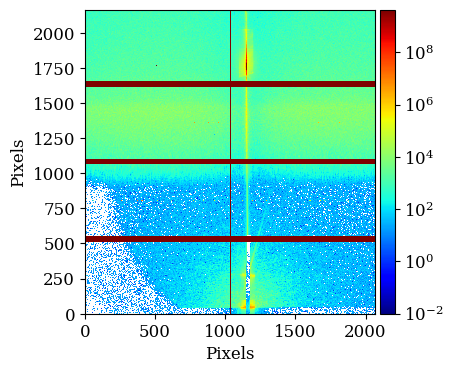

  0%|          | 0/10 [00:00<?, ?it/s]

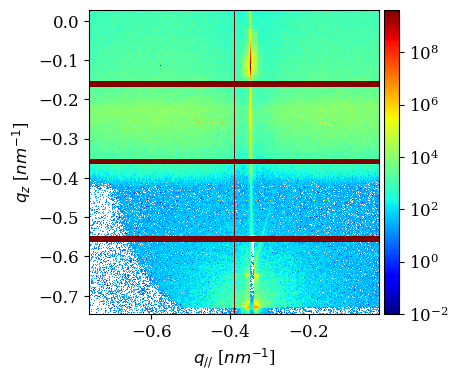

In [46]:
center = [2167-2126.0,1157.0]
%matplotlib inline
mpl.rcParams.update(mpl.rcParamsDefault)
mpl.rcParams['font.family'] = "serif"
mpl.rcParams.update({'font.size': 12})
mpl.rcParams.update({'figure.figsize': (30,30)})
# rc('font', **{'family': 'serif', 'serif': ['Computer Modern']})
# rc('text', usetex=True)
plot_a_detector_image(np.arange(350,361),  color_min = 0.01, color_max = 0, show_q = False, color_map=plt.cm.jet, save = 0)

plot_a_detector_image(np.arange(350,361),  color_min = 0.01, color_max = 0, show_q = True, color_map=plt.cm.jet, save = 0)

# See intensity development as a function of time

Dynamic_analysis_CHX.py:1205: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'axes.labelsize': 20})


  0%|          | 0/5 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1235: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  ' \n startframe = {0}'.format(startframe) +


qz and y_avg are -0.26 1350


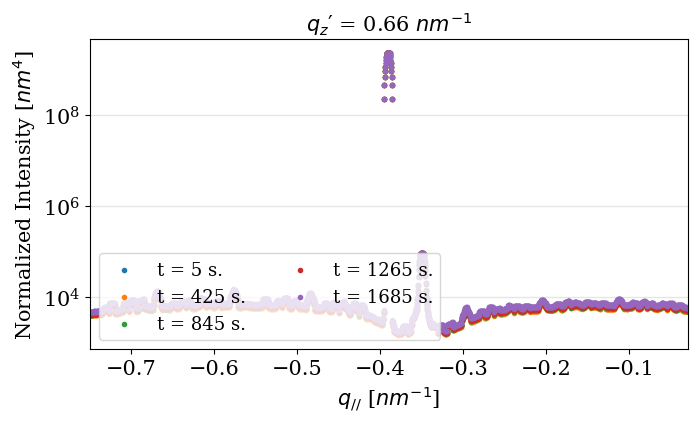

(array([-0.76      , -0.75964234, -0.75928468, ..., -0.02071532,
        -0.02035766, -0.02      ]),
 [array([ 4262.58947366,  4269.64677744,  4293.19140348, ...,
         11827.35789466, 12346.74493991, 12877.78573401]),
  array([ 3977.01004611,  3986.03024   ,  4006.97324093, ...,
         11239.2167866 , 11730.82072012, 12231.44802392]),
  array([ 4079.00408125,  4088.49969528,  4114.26330563, ...,
         11527.23627881, 12032.96402581, 12550.38016616]),
  array([ 4184.92872581,  4194.14986153,  4221.02558637, ...,
         11789.33889192, 12308.38305629, 12839.34655584]),
  array([ 4639.38180979,  4647.92374885,  4679.47058172, ...,
         13011.10351798, 13584.39236378, 14171.63434902])],
 [1, 85, 169, 253, 337],
 '-0.26',
 [1, 420, 84, 84, [0, 2070], [1200, 1500], True, 19, 1])

In [6]:
read_and_get_sq_q_at_different_t(select_frames = [], startframe = 1 , endframe = 420, frame_seperation = 84, bin_num = 84, xslice = [0,2070],  yslice = [1200,1500], SG = True, box_size  = 19, polynomial_order = 1)    


# g2 analysis

calculating g2


Dynamic_analysis_CHX.py:173: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  Itimeavg += image[centery-halflength:centery+halflength+1,centerx-halflength:centerx+halflength+1]


  0%|          | 0/50 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:307: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for i in tqdm(range(max(bind)+1)):


  0%|          | 0/188 [00:00<?, ?it/s]

qparallelnow  plog2 -0.76 [-0.7, -0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734

qparallelnow  plog2 -0.69 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.66 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.6 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.1367346938775

qparallelnow  plog2 -0.57 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.51 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.48 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.45 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.41 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.38 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.32 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.26 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.2 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.1367346938775

qparallelnow  plog2 -0.15 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.11 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.06 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

qparallelnow  plog2 -0.01 [-0.6877551020408162, -0.6755102040816326, -0.6632653061224489, -0.6510204081632652, -0.6387755102040816, -0.6265306122448979, -0.6142857142857142, -0.6020408163265306, -0.5897959183673469, -0.5775510204081632, -0.5653061224489795, -0.5530612244897959, -0.5408163265306122, -0.5285714285714285, -0.5163265306122449, -0.5040816326530612, -0.4918367346938775, -0.47959183673469385, -0.46734693877551015, -0.4551020408163265, -0.44285714285714284, -0.43061224489795913, -0.4183673469387755, -0.4061224489795918, -0.3938775510204081, -0.38163265306122446, -0.3693877551020408, -0.3571428571428571, -0.34489795918367344, -0.3326530612244898, -0.3204081632653061, -0.3081632653061224, -0.29591836734693877, -0.28367346938775506, -0.2714285714285714, -0.25918367346938775, -0.24693877551020404, -0.2346938775510204, -0.22244897959183674, -0.21020408163265303, -0.19795918367346932, -0.18571428571428572, -0.173469387755102, -0.1612244897959183, -0.1489795918367347, -0.136734693877

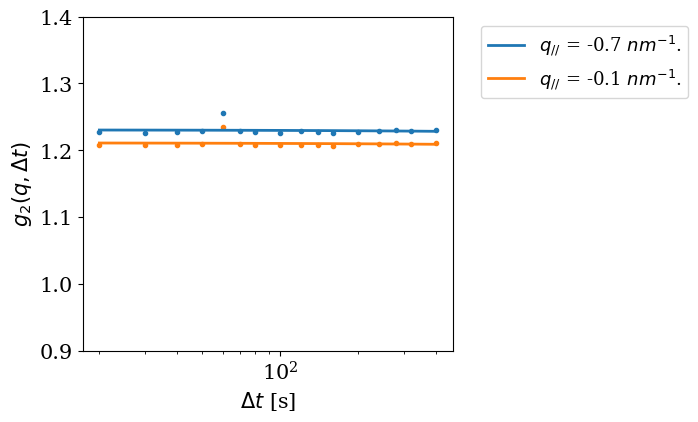

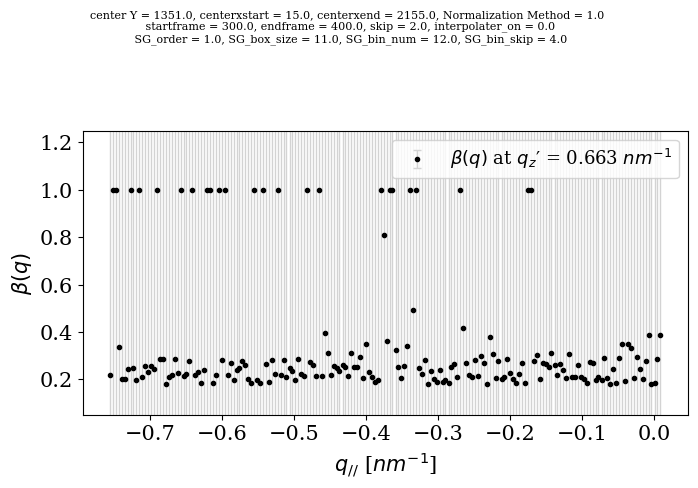

[6.70906879e+05 1.00803286e+12 3.11338607e+11 5.78570131e+04
 8.85626785e+06 7.30954607e+05 6.38018821e+05 5.06590868e+11
 2.16651417e+08 2.23370782e+05 3.63150981e+11 2.59511150e+05
 8.48685636e+05 9.32214972e+05 2.00998847e+05 5.80704708e+05
 4.00263998e+11 3.89799768e+05 5.05191092e+06 1.03032391e+06
 2.50232048e+05 3.32699892e+05 3.34617238e+05 2.31805026e+05
 5.77246825e+11 1.25236323e+05 1.04105088e+05 2.41876745e+05
 3.29814819e+11 5.37703832e+05 2.30592222e+05 5.62597611e+05
 1.25958309e+06 6.66253104e+11 2.14772924e+11 2.39993072e+05
 4.57235444e+05 5.31383386e+11 1.55030294e+06 2.89665941e+11
 1.85018637e+05 9.74780406e+05 1.01969526e+06 1.47078912e+06
 1.28740284e+05 1.52325201e+06 9.22061462e+04 7.57746831e+05
 1.00969190e+05 2.05276408e+11 5.06928927e+05 9.93955957e+05
 4.56144010e+11 3.90871429e+06 3.05697479e+05 2.57094564e+05
 6.26455848e+05 7.37845725e+11 8.81736412e+05 4.37019242e+06
 1.21322560e+05 9.85671477e+05 6.20217006e+05 9.31187753e+04
 1.13847296e+05 2.328700

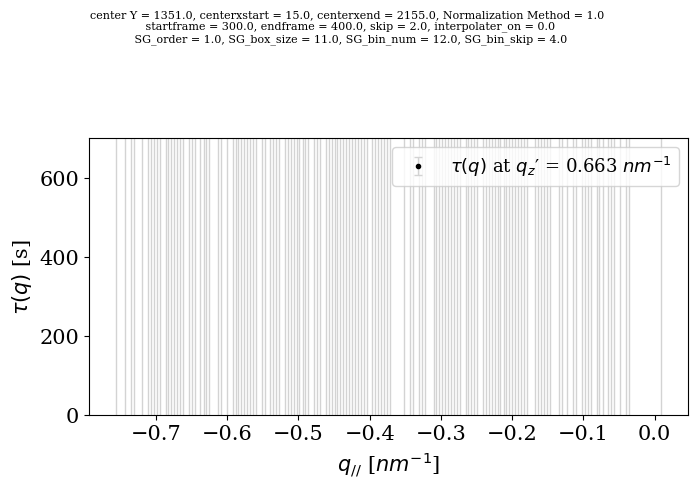

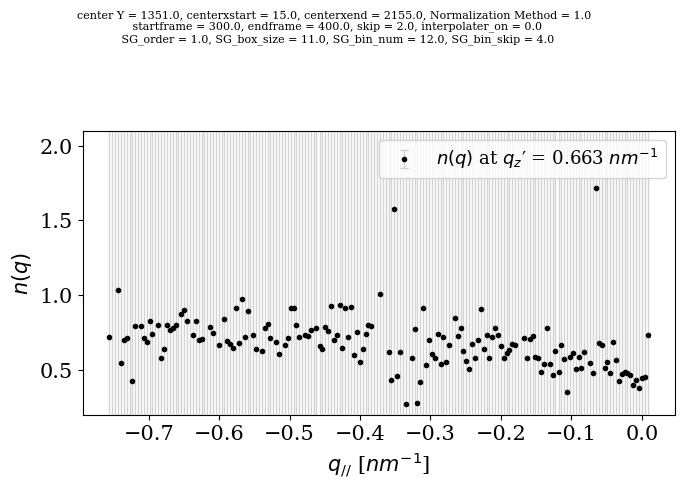

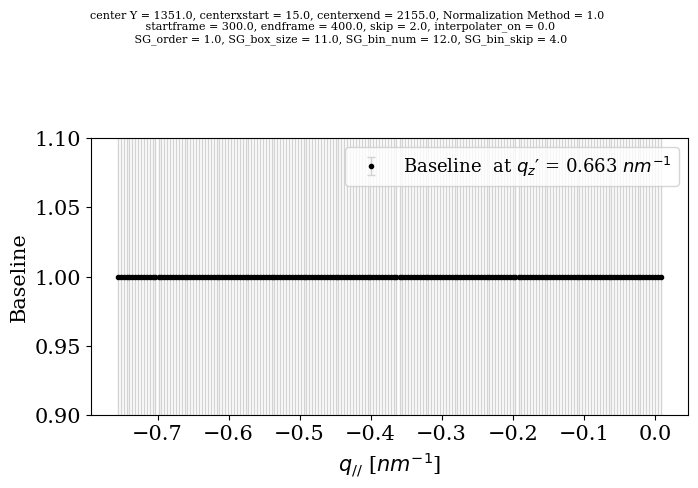

In [7]:
exponents, metdata = read_and_get_exponents_along_q_parallel_Mark(startY=1250,endY=1452,delY=201,startX=10,endX=2150,delX=11,startframe=300,endframe=400,Xlogscale = False, Xlog_num = 100, plot_g2= np.linspace(-0.7,-0.1,50).tolist(), p0=[0.15,100,1.1,1.0], bin_num = 12,  bin_skip = 4,nobuf=8,nolev=8,skip=2, interpolater_on = False, SG_order = 1, SG_box_size = 11, saveg2fits = False)
plot_exponents(exponents)

# TTCF calculations

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.06761962607791916, 5.420867246365877, 14.21475288292208, 17.861422189014146, 24.44388084967468, 14.174776912264544] 12.697219951053208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0664687652956093, 5.431528528642385, 14.243472472312263, 17.982037059767105, 24.474512510205457, 14.238980936864323] 12.739500045514523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911818673713332, 5.401974369125537, 14.106874164624957, 17.790777789074426, 24.25579270775703, 14.258127317134274] 12.647110755742226 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07008023710127631, 5.45622093269024, 14.137404091667147, 17.798072582169024, 23.79869531118421, 14.13653391380497] 12.56616784476948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07098223376825374, 5.364184413413219, 14.067115041344671, 17.584411692066922, 24.127980733121774, 14.086334957915893] 12.550168178605121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0685894072275508, 5.261934508721428, 13.958028369935894, 17.756663942051834, 23.969157109240765, 14.173525335549249] 12.531316445454452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07122729869393774, 5.3353035546777745, 13.982630940983285, 17.8073473559401, 24.028281597667334, 13.977771492944509] 12.53376037348449 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06990367854354607, 5.33153563645619, 13.965415262174515, 17.836817004468227, 24.038221665576874, 14.11983074751317] 12.560287332455422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07110022740612076, 5.4760023759836445, 14.164883172675871, 17.815295206031443, 23.696389819666145, 14.070872748989043] 12.549090591792044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06824153801986044, 5.216498634902617, 13.974463847037052, 17.911619063108137, 23.998609683394807, 14.273457101379773] 12.57381497797371 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06597048881687906, 5.359900949409472, 14.089100544990956, 17.648040342789812, 24.208640382842777, 13.91923623276973] 12.548481490269937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036845793193414, 5.4136388776291415, 14.074437557633662, 17.675605228178448, 24.04352388416992, 13.959257073617922] 12.539471846526839 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06922032015773838, 5.238758239348633, 13.905439518023275, 17.563817368938214, 24.05149653236509, 14.380428087814945] 12.534860011107982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07123253005179775, 5.322261624377018, 14.063390685631466, 17.70273053335706, 23.954376226461903, 13.924860930474722] 12.50647542172566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06796770676219488, 5.343953172246081, 13.998312910881486, 17.592356710362886, 23.903714243858513, 14.113605717071659] 12.503318410197139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0705549526684599, 5.4286523311491655, 14.002144580269992, 17.704665808107837, 23.998004019049528, 13.949583268362083] 12.525600826601178 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.068834500276439, 5.328592498248123, 14.031180549798032, 17.84850023070301, 23.824769028222295, 14.021573255224636] 12.52057501041209 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06963813826280041, 5.338783368864582, 14.119118338089008, 17.849872508354895, 23.849930179753887, 14.271354614494165] 12.583116191303224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06898392640480555, 5.3282475591350025, 14.071445406048523, 17.86938884352205, 24.080992525317246, 13.988022724730559] 12.567846830859695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06715792182416447, 5.288911262106804, 13.993437914894285, 17.682302572541992, 24.039458614492684, 14.046941897314683] 12.519701697195769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0691540011335312, 5.343740358997264, 14.16992250451228, 17.740112664741005, 24.219952435046846, 14.105130241564579] 12.608002034332586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036217470535777, 5.382518358138237, 14.064790772691484, 17.850631591067614, 24.19237352754812, 14.128273974302038] 12.61482506640881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06936232723464042, 5.343588414261493, 14.144695832829344, 17.78617537511393, 24.049980253485817, 14.143692757101777] 12.589582493337835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07359740606620946, 5.342189831188823, 13.912074582618999, 17.74760683946141, 23.760521561474462, 13.923073150764068] 12.45984389526233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06941839414749973, 5.140543262962685, 13.872504451202936, 17.618922209106213, 23.83899902392452, 13.99939052643201] 12.423296311295976 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0729622627040305, 5.266171511655731, 13.861275329019183, 17.576475950479633, 23.77187846965451, 13.798248632035781] 12.391168692591478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06983869064902182, 5.208237774912509, 13.81257629008437, 17.573953432957772, 23.819413107577844, 13.936289534855153] 12.403384805172777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07051302142994631, 5.250073785411855, 13.769608838450642, 17.641196486437657, 23.80041756401827, 14.076916674460405] 12.43478772836813 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07288098932066478, 5.259723170742052, 13.985606387836368, 17.687033930951173, 23.741993000146213, 13.936653412486802] 12.447315148580545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07230009224638301, 5.25788929953302, 13.876732412430197, 17.77308942248993, 23.801406850125073, 14.036812044976564] 12.469705020300196 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07217560319110206, 5.201581960800686, 13.8212643292485, 17.554521614085086, 23.621491333613072, 13.941677253958185] 12.368785349149439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07000792916308729, 5.213403819201311, 13.847946127231527, 17.503441720368283, 23.64791419632581, 13.802423795045542] 12.347522931222594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07099846326411563, 5.1026150436001805, 13.647083417624302, 17.43217835370257, 23.503812524181008, 13.889136513302047] 12.27430405261237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07082979986682858, 5.19363823339875, 13.895886838901887, 17.59381711216975, 23.32166092605502, 14.011229078641199] 12.347843664838905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07080480635588526, 5.252261466996695, 13.897396274085574, 17.636238999253887, 23.375947702400182, 13.748311528314574] 12.3301601295678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07117093678090392, 5.19855199428234, 13.571061464075472, 17.47642767967886, 23.292037565511247, 13.764807872719768] 12.2290095855081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0734960512124021, 5.01047982781868, 13.709406053724923, 17.376721687109917, 23.46830689312822, 13.750240208777308] 12.23144178696191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344774679489863, 5.148860112973916, 13.779688109344827, 17.429827598195235, 23.260781289887603, 13.820263127491565] 12.252144664114676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07403638187668027, 5.0958649597667005, 13.599834319160086, 17.531999873304574, 23.35695175180508, 13.814538945239283] 12.245537705192065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07413809378793168, 5.187884669613909, 13.684344893155563, 17.371664059363784, 23.21320405121087, 13.58257493513898] 12.185635117045173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07332917075262113, 5.188849186062741, 13.687731784661443, 17.182608608576214, 23.315354674328972, 13.911370735454273] 12.226540693306044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07158192953578335, 5.131355108629671, 13.62017000891227, 17.351139831509016, 23.273611580303488, 13.76187605998855] 12.201622419813129 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0717561341902122, 5.154791057750062, 13.766325074922348, 17.505047052785834, 23.439618435037097, 13.907167109685151] 12.307450810728453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07124620029543194, 5.159078201515679, 13.953132240443466, 17.51965616554574, 23.318659834294124, 13.68979055508905] 12.285260532863916 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06656678425596052, 5.1656344746880665, 13.740801157125173, 17.482241776845722, 23.497112355409655, 13.82947116269202] 12.296971285169432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362985384392351, 5.075257029185016, 13.64424954190718, 17.313311362474746, 23.205908716208274, 13.748203574421492] 12.176760013006772 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07154758167808906, 5.049351405351181, 13.513169830870087, 17.40887269617704, 23.381544080094894, 13.7617636321123] 12.197708204380598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07228678313922088, 5.10947661868691, 13.635065076948868, 17.44121198571785, 23.352819480988252, 13.780913290193421] 12.231962205945754 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07033616049119829, 5.051393012121003, 13.46045464436165, 17.52015735846297, 23.328425144755784, 13.607649494451381] 12.173069302440664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249301735399327, 5.030863223362192, 13.690328502023005, 17.217366353278692, 23.339686749315867, 13.657468337156827] 12.168034363748427 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07307667244855098, 5.113059118927085, 13.518651266980688, 17.321203748776625, 23.204304428644825, 13.753954390903305] 12.164041604446846 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07425653161937262, 5.1105933334536555, 13.694057871208141, 17.32755931645134, 23.206402668249634, 13.653932945868927] 12.17780044447518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436736688854428, 5.08822259071854, 13.423875644900011, 17.400711668585657, 23.558344044955486, 13.76903311492351] 12.219092405161959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07470074291876427, 5.100970936561385, 13.754955066946222, 17.31267811393942, 23.059029871221547, 13.649374847305927] 12.158618263148876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07150810028481791, 5.111775616037783, 13.59460942655794, 17.264763602008532, 23.096250887911282, 13.701863722764806] 12.140128559260859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07182097324309389, 5.049664019122375, 13.666181113867692, 17.361757772018084, 23.165022756448426, 13.73087200533519] 12.174219773339141 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07393295010913392, 5.198643955239518, 13.822269998497518, 17.406001677135986, 23.3232035907836, 13.653872980313619] 12.246320858679894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07064729839578732, 5.117611227057613, 13.49364857651604, 17.3452083679637, 23.37648011339684, 13.754126154301998] 12.192953622938662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07191962466067126, 4.958295047834723, 13.586422122313067, 17.362275491684695, 23.075961218851237, 13.461150437820914] 12.086003990527551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07579776023122742, 4.949678112497182, 13.436040556771989, 17.376004790405364, 22.952128108137938, 13.627403124681146] 12.06950874212081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141018084687745, 5.027458193798708, 13.499448915198116, 17.119930609025403, 23.13466619789326, 13.52894061402129] 12.063642451797277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07510671719931095, 4.864360863227845, 13.310507223473794, 17.073012300797245, 22.894259922294303, 13.463743895964715] 11.946831820492868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356844490960412, 4.89600967170006, 13.166967089145277, 17.067753221242153, 22.97080649939727, 13.573158989344726] 11.958043985956516 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07550853080188213, 4.852062867039049, 13.334927460451448, 17.158579502672623, 22.793165670029975, 13.232975509177356] 11.907869923362055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07215916599786709, 5.007656944576429, 13.41126837981117, 17.125088717154092, 22.82441159318403, 13.42031180085556] 11.976816100263193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07377775033068357, 4.976742455459474, 13.434732557564798, 17.062989430629212, 22.89437822761942, 13.355506417013153] 11.96635447310279 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0739063053369895, 5.033755850627476, 13.427322562768088, 17.1239611050311, 23.060098929327275, 13.423840917231512] 12.023814278387073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07739959748013847, 5.009690761182962, 13.429539224060747, 17.34898996898885, 22.91810243743866, 13.597975329262603] 12.063616219735659 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07334994300517139, 5.078582417737113, 13.503730699371783, 17.1211932814687, 22.889501488537633, 13.530571247491412] 12.032821512935302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07646803189654472, 4.908376752514418, 13.320833778209046, 17.089636601766415, 22.635574767645423, 13.42140742212815] 11.908716225693333 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0762678256782976, 4.98071287955421, 13.150255080023117, 17.25638454698084, 23.008561048788565, 13.517285564293246] 11.998244490886378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07473134131030634, 4.847421942441222, 13.303092681459221, 16.969918230321237, 22.951971680487592, 13.49403314921863] 11.940194837539702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319317881910048, 4.847558923883796, 13.070104812477028, 16.98525583933149, 22.572528315814278, 13.566811959092583] 11.852575504903049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07497657061113472, 4.8919323785569775, 13.144155662414569, 16.98402328817276, 22.806327406268313, 13.488960731416428] 11.898396006240029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07583187260691848, 4.802985405174932, 13.072060417136438, 16.877996166610206, 22.788521544106636, 13.25441696711581] 11.811968728791824 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07604007572482452, 4.888477636188915, 13.053836559147705, 16.95038995148937, 22.678771845457735, 13.231082286059717] 11.813099725678043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07391369835639283, 4.962673421970717, 13.328947631655675, 17.081368006449285, 22.83722797275344, 13.54930978767392] 11.972240086476573 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245071073447917, 4.909986371432357, 13.119471769148152, 16.93709855870597, 22.649122102042845, 13.524199293635657] 11.868721467616576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07380521097742965, 4.898056514613108, 13.242300993445266, 16.983842922580298, 22.605564617704275, 13.39722514353713] 11.866799233809585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07426637234750655, 4.973166664842071, 13.236044941920346, 17.140459960450908, 22.77404294331986, 13.53582685073456] 11.955634622269208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07530254364054279, 4.951319063547148, 13.275303741360748, 17.122616156494786, 22.745872391534252, 13.35677364468453] 11.921197923543668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07200414215135575, 5.007650671883007, 13.383491742780546, 17.182598819965975, 22.844052772971324, 13.597204877738886] 12.014500504581848 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07193675953836731, 4.94251994891758, 13.272428311039993, 16.963544016475485, 22.97572799876591, 13.391730517581273] 11.936314592053101 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0738800723766535, 4.8849864738256885, 13.277380851861638, 16.99253406749536, 22.835996861237046, 13.446324355518062] 11.918517113719075 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07133517623466057, 4.9237569233183685, 13.324355779073302, 17.18261915627444, 22.83829488235674, 13.507508699159201] 11.974645102736119 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293975296675859, 4.868805976198104, 13.253544893168277, 17.02212226641682, 22.803242164361873, 13.368377904906609] 11.898172159669741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07205368275053958, 4.804012274438114, 13.09116219385296, 17.072640825750373, 22.747880401807482, 13.376015525424563] 11.860627484004006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666986028696021, 4.821262842700744, 13.067342807918912, 16.8451547636068, 22.872862556645043, 13.424085425148792] 11.85122970938454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07171268296187905, 4.981452079517698, 13.268159649107325, 17.204908184684218, 22.827265897028298, 13.424173573386959] 11.962945344447727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07358327707006684, 4.911538893230941, 13.20129669570779, 16.962525572985427, 22.779021483211316, 13.45563565263236] 11.897266929139649 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0760311355448009, 4.866068732675207, 13.33395009332279, 16.77553599249151, 22.521565041950016, 13.420679043977996] 11.832305006660386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0722614412263689, 4.924624477329357, 13.210144951525033, 16.937145004312775, 22.698415080593552, 13.354873570040201] 11.866244087504548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07338537702716286, 4.8867157512998585, 13.15381887193071, 16.960595291791556, 22.739114372699902, 13.383337930734164] 11.866161265913894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07629485995349916, 4.871039337726031, 13.091639080912227, 16.90423971615202, 22.35219216846399, 13.309057106751661] 11.767410378326572 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06993209969504321, 4.933135516050211, 13.272544891840461, 17.020379619660538, 22.747876333969597, 13.414891522425375] 11.909793330606872 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07296849806915695, 4.885932348569784, 12.979460509145184, 16.88816539439042, 22.54149445181746, 13.300803697082028] 11.778137483179007 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367290861331344, 4.834079673321124, 13.158676482500823, 16.91094437638036, 22.64255847465721, 13.26384059715784] 11.813962085438446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07306231231950178, 4.721861948073453, 12.969992597525655, 16.981182436278438, 22.4042383025549, 13.214395283231472] 11.727455479997237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.069707343906112, 4.800852654942322, 13.025393072057179, 16.821857470223332, 22.566417235231505, 13.205815055723486] 11.748340472013988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169264903999584, 4.889720905099908, 13.053224715342436, 16.89126720111497, 22.457528721985906, 13.297875838441433] 11.776885005170774 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367478979471409, 4.841870685244172, 13.015399899813133, 16.90475052199566, 22.818037268079554, 13.304604607893422] 11.826389628803442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727978496882089, 4.8960632391416254, 13.18019296183278, 16.771153749608658, 22.64527969127018, 13.402172467303371] 11.827943326474136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356616586865328, 4.894144389524505, 13.111744612489554, 16.95215560804398, 22.471715560911075, 13.35697077168922] 11.810049518087832 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756597139404942, 4.883104155146134, 13.170530743470206, 17.022442368561197, 22.576541358795062, 13.410108602752686] 11.856397823777632 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0752058314028059, 4.9348462488719385, 13.268184382231416, 17.0562386723591, 22.608193473756483, 13.27455887283294] 11.869537913575781 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06949994533152637, 4.8345067560252355, 13.093053061499724, 17.133565111678212, 22.678024822371373, 13.144934928483455] 11.825597437564921 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07116674120277122, 4.844358957035638, 13.10319590441304, 16.92292799158601, 22.503671956990438, 13.403844577655544] 11.808194354813907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408565407225876, 4.873667354204261, 13.111941587293659, 17.010597367132156, 22.43485830221525, 13.241710058784413] 11.791143387283668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07262352369203184, 4.756625932313199, 13.048581954280472, 16.827127360151277, 22.605432005397994, 13.238140790841042] 11.758088594446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07268194913008075, 4.781273814561008, 12.858273993171837, 16.9997103186102, 22.39778777900664, 13.06415223323713] 11.69564668128615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07462627130432886, 4.686794777423117, 12.826302280047448, 16.90958297994743, 22.4011940699842, 13.25736953893107] 11.692644986272931 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319419161083762, 4.824527688302381, 12.93824836399594, 16.85410233549061, 22.533714951380876, 13.154980704908832] 11.729794705948246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333267210420513, 4.823235679154952, 13.04571859682154, 16.985991724118456, 22.36624999545607, 13.10794839351055] 11.733746176860963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07335719970440913, 4.804709033869303, 12.980132503392706, 17.026245820210242, 22.565871487420868, 13.366944832934324] 11.802876812921975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141280412650453, 4.719960092581826, 12.806182177542969, 16.851531143942218, 22.433156402873536, 13.202227929062326] 11.68074509168823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07461473440424271, 4.8623541755406, 13.04652808206245, 17.06164206585317, 22.761310757824575, 13.346000411099508] 11.858741704464093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07259400709477282, 4.7541128311060366, 12.97316530521383, 16.893451646729932, 22.878520143867295, 13.296028414408186] 11.811312058070008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07258746329630128, 4.871091107025866, 13.181783412758191, 17.00491692324257, 22.59957981161342, 13.441752427137654] 11.861951857512336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07025571015148357, 4.79335727854792, 12.999526337521463, 16.770421190924043, 22.535778893888853, 13.231893490074581] 11.733538816851391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07452944058471589, 4.745356950075333, 13.021646409113723, 16.850074201309475, 22.482698547363686, 13.048977274461958] 11.703880470484817 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07209445585707264, 4.820024908567906, 12.905126231490112, 16.861651558718464, 22.662207324457405, 13.068215733028072] 11.731553368686505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07232403792009512, 4.685674594024199, 12.698485315230716, 16.745217914267847, 22.24736706476917, 13.002024780372533] 11.57518228443076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293387929516992, 4.71282384328112, 12.811421788499617, 16.680698180533483, 22.33644728119268, 12.99928269304246] 11.602267944307421 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07238513798071744, 4.686983584961871, 12.647995352980194, 16.701036316617106, 22.18374737138032, 12.99619466723745] 11.54805707185961 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444811385678474, 4.782037729714481, 12.830271276178133, 16.670136219837712, 22.16101950689767, 13.31367841093039] 11.638598542902528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07524109359092668, 4.834287942649341, 12.864602452608947, 16.851456013341185, 22.097985740255503, 13.161722460911431] 11.647549283892888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509085327808629, 4.854390801887921, 13.08235770529559, 16.687537787406995, 22.564311722270727, 13.237518855826305] 11.750201287660937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436671425635444, 4.817137701417836, 12.942178246747247, 16.797573429231186, 22.236379605475673, 13.383595575270439] 11.708538545399788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07029965940698757, 4.770817665722867, 12.907962578529315, 16.795561195749567, 22.371891513580845, 13.192632950330792] 11.684860927220063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169963465528251, 4.740176190977213, 12.739917174574888, 16.85425485729456, 22.407149516426873, 13.294015648270229] 11.684535503699841 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07361917333458701, 4.687354060287402, 12.669484082665933, 16.760996926150806, 22.292438898615924, 13.33336502704304] 11.636209694682949 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07721183385378216, 4.695381292216362, 12.697254712153278, 16.733331363887025, 22.084482411894598, 13.274554363031031] 11.593702662839346 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344155750857384, 4.654913137567103, 12.562433501123534, 16.68582174869972, 22.301824199353028, 12.944610112966009] 11.53717404286966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07202999827064382, 4.612583795645676, 12.635774392475195, 16.63349465810097, 22.23148705360845, 12.98412167572579] 11.528248595637786 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07282801720657472, 4.672234177057398, 12.731406462002308, 16.5354996363814, 21.899813109649923, 13.032033891084088] 11.490635882230281 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07266063155803826, 4.658420670195362, 12.784387599241136, 16.61744696182482, 22.197967953472453, 13.02373846714195] 11.559103713905628 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07440062676401737, 4.672226777090712, 12.525727269887033, 16.507636678425254, 22.138445837329897, 12.974359440108138] 11.48213277160084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07047190748152876, 4.761235553289453, 12.732976892712925, 16.692265719749244, 22.171150629775532, 13.145242641940689] 11.595557224158227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07275088009331232, 4.751307314036274, 12.878215057254272, 16.854571846408767, 22.085607495818206, 13.207250049266186] 11.64161710714617 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236457662653684, 4.764840768827404, 12.996348567019613, 16.56803934176499, 22.18175378839922, 13.07813470622381] 11.610246958143597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07311758381915512, 4.780885670201044, 12.961502953987537, 16.589555463451916, 22.010061879566432, 13.187010046484254] 11.600355599585058 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07455863435730659, 4.743087950148564, 12.81314498980638, 16.708484735125083, 22.433667266829712, 13.246096494904007] 11.669840011861844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0716308435158044, 4.804850909963178, 12.953827105423763, 16.640040396421973, 22.249757170240745, 12.909651074442971] 11.60495958333474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07295168939207297, 4.782588251419542, 12.783110009695912, 16.607577899071586, 22.092759169477524, 13.127336048234834] 11.577720511215245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07206784035596692, 4.728002005247851, 12.892355017745835, 16.53355785120479, 22.24536543350985, 13.082116940442104] 11.592244181417733 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07430443414902888, 4.662437368753499, 12.707360253103555, 16.55713199909343, 22.25542251214238, 13.191628124992173] 11.574714115372345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344447233729667, 4.702303618487608, 12.764767190779112, 16.689117592861376, 21.957233810830697, 13.102399094307593] 11.54821096326728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07115965305036553, 4.7458899506069585, 12.754456116807102, 16.5488225100045, 22.063969872535083, 12.972694243979008] 11.526165391163836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07435578774137075, 4.620885400617831, 12.548660257776131, 16.468748211567082, 21.902162051293054, 12.868296893631781] 11.413851433771208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333683618381026, 4.593925216749313, 12.612073622857721, 16.65934588025022, 22.006918521716788, 12.919839986044842] 11.477573343967117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408611998900572, 4.629908908567491, 12.709365491490955, 16.692140138309746, 22.013977726140013, 13.019471085455558] 11.52315824499213 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444845798454613, 4.69055917783546, 12.689117926082144, 16.578270247970416, 21.919047542003575, 12.813245121981039] 11.46078141230953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07507512120853588, 4.627305276256992, 12.72279166743116, 16.53909674650649, 21.942820400465532, 12.843947592233059] 11.458506134016963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309317402394466, 4.6715787906308535, 12.698564218935415, 16.502995025773036, 22.18101359141518, 13.090548869822985] 11.536298945100235 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749483200612453, 4.6230757130551305, 12.523517718488494, 16.58429258309628, 22.054054164732808, 13.028819628768593] 11.481451354700424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362031035950589, 4.587778747245045, 12.564372273062325, 16.536027134267343, 21.899657822054543, 12.881318092550151] 11.423795729923151 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07342614574536888, 4.493778308271589, 12.358092481215316, 16.489929812212317, 21.805345240549258, 13.04186019299588] 11.377072030164955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249882683713849, 4.683135797255395, 12.499997534552719, 16.4995703735991, 21.673995847439983, 13.030785347683626] 11.40999728789466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520865399581589, 4.651667417119228, 12.631914064362205, 16.397866818190124, 21.87738565145779, 12.916198718632275] 11.425040220626238 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0778908464204291, 4.659605846395087, 12.624505754260573, 16.434518768403166, 22.013369962560585, 12.896537216372826] 11.451071399068779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649523976975647, 4.5371036118620625, 12.6437910859816, 16.474359163705582, 21.70043243839292, 13.007824084179402] 11.406667603981887 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0759601125080418, 4.73135744790463, 12.523941201574631, 16.561324289603746, 22.007443664389324, 13.06358715184782] 11.493935644638034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309648382231848, 4.628716019655319, 12.63101858176098, 16.48675634746678, 21.823352704718456, 13.150756905620266] 11.465616173840687 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245994856386528, 4.639433525791425, 12.527943849863458, 16.622679875460445, 22.103548157932842, 12.961931754269763] 11.487999518646966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07431367942366807, 4.666064998919638, 12.506121855577987, 16.49812249581699, 22.07441981333893, 13.094729031629269] 11.485628645784415 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07561181236659675, 4.664605552422552, 12.685497630698004, 16.436544096238297, 21.929178799802955, 13.262489059681387] 11.50898782520163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649487022756007, 4.63971645691115, 12.69661322252888, 16.599257990489658, 21.967944454989095, 13.020028362934637] 11.500009226346831 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07121475521609155, 4.644031704947711, 12.4990754295848, 16.420285911053007, 21.87226302903329, 13.087692597157767] 11.43242723783211 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07224779826760286, 4.623691340832593, 12.33326903284908, 16.531504550038676, 21.818861453337703, 12.878017534924783] 11.37626528504174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727216829495052, 4.600096377268906, 12.53538999408776, 16.506453796058018, 22.01234593071163, 12.938435818879338] 11.444240599992526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07343675213009893, 4.618234828482197, 12.533306024386647, 16.45010935134115, 21.789097077035446, 12.845505737263773] 11.384948295106554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07298101099758814, 4.62457164519798, 12.474163920037775, 16.437763857647035, 21.803869437187576, 12.811663593231797] 11.370835577383291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07511869981361419, 4.635073334910616, 12.59259692665233, 16.491394184679237, 21.89659361236086, 13.161614105502524] 11.475398477319864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07392880705095228, 4.531699833169334, 12.337179452232462, 16.437021811745723, 21.88112980810555, 12.923406256618271] 11.364060994820383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07482195191808638, 4.687132477653447, 12.545842621880828, 16.467318702881922, 21.915704054751718, 13.04515236554828] 11.455995362439046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320963346586495, 4.538683148312336, 12.474952742135171, 16.440247439373703, 21.788177792087133, 12.971752168452298] 11.381170487304416 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740020738955522, 4.715239972778205, 12.712014808109428, 16.605071331392875, 21.81583289574379, 12.909044892224655] 11.472434017939749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344045829224011, 4.645263969391208, 12.435453379218487, 16.471228185109855, 21.769922828857663, 12.899103458304495] 11.38240204652899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0720956125954435, 4.53034995611686, 12.51450551054205, 16.476046252337845, 21.703091146277345, 12.98817543086099] 11.38071065145509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07407199904956241, 4.510057967519782, 12.410455900541148, 16.46862635435545, 21.576267437360094, 12.95002983101512] 11.331584914973526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444639593268332, 4.569939696765713, 12.320910027427637, 16.303749593131062, 21.422598659018895, 12.627860680172637] 11.219917508741439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07545196084787364, 4.503807083467504, 12.271465625200806, 16.396053737735762, 21.590152211428936, 12.995051070560693] 11.305330281540263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07287672413527213, 4.526564807757707, 12.380355421181553, 16.3699406123509, 21.75679503534376, 12.903531935531182] 11.33501075605006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07553539614694849, 4.5110778028499166, 12.256842103040617, 16.277924298841224, 21.817914105270575, 12.871415441008269] 11.301784857859593 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0744673220481713, 4.620577185872357, 12.360539861751317, 16.43340151615597, 21.70781446511172, 12.636620260666632] 11.305570101934363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07500851176805834, 4.54987873098942, 12.442940387988875, 16.385906025659395, 22.076183742619595, 12.866833466165534] 11.39945847753181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756735069749952, 4.610168417456852, 12.497523952909452, 16.51355369121095, 21.947333027675242, 12.938156127171016] 11.43040145389975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236828565083253, 4.5961432829953495, 12.570742688856589, 16.274955736691055, 21.74228295247319, 12.925012901475188] 11.363584308023702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07363076675331293, 4.610171888959172, 12.504942884341846, 16.356261670682976, 21.905985659164838, 12.94767027616047] 11.399777191010436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07368449554589196, 4.572638734711606, 12.47616022614783, 16.368591994773922, 21.879044661301283, 12.77526889563405] 11.357564834685766 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07165398789775468, 4.577808677151647, 12.469214702535723, 16.490045263922585, 22.012025213487068, 12.907457523132331] 11.42136756135452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07316940822110363, 4.556769980822072, 12.503551518188358, 16.396882909209857, 21.677113886990764, 13.002845574421876] 11.368388879642339 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036393722157652, 4.587358844223107, 12.407963016200819, 16.38854605006151, 21.464317279347092, 12.906135150118098] 11.304114046195366 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07394835508620745, 4.4474171448222375, 12.293578524029826, 16.378890263426587, 21.63213690866326, 12.901087994728977] 11.287843198459518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07114636723181156, 4.579189585833275, 12.258720104605898, 16.49383012483755, 21.454282503894554, 12.843583606139406] 11.28345871542375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07572158144559205, 4.585420092995985, 12.335178570340826, 16.348700681807664, 21.807374183320704, 12.854352275008534] 11.334457897486551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07655166076227693, 4.5750340884395655, 12.519566751289599, 16.265814467493556, 21.309324953487046, 12.837117387997544] 11.263901551578266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320894414752943, 4.500141544046513, 12.454418783385208, 16.330149788360888, 21.772357296530956, 12.8445521708235] 11.329138087882432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0748289098193402, 4.5854011340124625, 12.517136366397262, 16.5153008772428, 21.355764312796722, 12.793429176408567] 11.306976796112858 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509863076962975, 4.512779452534613, 12.366855396032369, 16.357355854564876, 21.274350182744016, 12.967012357458403] 11.258908645683983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07717231318961759, 4.47358402717188, 12.385895697681882, 16.281361433187293, 21.363051256455993, 12.993659688026147] 11.262454069285468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07222419250449996, 4.416208465237164, 12.233955927626381, 16.20808341052016, 21.305675534346104, 12.828991802293974] 11.177523222088046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520871562694476, 4.446886464254046, 12.21660768993617, 16.317710984259538, 21.328001001824568, 13.06367477599784] 11.241348271983185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07555817199936143, 4.412967947835514, 12.129411677574357, 16.221850291337297, 21.514920811086977, 12.957472334881615] 11.21869687245252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749998140408723, 4.357840107319893, 12.165022389257897, 16.100983953119826, 21.55460397009894, 12.513296793404791] 11.127791171207036 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0768574297433493, 4.362668690064206, 12.27385662456074, 16.07188125668215, 21.06049444304004, 12.748018791847638] 11.098962872656356 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07718471034008134, 4.365017340487675, 12.002550981352696, 15.979395679609514, 21.20055215675627, 12.522731813864812] 11.024572113735175 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07762375105979813, 4.3323771679045855, 11.949589131991768, 16.014238491273492, 21.131281639088108, 12.717845006445163] 11.037159197960486 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07695650872839943, 4.4106179663187985, 12.130349550311667, 16.14931838038031, 21.277325383374546, 12.748997124686774] 11.132260818966751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07755963565768131, 4.426829414833669, 12.210467375349982, 16.14360789416193, 21.059756208081453, 12.694651504234324] 11.102145338719842 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07540971709625266, 4.3791467061722, 12.062614609539644, 16.284746317333784, 21.223149619780358, 12.685633506802002] 11.11845007945404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07421364969517596, 4.462499738208945, 12.127001447062502, 16.175152323714645, 21.31235384394579, 12.762081486324384] 11.152217081491907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07286871550047347, 4.473700186059094, 12.258720575794634, 16.223003288022863, 21.422626603175196, 12.772662955627313] 11.203930387363263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0763564183661698, 4.428453321235779, 12.227992750262324, 16.177834554130087, 21.472858918318178, 12.736837606153175] 11.186722261410951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07526689782835438, 4.512484275518642, 12.130069274249623, 16.005250044378162, 21.248516733072936, 12.673322623002715] 11.107484974675073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07615317542977662, 4.4288484004956965, 12.167524029552188, 16.179162461312217, 21.082301764964008, 12.666980160675452] 11.10016166540489 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07303961448163365, 4.414649333759138, 12.145690997308519, 16.258916337957977, 21.25272922469764, 12.550710135204321] 11.115955940568204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07326400057031313, 4.413530929072831, 12.135431431566873, 16.063938436225396, 21.383303257275923, 12.593372928525513] 11.110473497206142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245869853275222, 4.366694978610881, 12.218357888704524, 16.00907590720289, 21.564901246187915, 12.808209044886285] 11.173282960687542 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07669587198967198, 4.417923668258613, 12.238316344975118, 16.067702304490638, 21.40627087146693, 12.623772827119657] 11.138446981383439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07432276061129528, 4.4426245849785495, 12.112739599698996, 16.221362355941118, 21.50275603650315, 12.727758104997454] 11.180260573788425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720871641948923, 4.476369793335661, 12.365301076166782, 16.027884321078155, 21.205363027469716, 12.705556196088764] 11.142947188426428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07558540869330521, 4.40674317428447, 12.083927535192784, 16.06009684223058, 21.07072710557882, 12.705151958235307] 11.067038670702544 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07543416896488586, 4.466003025528741, 12.396214102191262, 16.09263509740412, 21.25034007922855, 12.75915909188785] 11.173297594200902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07594001900826286, 4.372906628006657, 12.018443344678383, 16.182667188247084, 21.523451735996996, 12.89374859294393] 11.177859584813554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0772186513352131, 4.457916911591602, 12.160587839684128, 16.086823724050983, 21.174270585578476, 12.71340974834716] 11.111704576764595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07478836220506602, 4.394962790631159, 12.204101583223881, 16.268882224217013, 21.391901472567287, 12.818843735197191] 11.1922466946736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666959850918009, 4.4738406839482305, 12.156922363953974, 16.124866538441164, 21.063255713688317, 12.771476752462886] 11.111171941833959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07459696443962138, 4.399117019103229, 11.955653424575965, 16.090174293541818, 21.10548589621883, 12.83470572074958] 11.076622219771506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781064354843708, 4.433148938711306, 12.264192910701592, 16.293340691199532, 21.654039404703106, 12.746268815375092] 11.244849532695833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07749996458352593, 4.423926239029438, 12.173462411258814, 16.177481671609264, 21.278097323047746, 12.695214151332832] 11.13761362681027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07818349046679729, 4.417784881327932, 12.1130251929373, 15.933097807824478, 21.180936498122968, 12.396192896865243] 11.01987012792412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07613582069347435, 4.427609136152883, 12.001102137537565, 16.010243751149407, 21.04861781778401, 12.590830645181425] 11.025756551416462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810452750982355, 4.362278980285297, 12.06144110548301, 16.023460268461292, 21.010086265489978, 12.593061374086165] 11.02140542021926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07759815743189669, 4.403333944948223, 12.169100360236508, 16.04983957251917, 21.127677326662553, 12.7501388383327] 11.096281366688508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07909393676219811, 4.3461339755224655, 12.039213688833424, 15.973163331577815, 20.936811402620446, 12.7195014190864] 11.015652959067125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07698823886357231, 4.286528216344546, 11.905246363683636, 15.925049056376348, 21.065615893873314, 12.68273061452355] 10.990359730610828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810722659130787, 4.260901586918524, 11.9532270244442, 15.931354847180774, 21.050878698440037, 12.625980821722546] 10.983408367549565 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706543542914246, 4.323190986327403, 11.801137882295992, 15.773644894936652, 20.750630769977988, 12.507532422965753] 10.872200398655488 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07614764302421029, 4.344404200535714, 12.03734362899424, 15.828395185865777, 20.77929752255191, 12.41573244628444] 10.913553437876049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07789704073170078, 4.335872332208325, 11.9452311141047, 15.79941636553783, 20.91388819043476, 12.552321635067397] 10.937437779680785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07837594732691988, 4.281360118997508, 11.796124567589795, 15.759083798717874, 21.027276347253, 12.448656990536307] 10.89847962840357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078802240624392, 4.248616905400731, 11.806570869779076, 15.635261976754407, 20.76727540240355, 12.593863684557414] 10.855065179919928 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07728644900243498, 4.402687871402449, 12.092074808730104, 15.844957980196458, 20.884564193142296, 12.370605617775416] 10.945362820041526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07877601540335344, 4.341314425052927, 11.857932624423077, 15.751258883238261, 20.638818182629183, 12.327561996810974] 10.83261035459296 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07701047911154202, 4.317380923497478, 11.947090143537292, 15.938153412928227, 20.953453855852068, 12.57981628831594] 10.968817517207091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08009902173978811, 4.307387577604659, 11.947682347563433, 15.840038002153307, 20.886762845584464, 12.529350542712615] 10.931886722893045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07684000137646008, 4.377334505152016, 11.961203342788014, 15.838225742173936, 20.839635814223133, 12.37326763087373] 10.91108450609788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07778015889237655, 4.380640071718415, 11.989026107058999, 15.962195489919903, 20.8055588760742, 12.289241316051866] 10.91740700328596 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07427115987032673, 4.325862828027044, 12.032273278514484, 15.956362710941328, 20.92126851197844, 12.372276776984503] 10.94705254438602 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07962025065088252, 4.348859342742131, 12.007195432548956, 16.072241237749108, 21.150581926039006, 12.632563686437258] 11.048510312694555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07654388040453686, 4.25969759294907, 11.838862103341322, 15.85003484605938, 20.970493727126357, 12.473599714429627] 10.911538644051715 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07890402562417131, 4.3354984413730735, 11.826362339272675, 15.938171433478065, 20.922162190727345, 12.46339298261573] 10.927415235515177 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07315846085894862, 4.314840144103501, 11.902697430837618, 15.766995708419472, 20.578222754972003, 12.38329764396449] 10.836535357192673 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07800427883396166, 4.256413711351195, 11.757540340976487, 15.936708416768397, 20.6441908750733, 12.527261235620287] 10.866686476437271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0765509377060547, 4.292450380774188, 11.846783787478524, 15.789000668261682, 21.103230302918586, 12.423294284971258] 10.921885060351718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766094372254984, 4.30811872591456, 11.930439311505513, 15.883352952619056, 21.032848257824906, 12.466961844291973] 10.949721754896919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07464312480778523, 4.3294482520307405, 11.889122544903666, 16.057320600034057, 20.91933151208413, 12.71297076839851] 10.997139467043148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07399579283699076, 4.369465115039663, 12.125474636078003, 15.986220697630504, 20.98657726091976, 12.615729668447779] 11.026243861825451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07417136515949152, 4.3484029179714865, 12.141621353576905, 15.951180314109383, 20.9953030594269, 12.732442635617854] 11.040520274310337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07685308877691055, 4.271936172440025, 11.90975112727594, 15.857593242850122, 20.930715571762935, 12.455437654168867] 10.9170478095458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720644996632897, 4.26343032044642, 11.937248145950054, 15.80877242223729, 20.854791674157223, 12.459462973130966] 10.900151997648047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07811741970637831, 4.258795853324793, 11.745883519789098, 15.891102293175344, 20.680556143034185, 12.414507011991358] 10.844827040170193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960454899651159, 4.2109010882020685, 11.55061144139868, 15.772874573213976, 20.53760890114518, 12.322640129017467] 10.74570678032898 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07961412220351916, 4.2456970230519975, 11.86140573267667, 15.617472000201527, 20.492479415778146, 12.22095067965833] 10.752936495595032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161619542751675, 4.233042127906641, 11.86743985496811, 15.587401260900027, 20.520227552879373, 12.26268701581097] 10.758735667982107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0790578640538604, 4.236303159061523, 11.755127249507648, 15.659787354621752, 20.585707800329253, 12.204160144948407] 10.753357262087073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0798760689283744, 4.202322240928935, 11.719964500391095, 15.694673457884779, 20.613702220727568, 12.330533840615043] 10.773512054912631 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07848881631814608, 4.178855754897228, 11.736149951557957, 15.655374872379863, 20.511450195321952, 12.232908640232598] 10.732204705117956 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07930137896394607, 4.1481217784725315, 11.673248149701045, 15.676366086360257, 20.513606608972744, 12.171996735672227] 10.710440123023792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07905829244229734, 4.221843143508982, 11.683877282125476, 15.720858428308453, 20.587489637401184, 12.201656474242444] 10.749130543004805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07936829476356122, 4.254574600991515, 11.768182599021376, 15.751260393938356, 20.633331414470113, 12.324280523682429] 10.801832971144558 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07982928692182645, 4.27859465379687, 11.789200536938376, 15.662677159387933, 20.74420305186292, 12.22909525681373] 10.797266657620277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08140889681623231, 4.265042839506088, 11.749533826662372, 15.578273821626823, 20.68244938410473, 12.265913032747127] 10.77043696691056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08046981592254054, 4.169297954284945, 11.757801673815552, 15.788908964806769, 20.61485116230901, 12.405423306601092] 10.802792146289983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07990048468611821, 4.122398988845081, 11.572458368440243, 15.793971249276417, 20.76815962565203, 12.342023882347148] 10.779818766541174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740794607614854, 4.2498078784074425, 11.844822192043724, 15.627888159907307, 20.803122086125494, 12.22288599460523] 10.804322376194227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07892425005425108, 4.2069794501418105, 11.786927465294646, 15.53326505080939, 20.83987160754146, 12.272487691093149] 10.786409252489117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08049199161126919, 4.286494958009545, 11.842071155667231, 15.751724844328521, 20.590913332286206, 12.350302381493188] 10.81699977723266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0826732546657647, 4.275819833830715, 11.85132821762104, 15.781368201267128, 20.534623535184203, 12.23597762984514] 10.793631778735666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07863699632847876, 4.304169520099653, 11.836021802416802, 15.682609732046853, 20.708435655726127, 12.285515917228704] 10.815898270641105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07983215413585776, 4.38279415573511, 11.89316451802007, 15.65446160646578, 20.737935621717416, 12.267620158737067] 10.835968035801884 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07641120605010321, 4.2959272116556715, 11.862315553624988, 15.859193078736144, 20.86395785826471, 12.289132419253084] 10.874489554597451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07911330127351968, 4.294070180428636, 11.860922084445429, 15.809207185118009, 20.938194589260117, 12.327076698094743] 10.884764006436741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781419427810579, 4.211605862712621, 11.730889229177942, 15.673925875213374, 20.742908262203393, 12.460066198251871] 10.816256228390044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08016458947062421, 4.187699909448827, 11.59488055238407, 15.669564867388853, 20.777593092943288, 12.392850506646328] 10.783792253046999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07870054292123418, 4.212038791802024, 11.713143065060539, 15.852251593484407, 20.621106729842765, 12.353153838398935] 10.80506576025165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.082015221322284, 4.17490002109237, 11.705386187884855, 15.884500385654484, 20.565058985156213, 12.294679818934265] 10.78442343667408 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0770910726097016, 4.218415469848944, 11.776035628939939, 15.681647067022787, 20.518932269060628, 12.30738411794764] 10.763250937571605 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07766360857462407, 4.134449522391768, 11.663410637839762, 15.712062767941905, 20.684494930304016, 12.359667519643724] 10.7719581644493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830240859937887, 4.170625675305466, 11.754575933314714, 15.70088834596189, 20.446959548888405, 12.337006815967532] 10.74805978800623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07903953498887706, 4.201811284728553, 11.768842507630115, 15.728377209594488, 20.52040581604204, 12.343365945031042] 10.773640383002517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07882603149468292, 4.17177650821309, 11.746772429639805, 15.633535013137706, 20.42278574584883, 12.1560392533958] 10.701622496954988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960312989805818, 4.179887155719215, 11.7284562317296, 15.630034288529757, 20.27526640894725, 12.101109404172018] 10.665726103165982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766265947601259, 4.179922597692427, 11.639310353183014, 15.64284631539682, 20.57852515264808, 12.28603781874697] 10.733878138737907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07575381541171566, 4.205348630842529, 11.676173887415517, 15.703322274400342, 20.598656908478144, 12.46735546430948] 10.78776849680962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706062502635791, 4.210217444104971, 11.719936312933276, 15.681900035160758, 20.5650838216297, 12.271491769969929] 10.7542816681375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830888702070893, 4.3052446006643805, 11.880707552837011, 15.753273265293565, 20.631451552774635, 12.272150754271467] 10.820189435476962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078586533227333, 4.174438004115503, 11.6432241496574, 15.689485424413732, 20.649823837566526, 12.21392571632088] 10.741580610883561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07963680447843302, 4.21245012450707, 11.709607985270491, 15.567789310310314, 20.61695061171595, 12.217621142253037] 10.734009329755883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07713092551589806, 4.168455569564272, 11.655093506751367, 15.642934017287836, 20.4363000891753, 12.304726447854703] 10.71410675935823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07880423153816407, 4.200071976105153, 11.562253954272688, 15.644083248978248, 20.421066245878027, 12.241643114920228] 10.69132046194875 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07622323356760075, 4.245738989756256, 11.761291573631123, 15.647317507137945, 20.66951363331822, 12.289495780909574] 10.781596786386785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0789965088761504, 4.267402594561373, 11.706133979828797, 15.696466219674658, 20.693496983651716, 12.168702973780908] 10.768533210062266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08134980304778683, 4.220847960131047, 11.77635455496153, 15.62428070209176, 20.638279317213133, 12.260654477532317] 10.766961135829595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0817294969894169, 4.194150703708835, 11.6995071022125, 15.574537873768936, 20.58582322446923, 12.156183334302046] 10.715321955908493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07590393194979494, 4.245420843115286, 11.80908948177994, 15.575022066099663, 20.54595077515664, 12.369450405872417] 10.770139583995624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07591510402134327, 4.227879549429247, 11.782833648120377, 15.585153210467336, 20.724549012125287, 12.37300945844229] 10.79488999710098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07797386796536743, 4.1781080906703245, 11.665849045700332, 15.659415510453869, 20.482260480869215, 12.250413866499429] 10.719003477026424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07786438122609507, 4.1788563253724, 11.660329257712327, 15.654680273967724, 20.466259868752857, 12.231746913493005] 10.711622836754069 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07845030611924608, 4.182258375615359, 11.731334958216541, 15.663379679295492, 20.563797145871188, 12.33115529567868] 10.758395960132752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161595011027112, 4.133045634059668, 11.670057825955332, 15.575509294969056, 20.354808259134515, 12.322655824002133] 10.689615464705161 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.081172357972072, 4.161243013184144, 11.592386566476614, 15.660838362111079, 20.487000107487006, 12.172980204179582] 10.692603435235084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08093361220645257, 4.188637463106932, 11.579126747627363, 15.70518553484299, 20.496208026170535, 12.137256826242247] 10.697891368366086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07980937506961205, 4.158304909999705, 11.662296324856323, 15.672158239361622, 20.423876072759587, 12.252316015007532] 10.708126822842397 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021808497728333, 4.115359089048944, 11.616845184906126, 15.576988191015705, 20.48045077343105, 12.283240917725793] 10.692183706850818 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07661226991917891, 4.224975951038937, 11.620822102827454, 15.620095664639052, 20.33904871294132, 12.195734859269226] 10.679548260105861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0769819468081101, 4.217521153347039, 11.631865425384223, 15.576076581968394, 20.303402424392644, 12.043769920410783] 10.641602908718532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021012269594396, 4.134198547091411, 11.574044826044046, 15.66397371626286, 20.440664480077515, 12.198809500085694] 10.681983532042912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08022397588644714, 4.142631847883113, 11.619673847447823, 15.715883050326404, 20.493632427497577, 12.184628986956836] 10.7061123559997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

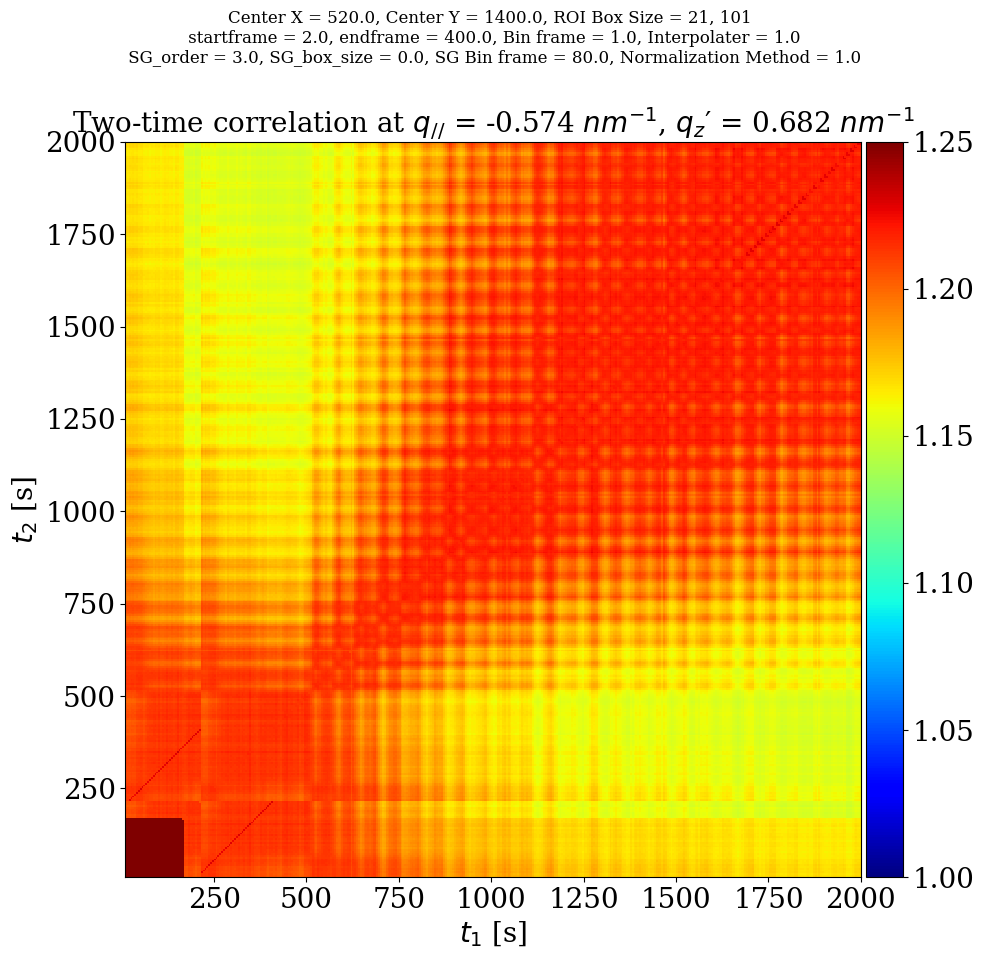

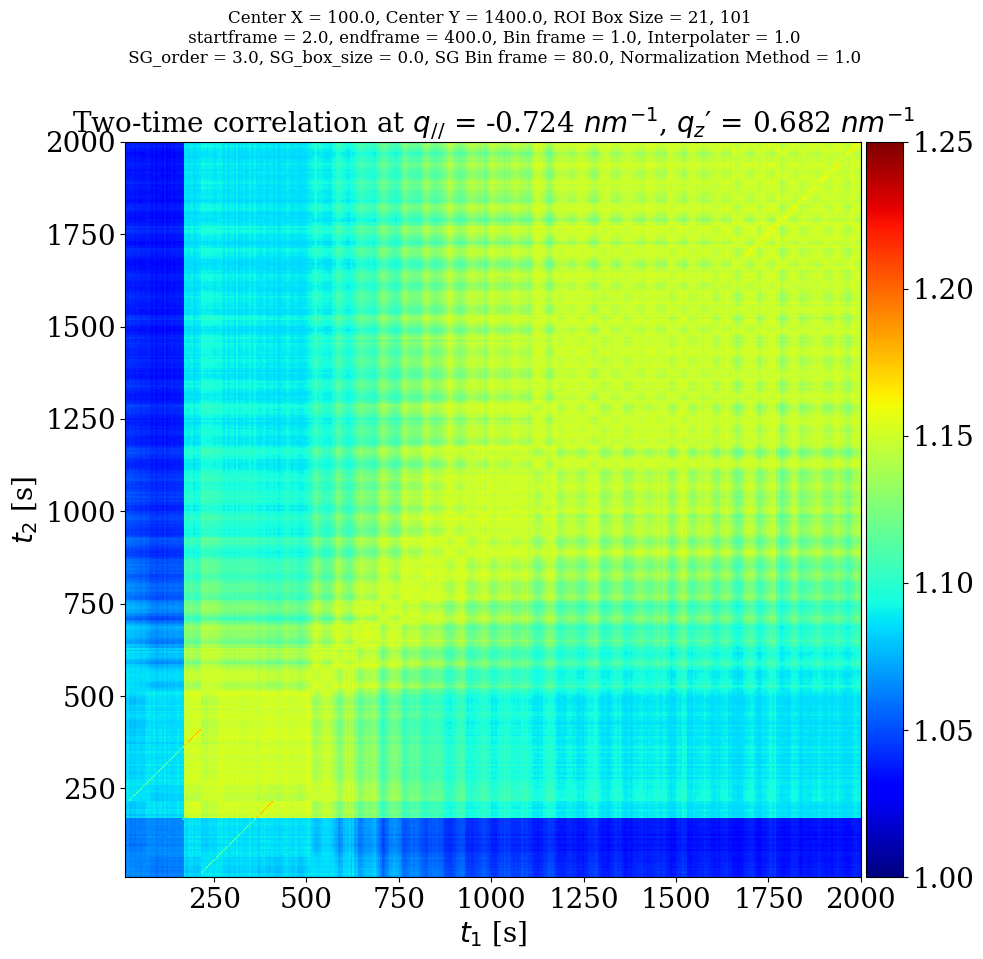

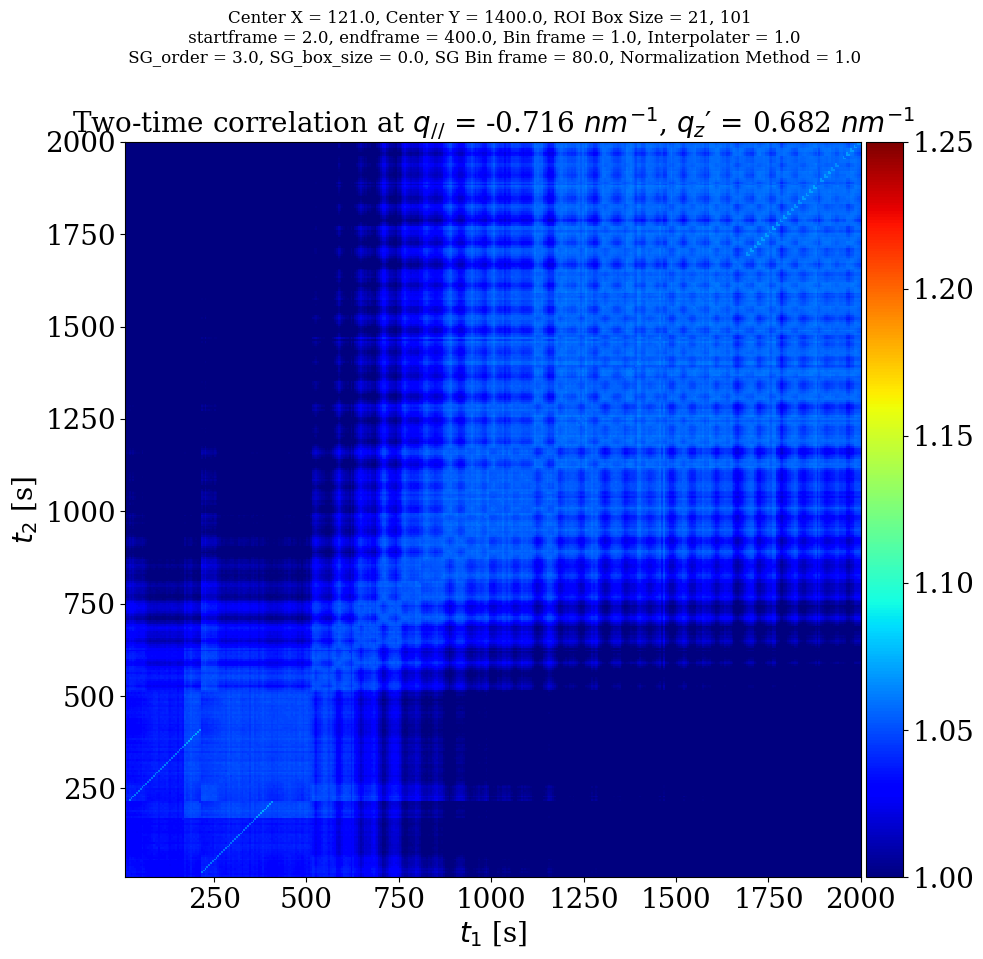

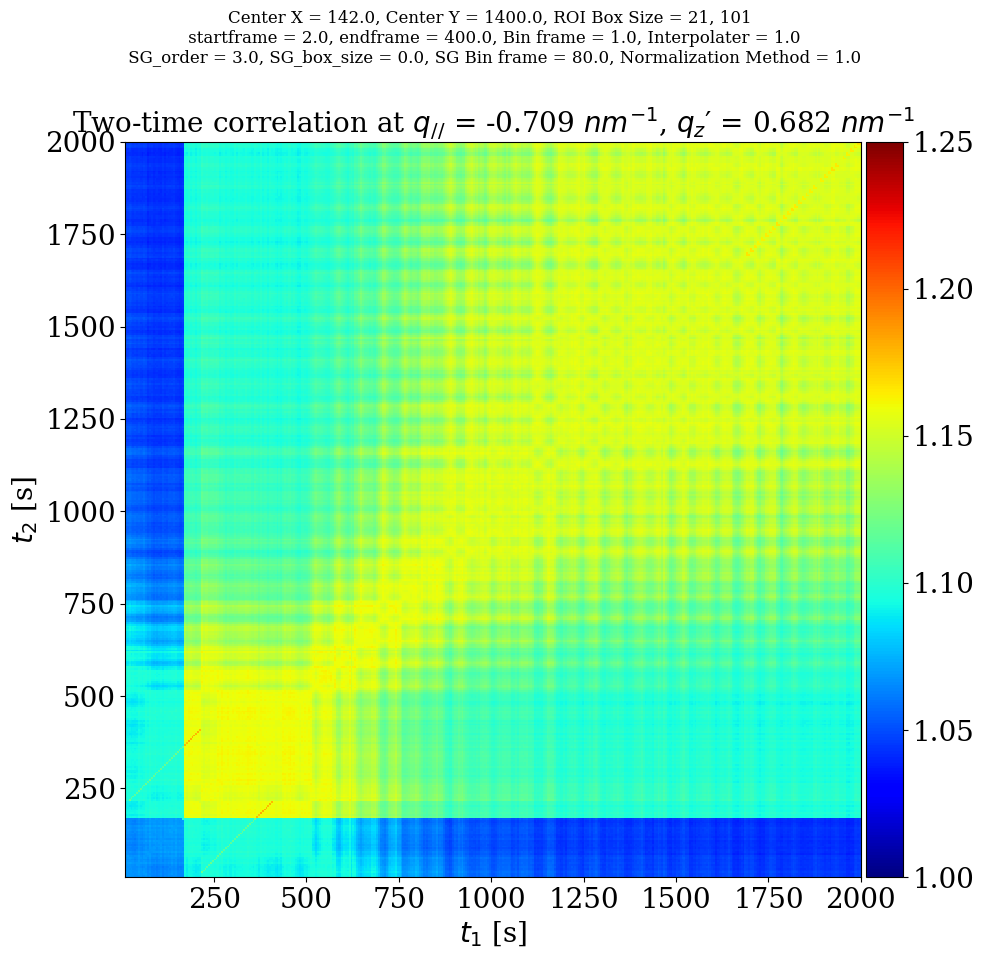

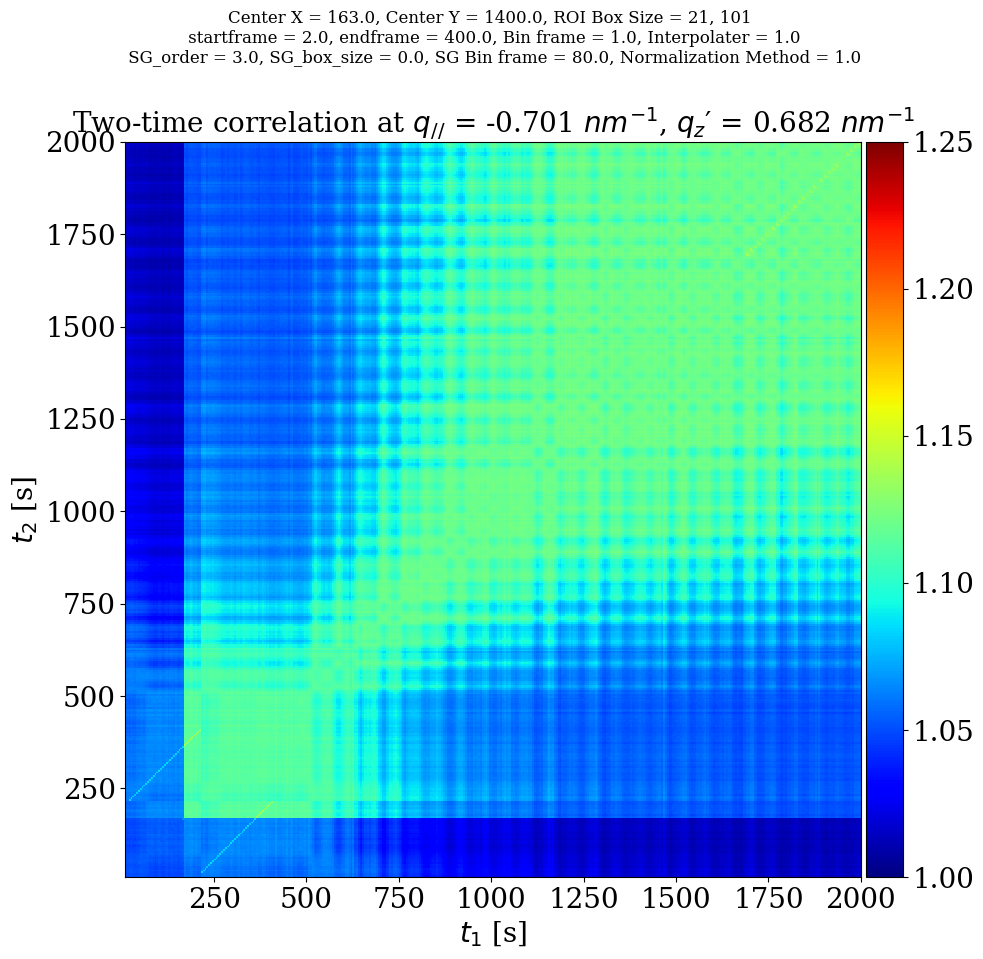

...

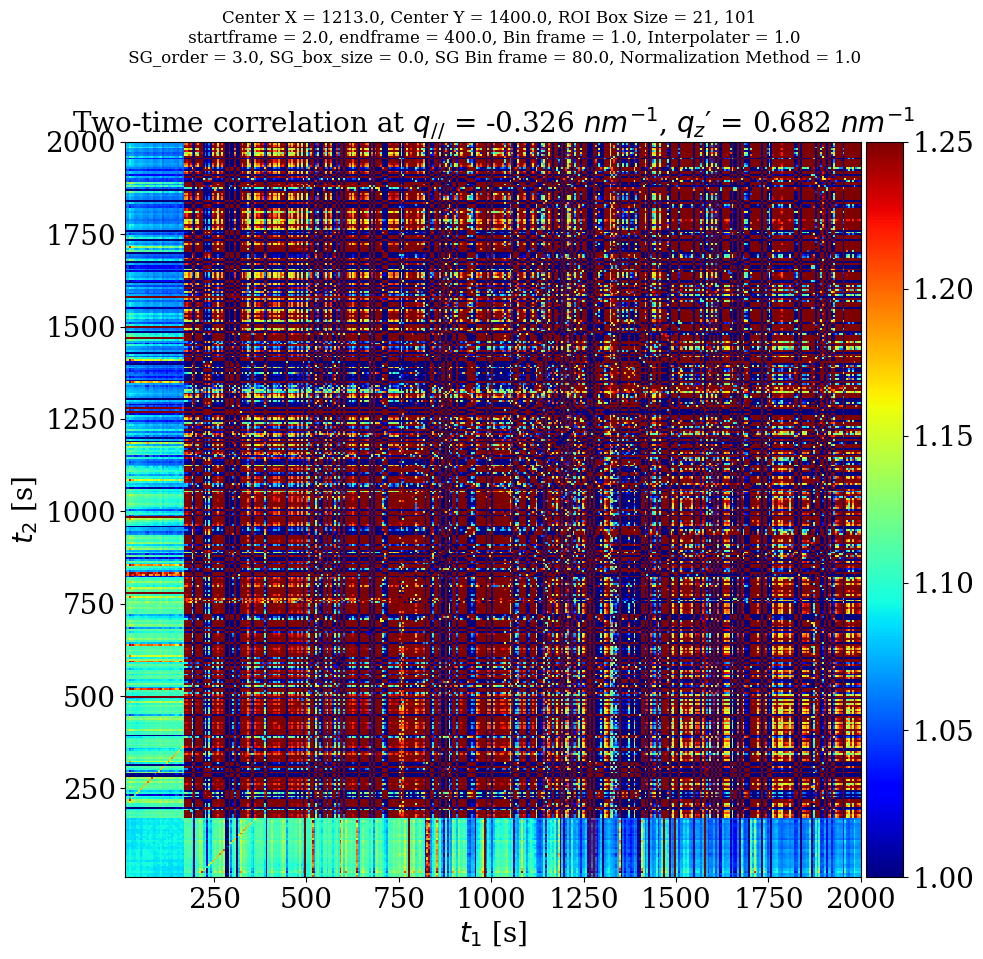

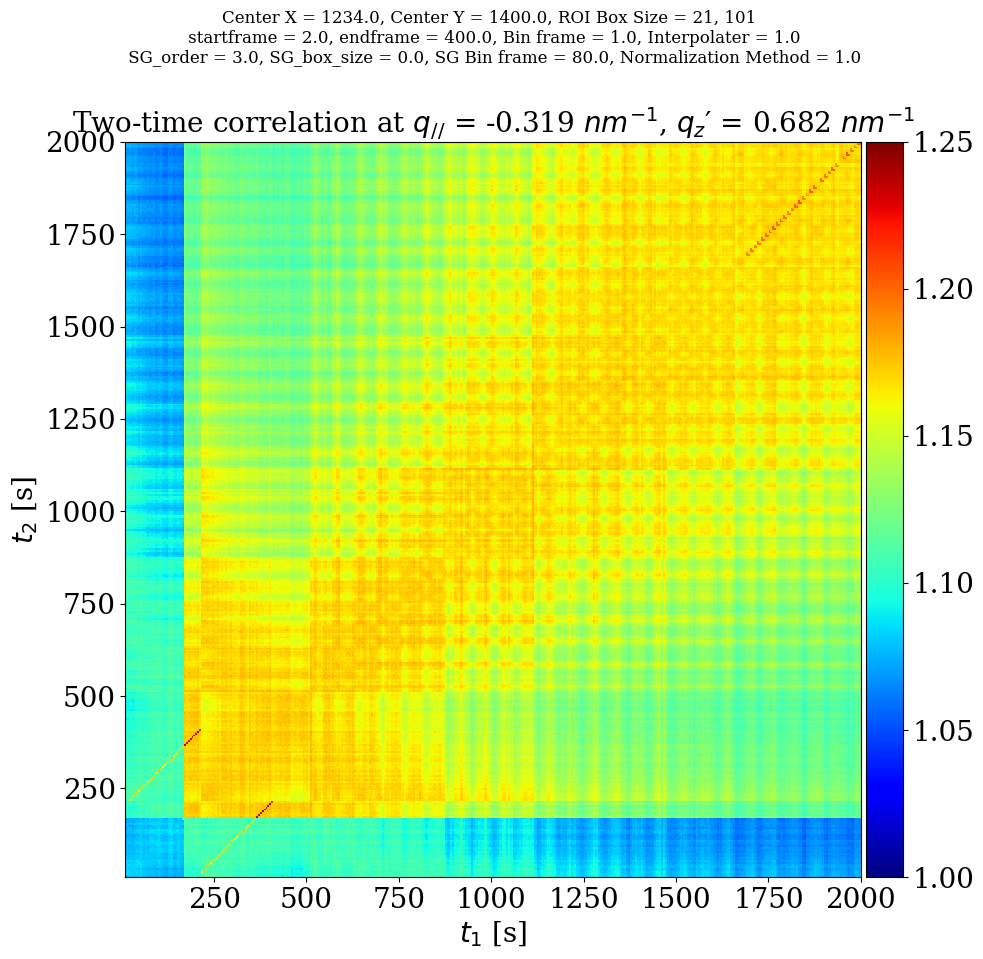

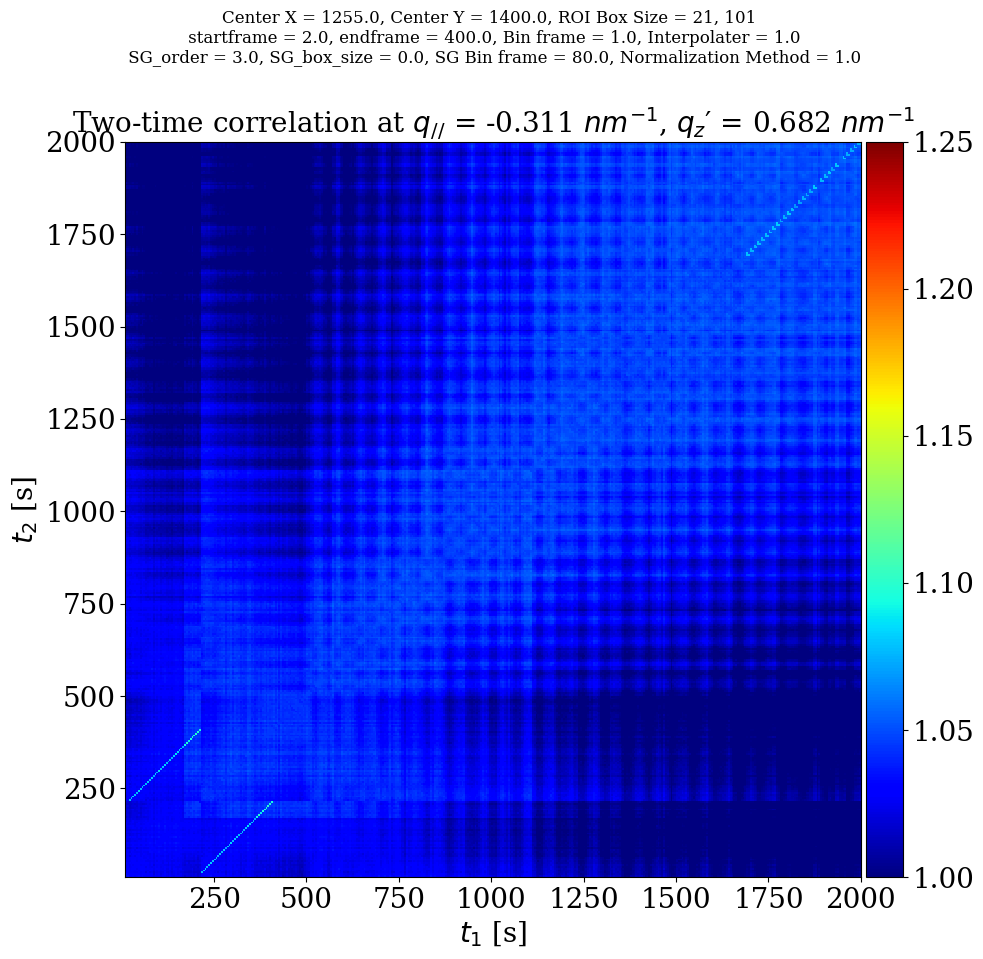

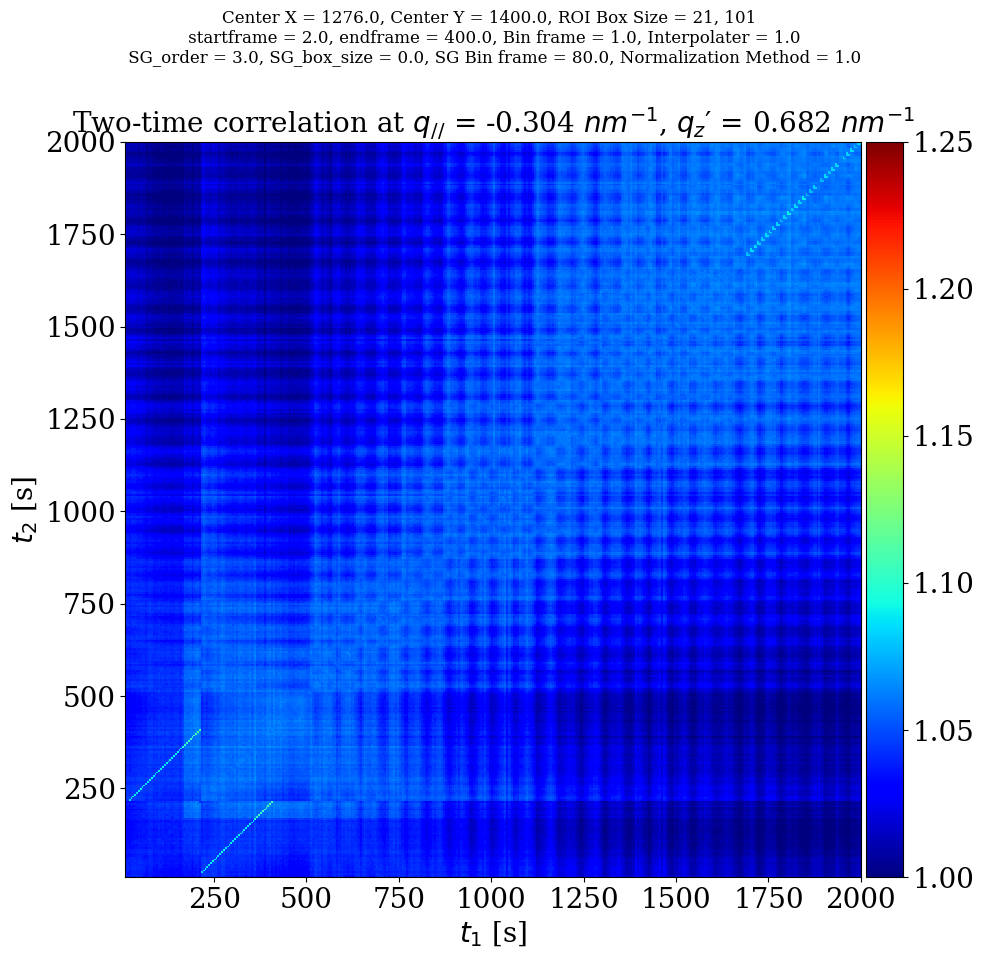

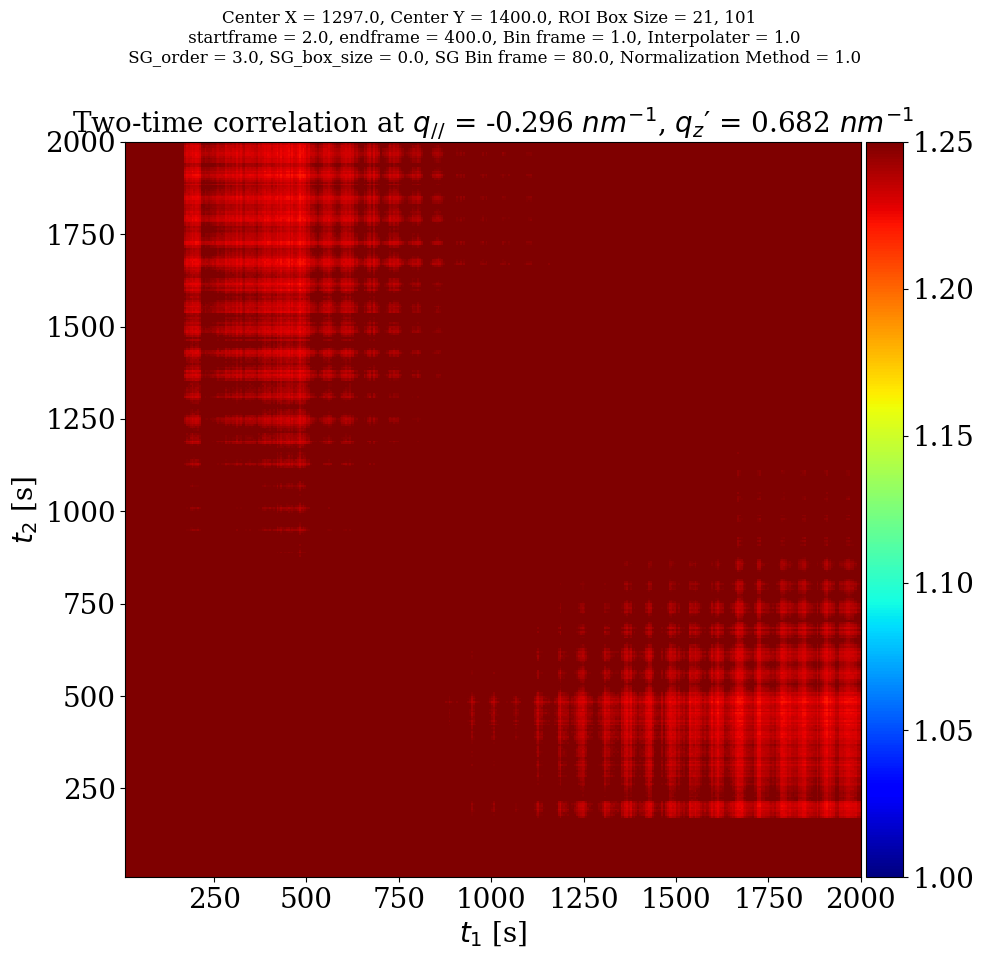

In [8]:
uid = 'ALD'

import os
CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = 2 ,endframe = 400 , centerx_start = 100, centerx_end = 1300, centery = 1400,peak_in_X = 750, boxsize = (21,101), bin_frame = 1, normalize = 1, SG_window = 0, SG_order = 3,  SG_bin_frame = 80, interpolate = 1)
TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
plotTTCF(TTCFs[20], color_min = 1 , color_max = 1.25, save = 0)

for i in range(58):
    plotTTCF(TTCFs[i], color_min = 1 , color_max = 1.25, save = 0)

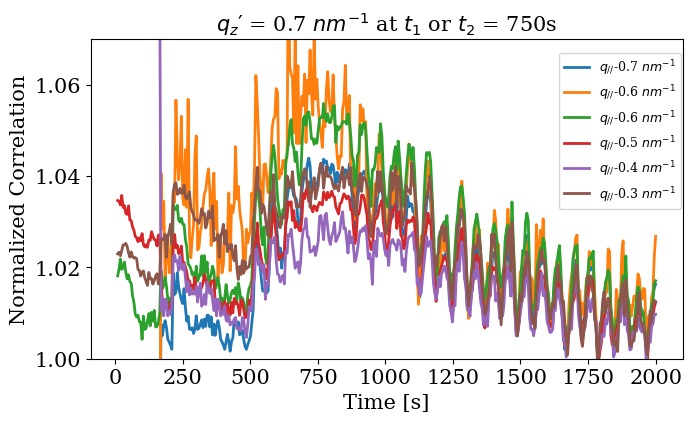

In [132]:
plt.figure()

for i in [4, 17, 22, 32, 44, 56]:
    select_num           = i
    toplot               = np.array(TTCFs[select_num][:-1])
    metadata             = TTCFs[select_num][-1]
    startframe,endframe, centerx, centery,boxsize, bin_frame, normalize, SG_window , SG_order ,  SG_bin_frame, interpolate = metadata[0],metadata[1],metadata[2],metadata[3],metadata[4],metadata[5],metadata[6], metadata[7],  metadata[8], metadata[9], metadata[10]    
    dimension            = np.shape(toplot)[0]
    color_min, color_max = 0.1, 1.2
    times_list           = [(startframe)*datatakingtime,((startframe)*datatakingtime)+((dimension)*datatakingtime*(bin_frame)),(startframe)*datatakingtime,((startframe)*datatakingtime)+((dimension)*datatakingtime*(bin_frame))]
    times                = np.linspace(times_list[0], times_list[1], num = dimension)
    TTCF_crosssec_time   = 750
    local_avg            = 5 # time


    crop                 = int(TTCF_crosssec_time//datatakingtime)
    local_avg            = int(local_avg//datatakingtime) 


    wavenumber           = r'$q_{//}$' + np.str_(np.round(convert_pixel_to_q(centerx, centery)[1],decimals=1))+ r' $nm^{-1}$'
    TTCF_crosssection    = np.average(toplot[crop-local_avg : crop+local_avg], axis = 0)
    plt.plot(times, TTCF_crosssection/np.min(TTCF_crosssection[dimension//2:]), label = wavenumber)
plt.xlabel('Time [s]')
plt.ylim(1,1.07)
plt.ylabel('Normalized Correlation')
plt.title(r'$q_z′$ = ' + np.str_(np.round(convert_pixel_to_q(centerx, centery)[7],decimals=1 )) + r' $nm^{-1}$' + r' at $t_1$ or $t_2$ = {0:d}s'.format(TTCF_crosssec_time) )
plt.legend(bbox_to_anchor= (0.78,0.45),loc = 'lower left', fontsize = 9)
plt.show()

# Now plot TTCF slices with varying $q_z'$

Dynamic_analysis_CHX.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  Can be used to do:


  0%|          | 0/5 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150077684, 1.6815491525442274, 1.6815491524867303, 1.6815491524227761, 1.6815491531451796, 1.6815491528811188] 1.6815491522596193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499610085, 1.6815491528348705, 1.68154915245643, 1.6815491521910282, 1.6815491524343384, 1.6815491527071122] 1.6815491520974646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499663238, 1.6815491525393442, 1.6815491526722353, 1.6815491523570394, 1.6815491525878636, 1.6815491525525075] 1.6815491521125525 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500397721, 1.681549152690259, 1.6815491523447728, 1.6815491521841555, 1.6815491529754638, 1.6815491529295334] 1.681549152193993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498351172, 1.6815491525338606, 1.681549152121124, 1.6815491523394313, 1.681549152968362, 1.6815491529142523] 1.6815491521186912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500467794, 1.6815491522540262, 1.6815491524081132, 1.6815491520419297, 1.6815491527035151, 1.6815491526283668] 1.6815491520137886 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500267807, 1.6815491524851618, 1.6815491523285147, 1.6815491521911392, 1.6815491527954243, 1.6815491527338153] 1.6815491520934727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502073847, 1.6815491525783743, 1.681549152559913, 1.6815491520519896, 1.681549152704291, 1.681549152720446] 1.6815491521370662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149914225, 1.6815491525364257, 1.6815491523304145, 1.6815491523359656, 1.6815491528064443, 1.6815491527053568] 1.6815491521048054 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501960178, 1.6815491524663821, 1.681549152455677, 1.6815491525365767, 1.6815491527579915, 1.6815491529429156] 1.6815491522259267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501820903, 1.6815491527866682, 1.6815491524609776, 1.6815491522601707, 1.6815491529761335, 1.6815491525507134] 1.6815491522027923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499556976, 1.6815491521959096, 1.6815491524320896, 1.6815491521611818, 1.6815491525666237, 1.6815491525444988] 1.6815491519760002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501238813, 1.6815491525349486, 1.6815491524272126, 1.681549152527559, 1.681549152723655, 1.6815491525544637] 1.68154915214862 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149952906, 1.6815491526392963, 1.6815491524171877, 1.6815491523670736, 1.6815491526083814, 1.681549152868154] 1.6815491521421666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502402802, 1.6815491525949247, 1.6815491524438548, 1.6815491521711716, 1.6815491528356383, 1.6815491529594002] 1.681549152207545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497085793, 1.6815491525239468, 1.6815491521322214, 1.6815491525709305, 1.6815491529263857, 1.68154915234717] 1.6815491520348722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497410084, 1.6815491524611685, 1.6815491524309927, 1.6815491526678246, 1.6815491523224741, 1.6815491529533064] 1.6815491520961292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502715734, 1.6815491523639845, 1.681549152592397, 1.681549152095934, 1.6815491529920203, 1.681549152918846] 1.6815491522057924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500013993, 1.6815491525954824, 1.6815491528071438, 1.6815491523751112, 1.6815491529833078, 1.6815491528283122] 1.681549152265126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149987469, 1.6815491525562356, 1.6815491524607147, 1.6815491526206556, 1.6815491526835977, 1.6815491530329472] 1.6815491522236032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150127196, 1.6815491525761432, 1.6815491524756436, 1.6815491523816801, 1.6815491528687656, 1.6815491527688797] 1.6815491521997181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149622941, 1.6815491523317454, 1.6815491525613204, 1.6815491522755055, 1.6815491526428206, 1.6815491524207475] 1.6815491519758468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502355355, 1.681549152603631, 1.6815491524034467, 1.6815491523335648, 1.6815491533135134, 1.6815491524691506] 1.6815491522264736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500688449, 1.6815491528727664, 1.6815491524787722, 1.6815491525242585, 1.6815491530813782, 1.6815491525384103] 1.6815491522607386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150118216, 1.6815491529848363, 1.6815491523864186, 1.6815491520335488, 1.6815491529790334, 1.6815491529984277] 1.6815491522500803 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497235358, 1.6815491525192279, 1.6815491522593042, 1.6815491521303705, 1.6815491526747506, 1.6815491529104665] 1.6815491520362762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149736571, 1.6815491525134503, 1.6815491525040058, 1.6815491522697354, 1.6815491532479374, 1.681549152955522] 1.6815491522045372 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502010138, 1.681549152493509, 1.6815491521799606, 1.6815491524053021, 1.6815491526886368, 1.6815491526408] 1.681549152101537 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149835687, 1.6815491525098016, 1.6815491523109811, 1.681549152523326, 1.6815491527362916, 1.6815491528628241] 1.6815491521298185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149725873, 1.6815491524469754, 1.6815491526177233, 1.6815491522416188, 1.6815491528268316, 1.6815491527306232] 1.6815491520982742 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150044062, 1.6815491529066167, 1.6815491521686061, 1.6815491523440524, 1.6815491529131066, 1.6815491528660136] 1.681549152207076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500090105, 1.6815491525904536, 1.68154915227589, 1.6815491521756094, 1.6815491527881408, 1.6815491525901107] 1.6815491520715362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498933417, 1.6815491525687571, 1.6815491519147852, 1.6815491522161774, 1.6815491525926767, 1.681549152275175] 1.6815491519101524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497597805, 1.6815491526482047, 1.6815491522154637, 1.6815491524603052, 1.6815491528278486, 1.6815491525743678] 1.681549152080995 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499164037, 1.6815491525650605, 1.6815491521675945, 1.6815491523142456, 1.6815491526938535, 1.6815491525598212] 1.681549152036163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496008312, 1.6815491527358768, 1.6815491521665304, 1.6815491523486799, 1.6815491526619244, 1.6815491526943642] 1.681549152034701 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498303397, 1.6815491522291088, 1.6815491522041066, 1.6815491520780323, 1.6815491527321615, 1.681549152447773] 1.6815491519202534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499058766, 1.6815491528703452, 1.6815491523484072, 1.6815491523088264, 1.6815491521746733, 1.6815491525093371] 1.6815491520195778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497687542, 1.6815491526312059, 1.681549152010481, 1.6815491519204455, 1.681549152668464, 1.6815491529035715] 1.6815491519838204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499346038, 1.681549152532262, 1.68154915250968, 1.681549152043769, 1.6815491527023116, 1.681549152711062] 1.6815491520722814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499624633, 1.6815491525793975, 1.6815491522506427, 1.6815491519329986, 1.6815491525515949, 1.6815491525129058] 1.6815491519650003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500424824, 1.6815491525746236, 1.6815491521959913, 1.6815491523542914, 1.681549152786502, 1.681549152728194] 1.681549152113681 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496085553, 1.6815491523547705, 1.6815491522867045, 1.6815491523513506, 1.6815491526268382, 1.6815491527839375] 1.6815491520020263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498658912, 1.6815491523893824, 1.6815491522340356, 1.6815491518655565, 1.6815491527903372, 1.681549152365084] 1.6815491519183814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546371509012, 1.681546720212368, 1.6815466753504773, 1.6815466627604634, 1.6815467275336973, 1.6815467288831258] 1.6815466477081904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496930863, 1.6815491527334747, 1.6815491523075536, 1.6815491519513408, 1.681549152388044, 1.6815491526659008] 1.6815491519565668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914994994, 1.6815491526615958, 1.6815491523143944, 1.681549151942587, 1.681549152891213, 1.6815491528009474] 1.6815491520934465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496936792, 1.6815491528662125, 1.6815491522856316, 1.6815491519299886, 1.681549152621665, 1.681549152729974] 1.6815491520211918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500826831, 1.6815491530002387, 1.681549152443179, 1.6815491522961814, 1.6815491525033597, 1.681549152566486] 1.681549152148688 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150115437, 1.681549152572095, 1.6815491522042247, 1.6815491521143295, 1.6815491523176131, 1.6815491529709012] 1.6815491520491002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497301163, 1.6815491527161743, 1.681549152001932, 1.681549151835271, 1.681549152672435, 1.6815491529183042] 1.6815491519790389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497913797, 1.6815491529733437, 1.6815491522524768, 1.6815491523114199, 1.6815491526658244, 1.6815491527864674] 1.6815491521301518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149926278, 1.681549152882568, 1.6815491523649544, 1.6815491521143056, 1.681549152567916, 1.681549152688853] 1.6815491520908126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496133, 1.6815491525348327, 1.6815491521778418, 1.6815491521651098, 1.6815491527173956, 1.6815491526562871] 1.6815491519774615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496243662, 1.6815491527469275, 1.6815491519786159, 1.6815491520148291, 1.6815491522819928, 1.6815491524484] 1.681549151849189 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497308068, 1.681549152567067, 1.6815491520772334, 1.681549152041728, 1.6815491524970194, 1.6815491523183779] 1.681549151872039 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497435202, 1.6815491524643082, 1.6815491522604695, 1.6815491519599517, 1.6815491526470576, 1.6815491523227988] 1.6815491518996843 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498629602, 1.6815491527993736, 1.6815491520851982, 1.6815491519651689, 1.6815491526169728, 1.681549152617292] 1.6815491519911607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496529527, 1.6815491527201551, 1.6815491522458546, 1.681549151927165, 1.6815491526603799, 1.6815491525496205] 1.6815491519593546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497269903, 1.681549152676471, 1.6815491522547483, 1.681549151813174, 1.681549152312234, 1.6815491525202844] 1.6815491518839838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498686304, 1.6815491527631234, 1.6815491519951182, 1.6815491517162053, 1.6815491523448767, 1.6815491528403808] 1.6815491519213894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498757127, 1.6815491531421372, 1.6815491518270669, 1.681549151856463, 1.6815491522337385, 1.6815491528508435] 1.6815491519643269 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149781512, 1.6815491527871878, 1.681549152126916, 1.6815491518333445, 1.6815491524792439, 1.6815491527742292] 1.6815491519637389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576414, 1.681549152664667, 1.6815491519662933, 1.6815491517046794, 1.6815491520092087, 1.6815491525833357] 1.681549151780971 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496260462, 1.6815491524433872, 1.6815491521210468, 1.6815491514565206, 1.6815491524621065, 1.6815491526151494] 1.6815491517873762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149607029, 1.6815491528582482, 1.681549151932444, 1.681549151823933, 1.6815491522880661, 1.6815491521474293] 1.6815491517761914 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149634372, 1.6815491526653128, 1.6815491523236354, 1.6815491521517116, 1.6815491528122442, 1.6815491530303381] 1.6815491521029358 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497867558, 1.6815491524196569, 1.6815491519275803, 1.681549152115768, 1.68154915274686, 1.6815491523019932] 1.6815491518831027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491619938, 1.6815491528938606, 1.6815491523209882, 1.6815491519159123, 1.6815491527282798, 1.6815491523356125] 1.6815491518927745 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149528054, 1.6815491525026616, 1.6815491520907937, 1.6815491520700538, 1.6815491524485227, 1.6815491523324306] 1.6815491518287526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497937085, 1.6815491528412823, 1.681549152045342, 1.6815491515864038, 1.6815491522696986, 1.6815491521995747] 1.681549151789335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149266135, 1.6815491526500832, 1.6815491518954242, 1.681549151750434, 1.681549152540974, 1.6815491526745756] 1.681549151796271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492811288, 1.6815491528486222, 1.6815491518650165, 1.6815491516638392, 1.6815491519287757, 1.6815491524779116] 1.681549151677549 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152718067, 1.6815491518626535, 1.681549151572837, 1.681549152067289, 1.6815491525818498] 1.6815491521605392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492536125, 1.6815491525002448, 1.6815491515914935, 1.6815491514577232, 1.6815491520527859, 1.6815491525639983] 1.6815491515699765 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149500679, 1.6815491523613737, 1.6815491516225407, 1.68154915158267, 1.681549152054977, 1.681549152538278] 1.6815491516100864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524604536, 1.681549151602232, 1.6815491516958154, 1.681549152169299, 1.6815491522836492] 1.6815491520422896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491866634, 1.6815491525463404, 1.6815491517000476, 1.68154915194157, 1.681549152545946, 1.6815491524758075] 1.6815491517327292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495185846, 1.6815491528468995, 1.6815491518837695, 1.6815491517598895, 1.681549152169279, 1.6815491523188095] 1.6815491517495385 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494021777, 1.6815491526867552, 1.6815491520261139, 1.6815491513842553, 1.6815491524132904, 1.6815491526841067] 1.6815491517661165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495639674, 1.6815491523173103, 1.6815491517487215, 1.681549151851602, 1.6815491523899992, 1.6815491522351458] 1.6815491516844576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496302917, 1.681549152395799, 1.6815491517232548, 1.6815491517730532, 1.6815491525912396, 1.6815491526622317] 1.6815491517959782 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497189208, 1.681549152761388, 1.6815491514370269, 1.6815491517892465, 1.6815491519246955, 1.6815491523543935] 1.6815491516642787 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149724841, 1.6815491525019466, 1.6815491519205708, 1.6815491520464456, 1.6815491520104255, 1.6815491528313302] 1.68154915183926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494728643, 1.6815491525477944, 1.6815491517632646, 1.681549151753221, 1.6815491521402048, 1.681549152620839] 1.681549151716365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497852935, 1.6815491526874498, 1.6815491518219918, 1.68154915156635, 1.6815491521492332, 1.6815491526973165] 1.6815491517846057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493501566, 1.6815491525136164, 1.6815491520360464, 1.68154915198929, 1.6815491521290915, 1.6815491526871944] 1.6815491517842327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491526449984, 1.6815491517799535, 1.681549152129155, 1.6815491522197146, 1.681549152429378] 1.6815491522406396 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492613184, 1.6815491525257613, 1.681549151688683, 1.6815491518417272, 1.681549152279569, 1.6815491527426198] 1.6815491517232797 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495562025, 1.6815491526214075, 1.6815491515409704, 1.6815491515023813, 1.6815491523830932, 1.6815491524702386] 1.681549151679049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496736454, 1.6815491528013844, 1.6815491515433174, 1.6815491515804135, 1.681549152272324, 1.681549152390362] 1.6815491517102412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494354724, 1.6815491526919693, 1.681549151815557, 1.6815491517191044, 1.681549151969997, 1.6815491524000725] 1.681549151672029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495637591, 1.681549152726109, 1.6815491516339902, 1.6815491519159407, 1.6815491521592065, 1.681549152786241] 1.6815491517975412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493351464, 1.6815491523439752, 1.6815491518799393, 1.68154915188263, 1.6815491516929093, 1.6815491525302253] 1.6815491516108043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149512131, 1.6815491526599402, 1.681549151810409, 1.6815491514924057, 1.6815491524521127, 1.6815491525906179] 1.6815491517529362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495460657, 1.681549152607066, 1.6815491518346515, 1.681549151527089, 1.6815491522082837, 1.681549152567663] 1.6815491517151362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491522190191, 1.681549151730343, 1.6815491517701382, 1.681549152160787, 1.6815491523931456] 1.6815491520546868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492192627, 1.681549152738115, 1.6815491519181203, 1.681549151664056, 1.68154915211663, 1.6815491523686683] 1.6815491516708085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491541104, 1.6815491525492026, 1.6815491519474381, 1.6815491515937921, 1.6815491522130102, 1.6815491529344122] 1.6815491517319943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496691344, 1.6815491525487838, 1.6815491513457896, 1.6815491514602439, 1.6815491524258852, 1.6815491523745099] 1.681549151637391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495076538, 1.6815491524711814, 1.681549151683063, 1.6815491512892025, 1.6815491522605437, 1.68154915245782] 1.6815491516115777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492128505, 1.6815491525395405, 1.6815491518025985, 1.6815491516424443, 1.6815491522690147, 1.6815491524438677] 1.6815491516517191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149212004, 1.6815491526401507, 1.681549151785207, 1.681549151477936, 1.681549151865374, 1.6815491522555863] 1.6815491515393763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149661043, 1.6815491530023197, 1.681549151729103, 1.6815491515423382, 1.6815491521537798, 1.6815491521375776] 1.6815491517043604 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914937889, 1.6815491527631776, 1.6815491516866747, 1.681549151627184, 1.6815491519589223, 1.6815491525272255] 1.6815491516570125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149377254, 1.6815491527442736, 1.6815491516748593, 1.6815491514564238, 1.6815491521223285, 1.6815491526235529] 1.6815491516664487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495356345, 1.681549152476539, 1.6815491519127628, 1.6815491514081788, 1.6815491518588446, 1.6815491522158394] 1.6815491515679664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496848578, 1.681549152523937, 1.681549151645434, 1.6815491512169674, 1.6815491517540475, 1.6815491524829351] 1.681549151551363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492986148, 1.6815491525422477, 1.681549151696761, 1.6815491517798686, 1.6815491517848793, 1.6815491526295534] 1.6815491516219876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492039327, 1.6815491525020212, 1.681549151847857, 1.6815491515248322, 1.6815491519497505, 1.681549152469759] 1.6815491515830256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493643493, 1.6815491526592048, 1.6815491517100303, 1.6815491516463936, 1.6815491519145027, 1.68154915243746] 1.6815491516219903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495117847, 1.6815491525848807, 1.6815491514669656, 1.681549151617265, 1.681549151652976, 1.6815491523873929] 1.6815491515368777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491528394997, 1.681549151677765, 1.681549151209658, 1.681549152239186, 1.681549152312801] 1.6815491520557821 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525890796, 1.6815491518242895, 1.6815491520354549, 1.6815491521793016, 1.6815491525785555] 1.681549152241336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495796069, 1.6815491525270438, 1.6815491517954504, 1.6815491515101022, 1.6815491522907475, 1.6815491521816668] 1.6815491516474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491573353, 1.6815491524069426, 1.6815491516193863, 1.681549151487352, 1.68154915163079, 1.6815491525517134] 1.681549151475587 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494534216, 1.6815491523152262, 1.6815491517643544, 1.681549151861251, 1.6815491520985004, 1.6815491524541741] 1.6815491516578216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498496256, 1.6815491527971367, 1.6815491518925265, 1.6815491515260987, 1.681549151972701, 1.6815491524072943] 1.6815491517408974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492617722, 1.6815491524726704, 1.6815491516390204, 1.68154915172886, 1.6815491517101093, 1.6815491525356792] 1.6815491515580183 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492774988, 1.6815491528240414, 1.681549151779091, 1.6815491512646643, 1.6815491519832877, 1.6815491526480324] 1.6815491516294359 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525683863, 1.681549151540711, 1.6815491514424328, 1.68154915206626, 1.6815491524677832] 1.6815491520171146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152649911, 1.681549151244334, 1.6815491513200413, 1.6815491517005423, 1.6815491526080666] 1.6815491519045789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490975214, 1.6815491524626784, 1.681549151138209, 1.681549151181441, 1.681549152193031, 1.6815491525731172] 1.6815491514409997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149285404, 1.681549152525882, 1.6815491518090129, 1.6815491514220615, 1.6815491514952399, 1.6815491524903354] 1.6815491515046561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491452685, 1.6815491525601933, 1.6815491514245013, 1.681549151197717, 1.6815491522257249, 1.681549152190768] 1.681549151457362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491682053, 1.6815491526296085, 1.6815491514866938, 1.6815491513824607, 1.6815491520732473, 1.6815491525254158] 1.681549151544272 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493358312, 1.6815491524748456, 1.6815491512254015, 1.6815491514038596, 1.6815491518313883, 1.681549152612237] 1.6815491514805938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491147263, 1.6815491526456037, 1.6815491515335896, 1.6815491512211764, 1.6815491519756325, 1.6815491520982282] 1.6815491514314926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815462988423606, 1.6815467144770455, 1.6815465943035184, 1.6815465750571015, 1.6815466376431818, 1.6815467031204445] 1.6815465872406088 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149261452, 1.681549152394596, 1.6815491516026064, 1.6815491512626854, 1.6815491518223915, 1.6815491525600894] 1.6815491514839704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524027593, 1.6815491513784133, 1.6815491514473235, 1.6815491522097328, 1.6815491524085484] 1.6815491519693555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149000288, 1.6815491525458097, 1.681549151526557, 1.6815491513167813, 1.6815491519243047, 1.681549152721506] 1.6815491515058743 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489916474, 1.6815491524871482, 1.681549151363945, 1.681549151536236, 1.6815491515180998, 1.6815491524902884] 1.6815491513978944 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491767203, 1.6815491527147244, 1.6815491515435133, 1.681549151287418, 1.6815491516272063, 1.6815491522777948] 1.6815491514378964 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149066436, 1.6815491525740018, 1.681549151453873, 1.6815491511254157, 1.6815491518601267, 1.6815491521237749] 1.6815491513672713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490110364, 1.6815491526011432, 1.6815491514211707, 1.6815491512258824, 1.681549151660092, 1.681549152671284] 1.6815491514317682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149630941, 1.681549152421085, 1.6815491513932619, 1.6815491512045697, 1.6815491514266334, 1.6815491522902235] 1.6815491513944523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148980325, 1.6815491525930777, 1.6815491515868906, 1.6815491514447851, 1.681549151454047, 1.6815491520805175] 1.681549151356607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490888945, 1.681549152536653, 1.681549151496811, 1.6815491514977632, 1.681549152027221, 1.681549152437741] 1.6815491515141805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521722379, 1.6815491515788583, 1.6815491512950023, 1.6815491518898358, 1.681549152010116] 1.6815491517892098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491728563, 1.6815491522687323, 1.6815491512641882, 1.6815491511425726, 1.6815491519461352, 1.6815491525697581] 1.6815491513940402 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149166358, 1.681549152234612, 1.6815491515598868, 1.6815491515236372, 1.6815491521051107, 1.6815491527765234] 1.6815491515610212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491351366, 1.6815491524164958, 1.6815491513450143, 1.6815491513480132, 1.6815491518641155, 1.6815491522578574] 1.6815491513944387 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493237835, 1.681549152603131, 1.6815491514474274, 1.6815491510990492, 1.681549151391489, 1.6815491525671882] 1.6815491514053447 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490382222, 1.681549152368369, 1.68154915126971, 1.681549151301096, 1.681549152095859, 1.6815491525324502] 1.6815491514342849 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148997771, 1.6815491523850015, 1.6815491515602012, 1.6815491511714966, 1.6815491515352967, 1.681549152849283] 1.6815491514165082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491527017228, 1.6815491516295618, 1.681549151011919, 1.6815491516020402, 1.6815491525935995] 1.681549151907769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491031471, 1.6815491528421314, 1.6815491513475322, 1.681549151216244, 1.6815491519086128, 1.681549152571015] 1.6815491514981133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149179732, 1.681549152380192, 1.681549151135096, 1.6815491511464034, 1.6815491518323138, 1.68154915221634] 1.6815491513150127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490116186, 1.6815491523940516, 1.6815491514254286, 1.681549150922351, 1.6815491518515993, 1.681549152072055] 1.6815491512795173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493020827, 1.6815491524414474, 1.6815491514141714, 1.681549150950679, 1.6815491516683352, 1.6815491525313808] 1.681549151384683 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488289886, 1.681549152209092, 1.6815491514633925, 1.68154915130672, 1.6815491518518577, 1.681549151779751] 1.6815491512399667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488463206, 1.6815491523097403, 1.681549151303781, 1.6815491511998903, 1.6815491516480083, 1.6815491524472703] 1.6815491512925018 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491219356, 1.6815491523676842, 1.6815491515948002, 1.6815491513842655, 1.6815491518383379, 1.6815491523423054] 1.6815491514415548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488438483, 1.681549152357892, 1.681549151746263, 1.6815491513622614, 1.681549151715703, 1.681549152523142] 1.6815491514248517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488208991, 1.6815491524267507, 1.6815491513719985, 1.6815491515611853, 1.6815491518229186, 1.681549152766122] 1.6815491514616456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490943772, 1.681549152593277, 1.681549150995255, 1.681549151033467, 1.6815491516613243, 1.6815491526770368] 1.681549151342456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152692086, 1.681549151489254, 1.6815491508054654, 1.6815491519082078, 1.6815491525953297] 1.6815491518980685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493383412, 1.681549152375939, 1.6815491517596741, 1.68154915107591, 1.6815491514094068, 1.6815491527603506] 1.68154915145327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149092696, 1.6815491529589086, 1.6815491517497563, 1.681549151195934, 1.6815491513986962, 1.681549152538099] 1.6815491514890148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489228545, 1.6815491527077135, 1.681549151234326, 1.6815491510218177, 1.6815491517337153, 1.681549152260076] 1.6815491513134173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489068397, 1.6815491522246107, 1.6815491512858216, 1.6815491513199419, 1.681549151708725, 1.6815491523615211] 1.6815491513012433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489383891, 1.68154915255261, 1.6815491514318346, 1.6815491517033436, 1.6815491514999978, 1.6815491528065407] 1.6815491514887861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491845105, 1.6815491523782775, 1.6815491515265029, 1.6815491510233418, 1.6815491517039005, 1.681549152294724] 1.681549151351876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490435743, 1.6815491523673467, 1.6815491512383347, 1.681549151242148, 1.6815491515919252, 1.6815491522343988] 1.6815491512862881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488484389, 1.6815491524968822, 1.6815491517033188, 1.6815491509728897, 1.681549151551918, 1.6815491524448998] 1.6815491513363912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493327586, 1.6815491521259203, 1.681549151415056, 1.6815491512787863, 1.6815491520169288, 1.6815491525862996] 1.6815491514592915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491016963, 1.6815491527673005, 1.6815491511747922, 1.6815491513234226, 1.6815491515706311, 1.6815491524317383] 1.68154915139493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491284629, 1.6815491522515797, 1.6815491511228982, 1.6815491512288228, 1.681549151531574, 1.681549152515863] 1.6815491512965337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486116332, 1.6815491523771806, 1.6815491512557772, 1.6815491509350506, 1.6815491520245986, 1.6815491524955042] 1.681549151283291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524309287, 1.6815491512998193, 1.6815491513987828, 1.6815491518657995, 1.681549152653096] 1.6815491519296852 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488548657, 1.6815491524584223, 1.6815491513596994, 1.6815491511496, 1.6815491516769177, 1.6815491527552595] 1.681549151375794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490352992, 1.681549152635876, 1.6815491512111707, 1.6815491510665073, 1.6815491516153842, 1.6815491526731652] 1.6815491513729004 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488574108, 1.6815491524694623, 1.6815491514377299, 1.6815491514675944, 1.6815491518818728, 1.6815491523211232] 1.6815491514058658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491535761, 1.6815491525912307, 1.6815491512281984, 1.6815491512757212, 1.6815491521652355, 1.68154915207468] 1.6815491514147738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493766395, 1.6815491522990156, 1.6815491514260699, 1.6815491510154232, 1.6815491519316295, 1.6815491522807453] 1.6815491513882534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488267487, 1.6815491524331998, 1.6815491511080043, 1.6815491511529626, 1.6815491514824172, 1.6815491521881802] 1.6815491511985856 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520207226, 1.6815491516163439, 1.6815491511939937, 1.6815491516515069, 1.681549152578162] 1.681549151812146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149002044, 1.681549152266482, 1.6815491513242873, 1.68154915080983, 1.6815491512598069, 1.6815491520933739] 1.6815491511259708 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490489247, 1.6815491523110029, 1.6815491512579124, 1.6815491510182232, 1.6815491514204597, 1.6815491521875794] 1.6815491512073504 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484722953, 1.681549152573826, 1.6815491511314042, 1.6815491510456586, 1.6815491513982326, 1.6815491526115354] 1.6815491512054919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914886866, 1.6815491522331025, 1.6815491509718, 1.6815491511449023, 1.6815491517758225, 1.6815491525516948] 1.6815491512576637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149096118, 1.6815491523623907, 1.6815491513778387, 1.6815491513253713, 1.681549151842165, 1.6815491524060828] 1.6815491514016612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149049915, 1.6815491523285377, 1.681549150779209, 1.6815491509795306, 1.6815491515238241, 1.6815491524908088] 1.6815491511919707 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152447598, 1.6815491510466476, 1.6815491511383263, 1.681549151309924, 1.6815491526586843] 1.6815491517202361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493971355, 1.6815491524936625, 1.6815491512500795, 1.6815491510330567, 1.6815491516817653, 1.681549152208218] 1.6815491513439864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490497791, 1.681549152486177, 1.6815491513112804, 1.6815491511355347, 1.6815491514033152, 1.6815491523774369] 1.6815491512939207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491721666, 1.6815491519868107, 1.6815491510838698, 1.6815491514635257, 1.6815491514777818, 1.6815491523801782] 1.6815491512607224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489788945, 1.6815491523470492, 1.6815491514368146, 1.6815491508964682, 1.6815491514194107, 1.6815491523764248] 1.6815491512425103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492531693, 1.6815491527317308, 1.6815491513271623, 1.6815491510172818, 1.681549151873643, 1.6815491523921042] 1.6815491514325156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491042285, 1.6815491521680777, 1.681549151546923, 1.6815491510100733, 1.681549151624485, 1.681549152331474] 1.6815491512975436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488158139, 1.6815491525250335, 1.6815491512638232, 1.6815491508970712, 1.6815491516847354, 1.68154915253871] 1.6815491512875311 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489137675, 1.6815491528254496, 1.681549151465918, 1.6815491511568323, 1.6815491516163288, 1.6815491527760908] 1.6815491514590646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521379249, 1.681549151190692, 1.6815491507006772, 1.681549151447494, 1.6815491525066664] 1.6815491515966907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490320507, 1.6815491522673747, 1.6815491509312515, 1.68154915082369, 1.681549151850037, 1.6815491525076496] 1.6815491512353422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489042786, 1.681549152939092, 1.6815491511639502, 1.6815491509453215, 1.6815491516059748, 1.6815491524745756] 1.6815491513388654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491687107, 1.6815491525066735, 1.6815491514551226, 1.6815491510651683, 1.6815491515334635, 1.6815491526397492] 1.6815491513948146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491271821, 1.6815491519803194, 1.681549151466264, 1.6815491509707874, 1.681549151500782, 1.6815491522439223] 1.6815491512148764 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489688768, 1.6815491522688468, 1.6815491513107226, 1.6815491510235487, 1.681549151167642, 1.6815491523564337] 1.6815491511826783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488089682, 1.6815491523678805, 1.6815491512839134, 1.6815491509334395, 1.6815491512409735, 1.6815491526575834] 1.6815491512154594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489921293, 1.681549152617519, 1.6815491514532392, 1.6815491509266502, 1.6815491511768172, 1.6815491522026695] 1.681549151228171 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488845828, 1.6815491524854327, 1.6815491510580314, 1.6815491511116658, 1.6815491515293024, 1.6815491524131447] 1.6815491512470266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491827324, 1.6815491522558697, 1.681549150761028, 1.681549150887684, 1.6815491512696195, 1.6815491523630746] 1.6815491511200016 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485564502, 1.681549152200057, 1.6815491510143499, 1.6815491508866032, 1.6815491511576757, 1.6815491522552573] 1.6815491510117322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488321905, 1.6815491518927628, 1.6815491512072374, 1.6815491504521614, 1.6815491513847913, 1.6815491527342274] 1.6815491510838951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486608534, 1.6815491524924058, 1.681549150963114, 1.6815491509398273, 1.6815491512527068, 1.681549152624748] 1.6815491511556093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486902792, 1.6815491524093233, 1.6815491509085523, 1.681549150855214, 1.6815491513200254, 1.6815491523521588] 1.6815491510892588 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525344353, 1.6815491509834013, 1.6815491509708425, 1.6815491514098637, 1.6815491521915265] 1.6815491516180139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487176915, 1.681549151996521, 1.6815491511616587, 1.6815491511014211, 1.6815491513769043, 1.6815491523189379] 1.6815491511121892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489631755, 1.6815491520880448, 1.6815491509464744, 1.6815491509173164, 1.6815491512037646, 1.6815491521020594] 1.6815491510368057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485184069, 1.6815491523748984, 1.6815491517175927, 1.6815491508103033, 1.6815491514195857, 1.6815491523232962] 1.6815491511940135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148788147, 1.6815491523863142, 1.6815491509536349, 1.6815491506369584, 1.6815491515844503, 1.6815491522352852] 1.681549151097465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546241384249, 1.68154667942457, 1.6815465345502139, 1.6815465087268087, 1.6815465739524358, 1.6815466845625204] 1.681546537100133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149119986, 1.6815491521211885, 1.6815491512677099, 1.6815491510292633, 1.6815491514273946, 1.6815491521147612] 1.6815491511800509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490799817, 1.6815491522511992, 1.6815491510808842, 1.6815491505958136, 1.6815491515002448, 1.6815491518998993] 1.6815491510680038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520575554, 1.6815491511801475, 1.6815491507410805, 1.6815491514352834, 1.681549152154533] 1.6815491515137198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518507684, 1.6815491512295804, 1.6815491506978884, 1.6815491513978973, 1.6815491524749033] 1.681549151530208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483714986, 1.681549151906565, 1.6815491510625993, 1.6815491508207963, 1.6815491512611267, 1.6815491522358523] 1.681549150943073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148802549, 1.6815491523772894, 1.6815491512268474, 1.6815491509174576, 1.6815491512243987, 1.6815491523873796] 1.681549151155987 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148491162, 1.6815491523436972, 1.681549151081784, 1.6815491507153828, 1.6815491510393201, 1.6815491525202262] 1.6815491510319287 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487242702, 1.681549152363596, 1.6815491510963207, 1.6815491509046563, 1.68154915158002, 1.6815491524412884] 1.6815491511850251 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487569343, 1.6815491521495103, 1.6815491509676628, 1.681549150758518, 1.6815491511126694, 1.6815491518993593] 1.6815491509407758 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524029267, 1.681549151023055, 1.6815491509964002, 1.6815491510375344, 1.6815491522057222] 1.6815491515331278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485704492, 1.6815491522585084, 1.6815491508755547, 1.6815491510937166, 1.681549151436501, 1.6815491520331172] 1.6815491510446412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487118215, 1.6815491519956565, 1.6815491511366298, 1.681549150943292, 1.681549151586144, 1.6815491521740205] 1.6815491510912608 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521907004, 1.681549151012431, 1.6815491509406453, 1.6815491514428533, 1.681549151857717] 1.6815491514888692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148616413, 1.6815491521645236, 1.6815491509467813, 1.6815491511915615, 1.6815491513226326, 1.6815491520726882] 1.6815491510524332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148756841, 1.6815491519951902, 1.6815491509987766, 1.68154915087257, 1.6815491512021135, 1.6815491524579462] 1.6815491510472398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482046538, 1.6815491521535488, 1.6815491510638907, 1.6815491511637894, 1.681549151534063, 1.6815491522944157] 1.6815491510690606 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486646899, 1.681549152401253, 1.6815491509869087, 1.681549150727223, 1.681549151492538, 1.6815491525928046] 1.6815491511442362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490762655, 1.6815491522476158, 1.6815491511745195, 1.6815491508035905, 1.6815491516049188, 1.6815491525630648] 1.6815491512449958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484723517, 1.6815491523706982, 1.6815491508532805, 1.6815491505456661, 1.6815491515426801, 1.6815491522821633] 1.68154915101114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487190464, 1.6815491524665056, 1.6815491510137242, 1.681549150993412, 1.6815491514579008, 1.681549151972586] 1.6815491511038625 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148279279, 1.68154915186275, 1.6815491511257088, 1.68154915069681, 1.681549151228733, 1.6815491520323036] 1.6815491508709306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520623254, 1.6815491509936438, 1.681549150757144, 1.6815491513134582, 1.6815491523512662] 1.6815491514955674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520557684, 1.6815491506049978, 1.6815491508338871, 1.6815491512916845, 1.6815491521389019] 1.6815491513850478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486297485, 1.6815491519258399, 1.6815491511352176, 1.681549150621073, 1.681549151382355, 1.6815491517197616] 1.6815491509023321 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487140108, 1.6815491518934311, 1.681549150792688, 1.6815491504990243, 1.6815491513400698, 1.6815491522110233] 1.6815491509083744 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151946386, 1.6815491509753406, 1.6815491508923142, 1.6815491512467138, 1.6815491520163692] 1.681549151415425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148626833, 1.6815491518218675, 1.68154915064025, 1.6815491506913869, 1.6815491511264233, 1.6815491518127899] 1.6815491507865918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484783784, 1.6815491520515566, 1.6815491506073101, 1.6815491504799107, 1.681549150989289, 1.6815491519175394] 1.6815491507539975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484223575, 1.6815491519065953, 1.6815491506074074, 1.68154915061029, 1.6815491512508185, 1.6815491522531198] 1.6815491508417644 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485563596, 1.6815491520534764, 1.6815491508559832, 1.681549150628462, 1.681549151099846, 1.6815491521869683] 1.6815491508968492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148324796, 1.6815491518229293, 1.681549150521112, 1.681549150864714, 1.681549150743086, 1.681549152387099] 1.681549150777289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484776843, 1.6815491520390147, 1.6815491508526712, 1.6815491504487317, 1.6815491512861986, 1.6815491519489263] 1.6815491508422042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518509313, 1.681549150813146, 1.68154915042191, 1.6815491512339409, 1.6815491520090164] 1.6815491512657892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485753777, 1.6815491523008128, 1.681549150875366, 1.6815491506414144, 1.6815491512792127, 1.6815491522114092] 1.681549150980599 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148609911, 1.6815491520247097, 1.6815491510188227, 1.6815491508739937, 1.6815491510945169, 1.6815491518582317] 1.681549150913364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486667953, 1.6815491523561965, 1.6815491509941012, 1.6815491506473537, 1.6815491513009904, 1.6815491520551076] 1.6815491510034242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484882341, 1.6815491518691599, 1.6815491508392038, 1.6815491503285656, 1.6815491510082543, 1.6815491521066104] 1.6815491507733382 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483424254, 1.6815491517526473, 1.681549150803007, 1.6815491506812714, 1.6815491514614571, 1.6815491522534307] 1.681549150882373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148581031, 1.6815491515810193, 1.6815491508710627, 1.6815491504266094, 1.6815491515040968, 1.68154915187692] 1.68154915080679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486235992, 1.6815491517655894, 1.6815491506765952, 1.6815491509078502, 1.6815491508768927, 1.6815491522940427] 1.6815491508574283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482670528, 1.6815491519214447, 1.6815491507748286, 1.6815491504972773, 1.6815491508090048, 1.6815491523566966] 1.681549150771051 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484436524, 1.6815491523886026, 1.6815491508749703, 1.6815491505364903, 1.6815491509575415, 1.6815491522287038] 1.6815491509049938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520495551, 1.6815491507236953, 1.6815491505183378, 1.6815491508914935, 1.6815491522656498] 1.6815491512897462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490230237, 1.6815491520994876, 1.6815491505993982, 1.681549150832506, 1.6815491510290324, 1.6815491523956023] 1.6815491509965084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489454182, 1.6815491519966859, 1.6815491509178315, 1.681549150748701, 1.6815491512645417, 1.6815491519613488] 1.6815491509724214 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549131945033, 1.6815491302366312, 1.6815491295776726, 1.6815491301976477, 1.6815491322315843] 1.681549130837714 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485865555, 1.6815491519918688, 1.6815491507651465, 1.6815491509823426, 1.6815491511498224, 1.6815491520853252] 1.6815491509268436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124851045, 1.6815491327809302, 1.6815491299001009, 1.6815491292880544, 1.6815491308694712, 1.6815491321212992] 1.6815491299684835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485136635, 1.6815491523273085, 1.6815491509140394, 1.6815491505372906, 1.6815491512083156, 1.6815491520271113] 1.681549150921288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491320616194, 1.68154912983543, 1.6815491296564118, 1.6815491299450573, 1.6815491318620932] 1.6815491306721224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491479993332, 1.6815491520680315, 1.6815491508726854, 1.6815491508731792, 1.6815491507285794, 1.6815491519804224] 1.681549150753705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491236665583, 1.6815491314943518, 1.681549129066151, 1.6815491289425886, 1.6815491298462621, 1.681549132538728] 1.6815491292591063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478929294, 1.6815491518466734, 1.6815491504205387, 1.681549150269146, 1.6815491509002518, 1.6815491522517627] 1.6815491505968836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246556253, 1.681549132108275, 1.681549129362744, 1.6815491293130345, 1.6815491299299365, 1.6815491321406872] 1.6815491295850507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483182505, 1.6815491522164492, 1.6815491504057332, 1.6815491505856661, 1.6815491509423763, 1.6815491520729013] 1.681549150756896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491251373476, 1.6815491325602663, 1.681549129363101, 1.6815491287730246, 1.68154913027651, 1.681549131794517] 1.6815491296507945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487378176, 1.681549152090493, 1.6815491507646545, 1.6815491504266022, 1.681549151134306, 1.681549151642935] 1.6815491507994682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246734142, 1.681549132145494, 1.6815491293430025, 1.6815491292890066, 1.681549130302972, 1.6815491320270342] 1.6815491296301541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481641809, 1.6815491519305716, 1.6815491505132596, 1.6815491503451305, 1.6815491510207576, 1.6815491519033272] 1.6815491506462046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246686225, 1.6815491318314795, 1.6815491290385784, 1.6815491293376965, 1.6815491303392767, 1.6815491318309412] 1.6815491295077658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482702156, 1.6815491518627592, 1.6815491506320996, 1.6815491506709739, 1.6815491510094591, 1.6815491519831456] 1.6815491507381086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246736705, 1.6815491316291693, 1.6815491294786469, 1.6815491291901061, 1.6815491294408407, 1.681549132257036] 1.6815491294449114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148107432, 1.6815491518398664, 1.6815491507576699, 1.6815491505793991, 1.6815491505551945, 1.681549152175403] 1.6815491506691609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132289267, 1.6815491294807674, 1.6815491289913762, 1.6815491296104277, 1.681549132740697] 1.681549130622507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520377646, 1.6815491510792109, 1.6815491503311524, 1.6815491507784825, 1.6815491524836346] 1.681549151342049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549125101852, 1.6815491315009585, 1.6815491296328209, 1.681549128928971, 1.6815491298235896, 1.6815491326551277] 1.6815491296072202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148298913, 1.6815491516411987, 1.6815491508278253, 1.6815491502645394, 1.6815491508147602, 1.681549152308368] 1.6815491506926008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491250547918, 1.6815491322555722, 1.6815491296341847, 1.6815491291591975, 1.6815491299998913, 1.681549131907813] 1.6815491296685752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520344383, 1.6815491508699916, 1.6815491504418887, 1.6815491510719092, 1.6815491520919106] 1.6815491513020278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124618345, 1.6815491324369791, 1.6815491295635994, 1.6815491291066715, 1.681549130314734, 1.681549131891475] 1.681549129655301 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148383346, 1.6815491521822867, 1.6815491507567724, 1.6815491502967248, 1.6815491510635874, 1.6815491519137504] 1.681549150766078 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491321250153, 1.6815491295622174, 1.6815491290408562, 1.681549130518436, 1.6815491319204332] 1.6815491306333918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484839553, 1.6815491520456303, 1.6815491507527818, 1.6815491505822564, 1.6815491512144707, 1.6815491519545565] 1.6815491508389417 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248470966, 1.6815491318749327, 1.6815491290075961, 1.6815491294985163, 1.681549130379648, 1.6815491325107321] 1.6815491296864202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482537008, 1.6815491519296142, 1.6815491503910143, 1.6815491505133093, 1.68154915087272, 1.6815491521288495] 1.6815491506815345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132164454, 1.681549129661462, 1.6815491289725548, 1.6815491295972693, 1.681549132587274] 1.6815491305966028 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491519213719, 1.6815491507523497, 1.6815491506153553, 1.681549150817295, 1.6815491522368227] 1.681549151268639 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491247742305, 1.6815491318065425, 1.6815491292157492, 1.6815491291257292, 1.6815491297642495, 1.681549132112146] 1.6815491294664409 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483242742, 1.68154915181456, 1.6815491504310973, 1.6815491506408438, 1.6815491507500973, 1.6815491519770034] 1.6815491506563127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491249449046, 1.6815491321582736, 1.6815491291938685, 1.6815491289530717, 1.6815491302969092, 1.6815491319591835] 1.6815491295843685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486473082, 1.6815491522142212, 1.6815491505399143, 1.681549150506735, 1.681549151084086, 1.6815491520151236] 1.6815491508345648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124997725, 1.6815491317181541, 1.6815491292020073, 1.681549129231219, 1.6815491296366378, 1.681549131985708] 1.6815491294619085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518133596, 1.6815491503679532, 1.681549150578821, 1.6815491509848233, 1.6815491520576087] 1.6815491511605132 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681545910573964, 1.6815464161599252, 1.6815462365546034, 1.6815462150771947, 1.6815462756611401, 1.6815464250825713] 1.6815462465182327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148030486, 1.6815491521114452, 1.681549150774777, 1.6815491505451705, 1.681549151234961, 1.6815491516553358] 1.6815491507253626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491323502934, 1.6815491295443317, 1.6815491293354068, 1.6815491299470988, 1.6815491324394451] 1.6815491307233152 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521346084, 1.681549150725857, 1.6815491503892188, 1.6815491510235825, 1.6815491523105486] 1.6815491513167629 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246520216, 1.6815491317835187, 1.681549129218081, 1.6815491281880899, 1.6815491298564362, 1.6815491327112597] 1.6815491294015679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482704674, 1.6815491516734138, 1.6815491506802163, 1.6815491499147894, 1.6815491508021276, 1.6815491524504997] 1.6815491506319191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248695351, 1.681549131876051, 1.6815491293813132, 1.6815491293334848, 1.681549129596673, 1.6815491325791259] 1.6815491296060305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518360655, 1.681549150833722, 1.6815491504693583, 1.681549150737884, 1.681549152254438] 1.6815491512262934 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243708505, 1.681549131504922, 1.6815491290347628, 1.6815491291694364, 1.681549129879548, 1.6815491325440335] 1.6815491294172586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491516235452, 1.6815491503466844, 1.681549150656107, 1.6815491507667018, 1.6815491522606978] 1.681549151130747 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491245694876, 1.6815491317308813, 1.6815491297941891, 1.6815491287500413, 1.681549130152992, 1.681549131686809] 1.6815491294474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491517116596, 1.6815491508386984, 1.681549150532193, 1.6815491507590616, 1.681549151809382] 1.681549151130199 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681548887710186, 1.6815489315956924, 1.681548915837349, 1.6815489134562283, 1.6815489191456248, 1.6815489333954377] 1.6815489168567528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815453522193144, 1.6815459480503434, 1.6815457355621595, 1.6815457080933696, 1.6815457766191013, 1.6815459682193237] 1.6815457481272686 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243845968, 1.681549131910347, 1.6815491292789249, 1.6815491282804675, 1.6815491299054712, 1.6815491315723166] 1.6815491292220208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478092444, 1.6815491517743717, 1.681549150761402, 1.681549150148741, 1.6815491508227431, 1.6815491518245196] 1.6815491505235034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491315612086, 1.6815491290956568, 1.68154912902203, 1.6815491296676268, 1.6815491322209501] 1.6815491303134942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151701331, 1.6815491504656155, 1.6815491504688977, 1.6815491507604161, 1.6815491522863106] 1.6815491511365142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243804472, 1.6815491319646187, 1.681549129323355, 1.6815491291002518, 1.6815491295841332, 1.6815491323422576] 1.6815491294491771 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481804812, 1.6815491519050445, 1.681549150737859, 1.6815491506670388, 1.6815491507063438, 1.6815491521229555] 1.6815491507199536 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124501346, 1.6815491317226297, 1.6815491290337121, 1.6815491288187951, 1.681549129390611, 1.6815491322810079] 1.6815491292913505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481863978, 1.6815491517720318, 1.68154915037145, 1.6815491503823088, 1.6815491507182143, 1.681549151804449] 1.6815491505391418 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248014394, 1.6815491321753164, 1.6815491292668243, 1.6815491288873812, 1.6815491300603318, 1.6815491321631986] 1.681549129559082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914834132, 1.6815491521145987, 1.6815491505942628, 1.681549150501306, 1.6815491510082365, 1.681549151991995] 1.6815491507586195 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313867524622328, 0.05312665903528857, 0.04880673919129874, 0.059736835158320734, 0.04828376792080613, 0.03854657512350945] 0.04860654194590782 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045764816641358674, 0.04496994631519469, 0.05219419038684703, 0.057934547952427584, 0.04533118061115138, 0.039282214963915596] 0.04757948281181582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.051512253486601045, 0.04876209955055022, 0.05003831291298977, 0.0646684709662031, 0.04654310432793318, 0.035704465090010684] 0.049538117722381335 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050255108105866864, 0.0462981728732168, 0.05000785148384934, 0.06348493523907361, 0.04571544909059355, 0.04151118330448522] 0.0495454500161809 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540315208515944, 0.048144135464148086, 0.04931851488394523, 0.06725571584519696, 0.04976956049253922, 0.035720491498293594] 0.049268595044880424 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04862565891280246, 0.04980398166524558, 0.048629184932310165, 0.0628953759912354, 0.04643346251878078, 0.03925659820417127] 0.04927404370409094 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04739163943100033, 0.049076202525534685, 0.051281028912220084, 0.06425523018166523, 0.051031209327322635, 0.03670887630898534] 0.049957364447788054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05031491479835837, 0.0461874147440553, 0.05127599558758056, 0.06318823604471668, 0.044352513231859625, 0.0416461025798367] 0.049494196164401205 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04654018049999187, 0.04705223932807989, 0.05039644468169957, 0.06072979779443721, 0.04676465196478108, 0.03777469557024782] 0.048209668306539576 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048782467032607135, 0.04567911373361033, 0.05110295413179289, 0.06326978775481784, 0.05130947554258625, 0.037786595269700296] 0.04965506557751912 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04772169024711603, 0.04729024562635864, 0.04580822264691764, 0.06024413052072153, 0.04685390879623719, 0.03716966809461986] 0.04751464432199515 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049831599168466356, 0.04523789670261946, 0.048160165040035174, 0.06243349786852126, 0.047512845975689944, 0.039599750164895475] 0.04879595915337128 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04642638249909137, 0.04869831557340598, 0.048813335821533244, 0.05999410132834315, 0.0486937924263533, 0.03934962445318546] 0.04866259201698542 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04856766181921057, 0.04589376256301314, 0.04996764420619626, 0.06099548865554616, 0.04955524434240188, 0.03710131211101797] 0.048680185616231 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04553235768723818, 0.046296098378641126, 0.05004651586868136, 0.060009989623953874, 0.04443695221955202, 0.036849249253879224] 0.04719519383865763 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04798352765602254, 0.04610157270904458, 0.04613974157369105, 0.06114540830889359, 0.050785932993463234, 0.041654144865179266] 0.04896838801771571 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04854342495662656, 0.049556729115554754, 0.049028010835010294, 0.06393963189963392, 0.04742005404933147, 0.03700158242933793] 0.04924823888091582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04320481793993669, 0.04782203661569784, 0.05371370805705622, 0.0630009590656122, 0.048224276078054684, 0.039545586766542185] 0.049251897420483304 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068882241303796, 0.04778822429662899, 0.05133792282366634, 0.05989544708724215, 0.0440471363176651, 0.040002318655930846] 0.048959978599028564 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04900676715233754, 0.04622521081295705, 0.04898752864857614, 0.0590410852285177, 0.04404908553320874, 0.037132961152696486] 0.047407106421382274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04495067849655521, 0.046906213199154, 0.05002956355895383, 0.06039157265769335, 0.04633477917663775, 0.03595913232963177] 0.04742865656977099 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04605817890790309, 0.04763891514803342, 0.05127599361519741, 0.05732652326446974, 0.04814070862976849, 0.035353040425169846] 0.04763222666509034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04805683382511927, 0.05036028318787311, 0.05111404096952876, 0.062370645626069976, 0.04641916729717588, 0.03665801714684358] 0.0491631646754351 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046722003239513255, 0.04550759899485057, 0.04955787707775983, 0.0611552503112065, 0.04568493102392246, 0.03525297299196417] 0.047313438939869466 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04695819767779441, 0.047818729138513705, 0.05020796051161858, 0.06796042408345593, 0.04810324288019552, 0.03655021889081822] 0.04959979553039939 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04678233654648967, 0.047307968170019477, 0.05199574958521924, 0.0621258271973224, 0.049029033493967145, 0.040050484054978464] 0.0495485665079994 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04507153470320491, 0.050630118115482015, 0.053069694826185065, 0.06496112686109523, 0.046730624728160475, 0.03869236681788646] 0.04985924434200236 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04623970503638186, 0.051780086852126095, 0.046590452030325746, 0.06519025522640232, 0.04684564236144406, 0.0356784247566595] 0.04872076104388993 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045715411587358146, 0.047588983613359837, 0.04933420899941843, 0.06495485283032831, 0.051223220345046894, 0.039298773610921156] 0.049685908497738795 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047821982802727314, 0.047962274093845236, 0.051735254701348765, 0.06107784046361653, 0.04503647949273759, 0.03881267474593497] 0.048741084383368403 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04521788526669268, 0.04404778160785261, 0.050386238889669865, 0.06346142045059433, 0.04750824719330726, 0.04142174743797078] 0.048673886807681255 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04915140113348904, 0.046103819470415974, 0.05132414066754709, 0.06407968804789732, 0.044895334062245995, 0.037195872371605265] 0.048791709292200114 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04878456187568836, 0.04720188705837658, 0.051509814745089866, 0.06249916200023575, 0.04278355341435591, 0.03873145422218505] 0.04858507221932192 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04589564278311076, 0.045098603415829164, 0.051899180486768115, 0.06312196087327404, 0.046165465315212595, 0.039300242396897334] 0.048580182545182 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04674912433961187, 0.04809025902987618, 0.052291310368072, 0.06820514200357541, 0.04617696045207298, 0.034956387188792126] 0.04941153056366676 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045676728691358415, 0.044321426615572035, 0.05046294995897571, 0.06455489018224991, 0.045678289906620595, 0.03757690327772889] 0.048045198105417596 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042174718102050646, 0.04774660180329704, 0.048136478104606084, 0.06367071533345481, 0.04436844112727778, 0.04009448071747945] 0.04769857253136097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048042169739069385, 0.048378800142526046, 0.05268807543351084, 0.06492432347901445, 0.048279600907411346, 0.03729193885726323] 0.04993415142646588 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04466695690741518, 0.04566220835829338, 0.04920940317505451, 0.0666390034654667, 0.04410280171840397, 0.03668024056563057] 0.047826769031710716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04520288354534663, 0.04661426998817064, 0.048252111965051636, 0.06104235768629618, 0.04366178469842974, 0.03847823588151211] 0.04720860729413449 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04663660398998837, 0.044946686365427535, 0.049569214858425914, 0.06434283311914735, 0.044774124738303556, 0.03740166889058649] 0.0479451886603132 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04694359231254741, 0.04470269784808667, 0.05009466396827955, 0.06187560956710958, 0.048394858769091664, 0.035036277759108225] 0.04784128337070385 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047842944767843454, 0.047238356993460684, 0.053938214106546756, 0.0621363885156474, 0.045088472417350145, 0.03697991067850959] 0.048870714579893004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04812071039312116, 0.04364631049652146, 0.047987352811567296, 0.06340637590529541, 0.04784597003373081, 0.03725095846348325] 0.0480429463506199 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04656873544799156, 0.04739310873113789, 0.050715781020282735, 0.06515653170139313, 0.04786129436662212, 0.0380677498000479] 0.049293866844579225 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565855997882462, 0.04872921749119441, 0.04888235870606006, 0.06561278839743911, 0.04654951168026611, 0.03337817388481179] 0.048135101689766015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046563857978727086, 0.04934690190747926, 0.051295016408794636, 0.06559632608938859, 0.04739781815964772, 0.037841407633254276] 0.04967355469621526 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044603658076215025, 0.04611026928741868, 0.05099400148089783, 0.06878011904099046, 0.04394331220291514, 0.03698092843862355] 0.04856871475451011 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782089850055948, 0.04694595817374436, 0.050892521003697455, 0.06840392151496877, 0.046937826065598376, 0.03596670323198503] 0.04949463808175891 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0455615865978376, 0.04389425709701866, 0.04880164945624177, 0.06897333260903649, 0.04644602799721986, 0.03440536752859913] 0.048013703547658916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043289157302562664, 0.04544028958649671, 0.05086628014107797, 0.06600095427534991, 0.0430920066247753, 0.03895487126251673] 0.047940593198796545 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0449925884977187, 0.047204045893317614, 0.04631477555574781, 0.06511628583555806, 0.04695006916424971, 0.03525902591417429] 0.047639465143461034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653073042434741, 0.04580488293570251, 0.0487226159475338, 0.06536738583515556, 0.04581848259472121, 0.035977072288515766] 0.048036861670996044 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04339307253153102, 0.043986012636943794, 0.046636034448020114, 0.0650727160456559, 0.0486130361535706, 0.03831269704203133] 0.04766892814295879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049027188300513114, 0.04672236824808995, 0.05054873819878258, 0.06665754687904046, 0.04383617236167092, 0.036099361987939727] 0.04881522932933946 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048985540304798736, 0.04643873972092849, 0.047502980994531985, 0.0577569876441455, 0.04549026056190919, 0.03756899696666505] 0.04729058436549649 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437992748516125, 0.044756582148004265, 0.04998337766771588, 0.06401748976805743, 0.04264393217962015, 0.03747702046625623] 0.04711294618021108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044669911489006786, 0.04792754358186313, 0.045727234466303335, 0.0626609578420434, 0.04512704354669883, 0.038593443741087974] 0.04745102244450058 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046872781022986754, 0.04365171537692336, 0.04938002654631135, 0.06463976450054076, 0.046591426428482796, 0.037498831639528385] 0.04810575758579557 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04693433683069115, 0.046328178794802444, 0.04885227084632349, 0.06492311481952884, 0.0414410800522238, 0.03957796654371104] 0.04800949131454679 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04330522379248447, 0.047485055608406324, 0.05292298922305938, 0.06099890605177749, 0.04471286672783603, 0.03810876040765554] 0.04792230030186987 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044379495953815296, 0.04843588893689876, 0.049425953119460075, 0.07044207653624901, 0.04786101300602352, 0.03828825488472054] 0.0498054470728612 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04596653223127922, 0.045041417813062035, 0.045833957636723044, 0.06308329705227278, 0.04766508824517235, 0.03699343005509559] 0.04743062050560084 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042469271775556816, 0.04835691329834457, 0.04925728116558248, 0.06541381220832188, 0.04489599470118799, 0.034999501307267256] 0.047565462409376834 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040201581081004356, 0.04618546302138249, 0.0506868183922744, 0.06354175491060166, 0.04666224463614821, 0.03760328976419158] 0.04748019196760045 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041944703894784885, 0.04819286318262295, 0.05145388067803025, 0.069066780223487, 0.048065975588017285, 0.038542142091581244] 0.04954439094308727 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044335504965679506, 0.04655899054133883, 0.04819434630176711, 0.07031979076048134, 0.0460131265997743, 0.03376426377618391] 0.048197670490870835 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04725371347414886, 0.04997377701709649, 0.04887195640780462, 0.06280090424836327, 0.047465922215796486, 0.03579420933060562] 0.048693413782302554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04804619965292334, 0.048094123478666484, 0.04853272122082708, 0.06435759329877788, 0.045395633057155216, 0.03608739987785947] 0.04841894509770158 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0458636124293208, 0.04796190262859201, 0.04820093736320619, 0.0667033298687596, 0.048337776749568295, 0.03437276596941863] 0.048573387501477584 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04608359476784529, 0.04511264835805151, 0.04886854402414498, 0.06891250194181708, 0.04826233387929513, 0.03569857673742027] 0.048823033284762375 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043410695718706815, 0.04838431489063599, 0.047855756806489014, 0.06337042253584091, 0.044855637782407864, 0.03806305580048264] 0.04765664725576054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04504482594641135, 0.04634575178248834, 0.04935961520006593, 0.06401096228025738, 0.04286274936259682, 0.03577600696317118] 0.047233318589165164 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04456599712805054, 0.04727330896869186, 0.047870515247475875, 0.06664336180075403, 0.04252848970195089, 0.03387629476521692] 0.047126327935356684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381444341194385, 0.04707401406536915, 0.052338770926358524, 0.07074627177158677, 0.043724410728583685, 0.03666059068969396] 0.04905975026558932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313690477509735, 0.0476174107442493, 0.052834469641928505, 0.0647512157459329, 0.04225239015270743, 0.036799084701163665] 0.04789857929351319 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04803239113799984, 0.04442813867554052, 0.04979998820357712, 0.072835583365356, 0.047064429986772405, 0.03496239695096737] 0.04952048805336887 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044150257646887736, 0.04844432621283645, 0.05182559278195953, 0.06445884884865638, 0.04658337283772651, 0.03167191300615335] 0.04785571855570333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04478835952590443, 0.05018561368275587, 0.0521321857760757, 0.06697969488993216, 0.044848401171131425, 0.03731403743408768] 0.04937471541331454 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044597264522439506, 0.04833522161151427, 0.05164281485373223, 0.06689414234623214, 0.04645123730994882, 0.035093341661985855] 0.048835670384308805 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543107881509312, 0.05087225632952874, 0.051681113458478256, 0.06555389116403054, 0.04587952212300639, 0.03756182121160334] 0.04949661385029006 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04236713092785194, 0.047881929394755884, 0.05010971972254974, 0.0662656912536077, 0.048177078737372536, 0.03817867943829434] 0.04883003824573869 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438828320991295, 0.04649810513736341, 0.04974871481121035, 0.06386472592338488, 0.04514043870091755, 0.04006561354086591] 0.048284313553942505 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04347390362296122, 0.04617703974854437, 0.05051472920455158, 0.06480853002585185, 0.04376373075778517, 0.03560654888832171] 0.04739074704133598 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04378895813056638, 0.04761324824671509, 0.052331754447694, 0.06525417708718395, 0.05064826674895073, 0.034283431808527665] 0.0489866394116063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04471384005239987, 0.045712651892575895, 0.04788139962044213, 0.0648369583169639, 0.044955808242735484, 0.03516341836262682] 0.047210679414624014 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04561128157867689, 0.04988949265092679, 0.045161959533821294, 0.06597219224355344, 0.04573783055582403, 0.03464006286635413] 0.04783546990485943 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045526184243967815, 0.04738515260857312, 0.047259563902738, 0.06691658588507643, 0.04638750525393087, 0.036997334899649736] 0.048412054465655996 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454080505971114, 0.04489718364933504, 0.05162921118236641, 0.06158310964347491, 0.049587089678821306, 0.03633883416220507] 0.04809603889598565 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04719331460189724, 0.04648188382413165, 0.046272092508245155, 0.06301837715475367, 0.046624526141276545, 0.037990150779791954] 0.0479300575016827 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044495121015381, 0.0497840099944824, 0.05115650697859775, 0.06259211827896838, 0.049851839853280344, 0.0367692026077322] 0.049108133121407015 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722853380264347, 0.046667701378900306, 0.050105208630870646, 0.06743129611212373, 0.04708445018487284, 0.03775640741968478] 0.04937893292151596 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776978016348177, 0.048540842014052954, 0.04966460871799261, 0.06960498527386316, 0.04864723814067129, 0.03555079253232685] 0.0499630411403981 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046839185121603455, 0.0470321658145012, 0.050230959588285495, 0.06285979795107433, 0.04657222404249284, 0.037155424868518194] 0.048448292897745916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046375883755329195, 0.04631725902913342, 0.05047590984986372, 0.07072156096424065, 0.04800005863591483, 0.03691059371784733] 0.04980021099205486 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04493188209347365, 0.05005683876962985, 0.04834541571014084, 0.06581854923629504, 0.050275425158783804, 0.03880906022794672] 0.04970619519937832 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04321987794437265, 0.04737150121274203, 0.04874274008416912, 0.06347873424460615, 0.04484811316471338, 0.03766639505040037] 0.047554560283500615 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04453574730067844, 0.04764675309223265, 0.05380957781590845, 0.06579602199757195, 0.04303220834381949, 0.036322897892895334] 0.04852386774051772 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04304991122335444, 0.050381902658029665, 0.04933497585426738, 0.0667096268365377, 0.05013900764089163, 0.036381175088993745] 0.04933276655034576 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218580690490925, 0.04846997915787754, 0.05024924735297143, 0.0663130840768531, 0.04249682647508202, 0.036841423681082563] 0.047759394608129314 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653089989784687, 0.05056291865620954, 0.05200995444555012, 0.06518382038683512, 0.045434059105276425, 0.037362729311070764] 0.04951406363379814 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04431193492447738, 0.049353840099812585, 0.04976544071152489, 0.06535221916839928, 0.04385729403655714, 0.03643547328000185] 0.04817936703679552 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04585223102599478, 0.04891573482711631, 0.04802085765562514, 0.06579112817486976, 0.045465472623870795, 0.037671501438852895] 0.04861948762438828 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04687622750364118, 0.04859681218885137, 0.04801537009075574, 0.06596976151525169, 0.04437925939741083, 0.03363076062639325] 0.04791136522038401 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263564962098587, 0.047603794056230164, 0.049912213402919514, 0.06555032449966314, 0.04736551805769329, 0.03583216051702931] 0.04814994335908688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04624205617625354, 0.04719339251989352, 0.05216102963403668, 0.06568334954902921, 0.04446063154333646, 0.03626319869882755] 0.04866727635356283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412024760483724, 0.048668121171378864, 0.05138606963099268, 0.06904852798387662, 0.04717223610085064, 0.03676033900333686] 0.049525923582545484 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540256639540807, 0.05114776376428054, 0.050861917420546465, 0.06738788355844472, 0.050438266948276134, 0.03354476772640358] 0.04979719430222659 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04459807400218563, 0.045969222728519554, 0.04766537147264782, 0.06478266884105, 0.04461574460946327, 0.03812309265107361] 0.04762569571748998 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044546386557381634, 0.04794748536316895, 0.048405641910702624, 0.06717702290388194, 0.049582190871446, 0.04018190602267846] 0.049640105604876604 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04414780625093084, 0.05007514933191959, 0.051027328279172446, 0.0695563164752746, 0.04730849963259054, 0.036113775530935754] 0.04970481258347063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04467406664740681, 0.04915025621234004, 0.04985715878942587, 0.06864736153334272, 0.04618809014197067, 0.03957157082231122] 0.04968141735779955 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044220492798902056, 0.04840890614496196, 0.04925224063376876, 0.06755409317981753, 0.047313234827108586, 0.035658297313890364] 0.04873454414974154 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04375124617746051, 0.04865230026689815, 0.05081880922808768, 0.06550327552401503, 0.04987086808133423, 0.03446530546693016] 0.04884363412412096 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042083244775590556, 0.04671993263468366, 0.04772220873118038, 0.06592817638276771, 0.044137861308777504, 0.037306248506547846] 0.04731627872325794 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04476962250764016, 0.04815784691833702, 0.04437110130827748, 0.064074921965664, 0.04827443189090186, 0.035158517925709454] 0.047467740419421665 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04509855623452785, 0.04636309859595733, 0.05079122991214868, 0.06590199241706074, 0.043059451552592165, 0.03817840037014841] 0.0482321215137392 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044285430840993234, 0.04715834917493922, 0.05028720074648407, 0.06399021570572816, 0.0451678215265503, 0.03684224343881781] 0.0479552102389188 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043871684285097245, 0.04726172915899762, 0.050344544648689205, 0.06704047705128668, 0.0416465982176355, 0.03329129790967533] 0.0472427218785636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04136695440404381, 0.0487616373404165, 0.050313482159074496, 0.062008294208959924, 0.04667954840399102, 0.03563836746784177] 0.04746138066405459 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04352009228744236, 0.04860850078834922, 0.05096420497385501, 0.06891103217550043, 0.04808083954505271, 0.03744807692865493] 0.049588791116475774 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044709439437201626, 0.04446731347102273, 0.051047932490370984, 0.07227512327784513, 0.04467417907137272, 0.03806102473939443] 0.049205835414534604 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04401065867765963, 0.05041209476342523, 0.04876848581320026, 0.06628985124142339, 0.04827358662836545, 0.03971718612166586] 0.04957864387428997 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04259513388838654, 0.04901993402916793, 0.053610936407390675, 0.06981789178689568, 0.04514578564397076, 0.03973374594265455] 0.049987237949744356 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308665938002809, 0.04437281859864961, 0.04994601751142724, 0.06546656322606914, 0.04661588535385608, 0.03568295117848064] 0.04752848254141847 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03963292310319666, 0.044965397700103216, 0.0492578630901781, 0.06479913306208696, 0.04783418987127397, 0.03741363951197263] 0.04731719105646859 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445868786733532, 0.04845629226321724, 0.05337369760516042, 0.06975607887083202, 0.04664831705346839, 0.03683456038304467] 0.04994263747484599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04296646034986873, 0.05060636254685669, 0.050537205242138894, 0.06759357491200602, 0.04876338674705316, 0.034651068977252564] 0.04918634312919601 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04449838103282988, 0.04874161837038549, 0.050902363982064935, 0.06858477484832814, 0.04855699351394094, 0.03727800017473548] 0.04976035532038081 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04341467913516084, 0.047147294817595053, 0.050161834537989725, 0.06549190936007498, 0.05183651665639344, 0.03852232242199349] 0.04942909282153459 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04285873872539758, 0.044078840945563025, 0.05093286526393315, 0.06721798577504101, 0.048019485947387475, 0.0342030172376826] 0.047885155649167475 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193708310945543, 0.05106155159961112, 0.04969954514226482, 0.07320315379021047, 0.049710102338494266, 0.032369247672188184] 0.04966344727537072 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04528126989344505, 0.04642504500735689, 0.055125631790523544, 0.06119835339940982, 0.045997432654515835, 0.0321797702872475] 0.04770125050541644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04300351795563584, 0.04570068925308246, 0.04919706682860858, 0.0661745942253551, 0.04464934943444265, 0.03693716878419573] 0.047610397746886725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04147087630741764, 0.050496203747741, 0.046748819572494105, 0.06848511861006301, 0.04766916104528396, 0.03590284262258758] 0.048462170317597884 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04497982551027957, 0.048866551439954, 0.05380933782650921, 0.06518599226816013, 0.049218344441709805, 0.03602682020671155] 0.04968114528222071 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045179735891197614, 0.046516669570370484, 0.049087321116145555, 0.06798464586754771, 0.04052811609591478, 0.03499307815478958] 0.04738159444932762 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041797432579936844, 0.048473626196021025, 0.05059037842541114, 0.06559103805167954, 0.0467400066877981, 0.03251511044906552] 0.04761793206498536 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644709880159725, 0.04357715768842807, 0.0508391021330985, 0.07025591772115147, 0.04889513898891851, 0.0380200977395555] 0.04967241884545822 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04295963258169189, 0.04562638373582106, 0.049766436473159814, 0.06928646242327896, 0.04537784266218825, 0.035802044370550457] 0.04813646704111507 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04227815981067762, 0.047302786100535066, 0.05133626845118666, 0.06626309735384028, 0.046409174857404256, 0.03430491427688587] 0.047982400141754956 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044584136046690315, 0.04698840600950316, 0.048400289527604334, 0.06721601681559708, 0.04513181166723701, 0.03363074023875501] 0.047658566717564486 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042716676632155615, 0.05108067118833626, 0.05060125776978475, 0.06547643865206965, 0.04809692230888807, 0.037316391103134894] 0.049214726275728204 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04230334039163286, 0.04706917323101467, 0.05335174660507236, 0.06818238888037986, 0.04537882646183511, 0.03499853656764795] 0.0485473353562638 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04518508677644251, 0.05038300095889636, 0.047326227109604435, 0.06635867234399573, 0.045218792412944575, 0.03873242669057708] 0.048867367715410115 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04178844466393339, 0.04871226147616681, 0.04633083608837252, 0.07011442084049069, 0.041394675421731364, 0.03382025646541664] 0.047026815826018566 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043412897341839285, 0.04728222592246634, 0.047717799931995986, 0.0693245285794406, 0.04820740243332633, 0.03587512270465232] 0.04863666281895348 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470208391242769, 0.04552007905018307, 0.050549261732499406, 0.07079757713480839, 0.05012300393498226, 0.03752427425696103] 0.04986938000364364 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470740261962325, 0.048633331974490046, 0.04921765774182241, 0.07435240160229362, 0.045074266517021844, 0.0339708621871615] 0.04932598710706878 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04629470952855108, 0.050856275299861364, 0.04809096582305705, 0.06613570655013601, 0.04984868270141907, 0.038697196776087184] 0.049987256113185295 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045006514742367276, 0.04480691429680084, 0.05050187468804923, 0.0673791250069109, 0.04725758400943536, 0.035249777960895345] 0.04836696511740982 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04679497775907504, 0.04857790986030053, 0.05020968600223763, 0.06674560214737113, 0.04528558486414447, 0.03870342502222557] 0.049386197609225725 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473158438033109, 0.04770883266025194, 0.05134224019542177, 0.07045600858268575, 0.04332541448278748, 0.03420514098704164] 0.04862820354808661 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0420212882822264, 0.04898135447892771, 0.05229765971186984, 0.0695970210402499, 0.0448570971764386, 0.03522856191225365] 0.048830497100327684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043218595902076995, 0.04782181468287483, 0.048432907305463235, 0.06305716794826477, 0.04637253728242752, 0.036918115613173264] 0.04763685645571344 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04279143709877564, 0.04613804093972429, 0.046603212999969834, 0.0679093400019235, 0.043796478482072576, 0.036290578400004714] 0.04725484798707843 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044756811304556, 0.04791524413252546, 0.05361420415577167, 0.0695296758958126, 0.043519431497648586, 0.03703531527743675] 0.04939511371062518 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437498731649848, 0.05025633774420246, 0.05268471520402729, 0.069286899287194, 0.04555017861313537, 0.037051946306136285] 0.04976332505328004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04426757283803595, 0.0447520050164818, 0.048130951943240685, 0.07005412603044592, 0.045766952735099675, 0.031701133970471806] 0.04744545708896264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04046519353426348, 0.0486941662376843, 0.04842188199017006, 0.06887640357533775, 0.048338188681852134, 0.03610566587998365] 0.04848358331654856 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040139472769688656, 0.047219744763254745, 0.04877148911381979, 0.06713474037507128, 0.0441144507083675, 0.03490716045328446] 0.04704784303058107 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04073237086239323, 0.04960728672933179, 0.05013846313598935, 0.0705424153733345, 0.046442314514208105, 0.037866652657380095] 0.049221583878772845 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040475455505234015, 0.04701612350664219, 0.05019951402710987, 0.06824220603818287, 0.04728685508153907, 0.03565316912321714] 0.04814555388032086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247080878366596, 0.04678071968390607, 0.05195660273027736, 0.0654205232666829, 0.04568215052725533, 0.034214093831767656] 0.04805019515304265 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232651561897871, 0.047847640989463924, 0.050599122847950095, 0.06567360432405378, 0.046757733666300094, 0.033088655027892155] 0.047715545412439796 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04525226466675747, 0.04957553526170755, 0.05088025347335012, 0.06562231611009572, 0.045924417223638825, 0.03618277349651655] 0.04890626003867771 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308534869248937, 0.04843563087031777, 0.04778693574959503, 0.06692688023896176, 0.04792278162984176, 0.03455990585319757] 0.048119580505733874 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046429949278253835, 0.04807019935965151, 0.048631898309666965, 0.0682850468081837, 0.047433865694461286, 0.03286049811705172] 0.0486185762612115 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03957320057005198, 0.04604657188707151, 0.05237876547984999, 0.07005353272829185, 0.04416798855508208, 0.03157631636268854] 0.04729939593050599 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045063496214315935, 0.051433920094504204, 0.051293072182171606, 0.06884424852653082, 0.04831890993778454, 0.03433693688107953] 0.04988176397273111 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0439030168889849, 0.046242924998515234, 0.04686064580602323, 0.06586908511421008, 0.04701297189132059, 0.033647956904143905] 0.047256100267199654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044627076073735505, 0.04681665625251408, 0.050034594735452576, 0.07007526554591514, 0.04545945281132702, 0.03727509153903519] 0.04904802282632992 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04315628414592876, 0.04891580799062378, 0.04980804116031745, 0.060868763231265666, 0.04363582813417133, 0.03798515420451576] 0.047394979811137126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04538879531675133, 0.04556432673678512, 0.049542101100799485, 0.07015197934300277, 0.04479391664293475, 0.03432416453239373] 0.04829421394544453 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04200508129881064, 0.048721748057397374, 0.04981657259020422, 0.06469204524949701, 0.046690655540422066, 0.03358426435874429] 0.0475850611825126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04455811296672074, 0.0476116774524582, 0.04864524860587838, 0.06805854965261293, 0.04742441192816238, 0.03779755226737902] 0.049015925478868606 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04353682149589866, 0.04792397935473591, 0.04882779717811925, 0.07029290532862209, 0.04477612653672236, 0.035001003756193416] 0.04839310560838195 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04302026499297784, 0.047503488049194464, 0.04809558136701053, 0.06837101192950445, 0.04545140129403191, 0.03503088249950026] 0.04791210502203658 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381184170438912, 0.04866732445247979, 0.049288342918108574, 0.06834089312542435, 0.04780632418100361, 0.033722630868516124] 0.04860622620832026 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04415027891999079, 0.047595349052412805, 0.0503301836868324, 0.06648699920059897, 0.04433603858735147, 0.034078722911667914] 0.04782959539314239 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044819422026426414, 0.048350747823697304, 0.05299072404090999, 0.06797670894341978, 0.04686346368779848, 0.03488356153761396] 0.04931410467664432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04316676988331891, 0.04663931641887298, 0.05165935374962127, 0.06979711568087255, 0.04977325937181298, 0.03408085420792162] 0.049186111552070054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04226381125047052, 0.04833723012537905, 0.05020831044951568, 0.06796914129933107, 0.04358610479231295, 0.03682522241944586] 0.04819830338940919 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445547356167344, 0.04675988267053688, 0.04887035680222329, 0.06443837792890905, 0.04434082569534592, 0.03420236998087911] 0.047194424782438106 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04286814530714378, 0.04802905185452189, 0.05277669036068078, 0.06996134304391344, 0.046154504818954445, 0.03384386899601588] 0.048938934063538365 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438491801738764, 0.050240563585074005, 0.04827790623833228, 0.06919874003686788, 0.04759948678972936, 0.03403118695750984] 0.048955466937483504 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044075547509013324, 0.0492048917443062, 0.05072725025566016, 0.06371688060749303, 0.04324350111910369, 0.032144213004974276] 0.04718538070675845 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473704625557673, 0.044505073504065074, 0.048997630671654635, 0.0686766622169408, 0.04465700141214812, 0.03366284028352706] 0.0475393757239854 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454579881673171, 0.045443627350971516, 0.04797879079591194, 0.06465781251301239, 0.04571483774483909, 0.03507514373686327] 0.04723600182638832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03868041964734603, 0.04900104419396567, 0.050093470420564445, 0.06959106897252121, 0.045636153997379525, 0.03509819443100959] 0.04801672527713108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04084159563000167, 0.04635001687592544, 0.04914098666713085, 0.068582111048753, 0.049279195156591626, 0.03435615705444661] 0.048091677072141535 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04418746456309197, 0.04747938194958157, 0.048716370176044244, 0.06602655691300363, 0.04652164212166143, 0.03334087408773345] 0.047712048301852716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041824242480436924, 0.050772990295761655, 0.049842298052463097, 0.07051502406243682, 0.0431646281597593, 0.03621072737467501] 0.0487216517375888 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273615551183352, 0.048035565713475004, 0.04804489147921176, 0.06841282597869602, 0.04490958466244854, 0.036541043709484855] 0.048113344509191615 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04506049995139283, 0.04807512066440944, 0.04853980857628115, 0.06840942789729643, 0.04389847847711614, 0.03265150476846834] 0.04777247338916072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565846887874714, 0.05013769037635063, 0.050818895945379694, 0.06540646247901027, 0.04393354529877658, 0.03156009857220954] 0.047919193591745644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039824364248725486, 0.04614224553487767, 0.04784915406558876, 0.0689218357846233, 0.04776855518055578, 0.03392899965408391] 0.04740585907807582 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04124290795736463, 0.04999826865134449, 0.048353371490071906, 0.07035789981041285, 0.046716497751295494, 0.0352431305492682] 0.04865201270162626 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232099449333382, 0.04714511235811747, 0.04726207953825723, 0.0684971861282393, 0.04391851361934118, 0.03430148965792634] 0.04724089596586922 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04361243641701851, 0.045812140846649196, 0.05055750863487307, 0.06708594581705007, 0.045527946323490776, 0.033076089283240906] 0.047612011220387086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040562998337067224, 0.0470234298569947, 0.0477890288244287, 0.07200251278770287, 0.04461863372665742, 0.03329867750033988] 0.0475492135055318 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03994778293653578, 0.04827682833768043, 0.04809331515397419, 0.07334692928531261, 0.04844293943385147, 0.034944407554786006] 0.048842033783690085 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04189342524491213, 0.0490218667755995, 0.04986104481559761, 0.06923178247689799, 0.045142416345689274, 0.03516745031404356] 0.048386330995456674 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041030606451515794, 0.04712699610152171, 0.05325865123726459, 0.0727896789814606, 0.04338695717979846, 0.03386819865909807] 0.04857684810177654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04477396236544262, 0.04725339540414808, 0.05187325251436192, 0.0720414641567424, 0.04477986794273514, 0.031969000295125394] 0.04878182377975926 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03869622991252952, 0.047377807486848944, 0.045690308014357806, 0.07139205882768196, 0.04622331581926753, 0.03580092775763544] 0.0475301079697202 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242702645710272, 0.04763659590561309, 0.04905750011920329, 0.06990808267366821, 0.0447616037146632, 0.03632229770066764] 0.04835218442848636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04384564642946831, 0.04864570758528863, 0.05045552120588148, 0.06449389776987546, 0.045705809858799684, 0.03351715239977082] 0.04777728920818073 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04250474919500968, 0.04456679355409299, 0.047759025981432446, 0.07240801671534935, 0.04809803642537247, 0.035629687462734205] 0.04849438488899852 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308608347281995, 0.04593111427766283, 0.05114909251386068, 0.06612890734431343, 0.04378491336378487, 0.03522484589738406] 0.04755082614497097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043755686321011344, 0.04965511264449929, 0.05077832123432513, 0.06670558386820202, 0.04645906080098272, 0.035765264736409286] 0.048853171600904965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04338850673955408, 0.04699958668373738, 0.05001718402889255, 0.07044311064462949, 0.046018205102067666, 0.03295997132157846] 0.0483044274200766 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042526209307213625, 0.04731846286734798, 0.04878321038543909, 0.06784086620023966, 0.04490636559038452, 0.03387030000086089] 0.047540902391914296 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04185240470266627, 0.04706006781267291, 0.048345723271114194, 0.06930293933954168, 0.045415609467492235, 0.03335672280428437] 0.04755557789962861 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04153967232906264, 0.046836761776703595, 0.04980601013397834, 0.06697196647142079, 0.04546535405334273, 0.03478980933836184] 0.04756826235047832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309400198213398, 0.047154912785266845, 0.048631868757520014, 0.06616205304186518, 0.04462409198908035, 0.03498511683225303] 0.04744200756468656 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04422727816600536, 0.051982503854643536, 0.048277737455624026, 0.06558093266892184, 0.04729017980321237, 0.03376434807362916] 0.048520496670339384 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041893785329779165, 0.0485059606893532, 0.05045952376577567, 0.0664992685454866, 0.04428105039012076, 0.03411343840998349] 0.047625504521749816 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410040507177215, 0.04643093711880275, 0.04817756567590403, 0.06957307116335776, 0.04573147681965306, 0.0373265607431843] 0.04855666943211234 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04197976029499162, 0.04905253593051562, 0.049369710864468175, 0.07207042781424589, 0.04332280119435694, 0.03574713653227879] 0.048590395438476174 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044001124646565026, 0.04606349151929212, 0.04880480321912928, 0.0681338521200312, 0.04625943895016782, 0.03268928563018436] 0.0476586660142283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043366720463809516, 0.046865207497913675, 0.04924771616181989, 0.06761498261643473, 0.04166700119589839, 0.03505672298240481] 0.04730305848638017 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041619188677534114, 0.0487741319863737, 0.04984009931789557, 0.0692105319243399, 0.044520921676577396, 0.0340493861594533] 0.048002376623695664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047060423580909116, 0.049303332817739465, 0.04362111774419719, 0.06832824009310068, 0.04627767158682894, 0.03417018475703637] 0.04812682842996863 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04275686858816097, 0.04740002264810994, 0.04955552456863721, 0.07179834189524681, 0.04858264346008512, 0.038211165605326336] 0.04971742779426106 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722907732004611, 0.04844699301059241, 0.04996340993071824, 0.0671829531247452, 0.04460333072825984, 0.03351822409904659] 0.04849066470223473 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04332484176703377, 0.048520301256478326, 0.05213150889988016, 0.0662265332559051, 0.04768787473523006, 0.033338069153902916] 0.04853818817807173 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04326088249756754, 0.04985608793825058, 0.05038975605710472, 0.07376091502557114, 0.04591223887721507, 0.03597717515420551] 0.04985950925831909 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199263585443136, 0.045373053049879486, 0.05050352451491613, 0.0682946578227821, 0.047283934120790905, 0.03551548452334674] 0.04816054831435779 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043683436496211536, 0.0508260921837107, 0.049638547540225675, 0.06947076522481943, 0.04615794758220093, 0.036363203814197886] 0.049356665473561025 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04222195779855786, 0.04884024511407681, 0.050253172045698236, 0.06789196222114158, 0.04716423753447363, 0.034434523157884644] 0.04846768297863879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04548526546264342, 0.049056715917192184, 0.04954434465697477, 0.06743076644485058, 0.04483579021526962, 0.03305374156014773] 0.04823443737617972 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046103517408796035, 0.048898084007821474, 0.04938112929750682, 0.07168360315310629, 0.048034224244075, 0.034658522542891035] 0.049793180109032775 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199975834196601, 0.048032873166836465, 0.04882390247883128, 0.06918417755029571, 0.049965476109326, 0.03604913317766045] 0.04900922013748599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042998307119971546, 0.05132943885397334, 0.050230560368957455, 0.06817935548194587, 0.04734002562970652, 0.03393232287457315] 0.04900166838818798 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047559910854431564, 0.047581400180618294, 0.04552891679506432, 0.06850501161744593, 0.0443587287847127, 0.03341360019593309] 0.04782459473803432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04243646892145381, 0.04759993739271606, 0.049895870278576115, 0.06687851729188288, 0.0469736220101824, 0.03311860585505766] 0.04781717029164482 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04244101265227873, 0.04828894805465844, 0.04679071698751258, 0.06935252001916492, 0.04551514558474756, 0.034388971701877935] 0.0477962191667067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043070574141407914, 0.04909883419068484, 0.04944053677002769, 0.06691607930389143, 0.0474165679521954, 0.03781534325794267] 0.04895965593602499 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040207012495159455, 0.04425672627547117, 0.04854976693165014, 0.06896068107125775, 0.04413771027992763, 0.034963496987959086] 0.0468458990069042 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043085614599074784, 0.047383626378894705, 0.04997904828013322, 0.06843323063950857, 0.04836992817639896, 0.03301271896936253] 0.04837736117389546 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043211220307374454, 0.0544924896296739, 0.049048927029807565, 0.06888356727862588, 0.043616434045591346, 0.03510911667343253] 0.04906029249408428 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046294143671970156, 0.047402194282772925, 0.04645289207855874, 0.06902003614560859, 0.04278856240281281, 0.03466201760065135] 0.047769974363729095 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04020313262554365, 0.050483706376266646, 0.04962571873943378, 0.07100586524405217, 0.04478225668221181, 0.03330147134839345] 0.04823369183598358 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04231825543530188, 0.04693337409527509, 0.05009606212079509, 0.06944849421513521, 0.04399761090461851, 0.0352845256612726] 0.04801305373873307 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379235208034227, 0.046043292697993454, 0.051655779452565165, 0.07124301464755245, 0.0439795160180656, 0.032075697661679836] 0.048131608759699795 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04357445869231835, 0.04902281296517219, 0.05245698163331047, 0.0676729945394321, 0.046270585431573474, 0.03292980604874085] 0.048654606551757906 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04290932921313373, 0.045285051842598456, 0.04911262336234268, 0.06984586953476102, 0.040697075204591204, 0.03508997372978895] 0.04715665381453601 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04166106708814632, 0.04722416327674672, 0.04813736539745661, 0.07146679547345158, 0.04476898521530148, 0.034537415360850865] 0.047965965301992264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044852450098273655, 0.05002884369386584, 0.050622556430552024, 0.06584216464066062, 0.0459407742314224, 0.03288937479399068] 0.04836269398146087 25


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308572358708829, 0.05076715917183838, 0.04810844676369008, 0.07096632902354894, 0.04538356510257113, 0.032945028466460524] 0.04854270868586622 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04475580280957736, 0.050096673000241676, 0.05096277532458027, 0.06994476669453453, 0.04657492145580644, 0.033171133750868664] 0.04925101217260149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263868386680825, 0.052788057880597705, 0.047331849646573776, 0.06946825533876289, 0.04396335042118915, 0.03392534966848415] 0.04835259113706932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04517624809897236, 0.0457843029581686, 0.04842861593673553, 0.06838083703565578, 0.04564284597236057, 0.03248819883578724] 0.04765017480628001 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04489904433687797, 0.049480030569861944, 0.04785730981036851, 0.06825048871984274, 0.04506636274632081, 0.034012018841139025] 0.04826087583740183 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04141774206608195, 0.04928578709664455, 0.04752877043120307, 0.06919241841684665, 0.04688046135953128, 0.03378429672955274] 0.04801491268331004 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043851662126616286, 0.050027814822378947, 0.05096640804044794, 0.0646446677524577, 0.04648701321134352, 0.03332924024532735] 0.04821780103309529 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04270173963442425, 0.0507661696380024, 0.051885335794585874, 0.07080821284122218, 0.04529354798515062, 0.033983409868355574] 0.04923973596029015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04160886104017192, 0.049246879100427465, 0.04921648635221376, 0.06604565343257418, 0.04647474678057861, 0.034543815112215714] 0.04785607363636361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04105178182182123, 0.04945940114372571, 0.04965351834359755, 0.06252315069484338, 0.04712988180393718, 0.036559235179615124] 0.04772949483125669 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04463198897319787, 0.047692234369401065, 0.04817980695313784, 0.07104914331743584, 0.04570425680140855, 0.03375251152665326] 0.048501656990205734 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04619031073272839, 0.047275696346142926, 0.04688655193921765, 0.0714920093894178, 0.045238115304764515, 0.03345073940497212] 0.04842223718620723 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044378826565820484, 0.049482593884590864, 0.05002002177740894, 0.07153940127615965, 0.04749390521490171, 0.03630058578201445] 0.04986922241681602 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247791958407445, 0.05035032257694971, 0.050985907256920315, 0.06928884218512943, 0.0436243961164724, 0.03713685455155735] 0.04927235244090611 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042304771543415276, 0.04767401914566016, 0.049472144022361775, 0.06968763185209959, 0.045809040626078046, 0.03449044665319123] 0.04823967564046768 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04068042516115988, 0.04804644675212155, 0.04929702063841912, 0.07018260937418108, 0.046659177303631116, 0.034120390868929595] 0.04816434501640706 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043091366667983744, 0.0496787795798217, 0.04916923436590248, 0.07219426415379404, 0.04598345735450349, 0.03354412897373504] 0.04894353851595675 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044543462041510384, 0.049653544570028574, 0.04892799453581187, 0.07220320134518676, 0.047923360993559205, 0.03291266649231406] 0.04936070499640181 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04149252819922933, 0.048787604123824435, 0.05258819663310477, 0.06833696082149254, 0.04582501516370452, 0.03447538207398915] 0.04858428116922412 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04080200150158708, 0.046666980524009416, 0.0534959557267749, 0.0671506732826761, 0.048496693879116926, 0.03599106393709217] 0.0487672281418761 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04168858968754385, 0.05099429684103263, 0.04916991709837393, 0.07142893267221684, 0.04253971995629713, 0.03423282678913542] 0.0483423805074333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04177957249927533, 0.04905102383891213, 0.048360308545068564, 0.07587064330727422, 0.0417972272605458, 0.03370834176278947] 0.048427852868977585 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04301992278872624, 0.04795543113360479, 0.04926944206534234, 0.07213307438400052, 0.04626720352000624, 0.034170096247337245] 0.048802528356502894 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044131114599316845, 0.04894281608840534, 0.04850639688984559, 0.07096894277059795, 0.04789232657309839, 0.03302050804013379] 0.04891035082689965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044256489607194416, 0.049324880022543205, 0.047360482548717275, 0.07239086586637566, 0.04567798107398202, 0.033461172039830345] 0.04874531185977382 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543528466415614, 0.04880762319543619, 0.04912002618286371, 0.07077770744615752, 0.045609473872583406, 0.033167317070947444] 0.048819572072024066 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04172845765143873, 0.04881759299482957, 0.04749537218492361, 0.0693448679423101, 0.04360546266366527, 0.03345554739982948] 0.04740788347283279 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04367290052039685, 0.0498902389930469, 0.049893793800958486, 0.07124971698058435, 0.0481260035379425, 0.0350025211153151] 0.04963919582470736 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04162357299217567, 0.04854957431765605, 0.04776525924270403, 0.07186038438263598, 0.04764650105624613, 0.03398107483688606] 0.04857106113805065 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042972511608397435, 0.04868592669708405, 0.047842359204244955, 0.07604635631992585, 0.045140259440728414, 0.035448510086790064] 0.04935598722619513 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04282681319323545, 0.04792549389204148, 0.04627769137580806, 0.06911410128155948, 0.04602125745155483, 0.0338886062454995] 0.04767566057328313 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044884633816574926, 0.0478018797496389, 0.0489030660627674, 0.0722165953380478, 0.048614073049613626, 0.037541723231705904] 0.04999366187472476 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043754794093102234, 0.045914181840242874, 0.04665793112342942, 0.06940671174829127, 0.044789397243577556, 0.035667826306747585] 0.04769847372589849 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309569299967442, 0.04528467657709756, 0.04557355833535226, 0.06948156933745575, 0.046376432734221984, 0.03641477720301123] 0.0477044511978022 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04515190076178777, 0.04813467250186032, 0.048930118224705055, 0.0705942022273458, 0.04633120071235419, 0.034619529556531026] 0.04896027066409736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644187210865858, 0.04993713232860242, 0.047986139541024375, 0.07011268039920981, 0.04629950645754266, 0.033773678111415295] 0.049091834824408855 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379278825553845, 0.05102242807475821, 0.052468542541172614, 0.07128590415166225, 0.04317673404444733, 0.035267686238185325] 0.04950234721762736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0430781817692778, 0.05308305536200941, 0.05488814375064366, 0.06452685396342916, 0.04441128673508565, 0.03493859974964231] 0.049154353555014664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242647339927652, 0.050809258147791025, 0.04657647802486298, 0.06890617845036484, 0.045976821452558214, 0.03417290739977075] 0.04814468614577072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040237481941366005, 0.05143802261630692, 0.04519106376995885, 0.07472951145964268, 0.04556367601081379, 0.03403099035005175] 0.04853179102469 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04257661260338508, 0.05066829034126563, 0.04973599602329193, 0.07238124483496833, 0.045457759357187655, 0.03243875535160101] 0.04887644308528327 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218562634695178, 0.050538663644793314, 0.048110645889572146, 0.0692148385979916, 0.04432445500806814, 0.03308054918019465] 0.047909129777928605 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410933826998087, 0.04885430070270691, 0.04911235695026828, 0.07434797570630414, 0.04594235655280632, 0.033509168086018004] 0.04931258271134742 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046232761604356964, 0.048346724859657186, 0.050243311152923686, 0.07742101094239118, 0.043936526759856154, 0.032583117522518856] 0.04979390880695067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0422708155580398, 0.04889456404731751, 0.047508316698716024, 0.07228155033116823, 0.046351309361331694, 0.03423120180527017] 0.04858962630030724 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193728975834987, 0.04720974788299426, 0.04750666729429298, 0.07275712939117618, 0.04780751561113705, 0.03110490452418202] 0.048053875743688725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042480744507799484, 0.048541596696143996, 0.048556279190691276, 0.07081660536090206, 0.04501597850706829, 0.03355689206469559] 0.04816134938788345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04393499055943395, 0.04773830110938415, 0.05292952801121009, 0.07094101999333757, 0.046322823124840706, 0.03523902258171718] 0.049517614229987274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044076959543052796, 0.04984357559473551, 0.04782570056480262, 0.07211722472924231, 0.046088907085523934, 0.03401045909431133] 0.048993804435278086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044540866195421636, 0.04762322706360278, 0.04962373581424773, 0.07162988893285727, 0.04467520679429682, 0.0342918974782207] 0.04873080371310782 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04217536394993915, 0.04772427731153628, 0.04884296602881277, 0.0726496971125028, 0.044732837557186045, 0.03436420629937054] 0.04841489137655793 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04408948846578187, 0.04676987919533193, 0.04936446884800216, 0.07481395386376422, 0.04238712095151698, 0.03511609290365292] 0.048756834038008345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042951447187087766, 0.0501323177247579, 0.051305542827434936, 0.07049388710200644, 0.04397732857879899, 0.0333704627760516] 0.048705164366022936 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04603421132655261, 0.051237270505916976, 0.05248393171906751, 0.07115595807522701, 0.043672046206580495, 0.03411560635647204] 0.04978317069830277 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04116840533528543, 0.047126482995913266, 0.04984112720775835, 0.07249724171922112, 0.047560467322363076, 0.032970412691103235] 0.04852735621194074 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044191555307318886, 0.04733029177374681, 0.051710466877469496, 0.07480313310984554, 0.0480469473298899, 0.03347814618772538] 0.04992675676433267 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0411251752830708, 0.046358265739674165, 0.0494878519912163, 0.07579039651870367, 0.04524602000076117, 0.03564766731577951] 0.04894256280820094 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04074237240493339, 0.04604556113778502, 0.051207420055003894, 0.07499895877985718, 0.04460001992691054, 0.03734049942209294] 0.04915580528776383 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04195713412743185, 0.04825733594568793, 0.0481167364426196, 0.0720726040418258, 0.043857758111407685, 0.033071714028475974] 0.04788888044957481 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041891811241125065, 0.04872539976188173, 0.048239408078468715, 0.07231598225918345, 0.04382265844338029, 0.03303297195641708] 0.048004705290076055 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04458330118673337, 0.04835154154466448, 0.04771665524771618, 0.07300716404547636, 0.043794305167950354, 0.033911527529622676] 0.04856074912036057 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04392347817657449, 0.04763221093503667, 0.04765598275902061, 0.07230431781532043, 0.04522349340489451, 0.03453060909663508] 0.0485450153645803 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04235090724600443, 0.050748563759855925, 0.04850215531466873, 0.07283271027628713, 0.04351724887671349, 0.032901691093283114] 0.0484755460944688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218931903764234, 0.05036759560381587, 0.04765038089469953, 0.07494864760388342, 0.04446834417495715, 0.03472240192879217] 0.04905778154063175 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04158876768218156, 0.04892689013027307, 0.04571161313497263, 0.07318325847653662, 0.04435034147983252, 0.03248613844307546] 0.04770783489114531 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04127462516567859, 0.04909099861770683, 0.04686240979910661, 0.07161384590398878, 0.04338680809883333, 0.0331238444941806] 0.04755875534658246 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040955077343181046, 0.0486404140333756, 0.04931921479757584, 0.0706152740110153, 0.0447605549015242, 0.03323344999410094] 0.04792066418012882 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041645258023025766, 0.04918666637091529, 0.05082944333179218, 0.07343076813819138, 0.04453141466895283, 0.031581754483163804] 0.04853421750267354 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042016031296483236, 0.048176816386858556, 0.050692028935597655, 0.07194905288602627, 0.044118108420998725, 0.03336649585685625] 0.04838642229713678 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012330807916764, 0.04930262224397075, 0.05083942674595887, 0.07363513476924144, 0.04309177588961299, 0.03360595371683006] 0.048433036907463624 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03996088629291861, 0.045457950692825655, 0.05469058151668049, 0.056060075838807455, 0.052515988868747865, 0.050045147979192794] 0.04978843853152881 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033560780390366585, 0.038076769773779606, 0.04785216212691745, 0.04560548263449826, 0.044547943258732126, 0.04458138052527971] 0.04237075311826229 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340273444623207, 0.03977374254471644, 0.04726858048318894, 0.051051295447201106, 0.04461175318885924, 0.04577147561632722] 0.04375069862376894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032847399964258894, 0.0387073993778011, 0.04760724727926546, 0.04977936583841003, 0.04378816228577875, 0.044419618675727524] 0.04285819890354029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03603858623075462, 0.03642328875446288, 0.048079103819543834, 0.049332855092470984, 0.04477410477170585, 0.04506886248414066] 0.04328613352551314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03400031809126247, 0.036133778617983836, 0.04565683207764781, 0.04895020934526584, 0.045245362244451304, 0.045676731633421896] 0.04261053866833886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03390578320464832, 0.03906433670329257, 0.046899897705996674, 0.05205253708191404, 0.04418258271113262, 0.045437421570894365] 0.043590426496313096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03315282942745679, 0.037506648795633035, 0.05003996576185443, 0.05372053931755261, 0.04545528262666143, 0.043789494638433624] 0.04394412676126532 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300598814952971, 0.038117671911719775, 0.048441620394354956, 0.05015192467845919, 0.04453973336805772, 0.04310673357010164] 0.0428939453453705 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583921766217202, 0.03691347343350815, 0.04806726159016006, 0.05113995189933451, 0.04537110784406195, 0.04690115194922084] 0.044038694063076256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03438082204110393, 0.03908939354577101, 0.04591853311724803, 0.05169511923769554, 0.045362044443084004, 0.04287964026804403] 0.043220925442157755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03467624082424359, 0.03900360127164482, 0.046187874875542434, 0.0503451500324259, 0.0445368188792008, 0.046248706594151257] 0.0434997320795348 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03490780994946241, 0.039867512352855794, 0.04664262025105814, 0.047629792924119174, 0.04534704779284304, 0.045590870532834726] 0.043330942300528884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033587414588571285, 0.03795318656697577, 0.04694445271956482, 0.04902435894563206, 0.044927212047729315, 0.04490697397599708] 0.04289059980741172 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032353267011633546, 0.03915633802536078, 0.04744811307248287, 0.049895582616255485, 0.0442545579289082, 0.047270192105799635] 0.043396341793406755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03352604507784429, 0.037851251720564694, 0.04862435314676583, 0.04939152702549565, 0.046032157213476976, 0.04329015306696116] 0.043119247875184764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370791956154395, 0.039663934896833064, 0.04954262708975099, 0.05224119207688349, 0.043497585248973625, 0.04264328479772517] 0.04354942394528505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385196295994386, 0.03841614968683049, 0.05017539752067224, 0.050691321301619574, 0.04328113355534868, 0.04411029400875166] 0.04342104317219442 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523293126404825, 0.03762599604250605, 0.04649821813030619, 0.05063339712066739, 0.0447469399999616, 0.045448015634661276] 0.04336424969869179 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032550413813743795, 0.036388517071214155, 0.04863213158433122, 0.05246586197902858, 0.0447669509717501, 0.045524833931772646] 0.04338811822530675 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03617523008759216, 0.03762611889948286, 0.047529215323102836, 0.04945678637163664, 0.04784562255956781, 0.04486666128246286] 0.04391660575397419 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385212918923175, 0.04074962383346681, 0.05105151024404453, 0.05140472125134732, 0.04680205735130105, 0.045860703005685455] 0.04495345747917948 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034268653782529634, 0.038126584332737856, 0.05040192070696148, 0.051499369866375044, 0.04725391205294782, 0.045545065187854616] 0.04451591765490107 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03459846171582548, 0.03887805036131886, 0.04698966539099336, 0.050188279747663156, 0.047043833765645804, 0.04279756111061617] 0.04341597534867714 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03427366890425709, 0.039219875663126125, 0.04320225242539366, 0.050330031004104825, 0.04611205808119512, 0.04484690001750624] 0.042997464349263846 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300881429343616, 0.03717195195625966, 0.04821977004135669, 0.052480114856209736, 0.047571094229544864, 0.04839318783406821] 0.04447415553514589 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03520767464990526, 0.03965388471444631, 0.046364145377224775, 0.05199748598503939, 0.048857685360475855, 0.04357074311978493] 0.04427526986781275 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03340865164774587, 0.03579270391424427, 0.0477488610404011, 0.05338731644774941, 0.045323184089121504, 0.04330667662471477] 0.043161232293996155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443473925018403, 0.03901956666894857, 0.0474263320167001, 0.050903435841087585, 0.04782193002545454, 0.04575236540541905] 0.044226394867965646 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286965892263738, 0.03719738528143357, 0.04902278999561349, 0.053539161704519556, 0.04669575665864656, 0.043934770751665964] 0.043876587219086084 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03468488926787905, 0.04088627373366838, 0.04852432155966535, 0.05216331599555635, 0.04645653174178288, 0.04493923138810274] 0.04460909394777579 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531271310947681, 0.03880017943378422, 0.047718921959256644, 0.05501704023623177, 0.04570391798173001, 0.04366554896174302] 0.044369720280370416 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587813271278817, 0.038002790077677595, 0.04736992721712774, 0.053040484344243355, 0.045054654048803044, 0.046025100795870744] 0.04422851486608511 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03270845314699278, 0.04119159438007336, 0.04942545657244768, 0.05255413574481094, 0.046599648666212135, 0.04721423882716258] 0.04494892122294991 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03372970300691458, 0.03585685867045374, 0.044862018362222145, 0.052945226865922956, 0.046471159182873256, 0.04402248830750377] 0.04298124239931508 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03419886306319175, 0.039824992559165384, 0.047039118525014745, 0.05011376151561109, 0.04596541287275291, 0.044941629779522874] 0.043680629719209794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03367070897716973, 0.04081790765293136, 0.04819175603971981, 0.053907204724193525, 0.047900706244314195, 0.045045026119057585] 0.0449222182928977 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03485256018951732, 0.04305701393410155, 0.048558325845206474, 0.05355561934581954, 0.046067894364746786, 0.044369154427642554] 0.04507676135117237 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035816497816420156, 0.036686092879560483, 0.04693537928168201, 0.05214044498019588, 0.045437708135659616, 0.044473873143705545] 0.04358166603953728 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03455491575344194, 0.03893246246993831, 0.045420615391093655, 0.05200141942969583, 0.04669396088048816, 0.04603343435577045] 0.04393946804673806 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035455616821967295, 0.037618964677223365, 0.05256584246579865, 0.05276690810604445, 0.04826562861367045, 0.04488051093855949] 0.04525891193721062 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033371363941850474, 0.0384364794656229, 0.04729776782968664, 0.05131336961111499, 0.04631473813853115, 0.046152169708682855] 0.0438143147825815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037145206158816224, 0.03804610154547916, 0.049132417774747195, 0.0553596130402656, 0.04511315854810727, 0.044174217734455956] 0.044828452466978565 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03506235490856091, 0.04101777185628053, 0.04758429352435334, 0.05131837549341722, 0.04488485325600999, 0.04583165095315089] 0.04428321666529548 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0331336559515687, 0.03720130608761929, 0.046192226555741955, 0.05124265018811336, 0.0447583091923327, 0.04378141896281029] 0.04271826115636438 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03222328178628042, 0.038411496152912505, 0.04777444811654363, 0.05209401638244815, 0.047594581794101476, 0.0453863949684683] 0.04391403653345908 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03330725979100091, 0.03780891287957111, 0.047764460396326314, 0.05925188134725601, 0.04861906133052063, 0.04597302477755183] 0.0454541000870378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03364039017770404, 0.03739697992281221, 0.047802912209368165, 0.052211697744068086, 0.04724110840173945, 0.0435977081460468] 0.043648466100289794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489959049660318, 0.037420591368598766, 0.04879644674454919, 0.05436158311654937, 0.04640881106946648, 0.04469573004660976] 0.04443045880706279 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03701568308371783, 0.03668159100472135, 0.047819990569873294, 0.05477905736874833, 0.04549751933588375, 0.046354694675912356] 0.04469142267314282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035185553278490156, 0.037695623535384915, 0.04661523543616619, 0.056314834600560415, 0.04768643195068334, 0.04408128440424641] 0.04459649386758857 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03517819133490341, 0.037204303976790865, 0.04675976652415925, 0.0542547379545828, 0.0467588238928871, 0.042484818123799784] 0.043773440301187204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034552224797315345, 0.03866843773190887, 0.046413610318759346, 0.05516785023679427, 0.04848500769080055, 0.04735778444663241] 0.04510748587036847 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03607438216724246, 0.039358245295167515, 0.048781925291303985, 0.055771326509448826, 0.04768305908407933, 0.044927820828986276] 0.04543279319603807 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583021572544265, 0.04039452929552034, 0.04752952970048696, 0.055288649443676396, 0.04597945687086491, 0.04588975427501962] 0.04515202255183515 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035461480630307074, 0.0401950428436606, 0.04701417309866707, 0.05840723097541467, 0.04437307267682322, 0.04430811504578913] 0.04495985254511029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03528677551139614, 0.04100138112683682, 0.048094810359194495, 0.052317039180198144, 0.04694143704328768, 0.04820795945195577] 0.04530823377881151 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472659682640722, 0.03957814694281714, 0.04819744443091767, 0.05343190772757289, 0.045910940867552874, 0.043666746073748985] 0.044251963811502794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036912635312184694, 0.03918096964228113, 0.04697629742412612, 0.05236503149395233, 0.047321883877162296, 0.04621533114754528] 0.044828691482875306 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03728792960255922, 0.03787018970734657, 0.04870528226635984, 0.05603274347325393, 0.04939917608148292, 0.046510647025161056] 0.04596766135936059 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472691642019199, 0.041665940621840036, 0.04811596050361211, 0.05457751429729418, 0.04870785729264493, 0.04238362158912978] 0.045029635120785505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03590941222624178, 0.03714858363884033, 0.04830720211423567, 0.06022921702620221, 0.04658228298795808, 0.044276345079709456] 0.04540884051219792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034500775183240684, 0.03834172078289089, 0.04814030902790867, 0.05608793327754902, 0.049059968934611176, 0.0494939049937293] 0.045937435366654955 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035677416258539374, 0.03837873412939197, 0.04611949637478707, 0.057391473549824434, 0.048909626612811063, 0.04414466439347442] 0.04510356855313805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03556090612318141, 0.03915286583355804, 0.04823857795736508, 0.055641637588975446, 0.04578384936303759, 0.04457640150211306] 0.0448257063947051 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730269226897032, 0.04034980696166168, 0.04819932407193739, 0.05803743708543552, 0.04993055179176209, 0.047111825805013385] 0.04682193966413006 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412056804566044, 0.03948513763379635, 0.04970917455073698, 0.05490732740433879, 0.04803636559409541, 0.04347074884666724] 0.044954887012549204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033990196016819185, 0.038191806201511636, 0.048255227036180015, 0.05852865067252244, 0.048219882547412274, 0.04786952871397809] 0.04584254853140394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340844187391951, 0.04006486885066085, 0.048272824498320155, 0.0553332177710113, 0.04807538394726185, 0.04490927955211177] 0.04512333222642684 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03388682162145651, 0.038352866069718106, 0.04767145634026981, 0.0562589596462848, 0.049496664809057345, 0.047321557382462576] 0.045498054311541525 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03663066985244967, 0.039581446557725775, 0.048158881656385155, 0.0603219063568643, 0.048724327643766774, 0.04543347208144155] 0.046475117358105535 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531495889688707, 0.03935249407801744, 0.04885337538494028, 0.05733933920118117, 0.047980403804704475, 0.04454755218591511] 0.04556468725860759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03593578287426169, 0.04040681594093676, 0.047370749423500946, 0.05940523717933166, 0.047417753490229364, 0.04519489734376925] 0.04595520604200495 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034766157890635085, 0.03978438461488909, 0.048232751013443265, 0.05962642094277015, 0.049832465390242664, 0.04641878045130898] 0.04644349338388154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036645696519476356, 0.04006411622749351, 0.04957692349225051, 0.05840502583890239, 0.04861893785080751, 0.047622908592887425] 0.04682226808696962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03692058285083233, 0.037789456421147616, 0.04761588641239478, 0.06014072943369553, 0.04837153088451429, 0.044988429649809314] 0.04597110260873231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563009333836131, 0.03905836741270674, 0.04833206766061582, 0.05861852726205474, 0.05041887535180534, 0.04791970144968527] 0.04666293874587154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511881553153562, 0.0412409336534314, 0.04633544732032879, 0.05760491523763256, 0.049705102317719074, 0.04590514062646034] 0.045985059114517966 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03620569772593596, 0.041131791435052856, 0.05148588190103531, 0.05653700417286456, 0.049050671318507266, 0.04441400759359149] 0.04647084235783124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034699727064453345, 0.04014653894568809, 0.04801441761136038, 0.05844551582312385, 0.04947772606894918, 0.0476771887279106] 0.04641018570691424 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036440681579230416, 0.03811613094562083, 0.04635230905986942, 0.05254727728833597, 0.045552029696595886, 0.047189471145748785] 0.04436631661923355 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03536835335421884, 0.04025692188969954, 0.0463228681468717, 0.05566650129285855, 0.048915356349043426, 0.04783140916372486] 0.04572690169940282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03527166206441379, 0.0398923217004441, 0.04664631836318156, 0.057018300880016914, 0.04951211379089826, 0.04263506492819458] 0.0451626302878582 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03579881729807499, 0.03892648396305276, 0.04818614041128311, 0.05471568902670998, 0.048108998701174466, 0.04464739786044758] 0.045063921210123814 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03794687476925729, 0.0382165181468308, 0.04812228760087378, 0.05663962014021107, 0.05046820658198192, 0.04800917935712379] 0.04656711443271311 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03408895819575353, 0.041379238702127896, 0.045939302234721424, 0.057409440506489995, 0.04847353559547507, 0.04765169978840689] 0.04582369583716247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03656873555029905, 0.0367370553161841, 0.04666751166737493, 0.05608576038545743, 0.04765281117242304, 0.04618532304398126] 0.04498286618928663 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360628755282737, 0.03759287087559593, 0.04515811670391168, 0.055810841031848746, 0.04909443498978261, 0.04526739240933786] 0.044831088589791755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672521710580967, 0.03930428483207837, 0.0482164964653331, 0.05834248304652023, 0.048010940280625025, 0.047251738705290425] 0.046308526739276136 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03439888521295509, 0.03909567589709595, 0.047138766406715105, 0.05669787380616653, 0.048771257371941434, 0.046378286948739245] 0.04541345760726889 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647876735730704, 0.03766927430042033, 0.04516545742064415, 0.055353560475697394, 0.05131988576930069, 0.043848694615854056] 0.044972606656537274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034333039739598226, 0.04123412944644622, 0.048874232325462064, 0.05575024804739814, 0.04900771432861184, 0.04825980829615539] 0.04624319536394531 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034511388527823206, 0.0391471126315619, 0.049176299417131863, 0.05572794674550807, 0.048213104761071435, 0.049834739592055755] 0.04610176527919204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03677922199653039, 0.039740381017403514, 0.04777959742267823, 0.05415356480790412, 0.045664272896551505, 0.04685586381557183] 0.0451621503261066 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034872849975321696, 0.038788656897214446, 0.048375888322538696, 0.05417628109003614, 0.04731467530678102, 0.04361552448495232] 0.04452397934614072 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03479172518497431, 0.03886626329557363, 0.04774269909946338, 0.05676791914392232, 0.05202027348830196, 0.04583661732625255] 0.046004249589748025 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03668625940869985, 0.03831873292229293, 0.048871180592458874, 0.056832364146894854, 0.05026921167348286, 0.049548652344759025] 0.0467544001814314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688918932643381, 0.03843749301332533, 0.04788870728545458, 0.05758142463219418, 0.05158113023063082, 0.04929814420227596] 0.046946014781719114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03402915142683449, 0.040377809187749136, 0.047671925865805154, 0.056118762251508025, 0.04942834030045873, 0.04611112445398713] 0.04562285224772378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03509122836323675, 0.04032715895994521, 0.04781045799555805, 0.05700310380724538, 0.04918570878786688, 0.04569504965642546] 0.04585211792837962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03541067525131303, 0.03812449301734411, 0.04732964857826638, 0.05615156185609238, 0.04696672053347695, 0.04604207496600554] 0.045004195700416395 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03559580762137671, 0.03921243182561951, 0.04618997705936234, 0.05676440198616883, 0.049004379622334726, 0.046465274577639715] 0.04553871211541697 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03648539100258774, 0.03950448683342733, 0.048861779149933504, 0.05687543827708308, 0.05058519767521652, 0.048056805164413685] 0.04672818301711031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587234602760425, 0.04008354006632642, 0.04940371040333513, 0.058201676659289436, 0.04804350944453595, 0.0467552500596633] 0.046393338776792414 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03698311570497226, 0.03853046019251427, 0.046691420853200105, 0.05606460385866585, 0.04811969912759806, 0.045252662871386296] 0.04527366043472281 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531077349482903, 0.03896720047339053, 0.047489998566190295, 0.05571643741553456, 0.0458307226181609, 0.04492363964442703] 0.04470646203542206 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037011195710684675, 0.03915360659616063, 0.0468276703428665, 0.055995471410533515, 0.0500525032557797, 0.04914422943981278] 0.046364112792639633 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0369941147283106, 0.03859154303661927, 0.04617087843700274, 0.05854886951360139, 0.05046462692791365, 0.04835982464243216] 0.046521642880979965 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03833924345083006, 0.03918752683015492, 0.04491693770708771, 0.05724863885292586, 0.051397633156525124, 0.04701118626500933] 0.04635019437708884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035918888176606156, 0.036313404754822365, 0.04866252518485559, 0.06121142536349167, 0.05245629970148191, 0.04700526536389149] 0.046927968090858196 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795185332620066, 0.04107196568031002, 0.04658177545166153, 0.05751892900382605, 0.05089642055930921, 0.04495598776904863] 0.04649615529839268 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03702817111030732, 0.03946733792108481, 0.045297344229948466, 0.056510149214066496, 0.04781071979034235, 0.046947695860391825] 0.04551023635435688 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034302368674392625, 0.040231773597623866, 0.04666273788756836, 0.059518843056501236, 0.05130518248652893, 0.04584346154240171] 0.046310727874169455 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03462297955956317, 0.038749559892034435, 0.04667755615342495, 0.0585819502281415, 0.051084978691809946, 0.04534152446268713] 0.04584309149794352 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034994116890077365, 0.03980684827600922, 0.04802833073450019, 0.058919110589519486, 0.049654692019107216, 0.043827902896760085] 0.04587183356766226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034082098878977174, 0.04047307373943232, 0.04601662953466068, 0.05507725339741931, 0.04682744744997325, 0.04424519190024356] 0.044453615816784385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647051287417846, 0.04076413066664397, 0.046567843447927304, 0.054145849985418826, 0.04935698782704967, 0.0441984885430029] 0.04525063555737019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03501554014041308, 0.0400153933746783, 0.04602466047092779, 0.05784398405659674, 0.047048739386232885, 0.04636226960253875] 0.04538509783856459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037398202110970225, 0.037570955926795824, 0.04720981363857213, 0.05732258271184265, 0.0526785149832909, 0.04399254570125044] 0.04602876917878703 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0364900860171693, 0.03816808484858969, 0.048544475975282, 0.057080866616430415, 0.050335725450335156, 0.0478050900747744] 0.04640405483043016 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038910629889828297, 0.04010724321975068, 0.04755502497913855, 0.05995823984648152, 0.049520435251942496, 0.04541156480591346] 0.0469105229988425 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037637503408073814, 0.03737119123373689, 0.04686610655640755, 0.05722857288021088, 0.05178769927104554, 0.0458290453932495] 0.04612001979045403 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03791557102462417, 0.038871937525738476, 0.04725092035859757, 0.05816111567939508, 0.04925170643471555, 0.049266578981571385] 0.04678630500077371 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360418427294833, 0.0383973407710374, 0.04478134098818365, 0.06334925906354472, 0.04731892961586448, 0.04423260308095567] 0.04568688604151153 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03538171323599748, 0.037658121445039106, 0.04531291853234665, 0.05503855466553342, 0.04716436023155968, 0.04929111652780094] 0.04497446410637954 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03630171816802563, 0.03793746049864333, 0.048388151478472086, 0.05691826248686516, 0.04751791018843243, 0.045930721162378285] 0.045499037330469484 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564528013331647, 0.03864192836323044, 0.04812294656619365, 0.05586544973634244, 0.04943176575810271, 0.0491432894578947] 0.04614177666918007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036682871149155805, 0.039383012278101814, 0.04664529183520316, 0.05767964217939259, 0.047696861085084974, 0.04866791900759737] 0.04612593292242262 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352783163492385, 0.037945046348826006, 0.045964383913394746, 0.056824253003271874, 0.04824405338753879, 0.04549609482415251] 0.04495869130440374 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688941088206921, 0.03655097183043954, 0.049489180154793644, 0.05956547057609751, 0.04991224739650968, 0.048813357585350436] 0.04687010640421 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035897009751372444, 0.038446857815335855, 0.048609648806710704, 0.057273349050740885, 0.04881688624101921, 0.04337347147676751] 0.04540287052365777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03717363771284421, 0.03998323356441147, 0.04848218768858081, 0.05878190073754186, 0.049241047726289455, 0.0486058976297723] 0.04704465084324002 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944056891927139, 0.03704434964231185, 0.046508202586558633, 0.057631070506340754, 0.05066815294369453, 0.0456664404745879] 0.04615979751212751 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037217056880485044, 0.040629923260593115, 0.048522153732991846, 0.060722378655035936, 0.05003397707989965, 0.047690524445030746] 0.04746933567567272 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035390597509287636, 0.03892201630563785, 0.04708219968386218, 0.059952084025952646, 0.0516634037706305, 0.04704522819301671] 0.04667592158139792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443587166212225, 0.04085454073047723, 0.04727975529097472, 0.05894340373094997, 0.05116832448773723, 0.04547360640953624] 0.04635925038529961 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03632847330058864, 0.038700415802507715, 0.04802807699237377, 0.0585627003401763, 0.04988996773936405, 0.04528849451242323] 0.04613302144790562 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03802766740695818, 0.040963798227791726, 0.05109146206966275, 0.058556275519998424, 0.051565204202700166, 0.047240104242440406] 0.047907418611591944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035394144994115306, 0.04025236349386008, 0.0481692139109815, 0.05745261244005895, 0.05012865123417809, 0.04670563489620161] 0.04635043682823259 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03450777167656205, 0.041951106615558675, 0.04648770805137836, 0.05795437558362493, 0.049436845847613986, 0.045088725260330476] 0.045904422172511415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03673826548648362, 0.039083739758173364, 0.044558612944119114, 0.057671188761594605, 0.049639848784928775, 0.04466081274351397] 0.045392078079802244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523200837169149, 0.035610460732379945, 0.04693321722414656, 0.05765894600066046, 0.05267526399358591, 0.04657217207464215] 0.045780344732851086 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03546004895582744, 0.03843139373700244, 0.045036692548177326, 0.05906116676810802, 0.04912693412559754, 0.04850574501006655] 0.04593699685746322 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563338559378315, 0.03610032473887914, 0.044676040599430644, 0.0597221253965361, 0.05343998690054197, 0.050006973119596676] 0.04659647272479461 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036575531131525674, 0.03865537660442708, 0.04526556549320104, 0.05889120284814031, 0.04848933756309637, 0.04343517860211232] 0.0452186987070838 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730782400801913, 0.03865123987977026, 0.051153148000263604, 0.06330748372601147, 0.04830075241565002, 0.04645727007806211] 0.04752961968462943 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037744073841229575, 0.03835089623526189, 0.04636157132219321, 0.057861167613088016, 0.04823339830779916, 0.04668334594615642] 0.045872408877621375 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037144552434978495, 0.03690678818088111, 0.04734755266334445, 0.060317768252019954, 0.04786096642839155, 0.04532943032229064] 0.045817843046984365 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03757616392758556, 0.041028044069023606, 0.04559783777706339, 0.06023614648707776, 0.04958551125642208, 0.04909079385313908] 0.04718574956171858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03796979504015141, 0.040209981322885335, 0.04555790201787002, 0.059400841043279806, 0.05229491622405935, 0.044048228012873114] 0.046580277276853176 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03679320155143406, 0.03730999730902185, 0.04836285480233049, 0.061509954544964884, 0.046974922224187976, 0.04504175591231929] 0.045998781057376426 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035514570818603985, 0.038264863402313054, 0.048810398964797, 0.06052097244490673, 0.048522855721031544, 0.04658165906234335] 0.046369220068999274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037204730150694365, 0.039815507210934076, 0.04540082246004684, 0.06019825383064359, 0.049868680797591436, 0.04618654448321857] 0.046445756488854816 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511650164666169, 0.038140544278080224, 0.04530531646820646, 0.057275555115560595, 0.04868956301201521, 0.047323401079547134] 0.04530848026667855 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03634194686255232, 0.039299608525719565, 0.04538013499458393, 0.06028871461084462, 0.0486742573026091, 0.046425907892704954] 0.046068428364835746 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03817117794032843, 0.03880136189771943, 0.046294932060572114, 0.05902575538247001, 0.04897271798938241, 0.045668334283388345] 0.04615571325897679 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0380764767558841, 0.04001964125505442, 0.045401368061277925, 0.06129576865166686, 0.05037767514576652, 0.04699780038195178] 0.04702812170860027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034613964458548585, 0.03706031625064221, 0.04521525903689527, 0.06260774105488687, 0.052370686743161254, 0.0458984234346409] 0.04629439849646252 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036887889657233774, 0.03896877159982948, 0.04579811352528074, 0.06256545474142272, 0.05041466759850066, 0.04669526929376833] 0.04688836106933928 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03626414514645071, 0.03832864824081472, 0.048722488379385975, 0.0608365838281153, 0.0510425706416906, 0.04738203279103814] 0.047096078171249244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03746216492604626, 0.03979457872240677, 0.04653063340201902, 0.060807185810294095, 0.05090519585368547, 0.04606263896756069] 0.04692706628033538 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0370219602139199, 0.03867694854047521, 0.044499542661774916, 0.061211536661905486, 0.049622661405755775, 0.045359797337223506] 0.04606540780350913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034938728463570046, 0.040631187625077114, 0.04859368811412601, 0.05881206116189852, 0.05017414420098598, 0.04572858938085833] 0.04647973315775267 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564954974283574, 0.038787808246274924, 0.047333902500878766, 0.06024344912910662, 0.05200621196661248, 0.049288565449999266] 0.04721824783928463 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037321854631566564, 0.04024267705806883, 0.04545551621944588, 0.05969219278412652, 0.04706930891645489, 0.04686150576431336] 0.046107175895662676 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352352292601843, 0.03783606502493608, 0.045179836927663475, 0.06218548510951716, 0.05144404103797884, 0.04751212911709968] 0.046565464412896586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646471011253283, 0.038395917191754725, 0.0446267247711476, 0.06252319956356311, 0.05315712388209226, 0.047262012418279875] 0.04707161465656173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03683685036505224, 0.03782711188682586, 0.04617273693905233, 0.0590091029393629, 0.05021359633244993, 0.04565656094731341] 0.04595265990167611 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862425743119324, 0.039737924788390444, 0.04703544625247136, 0.061169271851040374, 0.05203022224734588, 0.0477359762209324] 0.047722183131895614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037253446079485775, 0.03818477488416527, 0.04707946482081771, 0.060836212335360074, 0.04859932034963732, 0.04721134967581109] 0.04652742802421287 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036059643087626325, 0.03862717859113407, 0.04409481534567261, 0.060866257868914087, 0.05070049561702494, 0.047117924307729764] 0.046244385803016964 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037420325884233385, 0.040946199521553206, 0.04748290589087634, 0.06055676944898347, 0.04710355966659496, 0.04485927859499905] 0.04639483983454007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037329013498659025, 0.037863674719259555, 0.047584265604869724, 0.0595596557571334, 0.04965633576880557, 0.047107939536273014] 0.04651681414750005 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036481008920906444, 0.03761125828975098, 0.04728244354350619, 0.060371396780033004, 0.04974182605201882, 0.04725601087509834] 0.04645732407688563 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03896932826271038, 0.03840756110809562, 0.0495703284901734, 0.05993990145323824, 0.05057672658686041, 0.043367923233510464] 0.046805294855764755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035388142474158224, 0.039613510680928554, 0.04840166720834893, 0.0612392674445148, 0.05119488504589298, 0.04710490117832289] 0.0471570623386944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03709960549917368, 0.03870051727509116, 0.045870185555342724, 0.0590314221229129, 0.05057265292617408, 0.04597949283687597] 0.04620897936926175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037600922216851185, 0.03970519564629105, 0.04682846129215257, 0.06189677801453741, 0.04933694577988312, 0.045672943658447096] 0.046840207768027074 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03842480906422274, 0.039914143525290546, 0.046430227065220375, 0.06406892872847014, 0.05139439957996461, 0.04581548685471848] 0.04767466580298115 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03964885166164134, 0.038485959134435754, 0.04582832916719082, 0.060834610123619015, 0.04972834089447753, 0.04607499798351622] 0.046766848160813446 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037952607376600334, 0.03949029066122267, 0.04605331984415506, 0.06321855924055786, 0.05129248636177097, 0.04628922648576994] 0.04738274832834614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03596215202125452, 0.03824508388277481, 0.04665387739087801, 0.06305303369342674, 0.05003820928829428, 0.04853020212778758] 0.04708042640073599 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03755887705667749, 0.038614923865456285, 0.04443042912456696, 0.06234212285499319, 0.048317108901450245, 0.047903481522837854] 0.04652782388766367 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03907340512553148, 0.037456177447212635, 0.04721749593407876, 0.06142999319406428, 0.048466187803480665, 0.045264798641047266] 0.04648467635756918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778451345130951, 0.03943980724820184, 0.047585279467605934, 0.06365138993642061, 0.04917987844475302, 0.04631473347657655] 0.04732593367081125 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03714692115911733, 0.04056701595611023, 0.048594857817243486, 0.061243397179370884, 0.04843172414397334, 0.04746509487634665] 0.04724150185536032 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03553635518463327, 0.03739840099199743, 0.044000039220079, 0.0611419403130391, 0.05101346942232543, 0.04867996710887201] 0.04629502870682437 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03691368442033416, 0.04009272344636505, 0.04829469747480175, 0.06068817225622092, 0.05170277015999014, 0.045848665379267795] 0.04725678552282997 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03726294674092867, 0.039137331699637734, 0.04765908903449412, 0.06487630691425572, 0.05388326207044902, 0.0455459300671861] 0.04806081108782523 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038990225957763025, 0.0378919826804931, 0.046210038082522775, 0.058629901896763315, 0.04883443896232409, 0.04430463492644021] 0.04581020375105108 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03631352164882262, 0.03879498550153926, 0.046825592750500356, 0.06034045439052438, 0.05010873519988812, 0.04667574065751268] 0.04650983835813124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03613877454483294, 0.0369579394149917, 0.0471199385986234, 0.06251193963658963, 0.04941200515811395, 0.04565148390944507] 0.046298680210432784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03697470664593805, 0.03978807010022645, 0.04475056019939405, 0.063347360224014, 0.05137392195110779, 0.0456271580776797] 0.046976962866393336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037054588049389325, 0.03796520078636645, 0.045566341133270294, 0.06278860137335518, 0.0513277262532883, 0.04641231213107089] 0.04685246162112341 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040076634008275436, 0.037784535986771894, 0.04894067348438491, 0.061187678970985315, 0.049547061239787915, 0.04390597005543517] 0.04690709229094011 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0359808111175679, 0.03868365324459866, 0.04992222850784245, 0.06152172608448092, 0.050102415967218095, 0.047678416047153505] 0.04731487516147692 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03939767185405385, 0.037608558313667606, 0.046646528566012035, 0.061362331986445806, 0.05104787776652442, 0.04374114088759118] 0.04663401822904915 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036994736679478946, 0.04048363064011662, 0.05000694302684039, 0.06164349621534604, 0.04986932004267741, 0.04940191320650644] 0.048066673301827643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03861522100386838, 0.036797759529376695, 0.04584089970052019, 0.05984221725726124, 0.0475554384361363, 0.048031030879583936] 0.04611376113445779 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036686637303634084, 0.04065383487661278, 0.04792857600842848, 0.06357054816367125, 0.051500745092124545, 0.04679782851288139] 0.047856361659558755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03765058935858501, 0.039155077194779064, 0.04697858160301216, 0.05829145149601356, 0.052836616499194466, 0.046578106171062394] 0.04691507038710777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036589602554719214, 0.038310731332268144, 0.04808134692095711, 0.06429990701556654, 0.049562136995813466, 0.04856256520086499] 0.04756771500336491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03533117397995755, 0.03740513760667441, 0.04726907282687165, 0.06111404807765752, 0.050129967519845886, 0.046591876913425034] 0.04630687948740534 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038853780619511724, 0.038304716851987664, 0.04547636395981702, 0.061626246769378, 0.05137466591938411, 0.05037713862787507] 0.0476688187913256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038658820223710144, 0.03817619610396217, 0.045505852748431996, 0.06481874325468562, 0.0523834842992319, 0.04691354494000621] 0.04774277359500467 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778296193410502, 0.04033678756458614, 0.0441923677718854, 0.06376797283074831, 0.05505228397365758, 0.04410400017768312] 0.0475393957087776 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03958338598384126, 0.040232721342003064, 0.04691173547771421, 0.06570719354099186, 0.04931262420502547, 0.04532378196113007] 0.047845240418450986 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03711159729102009, 0.039707566666308924, 0.04829925887253195, 0.06304944447451999, 0.04865574838680464, 0.047663403609001564] 0.04741450321669786 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03903852569640809, 0.03876351935833111, 0.04512096208134908, 0.0629067934183607, 0.047518409536218, 0.048373857059603065] 0.04695367785837834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672635163195004, 0.04118440859617767, 0.04580919896874924, 0.06191302455079528, 0.051372750337185025, 0.04966842885661937] 0.04777902715691277 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03777014640476395, 0.036852174958576844, 0.0465126581481321, 0.060128557767374025, 0.050122400738965345, 0.04774615548183547] 0.04652201558327462 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03557784210472148, 0.03978035122278034, 0.04716436052537554, 0.06100591161885438, 0.047990730965799866, 0.04816509949271097] 0.046614049321707096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036785353772663454, 0.038317590961946424, 0.046006098663751605, 0.06162310835990459, 0.04953796864122739, 0.04597418749946214] 0.0463740513164926 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03670391872420797, 0.04039376240688908, 0.04835953378673885, 0.06250668145220883, 0.04962210664682076, 0.045705531364367724] 0.04721525573020554 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035153903930272845, 0.03984700265439067, 0.04570676160484988, 0.06158579814387166, 0.050850931752168815, 0.047849975568908576] 0.04683239560907707 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036889972751847244, 0.03914657733801774, 0.04886848556642387, 0.06332998117963862, 0.05227963462997787, 0.04845870580944611] 0.04816222621255858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377191568234454, 0.03731718193082867, 0.04687160148174918, 0.06293434551120614, 0.05369750598530976, 0.04902892034690254] 0.04792811867990695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766096127742147, 0.03819045272261379, 0.04609076717029392, 0.06510701650036954, 0.05204238965800556, 0.047840344431525184] 0.04782198862670491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039609883364411624, 0.03867746033425812, 0.04567446775062023, 0.05980470401459903, 0.049524039158264976, 0.048862475581788134] 0.047025505033990354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03768179931573945, 0.03872323587145399, 0.048256875067743454, 0.06485845747023755, 0.052238384481352096, 0.047074044034438156] 0.048138799373494114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040131329371921654, 0.039310518430859975, 0.04674757145025232, 0.06362244214638357, 0.0515939213020129, 0.04653648697352253] 0.04799037827915883 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03703518632206304, 0.03962415574129907, 0.04525904086603294, 0.059512952228895966, 0.05160902696582026, 0.047124512420779086] 0.04669414575748173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038119093705823115, 0.04035902089870569, 0.04714912698587903, 0.060742358186103296, 0.04963738287213815, 0.048097828479056526] 0.04735080185461763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03718664972697394, 0.04196238498675409, 0.04707651403711832, 0.06200458491778771, 0.05047811641103728, 0.04737907422123566] 0.04768122071681783 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039200674543794944, 0.03981062982592043, 0.04666679518552552, 0.06261679112578244, 0.049360710980927314, 0.04599025399037493] 0.047274309275387595 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03917648158489717, 0.039256885082824766, 0.04906379029474239, 0.06378169014968638, 0.04850112540164653, 0.044954255732118975] 0.0474557047076527 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03788586330708865, 0.0398964302787701, 0.04850506309320313, 0.06230083964809752, 0.05130849993490827, 0.045728860686254036] 0.04760425949138695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04022088092118392, 0.03900343359416403, 0.04520929256764861, 0.06480017624094891, 0.049950951155536494, 0.04581406229221918] 0.04749979946195019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0397131585700794, 0.039960924163288114, 0.0466834022162792, 0.06333488523675057, 0.05172764848926503, 0.04470470166204321] 0.047687453389617586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03912654575340513, 0.0402507331780555, 0.04398903614099159, 0.06069532623877638, 0.05067035663627806, 0.050338341857115054] 0.04751172330077028 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672835256811058, 0.039691159895048456, 0.04617015627722343, 0.06513203515598898, 0.0493611729582486, 0.04717297365604889] 0.04737597508511149 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037622954716853174, 0.037208282156433015, 0.04638310912134891, 0.06551023562292113, 0.04917607800732737, 0.043643440169711445] 0.04659068329909918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038650953476912164, 0.03935570825265189, 0.04645500502617628, 0.06298990121734138, 0.05054134313846359, 0.048645919417403816] 0.04777313842149152 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03713837659893504, 0.038759639060609086, 0.04773027254982498, 0.06606007937131331, 0.054681780336252706, 0.046131131866759656] 0.04841687996394913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835920918711633, 0.03920882836423201, 0.04562701831016036, 0.0613138127154067, 0.05183337951639855, 0.047428744755350305] 0.04729516547477738 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037629340092296015, 0.040103781367581526, 0.05001976940868191, 0.06415546188807664, 0.05004590138605236, 0.04745842422932878] 0.0482354463953362 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0378178918972194, 0.0385064393020218, 0.04839606336436253, 0.06387536228432533, 0.04918262387723016, 0.0452135383711727] 0.047165319849388654 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038098076296330774, 0.03888661646727343, 0.04899988917005138, 0.06524381005684088, 0.0503669109521665, 0.04846490616721555] 0.04834336818497975 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03558344000006186, 0.03975529756546581, 0.04604336859894609, 0.06678485484332475, 0.049992835154982984, 0.045946196802887806] 0.04735099882761155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03872072668680482, 0.040065615469327076, 0.04788648920462135, 0.06439168326989075, 0.051645778664406006, 0.05006824434456636] 0.04879642293993606 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03798694054935181, 0.041246903525727685, 0.05020116254939433, 0.063714283288135, 0.05204107303910477, 0.0438614006031155] 0.04817529392580485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985656790112069, 0.040070624715301095, 0.04598753796659549, 0.06763922512917908, 0.053296016039148464, 0.047596700912123646] 0.04907444544391141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386788016713262, 0.03966604036736565, 0.04804985574341192, 0.06731090809260931, 0.05156997292399801, 0.05048205455549937] 0.04929293889236841 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037734760843205706, 0.04102441165512061, 0.048524685157698144, 0.06425037179120019, 0.05237203394375922, 0.0474742651884017] 0.04856342142989759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03633208503362084, 0.039754232471819195, 0.047886967205146735, 0.06694095716754389, 0.05185123594562446, 0.046403443416206835] 0.04819482020666033 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03867574190972478, 0.03975262396778878, 0.049766836809642445, 0.06844526275920715, 0.05063521468248733, 0.04786101418831801] 0.04918944905286141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03547759960968988, 0.04080672335888891, 0.04780376647887197, 0.06553820624787221, 0.05380885241284128, 0.04577751925747697] 0.04820211122760687 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0401117531566868, 0.038845478627268504, 0.046643352829035534, 0.063651942060436, 0.04985229816741232, 0.05088755299664771] 0.04833206297291448 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036990989059105805, 0.03812148916663016, 0.044760958564224795, 0.06320163211945595, 0.0505909688953845, 0.04782575283926693] 0.04691529844067802 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036886733217893486, 0.03965818024191048, 0.04583028916341614, 0.06588794521732799, 0.050011571617762485, 0.04881949641896122] 0.0478490359795453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03767576803695594, 0.03975153405346932, 0.046690293607288824, 0.0653469173512049, 0.049751235930533655, 0.04666502998147859] 0.04764679649348854 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036558402431493775, 0.03875530156478968, 0.04500399081718043, 0.06573160831839098, 0.0505043404318839, 0.044696637775003545] 0.046875046889790384 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03624115743049128, 0.04219877701510755, 0.04455154373465087, 0.06384205978540614, 0.05162373204980475, 0.04955609826444762] 0.048002228046651364 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985203400848181, 0.04118674935193534, 0.044236572438549615, 0.06606793258466648, 0.0573881533260483, 0.04785048648947732] 0.049430321366526475 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825799512085348, 0.04150155040598413, 0.048404953309375776, 0.0674404153136765, 0.05028901846125966, 0.04669171456072596] 0.04876427452864592 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647016591690866, 0.03855492455385923, 0.04852004290310852, 0.06492432881577903, 0.04852685264407608, 0.04862851512279209] 0.047604138326087266 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578489865298584, 0.038329173192257704, 0.04599456390783829, 0.06300331324122088, 0.05463810706787653, 0.048558589636186644] 0.04771810761639431 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038210482240463195, 0.03937643440362826, 0.04804043516710643, 0.06594069351473308, 0.0495944442633407, 0.04736714055363578] 0.048088271690484574 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037883346132331575, 0.03792374246976826, 0.04706326192408272, 0.06507395432760288, 0.05272286663860659, 0.04882965872136835] 0.0482494717022934 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037998617712776905, 0.03845537104855179, 0.04716844499394357, 0.06530319380113658, 0.05240543488353988, 0.0471264280025574] 0.048076248407084354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03831063745458141, 0.03906042065031334, 0.04745027718004269, 0.06383661671343077, 0.05077336558814638, 0.04820106659866141] 0.04793873069752933 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038711324862969576, 0.03934853754759948, 0.04869330688244533, 0.06379793528043298, 0.050528325317860334, 0.048298733746525935] 0.04822969393963894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03724248637471761, 0.04048406739375099, 0.04831985830268759, 0.06971301701871413, 0.05209540535568036, 0.049322033657290376] 0.04952947801714017 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035666401687507454, 0.04029639510923411, 0.047504963539708456, 0.07174862089203371, 0.052148340771859925, 0.05233840008324919] 0.04995052034726547 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03995513148072094, 0.04029833216587586, 0.04793386117176368, 0.06548292999203276, 0.05189160121590963, 0.046205444244496796] 0.04862788337846661 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915119068457562, 0.040338069984221736, 0.04792878732398442, 0.0643821147001058, 0.0503626903743315, 0.0483253518249267] 0.04841470081535763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038351072172670087, 0.03916491598431082, 0.047900108757816584, 0.06834770812890412, 0.052825468157241096, 0.04494754792808342] 0.04858947018817102 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03931512352222355, 0.03888214905525911, 0.04888734314012555, 0.06703210660809944, 0.05403635813548435, 0.04614691057419629] 0.04904999850589805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03840515064858829, 0.03973949597758142, 0.0465993032019294, 0.06942035137354385, 0.05078599464979772, 0.04622480409065943] 0.048529183323683354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036775237576873954, 0.03931651039944106, 0.04600593332710945, 0.07122917418031216, 0.05050236268488151, 0.04786292749902943] 0.04861535761127459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766443996877067, 0.03863755043590733, 0.04774904146276682, 0.06478561893169354, 0.050703358026273904, 0.0474954157954981] 0.047839237436818394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03829698799799641, 0.039619403697638944, 0.04636614899229019, 0.06540100492650969, 0.052446730374849704, 0.04613458536813764] 0.04804414355957043 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038977585077921484, 0.03957983527279274, 0.04914364557115092, 0.06739921476088928, 0.050941466410946656, 0.04705322781179233] 0.0488491624842489 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012965368808574, 0.03956910010027759, 0.050160466336013565, 0.0663026566966487, 0.05226206207025896, 0.04769932711500213] 0.04935387766771445 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039369441930471316, 0.03911003180144723, 0.0481748645524438, 0.06960684461707611, 0.051336921925063894, 0.04879825486564715] 0.04939939328202492 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03336720114382774, 0.1167815495207416, 0.11871157575649494, 0.3972298295995744, 0.13195968350640164, 0.15817210807584225] 0.15937032460048042 17


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03877096150781223, 0.040339018165331364, 0.04850265397487541, 0.07044321699495337, 0.05283405603978664, 0.04587948717903001] 0.0494615656436315 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03722926700719964, 0.0407810925436729, 0.04798429392606551, 0.06934801482701114, 0.051532134333215796, 0.0451870113348829] 0.04867696899534132 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038180427378827986, 0.039393020277320945, 0.04739617773004179, 0.06956683608227299, 0.05119445702131031, 0.04853424703745679] 0.049044194254538466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037746308425817165, 0.038553323094825176, 0.04546317830406821, 0.0702890428238041, 0.052943546006974485, 0.05066248216175273] 0.04927631346954031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781664325162959, 0.03929149098514961, 0.04789362251756368, 0.06727265984045983, 0.050769067280626246, 0.04821793550415876] 0.04854356989659795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038225267286750464, 0.0400140145242065, 0.04707861807347835, 0.06986567610624062, 0.05235249920344587, 0.0476078173315595] 0.04919064875428022 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03732829790111025, 0.03931979899400462, 0.04776585354435858, 0.0664053317116029, 0.04972791736853832, 0.04716295678358695] 0.04795169271720027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036787627962456604, 0.0406781779645764, 0.04861528506798707, 0.06726914770177927, 0.04959581048181905, 0.04793534703153046] 0.048480232701691474 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037801330572377445, 0.03869196921088447, 0.047288049623380735, 0.065440456989867, 0.05194810607872036, 0.047569444836848884] 0.048123226218679815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03892350365239228, 0.039024659689539165, 0.04704716028557465, 0.06646596217348888, 0.05349452564876689, 0.04977573637228905] 0.049121924637008485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03824075992199227, 0.03872431930161824, 0.04703023851106103, 0.06820266595780433, 0.05257744147562571, 0.046905352404248646] 0.04861346292872504 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862027019562908, 0.039681675007158024, 0.048328738440535535, 0.069891786137104, 0.053986348466335654, 0.04607960399824185] 0.04943140370750069 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038736485737262516, 0.04024594810631221, 0.04730386122525454, 0.07104304541380335, 0.052233978839218764, 0.04612146274103135] 0.04928079701048046 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04062569063270205, 0.04089745731132677, 0.047808183000414006, 0.07072509734650922, 0.05146508103887659, 0.04429245613510546] 0.049302327577489015 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039140404462933764, 0.040100288729736366, 0.04676848143883272, 0.0683637000789814, 0.05033929737305942, 0.047178716226853545] 0.0486484813850662 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03874784700586087, 0.03933867412453096, 0.048813242784039756, 0.07065597042468474, 0.05061330861796054, 0.04853877468671364] 0.04945130294063175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038362132881099686, 0.04076964510720682, 0.047023319425037347, 0.0683513905015769, 0.053338848973085495, 0.047362620765318164] 0.04920132627555407 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03733619746104955, 0.041596823876119515, 0.04827631017124867, 0.06869488222461562, 0.054174069838851535, 0.04641526054502809] 0.049415590686152165 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03929839105309352, 0.040824152242397105, 0.04678674221805257, 0.06836703307293557, 0.05421049527993249, 0.04804345818705458] 0.04958837867557764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038832505303028286, 0.04104697093321086, 0.046486573840072376, 0.06820743637448157, 0.05556775739086439, 0.04878419122674971] 0.04982090584473453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795594261372082, 0.03928274825768785, 0.04700286534094733, 0.06728351236683028, 0.051094701038883805, 0.047045771914959955] 0.04827759025550501 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578328050171242, 0.03928496894805189, 0.04727511268642948, 0.06670837528017604, 0.05158785485822048, 0.047665550677254975] 0.04805085715864088 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03916838690901647, 0.040700288744713875, 0.04664314105625156, 0.06697815591043788, 0.04946796192122327, 0.047696829682464026] 0.048442460704017844 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039540157249340346, 0.040991678890386796, 0.04622621901297519, 0.06978565313811624, 0.05134656110183622, 0.04731934264593973] 0.04920160200643242 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03986293483271952, 0.03971056566361586, 0.04696999461859108, 0.06781485915942209, 0.05204625198651902, 0.04834911691134747] 0.04912562052870251 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03984999207009765, 0.039800413343029195, 0.04714620023094929, 0.06901534449083191, 0.05328226003419423, 0.04847392950726381] 0.04959468994606101 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377606026543591, 0.03983667606761965, 0.04580752538102417, 0.068455933766854, 0.05210744239707599, 0.046936973884110555] 0.04848419235850724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03803689709251601, 0.03881894677514919, 0.04466387087422996, 0.06799927911153225, 0.051143218774351906, 0.047246382461911374] 0.047984765848281784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386205204516461, 0.03956484926466319, 0.04679399530627637, 0.06775245451603507, 0.05164455437274551, 0.0474557517748071] 0.04863868761436222 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03762178743477884, 0.040620507328065436, 0.047182833794164436, 0.06784355327482516, 0.05345053088822538, 0.048047926910127714] 0.04912785660503116 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03753865674276402, 0.0389435334293573, 0.045850357627440275, 0.06427068930643176, 0.05214091359460249, 0.04558711341390165] 0.047388544019082914 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03821833232385652, 0.03844060788725767, 0.04682764055099509, 0.06328007403674407, 0.05280376172633772, 0.045270097003456744] 0.0474734189214413 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825376972284511, 0.03979166469981288, 0.04690868444451812, 0.06765870371103566, 0.051101810278165516, 0.047327678482281144] 0.04850705188977641 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03816638392103, 0.03977062022746325, 0.047223912761954256, 0.06787260966869257, 0.051407977671288574, 0.04751689722490693] 0.0486597335792226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944949083041016, 0.04064538947425711, 0.04844882175948628, 0.06751824176089993, 0.05094240649785431, 0.04880315351844078] 0.04930125064022476 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03940013399627751, 0.04071040253083669, 0.0477544680216222, 0.06658001723486584, 0.05208414933740091, 0.050598086148398336] 0.049521209544900247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03751030813686662, 0.03988664493927496, 0.0466416787587316, 0.06999459730582047, 0.05263780425496911, 0.046774273188376236] 0.04890755109733983 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038501680230669466, 0.040240572560278576, 0.0466348040462754, 0.06908364126277378, 0.05413636384967213, 0.047570843646624006] 0.049361317599382226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03880103754481712, 0.040823818860593164, 0.04699043457466212, 0.06776368637700525, 0.05310004911515209, 0.048728756498714665] 0.049367963828490735 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915327075789943, 0.04007090278321446, 0.04702527864829675, 0.06911961639535558, 0.05257717629456349, 0.0477692846587916] 0.049285921589686886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835390261912264, 0.039981582530466575, 0.04735456020209061, 0.06766412256280674, 0.049730908499047155, 0.04766976823816771] 0.04845914077528357 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781815446343462, 0.04080480048232116, 0.046885283300886815, 0.06832272913386328, 0.050896927500006406, 0.04774275089587543] 0.04874510762939795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03847850838061739, 0.03990767170216847, 0.048941394921954595, 0.06867978300572952, 0.05236787824221967, 0.04695939677492866] 0.04922243883793639 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03884718781830987, 0.03984320581144707, 0.05079812305091669, 0.06896574879198947, 0.051926558783188526, 0.0480785162985784] 0.04974322342573834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.06761962607791916, 5.420867246365877, 14.21475288292208, 17.861422189014146, 24.44388084967468, 14.174776912264544] 12.697219951053208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0664687652956093, 5.431528528642385, 14.243472472312263, 17.982037059767105, 24.474512510205457, 14.238980936864323] 12.739500045514523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911818673713332, 5.401974369125537, 14.106874164624957, 17.790777789074426, 24.25579270775703, 14.258127317134274] 12.647110755742226 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07008023710127631, 5.45622093269024, 14.137404091667147, 17.798072582169024, 23.79869531118421, 14.13653391380497] 12.56616784476948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07098223376825374, 5.364184413413219, 14.067115041344671, 17.584411692066922, 24.127980733121774, 14.086334957915893] 12.550168178605121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0685894072275508, 5.261934508721428, 13.958028369935894, 17.756663942051834, 23.969157109240765, 14.173525335549249] 12.531316445454452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07122729869393774, 5.3353035546777745, 13.982630940983285, 17.8073473559401, 24.028281597667334, 13.977771492944509] 12.53376037348449 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06990367854354607, 5.33153563645619, 13.965415262174515, 17.836817004468227, 24.038221665576874, 14.11983074751317] 12.560287332455422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07110022740612076, 5.4760023759836445, 14.164883172675871, 17.815295206031443, 23.696389819666145, 14.070872748989043] 12.549090591792044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06824153801986044, 5.216498634902617, 13.974463847037052, 17.911619063108137, 23.998609683394807, 14.273457101379773] 12.57381497797371 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06597048881687906, 5.359900949409472, 14.089100544990956, 17.648040342789812, 24.208640382842777, 13.91923623276973] 12.548481490269937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036845793193414, 5.4136388776291415, 14.074437557633662, 17.675605228178448, 24.04352388416992, 13.959257073617922] 12.539471846526839 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06922032015773838, 5.238758239348633, 13.905439518023275, 17.563817368938214, 24.05149653236509, 14.380428087814945] 12.534860011107982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07123253005179775, 5.322261624377018, 14.063390685631466, 17.70273053335706, 23.954376226461903, 13.924860930474722] 12.50647542172566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06796770676219488, 5.343953172246081, 13.998312910881486, 17.592356710362886, 23.903714243858513, 14.113605717071659] 12.503318410197139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0705549526684599, 5.4286523311491655, 14.002144580269992, 17.704665808107837, 23.998004019049528, 13.949583268362083] 12.525600826601178 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.068834500276439, 5.328592498248123, 14.031180549798032, 17.84850023070301, 23.824769028222295, 14.021573255224636] 12.52057501041209 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06963813826280041, 5.338783368864582, 14.119118338089008, 17.849872508354895, 23.849930179753887, 14.271354614494165] 12.583116191303224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06898392640480555, 5.3282475591350025, 14.071445406048523, 17.86938884352205, 24.080992525317246, 13.988022724730559] 12.567846830859695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06715792182416447, 5.288911262106804, 13.993437914894285, 17.682302572541992, 24.039458614492684, 14.046941897314683] 12.519701697195769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0691540011335312, 5.343740358997264, 14.16992250451228, 17.740112664741005, 24.219952435046846, 14.105130241564579] 12.608002034332586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036217470535777, 5.382518358138237, 14.064790772691484, 17.850631591067614, 24.19237352754812, 14.128273974302038] 12.61482506640881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06936232723464042, 5.343588414261493, 14.144695832829344, 17.78617537511393, 24.049980253485817, 14.143692757101777] 12.589582493337835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07359740606620946, 5.342189831188823, 13.912074582618999, 17.74760683946141, 23.760521561474462, 13.923073150764068] 12.45984389526233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06941839414749973, 5.140543262962685, 13.872504451202936, 17.618922209106213, 23.83899902392452, 13.99939052643201] 12.423296311295976 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0729622627040305, 5.266171511655731, 13.861275329019183, 17.576475950479633, 23.77187846965451, 13.798248632035781] 12.391168692591478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06983869064902182, 5.208237774912509, 13.81257629008437, 17.573953432957772, 23.819413107577844, 13.936289534855153] 12.403384805172777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07051302142994631, 5.250073785411855, 13.769608838450642, 17.641196486437657, 23.80041756401827, 14.076916674460405] 12.43478772836813 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07288098932066478, 5.259723170742052, 13.985606387836368, 17.687033930951173, 23.741993000146213, 13.936653412486802] 12.447315148580545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07230009224638301, 5.25788929953302, 13.876732412430197, 17.77308942248993, 23.801406850125073, 14.036812044976564] 12.469705020300196 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07217560319110206, 5.201581960800686, 13.8212643292485, 17.554521614085086, 23.621491333613072, 13.941677253958185] 12.368785349149439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07000792916308729, 5.213403819201311, 13.847946127231527, 17.503441720368283, 23.64791419632581, 13.802423795045542] 12.347522931222594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07099846326411563, 5.1026150436001805, 13.647083417624302, 17.43217835370257, 23.503812524181008, 13.889136513302047] 12.27430405261237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07082979986682858, 5.19363823339875, 13.895886838901887, 17.59381711216975, 23.32166092605502, 14.011229078641199] 12.347843664838905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07080480635588526, 5.252261466996695, 13.897396274085574, 17.636238999253887, 23.375947702400182, 13.748311528314574] 12.3301601295678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07117093678090392, 5.19855199428234, 13.571061464075472, 17.47642767967886, 23.292037565511247, 13.764807872719768] 12.2290095855081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0734960512124021, 5.01047982781868, 13.709406053724923, 17.376721687109917, 23.46830689312822, 13.750240208777308] 12.23144178696191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344774679489863, 5.148860112973916, 13.779688109344827, 17.429827598195235, 23.260781289887603, 13.820263127491565] 12.252144664114676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07403638187668027, 5.0958649597667005, 13.599834319160086, 17.531999873304574, 23.35695175180508, 13.814538945239283] 12.245537705192065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07413809378793168, 5.187884669613909, 13.684344893155563, 17.371664059363784, 23.21320405121087, 13.58257493513898] 12.185635117045173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07332917075262113, 5.188849186062741, 13.687731784661443, 17.182608608576214, 23.315354674328972, 13.911370735454273] 12.226540693306044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07158192953578335, 5.131355108629671, 13.62017000891227, 17.351139831509016, 23.273611580303488, 13.76187605998855] 12.201622419813129 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0717561341902122, 5.154791057750062, 13.766325074922348, 17.505047052785834, 23.439618435037097, 13.907167109685151] 12.307450810728453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07124620029543194, 5.159078201515679, 13.953132240443466, 17.51965616554574, 23.318659834294124, 13.68979055508905] 12.285260532863916 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06656678425596052, 5.1656344746880665, 13.740801157125173, 17.482241776845722, 23.497112355409655, 13.82947116269202] 12.296971285169432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362985384392351, 5.075257029185016, 13.64424954190718, 17.313311362474746, 23.205908716208274, 13.748203574421492] 12.176760013006772 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07154758167808906, 5.049351405351181, 13.513169830870087, 17.40887269617704, 23.381544080094894, 13.7617636321123] 12.197708204380598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07228678313922088, 5.10947661868691, 13.635065076948868, 17.44121198571785, 23.352819480988252, 13.780913290193421] 12.231962205945754 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07033616049119829, 5.051393012121003, 13.46045464436165, 17.52015735846297, 23.328425144755784, 13.607649494451381] 12.173069302440664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249301735399327, 5.030863223362192, 13.690328502023005, 17.217366353278692, 23.339686749315867, 13.657468337156827] 12.168034363748427 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07307667244855098, 5.113059118927085, 13.518651266980688, 17.321203748776625, 23.204304428644825, 13.753954390903305] 12.164041604446846 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07425653161937262, 5.1105933334536555, 13.694057871208141, 17.32755931645134, 23.206402668249634, 13.653932945868927] 12.17780044447518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436736688854428, 5.08822259071854, 13.423875644900011, 17.400711668585657, 23.558344044955486, 13.76903311492351] 12.219092405161959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07470074291876427, 5.100970936561385, 13.754955066946222, 17.31267811393942, 23.059029871221547, 13.649374847305927] 12.158618263148876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07150810028481791, 5.111775616037783, 13.59460942655794, 17.264763602008532, 23.096250887911282, 13.701863722764806] 12.140128559260859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07182097324309389, 5.049664019122375, 13.666181113867692, 17.361757772018084, 23.165022756448426, 13.73087200533519] 12.174219773339141 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07393295010913392, 5.198643955239518, 13.822269998497518, 17.406001677135986, 23.3232035907836, 13.653872980313619] 12.246320858679894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07064729839578732, 5.117611227057613, 13.49364857651604, 17.3452083679637, 23.37648011339684, 13.754126154301998] 12.192953622938662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07191962466067126, 4.958295047834723, 13.586422122313067, 17.362275491684695, 23.075961218851237, 13.461150437820914] 12.086003990527551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07579776023122742, 4.949678112497182, 13.436040556771989, 17.376004790405364, 22.952128108137938, 13.627403124681146] 12.06950874212081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141018084687745, 5.027458193798708, 13.499448915198116, 17.119930609025403, 23.13466619789326, 13.52894061402129] 12.063642451797277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07510671719931095, 4.864360863227845, 13.310507223473794, 17.073012300797245, 22.894259922294303, 13.463743895964715] 11.946831820492868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356844490960412, 4.89600967170006, 13.166967089145277, 17.067753221242153, 22.97080649939727, 13.573158989344726] 11.958043985956516 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07550853080188213, 4.852062867039049, 13.334927460451448, 17.158579502672623, 22.793165670029975, 13.232975509177356] 11.907869923362055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07215916599786709, 5.007656944576429, 13.41126837981117, 17.125088717154092, 22.82441159318403, 13.42031180085556] 11.976816100263193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07377775033068357, 4.976742455459474, 13.434732557564798, 17.062989430629212, 22.89437822761942, 13.355506417013153] 11.96635447310279 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0739063053369895, 5.033755850627476, 13.427322562768088, 17.1239611050311, 23.060098929327275, 13.423840917231512] 12.023814278387073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07739959748013847, 5.009690761182962, 13.429539224060747, 17.34898996898885, 22.91810243743866, 13.597975329262603] 12.063616219735659 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07334994300517139, 5.078582417737113, 13.503730699371783, 17.1211932814687, 22.889501488537633, 13.530571247491412] 12.032821512935302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07646803189654472, 4.908376752514418, 13.320833778209046, 17.089636601766415, 22.635574767645423, 13.42140742212815] 11.908716225693333 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0762678256782976, 4.98071287955421, 13.150255080023117, 17.25638454698084, 23.008561048788565, 13.517285564293246] 11.998244490886378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07473134131030634, 4.847421942441222, 13.303092681459221, 16.969918230321237, 22.951971680487592, 13.49403314921863] 11.940194837539702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319317881910048, 4.847558923883796, 13.070104812477028, 16.98525583933149, 22.572528315814278, 13.566811959092583] 11.852575504903049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07497657061113472, 4.8919323785569775, 13.144155662414569, 16.98402328817276, 22.806327406268313, 13.488960731416428] 11.898396006240029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07583187260691848, 4.802985405174932, 13.072060417136438, 16.877996166610206, 22.788521544106636, 13.25441696711581] 11.811968728791824 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07604007572482452, 4.888477636188915, 13.053836559147705, 16.95038995148937, 22.678771845457735, 13.231082286059717] 11.813099725678043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07391369835639283, 4.962673421970717, 13.328947631655675, 17.081368006449285, 22.83722797275344, 13.54930978767392] 11.972240086476573 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245071073447917, 4.909986371432357, 13.119471769148152, 16.93709855870597, 22.649122102042845, 13.524199293635657] 11.868721467616576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07380521097742965, 4.898056514613108, 13.242300993445266, 16.983842922580298, 22.605564617704275, 13.39722514353713] 11.866799233809585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07426637234750655, 4.973166664842071, 13.236044941920346, 17.140459960450908, 22.77404294331986, 13.53582685073456] 11.955634622269208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07530254364054279, 4.951319063547148, 13.275303741360748, 17.122616156494786, 22.745872391534252, 13.35677364468453] 11.921197923543668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07200414215135575, 5.007650671883007, 13.383491742780546, 17.182598819965975, 22.844052772971324, 13.597204877738886] 12.014500504581848 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07193675953836731, 4.94251994891758, 13.272428311039993, 16.963544016475485, 22.97572799876591, 13.391730517581273] 11.936314592053101 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0738800723766535, 4.8849864738256885, 13.277380851861638, 16.99253406749536, 22.835996861237046, 13.446324355518062] 11.918517113719075 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07133517623466057, 4.9237569233183685, 13.324355779073302, 17.18261915627444, 22.83829488235674, 13.507508699159201] 11.974645102736119 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293975296675859, 4.868805976198104, 13.253544893168277, 17.02212226641682, 22.803242164361873, 13.368377904906609] 11.898172159669741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07205368275053958, 4.804012274438114, 13.09116219385296, 17.072640825750373, 22.747880401807482, 13.376015525424563] 11.860627484004006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666986028696021, 4.821262842700744, 13.067342807918912, 16.8451547636068, 22.872862556645043, 13.424085425148792] 11.85122970938454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07171268296187905, 4.981452079517698, 13.268159649107325, 17.204908184684218, 22.827265897028298, 13.424173573386959] 11.962945344447727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07358327707006684, 4.911538893230941, 13.20129669570779, 16.962525572985427, 22.779021483211316, 13.45563565263236] 11.897266929139649 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0760311355448009, 4.866068732675207, 13.33395009332279, 16.77553599249151, 22.521565041950016, 13.420679043977996] 11.832305006660386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0722614412263689, 4.924624477329357, 13.210144951525033, 16.937145004312775, 22.698415080593552, 13.354873570040201] 11.866244087504548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07338537702716286, 4.8867157512998585, 13.15381887193071, 16.960595291791556, 22.739114372699902, 13.383337930734164] 11.866161265913894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07629485995349916, 4.871039337726031, 13.091639080912227, 16.90423971615202, 22.35219216846399, 13.309057106751661] 11.767410378326572 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06993209969504321, 4.933135516050211, 13.272544891840461, 17.020379619660538, 22.747876333969597, 13.414891522425375] 11.909793330606872 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07296849806915695, 4.885932348569784, 12.979460509145184, 16.88816539439042, 22.54149445181746, 13.300803697082028] 11.778137483179007 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367290861331344, 4.834079673321124, 13.158676482500823, 16.91094437638036, 22.64255847465721, 13.26384059715784] 11.813962085438446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07306231231950178, 4.721861948073453, 12.969992597525655, 16.981182436278438, 22.4042383025549, 13.214395283231472] 11.727455479997237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.069707343906112, 4.800852654942322, 13.025393072057179, 16.821857470223332, 22.566417235231505, 13.205815055723486] 11.748340472013988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169264903999584, 4.889720905099908, 13.053224715342436, 16.89126720111497, 22.457528721985906, 13.297875838441433] 11.776885005170774 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367478979471409, 4.841870685244172, 13.015399899813133, 16.90475052199566, 22.818037268079554, 13.304604607893422] 11.826389628803442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727978496882089, 4.8960632391416254, 13.18019296183278, 16.771153749608658, 22.64527969127018, 13.402172467303371] 11.827943326474136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356616586865328, 4.894144389524505, 13.111744612489554, 16.95215560804398, 22.471715560911075, 13.35697077168922] 11.810049518087832 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756597139404942, 4.883104155146134, 13.170530743470206, 17.022442368561197, 22.576541358795062, 13.410108602752686] 11.856397823777632 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0752058314028059, 4.9348462488719385, 13.268184382231416, 17.0562386723591, 22.608193473756483, 13.27455887283294] 11.869537913575781 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06949994533152637, 4.8345067560252355, 13.093053061499724, 17.133565111678212, 22.678024822371373, 13.144934928483455] 11.825597437564921 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07116674120277122, 4.844358957035638, 13.10319590441304, 16.92292799158601, 22.503671956990438, 13.403844577655544] 11.808194354813907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408565407225876, 4.873667354204261, 13.111941587293659, 17.010597367132156, 22.43485830221525, 13.241710058784413] 11.791143387283668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07262352369203184, 4.756625932313199, 13.048581954280472, 16.827127360151277, 22.605432005397994, 13.238140790841042] 11.758088594446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07268194913008075, 4.781273814561008, 12.858273993171837, 16.9997103186102, 22.39778777900664, 13.06415223323713] 11.69564668128615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07462627130432886, 4.686794777423117, 12.826302280047448, 16.90958297994743, 22.4011940699842, 13.25736953893107] 11.692644986272931 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319419161083762, 4.824527688302381, 12.93824836399594, 16.85410233549061, 22.533714951380876, 13.154980704908832] 11.729794705948246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333267210420513, 4.823235679154952, 13.04571859682154, 16.985991724118456, 22.36624999545607, 13.10794839351055] 11.733746176860963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07335719970440913, 4.804709033869303, 12.980132503392706, 17.026245820210242, 22.565871487420868, 13.366944832934324] 11.802876812921975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141280412650453, 4.719960092581826, 12.806182177542969, 16.851531143942218, 22.433156402873536, 13.202227929062326] 11.68074509168823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07461473440424271, 4.8623541755406, 13.04652808206245, 17.06164206585317, 22.761310757824575, 13.346000411099508] 11.858741704464093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07259400709477282, 4.7541128311060366, 12.97316530521383, 16.893451646729932, 22.878520143867295, 13.296028414408186] 11.811312058070008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07258746329630128, 4.871091107025866, 13.181783412758191, 17.00491692324257, 22.59957981161342, 13.441752427137654] 11.861951857512336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07025571015148357, 4.79335727854792, 12.999526337521463, 16.770421190924043, 22.535778893888853, 13.231893490074581] 11.733538816851391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07452944058471589, 4.745356950075333, 13.021646409113723, 16.850074201309475, 22.482698547363686, 13.048977274461958] 11.703880470484817 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07209445585707264, 4.820024908567906, 12.905126231490112, 16.861651558718464, 22.662207324457405, 13.068215733028072] 11.731553368686505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07232403792009512, 4.685674594024199, 12.698485315230716, 16.745217914267847, 22.24736706476917, 13.002024780372533] 11.57518228443076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293387929516992, 4.71282384328112, 12.811421788499617, 16.680698180533483, 22.33644728119268, 12.99928269304246] 11.602267944307421 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07238513798071744, 4.686983584961871, 12.647995352980194, 16.701036316617106, 22.18374737138032, 12.99619466723745] 11.54805707185961 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444811385678474, 4.782037729714481, 12.830271276178133, 16.670136219837712, 22.16101950689767, 13.31367841093039] 11.638598542902528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07524109359092668, 4.834287942649341, 12.864602452608947, 16.851456013341185, 22.097985740255503, 13.161722460911431] 11.647549283892888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509085327808629, 4.854390801887921, 13.08235770529559, 16.687537787406995, 22.564311722270727, 13.237518855826305] 11.750201287660937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436671425635444, 4.817137701417836, 12.942178246747247, 16.797573429231186, 22.236379605475673, 13.383595575270439] 11.708538545399788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07029965940698757, 4.770817665722867, 12.907962578529315, 16.795561195749567, 22.371891513580845, 13.192632950330792] 11.684860927220063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169963465528251, 4.740176190977213, 12.739917174574888, 16.85425485729456, 22.407149516426873, 13.294015648270229] 11.684535503699841 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07361917333458701, 4.687354060287402, 12.669484082665933, 16.760996926150806, 22.292438898615924, 13.33336502704304] 11.636209694682949 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07721183385378216, 4.695381292216362, 12.697254712153278, 16.733331363887025, 22.084482411894598, 13.274554363031031] 11.593702662839346 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344155750857384, 4.654913137567103, 12.562433501123534, 16.68582174869972, 22.301824199353028, 12.944610112966009] 11.53717404286966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07202999827064382, 4.612583795645676, 12.635774392475195, 16.63349465810097, 22.23148705360845, 12.98412167572579] 11.528248595637786 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07282801720657472, 4.672234177057398, 12.731406462002308, 16.5354996363814, 21.899813109649923, 13.032033891084088] 11.490635882230281 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07266063155803826, 4.658420670195362, 12.784387599241136, 16.61744696182482, 22.197967953472453, 13.02373846714195] 11.559103713905628 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07440062676401737, 4.672226777090712, 12.525727269887033, 16.507636678425254, 22.138445837329897, 12.974359440108138] 11.48213277160084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07047190748152876, 4.761235553289453, 12.732976892712925, 16.692265719749244, 22.171150629775532, 13.145242641940689] 11.595557224158227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07275088009331232, 4.751307314036274, 12.878215057254272, 16.854571846408767, 22.085607495818206, 13.207250049266186] 11.64161710714617 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236457662653684, 4.764840768827404, 12.996348567019613, 16.56803934176499, 22.18175378839922, 13.07813470622381] 11.610246958143597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07311758381915512, 4.780885670201044, 12.961502953987537, 16.589555463451916, 22.010061879566432, 13.187010046484254] 11.600355599585058 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07455863435730659, 4.743087950148564, 12.81314498980638, 16.708484735125083, 22.433667266829712, 13.246096494904007] 11.669840011861844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0716308435158044, 4.804850909963178, 12.953827105423763, 16.640040396421973, 22.249757170240745, 12.909651074442971] 11.60495958333474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07295168939207297, 4.782588251419542, 12.783110009695912, 16.607577899071586, 22.092759169477524, 13.127336048234834] 11.577720511215245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07206784035596692, 4.728002005247851, 12.892355017745835, 16.53355785120479, 22.24536543350985, 13.082116940442104] 11.592244181417733 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07430443414902888, 4.662437368753499, 12.707360253103555, 16.55713199909343, 22.25542251214238, 13.191628124992173] 11.574714115372345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344447233729667, 4.702303618487608, 12.764767190779112, 16.689117592861376, 21.957233810830697, 13.102399094307593] 11.54821096326728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07115965305036553, 4.7458899506069585, 12.754456116807102, 16.5488225100045, 22.063969872535083, 12.972694243979008] 11.526165391163836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07435578774137075, 4.620885400617831, 12.548660257776131, 16.468748211567082, 21.902162051293054, 12.868296893631781] 11.413851433771208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333683618381026, 4.593925216749313, 12.612073622857721, 16.65934588025022, 22.006918521716788, 12.919839986044842] 11.477573343967117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408611998900572, 4.629908908567491, 12.709365491490955, 16.692140138309746, 22.013977726140013, 13.019471085455558] 11.52315824499213 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444845798454613, 4.69055917783546, 12.689117926082144, 16.578270247970416, 21.919047542003575, 12.813245121981039] 11.46078141230953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07507512120853588, 4.627305276256992, 12.72279166743116, 16.53909674650649, 21.942820400465532, 12.843947592233059] 11.458506134016963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309317402394466, 4.6715787906308535, 12.698564218935415, 16.502995025773036, 22.18101359141518, 13.090548869822985] 11.536298945100235 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749483200612453, 4.6230757130551305, 12.523517718488494, 16.58429258309628, 22.054054164732808, 13.028819628768593] 11.481451354700424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362031035950589, 4.587778747245045, 12.564372273062325, 16.536027134267343, 21.899657822054543, 12.881318092550151] 11.423795729923151 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07342614574536888, 4.493778308271589, 12.358092481215316, 16.489929812212317, 21.805345240549258, 13.04186019299588] 11.377072030164955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249882683713849, 4.683135797255395, 12.499997534552719, 16.4995703735991, 21.673995847439983, 13.030785347683626] 11.40999728789466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520865399581589, 4.651667417119228, 12.631914064362205, 16.397866818190124, 21.87738565145779, 12.916198718632275] 11.425040220626238 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0778908464204291, 4.659605846395087, 12.624505754260573, 16.434518768403166, 22.013369962560585, 12.896537216372826] 11.451071399068779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649523976975647, 4.5371036118620625, 12.6437910859816, 16.474359163705582, 21.70043243839292, 13.007824084179402] 11.406667603981887 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0759601125080418, 4.73135744790463, 12.523941201574631, 16.561324289603746, 22.007443664389324, 13.06358715184782] 11.493935644638034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309648382231848, 4.628716019655319, 12.63101858176098, 16.48675634746678, 21.823352704718456, 13.150756905620266] 11.465616173840687 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245994856386528, 4.639433525791425, 12.527943849863458, 16.622679875460445, 22.103548157932842, 12.961931754269763] 11.487999518646966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07431367942366807, 4.666064998919638, 12.506121855577987, 16.49812249581699, 22.07441981333893, 13.094729031629269] 11.485628645784415 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07561181236659675, 4.664605552422552, 12.685497630698004, 16.436544096238297, 21.929178799802955, 13.262489059681387] 11.50898782520163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649487022756007, 4.63971645691115, 12.69661322252888, 16.599257990489658, 21.967944454989095, 13.020028362934637] 11.500009226346831 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07121475521609155, 4.644031704947711, 12.4990754295848, 16.420285911053007, 21.87226302903329, 13.087692597157767] 11.43242723783211 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07224779826760286, 4.623691340832593, 12.33326903284908, 16.531504550038676, 21.818861453337703, 12.878017534924783] 11.37626528504174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727216829495052, 4.600096377268906, 12.53538999408776, 16.506453796058018, 22.01234593071163, 12.938435818879338] 11.444240599992526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07343675213009893, 4.618234828482197, 12.533306024386647, 16.45010935134115, 21.789097077035446, 12.845505737263773] 11.384948295106554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07298101099758814, 4.62457164519798, 12.474163920037775, 16.437763857647035, 21.803869437187576, 12.811663593231797] 11.370835577383291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07511869981361419, 4.635073334910616, 12.59259692665233, 16.491394184679237, 21.89659361236086, 13.161614105502524] 11.475398477319864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07392880705095228, 4.531699833169334, 12.337179452232462, 16.437021811745723, 21.88112980810555, 12.923406256618271] 11.364060994820383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07482195191808638, 4.687132477653447, 12.545842621880828, 16.467318702881922, 21.915704054751718, 13.04515236554828] 11.455995362439046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320963346586495, 4.538683148312336, 12.474952742135171, 16.440247439373703, 21.788177792087133, 12.971752168452298] 11.381170487304416 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740020738955522, 4.715239972778205, 12.712014808109428, 16.605071331392875, 21.81583289574379, 12.909044892224655] 11.472434017939749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344045829224011, 4.645263969391208, 12.435453379218487, 16.471228185109855, 21.769922828857663, 12.899103458304495] 11.38240204652899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0720956125954435, 4.53034995611686, 12.51450551054205, 16.476046252337845, 21.703091146277345, 12.98817543086099] 11.38071065145509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07407199904956241, 4.510057967519782, 12.410455900541148, 16.46862635435545, 21.576267437360094, 12.95002983101512] 11.331584914973526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444639593268332, 4.569939696765713, 12.320910027427637, 16.303749593131062, 21.422598659018895, 12.627860680172637] 11.219917508741439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07545196084787364, 4.503807083467504, 12.271465625200806, 16.396053737735762, 21.590152211428936, 12.995051070560693] 11.305330281540263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07287672413527213, 4.526564807757707, 12.380355421181553, 16.3699406123509, 21.75679503534376, 12.903531935531182] 11.33501075605006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07553539614694849, 4.5110778028499166, 12.256842103040617, 16.277924298841224, 21.817914105270575, 12.871415441008269] 11.301784857859593 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0744673220481713, 4.620577185872357, 12.360539861751317, 16.43340151615597, 21.70781446511172, 12.636620260666632] 11.305570101934363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07500851176805834, 4.54987873098942, 12.442940387988875, 16.385906025659395, 22.076183742619595, 12.866833466165534] 11.39945847753181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756735069749952, 4.610168417456852, 12.497523952909452, 16.51355369121095, 21.947333027675242, 12.938156127171016] 11.43040145389975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236828565083253, 4.5961432829953495, 12.570742688856589, 16.274955736691055, 21.74228295247319, 12.925012901475188] 11.363584308023702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07363076675331293, 4.610171888959172, 12.504942884341846, 16.356261670682976, 21.905985659164838, 12.94767027616047] 11.399777191010436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07368449554589196, 4.572638734711606, 12.47616022614783, 16.368591994773922, 21.879044661301283, 12.77526889563405] 11.357564834685766 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07165398789775468, 4.577808677151647, 12.469214702535723, 16.490045263922585, 22.012025213487068, 12.907457523132331] 11.42136756135452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07316940822110363, 4.556769980822072, 12.503551518188358, 16.396882909209857, 21.677113886990764, 13.002845574421876] 11.368388879642339 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036393722157652, 4.587358844223107, 12.407963016200819, 16.38854605006151, 21.464317279347092, 12.906135150118098] 11.304114046195366 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07394835508620745, 4.4474171448222375, 12.293578524029826, 16.378890263426587, 21.63213690866326, 12.901087994728977] 11.287843198459518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07114636723181156, 4.579189585833275, 12.258720104605898, 16.49383012483755, 21.454282503894554, 12.843583606139406] 11.28345871542375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07572158144559205, 4.585420092995985, 12.335178570340826, 16.348700681807664, 21.807374183320704, 12.854352275008534] 11.334457897486551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07655166076227693, 4.5750340884395655, 12.519566751289599, 16.265814467493556, 21.309324953487046, 12.837117387997544] 11.263901551578266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320894414752943, 4.500141544046513, 12.454418783385208, 16.330149788360888, 21.772357296530956, 12.8445521708235] 11.329138087882432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0748289098193402, 4.5854011340124625, 12.517136366397262, 16.5153008772428, 21.355764312796722, 12.793429176408567] 11.306976796112858 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509863076962975, 4.512779452534613, 12.366855396032369, 16.357355854564876, 21.274350182744016, 12.967012357458403] 11.258908645683983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07717231318961759, 4.47358402717188, 12.385895697681882, 16.281361433187293, 21.363051256455993, 12.993659688026147] 11.262454069285468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07222419250449996, 4.416208465237164, 12.233955927626381, 16.20808341052016, 21.305675534346104, 12.828991802293974] 11.177523222088046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520871562694476, 4.446886464254046, 12.21660768993617, 16.317710984259538, 21.328001001824568, 13.06367477599784] 11.241348271983185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07555817199936143, 4.412967947835514, 12.129411677574357, 16.221850291337297, 21.514920811086977, 12.957472334881615] 11.21869687245252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749998140408723, 4.357840107319893, 12.165022389257897, 16.100983953119826, 21.55460397009894, 12.513296793404791] 11.127791171207036 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0768574297433493, 4.362668690064206, 12.27385662456074, 16.07188125668215, 21.06049444304004, 12.748018791847638] 11.098962872656356 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07718471034008134, 4.365017340487675, 12.002550981352696, 15.979395679609514, 21.20055215675627, 12.522731813864812] 11.024572113735175 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07762375105979813, 4.3323771679045855, 11.949589131991768, 16.014238491273492, 21.131281639088108, 12.717845006445163] 11.037159197960486 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07695650872839943, 4.4106179663187985, 12.130349550311667, 16.14931838038031, 21.277325383374546, 12.748997124686774] 11.132260818966751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07755963565768131, 4.426829414833669, 12.210467375349982, 16.14360789416193, 21.059756208081453, 12.694651504234324] 11.102145338719842 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07540971709625266, 4.3791467061722, 12.062614609539644, 16.284746317333784, 21.223149619780358, 12.685633506802002] 11.11845007945404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07421364969517596, 4.462499738208945, 12.127001447062502, 16.175152323714645, 21.31235384394579, 12.762081486324384] 11.152217081491907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07286871550047347, 4.473700186059094, 12.258720575794634, 16.223003288022863, 21.422626603175196, 12.772662955627313] 11.203930387363263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0763564183661698, 4.428453321235779, 12.227992750262324, 16.177834554130087, 21.472858918318178, 12.736837606153175] 11.186722261410951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07526689782835438, 4.512484275518642, 12.130069274249623, 16.005250044378162, 21.248516733072936, 12.673322623002715] 11.107484974675073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07615317542977662, 4.4288484004956965, 12.167524029552188, 16.179162461312217, 21.082301764964008, 12.666980160675452] 11.10016166540489 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07303961448163365, 4.414649333759138, 12.145690997308519, 16.258916337957977, 21.25272922469764, 12.550710135204321] 11.115955940568204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07326400057031313, 4.413530929072831, 12.135431431566873, 16.063938436225396, 21.383303257275923, 12.593372928525513] 11.110473497206142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245869853275222, 4.366694978610881, 12.218357888704524, 16.00907590720289, 21.564901246187915, 12.808209044886285] 11.173282960687542 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07669587198967198, 4.417923668258613, 12.238316344975118, 16.067702304490638, 21.40627087146693, 12.623772827119657] 11.138446981383439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07432276061129528, 4.4426245849785495, 12.112739599698996, 16.221362355941118, 21.50275603650315, 12.727758104997454] 11.180260573788425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720871641948923, 4.476369793335661, 12.365301076166782, 16.027884321078155, 21.205363027469716, 12.705556196088764] 11.142947188426428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07558540869330521, 4.40674317428447, 12.083927535192784, 16.06009684223058, 21.07072710557882, 12.705151958235307] 11.067038670702544 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07543416896488586, 4.466003025528741, 12.396214102191262, 16.09263509740412, 21.25034007922855, 12.75915909188785] 11.173297594200902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07594001900826286, 4.372906628006657, 12.018443344678383, 16.182667188247084, 21.523451735996996, 12.89374859294393] 11.177859584813554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0772186513352131, 4.457916911591602, 12.160587839684128, 16.086823724050983, 21.174270585578476, 12.71340974834716] 11.111704576764595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07478836220506602, 4.394962790631159, 12.204101583223881, 16.268882224217013, 21.391901472567287, 12.818843735197191] 11.1922466946736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666959850918009, 4.4738406839482305, 12.156922363953974, 16.124866538441164, 21.063255713688317, 12.771476752462886] 11.111171941833959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07459696443962138, 4.399117019103229, 11.955653424575965, 16.090174293541818, 21.10548589621883, 12.83470572074958] 11.076622219771506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781064354843708, 4.433148938711306, 12.264192910701592, 16.293340691199532, 21.654039404703106, 12.746268815375092] 11.244849532695833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07749996458352593, 4.423926239029438, 12.173462411258814, 16.177481671609264, 21.278097323047746, 12.695214151332832] 11.13761362681027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07818349046679729, 4.417784881327932, 12.1130251929373, 15.933097807824478, 21.180936498122968, 12.396192896865243] 11.01987012792412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07613582069347435, 4.427609136152883, 12.001102137537565, 16.010243751149407, 21.04861781778401, 12.590830645181425] 11.025756551416462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810452750982355, 4.362278980285297, 12.06144110548301, 16.023460268461292, 21.010086265489978, 12.593061374086165] 11.02140542021926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07759815743189669, 4.403333944948223, 12.169100360236508, 16.04983957251917, 21.127677326662553, 12.7501388383327] 11.096281366688508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07909393676219811, 4.3461339755224655, 12.039213688833424, 15.973163331577815, 20.936811402620446, 12.7195014190864] 11.015652959067125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07698823886357231, 4.286528216344546, 11.905246363683636, 15.925049056376348, 21.065615893873314, 12.68273061452355] 10.990359730610828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810722659130787, 4.260901586918524, 11.9532270244442, 15.931354847180774, 21.050878698440037, 12.625980821722546] 10.983408367549565 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706543542914246, 4.323190986327403, 11.801137882295992, 15.773644894936652, 20.750630769977988, 12.507532422965753] 10.872200398655488 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07614764302421029, 4.344404200535714, 12.03734362899424, 15.828395185865777, 20.77929752255191, 12.41573244628444] 10.913553437876049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07789704073170078, 4.335872332208325, 11.9452311141047, 15.79941636553783, 20.91388819043476, 12.552321635067397] 10.937437779680785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07837594732691988, 4.281360118997508, 11.796124567589795, 15.759083798717874, 21.027276347253, 12.448656990536307] 10.89847962840357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078802240624392, 4.248616905400731, 11.806570869779076, 15.635261976754407, 20.76727540240355, 12.593863684557414] 10.855065179919928 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07728644900243498, 4.402687871402449, 12.092074808730104, 15.844957980196458, 20.884564193142296, 12.370605617775416] 10.945362820041526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07877601540335344, 4.341314425052927, 11.857932624423077, 15.751258883238261, 20.638818182629183, 12.327561996810974] 10.83261035459296 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07701047911154202, 4.317380923497478, 11.947090143537292, 15.938153412928227, 20.953453855852068, 12.57981628831594] 10.968817517207091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08009902173978811, 4.307387577604659, 11.947682347563433, 15.840038002153307, 20.886762845584464, 12.529350542712615] 10.931886722893045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07684000137646008, 4.377334505152016, 11.961203342788014, 15.838225742173936, 20.839635814223133, 12.37326763087373] 10.91108450609788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07778015889237655, 4.380640071718415, 11.989026107058999, 15.962195489919903, 20.8055588760742, 12.289241316051866] 10.91740700328596 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07427115987032673, 4.325862828027044, 12.032273278514484, 15.956362710941328, 20.92126851197844, 12.372276776984503] 10.94705254438602 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07962025065088252, 4.348859342742131, 12.007195432548956, 16.072241237749108, 21.150581926039006, 12.632563686437258] 11.048510312694555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07654388040453686, 4.25969759294907, 11.838862103341322, 15.85003484605938, 20.970493727126357, 12.473599714429627] 10.911538644051715 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07890402562417131, 4.3354984413730735, 11.826362339272675, 15.938171433478065, 20.922162190727345, 12.46339298261573] 10.927415235515177 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07315846085894862, 4.314840144103501, 11.902697430837618, 15.766995708419472, 20.578222754972003, 12.38329764396449] 10.836535357192673 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07800427883396166, 4.256413711351195, 11.757540340976487, 15.936708416768397, 20.6441908750733, 12.527261235620287] 10.866686476437271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0765509377060547, 4.292450380774188, 11.846783787478524, 15.789000668261682, 21.103230302918586, 12.423294284971258] 10.921885060351718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766094372254984, 4.30811872591456, 11.930439311505513, 15.883352952619056, 21.032848257824906, 12.466961844291973] 10.949721754896919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07464312480778523, 4.3294482520307405, 11.889122544903666, 16.057320600034057, 20.91933151208413, 12.71297076839851] 10.997139467043148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07399579283699076, 4.369465115039663, 12.125474636078003, 15.986220697630504, 20.98657726091976, 12.615729668447779] 11.026243861825451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07417136515949152, 4.3484029179714865, 12.141621353576905, 15.951180314109383, 20.9953030594269, 12.732442635617854] 11.040520274310337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07685308877691055, 4.271936172440025, 11.90975112727594, 15.857593242850122, 20.930715571762935, 12.455437654168867] 10.9170478095458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720644996632897, 4.26343032044642, 11.937248145950054, 15.80877242223729, 20.854791674157223, 12.459462973130966] 10.900151997648047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07811741970637831, 4.258795853324793, 11.745883519789098, 15.891102293175344, 20.680556143034185, 12.414507011991358] 10.844827040170193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960454899651159, 4.2109010882020685, 11.55061144139868, 15.772874573213976, 20.53760890114518, 12.322640129017467] 10.74570678032898 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07961412220351916, 4.2456970230519975, 11.86140573267667, 15.617472000201527, 20.492479415778146, 12.22095067965833] 10.752936495595032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161619542751675, 4.233042127906641, 11.86743985496811, 15.587401260900027, 20.520227552879373, 12.26268701581097] 10.758735667982107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0790578640538604, 4.236303159061523, 11.755127249507648, 15.659787354621752, 20.585707800329253, 12.204160144948407] 10.753357262087073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0798760689283744, 4.202322240928935, 11.719964500391095, 15.694673457884779, 20.613702220727568, 12.330533840615043] 10.773512054912631 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07848881631814608, 4.178855754897228, 11.736149951557957, 15.655374872379863, 20.511450195321952, 12.232908640232598] 10.732204705117956 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07930137896394607, 4.1481217784725315, 11.673248149701045, 15.676366086360257, 20.513606608972744, 12.171996735672227] 10.710440123023792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07905829244229734, 4.221843143508982, 11.683877282125476, 15.720858428308453, 20.587489637401184, 12.201656474242444] 10.749130543004805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07936829476356122, 4.254574600991515, 11.768182599021376, 15.751260393938356, 20.633331414470113, 12.324280523682429] 10.801832971144558 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07982928692182645, 4.27859465379687, 11.789200536938376, 15.662677159387933, 20.74420305186292, 12.22909525681373] 10.797266657620277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08140889681623231, 4.265042839506088, 11.749533826662372, 15.578273821626823, 20.68244938410473, 12.265913032747127] 10.77043696691056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08046981592254054, 4.169297954284945, 11.757801673815552, 15.788908964806769, 20.61485116230901, 12.405423306601092] 10.802792146289983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07990048468611821, 4.122398988845081, 11.572458368440243, 15.793971249276417, 20.76815962565203, 12.342023882347148] 10.779818766541174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740794607614854, 4.2498078784074425, 11.844822192043724, 15.627888159907307, 20.803122086125494, 12.22288599460523] 10.804322376194227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07892425005425108, 4.2069794501418105, 11.786927465294646, 15.53326505080939, 20.83987160754146, 12.272487691093149] 10.786409252489117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08049199161126919, 4.286494958009545, 11.842071155667231, 15.751724844328521, 20.590913332286206, 12.350302381493188] 10.81699977723266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0826732546657647, 4.275819833830715, 11.85132821762104, 15.781368201267128, 20.534623535184203, 12.23597762984514] 10.793631778735666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07863699632847876, 4.304169520099653, 11.836021802416802, 15.682609732046853, 20.708435655726127, 12.285515917228704] 10.815898270641105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07983215413585776, 4.38279415573511, 11.89316451802007, 15.65446160646578, 20.737935621717416, 12.267620158737067] 10.835968035801884 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07641120605010321, 4.2959272116556715, 11.862315553624988, 15.859193078736144, 20.86395785826471, 12.289132419253084] 10.874489554597451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07911330127351968, 4.294070180428636, 11.860922084445429, 15.809207185118009, 20.938194589260117, 12.327076698094743] 10.884764006436741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781419427810579, 4.211605862712621, 11.730889229177942, 15.673925875213374, 20.742908262203393, 12.460066198251871] 10.816256228390044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08016458947062421, 4.187699909448827, 11.59488055238407, 15.669564867388853, 20.777593092943288, 12.392850506646328] 10.783792253046999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07870054292123418, 4.212038791802024, 11.713143065060539, 15.852251593484407, 20.621106729842765, 12.353153838398935] 10.80506576025165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.082015221322284, 4.17490002109237, 11.705386187884855, 15.884500385654484, 20.565058985156213, 12.294679818934265] 10.78442343667408 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0770910726097016, 4.218415469848944, 11.776035628939939, 15.681647067022787, 20.518932269060628, 12.30738411794764] 10.763250937571605 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07766360857462407, 4.134449522391768, 11.663410637839762, 15.712062767941905, 20.684494930304016, 12.359667519643724] 10.7719581644493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830240859937887, 4.170625675305466, 11.754575933314714, 15.70088834596189, 20.446959548888405, 12.337006815967532] 10.74805978800623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07903953498887706, 4.201811284728553, 11.768842507630115, 15.728377209594488, 20.52040581604204, 12.343365945031042] 10.773640383002517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07882603149468292, 4.17177650821309, 11.746772429639805, 15.633535013137706, 20.42278574584883, 12.1560392533958] 10.701622496954988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960312989805818, 4.179887155719215, 11.7284562317296, 15.630034288529757, 20.27526640894725, 12.101109404172018] 10.665726103165982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766265947601259, 4.179922597692427, 11.639310353183014, 15.64284631539682, 20.57852515264808, 12.28603781874697] 10.733878138737907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07575381541171566, 4.205348630842529, 11.676173887415517, 15.703322274400342, 20.598656908478144, 12.46735546430948] 10.78776849680962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706062502635791, 4.210217444104971, 11.719936312933276, 15.681900035160758, 20.5650838216297, 12.271491769969929] 10.7542816681375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830888702070893, 4.3052446006643805, 11.880707552837011, 15.753273265293565, 20.631451552774635, 12.272150754271467] 10.820189435476962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078586533227333, 4.174438004115503, 11.6432241496574, 15.689485424413732, 20.649823837566526, 12.21392571632088] 10.741580610883561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07963680447843302, 4.21245012450707, 11.709607985270491, 15.567789310310314, 20.61695061171595, 12.217621142253037] 10.734009329755883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07713092551589806, 4.168455569564272, 11.655093506751367, 15.642934017287836, 20.4363000891753, 12.304726447854703] 10.71410675935823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07880423153816407, 4.200071976105153, 11.562253954272688, 15.644083248978248, 20.421066245878027, 12.241643114920228] 10.69132046194875 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07622323356760075, 4.245738989756256, 11.761291573631123, 15.647317507137945, 20.66951363331822, 12.289495780909574] 10.781596786386785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0789965088761504, 4.267402594561373, 11.706133979828797, 15.696466219674658, 20.693496983651716, 12.168702973780908] 10.768533210062266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08134980304778683, 4.220847960131047, 11.77635455496153, 15.62428070209176, 20.638279317213133, 12.260654477532317] 10.766961135829595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0817294969894169, 4.194150703708835, 11.6995071022125, 15.574537873768936, 20.58582322446923, 12.156183334302046] 10.715321955908493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07590393194979494, 4.245420843115286, 11.80908948177994, 15.575022066099663, 20.54595077515664, 12.369450405872417] 10.770139583995624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07591510402134327, 4.227879549429247, 11.782833648120377, 15.585153210467336, 20.724549012125287, 12.37300945844229] 10.79488999710098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07797386796536743, 4.1781080906703245, 11.665849045700332, 15.659415510453869, 20.482260480869215, 12.250413866499429] 10.719003477026424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07815615031052525, 4.167365739259648, 11.633203852093356, 15.6474097016551, 20.4434353905263, 12.218304862271227] 10.697979282686026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07845030611924608, 4.182258375615359, 11.731334958216541, 15.663379679295492, 20.563797145871188, 12.33115529567868] 10.758395960132752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161595011027112, 4.133045634059668, 11.670057825955332, 15.575509294969056, 20.354808259134515, 12.322655824002133] 10.689615464705161 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.081172357972072, 4.161243013184144, 11.592386566476614, 15.660838362111079, 20.487000107487006, 12.172980204179582] 10.692603435235084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08093361220645257, 4.188637463106932, 11.579126747627363, 15.70518553484299, 20.496208026170535, 12.137256826242247] 10.697891368366086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07980937506961205, 4.158304909999705, 11.662296324856323, 15.672158239361622, 20.423876072759587, 12.252316015007532] 10.708126822842397 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021808497728333, 4.115359089048944, 11.616845184906126, 15.576988191015705, 20.48045077343105, 12.283240917725793] 10.692183706850818 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07661226991917891, 4.224975951038937, 11.620822102827454, 15.620095664639052, 20.33904871294132, 12.195734859269226] 10.679548260105861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0769819468081101, 4.217521153347039, 11.631865425384223, 15.576076581968394, 20.303402424392644, 12.043769920410783] 10.641602908718532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021012269594396, 4.134198547091411, 11.574044826044046, 15.66397371626286, 20.440664480077515, 12.198809500085694] 10.681983532042912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08022397588644714, 4.142631847883113, 11.619673847447823, 15.715883050326404, 20.493632427497577, 12.184628986956836] 10.7061123559997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.18375231663910485, 0.18604991064197707, 0.17282123499263236, 0.18157329773350628, 0.2184179396037742, 0.17676451705852947] 0.18656320277825403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.17520679874039824, 0.19120681911524984, 0.17578208956421126, 0.18153009853133417, 0.2233300643962357, 0.17440363674756276] 0.18690991784916533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18192164256939303, 0.17932916044274538, 0.17549782051527396, 0.1855564189980261, 0.2249539813154917, 0.17468707999484545] 0.1869910173059626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18602632412745512, 0.1837010660536036, 0.17901988971479232, 0.18043103407962824, 0.22080046701519462, 0.17946975868755777] 0.18824142327970528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18595702852762974, 0.17873107886723605, 0.17882075412625587, 0.19084651464346458, 0.22930227494315036, 0.17463966421859456] 0.1897162192210552 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18911821415642494, 0.19065250439818482, 0.177154776425396, 0.1856012059462835, 0.2239296839408853, 0.18592857510678207] 0.19206415999565943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18604394677914415, 0.18221398668627042, 0.1749014926363064, 0.18837677720031643, 0.23287811509671585, 0.18013938127991147] 0.19075894994644413 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18816215454715013, 0.18034412391301635, 0.1813205359858101, 0.184828394538322, 0.2300628743708617, 0.17513880593541886] 0.18997614821509654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1849487392532334, 0.18481134203521754, 0.17670516632803546, 0.18730310871826417, 0.22005337159821492, 0.1800915667728642] 0.1889855491176383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1847093240541735, 0.18607976799680537, 0.17575847669762834, 0.18303578853233016, 0.22955206329962707, 0.18162127695177577] 0.19012611625539003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1925193273038277, 0.1803756783010504, 0.17377103979218944, 0.1829718812262422, 0.2313457384795239, 0.17736707631016424] 0.18972512356883298 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18708831563521677, 0.17886169361184123, 0.1759786439968154, 0.18658700038837384, 0.2297628978372528, 0.17469275062009948] 0.1888285503482666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18934313704742167, 0.18500890050109442, 0.17612145477558072, 0.18911879603453752, 0.22297536199213086, 0.18039278300227668] 0.1904934055588403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18473769210756963, 0.179864626765893, 0.17976688055585033, 0.18106525623817737, 0.2299792036878181, 0.1798603129396077] 0.18921232871581936 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1848506510155734, 0.186061709263581, 0.17691359630161485, 0.18256743863259617, 0.2283423231252093, 0.18554233336355153] 0.19071300861702103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18612131518728292, 0.18693243996200404, 0.18080178447173578, 0.18548796251157573, 0.23221138350150716, 0.17782651071525435] 0.19156356605822666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18649022022812312, 0.18897128238651772, 0.18120786455088234, 0.18666657352758165, 0.2180540970930993, 0.17639321043356437] 0.1896305413699614 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18856862164063704, 0.18216075449802616, 0.17853615436616854, 0.1859750774248674, 0.22722203001493568, 0.1747770608491872] 0.18953994979897035 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18735666189237077, 0.17950977820345448, 0.18471134369855746, 0.19442082989532006, 0.2265566223390394, 0.18620480773929882] 0.19312667396134017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18681474067700954, 0.18366836108249007, 0.18056814964707235, 0.18334927492378905, 0.2275090454466402, 0.17918905789806838] 0.19018310494584492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18684934706274126, 0.1866646078520675, 0.17954136851222358, 0.17958120598039806, 0.23034990750635176, 0.17933540194710385] 0.190386973143481 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18440063191015255, 0.18725137540351522, 0.1719985089728664, 0.18484069481914078, 0.2370194292173855, 0.1798031892386509] 0.19088563826028523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18484786201408765, 0.18842399423591227, 0.17623363872288866, 0.18432644910454443, 0.2253564435306481, 0.17683331919419643] 0.18933695113371293 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19034113592785684, 0.18264074765671556, 0.1728077925982172, 0.1839138109140661, 0.23798433526160023, 0.17350233023011286] 0.19019835876476146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1843227785011563, 0.19000409151656528, 0.17640979894032993, 0.1830653430506266, 0.2287239152029683, 0.18053452174999252] 0.19051007482693982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19100191101663277, 0.1836880235448357, 0.17449328332684844, 0.1862612961763832, 0.2271346772737879, 0.17815233886031656] 0.19012192169980077 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19341210944985265, 0.18650346488958625, 0.179249703730749, 0.18727197276847263, 0.22788541403045182, 0.17821817298221432] 0.19209013964188779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19343893555680114, 0.18609020416337407, 0.18058818801063437, 0.18081616857831473, 0.2300370033618755, 0.18233084359509566] 0.19221689054434923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19052900565393505, 0.1900443609817679, 0.17548184150816049, 0.18704658931818918, 0.23026035082425556, 0.17434106152327788] 0.1912838683015977 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18949160048474423, 0.1859423013897077, 0.1836755196024038, 0.18489717147758467, 0.2291943134948966, 0.1736474910213417] 0.19114139957844645 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18910216291603388, 0.18467099600694392, 0.17688558962787249, 0.18661534557131487, 0.23190763340939524, 0.17880492020678185] 0.19133110795639038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19365547371670355, 0.18236104858861646, 0.17782089708971438, 0.18445691035162048, 0.230139377619327, 0.18307335755904863] 0.19191784415417176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18491572943635215, 0.18847154649782483, 0.18096750909235726, 0.17729279075357507, 0.23184193597712155, 0.17050305910042374] 0.1889987618096091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.185695107018629, 0.19193614941421355, 0.17581625616396646, 0.18984096430595754, 0.22742349025089093, 0.17454461888689154] 0.19087609767342484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.191688820018737, 0.18652296746768116, 0.18241217535194343, 0.18435877558157343, 0.23141087076691869, 0.17741757888521015] 0.1923018646786773 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18704742765773985, 0.18571942781123707, 0.18472810233677373, 0.18722035930487557, 0.23024125006302643, 0.17531078234888042] 0.19171122492042217 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1891366255432556, 0.1896915342644816, 0.1769090333778831, 0.19037705624408963, 0.229590029444511, 0.17194208087938412] 0.1912743932922675 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1931143255293255, 0.1941912001226338, 0.1831223425424735, 0.1905745765283402, 0.2258394954448817, 0.17336270737058612] 0.19336744125637348 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19153655585357798, 0.18528724873041535, 0.17788962491180804, 0.18469280556522638, 0.22801580758754647, 0.17563875091962888] 0.19051013226136718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1889002294743638, 0.18912899100155212, 0.18537454052079094, 0.18483072928234634, 0.23010728637661537, 0.17982750210691467] 0.1930282131270972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18981697640646944, 0.18729090194902898, 0.1811355304432627, 0.18327933373109295, 0.23608671562224282, 0.17471758424331552] 0.19205450706590207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18765965284770747, 0.1926144622032535, 0.18104138842434825, 0.19064869378056715, 0.2278991452085659, 0.17621516692947603] 0.19267975156565306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19344186366275817, 0.1837712115631105, 0.18278004649614488, 0.17939651078514363, 0.23010736801090115, 0.18358618325313691] 0.19218053062853255 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19093040304756226, 0.18696261832657868, 0.18154383303989752, 0.17996972878997752, 0.22936078061058596, 0.1800801069207134] 0.1914745784558859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18381746633448137, 0.18146120924443565, 0.17466166068898414, 0.1799554279558313, 0.2230723342361851, 0.17332140376578753] 0.18604825037095085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19177818015725778, 0.1922049265354695, 0.17942681898769464, 0.1894192969788857, 0.23224364678552623, 0.18721741053501018] 0.195381713329974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18734310022878686, 0.18615010285145006, 0.1845165550223249, 0.18183446996850328, 0.22964085533654455, 0.17397069270525778] 0.1905759626854779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19625984555614706, 0.19289507945306528, 0.18436406178239384, 0.1787575278037814, 0.22640228362518466, 0.17921013400341268] 0.19298148870399748 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1871351517170221, 0.18981574703826531, 0.18560002696757683, 0.18682761570041695, 0.22631545899325456, 0.17805912530492174] 0.19229218762024292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18750568869785056, 0.19172325086140707, 0.1806910195554121, 0.18354786039155413, 0.22491865980974257, 0.1752889762673937] 0.19061257593056002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19686639555252183, 0.18615996434815063, 0.17319852077297382, 0.1879176691672959, 0.2359701776112464, 0.1730140571759704] 0.1921877974380265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19106215598221787, 0.19293497538406323, 0.18279122517463886, 0.18376012776296147, 0.227649785816314, 0.18096669615238592] 0.19319416104543022 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20265366801183915, 0.19469263047163987, 0.19089784436602186, 0.1896969517938989, 0.2323783771226684, 0.17946301393689446] 0.19829708095049378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18928203071931038, 0.19437781579321345, 0.18242828981615133, 0.19163218412059213, 0.2314792861597521, 0.17912801973149794] 0.19472127105675288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929330479761029, 0.18889722411667642, 0.18000234639426127, 0.18791945476417604, 0.22996731753248767, 0.1755367144863318] 0.19254268421167267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18840555856859487, 0.1921622967208534, 0.1760716794751298, 0.18676406059560002, 0.2249222561976778, 0.18473691314321528] 0.19217712745017854 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1906547336621598, 0.18631119063065005, 0.1792892189488524, 0.18644697906125063, 0.22961078165258808, 0.18158085711546446] 0.1923156268451609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193524140668363, 0.18865442659411458, 0.1838707103008499, 0.19321669158281263, 0.23094300269833035, 0.1777382674073258] 0.1946578732086327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18802481557098494, 0.1931913368611513, 0.1843542983230393, 0.18615908141329607, 0.23023960201492377, 0.17285348018222058] 0.19247043572760267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18882765133759283, 0.1906352756443226, 0.17364425735755762, 0.18091145678436416, 0.22855435543017677, 0.18385909659434585] 0.19107201552472663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922981058631994, 0.19710347971576736, 0.18189486480096506, 0.1825409053541267, 0.22866054213801412, 0.17908249402065368] 0.19359673198212105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937975772727436, 0.19015572169775274, 0.1801280632471538, 0.1870022960268214, 0.2308859700781769, 0.17295788877171914] 0.19248791951572794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1947215074309776, 0.194946506156344, 0.17975886508534722, 0.18703979678881666, 0.23124994630394835, 0.17780715732840813] 0.194253963182307 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2008485140786307, 0.19381492237800524, 0.18748467013593184, 0.1947630820081354, 0.23461348341162358, 0.18358598802049597] 0.19918511000547046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19357553572623476, 0.19106396572349027, 0.18408385740001343, 0.18551042332135004, 0.23069811991179678, 0.18337257070064772] 0.19471741213058882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19296782091360587, 0.19650860197241782, 0.18325687816454406, 0.19236945816303597, 0.23027563029217069, 0.17819588594168345] 0.1955957125745763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19774779462305414, 0.1882189259630218, 0.1814077652516093, 0.18528342330834513, 0.2340923344076964, 0.17857435071042516] 0.194220765710692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19814318533411424, 0.183799343541871, 0.17994526128813715, 0.1878615444370102, 0.23113608460486512, 0.17894097330436565] 0.19330439875172722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290736430292488, 0.19153840350436657, 0.18808634234514243, 0.1904989929373213, 0.22625298930258997, 0.17999165569914077] 0.19487929134858098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915037107261397, 0.1927844944929702, 0.1823708055619846, 0.1866849916121831, 0.22723919796226788, 0.18106778582977645] 0.19360849769755364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20322385752531602, 0.18703852727990822, 0.18127641399694872, 0.1919346333566765, 0.23099043651670081, 0.1804946859496892] 0.19582642577087325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18899883214079738, 0.19413700373218457, 0.1810655274770605, 0.18435897129259993, 0.2372621668949031, 0.18329654403111206] 0.1948531742614429 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20020066440148176, 0.18977099897205618, 0.18015569708881252, 0.18998382970501537, 0.23383106241265894, 0.1763312109295283] 0.1950455772515922 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1945424501340065, 0.19626378662315824, 0.18840337563940168, 0.18682187181483378, 0.2323411393138144, 0.17864122107506297] 0.19616897410004627 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19470085756922262, 0.19402907771889, 0.17910280101170306, 0.18757725521798285, 0.22654219823515698, 0.1795463003675195] 0.19358308168674584 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19582452929944694, 0.19420896110308505, 0.18291343997296017, 0.18687830806089956, 0.23010947142698202, 0.17949216035044913] 0.19490447836897049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19285359644384914, 0.1873292999308691, 0.18711120609909515, 0.1879885992379129, 0.23336268640972913, 0.1833161015846414] 0.19532691495101615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990575587570016, 0.19267167102205618, 0.1890369850208551, 0.18932241566970576, 0.23726778533399817, 0.17347678537707867] 0.1968055335301159 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19236510878120372, 0.19598050923523136, 0.18564532781632415, 0.18925290317070353, 0.24056040888010988, 0.1800993113824616] 0.19731726154433904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19088977370649518, 0.19529992421830356, 0.18134101889095122, 0.18471604123861662, 0.2292097575841925, 0.1803250577698674] 0.19363026223473775 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500256017157858, 0.1896347870891506, 0.1892734840328565, 0.18258524108064522, 0.2398305750539964, 0.1853151834892266] 0.19694030515290897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1918376299899638, 0.18842660788445187, 0.18345543332945535, 0.18778912683831428, 0.22921031265778535, 0.17628056350302224] 0.19283327903383216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19192632184260483, 0.19313333939209643, 0.18693768393283272, 0.18472784342546444, 0.23228462754604706, 0.1779554694586627] 0.1944942142662847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18782027918163546, 0.19334631492176646, 0.1803151557799676, 0.1850166718538031, 0.21985812181091147, 0.1789015329504251] 0.19087634608308487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19642361059975033, 0.195843680395142, 0.18323159997999272, 0.18390124573550515, 0.2274698786553302, 0.17700004542904568] 0.19397834346579435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19262890914658048, 0.19510718227652735, 0.17800699128911468, 0.19027739475614247, 0.22606411044733576, 0.1823060868649593] 0.19406511246344335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18828327444214388, 0.19051539814236218, 0.18347000616400244, 0.1918153167186034, 0.22908879128613102, 0.18235218730008218] 0.19425416234222084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19272711197606607, 0.19245525703913735, 0.18454379711905955, 0.18727586151304698, 0.2285274075107424, 0.17529984756358452] 0.1934715471202728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290572357587954, 0.18808057520969257, 0.17931644306001226, 0.1857314592175825, 0.22582360121416167, 0.1768530831033599] 0.19145181423011473 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19624462410943155, 0.1916474907409862, 0.17912546915818672, 0.1944534681611727, 0.2405705636208253, 0.17677333761640313] 0.1964691589011676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18761981718996967, 0.1932403952216324, 0.1800013538673615, 0.18104643558027766, 0.23416767106586178, 0.1837454473361686] 0.19330352004354526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18788278072907105, 0.19064922800262107, 0.17999018695826474, 0.18773856832134483, 0.23024149558629836, 0.17922752114757357] 0.19262163012419561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1899854857711447, 0.18705513779964233, 0.1879397270216494, 0.18397015474382084, 0.23029177418054103, 0.1819175273358533] 0.19352663447544194 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1856994530702194, 0.19710453068551126, 0.1802674575333758, 0.18822508209615618, 0.2331654005830135, 0.17773750815288736] 0.19369990535352724 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18746122044522706, 0.18889870551361643, 0.17923216968338074, 0.18395264413297485, 0.23065905234640316, 0.1866063283068975] 0.1928016867380833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19629978788100866, 0.19664146991299636, 0.18153500833388092, 0.18564161331534956, 0.2289561312294952, 0.17779344172698153] 0.19447790873328538 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19054556546638168, 0.19259108347593767, 0.17867542578943163, 0.1932831224956011, 0.23029959152560053, 0.18165843313775443] 0.19450887031511785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19189820124105417, 0.1952441187570364, 0.17991868516279985, 0.18630266107886562, 0.2305287215932652, 0.18193733190007588] 0.19430495328884953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18887152629910653, 0.19810258027248295, 0.18329140921682008, 0.1892341238313382, 0.23011135377157066, 0.1794774989589898] 0.1948480820583847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19428903111229512, 0.19511118864153065, 0.18372723139133829, 0.19324839265467797, 0.23060634636364497, 0.17455586121430722] 0.19525634189629903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1886507740492942, 0.18811872863162016, 0.178248549797821, 0.18188453935354598, 0.22639949201208753, 0.17910515079001343] 0.19040120577239705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19233090432247346, 0.18932663550677153, 0.18103446651387123, 0.1843830474104411, 0.22691199372547288, 0.17820864274966985] 0.19203261503811667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19562053978430005, 0.1938272074126215, 0.18706999197368868, 0.19574242317165602, 0.2343670833712368, 0.17817232863171362] 0.19746659572420278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19351760776994187, 0.19061374014093024, 0.18210844929825587, 0.1868909271455248, 0.22516650626876356, 0.17729650437931288] 0.1925989558337882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18610079585219275, 0.18860087554856575, 0.1810392534823848, 0.18492212432223387, 0.23356238052557754, 0.1790142161167947] 0.19220660764129158 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18725100084219548, 0.19593380586681852, 0.1806285556163465, 0.1914824275399314, 0.23115795483405432, 0.180673404138749] 0.19452119147301586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19178945833975258, 0.19475006071290757, 0.1805300934941083, 0.19156000015089547, 0.230076803395878, 0.17936501296497953] 0.19467857150975357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19579224887068247, 0.18882988390631228, 0.17689217240174315, 0.18932960481995798, 0.2273848429087162, 0.1786680246435186] 0.1928161295918218 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1907667395256516, 0.1929421871759449, 0.17754564326069433, 0.19167768636008442, 0.22734599920362064, 0.1794521680937029] 0.19328840393661648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915694715709173, 0.1975600139509901, 0.1754206732213499, 0.1868034564058978, 0.227859090889605, 0.17872243285149203] 0.192989189815042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924257184841336, 0.19243094582481501, 0.18007718500737213, 0.187198251857722, 0.22776221410399122, 0.1804809493967896] 0.19339587744580392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19117330320635073, 0.18832142789737616, 0.18557576214639093, 0.1871740060983056, 0.23597407638991363, 0.18714870326214061] 0.19589454650007962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953804206984937, 0.19718825528634087, 0.18146861620673316, 0.1848785338136223, 0.23133940880245696, 0.1782847341292273] 0.19475666148947904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19535954686889423, 0.1895929925136175, 0.184959949788013, 0.18198057891517205, 0.22730135942217, 0.1727205452327989] 0.19198582879011095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1890904296851732, 0.1879543876353973, 0.17826053547330534, 0.1908405429695459, 0.22335422464149568, 0.17680225925050275] 0.1910503966092367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19164888237941002, 0.1919709803866796, 0.1839453104087705, 0.18679752909416192, 0.22871831017718636, 0.18300055384437064] 0.1943469277150965 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224973341238916, 0.19712195571319602, 0.18774112512669117, 0.1843299819072235, 0.2316518774808869, 0.18433000827099577] 0.1962374469852304 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1882987477552569, 0.19699925406744634, 0.18286028884041072, 0.1882911778584948, 0.23398960854283946, 0.18277160140361937] 0.19553511307801127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1905184309974064, 0.19780546351345363, 0.18910601926484638, 0.1849871264810714, 0.22769458353533034, 0.18114794308414806] 0.19520992781270938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18859365135549466, 0.1970993212326897, 0.18548706233868306, 0.1858501491716571, 0.22423857652312806, 0.1738660069519029] 0.19252246126225925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18263378085197912, 0.18960110876502778, 0.18541763033802594, 0.1909459466246166, 0.22362889826619403, 0.1710113549919785] 0.190539786639637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19216300097851624, 0.19320953276378683, 0.1859949015363429, 0.18567979483236652, 0.22694248149322482, 0.1798625996759382] 0.19397538521336258 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1926695350702372, 0.19954729425492124, 0.17995448987817642, 0.19670655240801227, 0.2263364862532511, 0.18057649326747383] 0.19596514185534533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196497015100219, 0.19776254560626239, 0.17653674262545094, 0.181194486584918, 0.22930954247116997, 0.1806640058594613] 0.19366072304124693 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19246970506299155, 0.1946712614293189, 0.1852341416362473, 0.18686643889367027, 0.23152272438456212, 0.18303134648739605] 0.19563260298236437 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863837510625268, 0.19298325859155807, 0.18506906754708496, 0.18287637586322347, 0.2340905902295667, 0.17963739905857934] 0.1935067403920899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19469373180401783, 0.1917995769018317, 0.1840806177002876, 0.19250397319871881, 0.22251527272529925, 0.18154600971426427] 0.19452319700740325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19595974956904594, 0.19067359840504206, 0.17816770423068018, 0.18086406550533396, 0.22716133176924758, 0.1808371685596275] 0.19227726967316286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18860055606698056, 0.18956888679525052, 0.1789678004696007, 0.18403741544282348, 0.22517586489505104, 0.17648819531645876] 0.19047311983102752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19294669835336808, 0.19590549691905634, 0.18451774715272284, 0.1891481585491177, 0.22481307196196343, 0.17369156090072657] 0.19350378897282583 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19657306282832177, 0.1960693383901293, 0.17863653536898005, 0.18284928564937375, 0.22688672340340288, 0.17882984146262904] 0.19330746451713945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19214649327145628, 0.18655298018981803, 0.1827104010675742, 0.18201776878671505, 0.22963265542937683, 0.1803463825359788] 0.1922344468801532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19787417683306985, 0.1931895808872266, 0.17738883233523528, 0.1885450934682371, 0.22992273622779003, 0.17938639341401097] 0.1943844688609283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458637848752036, 0.1984820534345031, 0.18691959947504255, 0.18905226891821902, 0.23164012024864733, 0.1820154401616365] 0.19711597678759482 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19175155244212072, 0.19328051055402118, 0.18077977377867516, 0.19154982077204763, 0.23019115435163728, 0.1768081541186044] 0.19406016100285106 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19717943322862963, 0.1974049164685383, 0.18848369606269233, 0.18913848362875818, 0.23291739986878635, 0.18050124314141902] 0.19760419539980398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966626192583707, 0.19324933252593768, 0.1835421694704591, 0.18676213253473972, 0.2328265402830485, 0.1805677962515373] 0.1956017650540155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956761478941016, 0.1946483941590087, 0.18689779472465862, 0.19494641986164285, 0.23499641449479935, 0.17839680290189452] 0.19759366233935094 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1923903516183636, 0.2001308074221262, 0.1827577794199684, 0.18797475158057475, 0.22501273685234358, 0.18697676267270835] 0.1958738649276808 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20155666501055536, 0.20075916767690938, 0.18498635107343153, 0.1803288209216325, 0.2292792960884782, 0.18366120865189872] 0.19676191823715095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19369361366729532, 0.1938685400991893, 0.17971076430170574, 0.19364651750826, 0.22949800519976815, 0.1778129990136188] 0.19470507329830622 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19040921235127284, 0.19191126352326426, 0.1818008726257887, 0.18768241713507594, 0.23001179149099804, 0.17909349555897558] 0.19348484211422923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205589591206573, 0.18948953293774196, 0.18128180337275568, 0.1870100074605061, 0.231661792425905, 0.17771431460013765] 0.1932022244515187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1894595499135503, 0.1939382653195676, 0.18386457474665874, 0.2022812760861039, 0.23487596182646775, 0.1757924607533663] 0.19670201477428575 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18950824167946356, 0.19594029529454238, 0.18128163649733597, 0.18609870173507348, 0.2245123102700166, 0.17994365529905787] 0.192880806795915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19037367454221887, 0.19533012028227237, 0.17917117884167455, 0.18701572160593494, 0.22694048503684638, 0.1804867260996017] 0.19321965106809147 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19608746654293485, 0.19718585951430834, 0.17699239278242507, 0.18910066199670417, 0.22031287673038324, 0.1801458671770788] 0.19330418745730574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19125168296031525, 0.19043685137908306, 0.18339924363293036, 0.19283594753766486, 0.22875657004033778, 0.18141517999736445] 0.1946825792579493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19366899251957426, 0.19357846227492326, 0.18530245089591468, 0.1922487020704613, 0.22812127286032924, 0.17852011692132064] 0.19523999959042057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19423242717829625, 0.19566442704290443, 0.18425794781644278, 0.1874521928868491, 0.22523709466570052, 0.1805301421514811] 0.1945623719569457 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19450082346495345, 0.19979625479611984, 0.18446454853972405, 0.18970562661198942, 0.22908880189021574, 0.18334107962242774] 0.19681618915423837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924011818391278, 0.19140382924032973, 0.18244335630640363, 0.18481294918901048, 0.22078663583284142, 0.18061028682459668] 0.19207637320538495 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451674221162651, 0.1908141090927229, 0.18408278219924012, 0.18536714724392667, 0.23066495076302984, 0.1772352438678213] 0.19378016256306121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19330569465093506, 0.19204870120034556, 0.18497649044216913, 0.189059160712179, 0.23156367598477523, 0.1801536846013141] 0.19518456793195302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19348793616243953, 0.19420266074471138, 0.1825968600405108, 0.18898247234900833, 0.22786453719368627, 0.177195087011782] 0.19405492558368972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19003171900166893, 0.19264700738083906, 0.1801755740047477, 0.18543015474177516, 0.22340503947638402, 0.18042849823349139] 0.19201966547315105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922881090026758, 0.19811939760733788, 0.18909841959158458, 0.1849585605013806, 0.22740225985315887, 0.18050163140928333] 0.19539472966090352 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19332488680015625, 0.19622869474320193, 0.18448923739574785, 0.18704479542052166, 0.2270562968923202, 0.18343965812989915] 0.19526392823030783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19429958910144363, 0.19382189020024398, 0.18995022346405133, 0.19214370387174173, 0.23195258890219494, 0.18325612596348773] 0.1975706869171939 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19218898834821974, 0.191938758806381, 0.1798712439262964, 0.18898911371760074, 0.2320552659532893, 0.18244293926755595] 0.1945810516698905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19460400434162772, 0.19216872749988, 0.1848253671933191, 0.18553743194645, 0.22836121593926362, 0.1806065795235634] 0.19435055440735063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19273492613828203, 0.1972708434354804, 0.18371526251296055, 0.19133924084320597, 0.22813086496923174, 0.1853459244438822] 0.19642284372384047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19596357477905468, 0.1922008193273328, 0.1888014996891203, 0.1941429588922421, 0.22488795822337138, 0.1813412514260262] 0.19622301038952458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19589817873027449, 0.19437905685036072, 0.1814631919118761, 0.18254408193101979, 0.22661108119219842, 0.18376620239445174] 0.1941102988350302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924584269016807, 0.19287550197741066, 0.1858752831630206, 0.1873469325917625, 0.2318223564810924, 0.18397549381554246] 0.19572566582175155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.203558898895023, 0.19358187651757963, 0.1843650781770696, 0.18160046242916672, 0.22509894474266479, 0.18477772659409952] 0.19549716455926722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19397664282431037, 0.1927292880338769, 0.1840753127659689, 0.18755923309317013, 0.22851392050185315, 0.17823536429370268] 0.1941816269188137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19045280723388025, 0.1931256688275873, 0.17898253425739408, 0.18085446417228934, 0.2269295004836427, 0.186143186945263] 0.19274802698667612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19105234082518363, 0.19927361305282876, 0.18022516182961668, 0.18901428506749207, 0.2321109621492492, 0.18092800405790088] 0.19543406116371187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1938416572058419, 0.19547509802786367, 0.1888439106646238, 0.19220625790948676, 0.22911539053448848, 0.18519853743883052] 0.19744680863018918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1952430380037229, 0.1988570338173521, 0.1835411126996387, 0.1847619377248675, 0.23224293874635493, 0.18077883612572587] 0.19590414951961033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19144880404519826, 0.19926885059812327, 0.18225120223725244, 0.1879694107350176, 0.2210943114847128, 0.1873718630949357] 0.19490074036587335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19379662730217873, 0.19781680610957664, 0.18889685063859396, 0.18956120484183514, 0.22890683135333867, 0.18243713036349418] 0.19690257510150289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20055483447166966, 0.19645846437844217, 0.18530123739130233, 0.18673827297472845, 0.22766653399056747, 0.18217131691153643] 0.19648177668637443 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19532457068284392, 0.19696838996012067, 0.18716306015340756, 0.2007638753387484, 0.23098406011598405, 0.17949766891823216] 0.19845027086155612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2014253488129405, 0.1913968896597349, 0.18094696300815238, 0.1855778931573151, 0.23202589069937374, 0.18070425517973] 0.19534620675287442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19406911140590122, 0.18702716591143176, 0.1839898441596266, 0.1842458924423267, 0.23385358222608232, 0.18216573871865815] 0.19422522247733778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19417931718677672, 0.19077693839899346, 0.1843994223019858, 0.18749937784993476, 0.22966588278223532, 0.17813856019638807] 0.19410991645271902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19308203975775262, 0.19217391440511689, 0.1862116021980622, 0.18744145929318545, 0.2252368591402676, 0.1808079962013851] 0.19415897849929498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19659363265958785, 0.19112427434237822, 0.185300038909737, 0.18664319894594272, 0.22812831724855998, 0.17684505053181931] 0.19410575210633751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19620791406388682, 0.19756676778431204, 0.18657995922662707, 0.18629851295712974, 0.22602570699426394, 0.17851664925280497] 0.19519925171317076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19925583908921873, 0.19113065983457722, 0.18581702060811556, 0.18838039981491983, 0.22534863922593273, 0.17009448154118578] 0.19333784001899165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19533464660379374, 0.1962942670512997, 0.18539066317199637, 0.189873150469144, 0.22190333518422545, 0.1803583152410142] 0.1948590629535789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196658898576082, 0.19403481044239057, 0.18844628227650917, 0.18276761555662402, 0.23319123058797198, 0.18517292600610613] 0.19671196057428064 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1903789755665728, 0.1953260780544519, 0.1823945206661417, 0.1879718445981342, 0.23038359780699036, 0.1801320075750661] 0.19443117071122618 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19700160030127178, 0.1979625078971916, 0.18598266333121627, 0.18861717449338533, 0.22263040939091794, 0.17776277626682924] 0.19499285528013535 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19581131527516038, 0.19834164398196164, 0.185435761718022, 0.19086266995753265, 0.235200137451391, 0.18310639276557672] 0.1981263201916074 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19789378094703758, 0.19217075753031887, 0.18606349052650462, 0.18907918945742908, 0.22829295564936758, 0.18430730034018405] 0.19630124574180696 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990846641819024, 0.19788877389681692, 0.1851549952728344, 0.18298856519550455, 0.2244566027232826, 0.18147237128237403] 0.19517432875878582 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19650509680805284, 0.1913576620086812, 0.1781984387745148, 0.18170088435876197, 0.22966910923031536, 0.1814125110931084] 0.19314061704557242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929290870463829, 0.19681100338386948, 0.18852803502930127, 0.1897240150353925, 0.22599222999954027, 0.17880694926366836] 0.19546521995969246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19603090287378278, 0.19381725242788095, 0.19050620863141443, 0.19002211685452175, 0.22563939928724586, 0.1834204733921312] 0.19657272557782948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19443610036110726, 0.19836051247783715, 0.18241186443443147, 0.18976345496616998, 0.22572919256552693, 0.18086686755174264] 0.19526133205946924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19753315202380217, 0.1908883693360044, 0.18328316636062736, 0.19301856867210798, 0.225283821869934, 0.17867575597151597] 0.19478047237233198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1920271281707293, 0.19948495577401393, 0.18460696663604992, 0.1899294179100195, 0.22312980477941413, 0.1852501749655706] 0.19573807470596624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1969154638314965, 0.19257884153534865, 0.18571849429681375, 0.19277975633368594, 0.22097301857539975, 0.18836365462665183] 0.1962215381998994 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193400549812474, 0.19341665599632196, 0.18531484470316406, 0.18914895143317412, 0.22873745180441296, 0.179786601252101] 0.19496750916694136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1973551559666109, 0.18762513464241115, 0.18836159163346733, 0.19132009534790773, 0.2296904467650056, 0.1813011463670322] 0.1959422617870725 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20293609988335648, 0.1989533998412225, 0.18468207103975653, 0.18649571491321382, 0.2338367976736997, 0.17862659491729427] 0.19758844637809056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19943636626186434, 0.1942622872434916, 0.19009064922713037, 0.18655361498589063, 0.23162906885707568, 0.18007754023360456] 0.19700825446817619 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20312623056386814, 0.1960419560625406, 0.18344436987829327, 0.18724521120899218, 0.23251323654129408, 0.18086413889008313] 0.19720585719084524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19680414589992368, 0.1970007284462698, 0.1845953726472107, 0.19285533171615876, 0.2341535635533032, 0.18273234714566766] 0.19802358156808897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537292853847976, 0.19590092617610622, 0.18663019961321314, 0.18061393563047834, 0.22152042945308015, 0.17563571709034465] 0.19261235608361704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20053742092721838, 0.1933221839797039, 0.1816416434185113, 0.18973762502291702, 0.2303905229748735, 0.18786092250660613] 0.19724838647163837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966646091751061, 0.2014953863672655, 0.18333054720700237, 0.1926816253319581, 0.22943196477162853, 0.1848813087814516] 0.19808090693906868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937912761795384, 0.19411253511297022, 0.18622504993589462, 0.19201682974697576, 0.22767666623258354, 0.1794493317131789] 0.1955452814868569 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1958604797812371, 0.19918608829801476, 0.18402749831340248, 0.18287747477589056, 0.23559538933367952, 0.1795350154479476] 0.19618032432502866 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451496420117076, 0.19277539121347642, 0.18722201263437666, 0.1930065693532539, 0.2313998394809531, 0.1832624630899995] 0.19703020666220505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500488391644444, 0.19574930348203945, 0.1850052307006793, 0.1915198010440784, 0.2281077502058404, 0.18111024907079343] 0.1960828697366459 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537820051312904, 0.19515527548351397, 0.18554590744886745, 0.19144305093159786, 0.2320750895888828, 0.17857502813281423] 0.19636209201646757 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19563186941883304, 0.19305810716040206, 0.18761065868467153, 0.18628809533841628, 0.22851910593078073, 0.1831604569726233] 0.1957113822509545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20554540172341706, 0.19796793070503482, 0.18932047359705795, 0.1863466900825128, 0.23019391761525498, 0.18107615741978855] 0.19840842852384435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19444140762712547, 0.19284016744647414, 0.1831786875456709, 0.18545342480361615, 0.22604346399841369, 0.17826566220760287] 0.19337046893815055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1964202033546354, 0.19788938795171518, 0.18055710431620953, 0.18545178119215855, 0.23280872419472076, 0.18645376665981006] 0.1965968279448749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224273776952616, 0.19370394233796073, 0.1852934148271712, 0.18716394857028607, 0.22912067671548697, 0.1762360715313731] 0.19396013195863404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025776966049022, 0.1939179437497791, 0.18487881218302116, 0.19019873604853066, 0.2258724501637328, 0.17966864120474546] 0.19618571332578524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2021203294995766, 0.1933383985716064, 0.19293830508836596, 0.19364145674254352, 0.23272690788640737, 0.18310829627457137] 0.19964561567717853 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953024106910637, 0.19893130160747075, 0.1816640760724395, 0.1874631684375614, 0.22418658237676325, 0.18213504390264124] 0.1949470971813233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19279292399069825, 0.1890802028519687, 0.1798677130152364, 0.18877685788754417, 0.2277818778632521, 0.1813240613648448] 0.1932706061622574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956230770565306, 0.19808813076752663, 0.18626280400661255, 0.192937208344093, 0.2375031897518698, 0.1857771521596301] 0.19936526034771043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20176185833750537, 0.19846642972313622, 0.18390286443310377, 0.1888028425729391, 0.22548128237185616, 0.1858695021073018] 0.19738079659097374 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19528754518104363, 0.19654025747170767, 0.1950291115523315, 0.19042773983792483, 0.22752852113458744, 0.1866539541740293] 0.19857785489193738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832155559165177, 0.19423066773259068, 0.1918967059840193, 0.19119854150056925, 0.23183815727814472, 0.17800571671161047] 0.19758189079976438 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20122912890870226, 0.1956284809733042, 0.18693670767056458, 0.18915413753752386, 0.2269576171290686, 0.18098657237377003] 0.19681544076548893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19138162284361737, 0.19669523845405812, 0.18571125959648493, 0.19708735894562834, 0.2281653494536955, 0.18755249258119933] 0.1977655536457806 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832535325325962, 0.1947725703520109, 0.18803286065202163, 0.18200148416690265, 0.22389846474421393, 0.1815430833276086] 0.19476230274933623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2009682155998731, 0.19986251591281312, 0.1879479999153093, 0.19288873783534055, 0.2303252807571916, 0.18034744943117897] 0.19872336657528444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19180251405809678, 0.19663515887288474, 0.18623768850101885, 0.1917078732437103, 0.22595573355348764, 0.18031665938558206] 0.1954426046024634 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19741433174514755, 0.20214269004525498, 0.18659757006427746, 0.18103539762030452, 0.22620667705949749, 0.17763155719776402] 0.195171370622041 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19231296488826377, 0.20267595451404397, 0.18121016870609674, 0.18876319301539857, 0.2360239387464731, 0.18479865786327299] 0.1976308129555915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19481430860421134, 0.19724452159189254, 0.18742847484772374, 0.18572120620918353, 0.23338122137994044, 0.18287429652687215] 0.1969106715266373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19810739716264814, 0.19505639829343013, 0.18349301632812387, 0.18651425325912596, 0.22557972556035377, 0.1785495814165361] 0.19455006200336966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20050790223671, 0.2008703632413804, 0.18442192780582967, 0.18696601325201567, 0.2351107546101754, 0.18842518184393064] 0.1993836904983403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20210960987347293, 0.20101075576138938, 0.19052857086123032, 0.19343207396359885, 0.23482636018597747, 0.17745778767316422] 0.19989419305313885 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1993203242487005, 0.19886761593490987, 0.19180352985110316, 0.18633591358845458, 0.2349545836420377, 0.18007155302851086] 0.1985589200489528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20109652825435242, 0.2024891000498541, 0.1899071938469743, 0.19282885562559837, 0.22720516973062344, 0.18194608762262487] 0.19924548918833793 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20139972726658906, 0.1937002056136743, 0.1867661389946098, 0.18198016731793376, 0.2300088581014339, 0.18289295443550202] 0.19612467528829047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19847968867859267, 0.20079178281250742, 0.19297381244212097, 0.19234706031041138, 0.2332673935962879, 0.17984471301002536] 0.19961740847499096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2066683621068668, 0.19767553772299662, 0.19187926270704425, 0.18864976705684522, 0.23678691405266483, 0.1823557299379428] 0.2006692622640601 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20514482209516993, 0.20116950207467665, 0.1854483123033015, 0.19089738816891, 0.22584400036794405, 0.18095955744365666] 0.19824393040894314 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2015144604471184, 0.19308799598606585, 0.1869099254197466, 0.18769178422496036, 0.23519956312029144, 0.17839944105415784] 0.1971338617087234 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19877608397626378, 0.2007660466546124, 0.1855861028386918, 0.19064758718536012, 0.22703627725326925, 0.18359892502174535] 0.19773517048832379 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20178324607363085, 0.19541313859258191, 0.19006116723676447, 0.18836178438968254, 0.22677998616366968, 0.1856098931612462] 0.1980015359362626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20298833046510034, 0.20038970280623358, 0.1860392139082625, 0.19476491482710334, 0.23090108364297013, 0.17795947708266713] 0.19884045378872284 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20358602614162824, 0.19781971358263672, 0.18235269055744818, 0.19869488559359616, 0.23286755531572845, 0.18244384830285454] 0.19962745324898204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20588042145517838, 0.19238539861292248, 0.1900885461413231, 0.18932075869852505, 0.22722536140439753, 0.17874029808861058] 0.1972734640668262 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20223958432636002, 0.1996986474382525, 0.19172770770566316, 0.19237644639902673, 0.22819372863101783, 0.1827705690332826] 0.19950111392226713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20171935743963765, 0.19496108529219391, 0.18984773754617157, 0.189062765791008, 0.2304539735302491, 0.1807896856675295] 0.19780576754446497 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19974967835898538, 0.19768288107552356, 0.1897535059766673, 0.1879339589292066, 0.2299361856742248, 0.1803897475572409] 0.19757432626197477 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1982415786154037, 0.19269835650727196, 0.19005161848681507, 0.18940664617792202, 0.22965098258852645, 0.1848001798597425] 0.19747489370594695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19744864851223198, 0.19660818838630845, 0.18980544999818938, 0.18547529591550682, 0.2316011174445014, 0.17787265941840702] 0.19646855994585752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19988482492265525, 0.19928911349949274, 0.18030253443550737, 0.17932189921335584, 0.22925637588145964, 0.17634549394304955] 0.19406670698258674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19857070580402558, 0.19709343049792372, 0.18197362343189893, 0.18826211398908188, 0.23151613078969446, 0.18490521453108255] 0.19705353650728452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19962425038124776, 0.1954380413182506, 0.18766338715461406, 0.18577682977320165, 0.23504787500849655, 0.18417275570352887] 0.1979538565565566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2013392414556734, 0.1951471176115609, 0.18518147561708886, 0.19201733673267385, 0.22724895790241662, 0.18317789900777304] 0.19735200472119777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19616392904999236, 0.1975368808800506, 0.1883458150696493, 0.1846109072936808, 0.22496698322488462, 0.18339797294978855] 0.19583708141134104 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1961074715518758, 0.19751927029597183, 0.19686762253580992, 0.18862698341299322, 0.23028411948707928, 0.1801247991822419] 0.1982550444109953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19972586514816548, 0.19608727407274884, 0.19352938460455027, 0.1884590731781357, 0.22838944777106418, 0.1847375700145102] 0.19848810246486245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2018061429713638, 0.19713750233802507, 0.18922634305857833, 0.18996547074087577, 0.2282267905358264, 0.18375110982107734] 0.19835222657762444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1991197095826569, 0.20071124967429488, 0.19050538057750965, 0.18917455430874797, 0.22873268520108403, 0.1859542504477656] 0.19903297163200984 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20341597765592967, 0.2021652199802284, 0.19038845978481156, 0.1904397218277527, 0.2324780134038369, 0.1825560244515132] 0.2002405695173454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20107273172754914, 0.21058285801208187, 0.19588348617958373, 0.1906542305492196, 0.23304748021107602, 0.18284117244355125] 0.20234699318717694 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025579987195889, 0.20353082892748908, 0.18974639203521937, 0.18525934714567605, 0.22967913382426475, 0.17865007747551176] 0.19823729635462498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20455282695831434, 0.20544499257251658, 0.19006204472485577, 0.18419692149321243, 0.23120165607144827, 0.17844184540754937] 0.19898338120464945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20264039245379473, 0.19907887509039823, 0.18838582090953127, 0.18656769829381292, 0.23079490929177182, 0.1808202206318299] 0.19804798611185648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20153991441700847, 0.2007607541173333, 0.1877175621466689, 0.18844831647646743, 0.23290481295611198, 0.18136820182827762] 0.19878992699031128 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20481237704198318, 0.19548808795143913, 0.19243086187182135, 0.1897159425493189, 0.2336106162623448, 0.17979579776093457] 0.19930894723964032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20976033126208882, 0.1964142740680901, 0.1948912747582192, 0.19705358684758778, 0.2326866086691992, 0.17699590283751587] 0.20130032974045017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20354674748899337, 0.19642261084076473, 0.18911367122033362, 0.19087234334834924, 0.2290207041300516, 0.18325033071821184] 0.1987044012911174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20444627259037174, 0.20009524936116252, 0.18381703620001155, 0.19088785060145153, 0.23276386272207206, 0.18558045314631544] 0.19959845410356414 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20205653528384748, 0.19770206535802304, 0.18618602306173448, 0.18540327352018915, 0.2287427930040875, 0.18260581278058008] 0.19711608383474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.201235344694086, 0.19683008531143265, 0.1842907301618748, 0.18736351435798948, 0.22963668756118083, 0.1848514942379036] 0.19736797605407788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20375571910043644, 0.2010824515580012, 0.19395241464551738, 0.19030052450831514, 0.2304267776082518, 0.18405295252868403] 0.20059513999153433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20154617840748879, 0.202398334373884, 0.19599964513273171, 0.1910476280905693, 0.2344979277631123, 0.18613722444487713] 0.20193782303544386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20400706996024853, 0.19537255364768868, 0.1872735417511362, 0.18732308756737592, 0.22995526437506952, 0.18715032250527086] 0.19851363996779828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20918900780533445, 0.19895122563440792, 0.18869237852763754, 0.19129017496251333, 0.23077043743050152, 0.18599179810485333] 0.20081417041087468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834601624088722, 0.19724935857291204, 0.19068994600626032, 0.187544049289756, 0.22653413432849323, 0.18207495112794891] 0.1987397425943763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2076263450155742, 0.19976789216425872, 0.19085008508180845, 0.1920441822822634, 0.22634004441832345, 0.1815816339777676] 0.19970169715666597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20087074080416345, 0.19321041561142271, 0.18917811810692986, 0.18912333216674893, 0.23323629560023607, 0.18444113408613516] 0.19834333939593937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20190497256910356, 0.19481716876769117, 0.18944802306985187, 0.19143349529363163, 0.23440994884120814, 0.1842275264643436] 0.19937352250097165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1981958125593466, 0.19459546841080644, 0.18875713927400106, 0.1828108275719813, 0.22846561905445295, 0.18174525628796578] 0.19576168719309237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2010453973855988, 0.19368188758488203, 0.19061805661376807, 0.18687156929657678, 0.23486418624871952, 0.1809676857997764] 0.19800813048822027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20030595558072495, 0.1966923767009412, 0.18873807187535308, 0.19024527842044558, 0.22695102427857616, 0.18294771156138667] 0.19764673640290462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19851478247872212, 0.1985835503722866, 0.19045603500240404, 0.1893554390961225, 0.22542616863814802, 0.1857970386638581] 0.19802216904192357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2037508967977606, 0.19685112284386141, 0.18666892378768574, 0.1923878788254203, 0.22718911345243442, 0.1847262146595563] 0.19859569172778646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20702230953743173, 0.1952075291811104, 0.18908931536430962, 0.19847818923607252, 0.22829808521261508, 0.1839977518266731] 0.2003488633930354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20177536741216473, 0.20009627371660033, 0.18858580576470918, 0.1883675665696236, 0.22593797174654684, 0.18450549371315472] 0.1982114131537999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20360349507393982, 0.20265415997303005, 0.18640022677262347, 0.1888371236798032, 0.2298666509107823, 0.1842786985859648] 0.19927339249935727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20762936074684157, 0.19756049444645352, 0.18616092469780354, 0.18573449111368512, 0.22817026134933993, 0.18282169176385943] 0.19801287068633053 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20994165834683476, 0.19778912030613616, 0.18454356385601223, 0.18777754505283117, 0.22616111631271973, 0.18444283649275306] 0.1984426400612145 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20585144651485487, 0.19846956683749517, 0.18906110153297218, 0.18917859768275802, 0.22746662252158734, 0.1820775184671728] 0.1986841422594734 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20739900357971885, 0.20024697853033624, 0.1886446432364297, 0.18652215652237025, 0.22761313097182057, 0.18506111806106418] 0.1992478384836233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20152668059658652, 0.20131163278040543, 0.1929327199126507, 0.19382604794709524, 0.22854271281406136, 0.18453149877201414] 0.2004452154704689 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20026051415767143, 0.20144384619360256, 0.19624071965242829, 0.1952860303739914, 0.23015323480907868, 0.1848081398308179] 0.20136541416959838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20816111117643166, 0.1960352399163119, 0.1921884741050377, 0.18811091076292796, 0.23155182308750555, 0.18651633575839344] 0.20042731580110137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834938420652493, 0.196323521656673, 0.18914009176595847, 0.19227719661763087, 0.2348852746567729, 0.1867759705657992] 0.20129190657822657 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2019843996160018, 0.19624654115275253, 0.18843879696474763, 0.187307298943576, 0.22772734757052482, 0.18152322729537418] 0.1972046019238295 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064383335303437, 0.20610144605132685, 0.18762780111530386, 0.1912421132712252, 0.22319104662944378, 0.18725548041260454] 0.20030937016837466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20239752909569098, 0.19910936908189236, 0.19356284826149617, 0.1932107381849224, 0.23093980473452436, 0.18505203492648037] 0.20071205404750112 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20507976135923078, 0.2026752757913748, 0.19219552320880728, 0.19474983788160616, 0.23548772303582632, 0.18771188038037478] 0.2029833336095367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20558036164927596, 0.1980217939996567, 0.19049067326553049, 0.19160171620809474, 0.22866796815533696, 0.1854298212086516] 0.19996538908109107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064488260644486, 0.1983977274901485, 0.19140844665265333, 0.18885513510873397, 0.2315124083687896, 0.18761280705233174] 0.20070589178951762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20283996827671213, 0.19510917877712664, 0.19291969361929784, 0.18985855103525395, 0.2271895413107412, 0.18118888508782427] 0.198184303017826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20132044185545683, 0.19729216213437617, 0.19177148489846374, 0.18736242072837728, 0.23225404655850368, 0.18156420090426595] 0.19859412617990727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20399325607800134, 0.1988552613350152, 0.1840701311359858, 0.18939288610407212, 0.2283359469012365, 0.18478513225330095] 0.19823876896793532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20356670937859778, 0.1998292616044337, 0.19048845935214787, 0.19484125613363612, 0.2282224965016897, 0.18940478093932778] 0.2010588273183055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20103765576231547, 0.19367867673930528, 0.18849424062437525, 0.19318709475256401, 0.229171966300048, 0.17728537845217152] 0.19714250210512993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2016887583165181, 0.19286768313784486, 0.19115524307533582, 0.19241141029657594, 0.23180536340718216, 0.18412293111907285] 0.1990085648920883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20345772387478012, 0.1953325173493996, 0.18949131424938437, 0.18781943587948935, 0.22927402966992205, 0.1818459759701001] 0.1978701661655126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20301949082329962, 0.19635344695370804, 0.1896865091441189, 0.187252245178531, 0.22930912454040042, 0.18193316982718222] 0.1979256644112067 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20125739532847264, 0.19754496576565983, 0.19126381903900258, 0.18954315362225205, 0.2352056306820669, 0.184596122891588] 0.19990184788817367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2017350564721352, 0.19809886706081303, 0.1944378823646713, 0.1916391876488801, 0.23677389530059467, 0.1846635387094817] 0.201224737926096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025056994633181, 0.19884129661565497, 0.19213377291509226, 0.19116416106335188, 0.23057165405574054, 0.18307191036561132] 0.19971474907979483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20282281465041718, 0.20347877273495585, 0.19434513001146425, 0.18660168140408695, 0.22864613509579268, 0.1831694012248355] 0.1998439891869254 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20830587432718883, 0.19463410541856851, 0.1870785460061719, 0.18599068153038556, 0.22859841528138714, 0.18497924005606703] 0.19826447710329484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.21211078004307238, 0.19595253409558766, 0.18400534830107107, 0.18522569272496447, 0.23084390218069983, 0.18896440408306492] 0.19951711023807672 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20722072683466886, 0.19752651492910966, 0.19258831393306486, 0.189621731497442, 0.2313730039086439, 0.17872070076663826] 0.19950849864492792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20773070438354102, 0.1954372239395079, 0.19536522235892706, 0.1899230154383038, 0.231517093932341, 0.17778907836384494] 0.19962705640274428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20304492266234409, 0.19862178986876633, 0.19022171374480878, 0.18820842305810404, 0.22730425842878899, 0.1846626840792096] 0.19867729864033698 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20175964606225327, 0.20189824386817135, 0.19254574043980277, 0.19025573304778143, 0.22940990716262677, 0.18609390095744316] 0.20032719525634646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

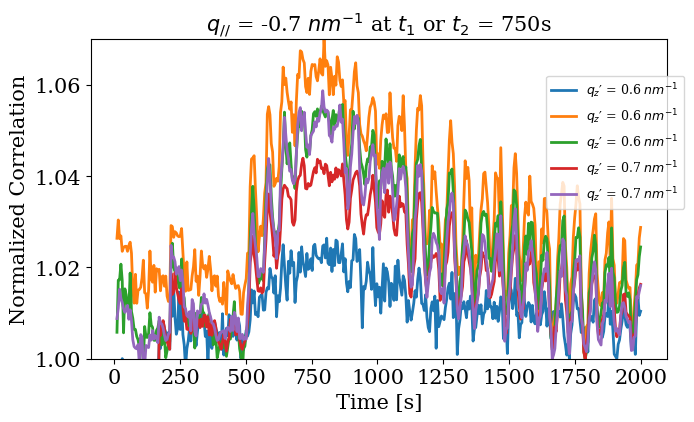

Dynamic_analysis_CHX.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  Can be used to do:


  0%|          | 0/5 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150077684, 1.6815491525442274, 1.6815491524867303, 1.6815491524227761, 1.6815491531451796, 1.6815491528811188] 1.6815491522596193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499610085, 1.6815491528348705, 1.68154915245643, 1.6815491521910282, 1.6815491524343384, 1.6815491527071122] 1.6815491520974646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499663238, 1.6815491525393442, 1.6815491526722353, 1.6815491523570394, 1.6815491525878636, 1.6815491525525075] 1.6815491521125525 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500397721, 1.681549152690259, 1.6815491523447728, 1.6815491521841555, 1.6815491529754638, 1.6815491529295334] 1.681549152193993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498351172, 1.6815491525338606, 1.681549152121124, 1.6815491523394313, 1.681549152968362, 1.6815491529142523] 1.6815491521186912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500467794, 1.6815491522540262, 1.6815491524081132, 1.6815491520419297, 1.6815491527035151, 1.6815491526283668] 1.6815491520137886 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500267807, 1.6815491524851618, 1.6815491523285147, 1.6815491521911392, 1.6815491527954243, 1.6815491527338153] 1.6815491520934727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502073847, 1.6815491525783743, 1.681549152559913, 1.6815491520519896, 1.681549152704291, 1.681549152720446] 1.6815491521370662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149914225, 1.6815491525364257, 1.6815491523304145, 1.6815491523359656, 1.6815491528064443, 1.6815491527053568] 1.6815491521048054 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501960178, 1.6815491524663821, 1.681549152455677, 1.6815491525365767, 1.6815491527579915, 1.6815491529429156] 1.6815491522259267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501820903, 1.6815491527866682, 1.6815491524609776, 1.6815491522601707, 1.6815491529761335, 1.6815491525507134] 1.6815491522027923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499556976, 1.6815491521959096, 1.6815491524320896, 1.6815491521611818, 1.6815491525666237, 1.6815491525444988] 1.6815491519760002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501238813, 1.6815491525349486, 1.6815491524272126, 1.681549152527559, 1.681549152723655, 1.6815491525544637] 1.68154915214862 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149952906, 1.6815491526392963, 1.6815491524171877, 1.6815491523670736, 1.6815491526083814, 1.681549152868154] 1.6815491521421666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502402802, 1.6815491525949247, 1.6815491524438548, 1.6815491521711716, 1.6815491528356383, 1.6815491529594002] 1.681549152207545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497085793, 1.6815491525239468, 1.6815491521322214, 1.6815491525709305, 1.6815491529263857, 1.68154915234717] 1.6815491520348722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497410084, 1.6815491524611685, 1.6815491524309927, 1.6815491526678246, 1.6815491523224741, 1.6815491529533064] 1.6815491520961292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502715734, 1.6815491523639845, 1.681549152592397, 1.681549152095934, 1.6815491529920203, 1.681549152918846] 1.6815491522057924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500013993, 1.6815491525954824, 1.6815491528071438, 1.6815491523751112, 1.6815491529833078, 1.6815491528283122] 1.681549152265126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149987469, 1.6815491525562356, 1.6815491524607147, 1.6815491526206556, 1.6815491526835977, 1.6815491530329472] 1.6815491522236032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150127196, 1.6815491525761432, 1.6815491524756436, 1.6815491523816801, 1.6815491528687656, 1.6815491527688797] 1.6815491521997181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149622941, 1.6815491523317454, 1.6815491525613204, 1.6815491522755055, 1.6815491526428206, 1.6815491524207475] 1.6815491519758468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502355355, 1.681549152603631, 1.6815491524034467, 1.6815491523335648, 1.6815491533135134, 1.6815491524691506] 1.6815491522264736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500688449, 1.6815491528727664, 1.6815491524787722, 1.6815491525242585, 1.6815491530813782, 1.6815491525384103] 1.6815491522607386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150118216, 1.6815491529848363, 1.6815491523864186, 1.6815491520335488, 1.6815491529790334, 1.6815491529984277] 1.6815491522500803 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497235358, 1.6815491525192279, 1.6815491522593042, 1.6815491521303705, 1.6815491526747506, 1.6815491529104665] 1.6815491520362762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149736571, 1.6815491525134503, 1.6815491525040058, 1.6815491522697354, 1.6815491532479374, 1.681549152955522] 1.6815491522045372 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502010138, 1.681549152493509, 1.6815491521799606, 1.6815491524053021, 1.6815491526886368, 1.6815491526408] 1.681549152101537 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149835687, 1.6815491525098016, 1.6815491523109811, 1.681549152523326, 1.6815491527362916, 1.6815491528628241] 1.6815491521298185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149725873, 1.6815491524469754, 1.6815491526177233, 1.6815491522416188, 1.6815491528268316, 1.6815491527306232] 1.6815491520982742 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150044062, 1.6815491529066167, 1.6815491521686061, 1.6815491523440524, 1.6815491529131066, 1.6815491528660136] 1.681549152207076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500090105, 1.6815491525904536, 1.68154915227589, 1.6815491521756094, 1.6815491527881408, 1.6815491525901107] 1.6815491520715362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498933417, 1.6815491525687571, 1.6815491519147852, 1.6815491522161774, 1.6815491525926767, 1.681549152275175] 1.6815491519101524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497597805, 1.6815491526482047, 1.6815491522154637, 1.6815491524603052, 1.6815491528278486, 1.6815491525743678] 1.681549152080995 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499164037, 1.6815491525650605, 1.6815491521675945, 1.6815491523142456, 1.6815491526938535, 1.6815491525598212] 1.681549152036163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496008312, 1.6815491527358768, 1.6815491521665304, 1.6815491523486799, 1.6815491526619244, 1.6815491526943642] 1.681549152034701 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498303397, 1.6815491522291088, 1.6815491522041066, 1.6815491520780323, 1.6815491527321615, 1.681549152447773] 1.6815491519202534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499058766, 1.6815491528703452, 1.6815491523484072, 1.6815491523088264, 1.6815491521746733, 1.6815491525093371] 1.6815491520195778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497687542, 1.6815491526312059, 1.681549152010481, 1.6815491519204455, 1.681549152668464, 1.6815491529035715] 1.6815491519838204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499346038, 1.681549152532262, 1.68154915250968, 1.681549152043769, 1.6815491527023116, 1.681549152711062] 1.6815491520722814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499624633, 1.6815491525793975, 1.6815491522506427, 1.6815491519329986, 1.6815491525515949, 1.6815491525129058] 1.6815491519650003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500424824, 1.6815491525746236, 1.6815491521959913, 1.6815491523542914, 1.681549152786502, 1.681549152728194] 1.681549152113681 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496085553, 1.6815491523547705, 1.6815491522867045, 1.6815491523513506, 1.6815491526268382, 1.6815491527839375] 1.6815491520020263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498658912, 1.6815491523893824, 1.6815491522340356, 1.6815491518655565, 1.6815491527903372, 1.681549152365084] 1.6815491519183814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546371509012, 1.681546720212368, 1.6815466753504773, 1.6815466627604634, 1.6815467275336973, 1.6815467288831258] 1.6815466477081904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496930863, 1.6815491527334747, 1.6815491523075536, 1.6815491519513408, 1.681549152388044, 1.6815491526659008] 1.6815491519565668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914994994, 1.6815491526615958, 1.6815491523143944, 1.681549151942587, 1.681549152891213, 1.6815491528009474] 1.6815491520934465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496936792, 1.6815491528662125, 1.6815491522856316, 1.6815491519299886, 1.681549152621665, 1.681549152729974] 1.6815491520211918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500826831, 1.6815491530002387, 1.681549152443179, 1.6815491522961814, 1.6815491525033597, 1.681549152566486] 1.681549152148688 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150115437, 1.681549152572095, 1.6815491522042247, 1.6815491521143295, 1.6815491523176131, 1.6815491529709012] 1.6815491520491002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497301163, 1.6815491527161743, 1.681549152001932, 1.681549151835271, 1.681549152672435, 1.6815491529183042] 1.6815491519790389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497913797, 1.6815491529733437, 1.6815491522524768, 1.6815491523114199, 1.6815491526658244, 1.6815491527864674] 1.6815491521301518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149926278, 1.681549152882568, 1.6815491523649544, 1.6815491521143056, 1.681549152567916, 1.681549152688853] 1.6815491520908126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496133, 1.6815491525348327, 1.6815491521778418, 1.6815491521651098, 1.6815491527173956, 1.6815491526562871] 1.6815491519774615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496243662, 1.6815491527469275, 1.6815491519786159, 1.6815491520148291, 1.6815491522819928, 1.6815491524484] 1.681549151849189 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497308068, 1.681549152567067, 1.6815491520772334, 1.681549152041728, 1.6815491524970194, 1.6815491523183779] 1.681549151872039 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497435202, 1.6815491524643082, 1.6815491522604695, 1.6815491519599517, 1.6815491526470576, 1.6815491523227988] 1.6815491518996843 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498629602, 1.6815491527993736, 1.6815491520851982, 1.6815491519651689, 1.6815491526169728, 1.681549152617292] 1.6815491519911607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496529527, 1.6815491527201551, 1.6815491522458546, 1.681549151927165, 1.6815491526603799, 1.6815491525496205] 1.6815491519593546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497269903, 1.681549152676471, 1.6815491522547483, 1.681549151813174, 1.681549152312234, 1.6815491525202844] 1.6815491518839838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498686304, 1.6815491527631234, 1.6815491519951182, 1.6815491517162053, 1.6815491523448767, 1.6815491528403808] 1.6815491519213894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498757127, 1.6815491531421372, 1.6815491518270669, 1.681549151856463, 1.6815491522337385, 1.6815491528508435] 1.6815491519643269 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149781512, 1.6815491527871878, 1.681549152126916, 1.6815491518333445, 1.6815491524792439, 1.6815491527742292] 1.6815491519637389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576414, 1.681549152664667, 1.6815491519662933, 1.6815491517046794, 1.6815491520092087, 1.6815491525833357] 1.681549151780971 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496260462, 1.6815491524433872, 1.6815491521210468, 1.6815491514565206, 1.6815491524621065, 1.6815491526151494] 1.6815491517873762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149607029, 1.6815491528582482, 1.681549151932444, 1.681549151823933, 1.6815491522880661, 1.6815491521474293] 1.6815491517761914 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149634372, 1.6815491526653128, 1.6815491523236354, 1.6815491521517116, 1.6815491528122442, 1.6815491530303381] 1.6815491521029358 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497867558, 1.6815491524196569, 1.6815491519275803, 1.681549152115768, 1.68154915274686, 1.6815491523019932] 1.6815491518831027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491619938, 1.6815491528938606, 1.6815491523209882, 1.6815491519159123, 1.6815491527282798, 1.6815491523356125] 1.6815491518927745 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149528054, 1.6815491525026616, 1.6815491520907937, 1.6815491520700538, 1.6815491524485227, 1.6815491523324306] 1.6815491518287526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497937085, 1.6815491528412823, 1.681549152045342, 1.6815491515864038, 1.6815491522696986, 1.6815491521995747] 1.681549151789335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149266135, 1.6815491526500832, 1.6815491518954242, 1.681549151750434, 1.681549152540974, 1.6815491526745756] 1.681549151796271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492811288, 1.6815491528486222, 1.6815491518650165, 1.6815491516638392, 1.6815491519287757, 1.6815491524779116] 1.681549151677549 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152718067, 1.6815491518626535, 1.681549151572837, 1.681549152067289, 1.6815491525818498] 1.6815491521605392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492536125, 1.6815491525002448, 1.6815491515914935, 1.6815491514577232, 1.6815491520527859, 1.6815491525639983] 1.6815491515699765 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149500679, 1.6815491523613737, 1.6815491516225407, 1.68154915158267, 1.681549152054977, 1.681549152538278] 1.6815491516100864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524604536, 1.681549151602232, 1.6815491516958154, 1.681549152169299, 1.6815491522836492] 1.6815491520422896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491866634, 1.6815491525463404, 1.6815491517000476, 1.68154915194157, 1.681549152545946, 1.6815491524758075] 1.6815491517327292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495185846, 1.6815491528468995, 1.6815491518837695, 1.6815491517598895, 1.681549152169279, 1.6815491523188095] 1.6815491517495385 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494021777, 1.6815491526867552, 1.6815491520261139, 1.6815491513842553, 1.6815491524132904, 1.6815491526841067] 1.6815491517661165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495639674, 1.6815491523173103, 1.6815491517487215, 1.681549151851602, 1.6815491523899992, 1.6815491522351458] 1.6815491516844576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496302917, 1.681549152395799, 1.6815491517232548, 1.6815491517730532, 1.6815491525912396, 1.6815491526622317] 1.6815491517959782 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497189208, 1.681549152761388, 1.6815491514370269, 1.6815491517892465, 1.6815491519246955, 1.6815491523543935] 1.6815491516642787 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149724841, 1.6815491525019466, 1.6815491519205708, 1.6815491520464456, 1.6815491520104255, 1.6815491528313302] 1.68154915183926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494728643, 1.6815491525477944, 1.6815491517632646, 1.681549151753221, 1.6815491521402048, 1.681549152620839] 1.681549151716365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497852935, 1.6815491526874498, 1.6815491518219918, 1.68154915156635, 1.6815491521492332, 1.6815491526973165] 1.6815491517846057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493501566, 1.6815491525136164, 1.6815491520360464, 1.68154915198929, 1.6815491521290915, 1.6815491526871944] 1.6815491517842327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491526449984, 1.6815491517799535, 1.681549152129155, 1.6815491522197146, 1.681549152429378] 1.6815491522406396 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492613184, 1.6815491525257613, 1.681549151688683, 1.6815491518417272, 1.681549152279569, 1.6815491527426198] 1.6815491517232797 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495562025, 1.6815491526214075, 1.6815491515409704, 1.6815491515023813, 1.6815491523830932, 1.6815491524702386] 1.681549151679049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496736454, 1.6815491528013844, 1.6815491515433174, 1.6815491515804135, 1.681549152272324, 1.681549152390362] 1.6815491517102412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494354724, 1.6815491526919693, 1.681549151815557, 1.6815491517191044, 1.681549151969997, 1.6815491524000725] 1.681549151672029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495637591, 1.681549152726109, 1.6815491516339902, 1.6815491519159407, 1.6815491521592065, 1.681549152786241] 1.6815491517975412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493351464, 1.6815491523439752, 1.6815491518799393, 1.68154915188263, 1.6815491516929093, 1.6815491525302253] 1.6815491516108043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149512131, 1.6815491526599402, 1.681549151810409, 1.6815491514924057, 1.6815491524521127, 1.6815491525906179] 1.6815491517529362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495460657, 1.681549152607066, 1.6815491518346515, 1.681549151527089, 1.6815491522082837, 1.681549152567663] 1.6815491517151362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491522190191, 1.681549151730343, 1.6815491517701382, 1.681549152160787, 1.6815491523931456] 1.6815491520546868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492192627, 1.681549152738115, 1.6815491519181203, 1.681549151664056, 1.68154915211663, 1.6815491523686683] 1.6815491516708085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491541104, 1.6815491525492026, 1.6815491519474381, 1.6815491515937921, 1.6815491522130102, 1.6815491529344122] 1.6815491517319943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496691344, 1.6815491525487838, 1.6815491513457896, 1.6815491514602439, 1.6815491524258852, 1.6815491523745099] 1.681549151637391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495076538, 1.6815491524711814, 1.681549151683063, 1.6815491512892025, 1.6815491522605437, 1.68154915245782] 1.6815491516115777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492128505, 1.6815491525395405, 1.6815491518025985, 1.6815491516424443, 1.6815491522690147, 1.6815491524438677] 1.6815491516517191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149212004, 1.6815491526401507, 1.681549151785207, 1.681549151477936, 1.681549151865374, 1.6815491522555863] 1.6815491515393763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149661043, 1.6815491530023197, 1.681549151729103, 1.6815491515423382, 1.6815491521537798, 1.6815491521375776] 1.6815491517043604 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914937889, 1.6815491527631776, 1.6815491516866747, 1.681549151627184, 1.6815491519589223, 1.6815491525272255] 1.6815491516570125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149377254, 1.6815491527442736, 1.6815491516748593, 1.6815491514564238, 1.6815491521223285, 1.6815491526235529] 1.6815491516664487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495356345, 1.681549152476539, 1.6815491519127628, 1.6815491514081788, 1.6815491518588446, 1.6815491522158394] 1.6815491515679664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496848578, 1.681549152523937, 1.681549151645434, 1.6815491512169674, 1.6815491517540475, 1.6815491524829351] 1.681549151551363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492986148, 1.6815491525422477, 1.681549151696761, 1.6815491517798686, 1.6815491517848793, 1.6815491526295534] 1.6815491516219876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492039327, 1.6815491525020212, 1.681549151847857, 1.6815491515248322, 1.6815491519497505, 1.681549152469759] 1.6815491515830256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493643493, 1.6815491526592048, 1.6815491517100303, 1.6815491516463936, 1.6815491519145027, 1.68154915243746] 1.6815491516219903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495117847, 1.6815491525848807, 1.6815491514669656, 1.681549151617265, 1.681549151652976, 1.6815491523873929] 1.6815491515368777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491528394997, 1.681549151677765, 1.681549151209658, 1.681549152239186, 1.681549152312801] 1.6815491520557821 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525890796, 1.6815491518242895, 1.6815491520354549, 1.6815491521793016, 1.6815491525785555] 1.681549152241336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495796069, 1.6815491525270438, 1.6815491517954504, 1.6815491515101022, 1.6815491522907475, 1.6815491521816668] 1.6815491516474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491573353, 1.6815491524069426, 1.6815491516193863, 1.681549151487352, 1.68154915163079, 1.6815491525517134] 1.681549151475587 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494534216, 1.6815491523152262, 1.6815491517643544, 1.681549151861251, 1.6815491520985004, 1.6815491524541741] 1.6815491516578216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498496256, 1.6815491527971367, 1.6815491518925265, 1.6815491515260987, 1.681549151972701, 1.6815491524072943] 1.6815491517408974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492617722, 1.6815491524726704, 1.6815491516390204, 1.68154915172886, 1.6815491517101093, 1.6815491525356792] 1.6815491515580183 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492774988, 1.6815491528240414, 1.681549151779091, 1.6815491512646643, 1.6815491519832877, 1.6815491526480324] 1.6815491516294359 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525683863, 1.681549151540711, 1.6815491514424328, 1.68154915206626, 1.6815491524677832] 1.6815491520171146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152649911, 1.681549151244334, 1.6815491513200413, 1.6815491517005423, 1.6815491526080666] 1.6815491519045789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490975214, 1.6815491524626784, 1.681549151138209, 1.681549151181441, 1.681549152193031, 1.6815491525731172] 1.6815491514409997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149285404, 1.681549152525882, 1.6815491518090129, 1.6815491514220615, 1.6815491514952399, 1.6815491524903354] 1.6815491515046561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491452685, 1.6815491525601933, 1.6815491514245013, 1.681549151197717, 1.6815491522257249, 1.681549152190768] 1.681549151457362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491682053, 1.6815491526296085, 1.6815491514866938, 1.6815491513824607, 1.6815491520732473, 1.6815491525254158] 1.681549151544272 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493358312, 1.6815491524748456, 1.6815491512254015, 1.6815491514038596, 1.6815491518313883, 1.681549152612237] 1.6815491514805938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491147263, 1.6815491526456037, 1.6815491515335896, 1.6815491512211764, 1.6815491519756325, 1.6815491520982282] 1.6815491514314926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815462988423606, 1.6815467144770455, 1.6815465943035184, 1.6815465750571015, 1.6815466376431818, 1.6815467031204445] 1.6815465872406088 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149261452, 1.681549152394596, 1.6815491516026064, 1.6815491512626854, 1.6815491518223915, 1.6815491525600894] 1.6815491514839704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524027593, 1.6815491513784133, 1.6815491514473235, 1.6815491522097328, 1.6815491524085484] 1.6815491519693555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149000288, 1.6815491525458097, 1.681549151526557, 1.6815491513167813, 1.6815491519243047, 1.681549152721506] 1.6815491515058743 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489916474, 1.6815491524871482, 1.681549151363945, 1.681549151536236, 1.6815491515180998, 1.6815491524902884] 1.6815491513978944 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491767203, 1.6815491527147244, 1.6815491515435133, 1.681549151287418, 1.6815491516272063, 1.6815491522777948] 1.6815491514378964 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149066436, 1.6815491525740018, 1.681549151453873, 1.6815491511254157, 1.6815491518601267, 1.6815491521237749] 1.6815491513672713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490110364, 1.6815491526011432, 1.6815491514211707, 1.6815491512258824, 1.681549151660092, 1.681549152671284] 1.6815491514317682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149630941, 1.681549152421085, 1.6815491513932619, 1.6815491512045697, 1.6815491514266334, 1.6815491522902235] 1.6815491513944523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148980325, 1.6815491525930777, 1.6815491515868906, 1.6815491514447851, 1.681549151454047, 1.6815491520805175] 1.681549151356607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490888945, 1.681549152536653, 1.681549151496811, 1.6815491514977632, 1.681549152027221, 1.681549152437741] 1.6815491515141805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521722379, 1.6815491515788583, 1.6815491512950023, 1.6815491518898358, 1.681549152010116] 1.6815491517892098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491728563, 1.6815491522687323, 1.6815491512641882, 1.6815491511425726, 1.6815491519461352, 1.6815491525697581] 1.6815491513940402 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149166358, 1.681549152234612, 1.6815491515598868, 1.6815491515236372, 1.6815491521051107, 1.6815491527765234] 1.6815491515610212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491351366, 1.6815491524164958, 1.6815491513450143, 1.6815491513480132, 1.6815491518641155, 1.6815491522578574] 1.6815491513944387 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493237835, 1.681549152603131, 1.6815491514474274, 1.6815491510990492, 1.681549151391489, 1.6815491525671882] 1.6815491514053447 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490382222, 1.681549152368369, 1.68154915126971, 1.681549151301096, 1.681549152095859, 1.6815491525324502] 1.6815491514342849 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148997771, 1.6815491523850015, 1.6815491515602012, 1.6815491511714966, 1.6815491515352967, 1.681549152849283] 1.6815491514165082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491527017228, 1.6815491516295618, 1.681549151011919, 1.6815491516020402, 1.6815491525935995] 1.681549151907769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491031471, 1.6815491528421314, 1.6815491513475322, 1.681549151216244, 1.6815491519086128, 1.681549152571015] 1.6815491514981133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149179732, 1.681549152380192, 1.681549151135096, 1.6815491511464034, 1.6815491518323138, 1.68154915221634] 1.6815491513150127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490116186, 1.6815491523940516, 1.6815491514254286, 1.681549150922351, 1.6815491518515993, 1.681549152072055] 1.6815491512795173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493020827, 1.6815491524414474, 1.6815491514141714, 1.681549150950679, 1.6815491516683352, 1.6815491525313808] 1.681549151384683 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488289886, 1.681549152209092, 1.6815491514633925, 1.68154915130672, 1.6815491518518577, 1.681549151779751] 1.6815491512399667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488463206, 1.6815491523097403, 1.681549151303781, 1.6815491511998903, 1.6815491516480083, 1.6815491524472703] 1.6815491512925018 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491219356, 1.6815491523676842, 1.6815491515948002, 1.6815491513842655, 1.6815491518383379, 1.6815491523423054] 1.6815491514415548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488438483, 1.681549152357892, 1.681549151746263, 1.6815491513622614, 1.681549151715703, 1.681549152523142] 1.6815491514248517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488208991, 1.6815491524267507, 1.6815491513719985, 1.6815491515611853, 1.6815491518229186, 1.681549152766122] 1.6815491514616456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490943772, 1.681549152593277, 1.681549150995255, 1.681549151033467, 1.6815491516613243, 1.6815491526770368] 1.681549151342456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152692086, 1.681549151489254, 1.6815491508054654, 1.6815491519082078, 1.6815491525953297] 1.6815491518980685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493383412, 1.681549152375939, 1.6815491517596741, 1.68154915107591, 1.6815491514094068, 1.6815491527603506] 1.68154915145327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149092696, 1.6815491529589086, 1.6815491517497563, 1.681549151195934, 1.6815491513986962, 1.681549152538099] 1.6815491514890148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489228545, 1.6815491527077135, 1.681549151234326, 1.6815491510218177, 1.6815491517337153, 1.681549152260076] 1.6815491513134173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489068397, 1.6815491522246107, 1.6815491512858216, 1.6815491513199419, 1.681549151708725, 1.6815491523615211] 1.6815491513012433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489383891, 1.68154915255261, 1.6815491514318346, 1.6815491517033436, 1.6815491514999978, 1.6815491528065407] 1.6815491514887861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491845105, 1.6815491523782775, 1.6815491515265029, 1.6815491510233418, 1.6815491517039005, 1.681549152294724] 1.681549151351876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490435743, 1.6815491523673467, 1.6815491512383347, 1.681549151242148, 1.6815491515919252, 1.6815491522343988] 1.6815491512862881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488484389, 1.6815491524968822, 1.6815491517033188, 1.6815491509728897, 1.681549151551918, 1.6815491524448998] 1.6815491513363912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493327586, 1.6815491521259203, 1.681549151415056, 1.6815491512787863, 1.6815491520169288, 1.6815491525862996] 1.6815491514592915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491016963, 1.6815491527673005, 1.6815491511747922, 1.6815491513234226, 1.6815491515706311, 1.6815491524317383] 1.68154915139493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491284629, 1.6815491522515797, 1.6815491511228982, 1.6815491512288228, 1.681549151531574, 1.681549152515863] 1.6815491512965337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486116332, 1.6815491523771806, 1.6815491512557772, 1.6815491509350506, 1.6815491520245986, 1.6815491524955042] 1.681549151283291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524309287, 1.6815491512998193, 1.6815491513987828, 1.6815491518657995, 1.681549152653096] 1.6815491519296852 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488548657, 1.6815491524584223, 1.6815491513596994, 1.6815491511496, 1.6815491516769177, 1.6815491527552595] 1.681549151375794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490352992, 1.681549152635876, 1.6815491512111707, 1.6815491510665073, 1.6815491516153842, 1.6815491526731652] 1.6815491513729004 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488574108, 1.6815491524694623, 1.6815491514377299, 1.6815491514675944, 1.6815491518818728, 1.6815491523211232] 1.6815491514058658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491535761, 1.6815491525912307, 1.6815491512281984, 1.6815491512757212, 1.6815491521652355, 1.68154915207468] 1.6815491514147738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493766395, 1.6815491522990156, 1.6815491514260699, 1.6815491510154232, 1.6815491519316295, 1.6815491522807453] 1.6815491513882534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488267487, 1.6815491524331998, 1.6815491511080043, 1.6815491511529626, 1.6815491514824172, 1.6815491521881802] 1.6815491511985856 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520207226, 1.6815491516163439, 1.6815491511939937, 1.6815491516515069, 1.681549152578162] 1.681549151812146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149002044, 1.681549152266482, 1.6815491513242873, 1.68154915080983, 1.6815491512598069, 1.6815491520933739] 1.6815491511259708 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490489247, 1.6815491523110029, 1.6815491512579124, 1.6815491510182232, 1.6815491514204597, 1.6815491521875794] 1.6815491512073504 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484722953, 1.681549152573826, 1.6815491511314042, 1.6815491510456586, 1.6815491513982326, 1.6815491526115354] 1.6815491512054919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914886866, 1.6815491522331025, 1.6815491509718, 1.6815491511449023, 1.6815491517758225, 1.6815491525516948] 1.6815491512576637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149096118, 1.6815491523623907, 1.6815491513778387, 1.6815491513253713, 1.681549151842165, 1.6815491524060828] 1.6815491514016612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149049915, 1.6815491523285377, 1.681549150779209, 1.6815491509795306, 1.6815491515238241, 1.6815491524908088] 1.6815491511919707 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152447598, 1.6815491510466476, 1.6815491511383263, 1.681549151309924, 1.6815491526586843] 1.6815491517202361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493971355, 1.6815491524936625, 1.6815491512500795, 1.6815491510330567, 1.6815491516817653, 1.681549152208218] 1.6815491513439864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490497791, 1.681549152486177, 1.6815491513112804, 1.6815491511355347, 1.6815491514033152, 1.6815491523774369] 1.6815491512939207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491721666, 1.6815491519868107, 1.6815491510838698, 1.6815491514635257, 1.6815491514777818, 1.6815491523801782] 1.6815491512607224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489788945, 1.6815491523470492, 1.6815491514368146, 1.6815491508964682, 1.6815491514194107, 1.6815491523764248] 1.6815491512425103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492531693, 1.6815491527317308, 1.6815491513271623, 1.6815491510172818, 1.681549151873643, 1.6815491523921042] 1.6815491514325156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491042285, 1.6815491521680777, 1.681549151546923, 1.6815491510100733, 1.681549151624485, 1.681549152331474] 1.6815491512975436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488158139, 1.6815491525250335, 1.6815491512638232, 1.6815491508970712, 1.6815491516847354, 1.68154915253871] 1.6815491512875311 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489137675, 1.6815491528254496, 1.681549151465918, 1.6815491511568323, 1.6815491516163288, 1.6815491527760908] 1.6815491514590646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521379249, 1.681549151190692, 1.6815491507006772, 1.681549151447494, 1.6815491525066664] 1.6815491515966907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490320507, 1.6815491522673747, 1.6815491509312515, 1.68154915082369, 1.681549151850037, 1.6815491525076496] 1.6815491512353422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489042786, 1.681549152939092, 1.6815491511639502, 1.6815491509453215, 1.6815491516059748, 1.6815491524745756] 1.6815491513388654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491687107, 1.6815491525066735, 1.6815491514551226, 1.6815491510651683, 1.6815491515334635, 1.6815491526397492] 1.6815491513948146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491271821, 1.6815491519803194, 1.681549151466264, 1.6815491509707874, 1.681549151500782, 1.6815491522439223] 1.6815491512148764 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489688768, 1.6815491522688468, 1.6815491513107226, 1.6815491510235487, 1.681549151167642, 1.6815491523564337] 1.6815491511826783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488089682, 1.6815491523678805, 1.6815491512839134, 1.6815491509334395, 1.6815491512409735, 1.6815491526575834] 1.6815491512154594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489921293, 1.681549152617519, 1.6815491514532392, 1.6815491509266502, 1.6815491511768172, 1.6815491522026695] 1.681549151228171 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488845828, 1.6815491524854327, 1.6815491510580314, 1.6815491511116658, 1.6815491515293024, 1.6815491524131447] 1.6815491512470266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491827324, 1.6815491522558697, 1.681549150761028, 1.681549150887684, 1.6815491512696195, 1.6815491523630746] 1.6815491511200016 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485564502, 1.681549152200057, 1.6815491510143499, 1.6815491508866032, 1.6815491511576757, 1.6815491522552573] 1.6815491510117322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488321905, 1.6815491518927628, 1.6815491512072374, 1.6815491504521614, 1.6815491513847913, 1.6815491527342274] 1.6815491510838951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486608534, 1.6815491524924058, 1.681549150963114, 1.6815491509398273, 1.6815491512527068, 1.681549152624748] 1.6815491511556093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486902792, 1.6815491524093233, 1.6815491509085523, 1.681549150855214, 1.6815491513200254, 1.6815491523521588] 1.6815491510892588 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525344353, 1.6815491509834013, 1.6815491509708425, 1.6815491514098637, 1.6815491521915265] 1.6815491516180139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487176915, 1.681549151996521, 1.6815491511616587, 1.6815491511014211, 1.6815491513769043, 1.6815491523189379] 1.6815491511121892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489631755, 1.6815491520880448, 1.6815491509464744, 1.6815491509173164, 1.6815491512037646, 1.6815491521020594] 1.6815491510368057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485184069, 1.6815491523748984, 1.6815491517175927, 1.6815491508103033, 1.6815491514195857, 1.6815491523232962] 1.6815491511940135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148788147, 1.6815491523863142, 1.6815491509536349, 1.6815491506369584, 1.6815491515844503, 1.6815491522352852] 1.681549151097465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546241384249, 1.68154667942457, 1.6815465345502139, 1.6815465087268087, 1.6815465739524358, 1.6815466845625204] 1.681546537100133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149119986, 1.6815491521211885, 1.6815491512677099, 1.6815491510292633, 1.6815491514273946, 1.6815491521147612] 1.6815491511800509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490799817, 1.6815491522511992, 1.6815491510808842, 1.6815491505958136, 1.6815491515002448, 1.6815491518998993] 1.6815491510680038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520575554, 1.6815491511801475, 1.6815491507410805, 1.6815491514352834, 1.681549152154533] 1.6815491515137198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518507684, 1.6815491512295804, 1.6815491506978884, 1.6815491513978973, 1.6815491524749033] 1.681549151530208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483714986, 1.681549151906565, 1.6815491510625993, 1.6815491508207963, 1.6815491512611267, 1.6815491522358523] 1.681549150943073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148802549, 1.6815491523772894, 1.6815491512268474, 1.6815491509174576, 1.6815491512243987, 1.6815491523873796] 1.681549151155987 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148491162, 1.6815491523436972, 1.681549151081784, 1.6815491507153828, 1.6815491510393201, 1.6815491525202262] 1.6815491510319287 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487242702, 1.681549152363596, 1.6815491510963207, 1.6815491509046563, 1.68154915158002, 1.6815491524412884] 1.6815491511850251 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487569343, 1.6815491521495103, 1.6815491509676628, 1.681549150758518, 1.6815491511126694, 1.6815491518993593] 1.6815491509407758 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524029267, 1.681549151023055, 1.6815491509964002, 1.6815491510375344, 1.6815491522057222] 1.6815491515331278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485704492, 1.6815491522585084, 1.6815491508755547, 1.6815491510937166, 1.681549151436501, 1.6815491520331172] 1.6815491510446412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487118215, 1.6815491519956565, 1.6815491511366298, 1.681549150943292, 1.681549151586144, 1.6815491521740205] 1.6815491510912608 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521907004, 1.681549151012431, 1.6815491509406453, 1.6815491514428533, 1.681549151857717] 1.6815491514888692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148616413, 1.6815491521645236, 1.6815491509467813, 1.6815491511915615, 1.6815491513226326, 1.6815491520726882] 1.6815491510524332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148756841, 1.6815491519951902, 1.6815491509987766, 1.68154915087257, 1.6815491512021135, 1.6815491524579462] 1.6815491510472398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482046538, 1.6815491521535488, 1.6815491510638907, 1.6815491511637894, 1.681549151534063, 1.6815491522944157] 1.6815491510690606 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486646899, 1.681549152401253, 1.6815491509869087, 1.681549150727223, 1.681549151492538, 1.6815491525928046] 1.6815491511442362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490762655, 1.6815491522476158, 1.6815491511745195, 1.6815491508035905, 1.6815491516049188, 1.6815491525630648] 1.6815491512449958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484723517, 1.6815491523706982, 1.6815491508532805, 1.6815491505456661, 1.6815491515426801, 1.6815491522821633] 1.68154915101114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487190464, 1.6815491524665056, 1.6815491510137242, 1.681549150993412, 1.6815491514579008, 1.681549151972586] 1.6815491511038625 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148279279, 1.68154915186275, 1.6815491511257088, 1.68154915069681, 1.681549151228733, 1.6815491520323036] 1.6815491508709306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520623254, 1.6815491509936438, 1.681549150757144, 1.6815491513134582, 1.6815491523512662] 1.6815491514955674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520557684, 1.6815491506049978, 1.6815491508338871, 1.6815491512916845, 1.6815491521389019] 1.6815491513850478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486297485, 1.6815491519258399, 1.6815491511352176, 1.681549150621073, 1.681549151382355, 1.6815491517197616] 1.6815491509023321 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487140108, 1.6815491518934311, 1.681549150792688, 1.6815491504990243, 1.6815491513400698, 1.6815491522110233] 1.6815491509083744 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151946386, 1.6815491509753406, 1.6815491508923142, 1.6815491512467138, 1.6815491520163692] 1.681549151415425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148626833, 1.6815491518218675, 1.68154915064025, 1.6815491506913869, 1.6815491511264233, 1.6815491518127899] 1.6815491507865918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484783784, 1.6815491520515566, 1.6815491506073101, 1.6815491504799107, 1.681549150989289, 1.6815491519175394] 1.6815491507539975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484223575, 1.6815491519065953, 1.6815491506074074, 1.68154915061029, 1.6815491512508185, 1.6815491522531198] 1.6815491508417644 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485563596, 1.6815491520534764, 1.6815491508559832, 1.681549150628462, 1.681549151099846, 1.6815491521869683] 1.6815491508968492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148324796, 1.6815491518229293, 1.681549150521112, 1.681549150864714, 1.681549150743086, 1.681549152387099] 1.681549150777289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484776843, 1.6815491520390147, 1.6815491508526712, 1.6815491504487317, 1.6815491512861986, 1.6815491519489263] 1.6815491508422042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518509313, 1.681549150813146, 1.68154915042191, 1.6815491512339409, 1.6815491520090164] 1.6815491512657892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485753777, 1.6815491523008128, 1.681549150875366, 1.6815491506414144, 1.6815491512792127, 1.6815491522114092] 1.681549150980599 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148609911, 1.6815491520247097, 1.6815491510188227, 1.6815491508739937, 1.6815491510945169, 1.6815491518582317] 1.681549150913364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486667953, 1.6815491523561965, 1.6815491509941012, 1.6815491506473537, 1.6815491513009904, 1.6815491520551076] 1.6815491510034242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484882341, 1.6815491518691599, 1.6815491508392038, 1.6815491503285656, 1.6815491510082543, 1.6815491521066104] 1.6815491507733382 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483424254, 1.6815491517526473, 1.681549150803007, 1.6815491506812714, 1.6815491514614571, 1.6815491522534307] 1.681549150882373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148581031, 1.6815491515810193, 1.6815491508710627, 1.6815491504266094, 1.6815491515040968, 1.68154915187692] 1.68154915080679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486235992, 1.6815491517655894, 1.6815491506765952, 1.6815491509078502, 1.6815491508768927, 1.6815491522940427] 1.6815491508574283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482670528, 1.6815491519214447, 1.6815491507748286, 1.6815491504972773, 1.6815491508090048, 1.6815491523566966] 1.681549150771051 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484436524, 1.6815491523886026, 1.6815491508749703, 1.6815491505364903, 1.6815491509575415, 1.6815491522287038] 1.6815491509049938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520495551, 1.6815491507236953, 1.6815491505183378, 1.6815491508914935, 1.6815491522656498] 1.6815491512897462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490230237, 1.6815491520994876, 1.6815491505993982, 1.681549150832506, 1.6815491510290324, 1.6815491523956023] 1.6815491509965084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489454182, 1.6815491519966859, 1.6815491509178315, 1.681549150748701, 1.6815491512645417, 1.6815491519613488] 1.6815491509724214 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549131945033, 1.6815491302366312, 1.6815491295776726, 1.6815491301976477, 1.6815491322315843] 1.681549130837714 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485865555, 1.6815491519918688, 1.6815491507651465, 1.6815491509823426, 1.6815491511498224, 1.6815491520853252] 1.6815491509268436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124851045, 1.6815491327809302, 1.6815491299001009, 1.6815491292880544, 1.6815491308694712, 1.6815491321212992] 1.6815491299684835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485136635, 1.6815491523273085, 1.6815491509140394, 1.6815491505372906, 1.6815491512083156, 1.6815491520271113] 1.681549150921288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491320616194, 1.68154912983543, 1.6815491296564118, 1.6815491299450573, 1.6815491318620932] 1.6815491306721224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491479993332, 1.6815491520680315, 1.6815491508726854, 1.6815491508731792, 1.6815491507285794, 1.6815491519804224] 1.681549150753705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491236665583, 1.6815491314943518, 1.681549129066151, 1.6815491289425886, 1.6815491298462621, 1.681549132538728] 1.6815491292591063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478929294, 1.6815491518466734, 1.6815491504205387, 1.681549150269146, 1.6815491509002518, 1.6815491522517627] 1.6815491505968836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246556253, 1.681549132108275, 1.681549129362744, 1.6815491293130345, 1.6815491299299365, 1.6815491321406872] 1.6815491295850507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483182505, 1.6815491522164492, 1.6815491504057332, 1.6815491505856661, 1.6815491509423763, 1.6815491520729013] 1.681549150756896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491251373476, 1.6815491325602663, 1.681549129363101, 1.6815491287730246, 1.68154913027651, 1.681549131794517] 1.6815491296507945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487378176, 1.681549152090493, 1.6815491507646545, 1.6815491504266022, 1.681549151134306, 1.681549151642935] 1.6815491507994682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246734142, 1.681549132145494, 1.6815491293430025, 1.6815491292890066, 1.681549130302972, 1.6815491320270342] 1.6815491296301541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481641809, 1.6815491519305716, 1.6815491505132596, 1.6815491503451305, 1.6815491510207576, 1.6815491519033272] 1.6815491506462046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246686225, 1.6815491318314795, 1.6815491290385784, 1.6815491293376965, 1.6815491303392767, 1.6815491318309412] 1.6815491295077658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482702156, 1.6815491518627592, 1.6815491506320996, 1.6815491506709739, 1.6815491510094591, 1.6815491519831456] 1.6815491507381086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246736705, 1.6815491316291693, 1.6815491294786469, 1.6815491291901061, 1.6815491294408407, 1.681549132257036] 1.6815491294449114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148107432, 1.6815491518398664, 1.6815491507576699, 1.6815491505793991, 1.6815491505551945, 1.681549152175403] 1.6815491506691609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132289267, 1.6815491294807674, 1.6815491289913762, 1.6815491296104277, 1.681549132740697] 1.681549130622507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520377646, 1.6815491510792109, 1.6815491503311524, 1.6815491507784825, 1.6815491524836346] 1.681549151342049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549125101852, 1.6815491315009585, 1.6815491296328209, 1.681549128928971, 1.6815491298235896, 1.6815491326551277] 1.6815491296072202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148298913, 1.6815491516411987, 1.6815491508278253, 1.6815491502645394, 1.6815491508147602, 1.681549152308368] 1.6815491506926008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491250547918, 1.6815491322555722, 1.6815491296341847, 1.6815491291591975, 1.6815491299998913, 1.681549131907813] 1.6815491296685752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520344383, 1.6815491508699916, 1.6815491504418887, 1.6815491510719092, 1.6815491520919106] 1.6815491513020278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124618345, 1.6815491324369791, 1.6815491295635994, 1.6815491291066715, 1.681549130314734, 1.681549131891475] 1.681549129655301 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148383346, 1.6815491521822867, 1.6815491507567724, 1.6815491502967248, 1.6815491510635874, 1.6815491519137504] 1.681549150766078 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491321250153, 1.6815491295622174, 1.6815491290408562, 1.681549130518436, 1.6815491319204332] 1.6815491306333918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484839553, 1.6815491520456303, 1.6815491507527818, 1.6815491505822564, 1.6815491512144707, 1.6815491519545565] 1.6815491508389417 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248470966, 1.6815491318749327, 1.6815491290075961, 1.6815491294985163, 1.681549130379648, 1.6815491325107321] 1.6815491296864202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482537008, 1.6815491519296142, 1.6815491503910143, 1.6815491505133093, 1.68154915087272, 1.6815491521288495] 1.6815491506815345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132164454, 1.681549129661462, 1.6815491289725548, 1.6815491295972693, 1.681549132587274] 1.6815491305966028 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491519213719, 1.6815491507523497, 1.6815491506153553, 1.681549150817295, 1.6815491522368227] 1.681549151268639 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491247742305, 1.6815491318065425, 1.6815491292157492, 1.6815491291257292, 1.6815491297642495, 1.681549132112146] 1.6815491294664409 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483242742, 1.68154915181456, 1.6815491504310973, 1.6815491506408438, 1.6815491507500973, 1.6815491519770034] 1.6815491506563127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491249449046, 1.6815491321582736, 1.6815491291938685, 1.6815491289530717, 1.6815491302969092, 1.6815491319591835] 1.6815491295843685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486473082, 1.6815491522142212, 1.6815491505399143, 1.681549150506735, 1.681549151084086, 1.6815491520151236] 1.6815491508345648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124997725, 1.6815491317181541, 1.6815491292020073, 1.681549129231219, 1.6815491296366378, 1.681549131985708] 1.6815491294619085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518133596, 1.6815491503679532, 1.681549150578821, 1.6815491509848233, 1.6815491520576087] 1.6815491511605132 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681545910573964, 1.6815464161599252, 1.6815462365546034, 1.6815462150771947, 1.6815462756611401, 1.6815464250825713] 1.6815462465182327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148030486, 1.6815491521114452, 1.681549150774777, 1.6815491505451705, 1.681549151234961, 1.6815491516553358] 1.6815491507253626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491323502934, 1.6815491295443317, 1.6815491293354068, 1.6815491299470988, 1.6815491324394451] 1.6815491307233152 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521346084, 1.681549150725857, 1.6815491503892188, 1.6815491510235825, 1.6815491523105486] 1.6815491513167629 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246520216, 1.6815491317835187, 1.681549129218081, 1.6815491281880899, 1.6815491298564362, 1.6815491327112597] 1.6815491294015679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482704674, 1.6815491516734138, 1.6815491506802163, 1.6815491499147894, 1.6815491508021276, 1.6815491524504997] 1.6815491506319191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248695351, 1.681549131876051, 1.6815491293813132, 1.6815491293334848, 1.681549129596673, 1.6815491325791259] 1.6815491296060305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518360655, 1.681549150833722, 1.6815491504693583, 1.681549150737884, 1.681549152254438] 1.6815491512262934 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243708505, 1.681549131504922, 1.6815491290347628, 1.6815491291694364, 1.681549129879548, 1.6815491325440335] 1.6815491294172586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491516235452, 1.6815491503466844, 1.681549150656107, 1.6815491507667018, 1.6815491522606978] 1.681549151130747 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491245694876, 1.6815491317308813, 1.6815491297941891, 1.6815491287500413, 1.681549130152992, 1.681549131686809] 1.6815491294474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491517116596, 1.6815491508386984, 1.681549150532193, 1.6815491507590616, 1.681549151809382] 1.681549151130199 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681548887710186, 1.6815489315956924, 1.681548915837349, 1.6815489134562283, 1.6815489191456248, 1.6815489333954377] 1.6815489168567528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815453522193144, 1.6815459480503434, 1.6815457355621595, 1.6815457080933696, 1.6815457766191013, 1.6815459682193237] 1.6815457481272686 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243845968, 1.681549131910347, 1.6815491292789249, 1.6815491282804675, 1.6815491299054712, 1.6815491315723166] 1.6815491292220208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478092444, 1.6815491517743717, 1.681549150761402, 1.681549150148741, 1.6815491508227431, 1.6815491518245196] 1.6815491505235034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491315612086, 1.6815491290956568, 1.68154912902203, 1.6815491296676268, 1.6815491322209501] 1.6815491303134942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151701331, 1.6815491504656155, 1.6815491504688977, 1.6815491507604161, 1.6815491522863106] 1.6815491511365142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243804472, 1.6815491319646187, 1.681549129323355, 1.6815491291002518, 1.6815491295841332, 1.6815491323422576] 1.6815491294491771 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481804812, 1.6815491519050445, 1.681549150737859, 1.6815491506670388, 1.6815491507063438, 1.6815491521229555] 1.6815491507199536 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124501346, 1.6815491317226297, 1.6815491290337121, 1.6815491288187951, 1.681549129390611, 1.6815491322810079] 1.6815491292913505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481863978, 1.6815491517720318, 1.68154915037145, 1.6815491503823088, 1.6815491507182143, 1.681549151804449] 1.6815491505391418 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248014394, 1.6815491321753164, 1.6815491292668243, 1.6815491288873812, 1.6815491300603318, 1.6815491321631986] 1.681549129559082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914834132, 1.6815491521145987, 1.6815491505942628, 1.681549150501306, 1.6815491510082365, 1.681549151991995] 1.6815491507586195 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313867524622328, 0.05312665903528857, 0.04880673919129874, 0.059736835158320734, 0.04828376792080613, 0.03854657512350945] 0.04860654194590782 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045764816641358674, 0.04496994631519469, 0.05219419038684703, 0.057934547952427584, 0.04533118061115138, 0.039282214963915596] 0.04757948281181582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.051512253486601045, 0.04876209955055022, 0.05003831291298977, 0.0646684709662031, 0.04654310432793318, 0.035704465090010684] 0.049538117722381335 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050255108105866864, 0.0462981728732168, 0.05000785148384934, 0.06348493523907361, 0.04571544909059355, 0.04151118330448522] 0.0495454500161809 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540315208515944, 0.048144135464148086, 0.04931851488394523, 0.06725571584519696, 0.04976956049253922, 0.035720491498293594] 0.049268595044880424 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04862565891280246, 0.04980398166524558, 0.048629184932310165, 0.0628953759912354, 0.04643346251878078, 0.03925659820417127] 0.04927404370409094 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04739163943100033, 0.049076202525534685, 0.051281028912220084, 0.06425523018166523, 0.051031209327322635, 0.03670887630898534] 0.049957364447788054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05031491479835837, 0.0461874147440553, 0.05127599558758056, 0.06318823604471668, 0.044352513231859625, 0.0416461025798367] 0.049494196164401205 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04654018049999187, 0.04705223932807989, 0.05039644468169957, 0.06072979779443721, 0.04676465196478108, 0.03777469557024782] 0.048209668306539576 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048782467032607135, 0.04567911373361033, 0.05110295413179289, 0.06326978775481784, 0.05130947554258625, 0.037786595269700296] 0.04965506557751912 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04772169024711603, 0.04729024562635864, 0.04580822264691764, 0.06024413052072153, 0.04685390879623719, 0.03716966809461986] 0.04751464432199515 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049831599168466356, 0.04523789670261946, 0.048160165040035174, 0.06243349786852126, 0.047512845975689944, 0.039599750164895475] 0.04879595915337128 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04642638249909137, 0.04869831557340598, 0.048813335821533244, 0.05999410132834315, 0.0486937924263533, 0.03934962445318546] 0.04866259201698542 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04856766181921057, 0.04589376256301314, 0.04996764420619626, 0.06099548865554616, 0.04955524434240188, 0.03710131211101797] 0.048680185616231 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04553235768723818, 0.046296098378641126, 0.05004651586868136, 0.060009989623953874, 0.04443695221955202, 0.036849249253879224] 0.04719519383865763 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04798352765602254, 0.04610157270904458, 0.04613974157369105, 0.06114540830889359, 0.050785932993463234, 0.041654144865179266] 0.04896838801771571 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04854342495662656, 0.049556729115554754, 0.049028010835010294, 0.06393963189963392, 0.04742005404933147, 0.03700158242933793] 0.04924823888091582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04320481793993669, 0.04782203661569784, 0.05371370805705622, 0.0630009590656122, 0.048224276078054684, 0.039545586766542185] 0.049251897420483304 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068882241303796, 0.04778822429662899, 0.05133792282366634, 0.05989544708724215, 0.0440471363176651, 0.040002318655930846] 0.048959978599028564 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04900676715233754, 0.04622521081295705, 0.04898752864857614, 0.0590410852285177, 0.04404908553320874, 0.037132961152696486] 0.047407106421382274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04495067849655521, 0.046906213199154, 0.05002956355895383, 0.06039157265769335, 0.04633477917663775, 0.03595913232963177] 0.04742865656977099 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04605817890790309, 0.04763891514803342, 0.05127599361519741, 0.05732652326446974, 0.04814070862976849, 0.035353040425169846] 0.04763222666509034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04805683382511927, 0.05036028318787311, 0.05111404096952876, 0.062370645626069976, 0.04641916729717588, 0.03665801714684358] 0.0491631646754351 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046722003239513255, 0.04550759899485057, 0.04955787707775983, 0.0611552503112065, 0.04568493102392246, 0.03525297299196417] 0.047313438939869466 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04695819767779441, 0.047818729138513705, 0.05020796051161858, 0.06796042408345593, 0.04810324288019552, 0.03655021889081822] 0.04959979553039939 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04678233654648967, 0.047307968170019477, 0.05199574958521924, 0.0621258271973224, 0.049029033493967145, 0.040050484054978464] 0.0495485665079994 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04507153470320491, 0.050630118115482015, 0.053069694826185065, 0.06496112686109523, 0.046730624728160475, 0.03869236681788646] 0.04985924434200236 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04623970503638186, 0.051780086852126095, 0.046590452030325746, 0.06519025522640232, 0.04684564236144406, 0.0356784247566595] 0.04872076104388993 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045715411587358146, 0.047588983613359837, 0.04933420899941843, 0.06495485283032831, 0.051223220345046894, 0.039298773610921156] 0.049685908497738795 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047821982802727314, 0.047962274093845236, 0.051735254701348765, 0.06107784046361653, 0.04503647949273759, 0.03881267474593497] 0.048741084383368403 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04521788526669268, 0.04404778160785261, 0.050386238889669865, 0.06346142045059433, 0.04750824719330726, 0.04142174743797078] 0.048673886807681255 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04915140113348904, 0.046103819470415974, 0.05132414066754709, 0.06407968804789732, 0.044895334062245995, 0.037195872371605265] 0.048791709292200114 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04878456187568836, 0.04720188705837658, 0.051509814745089866, 0.06249916200023575, 0.04278355341435591, 0.03873145422218505] 0.04858507221932192 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04589564278311076, 0.045098603415829164, 0.051899180486768115, 0.06312196087327404, 0.046165465315212595, 0.039300242396897334] 0.048580182545182 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04674912433961187, 0.04809025902987618, 0.052291310368072, 0.06820514200357541, 0.04617696045207298, 0.034956387188792126] 0.04941153056366676 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045676728691358415, 0.044321426615572035, 0.05046294995897571, 0.06455489018224991, 0.045678289906620595, 0.03757690327772889] 0.048045198105417596 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042174718102050646, 0.04774660180329704, 0.048136478104606084, 0.06367071533345481, 0.04436844112727778, 0.04009448071747945] 0.04769857253136097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048042169739069385, 0.048378800142526046, 0.05268807543351084, 0.06492432347901445, 0.048279600907411346, 0.03729193885726323] 0.04993415142646588 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04466695690741518, 0.04566220835829338, 0.04920940317505451, 0.0666390034654667, 0.04410280171840397, 0.03668024056563057] 0.047826769031710716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04520288354534663, 0.04661426998817064, 0.048252111965051636, 0.06104235768629618, 0.04366178469842974, 0.03847823588151211] 0.04720860729413449 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04663660398998837, 0.044946686365427535, 0.049569214858425914, 0.06434283311914735, 0.044774124738303556, 0.03740166889058649] 0.0479451886603132 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04694359231254741, 0.04470269784808667, 0.05009466396827955, 0.06187560956710958, 0.048394858769091664, 0.035036277759108225] 0.04784128337070385 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047842944767843454, 0.047238356993460684, 0.053938214106546756, 0.0621363885156474, 0.045088472417350145, 0.03697991067850959] 0.048870714579893004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04812071039312116, 0.04364631049652146, 0.047987352811567296, 0.06340637590529541, 0.04784597003373081, 0.03725095846348325] 0.0480429463506199 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04656873544799156, 0.04739310873113789, 0.050715781020282735, 0.06515653170139313, 0.04786129436662212, 0.0380677498000479] 0.049293866844579225 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565855997882462, 0.04872921749119441, 0.04888235870606006, 0.06561278839743911, 0.04654951168026611, 0.03337817388481179] 0.048135101689766015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046563857978727086, 0.04934690190747926, 0.051295016408794636, 0.06559632608938859, 0.04739781815964772, 0.037841407633254276] 0.04967355469621526 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044603658076215025, 0.04611026928741868, 0.05099400148089783, 0.06878011904099046, 0.04394331220291514, 0.03698092843862355] 0.04856871475451011 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782089850055948, 0.04694595817374436, 0.050892521003697455, 0.06840392151496877, 0.046937826065598376, 0.03596670323198503] 0.04949463808175891 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0455615865978376, 0.04389425709701866, 0.04880164945624177, 0.06897333260903649, 0.04644602799721986, 0.03440536752859913] 0.048013703547658916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043289157302562664, 0.04544028958649671, 0.05086628014107797, 0.06600095427534991, 0.0430920066247753, 0.03895487126251673] 0.047940593198796545 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0449925884977187, 0.047204045893317614, 0.04631477555574781, 0.06511628583555806, 0.04695006916424971, 0.03525902591417429] 0.047639465143461034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653073042434741, 0.04580488293570251, 0.0487226159475338, 0.06536738583515556, 0.04581848259472121, 0.035977072288515766] 0.048036861670996044 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04339307253153102, 0.043986012636943794, 0.046636034448020114, 0.0650727160456559, 0.0486130361535706, 0.03831269704203133] 0.04766892814295879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049027188300513114, 0.04672236824808995, 0.05054873819878258, 0.06665754687904046, 0.04383617236167092, 0.036099361987939727] 0.04881522932933946 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048985540304798736, 0.04643873972092849, 0.047502980994531985, 0.0577569876441455, 0.04549026056190919, 0.03756899696666505] 0.04729058436549649 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437992748516125, 0.044756582148004265, 0.04998337766771588, 0.06401748976805743, 0.04264393217962015, 0.03747702046625623] 0.04711294618021108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044669911489006786, 0.04792754358186313, 0.045727234466303335, 0.0626609578420434, 0.04512704354669883, 0.038593443741087974] 0.04745102244450058 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046872781022986754, 0.04365171537692336, 0.04938002654631135, 0.06463976450054076, 0.046591426428482796, 0.037498831639528385] 0.04810575758579557 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04693433683069115, 0.046328178794802444, 0.04885227084632349, 0.06492311481952884, 0.0414410800522238, 0.03957796654371104] 0.04800949131454679 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04330522379248447, 0.047485055608406324, 0.05292298922305938, 0.06099890605177749, 0.04471286672783603, 0.03810876040765554] 0.04792230030186987 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044379495953815296, 0.04843588893689876, 0.049425953119460075, 0.07044207653624901, 0.04786101300602352, 0.03828825488472054] 0.0498054470728612 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04596653223127922, 0.045041417813062035, 0.045833957636723044, 0.06308329705227278, 0.04766508824517235, 0.03699343005509559] 0.04743062050560084 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042469271775556816, 0.04835691329834457, 0.04925728116558248, 0.06541381220832188, 0.04489599470118799, 0.034999501307267256] 0.047565462409376834 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040201581081004356, 0.04618546302138249, 0.0506868183922744, 0.06354175491060166, 0.04666224463614821, 0.03760328976419158] 0.04748019196760045 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041944703894784885, 0.04819286318262295, 0.05145388067803025, 0.069066780223487, 0.048065975588017285, 0.038542142091581244] 0.04954439094308727 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044335504965679506, 0.04655899054133883, 0.04819434630176711, 0.07031979076048134, 0.0460131265997743, 0.03376426377618391] 0.048197670490870835 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04725371347414886, 0.04997377701709649, 0.04887195640780462, 0.06280090424836327, 0.047465922215796486, 0.03579420933060562] 0.048693413782302554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04804619965292334, 0.048094123478666484, 0.04853272122082708, 0.06435759329877788, 0.045395633057155216, 0.03608739987785947] 0.04841894509770158 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0458636124293208, 0.04796190262859201, 0.04820093736320619, 0.0667033298687596, 0.048337776749568295, 0.03437276596941863] 0.048573387501477584 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04608359476784529, 0.04511264835805151, 0.04886854402414498, 0.06891250194181708, 0.04826233387929513, 0.03569857673742027] 0.048823033284762375 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043410695718706815, 0.04838431489063599, 0.047855756806489014, 0.06337042253584091, 0.044855637782407864, 0.03806305580048264] 0.04765664725576054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04504482594641135, 0.04634575178248834, 0.04935961520006593, 0.06401096228025738, 0.04286274936259682, 0.03577600696317118] 0.047233318589165164 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04456599712805054, 0.04727330896869186, 0.047870515247475875, 0.06664336180075403, 0.04252848970195089, 0.03387629476521692] 0.047126327935356684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381444341194385, 0.04707401406536915, 0.052338770926358524, 0.07074627177158677, 0.043724410728583685, 0.03666059068969396] 0.04905975026558932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313690477509735, 0.0476174107442493, 0.052834469641928505, 0.0647512157459329, 0.04225239015270743, 0.036799084701163665] 0.04789857929351319 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04803239113799984, 0.04442813867554052, 0.04979998820357712, 0.072835583365356, 0.047064429986772405, 0.03496239695096737] 0.04952048805336887 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044150257646887736, 0.04844432621283645, 0.05182559278195953, 0.06445884884865638, 0.04658337283772651, 0.03167191300615335] 0.04785571855570333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04478835952590443, 0.05018561368275587, 0.0521321857760757, 0.06697969488993216, 0.044848401171131425, 0.03731403743408768] 0.04937471541331454 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044597264522439506, 0.04833522161151427, 0.05164281485373223, 0.06689414234623214, 0.04645123730994882, 0.035093341661985855] 0.048835670384308805 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543107881509312, 0.05087225632952874, 0.051681113458478256, 0.06555389116403054, 0.04587952212300639, 0.03756182121160334] 0.04949661385029006 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04236713092785194, 0.047881929394755884, 0.05010971972254974, 0.0662656912536077, 0.048177078737372536, 0.03817867943829434] 0.04883003824573869 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438828320991295, 0.04649810513736341, 0.04974871481121035, 0.06386472592338488, 0.04514043870091755, 0.04006561354086591] 0.048284313553942505 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04347390362296122, 0.04617703974854437, 0.05051472920455158, 0.06480853002585185, 0.04376373075778517, 0.03560654888832171] 0.04739074704133598 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04378895813056638, 0.04761324824671509, 0.052331754447694, 0.06525417708718395, 0.05064826674895073, 0.034283431808527665] 0.0489866394116063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04471384005239987, 0.045712651892575895, 0.04788139962044213, 0.0648369583169639, 0.044955808242735484, 0.03516341836262682] 0.047210679414624014 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04561128157867689, 0.04988949265092679, 0.045161959533821294, 0.06597219224355344, 0.04573783055582403, 0.03464006286635413] 0.04783546990485943 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045526184243967815, 0.04738515260857312, 0.047259563902738, 0.06691658588507643, 0.04638750525393087, 0.036997334899649736] 0.048412054465655996 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454080505971114, 0.04489718364933504, 0.05162921118236641, 0.06158310964347491, 0.049587089678821306, 0.03633883416220507] 0.04809603889598565 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04719331460189724, 0.04648188382413165, 0.046272092508245155, 0.06301837715475367, 0.046624526141276545, 0.037990150779791954] 0.0479300575016827 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044495121015381, 0.0497840099944824, 0.05115650697859775, 0.06259211827896838, 0.049851839853280344, 0.0367692026077322] 0.049108133121407015 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722853380264347, 0.046667701378900306, 0.050105208630870646, 0.06743129611212373, 0.04708445018487284, 0.03775640741968478] 0.04937893292151596 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776978016348177, 0.048540842014052954, 0.04966460871799261, 0.06960498527386316, 0.04864723814067129, 0.03555079253232685] 0.0499630411403981 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046839185121603455, 0.0470321658145012, 0.050230959588285495, 0.06285979795107433, 0.04657222404249284, 0.037155424868518194] 0.048448292897745916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046375883755329195, 0.04631725902913342, 0.05047590984986372, 0.07072156096424065, 0.04800005863591483, 0.03691059371784733] 0.04980021099205486 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04493188209347365, 0.05005683876962985, 0.04834541571014084, 0.06581854923629504, 0.050275425158783804, 0.03880906022794672] 0.04970619519937832 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04321987794437265, 0.04737150121274203, 0.04874274008416912, 0.06347873424460615, 0.04484811316471338, 0.03766639505040037] 0.047554560283500615 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04453574730067844, 0.04764675309223265, 0.05380957781590845, 0.06579602199757195, 0.04303220834381949, 0.036322897892895334] 0.04852386774051772 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04304991122335444, 0.050381902658029665, 0.04933497585426738, 0.0667096268365377, 0.05013900764089163, 0.036381175088993745] 0.04933276655034576 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218580690490925, 0.04846997915787754, 0.05024924735297143, 0.0663130840768531, 0.04249682647508202, 0.036841423681082563] 0.047759394608129314 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653089989784687, 0.05056291865620954, 0.05200995444555012, 0.06518382038683512, 0.045434059105276425, 0.037362729311070764] 0.04951406363379814 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04431193492447738, 0.049353840099812585, 0.04976544071152489, 0.06535221916839928, 0.04385729403655714, 0.03643547328000185] 0.04817936703679552 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04585223102599478, 0.04891573482711631, 0.04802085765562514, 0.06579112817486976, 0.045465472623870795, 0.037671501438852895] 0.04861948762438828 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04687622750364118, 0.04859681218885137, 0.04801537009075574, 0.06596976151525169, 0.04437925939741083, 0.03363076062639325] 0.04791136522038401 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263564962098587, 0.047603794056230164, 0.049912213402919514, 0.06555032449966314, 0.04736551805769329, 0.03583216051702931] 0.04814994335908688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04624205617625354, 0.04719339251989352, 0.05216102963403668, 0.06568334954902921, 0.04446063154333646, 0.03626319869882755] 0.04866727635356283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412024760483724, 0.048668121171378864, 0.05138606963099268, 0.06904852798387662, 0.04717223610085064, 0.03676033900333686] 0.049525923582545484 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540256639540807, 0.05114776376428054, 0.050861917420546465, 0.06738788355844472, 0.050438266948276134, 0.03354476772640358] 0.04979719430222659 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04459807400218563, 0.045969222728519554, 0.04766537147264782, 0.06478266884105, 0.04461574460946327, 0.03812309265107361] 0.04762569571748998 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044546386557381634, 0.04794748536316895, 0.048405641910702624, 0.06717702290388194, 0.049582190871446, 0.04018190602267846] 0.049640105604876604 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04414780625093084, 0.05007514933191959, 0.051027328279172446, 0.0695563164752746, 0.04730849963259054, 0.036113775530935754] 0.04970481258347063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04467406664740681, 0.04915025621234004, 0.04985715878942587, 0.06864736153334272, 0.04618809014197067, 0.03957157082231122] 0.04968141735779955 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044220492798902056, 0.04840890614496196, 0.04925224063376876, 0.06755409317981753, 0.047313234827108586, 0.035658297313890364] 0.04873454414974154 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04375124617746051, 0.04865230026689815, 0.05081880922808768, 0.06550327552401503, 0.04987086808133423, 0.03446530546693016] 0.04884363412412096 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042083244775590556, 0.04671993263468366, 0.04772220873118038, 0.06592817638276771, 0.044137861308777504, 0.037306248506547846] 0.04731627872325794 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04476962250764016, 0.04815784691833702, 0.04437110130827748, 0.064074921965664, 0.04827443189090186, 0.035158517925709454] 0.047467740419421665 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04509855623452785, 0.04636309859595733, 0.05079122991214868, 0.06590199241706074, 0.043059451552592165, 0.03817840037014841] 0.0482321215137392 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044285430840993234, 0.04715834917493922, 0.05028720074648407, 0.06399021570572816, 0.0451678215265503, 0.03684224343881781] 0.0479552102389188 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043871684285097245, 0.04726172915899762, 0.050344544648689205, 0.06704047705128668, 0.0416465982176355, 0.03329129790967533] 0.0472427218785636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04136695440404381, 0.0487616373404165, 0.050313482159074496, 0.062008294208959924, 0.04667954840399102, 0.03563836746784177] 0.04746138066405459 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04352009228744236, 0.04860850078834922, 0.05096420497385501, 0.06891103217550043, 0.04808083954505271, 0.03744807692865493] 0.049588791116475774 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044709439437201626, 0.04446731347102273, 0.051047932490370984, 0.07227512327784513, 0.04467417907137272, 0.03806102473939443] 0.049205835414534604 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04401065867765963, 0.05041209476342523, 0.04876848581320026, 0.06628985124142339, 0.04827358662836545, 0.03971718612166586] 0.04957864387428997 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04259513388838654, 0.04901993402916793, 0.053610936407390675, 0.06981789178689568, 0.04514578564397076, 0.03973374594265455] 0.049987237949744356 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308665938002809, 0.04437281859864961, 0.04994601751142724, 0.06546656322606914, 0.04661588535385608, 0.03568295117848064] 0.04752848254141847 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03963292310319666, 0.044965397700103216, 0.0492578630901781, 0.06479913306208696, 0.04783418987127397, 0.03741363951197263] 0.04731719105646859 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445868786733532, 0.04845629226321724, 0.05337369760516042, 0.06975607887083202, 0.04664831705346839, 0.03683456038304467] 0.04994263747484599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04296646034986873, 0.05060636254685669, 0.050537205242138894, 0.06759357491200602, 0.04876338674705316, 0.034651068977252564] 0.04918634312919601 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04449838103282988, 0.04874161837038549, 0.050902363982064935, 0.06858477484832814, 0.04855699351394094, 0.03727800017473548] 0.04976035532038081 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04341467913516084, 0.047147294817595053, 0.050161834537989725, 0.06549190936007498, 0.05183651665639344, 0.03852232242199349] 0.04942909282153459 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04285873872539758, 0.044078840945563025, 0.05093286526393315, 0.06721798577504101, 0.048019485947387475, 0.0342030172376826] 0.047885155649167475 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193708310945543, 0.05106155159961112, 0.04969954514226482, 0.07320315379021047, 0.049710102338494266, 0.032369247672188184] 0.04966344727537072 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04528126989344505, 0.04642504500735689, 0.055125631790523544, 0.06119835339940982, 0.045997432654515835, 0.0321797702872475] 0.04770125050541644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04300351795563584, 0.04570068925308246, 0.04919706682860858, 0.0661745942253551, 0.04464934943444265, 0.03693716878419573] 0.047610397746886725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04147087630741764, 0.050496203747741, 0.046748819572494105, 0.06848511861006301, 0.04766916104528396, 0.03590284262258758] 0.048462170317597884 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04497982551027957, 0.048866551439954, 0.05380933782650921, 0.06518599226816013, 0.049218344441709805, 0.03602682020671155] 0.04968114528222071 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045179735891197614, 0.046516669570370484, 0.049087321116145555, 0.06798464586754771, 0.04052811609591478, 0.03499307815478958] 0.04738159444932762 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041797432579936844, 0.048473626196021025, 0.05059037842541114, 0.06559103805167954, 0.0467400066877981, 0.03251511044906552] 0.04761793206498536 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644709880159725, 0.04357715768842807, 0.0508391021330985, 0.07025591772115147, 0.04889513898891851, 0.0380200977395555] 0.04967241884545822 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04295963258169189, 0.04562638373582106, 0.049766436473159814, 0.06928646242327896, 0.04537784266218825, 0.035802044370550457] 0.04813646704111507 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04227815981067762, 0.047302786100535066, 0.05133626845118666, 0.06626309735384028, 0.046409174857404256, 0.03430491427688587] 0.047982400141754956 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044584136046690315, 0.04698840600950316, 0.048400289527604334, 0.06721601681559708, 0.04513181166723701, 0.03363074023875501] 0.047658566717564486 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042716676632155615, 0.05108067118833626, 0.05060125776978475, 0.06547643865206965, 0.04809692230888807, 0.037316391103134894] 0.049214726275728204 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04230334039163286, 0.04706917323101467, 0.05335174660507236, 0.06818238888037986, 0.04537882646183511, 0.03499853656764795] 0.0485473353562638 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04518508677644251, 0.05038300095889636, 0.047326227109604435, 0.06635867234399573, 0.045218792412944575, 0.03873242669057708] 0.048867367715410115 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04178844466393339, 0.04871226147616681, 0.04633083608837252, 0.07011442084049069, 0.041394675421731364, 0.03382025646541664] 0.047026815826018566 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043412897341839285, 0.04728222592246634, 0.047717799931995986, 0.0693245285794406, 0.04820740243332633, 0.03587512270465232] 0.04863666281895348 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470208391242769, 0.04552007905018307, 0.050549261732499406, 0.07079757713480839, 0.05012300393498226, 0.03752427425696103] 0.04986938000364364 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470740261962325, 0.048633331974490046, 0.04921765774182241, 0.07435240160229362, 0.045074266517021844, 0.0339708621871615] 0.04932598710706878 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04629470952855108, 0.050856275299861364, 0.04809096582305705, 0.06613570655013601, 0.04984868270141907, 0.038697196776087184] 0.049987256113185295 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045006514742367276, 0.04480691429680084, 0.05050187468804923, 0.0673791250069109, 0.04725758400943536, 0.035249777960895345] 0.04836696511740982 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04679497775907504, 0.04857790986030053, 0.05020968600223763, 0.06674560214737113, 0.04528558486414447, 0.03870342502222557] 0.049386197609225725 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473158438033109, 0.04770883266025194, 0.05134224019542177, 0.07045600858268575, 0.04332541448278748, 0.03420514098704164] 0.04862820354808661 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0420212882822264, 0.04898135447892771, 0.05229765971186984, 0.0695970210402499, 0.0448570971764386, 0.03522856191225365] 0.048830497100327684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043218595902076995, 0.04782181468287483, 0.048432907305463235, 0.06305716794826477, 0.04637253728242752, 0.036918115613173264] 0.04763685645571344 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04279143709877564, 0.04613804093972429, 0.046603212999969834, 0.0679093400019235, 0.043796478482072576, 0.036290578400004714] 0.04725484798707843 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044756811304556, 0.04791524413252546, 0.05361420415577167, 0.0695296758958126, 0.043519431497648586, 0.03703531527743675] 0.04939511371062518 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437498731649848, 0.05025633774420246, 0.05268471520402729, 0.069286899287194, 0.04555017861313537, 0.037051946306136285] 0.04976332505328004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04426757283803595, 0.0447520050164818, 0.048130951943240685, 0.07005412603044592, 0.045766952735099675, 0.031701133970471806] 0.04744545708896264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04046519353426348, 0.0486941662376843, 0.04842188199017006, 0.06887640357533775, 0.048338188681852134, 0.03610566587998365] 0.04848358331654856 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040139472769688656, 0.047219744763254745, 0.04877148911381979, 0.06713474037507128, 0.0441144507083675, 0.03490716045328446] 0.04704784303058107 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04073237086239323, 0.04960728672933179, 0.05013846313598935, 0.0705424153733345, 0.046442314514208105, 0.037866652657380095] 0.049221583878772845 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040475455505234015, 0.04701612350664219, 0.05019951402710987, 0.06824220603818287, 0.04728685508153907, 0.03565316912321714] 0.04814555388032086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247080878366596, 0.04678071968390607, 0.05195660273027736, 0.0654205232666829, 0.04568215052725533, 0.034214093831767656] 0.04805019515304265 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232651561897871, 0.047847640989463924, 0.050599122847950095, 0.06567360432405378, 0.046757733666300094, 0.033088655027892155] 0.047715545412439796 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04525226466675747, 0.04957553526170755, 0.05088025347335012, 0.06562231611009572, 0.045924417223638825, 0.03618277349651655] 0.04890626003867771 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308534869248937, 0.04843563087031777, 0.04778693574959503, 0.06692688023896176, 0.04792278162984176, 0.03455990585319757] 0.048119580505733874 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046429949278253835, 0.04807019935965151, 0.048631898309666965, 0.0682850468081837, 0.047433865694461286, 0.03286049811705172] 0.0486185762612115 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03957320057005198, 0.04604657188707151, 0.05237876547984999, 0.07005353272829185, 0.04416798855508208, 0.03157631636268854] 0.04729939593050599 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045063496214315935, 0.051433920094504204, 0.051293072182171606, 0.06884424852653082, 0.04831890993778454, 0.03433693688107953] 0.04988176397273111 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0439030168889849, 0.046242924998515234, 0.04686064580602323, 0.06586908511421008, 0.04701297189132059, 0.033647956904143905] 0.047256100267199654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044627076073735505, 0.04681665625251408, 0.050034594735452576, 0.07007526554591514, 0.04545945281132702, 0.03727509153903519] 0.04904802282632992 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04315628414592876, 0.04891580799062378, 0.04980804116031745, 0.060868763231265666, 0.04363582813417133, 0.03798515420451576] 0.047394979811137126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04538879531675133, 0.04556432673678512, 0.049542101100799485, 0.07015197934300277, 0.04479391664293475, 0.03432416453239373] 0.04829421394544453 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04200508129881064, 0.048721748057397374, 0.04981657259020422, 0.06469204524949701, 0.046690655540422066, 0.03358426435874429] 0.0475850611825126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04455811296672074, 0.0476116774524582, 0.04864524860587838, 0.06805854965261293, 0.04742441192816238, 0.03779755226737902] 0.049015925478868606 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04353682149589866, 0.04792397935473591, 0.04882779717811925, 0.07029290532862209, 0.04477612653672236, 0.035001003756193416] 0.04839310560838195 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04302026499297784, 0.047503488049194464, 0.04809558136701053, 0.06837101192950445, 0.04545140129403191, 0.03503088249950026] 0.04791210502203658 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381184170438912, 0.04866732445247979, 0.049288342918108574, 0.06834089312542435, 0.04780632418100361, 0.033722630868516124] 0.04860622620832026 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04415027891999079, 0.047595349052412805, 0.0503301836868324, 0.06648699920059897, 0.04433603858735147, 0.034078722911667914] 0.04782959539314239 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044819422026426414, 0.048350747823697304, 0.05299072404090999, 0.06797670894341978, 0.04686346368779848, 0.03488356153761396] 0.04931410467664432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04316676988331891, 0.04663931641887298, 0.05165935374962127, 0.06979711568087255, 0.04977325937181298, 0.03408085420792162] 0.049186111552070054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04226381125047052, 0.04833723012537905, 0.05020831044951568, 0.06796914129933107, 0.04358610479231295, 0.03682522241944586] 0.04819830338940919 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445547356167344, 0.04675988267053688, 0.04887035680222329, 0.06443837792890905, 0.04434082569534592, 0.03420236998087911] 0.047194424782438106 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04286814530714378, 0.04802905185452189, 0.05277669036068078, 0.06996134304391344, 0.046154504818954445, 0.03384386899601588] 0.048938934063538365 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438491801738764, 0.050240563585074005, 0.04827790623833228, 0.06919874003686788, 0.04759948678972936, 0.03403118695750984] 0.048955466937483504 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044075547509013324, 0.0492048917443062, 0.05072725025566016, 0.06371688060749303, 0.04324350111910369, 0.032144213004974276] 0.04718538070675845 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473704625557673, 0.044505073504065074, 0.048997630671654635, 0.0686766622169408, 0.04465700141214812, 0.03366284028352706] 0.0475393757239854 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454579881673171, 0.045443627350971516, 0.04797879079591194, 0.06465781251301239, 0.04571483774483909, 0.03507514373686327] 0.04723600182638832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03868041964734603, 0.04900104419396567, 0.050093470420564445, 0.06959106897252121, 0.045636153997379525, 0.03509819443100959] 0.04801672527713108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04084159563000167, 0.04635001687592544, 0.04914098666713085, 0.068582111048753, 0.049279195156591626, 0.03435615705444661] 0.048091677072141535 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04418746456309197, 0.04747938194958157, 0.048716370176044244, 0.06602655691300363, 0.04652164212166143, 0.03334087408773345] 0.047712048301852716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041824242480436924, 0.050772990295761655, 0.049842298052463097, 0.07051502406243682, 0.0431646281597593, 0.03621072737467501] 0.0487216517375888 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273615551183352, 0.048035565713475004, 0.04804489147921176, 0.06841282597869602, 0.04490958466244854, 0.036541043709484855] 0.048113344509191615 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04506049995139283, 0.04807512066440944, 0.04853980857628115, 0.06840942789729643, 0.04389847847711614, 0.03265150476846834] 0.04777247338916072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565846887874714, 0.05013769037635063, 0.050818895945379694, 0.06540646247901027, 0.04393354529877658, 0.03156009857220954] 0.047919193591745644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039824364248725486, 0.04614224553487767, 0.04784915406558876, 0.0689218357846233, 0.04776855518055578, 0.03392899965408391] 0.04740585907807582 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04124290795736463, 0.04999826865134449, 0.048353371490071906, 0.07035789981041285, 0.046716497751295494, 0.0352431305492682] 0.04865201270162626 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232099449333382, 0.04714511235811747, 0.04726207953825723, 0.0684971861282393, 0.04391851361934118, 0.03430148965792634] 0.04724089596586922 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04361243641701851, 0.045812140846649196, 0.05055750863487307, 0.06708594581705007, 0.045527946323490776, 0.033076089283240906] 0.047612011220387086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040562998337067224, 0.0470234298569947, 0.0477890288244287, 0.07200251278770287, 0.04461863372665742, 0.03329867750033988] 0.0475492135055318 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03994778293653578, 0.04827682833768043, 0.04809331515397419, 0.07334692928531261, 0.04844293943385147, 0.034944407554786006] 0.048842033783690085 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04189342524491213, 0.0490218667755995, 0.04986104481559761, 0.06923178247689799, 0.045142416345689274, 0.03516745031404356] 0.048386330995456674 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041030606451515794, 0.04712699610152171, 0.05325865123726459, 0.0727896789814606, 0.04338695717979846, 0.03386819865909807] 0.04857684810177654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04477396236544262, 0.04725339540414808, 0.05187325251436192, 0.0720414641567424, 0.04477986794273514, 0.031969000295125394] 0.04878182377975926 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03869622991252952, 0.047377807486848944, 0.045690308014357806, 0.07139205882768196, 0.04622331581926753, 0.03580092775763544] 0.0475301079697202 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242702645710272, 0.04763659590561309, 0.04905750011920329, 0.06990808267366821, 0.0447616037146632, 0.03632229770066764] 0.04835218442848636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04384564642946831, 0.04864570758528863, 0.05045552120588148, 0.06449389776987546, 0.045705809858799684, 0.03351715239977082] 0.04777728920818073 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04250474919500968, 0.04456679355409299, 0.047759025981432446, 0.07240801671534935, 0.04809803642537247, 0.035629687462734205] 0.04849438488899852 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308608347281995, 0.04593111427766283, 0.05114909251386068, 0.06612890734431343, 0.04378491336378487, 0.03522484589738406] 0.04755082614497097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043755686321011344, 0.04965511264449929, 0.05077832123432513, 0.06670558386820202, 0.04645906080098272, 0.035765264736409286] 0.048853171600904965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04338850673955408, 0.04699958668373738, 0.05001718402889255, 0.07044311064462949, 0.046018205102067666, 0.03295997132157846] 0.0483044274200766 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042526209307213625, 0.04731846286734798, 0.04878321038543909, 0.06784086620023966, 0.04490636559038452, 0.03387030000086089] 0.047540902391914296 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04185240470266627, 0.04706006781267291, 0.048345723271114194, 0.06930293933954168, 0.045415609467492235, 0.03335672280428437] 0.04755557789962861 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04153967232906264, 0.046836761776703595, 0.04980601013397834, 0.06697196647142079, 0.04546535405334273, 0.03478980933836184] 0.04756826235047832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309400198213398, 0.047154912785266845, 0.048631868757520014, 0.06616205304186518, 0.04462409198908035, 0.03498511683225303] 0.04744200756468656 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04422727816600536, 0.051982503854643536, 0.048277737455624026, 0.06558093266892184, 0.04729017980321237, 0.03376434807362916] 0.048520496670339384 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041893785329779165, 0.0485059606893532, 0.05045952376577567, 0.0664992685454866, 0.04428105039012076, 0.03411343840998349] 0.047625504521749816 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410040507177215, 0.04643093711880275, 0.04817756567590403, 0.06957307116335776, 0.04573147681965306, 0.0373265607431843] 0.04855666943211234 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04197976029499162, 0.04905253593051562, 0.049369710864468175, 0.07207042781424589, 0.04332280119435694, 0.03574713653227879] 0.048590395438476174 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044001124646565026, 0.04606349151929212, 0.04880480321912928, 0.0681338521200312, 0.04625943895016782, 0.03268928563018436] 0.0476586660142283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043366720463809516, 0.046865207497913675, 0.04924771616181989, 0.06761498261643473, 0.04166700119589839, 0.03505672298240481] 0.04730305848638017 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041619188677534114, 0.0487741319863737, 0.04984009931789557, 0.0692105319243399, 0.044520921676577396, 0.0340493861594533] 0.048002376623695664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047060423580909116, 0.049303332817739465, 0.04362111774419719, 0.06832824009310068, 0.04627767158682894, 0.03417018475703637] 0.04812682842996863 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04275686858816097, 0.04740002264810994, 0.04955552456863721, 0.07179834189524681, 0.04858264346008512, 0.038211165605326336] 0.04971742779426106 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722907732004611, 0.04844699301059241, 0.04996340993071824, 0.0671829531247452, 0.04460333072825984, 0.03351822409904659] 0.04849066470223473 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04332484176703377, 0.048520301256478326, 0.05213150889988016, 0.0662265332559051, 0.04768787473523006, 0.033338069153902916] 0.04853818817807173 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04326088249756754, 0.04985608793825058, 0.05038975605710472, 0.07376091502557114, 0.04591223887721507, 0.03597717515420551] 0.04985950925831909 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199263585443136, 0.045373053049879486, 0.05050352451491613, 0.0682946578227821, 0.047283934120790905, 0.03551548452334674] 0.04816054831435779 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043683436496211536, 0.0508260921837107, 0.049638547540225675, 0.06947076522481943, 0.04615794758220093, 0.036363203814197886] 0.049356665473561025 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04222195779855786, 0.04884024511407681, 0.050253172045698236, 0.06789196222114158, 0.04716423753447363, 0.034434523157884644] 0.04846768297863879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04548526546264342, 0.049056715917192184, 0.04954434465697477, 0.06743076644485058, 0.04483579021526962, 0.03305374156014773] 0.04823443737617972 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046103517408796035, 0.048898084007821474, 0.04938112929750682, 0.07168360315310629, 0.048034224244075, 0.034658522542891035] 0.049793180109032775 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199975834196601, 0.048032873166836465, 0.04882390247883128, 0.06918417755029571, 0.049965476109326, 0.03604913317766045] 0.04900922013748599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042998307119971546, 0.05132943885397334, 0.050230560368957455, 0.06817935548194587, 0.04734002562970652, 0.03393232287457315] 0.04900166838818798 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047559910854431564, 0.047581400180618294, 0.04552891679506432, 0.06850501161744593, 0.0443587287847127, 0.03341360019593309] 0.04782459473803432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04243646892145381, 0.04759993739271606, 0.049895870278576115, 0.06687851729188288, 0.0469736220101824, 0.03311860585505766] 0.04781717029164482 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04244101265227873, 0.04828894805465844, 0.04679071698751258, 0.06935252001916492, 0.04551514558474756, 0.034388971701877935] 0.0477962191667067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043070574141407914, 0.04909883419068484, 0.04944053677002769, 0.06691607930389143, 0.0474165679521954, 0.03781534325794267] 0.04895965593602499 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040207012495159455, 0.04425672627547117, 0.04854976693165014, 0.06896068107125775, 0.04413771027992763, 0.034963496987959086] 0.0468458990069042 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043085614599074784, 0.047383626378894705, 0.04997904828013322, 0.06843323063950857, 0.04836992817639896, 0.03301271896936253] 0.04837736117389546 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043211220307374454, 0.0544924896296739, 0.049048927029807565, 0.06888356727862588, 0.043616434045591346, 0.03510911667343253] 0.04906029249408428 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046294143671970156, 0.047402194282772925, 0.04645289207855874, 0.06902003614560859, 0.04278856240281281, 0.03466201760065135] 0.047769974363729095 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04020313262554365, 0.050483706376266646, 0.04962571873943378, 0.07100586524405217, 0.04478225668221181, 0.03330147134839345] 0.04823369183598358 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04231825543530188, 0.04693337409527509, 0.05009606212079509, 0.06944849421513521, 0.04399761090461851, 0.0352845256612726] 0.04801305373873307 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379235208034227, 0.046043292697993454, 0.051655779452565165, 0.07124301464755245, 0.0439795160180656, 0.032075697661679836] 0.048131608759699795 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04357445869231835, 0.04902281296517219, 0.05245698163331047, 0.0676729945394321, 0.046270585431573474, 0.03292980604874085] 0.048654606551757906 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04290932921313373, 0.045285051842598456, 0.04911262336234268, 0.06984586953476102, 0.040697075204591204, 0.03508997372978895] 0.04715665381453601 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04166106708814632, 0.04722416327674672, 0.04813736539745661, 0.07146679547345158, 0.04476898521530148, 0.034537415360850865] 0.047965965301992264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044852450098273655, 0.05002884369386584, 0.050622556430552024, 0.06584216464066062, 0.0459407742314224, 0.03288937479399068] 0.04836269398146087 25


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308572358708829, 0.05076715917183838, 0.04810844676369008, 0.07096632902354894, 0.04538356510257113, 0.032945028466460524] 0.04854270868586622 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04475580280957736, 0.050096673000241676, 0.05096277532458027, 0.06994476669453453, 0.04657492145580644, 0.033171133750868664] 0.04925101217260149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263868386680825, 0.052788057880597705, 0.047331849646573776, 0.06946825533876289, 0.04396335042118915, 0.03392534966848415] 0.04835259113706932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04517624809897236, 0.0457843029581686, 0.04842861593673553, 0.06838083703565578, 0.04564284597236057, 0.03248819883578724] 0.04765017480628001 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04489904433687797, 0.049480030569861944, 0.04785730981036851, 0.06825048871984274, 0.04506636274632081, 0.034012018841139025] 0.04826087583740183 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04141774206608195, 0.04928578709664455, 0.04752877043120307, 0.06919241841684665, 0.04688046135953128, 0.03378429672955274] 0.04801491268331004 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043851662126616286, 0.050027814822378947, 0.05096640804044794, 0.0646446677524577, 0.04648701321134352, 0.03332924024532735] 0.04821780103309529 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04270173963442425, 0.0507661696380024, 0.051885335794585874, 0.07080821284122218, 0.04529354798515062, 0.033983409868355574] 0.04923973596029015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04160886104017192, 0.049246879100427465, 0.04921648635221376, 0.06604565343257418, 0.04647474678057861, 0.034543815112215714] 0.04785607363636361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04105178182182123, 0.04945940114372571, 0.04965351834359755, 0.06252315069484338, 0.04712988180393718, 0.036559235179615124] 0.04772949483125669 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04463198897319787, 0.047692234369401065, 0.04817980695313784, 0.07104914331743584, 0.04570425680140855, 0.03375251152665326] 0.048501656990205734 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04619031073272839, 0.047275696346142926, 0.04688655193921765, 0.0714920093894178, 0.045238115304764515, 0.03345073940497212] 0.04842223718620723 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044378826565820484, 0.049482593884590864, 0.05002002177740894, 0.07153940127615965, 0.04749390521490171, 0.03630058578201445] 0.04986922241681602 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247791958407445, 0.05035032257694971, 0.050985907256920315, 0.06928884218512943, 0.0436243961164724, 0.03713685455155735] 0.04927235244090611 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042304771543415276, 0.04767401914566016, 0.049472144022361775, 0.06968763185209959, 0.045809040626078046, 0.03449044665319123] 0.04823967564046768 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04068042516115988, 0.04804644675212155, 0.04929702063841912, 0.07018260937418108, 0.046659177303631116, 0.034120390868929595] 0.04816434501640706 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043091366667983744, 0.0496787795798217, 0.04916923436590248, 0.07219426415379404, 0.04598345735450349, 0.03354412897373504] 0.04894353851595675 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044543462041510384, 0.049653544570028574, 0.04892799453581187, 0.07220320134518676, 0.047923360993559205, 0.03291266649231406] 0.04936070499640181 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04149252819922933, 0.048787604123824435, 0.05258819663310477, 0.06833696082149254, 0.04582501516370452, 0.03447538207398915] 0.04858428116922412 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04080200150158708, 0.046666980524009416, 0.0534959557267749, 0.0671506732826761, 0.048496693879116926, 0.03599106393709217] 0.0487672281418761 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04168858968754385, 0.05099429684103263, 0.04916991709837393, 0.07142893267221684, 0.04253971995629713, 0.03423282678913542] 0.0483423805074333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04177957249927533, 0.04905102383891213, 0.048360308545068564, 0.07587064330727422, 0.0417972272605458, 0.03370834176278947] 0.048427852868977585 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04301992278872624, 0.04795543113360479, 0.04926944206534234, 0.07213307438400052, 0.04626720352000624, 0.034170096247337245] 0.048802528356502894 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044131114599316845, 0.04894281608840534, 0.04850639688984559, 0.07096894277059795, 0.04789232657309839, 0.03302050804013379] 0.04891035082689965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044256489607194416, 0.049324880022543205, 0.047360482548717275, 0.07239086586637566, 0.04567798107398202, 0.033461172039830345] 0.04874531185977382 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543528466415614, 0.04880762319543619, 0.04912002618286371, 0.07077770744615752, 0.045609473872583406, 0.033167317070947444] 0.048819572072024066 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04172845765143873, 0.04881759299482957, 0.04749537218492361, 0.0693448679423101, 0.04360546266366527, 0.03345554739982948] 0.04740788347283279 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04367290052039685, 0.0498902389930469, 0.049893793800958486, 0.07124971698058435, 0.0481260035379425, 0.0350025211153151] 0.04963919582470736 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04162357299217567, 0.04854957431765605, 0.04776525924270403, 0.07186038438263598, 0.04764650105624613, 0.03398107483688606] 0.04857106113805065 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042972511608397435, 0.04868592669708405, 0.047842359204244955, 0.07604635631992585, 0.045140259440728414, 0.035448510086790064] 0.04935598722619513 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04282681319323545, 0.04792549389204148, 0.04627769137580806, 0.06911410128155948, 0.04602125745155483, 0.0338886062454995] 0.04767566057328313 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044884633816574926, 0.0478018797496389, 0.0489030660627674, 0.0722165953380478, 0.048614073049613626, 0.037541723231705904] 0.04999366187472476 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043754794093102234, 0.045914181840242874, 0.04665793112342942, 0.06940671174829127, 0.044789397243577556, 0.035667826306747585] 0.04769847372589849 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309569299967442, 0.04528467657709756, 0.04557355833535226, 0.06948156933745575, 0.046376432734221984, 0.03641477720301123] 0.0477044511978022 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04515190076178777, 0.04813467250186032, 0.048930118224705055, 0.0705942022273458, 0.04633120071235419, 0.034619529556531026] 0.04896027066409736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644187210865858, 0.04993713232860242, 0.047986139541024375, 0.07011268039920981, 0.04629950645754266, 0.033773678111415295] 0.049091834824408855 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379278825553845, 0.05102242807475821, 0.052468542541172614, 0.07128590415166225, 0.04317673404444733, 0.035267686238185325] 0.04950234721762736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0430781817692778, 0.05308305536200941, 0.05488814375064366, 0.06452685396342916, 0.04441128673508565, 0.03493859974964231] 0.049154353555014664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242647339927652, 0.050809258147791025, 0.04657647802486298, 0.06890617845036484, 0.045976821452558214, 0.03417290739977075] 0.04814468614577072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040237481941366005, 0.05143802261630692, 0.04519106376995885, 0.07472951145964268, 0.04556367601081379, 0.03403099035005175] 0.04853179102469 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04257661260338508, 0.05066829034126563, 0.04973599602329193, 0.07238124483496833, 0.045457759357187655, 0.03243875535160101] 0.04887644308528327 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218562634695178, 0.050538663644793314, 0.048110645889572146, 0.0692148385979916, 0.04432445500806814, 0.03308054918019465] 0.047909129777928605 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410933826998087, 0.04885430070270691, 0.04911235695026828, 0.07434797570630414, 0.04594235655280632, 0.033509168086018004] 0.04931258271134742 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046232761604356964, 0.048346724859657186, 0.050243311152923686, 0.07742101094239118, 0.043936526759856154, 0.032583117522518856] 0.04979390880695067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0422708155580398, 0.04889456404731751, 0.047508316698716024, 0.07228155033116823, 0.046351309361331694, 0.03423120180527017] 0.04858962630030724 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193728975834987, 0.04720974788299426, 0.04750666729429298, 0.07275712939117618, 0.04780751561113705, 0.03110490452418202] 0.048053875743688725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042480744507799484, 0.048541596696143996, 0.048556279190691276, 0.07081660536090206, 0.04501597850706829, 0.03355689206469559] 0.04816134938788345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04393499055943395, 0.04773830110938415, 0.05292952801121009, 0.07094101999333757, 0.046322823124840706, 0.03523902258171718] 0.049517614229987274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044076959543052796, 0.04984357559473551, 0.04782570056480262, 0.07211722472924231, 0.046088907085523934, 0.03401045909431133] 0.048993804435278086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044540866195421636, 0.04762322706360278, 0.04962373581424773, 0.07162988893285727, 0.04467520679429682, 0.0342918974782207] 0.04873080371310782 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04217536394993915, 0.04772427731153628, 0.04884296602881277, 0.0726496971125028, 0.044732837557186045, 0.03436420629937054] 0.04841489137655793 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04408948846578187, 0.04676987919533193, 0.04936446884800216, 0.07481395386376422, 0.04238712095151698, 0.03511609290365292] 0.048756834038008345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042951447187087766, 0.0501323177247579, 0.051305542827434936, 0.07049388710200644, 0.04397732857879899, 0.0333704627760516] 0.048705164366022936 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04603421132655261, 0.051237270505916976, 0.05248393171906751, 0.07115595807522701, 0.043672046206580495, 0.03411560635647204] 0.04978317069830277 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04116840533528543, 0.047126482995913266, 0.04984112720775835, 0.07249724171922112, 0.047560467322363076, 0.032970412691103235] 0.04852735621194074 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044191555307318886, 0.04733029177374681, 0.051710466877469496, 0.07480313310984554, 0.0480469473298899, 0.03347814618772538] 0.04992675676433267 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0411251752830708, 0.046358265739674165, 0.0494878519912163, 0.07579039651870367, 0.04524602000076117, 0.03564766731577951] 0.04894256280820094 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04074237240493339, 0.04604556113778502, 0.051207420055003894, 0.07499895877985718, 0.04460001992691054, 0.03734049942209294] 0.04915580528776383 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04195713412743185, 0.04825733594568793, 0.0481167364426196, 0.0720726040418258, 0.043857758111407685, 0.033071714028475974] 0.04788888044957481 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041891811241125065, 0.04872539976188173, 0.048239408078468715, 0.07231598225918345, 0.04382265844338029, 0.03303297195641708] 0.048004705290076055 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04458330118673337, 0.04835154154466448, 0.04771665524771618, 0.07300716404547636, 0.043794305167950354, 0.033911527529622676] 0.04856074912036057 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04392347817657449, 0.04763221093503667, 0.04765598275902061, 0.07230431781532043, 0.04522349340489451, 0.03453060909663508] 0.0485450153645803 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04235090724600443, 0.050748563759855925, 0.04850215531466873, 0.07283271027628713, 0.04351724887671349, 0.032901691093283114] 0.0484755460944688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218931903764234, 0.05036759560381587, 0.04765038089469953, 0.07494864760388342, 0.04446834417495715, 0.03472240192879217] 0.04905778154063175 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04158876768218156, 0.04892689013027307, 0.04571161313497263, 0.07318325847653662, 0.04435034147983252, 0.03248613844307546] 0.04770783489114531 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04127462516567859, 0.04909099861770683, 0.04686240979910661, 0.07161384590398878, 0.04338680809883333, 0.0331238444941806] 0.04755875534658246 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040955077343181046, 0.0486404140333756, 0.04931921479757584, 0.0706152740110153, 0.0447605549015242, 0.03323344999410094] 0.04792066418012882 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041645258023025766, 0.04918666637091529, 0.05082944333179218, 0.07343076813819138, 0.04453141466895283, 0.031581754483163804] 0.04853421750267354 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042016031296483236, 0.048176816386858556, 0.050692028935597655, 0.07194905288602627, 0.044118108420998725, 0.03336649585685625] 0.04838642229713678 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012330807916764, 0.04930262224397075, 0.05083942674595887, 0.07363513476924144, 0.04309177588961299, 0.03360595371683006] 0.048433036907463624 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03996088629291861, 0.045457950692825655, 0.05469058151668049, 0.056060075838807455, 0.052515988868747865, 0.050045147979192794] 0.04978843853152881 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033560780390366585, 0.038076769773779606, 0.04785216212691745, 0.04560548263449826, 0.044547943258732126, 0.04458138052527971] 0.04237075311826229 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340273444623207, 0.03977374254471644, 0.04726858048318894, 0.051051295447201106, 0.04461175318885924, 0.04577147561632722] 0.04375069862376894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032847399964258894, 0.0387073993778011, 0.04760724727926546, 0.04977936583841003, 0.04378816228577875, 0.044419618675727524] 0.04285819890354029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03603858623075462, 0.03642328875446288, 0.048079103819543834, 0.049332855092470984, 0.04477410477170585, 0.04506886248414066] 0.04328613352551314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03400031809126247, 0.036133778617983836, 0.04565683207764781, 0.04895020934526584, 0.045245362244451304, 0.045676731633421896] 0.04261053866833886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03390578320464832, 0.03906433670329257, 0.046899897705996674, 0.05205253708191404, 0.04418258271113262, 0.045437421570894365] 0.043590426496313096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03315282942745679, 0.037506648795633035, 0.05003996576185443, 0.05372053931755261, 0.04545528262666143, 0.043789494638433624] 0.04394412676126532 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300598814952971, 0.038117671911719775, 0.048441620394354956, 0.05015192467845919, 0.04453973336805772, 0.04310673357010164] 0.0428939453453705 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583921766217202, 0.03691347343350815, 0.04806726159016006, 0.05113995189933451, 0.04537110784406195, 0.04690115194922084] 0.044038694063076256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03438082204110393, 0.03908939354577101, 0.04591853311724803, 0.05169511923769554, 0.045362044443084004, 0.04287964026804403] 0.043220925442157755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03467624082424359, 0.03900360127164482, 0.046187874875542434, 0.0503451500324259, 0.0445368188792008, 0.046248706594151257] 0.0434997320795348 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03490780994946241, 0.039867512352855794, 0.04664262025105814, 0.047629792924119174, 0.04534704779284304, 0.045590870532834726] 0.043330942300528884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033587414588571285, 0.03795318656697577, 0.04694445271956482, 0.04902435894563206, 0.044927212047729315, 0.04490697397599708] 0.04289059980741172 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032353267011633546, 0.03915633802536078, 0.04744811307248287, 0.049895582616255485, 0.0442545579289082, 0.047270192105799635] 0.043396341793406755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03352604507784429, 0.037851251720564694, 0.04862435314676583, 0.04939152702549565, 0.046032157213476976, 0.04329015306696116] 0.043119247875184764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370791956154395, 0.039663934896833064, 0.04954262708975099, 0.05224119207688349, 0.043497585248973625, 0.04264328479772517] 0.04354942394528505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385196295994386, 0.03841614968683049, 0.05017539752067224, 0.050691321301619574, 0.04328113355534868, 0.04411029400875166] 0.04342104317219442 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523293126404825, 0.03762599604250605, 0.04649821813030619, 0.05063339712066739, 0.0447469399999616, 0.045448015634661276] 0.04336424969869179 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032550413813743795, 0.036388517071214155, 0.04863213158433122, 0.05246586197902858, 0.0447669509717501, 0.045524833931772646] 0.04338811822530675 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03617523008759216, 0.03762611889948286, 0.047529215323102836, 0.04945678637163664, 0.04784562255956781, 0.04486666128246286] 0.04391660575397419 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385212918923175, 0.04074962383346681, 0.05105151024404453, 0.05140472125134732, 0.04680205735130105, 0.045860703005685455] 0.04495345747917948 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034268653782529634, 0.038126584332737856, 0.05040192070696148, 0.051499369866375044, 0.04725391205294782, 0.045545065187854616] 0.04451591765490107 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03459846171582548, 0.03887805036131886, 0.04698966539099336, 0.050188279747663156, 0.047043833765645804, 0.04279756111061617] 0.04341597534867714 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03427366890425709, 0.039219875663126125, 0.04320225242539366, 0.050330031004104825, 0.04611205808119512, 0.04484690001750624] 0.042997464349263846 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300881429343616, 0.03717195195625966, 0.04821977004135669, 0.052480114856209736, 0.047571094229544864, 0.04839318783406821] 0.04447415553514589 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03520767464990526, 0.03965388471444631, 0.046364145377224775, 0.05199748598503939, 0.048857685360475855, 0.04357074311978493] 0.04427526986781275 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03340865164774587, 0.03579270391424427, 0.0477488610404011, 0.05338731644774941, 0.045323184089121504, 0.04330667662471477] 0.043161232293996155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443473925018403, 0.03901956666894857, 0.0474263320167001, 0.050903435841087585, 0.04782193002545454, 0.04575236540541905] 0.044226394867965646 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286965892263738, 0.03719738528143357, 0.04902278999561349, 0.053539161704519556, 0.04669575665864656, 0.043934770751665964] 0.043876587219086084 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03468488926787905, 0.04088627373366838, 0.04852432155966535, 0.05216331599555635, 0.04645653174178288, 0.04493923138810274] 0.04460909394777579 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531271310947681, 0.03880017943378422, 0.047718921959256644, 0.05501704023623177, 0.04570391798173001, 0.04366554896174302] 0.044369720280370416 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587813271278817, 0.038002790077677595, 0.04736992721712774, 0.053040484344243355, 0.045054654048803044, 0.046025100795870744] 0.04422851486608511 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03270845314699278, 0.04119159438007336, 0.04942545657244768, 0.05255413574481094, 0.046599648666212135, 0.04721423882716258] 0.04494892122294991 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03372970300691458, 0.03585685867045374, 0.044862018362222145, 0.052945226865922956, 0.046471159182873256, 0.04402248830750377] 0.04298124239931508 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03419886306319175, 0.039824992559165384, 0.047039118525014745, 0.05011376151561109, 0.04596541287275291, 0.044941629779522874] 0.043680629719209794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03367070897716973, 0.04081790765293136, 0.04819175603971981, 0.053907204724193525, 0.047900706244314195, 0.045045026119057585] 0.0449222182928977 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03485256018951732, 0.04305701393410155, 0.048558325845206474, 0.05355561934581954, 0.046067894364746786, 0.044369154427642554] 0.04507676135117237 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035816497816420156, 0.036686092879560483, 0.04693537928168201, 0.05214044498019588, 0.045437708135659616, 0.044473873143705545] 0.04358166603953728 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03455491575344194, 0.03893246246993831, 0.045420615391093655, 0.05200141942969583, 0.04669396088048816, 0.04603343435577045] 0.04393946804673806 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035455616821967295, 0.037618964677223365, 0.05256584246579865, 0.05276690810604445, 0.04826562861367045, 0.04488051093855949] 0.04525891193721062 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033371363941850474, 0.0384364794656229, 0.04729776782968664, 0.05131336961111499, 0.04631473813853115, 0.046152169708682855] 0.0438143147825815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037145206158816224, 0.03804610154547916, 0.049132417774747195, 0.0553596130402656, 0.04511315854810727, 0.044174217734455956] 0.044828452466978565 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03506235490856091, 0.04101777185628053, 0.04758429352435334, 0.05131837549341722, 0.04488485325600999, 0.04583165095315089] 0.04428321666529548 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0331336559515687, 0.03720130608761929, 0.046192226555741955, 0.05124265018811336, 0.0447583091923327, 0.04378141896281029] 0.04271826115636438 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03222328178628042, 0.038411496152912505, 0.04777444811654363, 0.05209401638244815, 0.047594581794101476, 0.0453863949684683] 0.04391403653345908 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03330725979100091, 0.03780891287957111, 0.047764460396326314, 0.05925188134725601, 0.04861906133052063, 0.04597302477755183] 0.0454541000870378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03364039017770404, 0.03739697992281221, 0.047802912209368165, 0.052211697744068086, 0.04724110840173945, 0.0435977081460468] 0.043648466100289794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489959049660318, 0.037420591368598766, 0.04879644674454919, 0.05436158311654937, 0.04640881106946648, 0.04469573004660976] 0.04443045880706279 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03701568308371783, 0.03668159100472135, 0.047819990569873294, 0.05477905736874833, 0.04549751933588375, 0.046354694675912356] 0.04469142267314282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035185553278490156, 0.037695623535384915, 0.04661523543616619, 0.056314834600560415, 0.04768643195068334, 0.04408128440424641] 0.04459649386758857 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03517819133490341, 0.037204303976790865, 0.04675976652415925, 0.0542547379545828, 0.0467588238928871, 0.042484818123799784] 0.043773440301187204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034552224797315345, 0.03866843773190887, 0.046413610318759346, 0.05516785023679427, 0.04848500769080055, 0.04735778444663241] 0.04510748587036847 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03607438216724246, 0.039358245295167515, 0.048781925291303985, 0.055771326509448826, 0.04768305908407933, 0.044927820828986276] 0.04543279319603807 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583021572544265, 0.04039452929552034, 0.04752952970048696, 0.055288649443676396, 0.04597945687086491, 0.04588975427501962] 0.04515202255183515 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035461480630307074, 0.0401950428436606, 0.04701417309866707, 0.05840723097541467, 0.04437307267682322, 0.04430811504578913] 0.04495985254511029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03528677551139614, 0.04100138112683682, 0.048094810359194495, 0.052317039180198144, 0.04694143704328768, 0.04820795945195577] 0.04530823377881151 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472659682640722, 0.03957814694281714, 0.04819744443091767, 0.05343190772757289, 0.045910940867552874, 0.043666746073748985] 0.044251963811502794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036912635312184694, 0.03918096964228113, 0.04697629742412612, 0.05236503149395233, 0.047321883877162296, 0.04621533114754528] 0.044828691482875306 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03728792960255922, 0.03787018970734657, 0.04870528226635984, 0.05603274347325393, 0.04939917608148292, 0.046510647025161056] 0.04596766135936059 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472691642019199, 0.041665940621840036, 0.04811596050361211, 0.05457751429729418, 0.04870785729264493, 0.04238362158912978] 0.045029635120785505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03590941222624178, 0.03714858363884033, 0.04830720211423567, 0.06022921702620221, 0.04658228298795808, 0.044276345079709456] 0.04540884051219792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034500775183240684, 0.03834172078289089, 0.04814030902790867, 0.05608793327754902, 0.049059968934611176, 0.0494939049937293] 0.045937435366654955 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035677416258539374, 0.03837873412939197, 0.04611949637478707, 0.057391473549824434, 0.048909626612811063, 0.04414466439347442] 0.04510356855313805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03556090612318141, 0.03915286583355804, 0.04823857795736508, 0.055641637588975446, 0.04578384936303759, 0.04457640150211306] 0.0448257063947051 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730269226897032, 0.04034980696166168, 0.04819932407193739, 0.05803743708543552, 0.04993055179176209, 0.047111825805013385] 0.04682193966413006 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412056804566044, 0.03948513763379635, 0.04970917455073698, 0.05490732740433879, 0.04803636559409541, 0.04347074884666724] 0.044954887012549204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033990196016819185, 0.038191806201511636, 0.048255227036180015, 0.05852865067252244, 0.048219882547412274, 0.04786952871397809] 0.04584254853140394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340844187391951, 0.04006486885066085, 0.048272824498320155, 0.0553332177710113, 0.04807538394726185, 0.04490927955211177] 0.04512333222642684 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03388682162145651, 0.038352866069718106, 0.04767145634026981, 0.0562589596462848, 0.049496664809057345, 0.047321557382462576] 0.045498054311541525 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03663066985244967, 0.039581446557725775, 0.048158881656385155, 0.0603219063568643, 0.048724327643766774, 0.04543347208144155] 0.046475117358105535 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531495889688707, 0.03935249407801744, 0.04885337538494028, 0.05733933920118117, 0.047980403804704475, 0.04454755218591511] 0.04556468725860759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03593578287426169, 0.04040681594093676, 0.047370749423500946, 0.05940523717933166, 0.047417753490229364, 0.04519489734376925] 0.04595520604200495 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034766157890635085, 0.03978438461488909, 0.048232751013443265, 0.05962642094277015, 0.049832465390242664, 0.04641878045130898] 0.04644349338388154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036645696519476356, 0.04006411622749351, 0.04957692349225051, 0.05840502583890239, 0.04861893785080751, 0.047622908592887425] 0.04682226808696962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03692058285083233, 0.037789456421147616, 0.04761588641239478, 0.06014072943369553, 0.04837153088451429, 0.044988429649809314] 0.04597110260873231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563009333836131, 0.03905836741270674, 0.04833206766061582, 0.05861852726205474, 0.05041887535180534, 0.04791970144968527] 0.04666293874587154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511881553153562, 0.0412409336534314, 0.04633544732032879, 0.05760491523763256, 0.049705102317719074, 0.04590514062646034] 0.045985059114517966 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03620569772593596, 0.041131791435052856, 0.05148588190103531, 0.05653700417286456, 0.049050671318507266, 0.04441400759359149] 0.04647084235783124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034699727064453345, 0.04014653894568809, 0.04801441761136038, 0.05844551582312385, 0.04947772606894918, 0.0476771887279106] 0.04641018570691424 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036440681579230416, 0.03811613094562083, 0.04635230905986942, 0.05254727728833597, 0.045552029696595886, 0.047189471145748785] 0.04436631661923355 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03536835335421884, 0.04025692188969954, 0.0463228681468717, 0.05566650129285855, 0.048915356349043426, 0.04783140916372486] 0.04572690169940282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03527166206441379, 0.0398923217004441, 0.04664631836318156, 0.057018300880016914, 0.04951211379089826, 0.04263506492819458] 0.0451626302878582 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03579881729807499, 0.03892648396305276, 0.04818614041128311, 0.05471568902670998, 0.048108998701174466, 0.04464739786044758] 0.045063921210123814 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03794687476925729, 0.0382165181468308, 0.04812228760087378, 0.05663962014021107, 0.05046820658198192, 0.04800917935712379] 0.04656711443271311 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03408895819575353, 0.041379238702127896, 0.045939302234721424, 0.057409440506489995, 0.04847353559547507, 0.04765169978840689] 0.04582369583716247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03656873555029905, 0.0367370553161841, 0.04666751166737493, 0.05608576038545743, 0.04765281117242304, 0.04618532304398126] 0.04498286618928663 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360628755282737, 0.03759287087559593, 0.04515811670391168, 0.055810841031848746, 0.04909443498978261, 0.04526739240933786] 0.044831088589791755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672521710580967, 0.03930428483207837, 0.0482164964653331, 0.05834248304652023, 0.048010940280625025, 0.047251738705290425] 0.046308526739276136 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03439888521295509, 0.03909567589709595, 0.047138766406715105, 0.05669787380616653, 0.048771257371941434, 0.046378286948739245] 0.04541345760726889 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647876735730704, 0.03766927430042033, 0.04516545742064415, 0.055353560475697394, 0.05131988576930069, 0.043848694615854056] 0.044972606656537274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034333039739598226, 0.04123412944644622, 0.048874232325462064, 0.05575024804739814, 0.04900771432861184, 0.04825980829615539] 0.04624319536394531 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034511388527823206, 0.0391471126315619, 0.049176299417131863, 0.05572794674550807, 0.048213104761071435, 0.049834739592055755] 0.04610176527919204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03677922199653039, 0.039740381017403514, 0.04777959742267823, 0.05415356480790412, 0.045664272896551505, 0.04685586381557183] 0.0451621503261066 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034872849975321696, 0.038788656897214446, 0.048375888322538696, 0.05417628109003614, 0.04731467530678102, 0.04361552448495232] 0.04452397934614072 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03479172518497431, 0.03886626329557363, 0.04774269909946338, 0.05676791914392232, 0.05202027348830196, 0.04583661732625255] 0.046004249589748025 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03668625940869985, 0.03831873292229293, 0.048871180592458874, 0.056832364146894854, 0.05026921167348286, 0.049548652344759025] 0.0467544001814314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688918932643381, 0.03843749301332533, 0.04788870728545458, 0.05758142463219418, 0.05158113023063082, 0.04929814420227596] 0.046946014781719114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03402915142683449, 0.040377809187749136, 0.047671925865805154, 0.056118762251508025, 0.04942834030045873, 0.04611112445398713] 0.04562285224772378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03509122836323675, 0.04032715895994521, 0.04781045799555805, 0.05700310380724538, 0.04918570878786688, 0.04569504965642546] 0.04585211792837962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03541067525131303, 0.03812449301734411, 0.04732964857826638, 0.05615156185609238, 0.04696672053347695, 0.04604207496600554] 0.045004195700416395 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03559580762137671, 0.03921243182561951, 0.04618997705936234, 0.05676440198616883, 0.049004379622334726, 0.046465274577639715] 0.04553871211541697 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03648539100258774, 0.03950448683342733, 0.048861779149933504, 0.05687543827708308, 0.05058519767521652, 0.048056805164413685] 0.04672818301711031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587234602760425, 0.04008354006632642, 0.04940371040333513, 0.058201676659289436, 0.04804350944453595, 0.0467552500596633] 0.046393338776792414 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03698311570497226, 0.03853046019251427, 0.046691420853200105, 0.05606460385866585, 0.04811969912759806, 0.045252662871386296] 0.04527366043472281 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531077349482903, 0.03896720047339053, 0.047489998566190295, 0.05571643741553456, 0.0458307226181609, 0.04492363964442703] 0.04470646203542206 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037011195710684675, 0.03915360659616063, 0.0468276703428665, 0.055995471410533515, 0.0500525032557797, 0.04914422943981278] 0.046364112792639633 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0369941147283106, 0.03859154303661927, 0.04617087843700274, 0.05854886951360139, 0.05046462692791365, 0.04835982464243216] 0.046521642880979965 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03833924345083006, 0.03918752683015492, 0.04491693770708771, 0.05724863885292586, 0.051397633156525124, 0.04701118626500933] 0.04635019437708884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035918888176606156, 0.036313404754822365, 0.04866252518485559, 0.06121142536349167, 0.05245629970148191, 0.04700526536389149] 0.046927968090858196 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795185332620066, 0.04107196568031002, 0.04658177545166153, 0.05751892900382605, 0.05089642055930921, 0.04495598776904863] 0.04649615529839268 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03702817111030732, 0.03946733792108481, 0.045297344229948466, 0.056510149214066496, 0.04781071979034235, 0.046947695860391825] 0.04551023635435688 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034302368674392625, 0.040231773597623866, 0.04666273788756836, 0.059518843056501236, 0.05130518248652893, 0.04584346154240171] 0.046310727874169455 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03462297955956317, 0.038749559892034435, 0.04667755615342495, 0.0585819502281415, 0.051084978691809946, 0.04534152446268713] 0.04584309149794352 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034994116890077365, 0.03980684827600922, 0.04802833073450019, 0.058919110589519486, 0.049654692019107216, 0.043827902896760085] 0.04587183356766226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034082098878977174, 0.04047307373943232, 0.04601662953466068, 0.05507725339741931, 0.04682744744997325, 0.04424519190024356] 0.044453615816784385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647051287417846, 0.04076413066664397, 0.046567843447927304, 0.054145849985418826, 0.04935698782704967, 0.0441984885430029] 0.04525063555737019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03501554014041308, 0.0400153933746783, 0.04602466047092779, 0.05784398405659674, 0.047048739386232885, 0.04636226960253875] 0.04538509783856459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037398202110970225, 0.037570955926795824, 0.04720981363857213, 0.05732258271184265, 0.0526785149832909, 0.04399254570125044] 0.04602876917878703 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0364900860171693, 0.03816808484858969, 0.048544475975282, 0.057080866616430415, 0.050335725450335156, 0.0478050900747744] 0.04640405483043016 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038910629889828297, 0.04010724321975068, 0.04755502497913855, 0.05995823984648152, 0.049520435251942496, 0.04541156480591346] 0.0469105229988425 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037637503408073814, 0.03737119123373689, 0.04686610655640755, 0.05722857288021088, 0.05178769927104554, 0.0458290453932495] 0.04612001979045403 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03791557102462417, 0.038871937525738476, 0.04725092035859757, 0.05816111567939508, 0.04925170643471555, 0.049266578981571385] 0.04678630500077371 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360418427294833, 0.0383973407710374, 0.04478134098818365, 0.06334925906354472, 0.04731892961586448, 0.04423260308095567] 0.04568688604151153 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03538171323599748, 0.037658121445039106, 0.04531291853234665, 0.05503855466553342, 0.04716436023155968, 0.04929111652780094] 0.04497446410637954 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03630171816802563, 0.03793746049864333, 0.048388151478472086, 0.05691826248686516, 0.04751791018843243, 0.045930721162378285] 0.045499037330469484 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564528013331647, 0.03864192836323044, 0.04812294656619365, 0.05586544973634244, 0.04943176575810271, 0.0491432894578947] 0.04614177666918007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036682871149155805, 0.039383012278101814, 0.04664529183520316, 0.05767964217939259, 0.047696861085084974, 0.04866791900759737] 0.04612593292242262 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352783163492385, 0.037945046348826006, 0.045964383913394746, 0.056824253003271874, 0.04824405338753879, 0.04549609482415251] 0.04495869130440374 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688941088206921, 0.03655097183043954, 0.049489180154793644, 0.05956547057609751, 0.04991224739650968, 0.048813357585350436] 0.04687010640421 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035897009751372444, 0.038446857815335855, 0.048609648806710704, 0.057273349050740885, 0.04881688624101921, 0.04337347147676751] 0.04540287052365777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03717363771284421, 0.03998323356441147, 0.04848218768858081, 0.05878190073754186, 0.049241047726289455, 0.0486058976297723] 0.04704465084324002 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944056891927139, 0.03704434964231185, 0.046508202586558633, 0.057631070506340754, 0.05066815294369453, 0.0456664404745879] 0.04615979751212751 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037217056880485044, 0.040629923260593115, 0.048522153732991846, 0.060722378655035936, 0.05003397707989965, 0.047690524445030746] 0.04746933567567272 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035390597509287636, 0.03892201630563785, 0.04708219968386218, 0.059952084025952646, 0.0516634037706305, 0.04704522819301671] 0.04667592158139792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443587166212225, 0.04085454073047723, 0.04727975529097472, 0.05894340373094997, 0.05116832448773723, 0.04547360640953624] 0.04635925038529961 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03632847330058864, 0.038700415802507715, 0.04802807699237377, 0.0585627003401763, 0.04988996773936405, 0.04528849451242323] 0.04613302144790562 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03802766740695818, 0.040963798227791726, 0.05109146206966275, 0.058556275519998424, 0.051565204202700166, 0.047240104242440406] 0.047907418611591944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035394144994115306, 0.04025236349386008, 0.0481692139109815, 0.05745261244005895, 0.05012865123417809, 0.04670563489620161] 0.04635043682823259 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03450777167656205, 0.041951106615558675, 0.04648770805137836, 0.05795437558362493, 0.049436845847613986, 0.045088725260330476] 0.045904422172511415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03673826548648362, 0.039083739758173364, 0.044558612944119114, 0.057671188761594605, 0.049639848784928775, 0.04466081274351397] 0.045392078079802244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523200837169149, 0.035610460732379945, 0.04693321722414656, 0.05765894600066046, 0.05267526399358591, 0.04657217207464215] 0.045780344732851086 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03546004895582744, 0.03843139373700244, 0.045036692548177326, 0.05906116676810802, 0.04912693412559754, 0.04850574501006655] 0.04593699685746322 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563338559378315, 0.03610032473887914, 0.044676040599430644, 0.0597221253965361, 0.05343998690054197, 0.050006973119596676] 0.04659647272479461 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036575531131525674, 0.03865537660442708, 0.04526556549320104, 0.05889120284814031, 0.04848933756309637, 0.04343517860211232] 0.0452186987070838 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730782400801913, 0.03865123987977026, 0.051153148000263604, 0.06330748372601147, 0.04830075241565002, 0.04645727007806211] 0.04752961968462943 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037744073841229575, 0.03835089623526189, 0.04636157132219321, 0.057861167613088016, 0.04823339830779916, 0.04668334594615642] 0.045872408877621375 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037144552434978495, 0.03690678818088111, 0.04734755266334445, 0.060317768252019954, 0.04786096642839155, 0.04532943032229064] 0.045817843046984365 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03757616392758556, 0.041028044069023606, 0.04559783777706339, 0.06023614648707776, 0.04958551125642208, 0.04909079385313908] 0.04718574956171858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03796979504015141, 0.040209981322885335, 0.04555790201787002, 0.059400841043279806, 0.05229491622405935, 0.044048228012873114] 0.046580277276853176 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03679320155143406, 0.03730999730902185, 0.04836285480233049, 0.061509954544964884, 0.046974922224187976, 0.04504175591231929] 0.045998781057376426 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035514570818603985, 0.038264863402313054, 0.048810398964797, 0.06052097244490673, 0.048522855721031544, 0.04658165906234335] 0.046369220068999274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037204730150694365, 0.039815507210934076, 0.04540082246004684, 0.06019825383064359, 0.049868680797591436, 0.04618654448321857] 0.046445756488854816 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511650164666169, 0.038140544278080224, 0.04530531646820646, 0.057275555115560595, 0.04868956301201521, 0.047323401079547134] 0.04530848026667855 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03634194686255232, 0.039299608525719565, 0.04538013499458393, 0.06028871461084462, 0.0486742573026091, 0.046425907892704954] 0.046068428364835746 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03817117794032843, 0.03880136189771943, 0.046294932060572114, 0.05902575538247001, 0.04897271798938241, 0.045668334283388345] 0.04615571325897679 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0380764767558841, 0.04001964125505442, 0.045401368061277925, 0.06129576865166686, 0.05037767514576652, 0.04699780038195178] 0.04702812170860027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034613964458548585, 0.03706031625064221, 0.04521525903689527, 0.06260774105488687, 0.052370686743161254, 0.0458984234346409] 0.04629439849646252 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036887889657233774, 0.03896877159982948, 0.04579811352528074, 0.06256545474142272, 0.05041466759850066, 0.04669526929376833] 0.04688836106933928 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03626414514645071, 0.03832864824081472, 0.048722488379385975, 0.0608365838281153, 0.0510425706416906, 0.04738203279103814] 0.047096078171249244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03746216492604626, 0.03979457872240677, 0.04653063340201902, 0.060807185810294095, 0.05090519585368547, 0.04606263896756069] 0.04692706628033538 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0370219602139199, 0.03867694854047521, 0.044499542661774916, 0.061211536661905486, 0.049622661405755775, 0.045359797337223506] 0.04606540780350913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034938728463570046, 0.040631187625077114, 0.04859368811412601, 0.05881206116189852, 0.05017414420098598, 0.04572858938085833] 0.04647973315775267 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564954974283574, 0.038787808246274924, 0.047333902500878766, 0.06024344912910662, 0.05200621196661248, 0.049288565449999266] 0.04721824783928463 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037321854631566564, 0.04024267705806883, 0.04545551621944588, 0.05969219278412652, 0.04706930891645489, 0.04686150576431336] 0.046107175895662676 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352352292601843, 0.03783606502493608, 0.045179836927663475, 0.06218548510951716, 0.05144404103797884, 0.04751212911709968] 0.046565464412896586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646471011253283, 0.038395917191754725, 0.0446267247711476, 0.06252319956356311, 0.05315712388209226, 0.047262012418279875] 0.04707161465656173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03683685036505224, 0.03782711188682586, 0.04617273693905233, 0.0590091029393629, 0.05021359633244993, 0.04565656094731341] 0.04595265990167611 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862425743119324, 0.039737924788390444, 0.04703544625247136, 0.061169271851040374, 0.05203022224734588, 0.0477359762209324] 0.047722183131895614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037253446079485775, 0.03818477488416527, 0.04707946482081771, 0.060836212335360074, 0.04859932034963732, 0.04721134967581109] 0.04652742802421287 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036059643087626325, 0.03862717859113407, 0.04409481534567261, 0.060866257868914087, 0.05070049561702494, 0.047117924307729764] 0.046244385803016964 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037420325884233385, 0.040946199521553206, 0.04748290589087634, 0.06055676944898347, 0.04710355966659496, 0.04485927859499905] 0.04639483983454007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037329013498659025, 0.037863674719259555, 0.047584265604869724, 0.0595596557571334, 0.04965633576880557, 0.047107939536273014] 0.04651681414750005 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036481008920906444, 0.03761125828975098, 0.04728244354350619, 0.060371396780033004, 0.04974182605201882, 0.04725601087509834] 0.04645732407688563 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03896932826271038, 0.03840756110809562, 0.0495703284901734, 0.05993990145323824, 0.05057672658686041, 0.043367923233510464] 0.046805294855764755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035388142474158224, 0.039613510680928554, 0.04840166720834893, 0.0612392674445148, 0.05119488504589298, 0.04710490117832289] 0.0471570623386944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03709960549917368, 0.03870051727509116, 0.045870185555342724, 0.0590314221229129, 0.05057265292617408, 0.04597949283687597] 0.04620897936926175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037600922216851185, 0.03970519564629105, 0.04682846129215257, 0.06189677801453741, 0.04933694577988312, 0.045672943658447096] 0.046840207768027074 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03842480906422274, 0.039914143525290546, 0.046430227065220375, 0.06406892872847014, 0.05139439957996461, 0.04581548685471848] 0.04767466580298115 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03964885166164134, 0.038485959134435754, 0.04582832916719082, 0.060834610123619015, 0.04972834089447753, 0.04607499798351622] 0.046766848160813446 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037952607376600334, 0.03949029066122267, 0.04605331984415506, 0.06321855924055786, 0.05129248636177097, 0.04628922648576994] 0.04738274832834614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03596215202125452, 0.03824508388277481, 0.04665387739087801, 0.06305303369342674, 0.05003820928829428, 0.04853020212778758] 0.04708042640073599 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03755887705667749, 0.038614923865456285, 0.04443042912456696, 0.06234212285499319, 0.048317108901450245, 0.047903481522837854] 0.04652782388766367 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03907340512553148, 0.037456177447212635, 0.04721749593407876, 0.06142999319406428, 0.048466187803480665, 0.045264798641047266] 0.04648467635756918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778451345130951, 0.03943980724820184, 0.047585279467605934, 0.06365138993642061, 0.04917987844475302, 0.04631473347657655] 0.04732593367081125 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03714692115911733, 0.04056701595611023, 0.048594857817243486, 0.061243397179370884, 0.04843172414397334, 0.04746509487634665] 0.04724150185536032 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03553635518463327, 0.03739840099199743, 0.044000039220079, 0.0611419403130391, 0.05101346942232543, 0.04867996710887201] 0.04629502870682437 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03691368442033416, 0.04009272344636505, 0.04829469747480175, 0.06068817225622092, 0.05170277015999014, 0.045848665379267795] 0.04725678552282997 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03726294674092867, 0.039137331699637734, 0.04765908903449412, 0.06487630691425572, 0.05388326207044902, 0.0455459300671861] 0.04806081108782523 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038990225957763025, 0.0378919826804931, 0.046210038082522775, 0.058629901896763315, 0.04883443896232409, 0.04430463492644021] 0.04581020375105108 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03631352164882262, 0.03879498550153926, 0.046825592750500356, 0.06034045439052438, 0.05010873519988812, 0.04667574065751268] 0.04650983835813124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03613877454483294, 0.0369579394149917, 0.0471199385986234, 0.06251193963658963, 0.04941200515811395, 0.04565148390944507] 0.046298680210432784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03697470664593805, 0.03978807010022645, 0.04475056019939405, 0.063347360224014, 0.05137392195110779, 0.0456271580776797] 0.046976962866393336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037054588049389325, 0.03796520078636645, 0.045566341133270294, 0.06278860137335518, 0.0513277262532883, 0.04641231213107089] 0.04685246162112341 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040076634008275436, 0.037784535986771894, 0.04894067348438491, 0.061187678970985315, 0.049547061239787915, 0.04390597005543517] 0.04690709229094011 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0359808111175679, 0.03868365324459866, 0.04992222850784245, 0.06152172608448092, 0.050102415967218095, 0.047678416047153505] 0.04731487516147692 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03939767185405385, 0.037608558313667606, 0.046646528566012035, 0.061362331986445806, 0.05104787776652442, 0.04374114088759118] 0.04663401822904915 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036994736679478946, 0.04048363064011662, 0.05000694302684039, 0.06164349621534604, 0.04986932004267741, 0.04940191320650644] 0.048066673301827643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03861522100386838, 0.036797759529376695, 0.04584089970052019, 0.05984221725726124, 0.0475554384361363, 0.048031030879583936] 0.04611376113445779 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036686637303634084, 0.04065383487661278, 0.04792857600842848, 0.06357054816367125, 0.051500745092124545, 0.04679782851288139] 0.047856361659558755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03765058935858501, 0.039155077194779064, 0.04697858160301216, 0.05829145149601356, 0.052836616499194466, 0.046578106171062394] 0.04691507038710777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036589602554719214, 0.038310731332268144, 0.04808134692095711, 0.06429990701556654, 0.049562136995813466, 0.04856256520086499] 0.04756771500336491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03533117397995755, 0.03740513760667441, 0.04726907282687165, 0.06111404807765752, 0.050129967519845886, 0.046591876913425034] 0.04630687948740534 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038853780619511724, 0.038304716851987664, 0.04547636395981702, 0.061626246769378, 0.05137466591938411, 0.05037713862787507] 0.0476688187913256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038658820223710144, 0.03817619610396217, 0.045505852748431996, 0.06481874325468562, 0.0523834842992319, 0.04691354494000621] 0.04774277359500467 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778296193410502, 0.04033678756458614, 0.0441923677718854, 0.06376797283074831, 0.05505228397365758, 0.04410400017768312] 0.0475393957087776 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03958338598384126, 0.040232721342003064, 0.04691173547771421, 0.06570719354099186, 0.04931262420502547, 0.04532378196113007] 0.047845240418450986 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03711159729102009, 0.039707566666308924, 0.04829925887253195, 0.06304944447451999, 0.04865574838680464, 0.047663403609001564] 0.04741450321669786 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03903852569640809, 0.03876351935833111, 0.04512096208134908, 0.0629067934183607, 0.047518409536218, 0.048373857059603065] 0.04695367785837834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672635163195004, 0.04118440859617767, 0.04580919896874924, 0.06191302455079528, 0.051372750337185025, 0.04966842885661937] 0.04777902715691277 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03777014640476395, 0.036852174958576844, 0.0465126581481321, 0.060128557767374025, 0.050122400738965345, 0.04774615548183547] 0.04652201558327462 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03557784210472148, 0.03978035122278034, 0.04716436052537554, 0.06100591161885438, 0.047990730965799866, 0.04816509949271097] 0.046614049321707096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036785353772663454, 0.038317590961946424, 0.046006098663751605, 0.06162310835990459, 0.04953796864122739, 0.04597418749946214] 0.0463740513164926 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03670391872420797, 0.04039376240688908, 0.04835953378673885, 0.06250668145220883, 0.04962210664682076, 0.045705531364367724] 0.04721525573020554 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035153903930272845, 0.03984700265439067, 0.04570676160484988, 0.06158579814387166, 0.050850931752168815, 0.047849975568908576] 0.04683239560907707 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036889972751847244, 0.03914657733801774, 0.04886848556642387, 0.06332998117963862, 0.05227963462997787, 0.04845870580944611] 0.04816222621255858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377191568234454, 0.03731718193082867, 0.04687160148174918, 0.06293434551120614, 0.05369750598530976, 0.04902892034690254] 0.04792811867990695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766096127742147, 0.03819045272261379, 0.04609076717029392, 0.06510701650036954, 0.05204238965800556, 0.047840344431525184] 0.04782198862670491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039609883364411624, 0.03867746033425812, 0.04567446775062023, 0.05980470401459903, 0.049524039158264976, 0.048862475581788134] 0.047025505033990354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03768179931573945, 0.03872323587145399, 0.048256875067743454, 0.06485845747023755, 0.052238384481352096, 0.047074044034438156] 0.048138799373494114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040131329371921654, 0.039310518430859975, 0.04674757145025232, 0.06362244214638357, 0.0515939213020129, 0.04653648697352253] 0.04799037827915883 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03703518632206304, 0.03962415574129907, 0.04525904086603294, 0.059512952228895966, 0.05160902696582026, 0.047124512420779086] 0.04669414575748173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038119093705823115, 0.04035902089870569, 0.04714912698587903, 0.060742358186103296, 0.04963738287213815, 0.048097828479056526] 0.04735080185461763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03718664972697394, 0.04196238498675409, 0.04707651403711832, 0.06200458491778771, 0.05047811641103728, 0.04737907422123566] 0.04768122071681783 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039200674543794944, 0.03981062982592043, 0.04666679518552552, 0.06261679112578244, 0.049360710980927314, 0.04599025399037493] 0.047274309275387595 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03917648158489717, 0.039256885082824766, 0.04906379029474239, 0.06378169014968638, 0.04850112540164653, 0.044954255732118975] 0.0474557047076527 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03788586330708865, 0.0398964302787701, 0.04850506309320313, 0.06230083964809752, 0.05130849993490827, 0.045728860686254036] 0.04760425949138695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04022088092118392, 0.03900343359416403, 0.04520929256764861, 0.06480017624094891, 0.049950951155536494, 0.04581406229221918] 0.04749979946195019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0397131585700794, 0.039960924163288114, 0.0466834022162792, 0.06333488523675057, 0.05172764848926503, 0.04470470166204321] 0.047687453389617586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03912654575340513, 0.0402507331780555, 0.04398903614099159, 0.06069532623877638, 0.05067035663627806, 0.050338341857115054] 0.04751172330077028 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672835256811058, 0.039691159895048456, 0.04617015627722343, 0.06513203515598898, 0.0493611729582486, 0.04717297365604889] 0.04737597508511149 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037622954716853174, 0.037208282156433015, 0.04638310912134891, 0.06551023562292113, 0.04917607800732737, 0.043643440169711445] 0.04659068329909918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038650953476912164, 0.03935570825265189, 0.04645500502617628, 0.06298990121734138, 0.05054134313846359, 0.048645919417403816] 0.04777313842149152 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03713837659893504, 0.038759639060609086, 0.04773027254982498, 0.06606007937131331, 0.054681780336252706, 0.046131131866759656] 0.04841687996394913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835920918711633, 0.03920882836423201, 0.04562701831016036, 0.0613138127154067, 0.05183337951639855, 0.047428744755350305] 0.04729516547477738 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037629340092296015, 0.040103781367581526, 0.05001976940868191, 0.06415546188807664, 0.05004590138605236, 0.04745842422932878] 0.0482354463953362 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0378178918972194, 0.0385064393020218, 0.04839606336436253, 0.06387536228432533, 0.04918262387723016, 0.0452135383711727] 0.047165319849388654 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038098076296330774, 0.03888661646727343, 0.04899988917005138, 0.06524381005684088, 0.0503669109521665, 0.04846490616721555] 0.04834336818497975 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03558344000006186, 0.03975529756546581, 0.04604336859894609, 0.06678485484332475, 0.049992835154982984, 0.045946196802887806] 0.04735099882761155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03872072668680482, 0.040065615469327076, 0.04788648920462135, 0.06439168326989075, 0.051645778664406006, 0.05006824434456636] 0.04879642293993606 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03798694054935181, 0.041246903525727685, 0.05020116254939433, 0.063714283288135, 0.05204107303910477, 0.0438614006031155] 0.04817529392580485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985656790112069, 0.040070624715301095, 0.04598753796659549, 0.06763922512917908, 0.053296016039148464, 0.047596700912123646] 0.04907444544391141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386788016713262, 0.03966604036736565, 0.04804985574341192, 0.06731090809260931, 0.05156997292399801, 0.05048205455549937] 0.04929293889236841 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037734760843205706, 0.04102441165512061, 0.048524685157698144, 0.06425037179120019, 0.05237203394375922, 0.0474742651884017] 0.04856342142989759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03633208503362084, 0.039754232471819195, 0.047886967205146735, 0.06694095716754389, 0.05185123594562446, 0.046403443416206835] 0.04819482020666033 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03867574190972478, 0.03975262396778878, 0.049766836809642445, 0.06844526275920715, 0.05063521468248733, 0.04786101418831801] 0.04918944905286141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03547759960968988, 0.04080672335888891, 0.04780376647887197, 0.06553820624787221, 0.05380885241284128, 0.04577751925747697] 0.04820211122760687 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0401117531566868, 0.038845478627268504, 0.046643352829035534, 0.063651942060436, 0.04985229816741232, 0.05088755299664771] 0.04833206297291448 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036990989059105805, 0.03812148916663016, 0.044760958564224795, 0.06320163211945595, 0.0505909688953845, 0.04782575283926693] 0.04691529844067802 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036886733217893486, 0.03965818024191048, 0.04583028916341614, 0.06588794521732799, 0.050011571617762485, 0.04881949641896122] 0.0478490359795453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03767576803695594, 0.03975153405346932, 0.046690293607288824, 0.0653469173512049, 0.049751235930533655, 0.04666502998147859] 0.04764679649348854 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036558402431493775, 0.03875530156478968, 0.04500399081718043, 0.06573160831839098, 0.0505043404318839, 0.044696637775003545] 0.046875046889790384 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03624115743049128, 0.04219877701510755, 0.04455154373465087, 0.06384205978540614, 0.05162373204980475, 0.04955609826444762] 0.048002228046651364 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985203400848181, 0.04118674935193534, 0.044236572438549615, 0.06606793258466648, 0.0573881533260483, 0.04785048648947732] 0.049430321366526475 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825799512085348, 0.04150155040598413, 0.048404953309375776, 0.0674404153136765, 0.05028901846125966, 0.04669171456072596] 0.04876427452864592 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647016591690866, 0.03855492455385923, 0.04852004290310852, 0.06492432881577903, 0.04852685264407608, 0.04862851512279209] 0.047604138326087266 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578489865298584, 0.038329173192257704, 0.04599456390783829, 0.06300331324122088, 0.05463810706787653, 0.048558589636186644] 0.04771810761639431 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038210482240463195, 0.03937643440362826, 0.04804043516710643, 0.06594069351473308, 0.0495944442633407, 0.04736714055363578] 0.048088271690484574 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037883346132331575, 0.03792374246976826, 0.04706326192408272, 0.06507395432760288, 0.05272286663860659, 0.04882965872136835] 0.0482494717022934 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037998617712776905, 0.03845537104855179, 0.04716844499394357, 0.06530319380113658, 0.05240543488353988, 0.0471264280025574] 0.048076248407084354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03831063745458141, 0.03906042065031334, 0.04745027718004269, 0.06383661671343077, 0.05077336558814638, 0.04820106659866141] 0.04793873069752933 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038711324862969576, 0.03934853754759948, 0.04869330688244533, 0.06379793528043298, 0.050528325317860334, 0.048298733746525935] 0.04822969393963894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03724248637471761, 0.04048406739375099, 0.04831985830268759, 0.06971301701871413, 0.05209540535568036, 0.049322033657290376] 0.04952947801714017 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035666401687507454, 0.04029639510923411, 0.047504963539708456, 0.07174862089203371, 0.052148340771859925, 0.05233840008324919] 0.04995052034726547 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03995513148072094, 0.04029833216587586, 0.04793386117176368, 0.06548292999203276, 0.05189160121590963, 0.046205444244496796] 0.04862788337846661 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915119068457562, 0.040338069984221736, 0.04792878732398442, 0.0643821147001058, 0.0503626903743315, 0.0483253518249267] 0.04841470081535763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038351072172670087, 0.03916491598431082, 0.047900108757816584, 0.06834770812890412, 0.052825468157241096, 0.04494754792808342] 0.04858947018817102 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03931512352222355, 0.03888214905525911, 0.04888734314012555, 0.06703210660809944, 0.05403635813548435, 0.04614691057419629] 0.04904999850589805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03840515064858829, 0.03973949597758142, 0.0465993032019294, 0.06942035137354385, 0.05078599464979772, 0.04622480409065943] 0.048529183323683354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036775237576873954, 0.03931651039944106, 0.04600593332710945, 0.07122917418031216, 0.05050236268488151, 0.04786292749902943] 0.04861535761127459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766443996877067, 0.03863755043590733, 0.04774904146276682, 0.06478561893169354, 0.050703358026273904, 0.0474954157954981] 0.047839237436818394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03829698799799641, 0.039619403697638944, 0.04636614899229019, 0.06540100492650969, 0.052446730374849704, 0.04613458536813764] 0.04804414355957043 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038977585077921484, 0.03957983527279274, 0.04914364557115092, 0.06739921476088928, 0.050941466410946656, 0.04705322781179233] 0.0488491624842489 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012965368808574, 0.03956910010027759, 0.050160466336013565, 0.0663026566966487, 0.05226206207025896, 0.04769932711500213] 0.04935387766771445 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039369441930471316, 0.03911003180144723, 0.0481748645524438, 0.06960684461707611, 0.051336921925063894, 0.04879825486564715] 0.04939939328202492 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03336720114382774, 0.1167815495207416, 0.11871157575649494, 0.3972298295995744, 0.13195968350640164, 0.15817210807584225] 0.15937032460048042 17


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03877096150781223, 0.040339018165331364, 0.04850265397487541, 0.07044321699495337, 0.05283405603978664, 0.04587948717903001] 0.0494615656436315 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03722926700719964, 0.0407810925436729, 0.04798429392606551, 0.06934801482701114, 0.051532134333215796, 0.0451870113348829] 0.04867696899534132 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038180427378827986, 0.039393020277320945, 0.04739617773004179, 0.06956683608227299, 0.05119445702131031, 0.04853424703745679] 0.049044194254538466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037746308425817165, 0.038553323094825176, 0.04546317830406821, 0.0702890428238041, 0.052943546006974485, 0.05066248216175273] 0.04927631346954031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781664325162959, 0.03929149098514961, 0.04789362251756368, 0.06727265984045983, 0.050769067280626246, 0.04821793550415876] 0.04854356989659795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038225267286750464, 0.0400140145242065, 0.04707861807347835, 0.06986567610624062, 0.05235249920344587, 0.0476078173315595] 0.04919064875428022 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03732829790111025, 0.03931979899400462, 0.04776585354435858, 0.0664053317116029, 0.04972791736853832, 0.04716295678358695] 0.04795169271720027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036787627962456604, 0.0406781779645764, 0.04861528506798707, 0.06726914770177927, 0.04959581048181905, 0.04793534703153046] 0.048480232701691474 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037801330572377445, 0.03869196921088447, 0.047288049623380735, 0.065440456989867, 0.05194810607872036, 0.047569444836848884] 0.048123226218679815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03892350365239228, 0.039024659689539165, 0.04704716028557465, 0.06646596217348888, 0.05349452564876689, 0.04977573637228905] 0.049121924637008485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03824075992199227, 0.03872431930161824, 0.04703023851106103, 0.06820266595780433, 0.05257744147562571, 0.046905352404248646] 0.04861346292872504 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862027019562908, 0.039681675007158024, 0.048328738440535535, 0.069891786137104, 0.053986348466335654, 0.04607960399824185] 0.04943140370750069 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038736485737262516, 0.04024594810631221, 0.04730386122525454, 0.07104304541380335, 0.052233978839218764, 0.04612146274103135] 0.04928079701048046 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04062569063270205, 0.04089745731132677, 0.047808183000414006, 0.07072509734650922, 0.05146508103887659, 0.04429245613510546] 0.049302327577489015 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039140404462933764, 0.040100288729736366, 0.04676848143883272, 0.0683637000789814, 0.05033929737305942, 0.047178716226853545] 0.0486484813850662 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03874784700586087, 0.03933867412453096, 0.048813242784039756, 0.07065597042468474, 0.05061330861796054, 0.04853877468671364] 0.04945130294063175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038362132881099686, 0.04076964510720682, 0.047023319425037347, 0.0683513905015769, 0.053338848973085495, 0.047362620765318164] 0.04920132627555407 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03733619746104955, 0.041596823876119515, 0.04827631017124867, 0.06869488222461562, 0.054174069838851535, 0.04641526054502809] 0.049415590686152165 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03929839105309352, 0.040824152242397105, 0.04678674221805257, 0.06836703307293557, 0.05421049527993249, 0.04804345818705458] 0.04958837867557764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038832505303028286, 0.04104697093321086, 0.046486573840072376, 0.06820743637448157, 0.05556775739086439, 0.04878419122674971] 0.04982090584473453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795594261372082, 0.03928274825768785, 0.04700286534094733, 0.06728351236683028, 0.051094701038883805, 0.047045771914959955] 0.04827759025550501 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578328050171242, 0.03928496894805189, 0.04727511268642948, 0.06670837528017604, 0.05158785485822048, 0.047665550677254975] 0.04805085715864088 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03916838690901647, 0.040700288744713875, 0.04664314105625156, 0.06697815591043788, 0.04946796192122327, 0.047696829682464026] 0.048442460704017844 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039540157249340346, 0.040991678890386796, 0.04622621901297519, 0.06978565313811624, 0.05134656110183622, 0.04731934264593973] 0.04920160200643242 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03986293483271952, 0.03971056566361586, 0.04696999461859108, 0.06781485915942209, 0.05204625198651902, 0.04834911691134747] 0.04912562052870251 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03984999207009765, 0.039800413343029195, 0.04714620023094929, 0.06901534449083191, 0.05328226003419423, 0.04847392950726381] 0.04959468994606101 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377606026543591, 0.03983667606761965, 0.04580752538102417, 0.068455933766854, 0.05210744239707599, 0.046936973884110555] 0.04848419235850724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03803689709251601, 0.03881894677514919, 0.04466387087422996, 0.06799927911153225, 0.051143218774351906, 0.047246382461911374] 0.047984765848281784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386205204516461, 0.03956484926466319, 0.04679399530627637, 0.06775245451603507, 0.05164455437274551, 0.0474557517748071] 0.04863868761436222 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03762178743477884, 0.040620507328065436, 0.047182833794164436, 0.06784355327482516, 0.05345053088822538, 0.048047926910127714] 0.04912785660503116 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03753865674276402, 0.0389435334293573, 0.045850357627440275, 0.06427068930643176, 0.05214091359460249, 0.04558711341390165] 0.047388544019082914 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03821833232385652, 0.03844060788725767, 0.04682764055099509, 0.06328007403674407, 0.05280376172633772, 0.045270097003456744] 0.0474734189214413 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825376972284511, 0.03979166469981288, 0.04690868444451812, 0.06765870371103566, 0.051101810278165516, 0.047327678482281144] 0.04850705188977641 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03816638392103, 0.03977062022746325, 0.047223912761954256, 0.06787260966869257, 0.051407977671288574, 0.04751689722490693] 0.0486597335792226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944949083041016, 0.04064538947425711, 0.04844882175948628, 0.06751824176089993, 0.05094240649785431, 0.04880315351844078] 0.04930125064022476 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03940013399627751, 0.04071040253083669, 0.0477544680216222, 0.06658001723486584, 0.05208414933740091, 0.050598086148398336] 0.049521209544900247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03751030813686662, 0.03988664493927496, 0.0466416787587316, 0.06999459730582047, 0.05263780425496911, 0.046774273188376236] 0.04890755109733983 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038501680230669466, 0.040240572560278576, 0.0466348040462754, 0.06908364126277378, 0.05413636384967213, 0.047570843646624006] 0.049361317599382226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03880103754481712, 0.040823818860593164, 0.04699043457466212, 0.06776368637700525, 0.05310004911515209, 0.048728756498714665] 0.049367963828490735 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915327075789943, 0.04007090278321446, 0.04702527864829675, 0.06911961639535558, 0.05257717629456349, 0.0477692846587916] 0.049285921589686886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835390261912264, 0.039981582530466575, 0.04735456020209061, 0.06766412256280674, 0.049730908499047155, 0.04766976823816771] 0.04845914077528357 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781815446343462, 0.04080480048232116, 0.046885283300886815, 0.06832272913386328, 0.050896927500006406, 0.04774275089587543] 0.04874510762939795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03847850838061739, 0.03990767170216847, 0.048941394921954595, 0.06867978300572952, 0.05236787824221967, 0.04695939677492866] 0.04922243883793639 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03884718781830987, 0.03984320581144707, 0.05079812305091669, 0.06896574879198947, 0.051926558783188526, 0.0480785162985784] 0.04974322342573834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.06761962607791916, 5.420867246365877, 14.21475288292208, 17.861422189014146, 24.44388084967468, 14.174776912264544] 12.697219951053208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0664687652956093, 5.431528528642385, 14.243472472312263, 17.982037059767105, 24.474512510205457, 14.238980936864323] 12.739500045514523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911818673713332, 5.401974369125537, 14.106874164624957, 17.790777789074426, 24.25579270775703, 14.258127317134274] 12.647110755742226 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07008023710127631, 5.45622093269024, 14.137404091667147, 17.798072582169024, 23.79869531118421, 14.13653391380497] 12.56616784476948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07098223376825374, 5.364184413413219, 14.067115041344671, 17.584411692066922, 24.127980733121774, 14.086334957915893] 12.550168178605121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0685894072275508, 5.261934508721428, 13.958028369935894, 17.756663942051834, 23.969157109240765, 14.173525335549249] 12.531316445454452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07122729869393774, 5.3353035546777745, 13.982630940983285, 17.8073473559401, 24.028281597667334, 13.977771492944509] 12.53376037348449 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06990367854354607, 5.33153563645619, 13.965415262174515, 17.836817004468227, 24.038221665576874, 14.11983074751317] 12.560287332455422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07110022740612076, 5.4760023759836445, 14.164883172675871, 17.815295206031443, 23.696389819666145, 14.070872748989043] 12.549090591792044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06824153801986044, 5.216498634902617, 13.974463847037052, 17.911619063108137, 23.998609683394807, 14.273457101379773] 12.57381497797371 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06597048881687906, 5.359900949409472, 14.089100544990956, 17.648040342789812, 24.208640382842777, 13.91923623276973] 12.548481490269937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036845793193414, 5.4136388776291415, 14.074437557633662, 17.675605228178448, 24.04352388416992, 13.959257073617922] 12.539471846526839 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06922032015773838, 5.238758239348633, 13.905439518023275, 17.563817368938214, 24.05149653236509, 14.380428087814945] 12.534860011107982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07123253005179775, 5.322261624377018, 14.063390685631466, 17.70273053335706, 23.954376226461903, 13.924860930474722] 12.50647542172566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06796770676219488, 5.343953172246081, 13.998312910881486, 17.592356710362886, 23.903714243858513, 14.113605717071659] 12.503318410197139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0705549526684599, 5.4286523311491655, 14.002144580269992, 17.704665808107837, 23.998004019049528, 13.949583268362083] 12.525600826601178 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.068834500276439, 5.328592498248123, 14.031180549798032, 17.84850023070301, 23.824769028222295, 14.021573255224636] 12.52057501041209 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06963813826280041, 5.338783368864582, 14.119118338089008, 17.849872508354895, 23.849930179753887, 14.271354614494165] 12.583116191303224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06898392640480555, 5.3282475591350025, 14.071445406048523, 17.86938884352205, 24.080992525317246, 13.988022724730559] 12.567846830859695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06715792182416447, 5.288911262106804, 13.993437914894285, 17.682302572541992, 24.039458614492684, 14.046941897314683] 12.519701697195769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0691540011335312, 5.343740358997264, 14.16992250451228, 17.740112664741005, 24.219952435046846, 14.105130241564579] 12.608002034332586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036217470535777, 5.382518358138237, 14.064790772691484, 17.850631591067614, 24.19237352754812, 14.128273974302038] 12.61482506640881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06936232723464042, 5.343588414261493, 14.144695832829344, 17.78617537511393, 24.049980253485817, 14.143692757101777] 12.589582493337835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07359740606620946, 5.342189831188823, 13.912074582618999, 17.74760683946141, 23.760521561474462, 13.923073150764068] 12.45984389526233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06941839414749973, 5.140543262962685, 13.872504451202936, 17.618922209106213, 23.83899902392452, 13.99939052643201] 12.423296311295976 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0729622627040305, 5.266171511655731, 13.861275329019183, 17.576475950479633, 23.77187846965451, 13.798248632035781] 12.391168692591478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06983869064902182, 5.208237774912509, 13.81257629008437, 17.573953432957772, 23.819413107577844, 13.936289534855153] 12.403384805172777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07051302142994631, 5.250073785411855, 13.769608838450642, 17.641196486437657, 23.80041756401827, 14.076916674460405] 12.43478772836813 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07288098932066478, 5.259723170742052, 13.985606387836368, 17.687033930951173, 23.741993000146213, 13.936653412486802] 12.447315148580545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07230009224638301, 5.25788929953302, 13.876732412430197, 17.77308942248993, 23.801406850125073, 14.036812044976564] 12.469705020300196 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07217560319110206, 5.201581960800686, 13.8212643292485, 17.554521614085086, 23.621491333613072, 13.941677253958185] 12.368785349149439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07000792916308729, 5.213403819201311, 13.847946127231527, 17.503441720368283, 23.64791419632581, 13.802423795045542] 12.347522931222594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07099846326411563, 5.1026150436001805, 13.647083417624302, 17.43217835370257, 23.503812524181008, 13.889136513302047] 12.27430405261237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07082979986682858, 5.19363823339875, 13.895886838901887, 17.59381711216975, 23.32166092605502, 14.011229078641199] 12.347843664838905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07080480635588526, 5.252261466996695, 13.897396274085574, 17.636238999253887, 23.375947702400182, 13.748311528314574] 12.3301601295678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07117093678090392, 5.19855199428234, 13.571061464075472, 17.47642767967886, 23.292037565511247, 13.764807872719768] 12.2290095855081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0734960512124021, 5.01047982781868, 13.709406053724923, 17.376721687109917, 23.46830689312822, 13.750240208777308] 12.23144178696191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344774679489863, 5.148860112973916, 13.779688109344827, 17.429827598195235, 23.260781289887603, 13.820263127491565] 12.252144664114676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07403638187668027, 5.0958649597667005, 13.599834319160086, 17.531999873304574, 23.35695175180508, 13.814538945239283] 12.245537705192065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07413809378793168, 5.187884669613909, 13.684344893155563, 17.371664059363784, 23.21320405121087, 13.58257493513898] 12.185635117045173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07332917075262113, 5.188849186062741, 13.687731784661443, 17.182608608576214, 23.315354674328972, 13.911370735454273] 12.226540693306044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07158192953578335, 5.131355108629671, 13.62017000891227, 17.351139831509016, 23.273611580303488, 13.76187605998855] 12.201622419813129 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0717561341902122, 5.154791057750062, 13.766325074922348, 17.505047052785834, 23.439618435037097, 13.907167109685151] 12.307450810728453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07124620029543194, 5.159078201515679, 13.953132240443466, 17.51965616554574, 23.318659834294124, 13.68979055508905] 12.285260532863916 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06656678425596052, 5.1656344746880665, 13.740801157125173, 17.482241776845722, 23.497112355409655, 13.82947116269202] 12.296971285169432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362985384392351, 5.075257029185016, 13.64424954190718, 17.313311362474746, 23.205908716208274, 13.748203574421492] 12.176760013006772 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07154758167808906, 5.049351405351181, 13.513169830870087, 17.40887269617704, 23.381544080094894, 13.7617636321123] 12.197708204380598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07228678313922088, 5.10947661868691, 13.635065076948868, 17.44121198571785, 23.352819480988252, 13.780913290193421] 12.231962205945754 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07033616049119829, 5.051393012121003, 13.46045464436165, 17.52015735846297, 23.328425144755784, 13.607649494451381] 12.173069302440664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249301735399327, 5.030863223362192, 13.690328502023005, 17.217366353278692, 23.339686749315867, 13.657468337156827] 12.168034363748427 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07307667244855098, 5.113059118927085, 13.518651266980688, 17.321203748776625, 23.204304428644825, 13.753954390903305] 12.164041604446846 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07425653161937262, 5.1105933334536555, 13.694057871208141, 17.32755931645134, 23.206402668249634, 13.653932945868927] 12.17780044447518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436736688854428, 5.08822259071854, 13.423875644900011, 17.400711668585657, 23.558344044955486, 13.76903311492351] 12.219092405161959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07470074291876427, 5.100970936561385, 13.754955066946222, 17.31267811393942, 23.059029871221547, 13.649374847305927] 12.158618263148876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07150810028481791, 5.111775616037783, 13.59460942655794, 17.264763602008532, 23.096250887911282, 13.701863722764806] 12.140128559260859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07182097324309389, 5.049664019122375, 13.666181113867692, 17.361757772018084, 23.165022756448426, 13.73087200533519] 12.174219773339141 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07393295010913392, 5.198643955239518, 13.822269998497518, 17.406001677135986, 23.3232035907836, 13.653872980313619] 12.246320858679894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07064729839578732, 5.117611227057613, 13.49364857651604, 17.3452083679637, 23.37648011339684, 13.754126154301998] 12.192953622938662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07191962466067126, 4.958295047834723, 13.586422122313067, 17.362275491684695, 23.075961218851237, 13.461150437820914] 12.086003990527551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07579776023122742, 4.949678112497182, 13.436040556771989, 17.376004790405364, 22.952128108137938, 13.627403124681146] 12.06950874212081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141018084687745, 5.027458193798708, 13.499448915198116, 17.119930609025403, 23.13466619789326, 13.52894061402129] 12.063642451797277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07510671719931095, 4.864360863227845, 13.310507223473794, 17.073012300797245, 22.894259922294303, 13.463743895964715] 11.946831820492868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356844490960412, 4.89600967170006, 13.166967089145277, 17.067753221242153, 22.97080649939727, 13.573158989344726] 11.958043985956516 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07550853080188213, 4.852062867039049, 13.334927460451448, 17.158579502672623, 22.793165670029975, 13.232975509177356] 11.907869923362055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07215916599786709, 5.007656944576429, 13.41126837981117, 17.125088717154092, 22.82441159318403, 13.42031180085556] 11.976816100263193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07377775033068357, 4.976742455459474, 13.434732557564798, 17.062989430629212, 22.89437822761942, 13.355506417013153] 11.96635447310279 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0739063053369895, 5.033755850627476, 13.427322562768088, 17.1239611050311, 23.060098929327275, 13.423840917231512] 12.023814278387073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07739959748013847, 5.009690761182962, 13.429539224060747, 17.34898996898885, 22.91810243743866, 13.597975329262603] 12.063616219735659 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07334994300517139, 5.078582417737113, 13.503730699371783, 17.1211932814687, 22.889501488537633, 13.530571247491412] 12.032821512935302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07646803189654472, 4.908376752514418, 13.320833778209046, 17.089636601766415, 22.635574767645423, 13.42140742212815] 11.908716225693333 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0762678256782976, 4.98071287955421, 13.150255080023117, 17.25638454698084, 23.008561048788565, 13.517285564293246] 11.998244490886378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07473134131030634, 4.847421942441222, 13.303092681459221, 16.969918230321237, 22.951971680487592, 13.49403314921863] 11.940194837539702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319317881910048, 4.847558923883796, 13.070104812477028, 16.98525583933149, 22.572528315814278, 13.566811959092583] 11.852575504903049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07497657061113472, 4.8919323785569775, 13.144155662414569, 16.98402328817276, 22.806327406268313, 13.488960731416428] 11.898396006240029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07583187260691848, 4.802985405174932, 13.072060417136438, 16.877996166610206, 22.788521544106636, 13.25441696711581] 11.811968728791824 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07604007572482452, 4.888477636188915, 13.053836559147705, 16.95038995148937, 22.678771845457735, 13.231082286059717] 11.813099725678043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07391369835639283, 4.962673421970717, 13.328947631655675, 17.081368006449285, 22.83722797275344, 13.54930978767392] 11.972240086476573 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245071073447917, 4.909986371432357, 13.119471769148152, 16.93709855870597, 22.649122102042845, 13.524199293635657] 11.868721467616576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07380521097742965, 4.898056514613108, 13.242300993445266, 16.983842922580298, 22.605564617704275, 13.39722514353713] 11.866799233809585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07426637234750655, 4.973166664842071, 13.236044941920346, 17.140459960450908, 22.77404294331986, 13.53582685073456] 11.955634622269208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07530254364054279, 4.951319063547148, 13.275303741360748, 17.122616156494786, 22.745872391534252, 13.35677364468453] 11.921197923543668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07200414215135575, 5.007650671883007, 13.383491742780546, 17.182598819965975, 22.844052772971324, 13.597204877738886] 12.014500504581848 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07193675953836731, 4.94251994891758, 13.272428311039993, 16.963544016475485, 22.97572799876591, 13.391730517581273] 11.936314592053101 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0738800723766535, 4.8849864738256885, 13.277380851861638, 16.99253406749536, 22.835996861237046, 13.446324355518062] 11.918517113719075 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07133517623466057, 4.9237569233183685, 13.324355779073302, 17.18261915627444, 22.83829488235674, 13.507508699159201] 11.974645102736119 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293975296675859, 4.868805976198104, 13.253544893168277, 17.02212226641682, 22.803242164361873, 13.368377904906609] 11.898172159669741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07205368275053958, 4.804012274438114, 13.09116219385296, 17.072640825750373, 22.747880401807482, 13.376015525424563] 11.860627484004006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666986028696021, 4.821262842700744, 13.067342807918912, 16.8451547636068, 22.872862556645043, 13.424085425148792] 11.85122970938454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07171268296187905, 4.981452079517698, 13.268159649107325, 17.204908184684218, 22.827265897028298, 13.424173573386959] 11.962945344447727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07358327707006684, 4.911538893230941, 13.20129669570779, 16.962525572985427, 22.779021483211316, 13.45563565263236] 11.897266929139649 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0760311355448009, 4.866068732675207, 13.33395009332279, 16.77553599249151, 22.521565041950016, 13.420679043977996] 11.832305006660386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0722614412263689, 4.924624477329357, 13.210144951525033, 16.937145004312775, 22.698415080593552, 13.354873570040201] 11.866244087504548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07338537702716286, 4.8867157512998585, 13.15381887193071, 16.960595291791556, 22.739114372699902, 13.383337930734164] 11.866161265913894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07629485995349916, 4.871039337726031, 13.091639080912227, 16.90423971615202, 22.35219216846399, 13.309057106751661] 11.767410378326572 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06993209969504321, 4.933135516050211, 13.272544891840461, 17.020379619660538, 22.747876333969597, 13.414891522425375] 11.909793330606872 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07296849806915695, 4.885932348569784, 12.979460509145184, 16.88816539439042, 22.54149445181746, 13.300803697082028] 11.778137483179007 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367290861331344, 4.834079673321124, 13.158676482500823, 16.91094437638036, 22.64255847465721, 13.26384059715784] 11.813962085438446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07306231231950178, 4.721861948073453, 12.969992597525655, 16.981182436278438, 22.4042383025549, 13.214395283231472] 11.727455479997237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.069707343906112, 4.800852654942322, 13.025393072057179, 16.821857470223332, 22.566417235231505, 13.205815055723486] 11.748340472013988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169264903999584, 4.889720905099908, 13.053224715342436, 16.89126720111497, 22.457528721985906, 13.297875838441433] 11.776885005170774 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367478979471409, 4.841870685244172, 13.015399899813133, 16.90475052199566, 22.818037268079554, 13.304604607893422] 11.826389628803442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727978496882089, 4.8960632391416254, 13.18019296183278, 16.771153749608658, 22.64527969127018, 13.402172467303371] 11.827943326474136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356616586865328, 4.894144389524505, 13.111744612489554, 16.95215560804398, 22.471715560911075, 13.35697077168922] 11.810049518087832 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756597139404942, 4.883104155146134, 13.170530743470206, 17.022442368561197, 22.576541358795062, 13.410108602752686] 11.856397823777632 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0752058314028059, 4.9348462488719385, 13.268184382231416, 17.0562386723591, 22.608193473756483, 13.27455887283294] 11.869537913575781 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06949994533152637, 4.8345067560252355, 13.093053061499724, 17.133565111678212, 22.678024822371373, 13.144934928483455] 11.825597437564921 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07116674120277122, 4.844358957035638, 13.10319590441304, 16.92292799158601, 22.503671956990438, 13.403844577655544] 11.808194354813907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408565407225876, 4.873667354204261, 13.111941587293659, 17.010597367132156, 22.43485830221525, 13.241710058784413] 11.791143387283668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07262352369203184, 4.756625932313199, 13.048581954280472, 16.827127360151277, 22.605432005397994, 13.238140790841042] 11.758088594446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07268194913008075, 4.781273814561008, 12.858273993171837, 16.9997103186102, 22.39778777900664, 13.06415223323713] 11.69564668128615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07462627130432886, 4.686794777423117, 12.826302280047448, 16.90958297994743, 22.4011940699842, 13.25736953893107] 11.692644986272931 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319419161083762, 4.824527688302381, 12.93824836399594, 16.85410233549061, 22.533714951380876, 13.154980704908832] 11.729794705948246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333267210420513, 4.823235679154952, 13.04571859682154, 16.985991724118456, 22.36624999545607, 13.10794839351055] 11.733746176860963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07335719970440913, 4.804709033869303, 12.980132503392706, 17.026245820210242, 22.565871487420868, 13.366944832934324] 11.802876812921975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141280412650453, 4.719960092581826, 12.806182177542969, 16.851531143942218, 22.433156402873536, 13.202227929062326] 11.68074509168823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07461473440424271, 4.8623541755406, 13.04652808206245, 17.06164206585317, 22.761310757824575, 13.346000411099508] 11.858741704464093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07259400709477282, 4.7541128311060366, 12.97316530521383, 16.893451646729932, 22.878520143867295, 13.296028414408186] 11.811312058070008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07258746329630128, 4.871091107025866, 13.181783412758191, 17.00491692324257, 22.59957981161342, 13.441752427137654] 11.861951857512336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07025571015148357, 4.79335727854792, 12.999526337521463, 16.770421190924043, 22.535778893888853, 13.231893490074581] 11.733538816851391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07452944058471589, 4.745356950075333, 13.021646409113723, 16.850074201309475, 22.482698547363686, 13.048977274461958] 11.703880470484817 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07209445585707264, 4.820024908567906, 12.905126231490112, 16.861651558718464, 22.662207324457405, 13.068215733028072] 11.731553368686505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07232403792009512, 4.685674594024199, 12.698485315230716, 16.745217914267847, 22.24736706476917, 13.002024780372533] 11.57518228443076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293387929516992, 4.71282384328112, 12.811421788499617, 16.680698180533483, 22.33644728119268, 12.99928269304246] 11.602267944307421 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07238513798071744, 4.686983584961871, 12.647995352980194, 16.701036316617106, 22.18374737138032, 12.99619466723745] 11.54805707185961 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444811385678474, 4.782037729714481, 12.830271276178133, 16.670136219837712, 22.16101950689767, 13.31367841093039] 11.638598542902528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07524109359092668, 4.834287942649341, 12.864602452608947, 16.851456013341185, 22.097985740255503, 13.161722460911431] 11.647549283892888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509085327808629, 4.854390801887921, 13.08235770529559, 16.687537787406995, 22.564311722270727, 13.237518855826305] 11.750201287660937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436671425635444, 4.817137701417836, 12.942178246747247, 16.797573429231186, 22.236379605475673, 13.383595575270439] 11.708538545399788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07029965940698757, 4.770817665722867, 12.907962578529315, 16.795561195749567, 22.371891513580845, 13.192632950330792] 11.684860927220063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169963465528251, 4.740176190977213, 12.739917174574888, 16.85425485729456, 22.407149516426873, 13.294015648270229] 11.684535503699841 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07361917333458701, 4.687354060287402, 12.669484082665933, 16.760996926150806, 22.292438898615924, 13.33336502704304] 11.636209694682949 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07721183385378216, 4.695381292216362, 12.697254712153278, 16.733331363887025, 22.084482411894598, 13.274554363031031] 11.593702662839346 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344155750857384, 4.654913137567103, 12.562433501123534, 16.68582174869972, 22.301824199353028, 12.944610112966009] 11.53717404286966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07202999827064382, 4.612583795645676, 12.635774392475195, 16.63349465810097, 22.23148705360845, 12.98412167572579] 11.528248595637786 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07282801720657472, 4.672234177057398, 12.731406462002308, 16.5354996363814, 21.899813109649923, 13.032033891084088] 11.490635882230281 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07266063155803826, 4.658420670195362, 12.784387599241136, 16.61744696182482, 22.197967953472453, 13.02373846714195] 11.559103713905628 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07440062676401737, 4.672226777090712, 12.525727269887033, 16.507636678425254, 22.138445837329897, 12.974359440108138] 11.48213277160084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07047190748152876, 4.761235553289453, 12.732976892712925, 16.692265719749244, 22.171150629775532, 13.145242641940689] 11.595557224158227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07275088009331232, 4.751307314036274, 12.878215057254272, 16.854571846408767, 22.085607495818206, 13.207250049266186] 11.64161710714617 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236457662653684, 4.764840768827404, 12.996348567019613, 16.56803934176499, 22.18175378839922, 13.07813470622381] 11.610246958143597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07311758381915512, 4.780885670201044, 12.961502953987537, 16.589555463451916, 22.010061879566432, 13.187010046484254] 11.600355599585058 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07455863435730659, 4.743087950148564, 12.81314498980638, 16.708484735125083, 22.433667266829712, 13.246096494904007] 11.669840011861844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0716308435158044, 4.804850909963178, 12.953827105423763, 16.640040396421973, 22.249757170240745, 12.909651074442971] 11.60495958333474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07295168939207297, 4.782588251419542, 12.783110009695912, 16.607577899071586, 22.092759169477524, 13.127336048234834] 11.577720511215245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07206784035596692, 4.728002005247851, 12.892355017745835, 16.53355785120479, 22.24536543350985, 13.082116940442104] 11.592244181417733 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07430443414902888, 4.662437368753499, 12.707360253103555, 16.55713199909343, 22.25542251214238, 13.191628124992173] 11.574714115372345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344447233729667, 4.702303618487608, 12.764767190779112, 16.689117592861376, 21.957233810830697, 13.102399094307593] 11.54821096326728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07115965305036553, 4.7458899506069585, 12.754456116807102, 16.5488225100045, 22.063969872535083, 12.972694243979008] 11.526165391163836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07435578774137075, 4.620885400617831, 12.548660257776131, 16.468748211567082, 21.902162051293054, 12.868296893631781] 11.413851433771208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333683618381026, 4.593925216749313, 12.612073622857721, 16.65934588025022, 22.006918521716788, 12.919839986044842] 11.477573343967117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408611998900572, 4.629908908567491, 12.709365491490955, 16.692140138309746, 22.013977726140013, 13.019471085455558] 11.52315824499213 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444845798454613, 4.69055917783546, 12.689117926082144, 16.578270247970416, 21.919047542003575, 12.813245121981039] 11.46078141230953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07507512120853588, 4.627305276256992, 12.72279166743116, 16.53909674650649, 21.942820400465532, 12.843947592233059] 11.458506134016963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309317402394466, 4.6715787906308535, 12.698564218935415, 16.502995025773036, 22.18101359141518, 13.090548869822985] 11.536298945100235 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749483200612453, 4.6230757130551305, 12.523517718488494, 16.58429258309628, 22.054054164732808, 13.028819628768593] 11.481451354700424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362031035950589, 4.587778747245045, 12.564372273062325, 16.536027134267343, 21.899657822054543, 12.881318092550151] 11.423795729923151 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07342614574536888, 4.493778308271589, 12.358092481215316, 16.489929812212317, 21.805345240549258, 13.04186019299588] 11.377072030164955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249882683713849, 4.683135797255395, 12.499997534552719, 16.4995703735991, 21.673995847439983, 13.030785347683626] 11.40999728789466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520865399581589, 4.651667417119228, 12.631914064362205, 16.397866818190124, 21.87738565145779, 12.916198718632275] 11.425040220626238 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0778908464204291, 4.659605846395087, 12.624505754260573, 16.434518768403166, 22.013369962560585, 12.896537216372826] 11.451071399068779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649523976975647, 4.5371036118620625, 12.6437910859816, 16.474359163705582, 21.70043243839292, 13.007824084179402] 11.406667603981887 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0759601125080418, 4.73135744790463, 12.523941201574631, 16.561324289603746, 22.007443664389324, 13.06358715184782] 11.493935644638034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309648382231848, 4.628716019655319, 12.63101858176098, 16.48675634746678, 21.823352704718456, 13.150756905620266] 11.465616173840687 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245994856386528, 4.639433525791425, 12.527943849863458, 16.622679875460445, 22.103548157932842, 12.961931754269763] 11.487999518646966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07431367942366807, 4.666064998919638, 12.506121855577987, 16.49812249581699, 22.07441981333893, 13.094729031629269] 11.485628645784415 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07561181236659675, 4.664605552422552, 12.685497630698004, 16.436544096238297, 21.929178799802955, 13.262489059681387] 11.50898782520163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649487022756007, 4.63971645691115, 12.69661322252888, 16.599257990489658, 21.967944454989095, 13.020028362934637] 11.500009226346831 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07121475521609155, 4.644031704947711, 12.4990754295848, 16.420285911053007, 21.87226302903329, 13.087692597157767] 11.43242723783211 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07224779826760286, 4.623691340832593, 12.33326903284908, 16.531504550038676, 21.818861453337703, 12.878017534924783] 11.37626528504174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727216829495052, 4.600096377268906, 12.53538999408776, 16.506453796058018, 22.01234593071163, 12.938435818879338] 11.444240599992526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07343675213009893, 4.618234828482197, 12.533306024386647, 16.45010935134115, 21.789097077035446, 12.845505737263773] 11.384948295106554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07298101099758814, 4.62457164519798, 12.474163920037775, 16.437763857647035, 21.803869437187576, 12.811663593231797] 11.370835577383291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07511869981361419, 4.635073334910616, 12.59259692665233, 16.491394184679237, 21.89659361236086, 13.161614105502524] 11.475398477319864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07392880705095228, 4.531699833169334, 12.337179452232462, 16.437021811745723, 21.88112980810555, 12.923406256618271] 11.364060994820383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07482195191808638, 4.687132477653447, 12.545842621880828, 16.467318702881922, 21.915704054751718, 13.04515236554828] 11.455995362439046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320963346586495, 4.538683148312336, 12.474952742135171, 16.440247439373703, 21.788177792087133, 12.971752168452298] 11.381170487304416 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740020738955522, 4.715239972778205, 12.712014808109428, 16.605071331392875, 21.81583289574379, 12.909044892224655] 11.472434017939749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344045829224011, 4.645263969391208, 12.435453379218487, 16.471228185109855, 21.769922828857663, 12.899103458304495] 11.38240204652899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0720956125954435, 4.53034995611686, 12.51450551054205, 16.476046252337845, 21.703091146277345, 12.98817543086099] 11.38071065145509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07407199904956241, 4.510057967519782, 12.410455900541148, 16.46862635435545, 21.576267437360094, 12.95002983101512] 11.331584914973526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444639593268332, 4.569939696765713, 12.320910027427637, 16.303749593131062, 21.422598659018895, 12.627860680172637] 11.219917508741439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07545196084787364, 4.503807083467504, 12.271465625200806, 16.396053737735762, 21.590152211428936, 12.995051070560693] 11.305330281540263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07287672413527213, 4.526564807757707, 12.380355421181553, 16.3699406123509, 21.75679503534376, 12.903531935531182] 11.33501075605006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07553539614694849, 4.5110778028499166, 12.256842103040617, 16.277924298841224, 21.817914105270575, 12.871415441008269] 11.301784857859593 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0744673220481713, 4.620577185872357, 12.360539861751317, 16.43340151615597, 21.70781446511172, 12.636620260666632] 11.305570101934363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07500851176805834, 4.54987873098942, 12.442940387988875, 16.385906025659395, 22.076183742619595, 12.866833466165534] 11.39945847753181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756735069749952, 4.610168417456852, 12.497523952909452, 16.51355369121095, 21.947333027675242, 12.938156127171016] 11.43040145389975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236828565083253, 4.5961432829953495, 12.570742688856589, 16.274955736691055, 21.74228295247319, 12.925012901475188] 11.363584308023702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07363076675331293, 4.610171888959172, 12.504942884341846, 16.356261670682976, 21.905985659164838, 12.94767027616047] 11.399777191010436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07368449554589196, 4.572638734711606, 12.47616022614783, 16.368591994773922, 21.879044661301283, 12.77526889563405] 11.357564834685766 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07165398789775468, 4.577808677151647, 12.469214702535723, 16.490045263922585, 22.012025213487068, 12.907457523132331] 11.42136756135452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07316940822110363, 4.556769980822072, 12.503551518188358, 16.396882909209857, 21.677113886990764, 13.002845574421876] 11.368388879642339 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036393722157652, 4.587358844223107, 12.407963016200819, 16.38854605006151, 21.464317279347092, 12.906135150118098] 11.304114046195366 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07394835508620745, 4.4474171448222375, 12.293578524029826, 16.378890263426587, 21.63213690866326, 12.901087994728977] 11.287843198459518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07114636723181156, 4.579189585833275, 12.258720104605898, 16.49383012483755, 21.454282503894554, 12.843583606139406] 11.28345871542375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07572158144559205, 4.585420092995985, 12.335178570340826, 16.348700681807664, 21.807374183320704, 12.854352275008534] 11.334457897486551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07655166076227693, 4.5750340884395655, 12.519566751289599, 16.265814467493556, 21.309324953487046, 12.837117387997544] 11.263901551578266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320894414752943, 4.500141544046513, 12.454418783385208, 16.330149788360888, 21.772357296530956, 12.8445521708235] 11.329138087882432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0748289098193402, 4.5854011340124625, 12.517136366397262, 16.5153008772428, 21.355764312796722, 12.793429176408567] 11.306976796112858 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509863076962975, 4.512779452534613, 12.366855396032369, 16.357355854564876, 21.274350182744016, 12.967012357458403] 11.258908645683983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07717231318961759, 4.47358402717188, 12.385895697681882, 16.281361433187293, 21.363051256455993, 12.993659688026147] 11.262454069285468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07222419250449996, 4.416208465237164, 12.233955927626381, 16.20808341052016, 21.305675534346104, 12.828991802293974] 11.177523222088046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520871562694476, 4.446886464254046, 12.21660768993617, 16.317710984259538, 21.328001001824568, 13.06367477599784] 11.241348271983185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07555817199936143, 4.412967947835514, 12.129411677574357, 16.221850291337297, 21.514920811086977, 12.957472334881615] 11.21869687245252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749998140408723, 4.357840107319893, 12.165022389257897, 16.100983953119826, 21.55460397009894, 12.513296793404791] 11.127791171207036 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0768574297433493, 4.362668690064206, 12.27385662456074, 16.07188125668215, 21.06049444304004, 12.748018791847638] 11.098962872656356 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07718471034008134, 4.365017340487675, 12.002550981352696, 15.979395679609514, 21.20055215675627, 12.522731813864812] 11.024572113735175 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07762375105979813, 4.3323771679045855, 11.949589131991768, 16.014238491273492, 21.131281639088108, 12.717845006445163] 11.037159197960486 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07695650872839943, 4.4106179663187985, 12.130349550311667, 16.14931838038031, 21.277325383374546, 12.748997124686774] 11.132260818966751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07755963565768131, 4.426829414833669, 12.210467375349982, 16.14360789416193, 21.059756208081453, 12.694651504234324] 11.102145338719842 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07540971709625266, 4.3791467061722, 12.062614609539644, 16.284746317333784, 21.223149619780358, 12.685633506802002] 11.11845007945404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07421364969517596, 4.462499738208945, 12.127001447062502, 16.175152323714645, 21.31235384394579, 12.762081486324384] 11.152217081491907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07286871550047347, 4.473700186059094, 12.258720575794634, 16.223003288022863, 21.422626603175196, 12.772662955627313] 11.203930387363263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0763564183661698, 4.428453321235779, 12.227992750262324, 16.177834554130087, 21.472858918318178, 12.736837606153175] 11.186722261410951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07526689782835438, 4.512484275518642, 12.130069274249623, 16.005250044378162, 21.248516733072936, 12.673322623002715] 11.107484974675073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07615317542977662, 4.4288484004956965, 12.167524029552188, 16.179162461312217, 21.082301764964008, 12.666980160675452] 11.10016166540489 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07303961448163365, 4.414649333759138, 12.145690997308519, 16.258916337957977, 21.25272922469764, 12.550710135204321] 11.115955940568204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07326400057031313, 4.413530929072831, 12.135431431566873, 16.063938436225396, 21.383303257275923, 12.593372928525513] 11.110473497206142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245869853275222, 4.366694978610881, 12.218357888704524, 16.00907590720289, 21.564901246187915, 12.808209044886285] 11.173282960687542 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07669587198967198, 4.417923668258613, 12.238316344975118, 16.067702304490638, 21.40627087146693, 12.623772827119657] 11.138446981383439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07432276061129528, 4.4426245849785495, 12.112739599698996, 16.221362355941118, 21.50275603650315, 12.727758104997454] 11.180260573788425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720871641948923, 4.476369793335661, 12.365301076166782, 16.027884321078155, 21.205363027469716, 12.705556196088764] 11.142947188426428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07558540869330521, 4.40674317428447, 12.083927535192784, 16.06009684223058, 21.07072710557882, 12.705151958235307] 11.067038670702544 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07543416896488586, 4.466003025528741, 12.396214102191262, 16.09263509740412, 21.25034007922855, 12.75915909188785] 11.173297594200902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07594001900826286, 4.372906628006657, 12.018443344678383, 16.182667188247084, 21.523451735996996, 12.89374859294393] 11.177859584813554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0772186513352131, 4.457916911591602, 12.160587839684128, 16.086823724050983, 21.174270585578476, 12.71340974834716] 11.111704576764595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07478836220506602, 4.394962790631159, 12.204101583223881, 16.268882224217013, 21.391901472567287, 12.818843735197191] 11.1922466946736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666959850918009, 4.4738406839482305, 12.156922363953974, 16.124866538441164, 21.063255713688317, 12.771476752462886] 11.111171941833959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07459696443962138, 4.399117019103229, 11.955653424575965, 16.090174293541818, 21.10548589621883, 12.83470572074958] 11.076622219771506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781064354843708, 4.433148938711306, 12.264192910701592, 16.293340691199532, 21.654039404703106, 12.746268815375092] 11.244849532695833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07749996458352593, 4.423926239029438, 12.173462411258814, 16.177481671609264, 21.278097323047746, 12.695214151332832] 11.13761362681027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07818349046679729, 4.417784881327932, 12.1130251929373, 15.933097807824478, 21.180936498122968, 12.396192896865243] 11.01987012792412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07613582069347435, 4.427609136152883, 12.001102137537565, 16.010243751149407, 21.04861781778401, 12.590830645181425] 11.025756551416462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810452750982355, 4.362278980285297, 12.06144110548301, 16.023460268461292, 21.010086265489978, 12.593061374086165] 11.02140542021926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07759815743189669, 4.403333944948223, 12.169100360236508, 16.04983957251917, 21.127677326662553, 12.7501388383327] 11.096281366688508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07909393676219811, 4.3461339755224655, 12.039213688833424, 15.973163331577815, 20.936811402620446, 12.7195014190864] 11.015652959067125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07698823886357231, 4.286528216344546, 11.905246363683636, 15.925049056376348, 21.065615893873314, 12.68273061452355] 10.990359730610828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810722659130787, 4.260901586918524, 11.9532270244442, 15.931354847180774, 21.050878698440037, 12.625980821722546] 10.983408367549565 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706543542914246, 4.323190986327403, 11.801137882295992, 15.773644894936652, 20.750630769977988, 12.507532422965753] 10.872200398655488 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07614764302421029, 4.344404200535714, 12.03734362899424, 15.828395185865777, 20.77929752255191, 12.41573244628444] 10.913553437876049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07789704073170078, 4.335872332208325, 11.9452311141047, 15.79941636553783, 20.91388819043476, 12.552321635067397] 10.937437779680785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07837594732691988, 4.281360118997508, 11.796124567589795, 15.759083798717874, 21.027276347253, 12.448656990536307] 10.89847962840357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078802240624392, 4.248616905400731, 11.806570869779076, 15.635261976754407, 20.76727540240355, 12.593863684557414] 10.855065179919928 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07728644900243498, 4.402687871402449, 12.092074808730104, 15.844957980196458, 20.884564193142296, 12.370605617775416] 10.945362820041526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07877601540335344, 4.341314425052927, 11.857932624423077, 15.751258883238261, 20.638818182629183, 12.327561996810974] 10.83261035459296 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07701047911154202, 4.317380923497478, 11.947090143537292, 15.938153412928227, 20.953453855852068, 12.57981628831594] 10.968817517207091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08009902173978811, 4.307387577604659, 11.947682347563433, 15.840038002153307, 20.886762845584464, 12.529350542712615] 10.931886722893045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07684000137646008, 4.377334505152016, 11.961203342788014, 15.838225742173936, 20.839635814223133, 12.37326763087373] 10.91108450609788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07778015889237655, 4.380640071718415, 11.989026107058999, 15.962195489919903, 20.8055588760742, 12.289241316051866] 10.91740700328596 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07427115987032673, 4.325862828027044, 12.032273278514484, 15.956362710941328, 20.92126851197844, 12.372276776984503] 10.94705254438602 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07962025065088252, 4.348859342742131, 12.007195432548956, 16.072241237749108, 21.150581926039006, 12.632563686437258] 11.048510312694555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07654388040453686, 4.25969759294907, 11.838862103341322, 15.85003484605938, 20.970493727126357, 12.473599714429627] 10.911538644051715 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07890402562417131, 4.3354984413730735, 11.826362339272675, 15.938171433478065, 20.922162190727345, 12.46339298261573] 10.927415235515177 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07315846085894862, 4.314840144103501, 11.902697430837618, 15.766995708419472, 20.578222754972003, 12.38329764396449] 10.836535357192673 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07800427883396166, 4.256413711351195, 11.757540340976487, 15.936708416768397, 20.6441908750733, 12.527261235620287] 10.866686476437271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0765509377060547, 4.292450380774188, 11.846783787478524, 15.789000668261682, 21.103230302918586, 12.423294284971258] 10.921885060351718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766094372254984, 4.30811872591456, 11.930439311505513, 15.883352952619056, 21.032848257824906, 12.466961844291973] 10.949721754896919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07464312480778523, 4.3294482520307405, 11.889122544903666, 16.057320600034057, 20.91933151208413, 12.71297076839851] 10.997139467043148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07399579283699076, 4.369465115039663, 12.125474636078003, 15.986220697630504, 20.98657726091976, 12.615729668447779] 11.026243861825451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07417136515949152, 4.3484029179714865, 12.141621353576905, 15.951180314109383, 20.9953030594269, 12.732442635617854] 11.040520274310337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07685308877691055, 4.271936172440025, 11.90975112727594, 15.857593242850122, 20.930715571762935, 12.455437654168867] 10.9170478095458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720644996632897, 4.26343032044642, 11.937248145950054, 15.80877242223729, 20.854791674157223, 12.459462973130966] 10.900151997648047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07811741970637831, 4.258795853324793, 11.745883519789098, 15.891102293175344, 20.680556143034185, 12.414507011991358] 10.844827040170193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960454899651159, 4.2109010882020685, 11.55061144139868, 15.772874573213976, 20.53760890114518, 12.322640129017467] 10.74570678032898 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07961412220351916, 4.2456970230519975, 11.86140573267667, 15.617472000201527, 20.492479415778146, 12.22095067965833] 10.752936495595032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161619542751675, 4.233042127906641, 11.86743985496811, 15.587401260900027, 20.520227552879373, 12.26268701581097] 10.758735667982107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0790578640538604, 4.236303159061523, 11.755127249507648, 15.659787354621752, 20.585707800329253, 12.204160144948407] 10.753357262087073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0798760689283744, 4.202322240928935, 11.719964500391095, 15.694673457884779, 20.613702220727568, 12.330533840615043] 10.773512054912631 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07848881631814608, 4.178855754897228, 11.736149951557957, 15.655374872379863, 20.511450195321952, 12.232908640232598] 10.732204705117956 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07930137896394607, 4.1481217784725315, 11.673248149701045, 15.676366086360257, 20.513606608972744, 12.171996735672227] 10.710440123023792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07905829244229734, 4.221843143508982, 11.683877282125476, 15.720858428308453, 20.587489637401184, 12.201656474242444] 10.749130543004805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07936829476356122, 4.254574600991515, 11.768182599021376, 15.751260393938356, 20.633331414470113, 12.324280523682429] 10.801832971144558 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07982928692182645, 4.27859465379687, 11.789200536938376, 15.662677159387933, 20.74420305186292, 12.22909525681373] 10.797266657620277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08140889681623231, 4.265042839506088, 11.749533826662372, 15.578273821626823, 20.68244938410473, 12.265913032747127] 10.77043696691056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08046981592254054, 4.169297954284945, 11.757801673815552, 15.788908964806769, 20.61485116230901, 12.405423306601092] 10.802792146289983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07990048468611821, 4.122398988845081, 11.572458368440243, 15.793971249276417, 20.76815962565203, 12.342023882347148] 10.779818766541174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740794607614854, 4.2498078784074425, 11.844822192043724, 15.627888159907307, 20.803122086125494, 12.22288599460523] 10.804322376194227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07892425005425108, 4.2069794501418105, 11.786927465294646, 15.53326505080939, 20.83987160754146, 12.272487691093149] 10.786409252489117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08049199161126919, 4.286494958009545, 11.842071155667231, 15.751724844328521, 20.590913332286206, 12.350302381493188] 10.81699977723266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0826732546657647, 4.275819833830715, 11.85132821762104, 15.781368201267128, 20.534623535184203, 12.23597762984514] 10.793631778735666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07863699632847876, 4.304169520099653, 11.836021802416802, 15.682609732046853, 20.708435655726127, 12.285515917228704] 10.815898270641105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07983215413585776, 4.38279415573511, 11.89316451802007, 15.65446160646578, 20.737935621717416, 12.267620158737067] 10.835968035801884 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07641120605010321, 4.2959272116556715, 11.862315553624988, 15.859193078736144, 20.86395785826471, 12.289132419253084] 10.874489554597451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07911330127351968, 4.294070180428636, 11.860922084445429, 15.809207185118009, 20.938194589260117, 12.327076698094743] 10.884764006436741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781419427810579, 4.211605862712621, 11.730889229177942, 15.673925875213374, 20.742908262203393, 12.460066198251871] 10.816256228390044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08016458947062421, 4.187699909448827, 11.59488055238407, 15.669564867388853, 20.777593092943288, 12.392850506646328] 10.783792253046999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07870054292123418, 4.212038791802024, 11.713143065060539, 15.852251593484407, 20.621106729842765, 12.353153838398935] 10.80506576025165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.082015221322284, 4.17490002109237, 11.705386187884855, 15.884500385654484, 20.565058985156213, 12.294679818934265] 10.78442343667408 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0770910726097016, 4.218415469848944, 11.776035628939939, 15.681647067022787, 20.518932269060628, 12.30738411794764] 10.763250937571605 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07766360857462407, 4.134449522391768, 11.663410637839762, 15.712062767941905, 20.684494930304016, 12.359667519643724] 10.7719581644493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830240859937887, 4.170625675305466, 11.754575933314714, 15.70088834596189, 20.446959548888405, 12.337006815967532] 10.74805978800623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07903953498887706, 4.201811284728553, 11.768842507630115, 15.728377209594488, 20.52040581604204, 12.343365945031042] 10.773640383002517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07882603149468292, 4.17177650821309, 11.746772429639805, 15.633535013137706, 20.42278574584883, 12.1560392533958] 10.701622496954988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960312989805818, 4.179887155719215, 11.7284562317296, 15.630034288529757, 20.27526640894725, 12.101109404172018] 10.665726103165982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766265947601259, 4.179922597692427, 11.639310353183014, 15.64284631539682, 20.57852515264808, 12.28603781874697] 10.733878138737907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07575381541171566, 4.205348630842529, 11.676173887415517, 15.703322274400342, 20.598656908478144, 12.46735546430948] 10.78776849680962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706062502635791, 4.210217444104971, 11.719936312933276, 15.681900035160758, 20.5650838216297, 12.271491769969929] 10.7542816681375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830888702070893, 4.3052446006643805, 11.880707552837011, 15.753273265293565, 20.631451552774635, 12.272150754271467] 10.820189435476962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078586533227333, 4.174438004115503, 11.6432241496574, 15.689485424413732, 20.649823837566526, 12.21392571632088] 10.741580610883561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07963680447843302, 4.21245012450707, 11.709607985270491, 15.567789310310314, 20.61695061171595, 12.217621142253037] 10.734009329755883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07713092551589806, 4.168455569564272, 11.655093506751367, 15.642934017287836, 20.4363000891753, 12.304726447854703] 10.71410675935823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07880423153816407, 4.200071976105153, 11.562253954272688, 15.644083248978248, 20.421066245878027, 12.241643114920228] 10.69132046194875 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07622323356760075, 4.245738989756256, 11.761291573631123, 15.647317507137945, 20.66951363331822, 12.289495780909574] 10.781596786386785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0789965088761504, 4.267402594561373, 11.706133979828797, 15.696466219674658, 20.693496983651716, 12.168702973780908] 10.768533210062266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08134980304778683, 4.220847960131047, 11.77635455496153, 15.62428070209176, 20.638279317213133, 12.260654477532317] 10.766961135829595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0817294969894169, 4.194150703708835, 11.6995071022125, 15.574537873768936, 20.58582322446923, 12.156183334302046] 10.715321955908493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07590393194979494, 4.245420843115286, 11.80908948177994, 15.575022066099663, 20.54595077515664, 12.369450405872417] 10.770139583995624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07591510402134327, 4.227879549429247, 11.782833648120377, 15.585153210467336, 20.724549012125287, 12.37300945844229] 10.79488999710098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07797386796536743, 4.1781080906703245, 11.665849045700332, 15.659415510453869, 20.482260480869215, 12.250413866499429] 10.719003477026424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07815615031052525, 4.167365739259648, 11.633203852093356, 15.6474097016551, 20.4434353905263, 12.218304862271227] 10.697979282686026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07845030611924608, 4.182258375615359, 11.731334958216541, 15.663379679295492, 20.563797145871188, 12.33115529567868] 10.758395960132752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161595011027112, 4.133045634059668, 11.670057825955332, 15.575509294969056, 20.354808259134515, 12.322655824002133] 10.689615464705161 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.081172357972072, 4.161243013184144, 11.592386566476614, 15.660838362111079, 20.487000107487006, 12.172980204179582] 10.692603435235084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08093361220645257, 4.188637463106932, 11.579126747627363, 15.70518553484299, 20.496208026170535, 12.137256826242247] 10.697891368366086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07980937506961205, 4.158304909999705, 11.662296324856323, 15.672158239361622, 20.423876072759587, 12.252316015007532] 10.708126822842397 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021808497728333, 4.115359089048944, 11.616845184906126, 15.576988191015705, 20.48045077343105, 12.283240917725793] 10.692183706850818 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07661226991917891, 4.224975951038937, 11.620822102827454, 15.620095664639052, 20.33904871294132, 12.195734859269226] 10.679548260105861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0769819468081101, 4.217521153347039, 11.631865425384223, 15.576076581968394, 20.303402424392644, 12.043769920410783] 10.641602908718532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021012269594396, 4.134198547091411, 11.574044826044046, 15.66397371626286, 20.440664480077515, 12.198809500085694] 10.681983532042912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08022397588644714, 4.142631847883113, 11.619673847447823, 15.715883050326404, 20.493632427497577, 12.184628986956836] 10.7061123559997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.18375231663910485, 0.18604991064197707, 0.17282123499263236, 0.18157329773350628, 0.2184179396037742, 0.17676451705852947] 0.18656320277825403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.17520679874039824, 0.19120681911524984, 0.17578208956421126, 0.18153009853133417, 0.2233300643962357, 0.17440363674756276] 0.18690991784916533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18192164256939303, 0.17932916044274538, 0.17549782051527396, 0.1855564189980261, 0.2249539813154917, 0.17468707999484545] 0.1869910173059626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18602632412745512, 0.1837010660536036, 0.17901988971479232, 0.18043103407962824, 0.22080046701519462, 0.17946975868755777] 0.18824142327970528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18595702852762974, 0.17873107886723605, 0.17882075412625587, 0.19084651464346458, 0.22930227494315036, 0.17463966421859456] 0.1897162192210552 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18911821415642494, 0.19065250439818482, 0.177154776425396, 0.1856012059462835, 0.2239296839408853, 0.18592857510678207] 0.19206415999565943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18604394677914415, 0.18221398668627042, 0.1749014926363064, 0.18837677720031643, 0.23287811509671585, 0.18013938127991147] 0.19075894994644413 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18816215454715013, 0.18034412391301635, 0.1813205359858101, 0.184828394538322, 0.2300628743708617, 0.17513880593541886] 0.18997614821509654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1849487392532334, 0.18481134203521754, 0.17670516632803546, 0.18730310871826417, 0.22005337159821492, 0.1800915667728642] 0.1889855491176383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1847093240541735, 0.18607976799680537, 0.17575847669762834, 0.18303578853233016, 0.22955206329962707, 0.18162127695177577] 0.19012611625539003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1925193273038277, 0.1803756783010504, 0.17377103979218944, 0.1829718812262422, 0.2313457384795239, 0.17736707631016424] 0.18972512356883298 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18708831563521677, 0.17886169361184123, 0.1759786439968154, 0.18658700038837384, 0.2297628978372528, 0.17469275062009948] 0.1888285503482666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18934313704742167, 0.18500890050109442, 0.17612145477558072, 0.18911879603453752, 0.22297536199213086, 0.18039278300227668] 0.1904934055588403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18473769210756963, 0.179864626765893, 0.17976688055585033, 0.18106525623817737, 0.2299792036878181, 0.1798603129396077] 0.18921232871581936 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1848506510155734, 0.186061709263581, 0.17691359630161485, 0.18256743863259617, 0.2283423231252093, 0.18554233336355153] 0.19071300861702103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18612131518728292, 0.18693243996200404, 0.18080178447173578, 0.18548796251157573, 0.23221138350150716, 0.17782651071525435] 0.19156356605822666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18649022022812312, 0.18897128238651772, 0.18120786455088234, 0.18666657352758165, 0.2180540970930993, 0.17639321043356437] 0.1896305413699614 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18856862164063704, 0.18216075449802616, 0.17853615436616854, 0.1859750774248674, 0.22722203001493568, 0.1747770608491872] 0.18953994979897035 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18735666189237077, 0.17950977820345448, 0.18471134369855746, 0.19442082989532006, 0.2265566223390394, 0.18620480773929882] 0.19312667396134017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18681474067700954, 0.18366836108249007, 0.18056814964707235, 0.18334927492378905, 0.2275090454466402, 0.17918905789806838] 0.19018310494584492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18684934706274126, 0.1866646078520675, 0.17954136851222358, 0.17958120598039806, 0.23034990750635176, 0.17933540194710385] 0.190386973143481 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18440063191015255, 0.18725137540351522, 0.1719985089728664, 0.18484069481914078, 0.2370194292173855, 0.1798031892386509] 0.19088563826028523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18484786201408765, 0.18842399423591227, 0.17623363872288866, 0.18432644910454443, 0.2253564435306481, 0.17683331919419643] 0.18933695113371293 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19034113592785684, 0.18264074765671556, 0.1728077925982172, 0.1839138109140661, 0.23798433526160023, 0.17350233023011286] 0.19019835876476146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1843227785011563, 0.19000409151656528, 0.17640979894032993, 0.1830653430506266, 0.2287239152029683, 0.18053452174999252] 0.19051007482693982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19100191101663277, 0.1836880235448357, 0.17449328332684844, 0.1862612961763832, 0.2271346772737879, 0.17815233886031656] 0.19012192169980077 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19341210944985265, 0.18650346488958625, 0.179249703730749, 0.18727197276847263, 0.22788541403045182, 0.17821817298221432] 0.19209013964188779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19343893555680114, 0.18609020416337407, 0.18058818801063437, 0.18081616857831473, 0.2300370033618755, 0.18233084359509566] 0.19221689054434923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19052900565393505, 0.1900443609817679, 0.17548184150816049, 0.18704658931818918, 0.23026035082425556, 0.17434106152327788] 0.1912838683015977 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18949160048474423, 0.1859423013897077, 0.1836755196024038, 0.18489717147758467, 0.2291943134948966, 0.1736474910213417] 0.19114139957844645 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18910216291603388, 0.18467099600694392, 0.17688558962787249, 0.18661534557131487, 0.23190763340939524, 0.17880492020678185] 0.19133110795639038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19365547371670355, 0.18236104858861646, 0.17782089708971438, 0.18445691035162048, 0.230139377619327, 0.18307335755904863] 0.19191784415417176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18491572943635215, 0.18847154649782483, 0.18096750909235726, 0.17729279075357507, 0.23184193597712155, 0.17050305910042374] 0.1889987618096091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.185695107018629, 0.19193614941421355, 0.17581625616396646, 0.18984096430595754, 0.22742349025089093, 0.17454461888689154] 0.19087609767342484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.191688820018737, 0.18652296746768116, 0.18241217535194343, 0.18435877558157343, 0.23141087076691869, 0.17741757888521015] 0.1923018646786773 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18704742765773985, 0.18571942781123707, 0.18472810233677373, 0.18722035930487557, 0.23024125006302643, 0.17531078234888042] 0.19171122492042217 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1891366255432556, 0.1896915342644816, 0.1769090333778831, 0.19037705624408963, 0.229590029444511, 0.17194208087938412] 0.1912743932922675 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1931143255293255, 0.1941912001226338, 0.1831223425424735, 0.1905745765283402, 0.2258394954448817, 0.17336270737058612] 0.19336744125637348 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19153655585357798, 0.18528724873041535, 0.17788962491180804, 0.18469280556522638, 0.22801580758754647, 0.17563875091962888] 0.19051013226136718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1889002294743638, 0.18912899100155212, 0.18537454052079094, 0.18483072928234634, 0.23010728637661537, 0.17982750210691467] 0.1930282131270972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18981697640646944, 0.18729090194902898, 0.1811355304432627, 0.18327933373109295, 0.23608671562224282, 0.17471758424331552] 0.19205450706590207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18765965284770747, 0.1926144622032535, 0.18104138842434825, 0.19064869378056715, 0.2278991452085659, 0.17621516692947603] 0.19267975156565306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19344186366275817, 0.1837712115631105, 0.18278004649614488, 0.17939651078514363, 0.23010736801090115, 0.18358618325313691] 0.19218053062853255 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19093040304756226, 0.18696261832657868, 0.18154383303989752, 0.17996972878997752, 0.22936078061058596, 0.1800801069207134] 0.1914745784558859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18381746633448137, 0.18146120924443565, 0.17466166068898414, 0.1799554279558313, 0.2230723342361851, 0.17332140376578753] 0.18604825037095085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19177818015725778, 0.1922049265354695, 0.17942681898769464, 0.1894192969788857, 0.23224364678552623, 0.18721741053501018] 0.195381713329974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18734310022878686, 0.18615010285145006, 0.1845165550223249, 0.18183446996850328, 0.22964085533654455, 0.17397069270525778] 0.1905759626854779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19625984555614706, 0.19289507945306528, 0.18436406178239384, 0.1787575278037814, 0.22640228362518466, 0.17921013400341268] 0.19298148870399748 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1871351517170221, 0.18981574703826531, 0.18560002696757683, 0.18682761570041695, 0.22631545899325456, 0.17805912530492174] 0.19229218762024292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18750568869785056, 0.19172325086140707, 0.1806910195554121, 0.18354786039155413, 0.22491865980974257, 0.1752889762673937] 0.19061257593056002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19686639555252183, 0.18615996434815063, 0.17319852077297382, 0.1879176691672959, 0.2359701776112464, 0.1730140571759704] 0.1921877974380265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19106215598221787, 0.19293497538406323, 0.18279122517463886, 0.18376012776296147, 0.227649785816314, 0.18096669615238592] 0.19319416104543022 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20265366801183915, 0.19469263047163987, 0.19089784436602186, 0.1896969517938989, 0.2323783771226684, 0.17946301393689446] 0.19829708095049378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18928203071931038, 0.19437781579321345, 0.18242828981615133, 0.19163218412059213, 0.2314792861597521, 0.17912801973149794] 0.19472127105675288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929330479761029, 0.18889722411667642, 0.18000234639426127, 0.18791945476417604, 0.22996731753248767, 0.1755367144863318] 0.19254268421167267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18840555856859487, 0.1921622967208534, 0.1760716794751298, 0.18676406059560002, 0.2249222561976778, 0.18473691314321528] 0.19217712745017854 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1906547336621598, 0.18631119063065005, 0.1792892189488524, 0.18644697906125063, 0.22961078165258808, 0.18158085711546446] 0.1923156268451609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193524140668363, 0.18865442659411458, 0.1838707103008499, 0.19321669158281263, 0.23094300269833035, 0.1777382674073258] 0.1946578732086327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18802481557098494, 0.1931913368611513, 0.1843542983230393, 0.18615908141329607, 0.23023960201492377, 0.17285348018222058] 0.19247043572760267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18882765133759283, 0.1906352756443226, 0.17364425735755762, 0.18091145678436416, 0.22855435543017677, 0.18385909659434585] 0.19107201552472663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922981058631994, 0.19710347971576736, 0.18189486480096506, 0.1825409053541267, 0.22866054213801412, 0.17908249402065368] 0.19359673198212105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937975772727436, 0.19015572169775274, 0.1801280632471538, 0.1870022960268214, 0.2308859700781769, 0.17295788877171914] 0.19248791951572794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1947215074309776, 0.194946506156344, 0.17975886508534722, 0.18703979678881666, 0.23124994630394835, 0.17780715732840813] 0.194253963182307 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2008485140786307, 0.19381492237800524, 0.18748467013593184, 0.1947630820081354, 0.23461348341162358, 0.18358598802049597] 0.19918511000547046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19357553572623476, 0.19106396572349027, 0.18408385740001343, 0.18551042332135004, 0.23069811991179678, 0.18337257070064772] 0.19471741213058882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19296782091360587, 0.19650860197241782, 0.18325687816454406, 0.19236945816303597, 0.23027563029217069, 0.17819588594168345] 0.1955957125745763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19774779462305414, 0.1882189259630218, 0.1814077652516093, 0.18528342330834513, 0.2340923344076964, 0.17857435071042516] 0.194220765710692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19814318533411424, 0.183799343541871, 0.17994526128813715, 0.1878615444370102, 0.23113608460486512, 0.17894097330436565] 0.19330439875172722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290736430292488, 0.19153840350436657, 0.18808634234514243, 0.1904989929373213, 0.22625298930258997, 0.17999165569914077] 0.19487929134858098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915037107261397, 0.1927844944929702, 0.1823708055619846, 0.1866849916121831, 0.22723919796226788, 0.18106778582977645] 0.19360849769755364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20322385752531602, 0.18703852727990822, 0.18127641399694872, 0.1919346333566765, 0.23099043651670081, 0.1804946859496892] 0.19582642577087325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18899883214079738, 0.19413700373218457, 0.1810655274770605, 0.18435897129259993, 0.2372621668949031, 0.18329654403111206] 0.1948531742614429 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20020066440148176, 0.18977099897205618, 0.18015569708881252, 0.18998382970501537, 0.23383106241265894, 0.1763312109295283] 0.1950455772515922 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1945424501340065, 0.19626378662315824, 0.18840337563940168, 0.18682187181483378, 0.2323411393138144, 0.17864122107506297] 0.19616897410004627 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19470085756922262, 0.19402907771889, 0.17910280101170306, 0.18757725521798285, 0.22654219823515698, 0.1795463003675195] 0.19358308168674584 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19582452929944694, 0.19420896110308505, 0.18291343997296017, 0.18687830806089956, 0.23010947142698202, 0.17949216035044913] 0.19490447836897049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19285359644384914, 0.1873292999308691, 0.18711120609909515, 0.1879885992379129, 0.23336268640972913, 0.1833161015846414] 0.19532691495101615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990575587570016, 0.19267167102205618, 0.1890369850208551, 0.18932241566970576, 0.23726778533399817, 0.17347678537707867] 0.1968055335301159 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19236510878120372, 0.19598050923523136, 0.18564532781632415, 0.18925290317070353, 0.24056040888010988, 0.1800993113824616] 0.19731726154433904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19088977370649518, 0.19529992421830356, 0.18134101889095122, 0.18471604123861662, 0.2292097575841925, 0.1803250577698674] 0.19363026223473775 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500256017157858, 0.1896347870891506, 0.1892734840328565, 0.18258524108064522, 0.2398305750539964, 0.1853151834892266] 0.19694030515290897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1918376299899638, 0.18842660788445187, 0.18345543332945535, 0.18778912683831428, 0.22921031265778535, 0.17628056350302224] 0.19283327903383216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19192632184260483, 0.19313333939209643, 0.18693768393283272, 0.18472784342546444, 0.23228462754604706, 0.1779554694586627] 0.1944942142662847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18782027918163546, 0.19334631492176646, 0.1803151557799676, 0.1850166718538031, 0.21985812181091147, 0.1789015329504251] 0.19087634608308487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19642361059975033, 0.195843680395142, 0.18323159997999272, 0.18390124573550515, 0.2274698786553302, 0.17700004542904568] 0.19397834346579435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19262890914658048, 0.19510718227652735, 0.17800699128911468, 0.19027739475614247, 0.22606411044733576, 0.1823060868649593] 0.19406511246344335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18828327444214388, 0.19051539814236218, 0.18347000616400244, 0.1918153167186034, 0.22908879128613102, 0.18235218730008218] 0.19425416234222084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19272711197606607, 0.19245525703913735, 0.18454379711905955, 0.18727586151304698, 0.2285274075107424, 0.17529984756358452] 0.1934715471202728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290572357587954, 0.18808057520969257, 0.17931644306001226, 0.1857314592175825, 0.22582360121416167, 0.1768530831033599] 0.19145181423011473 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19624462410943155, 0.1916474907409862, 0.17912546915818672, 0.1944534681611727, 0.2405705636208253, 0.17677333761640313] 0.1964691589011676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18761981718996967, 0.1932403952216324, 0.1800013538673615, 0.18104643558027766, 0.23416767106586178, 0.1837454473361686] 0.19330352004354526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18788278072907105, 0.19064922800262107, 0.17999018695826474, 0.18773856832134483, 0.23024149558629836, 0.17922752114757357] 0.19262163012419561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1899854857711447, 0.18705513779964233, 0.1879397270216494, 0.18397015474382084, 0.23029177418054103, 0.1819175273358533] 0.19352663447544194 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1856994530702194, 0.19710453068551126, 0.1802674575333758, 0.18822508209615618, 0.2331654005830135, 0.17773750815288736] 0.19369990535352724 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18746122044522706, 0.18889870551361643, 0.17923216968338074, 0.18395264413297485, 0.23065905234640316, 0.1866063283068975] 0.1928016867380833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19629978788100866, 0.19664146991299636, 0.18153500833388092, 0.18564161331534956, 0.2289561312294952, 0.17779344172698153] 0.19447790873328538 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19054556546638168, 0.19259108347593767, 0.17867542578943163, 0.1932831224956011, 0.23029959152560053, 0.18165843313775443] 0.19450887031511785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19189820124105417, 0.1952441187570364, 0.17991868516279985, 0.18630266107886562, 0.2305287215932652, 0.18193733190007588] 0.19430495328884953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18887152629910653, 0.19810258027248295, 0.18329140921682008, 0.1892341238313382, 0.23011135377157066, 0.1794774989589898] 0.1948480820583847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19428903111229512, 0.19511118864153065, 0.18372723139133829, 0.19324839265467797, 0.23060634636364497, 0.17455586121430722] 0.19525634189629903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1886507740492942, 0.18811872863162016, 0.178248549797821, 0.18188453935354598, 0.22639949201208753, 0.17910515079001343] 0.19040120577239705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19233090432247346, 0.18932663550677153, 0.18103446651387123, 0.1843830474104411, 0.22691199372547288, 0.17820864274966985] 0.19203261503811667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19562053978430005, 0.1938272074126215, 0.18706999197368868, 0.19574242317165602, 0.2343670833712368, 0.17817232863171362] 0.19746659572420278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19351760776994187, 0.19061374014093024, 0.18210844929825587, 0.1868909271455248, 0.22516650626876356, 0.17729650437931288] 0.1925989558337882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18610079585219275, 0.18860087554856575, 0.1810392534823848, 0.18492212432223387, 0.23356238052557754, 0.1790142161167947] 0.19220660764129158 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18725100084219548, 0.19593380586681852, 0.1806285556163465, 0.1914824275399314, 0.23115795483405432, 0.180673404138749] 0.19452119147301586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19178945833975258, 0.19475006071290757, 0.1805300934941083, 0.19156000015089547, 0.230076803395878, 0.17936501296497953] 0.19467857150975357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19579224887068247, 0.18882988390631228, 0.17689217240174315, 0.18932960481995798, 0.2273848429087162, 0.1786680246435186] 0.1928161295918218 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1907667395256516, 0.1929421871759449, 0.17754564326069433, 0.19167768636008442, 0.22734599920362064, 0.1794521680937029] 0.19328840393661648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915694715709173, 0.1975600139509901, 0.1754206732213499, 0.1868034564058978, 0.227859090889605, 0.17872243285149203] 0.192989189815042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924257184841336, 0.19243094582481501, 0.18007718500737213, 0.187198251857722, 0.22776221410399122, 0.1804809493967896] 0.19339587744580392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19117330320635073, 0.18832142789737616, 0.18557576214639093, 0.1871740060983056, 0.23597407638991363, 0.18714870326214061] 0.19589454650007962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953804206984937, 0.19718825528634087, 0.18146861620673316, 0.1848785338136223, 0.23133940880245696, 0.1782847341292273] 0.19475666148947904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19535954686889423, 0.1895929925136175, 0.184959949788013, 0.18198057891517205, 0.22730135942217, 0.1727205452327989] 0.19198582879011095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1890904296851732, 0.1879543876353973, 0.17826053547330534, 0.1908405429695459, 0.22335422464149568, 0.17680225925050275] 0.1910503966092367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19164888237941002, 0.1919709803866796, 0.1839453104087705, 0.18679752909416192, 0.22871831017718636, 0.18300055384437064] 0.1943469277150965 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224973341238916, 0.19712195571319602, 0.18774112512669117, 0.1843299819072235, 0.2316518774808869, 0.18433000827099577] 0.1962374469852304 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1882987477552569, 0.19699925406744634, 0.18286028884041072, 0.1882911778584948, 0.23398960854283946, 0.18277160140361937] 0.19553511307801127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1905184309974064, 0.19780546351345363, 0.18910601926484638, 0.1849871264810714, 0.22769458353533034, 0.18114794308414806] 0.19520992781270938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18859365135549466, 0.1970993212326897, 0.18548706233868306, 0.1858501491716571, 0.22423857652312806, 0.1738660069519029] 0.19252246126225925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18263378085197912, 0.18960110876502778, 0.18541763033802594, 0.1909459466246166, 0.22362889826619403, 0.1710113549919785] 0.190539786639637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19216300097851624, 0.19320953276378683, 0.1859949015363429, 0.18567979483236652, 0.22694248149322482, 0.1798625996759382] 0.19397538521336258 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1926695350702372, 0.19954729425492124, 0.17995448987817642, 0.19670655240801227, 0.2263364862532511, 0.18057649326747383] 0.19596514185534533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196497015100219, 0.19776254560626239, 0.17653674262545094, 0.181194486584918, 0.22930954247116997, 0.1806640058594613] 0.19366072304124693 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19246970506299155, 0.1946712614293189, 0.1852341416362473, 0.18686643889367027, 0.23152272438456212, 0.18303134648739605] 0.19563260298236437 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863837510625268, 0.19298325859155807, 0.18506906754708496, 0.18287637586322347, 0.2340905902295667, 0.17963739905857934] 0.1935067403920899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19469373180401783, 0.1917995769018317, 0.1840806177002876, 0.19250397319871881, 0.22251527272529925, 0.18154600971426427] 0.19452319700740325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19595974956904594, 0.19067359840504206, 0.17816770423068018, 0.18086406550533396, 0.22716133176924758, 0.1808371685596275] 0.19227726967316286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18860055606698056, 0.18956888679525052, 0.1789678004696007, 0.18403741544282348, 0.22517586489505104, 0.17648819531645876] 0.19047311983102752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19294669835336808, 0.19590549691905634, 0.18451774715272284, 0.1891481585491177, 0.22481307196196343, 0.17369156090072657] 0.19350378897282583 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19657306282832177, 0.1960693383901293, 0.17863653536898005, 0.18284928564937375, 0.22688672340340288, 0.17882984146262904] 0.19330746451713945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19214649327145628, 0.18655298018981803, 0.1827104010675742, 0.18201776878671505, 0.22963265542937683, 0.1803463825359788] 0.1922344468801532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19787417683306985, 0.1931895808872266, 0.17738883233523528, 0.1885450934682371, 0.22992273622779003, 0.17938639341401097] 0.1943844688609283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458637848752036, 0.1984820534345031, 0.18691959947504255, 0.18905226891821902, 0.23164012024864733, 0.1820154401616365] 0.19711597678759482 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19175155244212072, 0.19328051055402118, 0.18077977377867516, 0.19154982077204763, 0.23019115435163728, 0.1768081541186044] 0.19406016100285106 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19717943322862963, 0.1974049164685383, 0.18848369606269233, 0.18913848362875818, 0.23291739986878635, 0.18050124314141902] 0.19760419539980398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966626192583707, 0.19324933252593768, 0.1835421694704591, 0.18676213253473972, 0.2328265402830485, 0.1805677962515373] 0.1956017650540155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956761478941016, 0.1946483941590087, 0.18689779472465862, 0.19494641986164285, 0.23499641449479935, 0.17839680290189452] 0.19759366233935094 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1923903516183636, 0.2001308074221262, 0.1827577794199684, 0.18797475158057475, 0.22501273685234358, 0.18697676267270835] 0.1958738649276808 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20155666501055536, 0.20075916767690938, 0.18498635107343153, 0.1803288209216325, 0.2292792960884782, 0.18366120865189872] 0.19676191823715095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19369361366729532, 0.1938685400991893, 0.17971076430170574, 0.19364651750826, 0.22949800519976815, 0.1778129990136188] 0.19470507329830622 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19040921235127284, 0.19191126352326426, 0.1818008726257887, 0.18768241713507594, 0.23001179149099804, 0.17909349555897558] 0.19348484211422923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205589591206573, 0.18948953293774196, 0.18128180337275568, 0.1870100074605061, 0.231661792425905, 0.17771431460013765] 0.1932022244515187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1894595499135503, 0.1939382653195676, 0.18386457474665874, 0.2022812760861039, 0.23487596182646775, 0.1757924607533663] 0.19670201477428575 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18950824167946356, 0.19594029529454238, 0.18128163649733597, 0.18609870173507348, 0.2245123102700166, 0.17994365529905787] 0.192880806795915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19037367454221887, 0.19533012028227237, 0.17917117884167455, 0.18701572160593494, 0.22694048503684638, 0.1804867260996017] 0.19321965106809147 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19608746654293485, 0.19718585951430834, 0.17699239278242507, 0.18910066199670417, 0.22031287673038324, 0.1801458671770788] 0.19330418745730574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19125168296031525, 0.19043685137908306, 0.18339924363293036, 0.19283594753766486, 0.22875657004033778, 0.18141517999736445] 0.1946825792579493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19366899251957426, 0.19357846227492326, 0.18530245089591468, 0.1922487020704613, 0.22812127286032924, 0.17852011692132064] 0.19523999959042057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19423242717829625, 0.19566442704290443, 0.18425794781644278, 0.1874521928868491, 0.22523709466570052, 0.1805301421514811] 0.1945623719569457 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19450082346495345, 0.19979625479611984, 0.18446454853972405, 0.18970562661198942, 0.22908880189021574, 0.18334107962242774] 0.19681618915423837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924011818391278, 0.19140382924032973, 0.18244335630640363, 0.18481294918901048, 0.22078663583284142, 0.18061028682459668] 0.19207637320538495 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451674221162651, 0.1908141090927229, 0.18408278219924012, 0.18536714724392667, 0.23066495076302984, 0.1772352438678213] 0.19378016256306121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19330569465093506, 0.19204870120034556, 0.18497649044216913, 0.189059160712179, 0.23156367598477523, 0.1801536846013141] 0.19518456793195302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19348793616243953, 0.19420266074471138, 0.1825968600405108, 0.18898247234900833, 0.22786453719368627, 0.177195087011782] 0.19405492558368972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19003171900166893, 0.19264700738083906, 0.1801755740047477, 0.18543015474177516, 0.22340503947638402, 0.18042849823349139] 0.19201966547315105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922881090026758, 0.19811939760733788, 0.18909841959158458, 0.1849585605013806, 0.22740225985315887, 0.18050163140928333] 0.19539472966090352 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19332488680015625, 0.19622869474320193, 0.18448923739574785, 0.18704479542052166, 0.2270562968923202, 0.18343965812989915] 0.19526392823030783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19429958910144363, 0.19382189020024398, 0.18995022346405133, 0.19214370387174173, 0.23195258890219494, 0.18325612596348773] 0.1975706869171939 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19218898834821974, 0.191938758806381, 0.1798712439262964, 0.18898911371760074, 0.2320552659532893, 0.18244293926755595] 0.1945810516698905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19460400434162772, 0.19216872749988, 0.1848253671933191, 0.18553743194645, 0.22836121593926362, 0.1806065795235634] 0.19435055440735063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19273492613828203, 0.1972708434354804, 0.18371526251296055, 0.19133924084320597, 0.22813086496923174, 0.1853459244438822] 0.19642284372384047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19596357477905468, 0.1922008193273328, 0.1888014996891203, 0.1941429588922421, 0.22488795822337138, 0.1813412514260262] 0.19622301038952458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19589817873027449, 0.19437905685036072, 0.1814631919118761, 0.18254408193101979, 0.22661108119219842, 0.18376620239445174] 0.1941102988350302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924584269016807, 0.19287550197741066, 0.1858752831630206, 0.1873469325917625, 0.2318223564810924, 0.18397549381554246] 0.19572566582175155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.203558898895023, 0.19358187651757963, 0.1843650781770696, 0.18160046242916672, 0.22509894474266479, 0.18477772659409952] 0.19549716455926722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19397664282431037, 0.1927292880338769, 0.1840753127659689, 0.18755923309317013, 0.22851392050185315, 0.17823536429370268] 0.1941816269188137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19045280723388025, 0.1931256688275873, 0.17898253425739408, 0.18085446417228934, 0.2269295004836427, 0.186143186945263] 0.19274802698667612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19105234082518363, 0.19927361305282876, 0.18022516182961668, 0.18901428506749207, 0.2321109621492492, 0.18092800405790088] 0.19543406116371187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1938416572058419, 0.19547509802786367, 0.1888439106646238, 0.19220625790948676, 0.22911539053448848, 0.18519853743883052] 0.19744680863018918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1952430380037229, 0.1988570338173521, 0.1835411126996387, 0.1847619377248675, 0.23224293874635493, 0.18077883612572587] 0.19590414951961033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19144880404519826, 0.19926885059812327, 0.18225120223725244, 0.1879694107350176, 0.2210943114847128, 0.1873718630949357] 0.19490074036587335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19379662730217873, 0.19781680610957664, 0.18889685063859396, 0.18956120484183514, 0.22890683135333867, 0.18243713036349418] 0.19690257510150289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20055483447166966, 0.19645846437844217, 0.18530123739130233, 0.18673827297472845, 0.22766653399056747, 0.18217131691153643] 0.19648177668637443 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19532457068284392, 0.19696838996012067, 0.18716306015340756, 0.2007638753387484, 0.23098406011598405, 0.17949766891823216] 0.19845027086155612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2014253488129405, 0.1913968896597349, 0.18094696300815238, 0.1855778931573151, 0.23202589069937374, 0.18070425517973] 0.19534620675287442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19406911140590122, 0.18702716591143176, 0.1839898441596266, 0.1842458924423267, 0.23385358222608232, 0.18216573871865815] 0.19422522247733778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19417931718677672, 0.19077693839899346, 0.1843994223019858, 0.18749937784993476, 0.22966588278223532, 0.17813856019638807] 0.19410991645271902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19308203975775262, 0.19217391440511689, 0.1862116021980622, 0.18744145929318545, 0.2252368591402676, 0.1808079962013851] 0.19415897849929498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19659363265958785, 0.19112427434237822, 0.185300038909737, 0.18664319894594272, 0.22812831724855998, 0.17684505053181931] 0.19410575210633751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19620791406388682, 0.19756676778431204, 0.18657995922662707, 0.18629851295712974, 0.22602570699426394, 0.17851664925280497] 0.19519925171317076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19925583908921873, 0.19113065983457722, 0.18581702060811556, 0.18838039981491983, 0.22534863922593273, 0.17009448154118578] 0.19333784001899165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19533464660379374, 0.1962942670512997, 0.18539066317199637, 0.189873150469144, 0.22190333518422545, 0.1803583152410142] 0.1948590629535789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196658898576082, 0.19403481044239057, 0.18844628227650917, 0.18276761555662402, 0.23319123058797198, 0.18517292600610613] 0.19671196057428064 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1903789755665728, 0.1953260780544519, 0.1823945206661417, 0.1879718445981342, 0.23038359780699036, 0.1801320075750661] 0.19443117071122618 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19700160030127178, 0.1979625078971916, 0.18598266333121627, 0.18861717449338533, 0.22263040939091794, 0.17776277626682924] 0.19499285528013535 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19581131527516038, 0.19834164398196164, 0.185435761718022, 0.19086266995753265, 0.235200137451391, 0.18310639276557672] 0.1981263201916074 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19789378094703758, 0.19217075753031887, 0.18606349052650462, 0.18907918945742908, 0.22829295564936758, 0.18430730034018405] 0.19630124574180696 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990846641819024, 0.19788877389681692, 0.1851549952728344, 0.18298856519550455, 0.2244566027232826, 0.18147237128237403] 0.19517432875878582 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19650509680805284, 0.1913576620086812, 0.1781984387745148, 0.18170088435876197, 0.22966910923031536, 0.1814125110931084] 0.19314061704557242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929290870463829, 0.19681100338386948, 0.18852803502930127, 0.1897240150353925, 0.22599222999954027, 0.17880694926366836] 0.19546521995969246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19603090287378278, 0.19381725242788095, 0.19050620863141443, 0.19002211685452175, 0.22563939928724586, 0.1834204733921312] 0.19657272557782948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19443610036110726, 0.19836051247783715, 0.18241186443443147, 0.18976345496616998, 0.22572919256552693, 0.18086686755174264] 0.19526133205946924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19753315202380217, 0.1908883693360044, 0.18328316636062736, 0.19301856867210798, 0.225283821869934, 0.17867575597151597] 0.19478047237233198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1920271281707293, 0.19948495577401393, 0.18460696663604992, 0.1899294179100195, 0.22312980477941413, 0.1852501749655706] 0.19573807470596624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1969154638314965, 0.19257884153534865, 0.18571849429681375, 0.19277975633368594, 0.22097301857539975, 0.18836365462665183] 0.1962215381998994 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193400549812474, 0.19341665599632196, 0.18531484470316406, 0.18914895143317412, 0.22873745180441296, 0.179786601252101] 0.19496750916694136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1973551559666109, 0.18762513464241115, 0.18836159163346733, 0.19132009534790773, 0.2296904467650056, 0.1813011463670322] 0.1959422617870725 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20293609988335648, 0.1989533998412225, 0.18468207103975653, 0.18649571491321382, 0.2338367976736997, 0.17862659491729427] 0.19758844637809056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19943636626186434, 0.1942622872434916, 0.19009064922713037, 0.18655361498589063, 0.23162906885707568, 0.18007754023360456] 0.19700825446817619 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20312623056386814, 0.1960419560625406, 0.18344436987829327, 0.18724521120899218, 0.23251323654129408, 0.18086413889008313] 0.19720585719084524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19680414589992368, 0.1970007284462698, 0.1845953726472107, 0.19285533171615876, 0.2341535635533032, 0.18273234714566766] 0.19802358156808897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537292853847976, 0.19590092617610622, 0.18663019961321314, 0.18061393563047834, 0.22152042945308015, 0.17563571709034465] 0.19261235608361704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20053742092721838, 0.1933221839797039, 0.1816416434185113, 0.18973762502291702, 0.2303905229748735, 0.18786092250660613] 0.19724838647163837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966646091751061, 0.2014953863672655, 0.18333054720700237, 0.1926816253319581, 0.22943196477162853, 0.1848813087814516] 0.19808090693906868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937912761795384, 0.19411253511297022, 0.18622504993589462, 0.19201682974697576, 0.22767666623258354, 0.1794493317131789] 0.1955452814868569 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1958604797812371, 0.19918608829801476, 0.18402749831340248, 0.18287747477589056, 0.23559538933367952, 0.1795350154479476] 0.19618032432502866 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451496420117076, 0.19277539121347642, 0.18722201263437666, 0.1930065693532539, 0.2313998394809531, 0.1832624630899995] 0.19703020666220505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500488391644444, 0.19574930348203945, 0.1850052307006793, 0.1915198010440784, 0.2281077502058404, 0.18111024907079343] 0.1960828697366459 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537820051312904, 0.19515527548351397, 0.18554590744886745, 0.19144305093159786, 0.2320750895888828, 0.17857502813281423] 0.19636209201646757 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19563186941883304, 0.19305810716040206, 0.18761065868467153, 0.18628809533841628, 0.22851910593078073, 0.1831604569726233] 0.1957113822509545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20554540172341706, 0.19796793070503482, 0.18932047359705795, 0.1863466900825128, 0.23019391761525498, 0.18107615741978855] 0.19840842852384435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19444140762712547, 0.19284016744647414, 0.1831786875456709, 0.18545342480361615, 0.22604346399841369, 0.17826566220760287] 0.19337046893815055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1964202033546354, 0.19788938795171518, 0.18055710431620953, 0.18545178119215855, 0.23280872419472076, 0.18645376665981006] 0.1965968279448749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224273776952616, 0.19370394233796073, 0.1852934148271712, 0.18716394857028607, 0.22912067671548697, 0.1762360715313731] 0.19396013195863404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025776966049022, 0.1939179437497791, 0.18487881218302116, 0.19019873604853066, 0.2258724501637328, 0.17966864120474546] 0.19618571332578524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2021203294995766, 0.1933383985716064, 0.19293830508836596, 0.19364145674254352, 0.23272690788640737, 0.18310829627457137] 0.19964561567717853 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953024106910637, 0.19893130160747075, 0.1816640760724395, 0.1874631684375614, 0.22418658237676325, 0.18213504390264124] 0.1949470971813233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19279292399069825, 0.1890802028519687, 0.1798677130152364, 0.18877685788754417, 0.2277818778632521, 0.1813240613648448] 0.1932706061622574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956230770565306, 0.19808813076752663, 0.18626280400661255, 0.192937208344093, 0.2375031897518698, 0.1857771521596301] 0.19936526034771043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20176185833750537, 0.19846642972313622, 0.18390286443310377, 0.1888028425729391, 0.22548128237185616, 0.1858695021073018] 0.19738079659097374 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19528754518104363, 0.19654025747170767, 0.1950291115523315, 0.19042773983792483, 0.22752852113458744, 0.1866539541740293] 0.19857785489193738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832155559165177, 0.19423066773259068, 0.1918967059840193, 0.19119854150056925, 0.23183815727814472, 0.17800571671161047] 0.19758189079976438 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20122912890870226, 0.1956284809733042, 0.18693670767056458, 0.18915413753752386, 0.2269576171290686, 0.18098657237377003] 0.19681544076548893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19138162284361737, 0.19669523845405812, 0.18571125959648493, 0.19708735894562834, 0.2281653494536955, 0.18755249258119933] 0.1977655536457806 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832535325325962, 0.1947725703520109, 0.18803286065202163, 0.18200148416690265, 0.22389846474421393, 0.1815430833276086] 0.19476230274933623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2009682155998731, 0.19986251591281312, 0.1879479999153093, 0.19288873783534055, 0.2303252807571916, 0.18034744943117897] 0.19872336657528444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19180251405809678, 0.19663515887288474, 0.18623768850101885, 0.1917078732437103, 0.22595573355348764, 0.18031665938558206] 0.1954426046024634 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19741433174514755, 0.20214269004525498, 0.18659757006427746, 0.18103539762030452, 0.22620667705949749, 0.17763155719776402] 0.195171370622041 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19231296488826377, 0.20267595451404397, 0.18121016870609674, 0.18876319301539857, 0.2360239387464731, 0.18479865786327299] 0.1976308129555915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19481430860421134, 0.19724452159189254, 0.18742847484772374, 0.18572120620918353, 0.23338122137994044, 0.18287429652687215] 0.1969106715266373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19810739716264814, 0.19505639829343013, 0.18349301632812387, 0.18651425325912596, 0.22557972556035377, 0.1785495814165361] 0.19455006200336966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20050790223671, 0.2008703632413804, 0.18442192780582967, 0.18696601325201567, 0.2351107546101754, 0.18842518184393064] 0.1993836904983403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20210960987347293, 0.20101075576138938, 0.19052857086123032, 0.19343207396359885, 0.23482636018597747, 0.17745778767316422] 0.19989419305313885 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1993203242487005, 0.19886761593490987, 0.19180352985110316, 0.18633591358845458, 0.2349545836420377, 0.18007155302851086] 0.1985589200489528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20109652825435242, 0.2024891000498541, 0.1899071938469743, 0.19282885562559837, 0.22720516973062344, 0.18194608762262487] 0.19924548918833793 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20139972726658906, 0.1937002056136743, 0.1867661389946098, 0.18198016731793376, 0.2300088581014339, 0.18289295443550202] 0.19612467528829047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19847968867859267, 0.20079178281250742, 0.19297381244212097, 0.19234706031041138, 0.2332673935962879, 0.17984471301002536] 0.19961740847499096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2066683621068668, 0.19767553772299662, 0.19187926270704425, 0.18864976705684522, 0.23678691405266483, 0.1823557299379428] 0.2006692622640601 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20514482209516993, 0.20116950207467665, 0.1854483123033015, 0.19089738816891, 0.22584400036794405, 0.18095955744365666] 0.19824393040894314 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2015144604471184, 0.19308799598606585, 0.1869099254197466, 0.18769178422496036, 0.23519956312029144, 0.17839944105415784] 0.1971338617087234 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19877608397626378, 0.2007660466546124, 0.1855861028386918, 0.19064758718536012, 0.22703627725326925, 0.18359892502174535] 0.19773517048832379 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20178324607363085, 0.19541313859258191, 0.19006116723676447, 0.18836178438968254, 0.22677998616366968, 0.1856098931612462] 0.1980015359362626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20298833046510034, 0.20038970280623358, 0.1860392139082625, 0.19476491482710334, 0.23090108364297013, 0.17795947708266713] 0.19884045378872284 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20358602614162824, 0.19781971358263672, 0.18235269055744818, 0.19869488559359616, 0.23286755531572845, 0.18244384830285454] 0.19962745324898204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20588042145517838, 0.19238539861292248, 0.1900885461413231, 0.18932075869852505, 0.22722536140439753, 0.17874029808861058] 0.1972734640668262 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20223958432636002, 0.1996986474382525, 0.19172770770566316, 0.19237644639902673, 0.22819372863101783, 0.1827705690332826] 0.19950111392226713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20171935743963765, 0.19496108529219391, 0.18984773754617157, 0.189062765791008, 0.2304539735302491, 0.1807896856675295] 0.19780576754446497 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19974967835898538, 0.19768288107552356, 0.1897535059766673, 0.1879339589292066, 0.2299361856742248, 0.1803897475572409] 0.19757432626197477 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1982415786154037, 0.19269835650727196, 0.19005161848681507, 0.18940664617792202, 0.22965098258852645, 0.1848001798597425] 0.19747489370594695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19744864851223198, 0.19660818838630845, 0.18980544999818938, 0.18547529591550682, 0.2316011174445014, 0.17787265941840702] 0.19646855994585752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19988482492265525, 0.19928911349949274, 0.18030253443550737, 0.17932189921335584, 0.22925637588145964, 0.17634549394304955] 0.19406670698258674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19857070580402558, 0.19709343049792372, 0.18197362343189893, 0.18826211398908188, 0.23151613078969446, 0.18490521453108255] 0.19705353650728452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19962425038124776, 0.1954380413182506, 0.18766338715461406, 0.18577682977320165, 0.23504787500849655, 0.18417275570352887] 0.1979538565565566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2013392414556734, 0.1951471176115609, 0.18518147561708886, 0.19201733673267385, 0.22724895790241662, 0.18317789900777304] 0.19735200472119777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19616392904999236, 0.1975368808800506, 0.1883458150696493, 0.1846109072936808, 0.22496698322488462, 0.18339797294978855] 0.19583708141134104 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1961074715518758, 0.19751927029597183, 0.19686762253580992, 0.18862698341299322, 0.23028411948707928, 0.1801247991822419] 0.1982550444109953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19972586514816548, 0.19608727407274884, 0.19352938460455027, 0.1884590731781357, 0.22838944777106418, 0.1847375700145102] 0.19848810246486245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2018061429713638, 0.19713750233802507, 0.18922634305857833, 0.18996547074087577, 0.2282267905358264, 0.18375110982107734] 0.19835222657762444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1991197095826569, 0.20071124967429488, 0.19050538057750965, 0.18917455430874797, 0.22873268520108403, 0.1859542504477656] 0.19903297163200984 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20341597765592967, 0.2021652199802284, 0.19038845978481156, 0.1904397218277527, 0.2324780134038369, 0.1825560244515132] 0.2002405695173454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20107273172754914, 0.21058285801208187, 0.19588348617958373, 0.1906542305492196, 0.23304748021107602, 0.18284117244355125] 0.20234699318717694 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025579987195889, 0.20353082892748908, 0.18974639203521937, 0.18525934714567605, 0.22967913382426475, 0.17865007747551176] 0.19823729635462498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20455282695831434, 0.20544499257251658, 0.19006204472485577, 0.18419692149321243, 0.23120165607144827, 0.17844184540754937] 0.19898338120464945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20264039245379473, 0.19907887509039823, 0.18838582090953127, 0.18656769829381292, 0.23079490929177182, 0.1808202206318299] 0.19804798611185648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20153991441700847, 0.2007607541173333, 0.1877175621466689, 0.18844831647646743, 0.23290481295611198, 0.18136820182827762] 0.19878992699031128 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20481237704198318, 0.19548808795143913, 0.19243086187182135, 0.1897159425493189, 0.2336106162623448, 0.17979579776093457] 0.19930894723964032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20976033126208882, 0.1964142740680901, 0.1948912747582192, 0.19705358684758778, 0.2326866086691992, 0.17699590283751587] 0.20130032974045017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20354674748899337, 0.19642261084076473, 0.18911367122033362, 0.19087234334834924, 0.2290207041300516, 0.18325033071821184] 0.1987044012911174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20444627259037174, 0.20009524936116252, 0.18381703620001155, 0.19088785060145153, 0.23276386272207206, 0.18558045314631544] 0.19959845410356414 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20205653528384748, 0.19770206535802304, 0.18618602306173448, 0.18540327352018915, 0.2287427930040875, 0.18260581278058008] 0.19711608383474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.201235344694086, 0.19683008531143265, 0.1842907301618748, 0.18736351435798948, 0.22963668756118083, 0.1848514942379036] 0.19736797605407788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20375571910043644, 0.2010824515580012, 0.19395241464551738, 0.19030052450831514, 0.2304267776082518, 0.18405295252868403] 0.20059513999153433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20154617840748879, 0.202398334373884, 0.19599964513273171, 0.1910476280905693, 0.2344979277631123, 0.18613722444487713] 0.20193782303544386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20400706996024853, 0.19537255364768868, 0.1872735417511362, 0.18732308756737592, 0.22995526437506952, 0.18715032250527086] 0.19851363996779828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20918900780533445, 0.19895122563440792, 0.18869237852763754, 0.19129017496251333, 0.23077043743050152, 0.18599179810485333] 0.20081417041087468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834601624088722, 0.19724935857291204, 0.19068994600626032, 0.187544049289756, 0.22653413432849323, 0.18207495112794891] 0.1987397425943763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2076263450155742, 0.19976789216425872, 0.19085008508180845, 0.1920441822822634, 0.22634004441832345, 0.1815816339777676] 0.19970169715666597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20087074080416345, 0.19321041561142271, 0.18917811810692986, 0.18912333216674893, 0.23323629560023607, 0.18444113408613516] 0.19834333939593937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20190497256910356, 0.19481716876769117, 0.18944802306985187, 0.19143349529363163, 0.23440994884120814, 0.1842275264643436] 0.19937352250097165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1981958125593466, 0.19459546841080644, 0.18875713927400106, 0.1828108275719813, 0.22846561905445295, 0.18174525628796578] 0.19576168719309237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2010453973855988, 0.19368188758488203, 0.19061805661376807, 0.18687156929657678, 0.23486418624871952, 0.1809676857997764] 0.19800813048822027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20030595558072495, 0.1966923767009412, 0.18873807187535308, 0.19024527842044558, 0.22695102427857616, 0.18294771156138667] 0.19764673640290462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19851478247872212, 0.1985835503722866, 0.19045603500240404, 0.1893554390961225, 0.22542616863814802, 0.1857970386638581] 0.19802216904192357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2037508967977606, 0.19685112284386141, 0.18666892378768574, 0.1923878788254203, 0.22718911345243442, 0.1847262146595563] 0.19859569172778646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20702230953743173, 0.1952075291811104, 0.18908931536430962, 0.19847818923607252, 0.22829808521261508, 0.1839977518266731] 0.2003488633930354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20177536741216473, 0.20009627371660033, 0.18858580576470918, 0.1883675665696236, 0.22593797174654684, 0.18450549371315472] 0.1982114131537999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20360349507393982, 0.20265415997303005, 0.18640022677262347, 0.1888371236798032, 0.2298666509107823, 0.1842786985859648] 0.19927339249935727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20762936074684157, 0.19756049444645352, 0.18616092469780354, 0.18573449111368512, 0.22817026134933993, 0.18282169176385943] 0.19801287068633053 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20994165834683476, 0.19778912030613616, 0.18454356385601223, 0.18777754505283117, 0.22616111631271973, 0.18444283649275306] 0.1984426400612145 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20585144651485487, 0.19846956683749517, 0.18906110153297218, 0.18917859768275802, 0.22746662252158734, 0.1820775184671728] 0.1986841422594734 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20739900357971885, 0.20024697853033624, 0.1886446432364297, 0.18652215652237025, 0.22761313097182057, 0.18506111806106418] 0.1992478384836233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20152668059658652, 0.20131163278040543, 0.1929327199126507, 0.19382604794709524, 0.22854271281406136, 0.18453149877201414] 0.2004452154704689 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20026051415767143, 0.20144384619360256, 0.19624071965242829, 0.1952860303739914, 0.23015323480907868, 0.1848081398308179] 0.20136541416959838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20816111117643166, 0.1960352399163119, 0.1921884741050377, 0.18811091076292796, 0.23155182308750555, 0.18651633575839344] 0.20042731580110137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834938420652493, 0.196323521656673, 0.18914009176595847, 0.19227719661763087, 0.2348852746567729, 0.1867759705657992] 0.20129190657822657 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2019843996160018, 0.19624654115275253, 0.18843879696474763, 0.187307298943576, 0.22772734757052482, 0.18152322729537418] 0.1972046019238295 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064383335303437, 0.20610144605132685, 0.18762780111530386, 0.1912421132712252, 0.22319104662944378, 0.18725548041260454] 0.20030937016837466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20239752909569098, 0.19910936908189236, 0.19356284826149617, 0.1932107381849224, 0.23093980473452436, 0.18505203492648037] 0.20071205404750112 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20507976135923078, 0.2026752757913748, 0.19219552320880728, 0.19474983788160616, 0.23548772303582632, 0.18771188038037478] 0.2029833336095367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20558036164927596, 0.1980217939996567, 0.19049067326553049, 0.19160171620809474, 0.22866796815533696, 0.1854298212086516] 0.19996538908109107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064488260644486, 0.1983977274901485, 0.19140844665265333, 0.18885513510873397, 0.2315124083687896, 0.18761280705233174] 0.20070589178951762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20283996827671213, 0.19510917877712664, 0.19291969361929784, 0.18985855103525395, 0.2271895413107412, 0.18118888508782427] 0.198184303017826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20132044185545683, 0.19729216213437617, 0.19177148489846374, 0.18736242072837728, 0.23225404655850368, 0.18156420090426595] 0.19859412617990727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20399325607800134, 0.1988552613350152, 0.1840701311359858, 0.18939288610407212, 0.2283359469012365, 0.18478513225330095] 0.19823876896793532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20356670937859778, 0.1998292616044337, 0.19048845935214787, 0.19484125613363612, 0.2282224965016897, 0.18940478093932778] 0.2010588273183055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20103765576231547, 0.19367867673930528, 0.18849424062437525, 0.19318709475256401, 0.229171966300048, 0.17728537845217152] 0.19714250210512993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2016887583165181, 0.19286768313784486, 0.19115524307533582, 0.19241141029657594, 0.23180536340718216, 0.18412293111907285] 0.1990085648920883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20345772387478012, 0.1953325173493996, 0.18949131424938437, 0.18781943587948935, 0.22927402966992205, 0.1818459759701001] 0.1978701661655126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20301949082329962, 0.19635344695370804, 0.1896865091441189, 0.187252245178531, 0.22930912454040042, 0.18193316982718222] 0.1979256644112067 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20125739532847264, 0.19754496576565983, 0.19126381903900258, 0.18954315362225205, 0.2352056306820669, 0.184596122891588] 0.19990184788817367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2017350564721352, 0.19809886706081303, 0.1944378823646713, 0.1916391876488801, 0.23677389530059467, 0.1846635387094817] 0.201224737926096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025056994633181, 0.19884129661565497, 0.19213377291509226, 0.19116416106335188, 0.23057165405574054, 0.18307191036561132] 0.19971474907979483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20282281465041718, 0.20347877273495585, 0.19434513001146425, 0.18660168140408695, 0.22864613509579268, 0.1831694012248355] 0.1998439891869254 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20830587432718883, 0.19463410541856851, 0.1870785460061719, 0.18599068153038556, 0.22859841528138714, 0.18497924005606703] 0.19826447710329484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.21211078004307238, 0.19595253409558766, 0.18400534830107107, 0.18522569272496447, 0.23084390218069983, 0.18896440408306492] 0.19951711023807672 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20722072683466886, 0.19752651492910966, 0.19258831393306486, 0.189621731497442, 0.2313730039086439, 0.17872070076663826] 0.19950849864492792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20773070438354102, 0.1954372239395079, 0.19536522235892706, 0.1899230154383038, 0.231517093932341, 0.17778907836384494] 0.19962705640274428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20304492266234409, 0.19862178986876633, 0.19022171374480878, 0.18820842305810404, 0.22730425842878899, 0.1846626840792096] 0.19867729864033698 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20175964606225327, 0.20189824386817135, 0.19254574043980277, 0.19025573304778143, 0.22940990716262677, 0.18609390095744316] 0.20032719525634646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

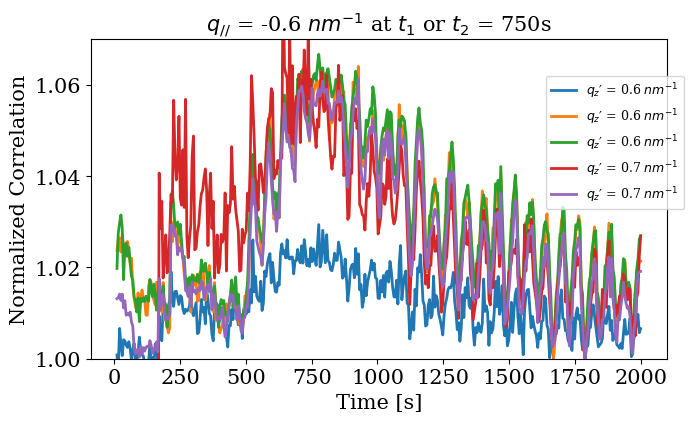

Dynamic_analysis_CHX.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  Can be used to do:


  0%|          | 0/5 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150077684, 1.6815491525442274, 1.6815491524867303, 1.6815491524227761, 1.6815491531451796, 1.6815491528811188] 1.6815491522596193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499610085, 1.6815491528348705, 1.68154915245643, 1.6815491521910282, 1.6815491524343384, 1.6815491527071122] 1.6815491520974646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499663238, 1.6815491525393442, 1.6815491526722353, 1.6815491523570394, 1.6815491525878636, 1.6815491525525075] 1.6815491521125525 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500397721, 1.681549152690259, 1.6815491523447728, 1.6815491521841555, 1.6815491529754638, 1.6815491529295334] 1.681549152193993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498351172, 1.6815491525338606, 1.681549152121124, 1.6815491523394313, 1.681549152968362, 1.6815491529142523] 1.6815491521186912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500467794, 1.6815491522540262, 1.6815491524081132, 1.6815491520419297, 1.6815491527035151, 1.6815491526283668] 1.6815491520137886 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500267807, 1.6815491524851618, 1.6815491523285147, 1.6815491521911392, 1.6815491527954243, 1.6815491527338153] 1.6815491520934727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502073847, 1.6815491525783743, 1.681549152559913, 1.6815491520519896, 1.681549152704291, 1.681549152720446] 1.6815491521370662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149914225, 1.6815491525364257, 1.6815491523304145, 1.6815491523359656, 1.6815491528064443, 1.6815491527053568] 1.6815491521048054 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501960178, 1.6815491524663821, 1.681549152455677, 1.6815491525365767, 1.6815491527579915, 1.6815491529429156] 1.6815491522259267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501820903, 1.6815491527866682, 1.6815491524609776, 1.6815491522601707, 1.6815491529761335, 1.6815491525507134] 1.6815491522027923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499556976, 1.6815491521959096, 1.6815491524320896, 1.6815491521611818, 1.6815491525666237, 1.6815491525444988] 1.6815491519760002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501238813, 1.6815491525349486, 1.6815491524272126, 1.681549152527559, 1.681549152723655, 1.6815491525544637] 1.68154915214862 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149952906, 1.6815491526392963, 1.6815491524171877, 1.6815491523670736, 1.6815491526083814, 1.681549152868154] 1.6815491521421666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502402802, 1.6815491525949247, 1.6815491524438548, 1.6815491521711716, 1.6815491528356383, 1.6815491529594002] 1.681549152207545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497085793, 1.6815491525239468, 1.6815491521322214, 1.6815491525709305, 1.6815491529263857, 1.68154915234717] 1.6815491520348722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497410084, 1.6815491524611685, 1.6815491524309927, 1.6815491526678246, 1.6815491523224741, 1.6815491529533064] 1.6815491520961292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502715734, 1.6815491523639845, 1.681549152592397, 1.681549152095934, 1.6815491529920203, 1.681549152918846] 1.6815491522057924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500013993, 1.6815491525954824, 1.6815491528071438, 1.6815491523751112, 1.6815491529833078, 1.6815491528283122] 1.681549152265126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149987469, 1.6815491525562356, 1.6815491524607147, 1.6815491526206556, 1.6815491526835977, 1.6815491530329472] 1.6815491522236032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150127196, 1.6815491525761432, 1.6815491524756436, 1.6815491523816801, 1.6815491528687656, 1.6815491527688797] 1.6815491521997181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149622941, 1.6815491523317454, 1.6815491525613204, 1.6815491522755055, 1.6815491526428206, 1.6815491524207475] 1.6815491519758468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502355355, 1.681549152603631, 1.6815491524034467, 1.6815491523335648, 1.6815491533135134, 1.6815491524691506] 1.6815491522264736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500688449, 1.6815491528727664, 1.6815491524787722, 1.6815491525242585, 1.6815491530813782, 1.6815491525384103] 1.6815491522607386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150118216, 1.6815491529848363, 1.6815491523864186, 1.6815491520335488, 1.6815491529790334, 1.6815491529984277] 1.6815491522500803 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497235358, 1.6815491525192279, 1.6815491522593042, 1.6815491521303705, 1.6815491526747506, 1.6815491529104665] 1.6815491520362762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149736571, 1.6815491525134503, 1.6815491525040058, 1.6815491522697354, 1.6815491532479374, 1.681549152955522] 1.6815491522045372 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502010138, 1.681549152493509, 1.6815491521799606, 1.6815491524053021, 1.6815491526886368, 1.6815491526408] 1.681549152101537 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149835687, 1.6815491525098016, 1.6815491523109811, 1.681549152523326, 1.6815491527362916, 1.6815491528628241] 1.6815491521298185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149725873, 1.6815491524469754, 1.6815491526177233, 1.6815491522416188, 1.6815491528268316, 1.6815491527306232] 1.6815491520982742 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150044062, 1.6815491529066167, 1.6815491521686061, 1.6815491523440524, 1.6815491529131066, 1.6815491528660136] 1.681549152207076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500090105, 1.6815491525904536, 1.68154915227589, 1.6815491521756094, 1.6815491527881408, 1.6815491525901107] 1.6815491520715362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498933417, 1.6815491525687571, 1.6815491519147852, 1.6815491522161774, 1.6815491525926767, 1.681549152275175] 1.6815491519101524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497597805, 1.6815491526482047, 1.6815491522154637, 1.6815491524603052, 1.6815491528278486, 1.6815491525743678] 1.681549152080995 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499164037, 1.6815491525650605, 1.6815491521675945, 1.6815491523142456, 1.6815491526938535, 1.6815491525598212] 1.681549152036163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496008312, 1.6815491527358768, 1.6815491521665304, 1.6815491523486799, 1.6815491526619244, 1.6815491526943642] 1.681549152034701 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498303397, 1.6815491522291088, 1.6815491522041066, 1.6815491520780323, 1.6815491527321615, 1.681549152447773] 1.6815491519202534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499058766, 1.6815491528703452, 1.6815491523484072, 1.6815491523088264, 1.6815491521746733, 1.6815491525093371] 1.6815491520195778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497687542, 1.6815491526312059, 1.681549152010481, 1.6815491519204455, 1.681549152668464, 1.6815491529035715] 1.6815491519838204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499346038, 1.681549152532262, 1.68154915250968, 1.681549152043769, 1.6815491527023116, 1.681549152711062] 1.6815491520722814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499624633, 1.6815491525793975, 1.6815491522506427, 1.6815491519329986, 1.6815491525515949, 1.6815491525129058] 1.6815491519650003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500424824, 1.6815491525746236, 1.6815491521959913, 1.6815491523542914, 1.681549152786502, 1.681549152728194] 1.681549152113681 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496085553, 1.6815491523547705, 1.6815491522867045, 1.6815491523513506, 1.6815491526268382, 1.6815491527839375] 1.6815491520020263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498658912, 1.6815491523893824, 1.6815491522340356, 1.6815491518655565, 1.6815491527903372, 1.681549152365084] 1.6815491519183814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546371509012, 1.681546720212368, 1.6815466753504773, 1.6815466627604634, 1.6815467275336973, 1.6815467288831258] 1.6815466477081904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496930863, 1.6815491527334747, 1.6815491523075536, 1.6815491519513408, 1.681549152388044, 1.6815491526659008] 1.6815491519565668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914994994, 1.6815491526615958, 1.6815491523143944, 1.681549151942587, 1.681549152891213, 1.6815491528009474] 1.6815491520934465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496936792, 1.6815491528662125, 1.6815491522856316, 1.6815491519299886, 1.681549152621665, 1.681549152729974] 1.6815491520211918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500826831, 1.6815491530002387, 1.681549152443179, 1.6815491522961814, 1.6815491525033597, 1.681549152566486] 1.681549152148688 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150115437, 1.681549152572095, 1.6815491522042247, 1.6815491521143295, 1.6815491523176131, 1.6815491529709012] 1.6815491520491002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497301163, 1.6815491527161743, 1.681549152001932, 1.681549151835271, 1.681549152672435, 1.6815491529183042] 1.6815491519790389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497913797, 1.6815491529733437, 1.6815491522524768, 1.6815491523114199, 1.6815491526658244, 1.6815491527864674] 1.6815491521301518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149926278, 1.681549152882568, 1.6815491523649544, 1.6815491521143056, 1.681549152567916, 1.681549152688853] 1.6815491520908126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496133, 1.6815491525348327, 1.6815491521778418, 1.6815491521651098, 1.6815491527173956, 1.6815491526562871] 1.6815491519774615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496243662, 1.6815491527469275, 1.6815491519786159, 1.6815491520148291, 1.6815491522819928, 1.6815491524484] 1.681549151849189 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497308068, 1.681549152567067, 1.6815491520772334, 1.681549152041728, 1.6815491524970194, 1.6815491523183779] 1.681549151872039 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497435202, 1.6815491524643082, 1.6815491522604695, 1.6815491519599517, 1.6815491526470576, 1.6815491523227988] 1.6815491518996843 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498629602, 1.6815491527993736, 1.6815491520851982, 1.6815491519651689, 1.6815491526169728, 1.681549152617292] 1.6815491519911607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496529527, 1.6815491527201551, 1.6815491522458546, 1.681549151927165, 1.6815491526603799, 1.6815491525496205] 1.6815491519593546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497269903, 1.681549152676471, 1.6815491522547483, 1.681549151813174, 1.681549152312234, 1.6815491525202844] 1.6815491518839838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498686304, 1.6815491527631234, 1.6815491519951182, 1.6815491517162053, 1.6815491523448767, 1.6815491528403808] 1.6815491519213894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498757127, 1.6815491531421372, 1.6815491518270669, 1.681549151856463, 1.6815491522337385, 1.6815491528508435] 1.6815491519643269 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149781512, 1.6815491527871878, 1.681549152126916, 1.6815491518333445, 1.6815491524792439, 1.6815491527742292] 1.6815491519637389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576414, 1.681549152664667, 1.6815491519662933, 1.6815491517046794, 1.6815491520092087, 1.6815491525833357] 1.681549151780971 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496260462, 1.6815491524433872, 1.6815491521210468, 1.6815491514565206, 1.6815491524621065, 1.6815491526151494] 1.6815491517873762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149607029, 1.6815491528582482, 1.681549151932444, 1.681549151823933, 1.6815491522880661, 1.6815491521474293] 1.6815491517761914 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149634372, 1.6815491526653128, 1.6815491523236354, 1.6815491521517116, 1.6815491528122442, 1.6815491530303381] 1.6815491521029358 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497867558, 1.6815491524196569, 1.6815491519275803, 1.681549152115768, 1.68154915274686, 1.6815491523019932] 1.6815491518831027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491619938, 1.6815491528938606, 1.6815491523209882, 1.6815491519159123, 1.6815491527282798, 1.6815491523356125] 1.6815491518927745 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149528054, 1.6815491525026616, 1.6815491520907937, 1.6815491520700538, 1.6815491524485227, 1.6815491523324306] 1.6815491518287526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497937085, 1.6815491528412823, 1.681549152045342, 1.6815491515864038, 1.6815491522696986, 1.6815491521995747] 1.681549151789335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149266135, 1.6815491526500832, 1.6815491518954242, 1.681549151750434, 1.681549152540974, 1.6815491526745756] 1.681549151796271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492811288, 1.6815491528486222, 1.6815491518650165, 1.6815491516638392, 1.6815491519287757, 1.6815491524779116] 1.681549151677549 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152718067, 1.6815491518626535, 1.681549151572837, 1.681549152067289, 1.6815491525818498] 1.6815491521605392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492536125, 1.6815491525002448, 1.6815491515914935, 1.6815491514577232, 1.6815491520527859, 1.6815491525639983] 1.6815491515699765 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149500679, 1.6815491523613737, 1.6815491516225407, 1.68154915158267, 1.681549152054977, 1.681549152538278] 1.6815491516100864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524604536, 1.681549151602232, 1.6815491516958154, 1.681549152169299, 1.6815491522836492] 1.6815491520422896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491866634, 1.6815491525463404, 1.6815491517000476, 1.68154915194157, 1.681549152545946, 1.6815491524758075] 1.6815491517327292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495185846, 1.6815491528468995, 1.6815491518837695, 1.6815491517598895, 1.681549152169279, 1.6815491523188095] 1.6815491517495385 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494021777, 1.6815491526867552, 1.6815491520261139, 1.6815491513842553, 1.6815491524132904, 1.6815491526841067] 1.6815491517661165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495639674, 1.6815491523173103, 1.6815491517487215, 1.681549151851602, 1.6815491523899992, 1.6815491522351458] 1.6815491516844576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496302917, 1.681549152395799, 1.6815491517232548, 1.6815491517730532, 1.6815491525912396, 1.6815491526622317] 1.6815491517959782 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497189208, 1.681549152761388, 1.6815491514370269, 1.6815491517892465, 1.6815491519246955, 1.6815491523543935] 1.6815491516642787 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149724841, 1.6815491525019466, 1.6815491519205708, 1.6815491520464456, 1.6815491520104255, 1.6815491528313302] 1.68154915183926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494728643, 1.6815491525477944, 1.6815491517632646, 1.681549151753221, 1.6815491521402048, 1.681549152620839] 1.681549151716365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497852935, 1.6815491526874498, 1.6815491518219918, 1.68154915156635, 1.6815491521492332, 1.6815491526973165] 1.6815491517846057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493501566, 1.6815491525136164, 1.6815491520360464, 1.68154915198929, 1.6815491521290915, 1.6815491526871944] 1.6815491517842327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491526449984, 1.6815491517799535, 1.681549152129155, 1.6815491522197146, 1.681549152429378] 1.6815491522406396 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492613184, 1.6815491525257613, 1.681549151688683, 1.6815491518417272, 1.681549152279569, 1.6815491527426198] 1.6815491517232797 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495562025, 1.6815491526214075, 1.6815491515409704, 1.6815491515023813, 1.6815491523830932, 1.6815491524702386] 1.681549151679049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496736454, 1.6815491528013844, 1.6815491515433174, 1.6815491515804135, 1.681549152272324, 1.681549152390362] 1.6815491517102412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494354724, 1.6815491526919693, 1.681549151815557, 1.6815491517191044, 1.681549151969997, 1.6815491524000725] 1.681549151672029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495637591, 1.681549152726109, 1.6815491516339902, 1.6815491519159407, 1.6815491521592065, 1.681549152786241] 1.6815491517975412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493351464, 1.6815491523439752, 1.6815491518799393, 1.68154915188263, 1.6815491516929093, 1.6815491525302253] 1.6815491516108043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149512131, 1.6815491526599402, 1.681549151810409, 1.6815491514924057, 1.6815491524521127, 1.6815491525906179] 1.6815491517529362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495460657, 1.681549152607066, 1.6815491518346515, 1.681549151527089, 1.6815491522082837, 1.681549152567663] 1.6815491517151362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491522190191, 1.681549151730343, 1.6815491517701382, 1.681549152160787, 1.6815491523931456] 1.6815491520546868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492192627, 1.681549152738115, 1.6815491519181203, 1.681549151664056, 1.68154915211663, 1.6815491523686683] 1.6815491516708085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491541104, 1.6815491525492026, 1.6815491519474381, 1.6815491515937921, 1.6815491522130102, 1.6815491529344122] 1.6815491517319943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496691344, 1.6815491525487838, 1.6815491513457896, 1.6815491514602439, 1.6815491524258852, 1.6815491523745099] 1.681549151637391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495076538, 1.6815491524711814, 1.681549151683063, 1.6815491512892025, 1.6815491522605437, 1.68154915245782] 1.6815491516115777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492128505, 1.6815491525395405, 1.6815491518025985, 1.6815491516424443, 1.6815491522690147, 1.6815491524438677] 1.6815491516517191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149212004, 1.6815491526401507, 1.681549151785207, 1.681549151477936, 1.681549151865374, 1.6815491522555863] 1.6815491515393763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149661043, 1.6815491530023197, 1.681549151729103, 1.6815491515423382, 1.6815491521537798, 1.6815491521375776] 1.6815491517043604 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914937889, 1.6815491527631776, 1.6815491516866747, 1.681549151627184, 1.6815491519589223, 1.6815491525272255] 1.6815491516570125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149377254, 1.6815491527442736, 1.6815491516748593, 1.6815491514564238, 1.6815491521223285, 1.6815491526235529] 1.6815491516664487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495356345, 1.681549152476539, 1.6815491519127628, 1.6815491514081788, 1.6815491518588446, 1.6815491522158394] 1.6815491515679664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496848578, 1.681549152523937, 1.681549151645434, 1.6815491512169674, 1.6815491517540475, 1.6815491524829351] 1.681549151551363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492986148, 1.6815491525422477, 1.681549151696761, 1.6815491517798686, 1.6815491517848793, 1.6815491526295534] 1.6815491516219876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492039327, 1.6815491525020212, 1.681549151847857, 1.6815491515248322, 1.6815491519497505, 1.681549152469759] 1.6815491515830256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493643493, 1.6815491526592048, 1.6815491517100303, 1.6815491516463936, 1.6815491519145027, 1.68154915243746] 1.6815491516219903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495117847, 1.6815491525848807, 1.6815491514669656, 1.681549151617265, 1.681549151652976, 1.6815491523873929] 1.6815491515368777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491528394997, 1.681549151677765, 1.681549151209658, 1.681549152239186, 1.681549152312801] 1.6815491520557821 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525890796, 1.6815491518242895, 1.6815491520354549, 1.6815491521793016, 1.6815491525785555] 1.681549152241336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495796069, 1.6815491525270438, 1.6815491517954504, 1.6815491515101022, 1.6815491522907475, 1.6815491521816668] 1.6815491516474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491573353, 1.6815491524069426, 1.6815491516193863, 1.681549151487352, 1.68154915163079, 1.6815491525517134] 1.681549151475587 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494534216, 1.6815491523152262, 1.6815491517643544, 1.681549151861251, 1.6815491520985004, 1.6815491524541741] 1.6815491516578216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498496256, 1.6815491527971367, 1.6815491518925265, 1.6815491515260987, 1.681549151972701, 1.6815491524072943] 1.6815491517408974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492617722, 1.6815491524726704, 1.6815491516390204, 1.68154915172886, 1.6815491517101093, 1.6815491525356792] 1.6815491515580183 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492774988, 1.6815491528240414, 1.681549151779091, 1.6815491512646643, 1.6815491519832877, 1.6815491526480324] 1.6815491516294359 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525683863, 1.681549151540711, 1.6815491514424328, 1.68154915206626, 1.6815491524677832] 1.6815491520171146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152649911, 1.681549151244334, 1.6815491513200413, 1.6815491517005423, 1.6815491526080666] 1.6815491519045789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490975214, 1.6815491524626784, 1.681549151138209, 1.681549151181441, 1.681549152193031, 1.6815491525731172] 1.6815491514409997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149285404, 1.681549152525882, 1.6815491518090129, 1.6815491514220615, 1.6815491514952399, 1.6815491524903354] 1.6815491515046561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491452685, 1.6815491525601933, 1.6815491514245013, 1.681549151197717, 1.6815491522257249, 1.681549152190768] 1.681549151457362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491682053, 1.6815491526296085, 1.6815491514866938, 1.6815491513824607, 1.6815491520732473, 1.6815491525254158] 1.681549151544272 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493358312, 1.6815491524748456, 1.6815491512254015, 1.6815491514038596, 1.6815491518313883, 1.681549152612237] 1.6815491514805938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491147263, 1.6815491526456037, 1.6815491515335896, 1.6815491512211764, 1.6815491519756325, 1.6815491520982282] 1.6815491514314926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815462988423606, 1.6815467144770455, 1.6815465943035184, 1.6815465750571015, 1.6815466376431818, 1.6815467031204445] 1.6815465872406088 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149261452, 1.681549152394596, 1.6815491516026064, 1.6815491512626854, 1.6815491518223915, 1.6815491525600894] 1.6815491514839704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524027593, 1.6815491513784133, 1.6815491514473235, 1.6815491522097328, 1.6815491524085484] 1.6815491519693555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149000288, 1.6815491525458097, 1.681549151526557, 1.6815491513167813, 1.6815491519243047, 1.681549152721506] 1.6815491515058743 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489916474, 1.6815491524871482, 1.681549151363945, 1.681549151536236, 1.6815491515180998, 1.6815491524902884] 1.6815491513978944 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491767203, 1.6815491527147244, 1.6815491515435133, 1.681549151287418, 1.6815491516272063, 1.6815491522777948] 1.6815491514378964 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149066436, 1.6815491525740018, 1.681549151453873, 1.6815491511254157, 1.6815491518601267, 1.6815491521237749] 1.6815491513672713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490110364, 1.6815491526011432, 1.6815491514211707, 1.6815491512258824, 1.681549151660092, 1.681549152671284] 1.6815491514317682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149630941, 1.681549152421085, 1.6815491513932619, 1.6815491512045697, 1.6815491514266334, 1.6815491522902235] 1.6815491513944523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148980325, 1.6815491525930777, 1.6815491515868906, 1.6815491514447851, 1.681549151454047, 1.6815491520805175] 1.681549151356607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490888945, 1.681549152536653, 1.681549151496811, 1.6815491514977632, 1.681549152027221, 1.681549152437741] 1.6815491515141805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521722379, 1.6815491515788583, 1.6815491512950023, 1.6815491518898358, 1.681549152010116] 1.6815491517892098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491728563, 1.6815491522687323, 1.6815491512641882, 1.6815491511425726, 1.6815491519461352, 1.6815491525697581] 1.6815491513940402 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149166358, 1.681549152234612, 1.6815491515598868, 1.6815491515236372, 1.6815491521051107, 1.6815491527765234] 1.6815491515610212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491351366, 1.6815491524164958, 1.6815491513450143, 1.6815491513480132, 1.6815491518641155, 1.6815491522578574] 1.6815491513944387 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493237835, 1.681549152603131, 1.6815491514474274, 1.6815491510990492, 1.681549151391489, 1.6815491525671882] 1.6815491514053447 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490382222, 1.681549152368369, 1.68154915126971, 1.681549151301096, 1.681549152095859, 1.6815491525324502] 1.6815491514342849 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148997771, 1.6815491523850015, 1.6815491515602012, 1.6815491511714966, 1.6815491515352967, 1.681549152849283] 1.6815491514165082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491527017228, 1.6815491516295618, 1.681549151011919, 1.6815491516020402, 1.6815491525935995] 1.681549151907769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491031471, 1.6815491528421314, 1.6815491513475322, 1.681549151216244, 1.6815491519086128, 1.681549152571015] 1.6815491514981133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149179732, 1.681549152380192, 1.681549151135096, 1.6815491511464034, 1.6815491518323138, 1.68154915221634] 1.6815491513150127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490116186, 1.6815491523940516, 1.6815491514254286, 1.681549150922351, 1.6815491518515993, 1.681549152072055] 1.6815491512795173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493020827, 1.6815491524414474, 1.6815491514141714, 1.681549150950679, 1.6815491516683352, 1.6815491525313808] 1.681549151384683 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488289886, 1.681549152209092, 1.6815491514633925, 1.68154915130672, 1.6815491518518577, 1.681549151779751] 1.6815491512399667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488463206, 1.6815491523097403, 1.681549151303781, 1.6815491511998903, 1.6815491516480083, 1.6815491524472703] 1.6815491512925018 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491219356, 1.6815491523676842, 1.6815491515948002, 1.6815491513842655, 1.6815491518383379, 1.6815491523423054] 1.6815491514415548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488438483, 1.681549152357892, 1.681549151746263, 1.6815491513622614, 1.681549151715703, 1.681549152523142] 1.6815491514248517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488208991, 1.6815491524267507, 1.6815491513719985, 1.6815491515611853, 1.6815491518229186, 1.681549152766122] 1.6815491514616456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490943772, 1.681549152593277, 1.681549150995255, 1.681549151033467, 1.6815491516613243, 1.6815491526770368] 1.681549151342456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152692086, 1.681549151489254, 1.6815491508054654, 1.6815491519082078, 1.6815491525953297] 1.6815491518980685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493383412, 1.681549152375939, 1.6815491517596741, 1.68154915107591, 1.6815491514094068, 1.6815491527603506] 1.68154915145327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149092696, 1.6815491529589086, 1.6815491517497563, 1.681549151195934, 1.6815491513986962, 1.681549152538099] 1.6815491514890148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489228545, 1.6815491527077135, 1.681549151234326, 1.6815491510218177, 1.6815491517337153, 1.681549152260076] 1.6815491513134173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489068397, 1.6815491522246107, 1.6815491512858216, 1.6815491513199419, 1.681549151708725, 1.6815491523615211] 1.6815491513012433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489383891, 1.68154915255261, 1.6815491514318346, 1.6815491517033436, 1.6815491514999978, 1.6815491528065407] 1.6815491514887861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491845105, 1.6815491523782775, 1.6815491515265029, 1.6815491510233418, 1.6815491517039005, 1.681549152294724] 1.681549151351876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490435743, 1.6815491523673467, 1.6815491512383347, 1.681549151242148, 1.6815491515919252, 1.6815491522343988] 1.6815491512862881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488484389, 1.6815491524968822, 1.6815491517033188, 1.6815491509728897, 1.681549151551918, 1.6815491524448998] 1.6815491513363912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493327586, 1.6815491521259203, 1.681549151415056, 1.6815491512787863, 1.6815491520169288, 1.6815491525862996] 1.6815491514592915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491016963, 1.6815491527673005, 1.6815491511747922, 1.6815491513234226, 1.6815491515706311, 1.6815491524317383] 1.68154915139493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491284629, 1.6815491522515797, 1.6815491511228982, 1.6815491512288228, 1.681549151531574, 1.681549152515863] 1.6815491512965337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486116332, 1.6815491523771806, 1.6815491512557772, 1.6815491509350506, 1.6815491520245986, 1.6815491524955042] 1.681549151283291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524309287, 1.6815491512998193, 1.6815491513987828, 1.6815491518657995, 1.681549152653096] 1.6815491519296852 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488548657, 1.6815491524584223, 1.6815491513596994, 1.6815491511496, 1.6815491516769177, 1.6815491527552595] 1.681549151375794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490352992, 1.681549152635876, 1.6815491512111707, 1.6815491510665073, 1.6815491516153842, 1.6815491526731652] 1.6815491513729004 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488574108, 1.6815491524694623, 1.6815491514377299, 1.6815491514675944, 1.6815491518818728, 1.6815491523211232] 1.6815491514058658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491535761, 1.6815491525912307, 1.6815491512281984, 1.6815491512757212, 1.6815491521652355, 1.68154915207468] 1.6815491514147738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493766395, 1.6815491522990156, 1.6815491514260699, 1.6815491510154232, 1.6815491519316295, 1.6815491522807453] 1.6815491513882534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488267487, 1.6815491524331998, 1.6815491511080043, 1.6815491511529626, 1.6815491514824172, 1.6815491521881802] 1.6815491511985856 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520207226, 1.6815491516163439, 1.6815491511939937, 1.6815491516515069, 1.681549152578162] 1.681549151812146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149002044, 1.681549152266482, 1.6815491513242873, 1.68154915080983, 1.6815491512598069, 1.6815491520933739] 1.6815491511259708 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490489247, 1.6815491523110029, 1.6815491512579124, 1.6815491510182232, 1.6815491514204597, 1.6815491521875794] 1.6815491512073504 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484722953, 1.681549152573826, 1.6815491511314042, 1.6815491510456586, 1.6815491513982326, 1.6815491526115354] 1.6815491512054919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914886866, 1.6815491522331025, 1.6815491509718, 1.6815491511449023, 1.6815491517758225, 1.6815491525516948] 1.6815491512576637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149096118, 1.6815491523623907, 1.6815491513778387, 1.6815491513253713, 1.681549151842165, 1.6815491524060828] 1.6815491514016612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149049915, 1.6815491523285377, 1.681549150779209, 1.6815491509795306, 1.6815491515238241, 1.6815491524908088] 1.6815491511919707 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152447598, 1.6815491510466476, 1.6815491511383263, 1.681549151309924, 1.6815491526586843] 1.6815491517202361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493971355, 1.6815491524936625, 1.6815491512500795, 1.6815491510330567, 1.6815491516817653, 1.681549152208218] 1.6815491513439864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490497791, 1.681549152486177, 1.6815491513112804, 1.6815491511355347, 1.6815491514033152, 1.6815491523774369] 1.6815491512939207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491721666, 1.6815491519868107, 1.6815491510838698, 1.6815491514635257, 1.6815491514777818, 1.6815491523801782] 1.6815491512607224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489788945, 1.6815491523470492, 1.6815491514368146, 1.6815491508964682, 1.6815491514194107, 1.6815491523764248] 1.6815491512425103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492531693, 1.6815491527317308, 1.6815491513271623, 1.6815491510172818, 1.681549151873643, 1.6815491523921042] 1.6815491514325156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491042285, 1.6815491521680777, 1.681549151546923, 1.6815491510100733, 1.681549151624485, 1.681549152331474] 1.6815491512975436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488158139, 1.6815491525250335, 1.6815491512638232, 1.6815491508970712, 1.6815491516847354, 1.68154915253871] 1.6815491512875311 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489137675, 1.6815491528254496, 1.681549151465918, 1.6815491511568323, 1.6815491516163288, 1.6815491527760908] 1.6815491514590646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521379249, 1.681549151190692, 1.6815491507006772, 1.681549151447494, 1.6815491525066664] 1.6815491515966907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490320507, 1.6815491522673747, 1.6815491509312515, 1.68154915082369, 1.681549151850037, 1.6815491525076496] 1.6815491512353422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489042786, 1.681549152939092, 1.6815491511639502, 1.6815491509453215, 1.6815491516059748, 1.6815491524745756] 1.6815491513388654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491687107, 1.6815491525066735, 1.6815491514551226, 1.6815491510651683, 1.6815491515334635, 1.6815491526397492] 1.6815491513948146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491271821, 1.6815491519803194, 1.681549151466264, 1.6815491509707874, 1.681549151500782, 1.6815491522439223] 1.6815491512148764 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489688768, 1.6815491522688468, 1.6815491513107226, 1.6815491510235487, 1.681549151167642, 1.6815491523564337] 1.6815491511826783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488089682, 1.6815491523678805, 1.6815491512839134, 1.6815491509334395, 1.6815491512409735, 1.6815491526575834] 1.6815491512154594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489921293, 1.681549152617519, 1.6815491514532392, 1.6815491509266502, 1.6815491511768172, 1.6815491522026695] 1.681549151228171 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488845828, 1.6815491524854327, 1.6815491510580314, 1.6815491511116658, 1.6815491515293024, 1.6815491524131447] 1.6815491512470266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491827324, 1.6815491522558697, 1.681549150761028, 1.681549150887684, 1.6815491512696195, 1.6815491523630746] 1.6815491511200016 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485564502, 1.681549152200057, 1.6815491510143499, 1.6815491508866032, 1.6815491511576757, 1.6815491522552573] 1.6815491510117322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488321905, 1.6815491518927628, 1.6815491512072374, 1.6815491504521614, 1.6815491513847913, 1.6815491527342274] 1.6815491510838951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486608534, 1.6815491524924058, 1.681549150963114, 1.6815491509398273, 1.6815491512527068, 1.681549152624748] 1.6815491511556093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486902792, 1.6815491524093233, 1.6815491509085523, 1.681549150855214, 1.6815491513200254, 1.6815491523521588] 1.6815491510892588 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525344353, 1.6815491509834013, 1.6815491509708425, 1.6815491514098637, 1.6815491521915265] 1.6815491516180139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487176915, 1.681549151996521, 1.6815491511616587, 1.6815491511014211, 1.6815491513769043, 1.6815491523189379] 1.6815491511121892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489631755, 1.6815491520880448, 1.6815491509464744, 1.6815491509173164, 1.6815491512037646, 1.6815491521020594] 1.6815491510368057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485184069, 1.6815491523748984, 1.6815491517175927, 1.6815491508103033, 1.6815491514195857, 1.6815491523232962] 1.6815491511940135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148788147, 1.6815491523863142, 1.6815491509536349, 1.6815491506369584, 1.6815491515844503, 1.6815491522352852] 1.681549151097465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546241384249, 1.68154667942457, 1.6815465345502139, 1.6815465087268087, 1.6815465739524358, 1.6815466845625204] 1.681546537100133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149119986, 1.6815491521211885, 1.6815491512677099, 1.6815491510292633, 1.6815491514273946, 1.6815491521147612] 1.6815491511800509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490799817, 1.6815491522511992, 1.6815491510808842, 1.6815491505958136, 1.6815491515002448, 1.6815491518998993] 1.6815491510680038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520575554, 1.6815491511801475, 1.6815491507410805, 1.6815491514352834, 1.681549152154533] 1.6815491515137198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518507684, 1.6815491512295804, 1.6815491506978884, 1.6815491513978973, 1.6815491524749033] 1.681549151530208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483714986, 1.681549151906565, 1.6815491510625993, 1.6815491508207963, 1.6815491512611267, 1.6815491522358523] 1.681549150943073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148802549, 1.6815491523772894, 1.6815491512268474, 1.6815491509174576, 1.6815491512243987, 1.6815491523873796] 1.681549151155987 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148491162, 1.6815491523436972, 1.681549151081784, 1.6815491507153828, 1.6815491510393201, 1.6815491525202262] 1.6815491510319287 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487242702, 1.681549152363596, 1.6815491510963207, 1.6815491509046563, 1.68154915158002, 1.6815491524412884] 1.6815491511850251 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487569343, 1.6815491521495103, 1.6815491509676628, 1.681549150758518, 1.6815491511126694, 1.6815491518993593] 1.6815491509407758 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524029267, 1.681549151023055, 1.6815491509964002, 1.6815491510375344, 1.6815491522057222] 1.6815491515331278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485704492, 1.6815491522585084, 1.6815491508755547, 1.6815491510937166, 1.681549151436501, 1.6815491520331172] 1.6815491510446412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487118215, 1.6815491519956565, 1.6815491511366298, 1.681549150943292, 1.681549151586144, 1.6815491521740205] 1.6815491510912608 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521907004, 1.681549151012431, 1.6815491509406453, 1.6815491514428533, 1.681549151857717] 1.6815491514888692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148616413, 1.6815491521645236, 1.6815491509467813, 1.6815491511915615, 1.6815491513226326, 1.6815491520726882] 1.6815491510524332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148756841, 1.6815491519951902, 1.6815491509987766, 1.68154915087257, 1.6815491512021135, 1.6815491524579462] 1.6815491510472398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482046538, 1.6815491521535488, 1.6815491510638907, 1.6815491511637894, 1.681549151534063, 1.6815491522944157] 1.6815491510690606 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486646899, 1.681549152401253, 1.6815491509869087, 1.681549150727223, 1.681549151492538, 1.6815491525928046] 1.6815491511442362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490762655, 1.6815491522476158, 1.6815491511745195, 1.6815491508035905, 1.6815491516049188, 1.6815491525630648] 1.6815491512449958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484723517, 1.6815491523706982, 1.6815491508532805, 1.6815491505456661, 1.6815491515426801, 1.6815491522821633] 1.68154915101114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487190464, 1.6815491524665056, 1.6815491510137242, 1.681549150993412, 1.6815491514579008, 1.681549151972586] 1.6815491511038625 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148279279, 1.68154915186275, 1.6815491511257088, 1.68154915069681, 1.681549151228733, 1.6815491520323036] 1.6815491508709306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520623254, 1.6815491509936438, 1.681549150757144, 1.6815491513134582, 1.6815491523512662] 1.6815491514955674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520557684, 1.6815491506049978, 1.6815491508338871, 1.6815491512916845, 1.6815491521389019] 1.6815491513850478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486297485, 1.6815491519258399, 1.6815491511352176, 1.681549150621073, 1.681549151382355, 1.6815491517197616] 1.6815491509023321 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487140108, 1.6815491518934311, 1.681549150792688, 1.6815491504990243, 1.6815491513400698, 1.6815491522110233] 1.6815491509083744 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151946386, 1.6815491509753406, 1.6815491508923142, 1.6815491512467138, 1.6815491520163692] 1.681549151415425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148626833, 1.6815491518218675, 1.68154915064025, 1.6815491506913869, 1.6815491511264233, 1.6815491518127899] 1.6815491507865918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484783784, 1.6815491520515566, 1.6815491506073101, 1.6815491504799107, 1.681549150989289, 1.6815491519175394] 1.6815491507539975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484223575, 1.6815491519065953, 1.6815491506074074, 1.68154915061029, 1.6815491512508185, 1.6815491522531198] 1.6815491508417644 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485563596, 1.6815491520534764, 1.6815491508559832, 1.681549150628462, 1.681549151099846, 1.6815491521869683] 1.6815491508968492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148324796, 1.6815491518229293, 1.681549150521112, 1.681549150864714, 1.681549150743086, 1.681549152387099] 1.681549150777289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484776843, 1.6815491520390147, 1.6815491508526712, 1.6815491504487317, 1.6815491512861986, 1.6815491519489263] 1.6815491508422042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518509313, 1.681549150813146, 1.68154915042191, 1.6815491512339409, 1.6815491520090164] 1.6815491512657892 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485753777, 1.6815491523008128, 1.681549150875366, 1.6815491506414144, 1.6815491512792127, 1.6815491522114092] 1.681549150980599 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148609911, 1.6815491520247097, 1.6815491510188227, 1.6815491508739937, 1.6815491510945169, 1.6815491518582317] 1.681549150913364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486667953, 1.6815491523561965, 1.6815491509941012, 1.6815491506473537, 1.6815491513009904, 1.6815491520551076] 1.6815491510034242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484882341, 1.6815491518691599, 1.6815491508392038, 1.6815491503285656, 1.6815491510082543, 1.6815491521066104] 1.6815491507733382 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483424254, 1.6815491517526473, 1.681549150803007, 1.6815491506812714, 1.6815491514614571, 1.6815491522534307] 1.681549150882373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148581031, 1.6815491515810193, 1.6815491508710627, 1.6815491504266094, 1.6815491515040968, 1.68154915187692] 1.68154915080679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486235992, 1.6815491517655894, 1.6815491506765952, 1.6815491509078502, 1.6815491508768927, 1.6815491522940427] 1.6815491508574283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482670528, 1.6815491519214447, 1.6815491507748286, 1.6815491504972773, 1.6815491508090048, 1.6815491523566966] 1.681549150771051 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484436524, 1.6815491523886026, 1.6815491508749703, 1.6815491505364903, 1.6815491509575415, 1.6815491522287038] 1.6815491509049938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520495551, 1.6815491507236953, 1.6815491505183378, 1.6815491508914935, 1.6815491522656498] 1.6815491512897462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490230237, 1.6815491520994876, 1.6815491505993982, 1.681549150832506, 1.6815491510290324, 1.6815491523956023] 1.6815491509965084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489454182, 1.6815491519966859, 1.6815491509178315, 1.681549150748701, 1.6815491512645417, 1.6815491519613488] 1.6815491509724214 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549131945033, 1.6815491302366312, 1.6815491295776726, 1.6815491301976477, 1.6815491322315843] 1.681549130837714 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485865555, 1.6815491519918688, 1.6815491507651465, 1.6815491509823426, 1.6815491511498224, 1.6815491520853252] 1.6815491509268436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124851045, 1.6815491327809302, 1.6815491299001009, 1.6815491292880544, 1.6815491308694712, 1.6815491321212992] 1.6815491299684835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491485136635, 1.6815491523273085, 1.6815491509140394, 1.6815491505372906, 1.6815491512083156, 1.6815491520271113] 1.681549150921288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491320616194, 1.68154912983543, 1.6815491296564118, 1.6815491299450573, 1.6815491318620932] 1.6815491306721224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491479993332, 1.6815491520680315, 1.6815491508726854, 1.6815491508731792, 1.6815491507285794, 1.6815491519804224] 1.681549150753705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491236665583, 1.6815491314943518, 1.681549129066151, 1.6815491289425886, 1.6815491298462621, 1.681549132538728] 1.6815491292591063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478929294, 1.6815491518466734, 1.6815491504205387, 1.681549150269146, 1.6815491509002518, 1.6815491522517627] 1.6815491505968836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246556253, 1.681549132108275, 1.681549129362744, 1.6815491293130345, 1.6815491299299365, 1.6815491321406872] 1.6815491295850507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483182505, 1.6815491522164492, 1.6815491504057332, 1.6815491505856661, 1.6815491509423763, 1.6815491520729013] 1.681549150756896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491251373476, 1.6815491325602663, 1.681549129363101, 1.6815491287730246, 1.68154913027651, 1.681549131794517] 1.6815491296507945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491487378176, 1.681549152090493, 1.6815491507646545, 1.6815491504266022, 1.681549151134306, 1.681549151642935] 1.6815491507994682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246734142, 1.681549132145494, 1.6815491293430025, 1.6815491292890066, 1.681549130302972, 1.6815491320270342] 1.6815491296301541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481641809, 1.6815491519305716, 1.6815491505132596, 1.6815491503451305, 1.6815491510207576, 1.6815491519033272] 1.6815491506462046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246686225, 1.6815491318314795, 1.6815491290385784, 1.6815491293376965, 1.6815491303392767, 1.6815491318309412] 1.6815491295077658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482702156, 1.6815491518627592, 1.6815491506320996, 1.6815491506709739, 1.6815491510094591, 1.6815491519831456] 1.6815491507381086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246736705, 1.6815491316291693, 1.6815491294786469, 1.6815491291901061, 1.6815491294408407, 1.681549132257036] 1.6815491294449114 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148107432, 1.6815491518398664, 1.6815491507576699, 1.6815491505793991, 1.6815491505551945, 1.681549152175403] 1.6815491506691609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132289267, 1.6815491294807674, 1.6815491289913762, 1.6815491296104277, 1.681549132740697] 1.681549130622507 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520377646, 1.6815491510792109, 1.6815491503311524, 1.6815491507784825, 1.6815491524836346] 1.681549151342049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549125101852, 1.6815491315009585, 1.6815491296328209, 1.681549128928971, 1.6815491298235896, 1.6815491326551277] 1.6815491296072202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148298913, 1.6815491516411987, 1.6815491508278253, 1.6815491502645394, 1.6815491508147602, 1.681549152308368] 1.6815491506926008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491250547918, 1.6815491322555722, 1.6815491296341847, 1.6815491291591975, 1.6815491299998913, 1.681549131907813] 1.6815491296685752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491520344383, 1.6815491508699916, 1.6815491504418887, 1.6815491510719092, 1.6815491520919106] 1.6815491513020278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124618345, 1.6815491324369791, 1.6815491295635994, 1.6815491291066715, 1.681549130314734, 1.681549131891475] 1.681549129655301 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148383346, 1.6815491521822867, 1.6815491507567724, 1.6815491502967248, 1.6815491510635874, 1.6815491519137504] 1.681549150766078 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491321250153, 1.6815491295622174, 1.6815491290408562, 1.681549130518436, 1.6815491319204332] 1.6815491306333918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491484839553, 1.6815491520456303, 1.6815491507527818, 1.6815491505822564, 1.6815491512144707, 1.6815491519545565] 1.6815491508389417 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248470966, 1.6815491318749327, 1.6815491290075961, 1.6815491294985163, 1.681549130379648, 1.6815491325107321] 1.6815491296864202 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482537008, 1.6815491519296142, 1.6815491503910143, 1.6815491505133093, 1.68154915087272, 1.6815491521288495] 1.6815491506815345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549132164454, 1.681549129661462, 1.6815491289725548, 1.6815491295972693, 1.681549132587274] 1.6815491305966028 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491519213719, 1.6815491507523497, 1.6815491506153553, 1.681549150817295, 1.6815491522368227] 1.681549151268639 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491247742305, 1.6815491318065425, 1.6815491292157492, 1.6815491291257292, 1.6815491297642495, 1.681549132112146] 1.6815491294664409 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491483242742, 1.68154915181456, 1.6815491504310973, 1.6815491506408438, 1.6815491507500973, 1.6815491519770034] 1.6815491506563127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491249449046, 1.6815491321582736, 1.6815491291938685, 1.6815491289530717, 1.6815491302969092, 1.6815491319591835] 1.6815491295843685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491486473082, 1.6815491522142212, 1.6815491505399143, 1.681549150506735, 1.681549151084086, 1.6815491520151236] 1.6815491508345648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124997725, 1.6815491317181541, 1.6815491292020073, 1.681549129231219, 1.6815491296366378, 1.681549131985708] 1.6815491294619085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518133596, 1.6815491503679532, 1.681549150578821, 1.6815491509848233, 1.6815491520576087] 1.6815491511605132 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681545910573964, 1.6815464161599252, 1.6815462365546034, 1.6815462150771947, 1.6815462756611401, 1.6815464250825713] 1.6815462465182327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148030486, 1.6815491521114452, 1.681549150774777, 1.6815491505451705, 1.681549151234961, 1.6815491516553358] 1.6815491507253626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491323502934, 1.6815491295443317, 1.6815491293354068, 1.6815491299470988, 1.6815491324394451] 1.6815491307233152 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521346084, 1.681549150725857, 1.6815491503892188, 1.6815491510235825, 1.6815491523105486] 1.6815491513167629 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491246520216, 1.6815491317835187, 1.681549129218081, 1.6815491281880899, 1.6815491298564362, 1.6815491327112597] 1.6815491294015679 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491482704674, 1.6815491516734138, 1.6815491506802163, 1.6815491499147894, 1.6815491508021276, 1.6815491524504997] 1.6815491506319191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248695351, 1.681549131876051, 1.6815491293813132, 1.6815491293334848, 1.681549129596673, 1.6815491325791259] 1.6815491296060305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491518360655, 1.681549150833722, 1.6815491504693583, 1.681549150737884, 1.681549152254438] 1.6815491512262934 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243708505, 1.681549131504922, 1.6815491290347628, 1.6815491291694364, 1.681549129879548, 1.6815491325440335] 1.6815491294172586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491516235452, 1.6815491503466844, 1.681549150656107, 1.6815491507667018, 1.6815491522606978] 1.681549151130747 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491245694876, 1.6815491317308813, 1.6815491297941891, 1.6815491287500413, 1.681549130152992, 1.681549131686809] 1.6815491294474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491517116596, 1.6815491508386984, 1.681549150532193, 1.6815491507590616, 1.681549151809382] 1.681549151130199 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681548887710186, 1.6815489315956924, 1.681548915837349, 1.6815489134562283, 1.6815489191456248, 1.6815489333954377] 1.6815489168567528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815453522193144, 1.6815459480503434, 1.6815457355621595, 1.6815457080933696, 1.6815457766191013, 1.6815459682193237] 1.6815457481272686 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243845968, 1.681549131910347, 1.6815491292789249, 1.6815491282804675, 1.6815491299054712, 1.6815491315723166] 1.6815491292220208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491478092444, 1.6815491517743717, 1.681549150761402, 1.681549150148741, 1.6815491508227431, 1.6815491518245196] 1.6815491505235034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491315612086, 1.6815491290956568, 1.68154912902203, 1.6815491296676268, 1.6815491322209501] 1.6815491303134942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549151701331, 1.6815491504656155, 1.6815491504688977, 1.6815491507604161, 1.6815491522863106] 1.6815491511365142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491243804472, 1.6815491319646187, 1.681549129323355, 1.6815491291002518, 1.6815491295841332, 1.6815491323422576] 1.6815491294491771 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481804812, 1.6815491519050445, 1.681549150737859, 1.6815491506670388, 1.6815491507063438, 1.6815491521229555] 1.6815491507199536 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549124501346, 1.6815491317226297, 1.6815491290337121, 1.6815491288187951, 1.681549129390611, 1.6815491322810079] 1.6815491292913505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491481863978, 1.6815491517720318, 1.68154915037145, 1.6815491503823088, 1.6815491507182143, 1.681549151804449] 1.6815491505391418 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491248014394, 1.6815491321753164, 1.6815491292668243, 1.6815491288873812, 1.6815491300603318, 1.6815491321631986] 1.681549129559082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914834132, 1.6815491521145987, 1.6815491505942628, 1.681549150501306, 1.6815491510082365, 1.681549151991995] 1.6815491507586195 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313867524622328, 0.05312665903528857, 0.04880673919129874, 0.059736835158320734, 0.04828376792080613, 0.03854657512350945] 0.04860654194590782 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045764816641358674, 0.04496994631519469, 0.05219419038684703, 0.057934547952427584, 0.04533118061115138, 0.039282214963915596] 0.04757948281181582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04713450213993786, 0.04996769879558416, 0.05188778777100711, 0.06565490077821012, 0.047916216555768054, 0.035906891109541705] 0.049744666191674836 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044494220653111594, 0.04690239319646228, 0.05058921169500108, 0.06199835012480448, 0.047980968596517126, 0.03668223503164603] 0.04810789654959043 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273815225157396, 0.047686926316812706, 0.05006545530210338, 0.06404078133512159, 0.05008753597523308, 0.039886159977877256] 0.04908416852645366 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04514814660935329, 0.046561363981770354, 0.04755992809085452, 0.062025076035647775, 0.049654811667665166, 0.03984395353243664] 0.048465546652954626 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043405954532915514, 0.04654594530798217, 0.05105701568146026, 0.0684665279658736, 0.0496853948000735, 0.03727704994253567] 0.04940631470514012 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044848596805399765, 0.049247393477575674, 0.04707322312298712, 0.06296215919257153, 0.046721496874361224, 0.03636498673835442] 0.04786964270187496 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04480391299657538, 0.048828960110494535, 0.048505766555166474, 0.06089094600582712, 0.04855326685617989, 0.038011891963261935] 0.04826579074791756 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046133977345562904, 0.048929905755662695, 0.0536746215299293, 0.06408993671998364, 0.049059774345570295, 0.03669043948893558] 0.0497631091976074 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04831473492304594, 0.04884468419412946, 0.04943280092103941, 0.06629346209847786, 0.04783704025292179, 0.038008092347176836] 0.04978846912279855 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04836000483167968, 0.048577670718193744, 0.04802129657430032, 0.06171938880246275, 0.047393117224075354, 0.03551127509287788] 0.048263792207264955 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04751146712047816, 0.047138253709074984, 0.04977413999912672, 0.06389492248976403, 0.04889996052049872, 0.03686609528990603] 0.049014139854808104 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04775068688418127, 0.04527451105001257, 0.05124339661733113, 0.0630900225685107, 0.04828011318476211, 0.038918298604517565] 0.049092838151552555 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048701797448535755, 0.048807302641193484, 0.05325136744654002, 0.06194838804980862, 0.04668888429440954, 0.037508847616874785] 0.04948443124956037 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782376660402532, 0.04928475883148553, 0.049875288918537874, 0.06328671245040485, 0.04676400479237652, 0.03810346655953234] 0.04918966635939374 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046676279477796845, 0.04588542461250267, 0.048287188720733454, 0.06205514362630571, 0.04370532283113149, 0.041525078188553] 0.04802240624283719 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412117047315056, 0.04852939472065376, 0.048778894474491796, 0.06347087532227147, 0.04445923818634534, 0.037679283907948724] 0.04783980951414361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046670850965806254, 0.046034060109082287, 0.04822611030067714, 0.0663643218340999, 0.04836803142408752, 0.03863079232203548] 0.049049027825964764 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04852980128058326, 0.045711340935951084, 0.05075292718381341, 0.0613942346664893, 0.05063975290123479, 0.04016872291684659] 0.04953279664748641 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047838441378684315, 0.04923304033059761, 0.04961199604196276, 0.05828332409069703, 0.048621223343502384, 0.03911404561308096] 0.04878367846642084 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049890405470427224, 0.0446412209282272, 0.05045895836997083, 0.061730655424005354, 0.05176466874540675, 0.040873758815969774] 0.04989327795900119 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046476135194672086, 0.04857439120420093, 0.05189669664865493, 0.062189957678206564, 0.04903250486312327, 0.0385930260831191] 0.04946045194532948 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04834686243526942, 0.047326789418475235, 0.05074669669497078, 0.06317123476038278, 0.04977579279569011, 0.039757413588167534] 0.049854131615492646 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04717707731603449, 0.04864910413719792, 0.04777174721084965, 0.0625317734625721, 0.04537432646198858, 0.03740447430291627] 0.04815141714859317 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04700561998689601, 0.04695637960773724, 0.047366546340723126, 0.05809706905194645, 0.045201076314054234, 0.0386790844331919] 0.04721762928909149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04764908195112927, 0.05035028027233612, 0.05186183899545305, 0.06064970420429372, 0.05083543083499009, 0.03585829384553296] 0.0495341050172892 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048607663309012006, 0.049724133623140654, 0.05155337106581803, 0.06021238843979515, 0.04576627500879815, 0.03938425792443501] 0.0492080148951665 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04845384201752534, 0.046373481542550055, 0.04772349693933786, 0.05614817781814696, 0.04581609805989473, 0.03881914740759518] 0.04722237396417502 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045298839088804055, 0.05018192439819691, 0.05009324033092444, 0.06463750555960912, 0.04583580661578357, 0.04053887858504468] 0.04943103242972713 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04398850925568776, 0.046460180319641164, 0.04959359896299764, 0.0650620065555012, 0.042064580404728824, 0.03892726029148674] 0.047682689298340554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050180388152772704, 0.04891200337836055, 0.05091987993152136, 0.06270402088009197, 0.04982505051984787, 0.03658987824355009] 0.04985520351769076 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776755433662694, 0.04669488117033316, 0.04825195144255745, 0.06617473550924524, 0.04700307507898582, 0.03845194297682597] 0.049057356752429095 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05117506099690594, 0.04449300878046203, 0.05241448203944876, 0.060436177374709965, 0.047946753592283065, 0.039963970638871915] 0.04940490890378028 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047575321744989685, 0.04662786638537342, 0.048920480409379685, 0.06298027141938833, 0.04982116771309708, 0.03923931844052464] 0.04919407101879214 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068374922819974, 0.049770111681989526, 0.048094242470567705, 0.065561970930887, 0.04361549853722657, 0.0369310508947478] 0.049109437290603054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046969066514077173, 0.04504460400473853, 0.04818502371092004, 0.06455889534861114, 0.04531189834303473, 0.03877506362408112] 0.04814075859091046 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0474533233465253, 0.04494104270920629, 0.051415910862686154, 0.0653212565614254, 0.047756387673708156, 0.03829147064143923] 0.049196565299165086 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04615936534316867, 0.048533141783624334, 0.04932940116666451, 0.06098262569498969, 0.04768534409982772, 0.041935806674929355] 0.04910428079386738 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047906395168468174, 0.043852201678589164, 0.049246123320570545, 0.06104344583783039, 0.04310903379438158, 0.0392997018169472] 0.04740948360279784 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0473701774569919, 0.04602314972926935, 0.049433166106080284, 0.06799598714422106, 0.048516667405984704, 0.03918173390404589] 0.04975348029109886 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.051512253486601045, 0.04876209955055022, 0.05003831291298977, 0.0646684709662031, 0.04654310432793318, 0.035704465090010684] 0.049538117722381335 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.050255108105866864, 0.0462981728732168, 0.05000785148384934, 0.06348493523907361, 0.04571544909059355, 0.04151118330448522] 0.0495454500161809 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540315208515944, 0.048144135464148086, 0.04931851488394523, 0.06725571584519696, 0.04976956049253922, 0.035720491498293594] 0.049268595044880424 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04862565891280246, 0.04980398166524558, 0.048629184932310165, 0.0628953759912354, 0.04643346251878078, 0.03925659820417127] 0.04927404370409094 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04739163943100033, 0.049076202525534685, 0.051281028912220084, 0.06425523018166523, 0.051031209327322635, 0.03670887630898534] 0.049957364447788054 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05031491479835837, 0.0461874147440553, 0.05127599558758056, 0.06318823604471668, 0.044352513231859625, 0.0416461025798367] 0.049494196164401205 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04654018049999187, 0.04705223932807989, 0.05039644468169957, 0.06072979779443721, 0.04676465196478108, 0.03777469557024782] 0.048209668306539576 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048782467032607135, 0.04567911373361033, 0.05110295413179289, 0.06326978775481784, 0.05130947554258625, 0.037786595269700296] 0.04965506557751912 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04772169024711603, 0.04729024562635864, 0.04580822264691764, 0.06024413052072153, 0.04685390879623719, 0.03716966809461986] 0.04751464432199515 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049831599168466356, 0.04523789670261946, 0.048160165040035174, 0.06243349786852126, 0.047512845975689944, 0.039599750164895475] 0.04879595915337128 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04642638249909137, 0.04869831557340598, 0.048813335821533244, 0.05999410132834315, 0.0486937924263533, 0.03934962445318546] 0.04866259201698542 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04856766181921057, 0.04589376256301314, 0.04996764420619626, 0.06099548865554616, 0.04955524434240188, 0.03710131211101797] 0.048680185616231 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04553235768723818, 0.046296098378641126, 0.05004651586868136, 0.060009989623953874, 0.04443695221955202, 0.036849249253879224] 0.04719519383865763 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04798352765602254, 0.04610157270904458, 0.04613974157369105, 0.06114540830889359, 0.050785932993463234, 0.041654144865179266] 0.04896838801771571 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04854342495662656, 0.049556729115554754, 0.049028010835010294, 0.06393963189963392, 0.04742005404933147, 0.03700158242933793] 0.04924823888091582 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04320481793993669, 0.04782203661569784, 0.05371370805705622, 0.0630009590656122, 0.048224276078054684, 0.039545586766542185] 0.049251897420483304 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.05068882241303796, 0.04778822429662899, 0.05133792282366634, 0.05989544708724215, 0.0440471363176651, 0.040002318655930846] 0.048959978599028564 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04900676715233754, 0.04622521081295705, 0.04898752864857614, 0.0590410852285177, 0.04404908553320874, 0.037132961152696486] 0.047407106421382274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04495067849655521, 0.046906213199154, 0.05002956355895383, 0.06039157265769335, 0.04633477917663775, 0.03595913232963177] 0.04742865656977099 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04605817890790309, 0.04763891514803342, 0.05127599361519741, 0.05732652326446974, 0.04814070862976849, 0.035353040425169846] 0.04763222666509034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04805683382511927, 0.05036028318787311, 0.05111404096952876, 0.062370645626069976, 0.04641916729717588, 0.03665801714684358] 0.0491631646754351 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046722003239513255, 0.04550759899485057, 0.04955787707775983, 0.0611552503112065, 0.04568493102392246, 0.03525297299196417] 0.047313438939869466 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04695819767779441, 0.047818729138513705, 0.05020796051161858, 0.06796042408345593, 0.04810324288019552, 0.03655021889081822] 0.04959979553039939 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04678233654648967, 0.047307968170019477, 0.05199574958521924, 0.0621258271973224, 0.049029033493967145, 0.040050484054978464] 0.0495485665079994 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04507153470320491, 0.050630118115482015, 0.053069694826185065, 0.06496112686109523, 0.046730624728160475, 0.03869236681788646] 0.04985924434200236 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04623970503638186, 0.051780086852126095, 0.046590452030325746, 0.06519025522640232, 0.04684564236144406, 0.0356784247566595] 0.04872076104388993 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045715411587358146, 0.047588983613359837, 0.04933420899941843, 0.06495485283032831, 0.051223220345046894, 0.039298773610921156] 0.049685908497738795 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047821982802727314, 0.047962274093845236, 0.051735254701348765, 0.06107784046361653, 0.04503647949273759, 0.03881267474593497] 0.048741084383368403 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04521788526669268, 0.04404778160785261, 0.050386238889669865, 0.06346142045059433, 0.04750824719330726, 0.04142174743797078] 0.048673886807681255 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04915140113348904, 0.046103819470415974, 0.05132414066754709, 0.06407968804789732, 0.044895334062245995, 0.037195872371605265] 0.048791709292200114 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04878456187568836, 0.04720188705837658, 0.051509814745089866, 0.06249916200023575, 0.04278355341435591, 0.03873145422218505] 0.04858507221932192 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04589564278311076, 0.045098603415829164, 0.051899180486768115, 0.06312196087327404, 0.046165465315212595, 0.039300242396897334] 0.048580182545182 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04674912433961187, 0.04809025902987618, 0.052291310368072, 0.06820514200357541, 0.04617696045207298, 0.034956387188792126] 0.04941153056366676 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045676728691358415, 0.044321426615572035, 0.05046294995897571, 0.06455489018224991, 0.045678289906620595, 0.03757690327772889] 0.048045198105417596 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042174718102050646, 0.04774660180329704, 0.048136478104606084, 0.06367071533345481, 0.04436844112727778, 0.04009448071747945] 0.04769857253136097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048042169739069385, 0.048378800142526046, 0.05268807543351084, 0.06492432347901445, 0.048279600907411346, 0.03729193885726323] 0.04993415142646588 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04466695690741518, 0.04566220835829338, 0.04920940317505451, 0.0666390034654667, 0.04410280171840397, 0.03668024056563057] 0.047826769031710716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04520288354534663, 0.04661426998817064, 0.048252111965051636, 0.06104235768629618, 0.04366178469842974, 0.03847823588151211] 0.04720860729413449 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04663660398998837, 0.044946686365427535, 0.049569214858425914, 0.06434283311914735, 0.044774124738303556, 0.03740166889058649] 0.0479451886603132 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04694359231254741, 0.04470269784808667, 0.05009466396827955, 0.06187560956710958, 0.048394858769091664, 0.035036277759108225] 0.04784128337070385 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047842944767843454, 0.047238356993460684, 0.053938214106546756, 0.0621363885156474, 0.045088472417350145, 0.03697991067850959] 0.048870714579893004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04812071039312116, 0.04364631049652146, 0.047987352811567296, 0.06340637590529541, 0.04784597003373081, 0.03725095846348325] 0.0480429463506199 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04656873544799156, 0.04739310873113789, 0.050715781020282735, 0.06515653170139313, 0.04786129436662212, 0.0380677498000479] 0.049293866844579225 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565855997882462, 0.04872921749119441, 0.04888235870606006, 0.06561278839743911, 0.04654951168026611, 0.03337817388481179] 0.048135101689766015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046563857978727086, 0.04934690190747926, 0.051295016408794636, 0.06559632608938859, 0.04739781815964772, 0.037841407633254276] 0.04967355469621526 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044603658076215025, 0.04611026928741868, 0.05099400148089783, 0.06878011904099046, 0.04394331220291514, 0.03698092843862355] 0.04856871475451011 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04782089850055948, 0.04694595817374436, 0.050892521003697455, 0.06840392151496877, 0.046937826065598376, 0.03596670323198503] 0.04949463808175891 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0455615865978376, 0.04389425709701866, 0.04880164945624177, 0.06897333260903649, 0.04644602799721986, 0.03440536752859913] 0.048013703547658916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043289157302562664, 0.04544028958649671, 0.05086628014107797, 0.06600095427534991, 0.0430920066247753, 0.03895487126251673] 0.047940593198796545 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0449925884977187, 0.047204045893317614, 0.04631477555574781, 0.06511628583555806, 0.04695006916424971, 0.03525902591417429] 0.047639465143461034 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653073042434741, 0.04580488293570251, 0.0487226159475338, 0.06536738583515556, 0.04581848259472121, 0.035977072288515766] 0.048036861670996044 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04339307253153102, 0.043986012636943794, 0.046636034448020114, 0.0650727160456559, 0.0486130361535706, 0.03831269704203133] 0.04766892814295879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.049027188300513114, 0.04672236824808995, 0.05054873819878258, 0.06665754687904046, 0.04383617236167092, 0.036099361987939727] 0.04881522932933946 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.048985540304798736, 0.04643873972092849, 0.047502980994531985, 0.0577569876441455, 0.04549026056190919, 0.03756899696666505] 0.04729058436549649 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437992748516125, 0.044756582148004265, 0.04998337766771588, 0.06401748976805743, 0.04264393217962015, 0.03747702046625623] 0.04711294618021108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044669911489006786, 0.04792754358186313, 0.045727234466303335, 0.0626609578420434, 0.04512704354669883, 0.038593443741087974] 0.04745102244450058 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046872781022986754, 0.04365171537692336, 0.04938002654631135, 0.06463976450054076, 0.046591426428482796, 0.037498831639528385] 0.04810575758579557 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04693433683069115, 0.046328178794802444, 0.04885227084632349, 0.06492311481952884, 0.0414410800522238, 0.03957796654371104] 0.04800949131454679 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04330522379248447, 0.047485055608406324, 0.05292298922305938, 0.06099890605177749, 0.04471286672783603, 0.03810876040765554] 0.04792230030186987 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044379495953815296, 0.04843588893689876, 0.049425953119460075, 0.07044207653624901, 0.04786101300602352, 0.03828825488472054] 0.0498054470728612 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04596653223127922, 0.045041417813062035, 0.045833957636723044, 0.06308329705227278, 0.04766508824517235, 0.03699343005509559] 0.04743062050560084 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042469271775556816, 0.04835691329834457, 0.04925728116558248, 0.06541381220832188, 0.04489599470118799, 0.034999501307267256] 0.047565462409376834 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040201581081004356, 0.04618546302138249, 0.0506868183922744, 0.06354175491060166, 0.04666224463614821, 0.03760328976419158] 0.04748019196760045 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041944703894784885, 0.04819286318262295, 0.05145388067803025, 0.069066780223487, 0.048065975588017285, 0.038542142091581244] 0.04954439094308727 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044335504965679506, 0.04655899054133883, 0.04819434630176711, 0.07031979076048134, 0.0460131265997743, 0.03376426377618391] 0.048197670490870835 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04725371347414886, 0.04997377701709649, 0.04887195640780462, 0.06280090424836327, 0.047465922215796486, 0.03579420933060562] 0.048693413782302554 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04804619965292334, 0.048094123478666484, 0.04853272122082708, 0.06435759329877788, 0.045395633057155216, 0.03608739987785947] 0.04841894509770158 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0458636124293208, 0.04796190262859201, 0.04820093736320619, 0.0667033298687596, 0.048337776749568295, 0.03437276596941863] 0.048573387501477584 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04608359476784529, 0.04511264835805151, 0.04886854402414498, 0.06891250194181708, 0.04826233387929513, 0.03569857673742027] 0.048823033284762375 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043410695718706815, 0.04838431489063599, 0.047855756806489014, 0.06337042253584091, 0.044855637782407864, 0.03806305580048264] 0.04765664725576054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04504482594641135, 0.04634575178248834, 0.04935961520006593, 0.06401096228025738, 0.04286274936259682, 0.03577600696317118] 0.047233318589165164 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04456599712805054, 0.04727330896869186, 0.047870515247475875, 0.06664336180075403, 0.04252848970195089, 0.03387629476521692] 0.047126327935356684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381444341194385, 0.04707401406536915, 0.052338770926358524, 0.07074627177158677, 0.043724410728583685, 0.03666059068969396] 0.04905975026558932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04313690477509735, 0.0476174107442493, 0.052834469641928505, 0.0647512157459329, 0.04225239015270743, 0.036799084701163665] 0.04789857929351319 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04803239113799984, 0.04442813867554052, 0.04979998820357712, 0.072835583365356, 0.047064429986772405, 0.03496239695096737] 0.04952048805336887 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044150257646887736, 0.04844432621283645, 0.05182559278195953, 0.06445884884865638, 0.04658337283772651, 0.03167191300615335] 0.04785571855570333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04478835952590443, 0.05018561368275587, 0.0521321857760757, 0.06697969488993216, 0.044848401171131425, 0.03731403743408768] 0.04937471541331454 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044597264522439506, 0.04833522161151427, 0.05164281485373223, 0.06689414234623214, 0.04645123730994882, 0.035093341661985855] 0.048835670384308805 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543107881509312, 0.05087225632952874, 0.051681113458478256, 0.06555389116403054, 0.04587952212300639, 0.03756182121160334] 0.04949661385029006 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04236713092785194, 0.047881929394755884, 0.05010971972254974, 0.0662656912536077, 0.048177078737372536, 0.03817867943829434] 0.04883003824573869 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438828320991295, 0.04649810513736341, 0.04974871481121035, 0.06386472592338488, 0.04514043870091755, 0.04006561354086591] 0.048284313553942505 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04347390362296122, 0.04617703974854437, 0.05051472920455158, 0.06480853002585185, 0.04376373075778517, 0.03560654888832171] 0.04739074704133598 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04378895813056638, 0.04761324824671509, 0.052331754447694, 0.06525417708718395, 0.05064826674895073, 0.034283431808527665] 0.0489866394116063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04471384005239987, 0.045712651892575895, 0.04788139962044213, 0.0648369583169639, 0.044955808242735484, 0.03516341836262682] 0.047210679414624014 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04561128157867689, 0.04988949265092679, 0.045161959533821294, 0.06597219224355344, 0.04573783055582403, 0.03464006286635413] 0.04783546990485943 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045526184243967815, 0.04738515260857312, 0.047259563902738, 0.06691658588507643, 0.04638750525393087, 0.036997334899649736] 0.048412054465655996 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454080505971114, 0.04489718364933504, 0.05162921118236641, 0.06158310964347491, 0.049587089678821306, 0.03633883416220507] 0.04809603889598565 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04719331460189724, 0.04648188382413165, 0.046272092508245155, 0.06301837715475367, 0.046624526141276545, 0.037990150779791954] 0.0479300575016827 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044495121015381, 0.0497840099944824, 0.05115650697859775, 0.06259211827896838, 0.049851839853280344, 0.0367692026077322] 0.049108133121407015 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722853380264347, 0.046667701378900306, 0.050105208630870646, 0.06743129611212373, 0.04708445018487284, 0.03775640741968478] 0.04937893292151596 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04776978016348177, 0.048540842014052954, 0.04966460871799261, 0.06960498527386316, 0.04864723814067129, 0.03555079253232685] 0.0499630411403981 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046839185121603455, 0.0470321658145012, 0.050230959588285495, 0.06285979795107433, 0.04657222404249284, 0.037155424868518194] 0.048448292897745916 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046375883755329195, 0.04631725902913342, 0.05047590984986372, 0.07072156096424065, 0.04800005863591483, 0.03691059371784733] 0.04980021099205486 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04493188209347365, 0.05005683876962985, 0.04834541571014084, 0.06581854923629504, 0.050275425158783804, 0.03880906022794672] 0.04970619519937832 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04321987794437265, 0.04737150121274203, 0.04874274008416912, 0.06347873424460615, 0.04484811316471338, 0.03766639505040037] 0.047554560283500615 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04453574730067844, 0.04764675309223265, 0.05380957781590845, 0.06579602199757195, 0.04303220834381949, 0.036322897892895334] 0.04852386774051772 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04304991122335444, 0.050381902658029665, 0.04933497585426738, 0.0667096268365377, 0.05013900764089163, 0.036381175088993745] 0.04933276655034576 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218580690490925, 0.04846997915787754, 0.05024924735297143, 0.0663130840768531, 0.04249682647508202, 0.036841423681082563] 0.047759394608129314 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04653089989784687, 0.05056291865620954, 0.05200995444555012, 0.06518382038683512, 0.045434059105276425, 0.037362729311070764] 0.04951406363379814 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04431193492447738, 0.049353840099812585, 0.04976544071152489, 0.06535221916839928, 0.04385729403655714, 0.03643547328000185] 0.04817936703679552 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04585223102599478, 0.04891573482711631, 0.04802085765562514, 0.06579112817486976, 0.045465472623870795, 0.037671501438852895] 0.04861948762438828 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04687622750364118, 0.04859681218885137, 0.04801537009075574, 0.06596976151525169, 0.04437925939741083, 0.03363076062639325] 0.04791136522038401 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263564962098587, 0.047603794056230164, 0.049912213402919514, 0.06555032449966314, 0.04736551805769329, 0.03583216051702931] 0.04814994335908688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04624205617625354, 0.04719339251989352, 0.05216102963403668, 0.06568334954902921, 0.04446063154333646, 0.03626319869882755] 0.04866727635356283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04412024760483724, 0.048668121171378864, 0.05138606963099268, 0.06904852798387662, 0.04717223610085064, 0.03676033900333686] 0.049525923582545484 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04540256639540807, 0.05114776376428054, 0.050861917420546465, 0.06738788355844472, 0.050438266948276134, 0.03354476772640358] 0.04979719430222659 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04459807400218563, 0.045969222728519554, 0.04766537147264782, 0.06478266884105, 0.04461574460946327, 0.03812309265107361] 0.04762569571748998 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044546386557381634, 0.04794748536316895, 0.048405641910702624, 0.06717702290388194, 0.049582190871446, 0.04018190602267846] 0.049640105604876604 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04414780625093084, 0.05007514933191959, 0.051027328279172446, 0.0695563164752746, 0.04730849963259054, 0.036113775530935754] 0.04970481258347063 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04467406664740681, 0.04915025621234004, 0.04985715878942587, 0.06864736153334272, 0.04618809014197067, 0.03957157082231122] 0.04968141735779955 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044220492798902056, 0.04840890614496196, 0.04925224063376876, 0.06755409317981753, 0.047313234827108586, 0.035658297313890364] 0.04873454414974154 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04375124617746051, 0.04865230026689815, 0.05081880922808768, 0.06550327552401503, 0.04987086808133423, 0.03446530546693016] 0.04884363412412096 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042083244775590556, 0.04671993263468366, 0.04772220873118038, 0.06592817638276771, 0.044137861308777504, 0.037306248506547846] 0.04731627872325794 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04476962250764016, 0.04815784691833702, 0.04437110130827748, 0.064074921965664, 0.04827443189090186, 0.035158517925709454] 0.047467740419421665 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04509855623452785, 0.04636309859595733, 0.05079122991214868, 0.06590199241706074, 0.043059451552592165, 0.03817840037014841] 0.0482321215137392 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044285430840993234, 0.04715834917493922, 0.05028720074648407, 0.06399021570572816, 0.0451678215265503, 0.03684224343881781] 0.0479552102389188 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043871684285097245, 0.04726172915899762, 0.050344544648689205, 0.06704047705128668, 0.0416465982176355, 0.03329129790967533] 0.0472427218785636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04136695440404381, 0.0487616373404165, 0.050313482159074496, 0.062008294208959924, 0.04667954840399102, 0.03563836746784177] 0.04746138066405459 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04352009228744236, 0.04860850078834922, 0.05096420497385501, 0.06891103217550043, 0.04808083954505271, 0.03744807692865493] 0.049588791116475774 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044709439437201626, 0.04446731347102273, 0.051047932490370984, 0.07227512327784513, 0.04467417907137272, 0.03806102473939443] 0.049205835414534604 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04401065867765963, 0.05041209476342523, 0.04876848581320026, 0.06628985124142339, 0.04827358662836545, 0.03971718612166586] 0.04957864387428997 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04259513388838654, 0.04901993402916793, 0.053610936407390675, 0.06981789178689568, 0.04514578564397076, 0.03973374594265455] 0.049987237949744356 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308665938002809, 0.04437281859864961, 0.04994601751142724, 0.06546656322606914, 0.04661588535385608, 0.03568295117848064] 0.04752848254141847 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03963292310319666, 0.044965397700103216, 0.0492578630901781, 0.06479913306208696, 0.04783418987127397, 0.03741363951197263] 0.04731719105646859 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445868786733532, 0.04845629226321724, 0.05337369760516042, 0.06975607887083202, 0.04664831705346839, 0.03683456038304467] 0.04994263747484599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04296646034986873, 0.05060636254685669, 0.050537205242138894, 0.06759357491200602, 0.04876338674705316, 0.034651068977252564] 0.04918634312919601 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04449838103282988, 0.04874161837038549, 0.050902363982064935, 0.06858477484832814, 0.04855699351394094, 0.03727800017473548] 0.04976035532038081 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04341467913516084, 0.047147294817595053, 0.050161834537989725, 0.06549190936007498, 0.05183651665639344, 0.03852232242199349] 0.04942909282153459 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04285873872539758, 0.044078840945563025, 0.05093286526393315, 0.06721798577504101, 0.048019485947387475, 0.0342030172376826] 0.047885155649167475 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193708310945543, 0.05106155159961112, 0.04969954514226482, 0.07320315379021047, 0.049710102338494266, 0.032369247672188184] 0.04966344727537072 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04528126989344505, 0.04642504500735689, 0.055125631790523544, 0.06119835339940982, 0.045997432654515835, 0.0321797702872475] 0.04770125050541644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04300351795563584, 0.04570068925308246, 0.04919706682860858, 0.0661745942253551, 0.04464934943444265, 0.03693716878419573] 0.047610397746886725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04147087630741764, 0.050496203747741, 0.046748819572494105, 0.06848511861006301, 0.04766916104528396, 0.03590284262258758] 0.048462170317597884 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04497982551027957, 0.048866551439954, 0.05380933782650921, 0.06518599226816013, 0.049218344441709805, 0.03602682020671155] 0.04968114528222071 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045179735891197614, 0.046516669570370484, 0.049087321116145555, 0.06798464586754771, 0.04052811609591478, 0.03499307815478958] 0.04738159444932762 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041797432579936844, 0.048473626196021025, 0.05059037842541114, 0.06559103805167954, 0.0467400066877981, 0.03251511044906552] 0.04761793206498536 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644709880159725, 0.04357715768842807, 0.0508391021330985, 0.07025591772115147, 0.04889513898891851, 0.0380200977395555] 0.04967241884545822 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04295963258169189, 0.04562638373582106, 0.049766436473159814, 0.06928646242327896, 0.04537784266218825, 0.035802044370550457] 0.04813646704111507 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04227815981067762, 0.047302786100535066, 0.05133626845118666, 0.06626309735384028, 0.046409174857404256, 0.03430491427688587] 0.047982400141754956 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044584136046690315, 0.04698840600950316, 0.048400289527604334, 0.06721601681559708, 0.04513181166723701, 0.03363074023875501] 0.047658566717564486 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042716676632155615, 0.05108067118833626, 0.05060125776978475, 0.06547643865206965, 0.04809692230888807, 0.037316391103134894] 0.049214726275728204 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04230334039163286, 0.04706917323101467, 0.05335174660507236, 0.06818238888037986, 0.04537882646183511, 0.03499853656764795] 0.0485473353562638 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04518508677644251, 0.05038300095889636, 0.047326227109604435, 0.06635867234399573, 0.045218792412944575, 0.03873242669057708] 0.048867367715410115 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04178844466393339, 0.04871226147616681, 0.04633083608837252, 0.07011442084049069, 0.041394675421731364, 0.03382025646541664] 0.047026815826018566 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043412897341839285, 0.04728222592246634, 0.047717799931995986, 0.0693245285794406, 0.04820740243332633, 0.03587512270465232] 0.04863666281895348 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470208391242769, 0.04552007905018307, 0.050549261732499406, 0.07079757713480839, 0.05012300393498226, 0.03752427425696103] 0.04986938000364364 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04470740261962325, 0.048633331974490046, 0.04921765774182241, 0.07435240160229362, 0.045074266517021844, 0.0339708621871615] 0.04932598710706878 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04629470952855108, 0.050856275299861364, 0.04809096582305705, 0.06613570655013601, 0.04984868270141907, 0.038697196776087184] 0.049987256113185295 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045006514742367276, 0.04480691429680084, 0.05050187468804923, 0.0673791250069109, 0.04725758400943536, 0.035249777960895345] 0.04836696511740982 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04679497775907504, 0.04857790986030053, 0.05020968600223763, 0.06674560214737113, 0.04528558486414447, 0.03870342502222557] 0.049386197609225725 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473158438033109, 0.04770883266025194, 0.05134224019542177, 0.07045600858268575, 0.04332541448278748, 0.03420514098704164] 0.04862820354808661 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0420212882822264, 0.04898135447892771, 0.05229765971186984, 0.0695970210402499, 0.0448570971764386, 0.03522856191225365] 0.048830497100327684 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043218595902076995, 0.04782181468287483, 0.048432907305463235, 0.06305716794826477, 0.04637253728242752, 0.036918115613173264] 0.04763685645571344 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04279143709877564, 0.04613804093972429, 0.046603212999969834, 0.0679093400019235, 0.043796478482072576, 0.036290578400004714] 0.04725484798707843 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044756811304556, 0.04791524413252546, 0.05361420415577167, 0.0695296758958126, 0.043519431497648586, 0.03703531527743675] 0.04939511371062518 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0437498731649848, 0.05025633774420246, 0.05268471520402729, 0.069286899287194, 0.04555017861313537, 0.037051946306136285] 0.04976332505328004 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04426757283803595, 0.0447520050164818, 0.048130951943240685, 0.07005412603044592, 0.045766952735099675, 0.031701133970471806] 0.04744545708896264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04046519353426348, 0.0486941662376843, 0.04842188199017006, 0.06887640357533775, 0.048338188681852134, 0.03610566587998365] 0.04848358331654856 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040139472769688656, 0.047219744763254745, 0.04877148911381979, 0.06713474037507128, 0.0441144507083675, 0.03490716045328446] 0.04704784303058107 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04073237086239323, 0.04960728672933179, 0.05013846313598935, 0.0705424153733345, 0.046442314514208105, 0.037866652657380095] 0.049221583878772845 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040475455505234015, 0.04701612350664219, 0.05019951402710987, 0.06824220603818287, 0.04728685508153907, 0.03565316912321714] 0.04814555388032086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247080878366596, 0.04678071968390607, 0.05195660273027736, 0.0654205232666829, 0.04568215052725533, 0.034214093831767656] 0.04805019515304265 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232651561897871, 0.047847640989463924, 0.050599122847950095, 0.06567360432405378, 0.046757733666300094, 0.033088655027892155] 0.047715545412439796 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04525226466675747, 0.04957553526170755, 0.05088025347335012, 0.06562231611009572, 0.045924417223638825, 0.03618277349651655] 0.04890626003867771 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308534869248937, 0.04843563087031777, 0.04778693574959503, 0.06692688023896176, 0.04792278162984176, 0.03455990585319757] 0.048119580505733874 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046429949278253835, 0.04807019935965151, 0.048631898309666965, 0.0682850468081837, 0.047433865694461286, 0.03286049811705172] 0.0486185762612115 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03957320057005198, 0.04604657188707151, 0.05237876547984999, 0.07005353272829185, 0.04416798855508208, 0.03157631636268854] 0.04729939593050599 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.045063496214315935, 0.051433920094504204, 0.051293072182171606, 0.06884424852653082, 0.04831890993778454, 0.03433693688107953] 0.04988176397273111 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0439030168889849, 0.046242924998515234, 0.04686064580602323, 0.06586908511421008, 0.04701297189132059, 0.033647956904143905] 0.047256100267199654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044627076073735505, 0.04681665625251408, 0.050034594735452576, 0.07007526554591514, 0.04545945281132702, 0.03727509153903519] 0.04904802282632992 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04315628414592876, 0.04891580799062378, 0.04980804116031745, 0.060868763231265666, 0.04363582813417133, 0.03798515420451576] 0.047394979811137126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04538879531675133, 0.04556432673678512, 0.049542101100799485, 0.07015197934300277, 0.04479391664293475, 0.03432416453239373] 0.04829421394544453 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04200508129881064, 0.048721748057397374, 0.04981657259020422, 0.06469204524949701, 0.046690655540422066, 0.03358426435874429] 0.0475850611825126 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04455811296672074, 0.0476116774524582, 0.04864524860587838, 0.06805854965261293, 0.04742441192816238, 0.03779755226737902] 0.049015925478868606 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04353682149589866, 0.04792397935473591, 0.04882779717811925, 0.07029290532862209, 0.04477612653672236, 0.035001003756193416] 0.04839310560838195 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04302026499297784, 0.047503488049194464, 0.04809558136701053, 0.06837101192950445, 0.04545140129403191, 0.03503088249950026] 0.04791210502203658 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04381184170438912, 0.04866732445247979, 0.049288342918108574, 0.06834089312542435, 0.04780632418100361, 0.033722630868516124] 0.04860622620832026 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04415027891999079, 0.047595349052412805, 0.0503301836868324, 0.06648699920059897, 0.04433603858735147, 0.034078722911667914] 0.04782959539314239 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044819422026426414, 0.048350747823697304, 0.05299072404090999, 0.06797670894341978, 0.04686346368779848, 0.03488356153761396] 0.04931410467664432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04316676988331891, 0.04663931641887298, 0.05165935374962127, 0.06979711568087255, 0.04977325937181298, 0.03408085420792162] 0.049186111552070054 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04226381125047052, 0.04833723012537905, 0.05020831044951568, 0.06796914129933107, 0.04358610479231295, 0.03682522241944586] 0.04819830338940919 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0445547356167344, 0.04675988267053688, 0.04887035680222329, 0.06443837792890905, 0.04434082569534592, 0.03420236998087911] 0.047194424782438106 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04286814530714378, 0.04802905185452189, 0.05277669036068078, 0.06996134304391344, 0.046154504818954445, 0.03384386899601588] 0.048938934063538365 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04438491801738764, 0.050240563585074005, 0.04827790623833228, 0.06919874003686788, 0.04759948678972936, 0.03403118695750984] 0.048955466937483504 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044075547509013324, 0.0492048917443062, 0.05072725025566016, 0.06371688060749303, 0.04324350111910369, 0.032144213004974276] 0.04718538070675845 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04473704625557673, 0.044505073504065074, 0.048997630671654635, 0.0686766622169408, 0.04465700141214812, 0.03366284028352706] 0.0475393757239854 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04454579881673171, 0.045443627350971516, 0.04797879079591194, 0.06465781251301239, 0.04571483774483909, 0.03507514373686327] 0.04723600182638832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03868041964734603, 0.04900104419396567, 0.050093470420564445, 0.06959106897252121, 0.045636153997379525, 0.03509819443100959] 0.04801672527713108 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04084159563000167, 0.04635001687592544, 0.04914098666713085, 0.068582111048753, 0.049279195156591626, 0.03435615705444661] 0.048091677072141535 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04418746456309197, 0.04747938194958157, 0.048716370176044244, 0.06602655691300363, 0.04652164212166143, 0.03334087408773345] 0.047712048301852716 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041824242480436924, 0.050772990295761655, 0.049842298052463097, 0.07051502406243682, 0.0431646281597593, 0.03621072737467501] 0.0487216517375888 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04273615551183352, 0.048035565713475004, 0.04804489147921176, 0.06841282597869602, 0.04490958466244854, 0.036541043709484855] 0.048113344509191615 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04506049995139283, 0.04807512066440944, 0.04853980857628115, 0.06840942789729643, 0.04389847847711614, 0.03265150476846834] 0.04777247338916072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04565846887874714, 0.05013769037635063, 0.050818895945379694, 0.06540646247901027, 0.04393354529877658, 0.03156009857220954] 0.047919193591745644 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039824364248725486, 0.04614224553487767, 0.04784915406558876, 0.0689218357846233, 0.04776855518055578, 0.03392899965408391] 0.04740585907807582 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04124290795736463, 0.04999826865134449, 0.048353371490071906, 0.07035789981041285, 0.046716497751295494, 0.0352431305492682] 0.04865201270162626 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04232099449333382, 0.04714511235811747, 0.04726207953825723, 0.0684971861282393, 0.04391851361934118, 0.03430148965792634] 0.04724089596586922 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04361243641701851, 0.045812140846649196, 0.05055750863487307, 0.06708594581705007, 0.045527946323490776, 0.033076089283240906] 0.047612011220387086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040562998337067224, 0.0470234298569947, 0.0477890288244287, 0.07200251278770287, 0.04461863372665742, 0.03329867750033988] 0.0475492135055318 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03994778293653578, 0.04827682833768043, 0.04809331515397419, 0.07334692928531261, 0.04844293943385147, 0.034944407554786006] 0.048842033783690085 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04189342524491213, 0.0490218667755995, 0.04986104481559761, 0.06923178247689799, 0.045142416345689274, 0.03516745031404356] 0.048386330995456674 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041030606451515794, 0.04712699610152171, 0.05325865123726459, 0.0727896789814606, 0.04338695717979846, 0.03386819865909807] 0.04857684810177654 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04477396236544262, 0.04725339540414808, 0.05187325251436192, 0.0720414641567424, 0.04477986794273514, 0.031969000295125394] 0.04878182377975926 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03869622991252952, 0.047377807486848944, 0.045690308014357806, 0.07139205882768196, 0.04622331581926753, 0.03580092775763544] 0.0475301079697202 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242702645710272, 0.04763659590561309, 0.04905750011920329, 0.06990808267366821, 0.0447616037146632, 0.03632229770066764] 0.04835218442848636 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04384564642946831, 0.04864570758528863, 0.05045552120588148, 0.06449389776987546, 0.045705809858799684, 0.03351715239977082] 0.04777728920818073 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04250474919500968, 0.04456679355409299, 0.047759025981432446, 0.07240801671534935, 0.04809803642537247, 0.035629687462734205] 0.04849438488899852 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308608347281995, 0.04593111427766283, 0.05114909251386068, 0.06612890734431343, 0.04378491336378487, 0.03522484589738406] 0.04755082614497097 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043755686321011344, 0.04965511264449929, 0.05077832123432513, 0.06670558386820202, 0.04645906080098272, 0.035765264736409286] 0.048853171600904965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04338850673955408, 0.04699958668373738, 0.05001718402889255, 0.07044311064462949, 0.046018205102067666, 0.03295997132157846] 0.0483044274200766 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042526209307213625, 0.04731846286734798, 0.04878321038543909, 0.06784086620023966, 0.04490636559038452, 0.03387030000086089] 0.047540902391914296 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04185240470266627, 0.04706006781267291, 0.048345723271114194, 0.06930293933954168, 0.045415609467492235, 0.03335672280428437] 0.04755557789962861 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04153967232906264, 0.046836761776703595, 0.04980601013397834, 0.06697196647142079, 0.04546535405334273, 0.03478980933836184] 0.04756826235047832 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309400198213398, 0.047154912785266845, 0.048631868757520014, 0.06616205304186518, 0.04462409198908035, 0.03498511683225303] 0.04744200756468656 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04422727816600536, 0.051982503854643536, 0.048277737455624026, 0.06558093266892184, 0.04729017980321237, 0.03376434807362916] 0.048520496670339384 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041893785329779165, 0.0485059606893532, 0.05045952376577567, 0.0664992685454866, 0.04428105039012076, 0.03411343840998349] 0.047625504521749816 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410040507177215, 0.04643093711880275, 0.04817756567590403, 0.06957307116335776, 0.04573147681965306, 0.0373265607431843] 0.04855666943211234 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04197976029499162, 0.04905253593051562, 0.049369710864468175, 0.07207042781424589, 0.04332280119435694, 0.03574713653227879] 0.048590395438476174 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044001124646565026, 0.04606349151929212, 0.04880480321912928, 0.0681338521200312, 0.04625943895016782, 0.03268928563018436] 0.0476586660142283 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043366720463809516, 0.046865207497913675, 0.04924771616181989, 0.06761498261643473, 0.04166700119589839, 0.03505672298240481] 0.04730305848638017 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041619188677534114, 0.0487741319863737, 0.04984009931789557, 0.0692105319243399, 0.044520921676577396, 0.0340493861594533] 0.048002376623695664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047060423580909116, 0.049303332817739465, 0.04362111774419719, 0.06832824009310068, 0.04627767158682894, 0.03417018475703637] 0.04812682842996863 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04275686858816097, 0.04740002264810994, 0.04955552456863721, 0.07179834189524681, 0.04858264346008512, 0.038211165605326336] 0.04971742779426106 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04722907732004611, 0.04844699301059241, 0.04996340993071824, 0.0671829531247452, 0.04460333072825984, 0.03351822409904659] 0.04849066470223473 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04332484176703377, 0.048520301256478326, 0.05213150889988016, 0.0662265332559051, 0.04768787473523006, 0.033338069153902916] 0.04853818817807173 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04326088249756754, 0.04985608793825058, 0.05038975605710472, 0.07376091502557114, 0.04591223887721507, 0.03597717515420551] 0.04985950925831909 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199263585443136, 0.045373053049879486, 0.05050352451491613, 0.0682946578227821, 0.047283934120790905, 0.03551548452334674] 0.04816054831435779 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043683436496211536, 0.0508260921837107, 0.049638547540225675, 0.06947076522481943, 0.04615794758220093, 0.036363203814197886] 0.049356665473561025 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04222195779855786, 0.04884024511407681, 0.050253172045698236, 0.06789196222114158, 0.04716423753447363, 0.034434523157884644] 0.04846768297863879 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04548526546264342, 0.049056715917192184, 0.04954434465697477, 0.06743076644485058, 0.04483579021526962, 0.03305374156014773] 0.04823443737617972 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046103517408796035, 0.048898084007821474, 0.04938112929750682, 0.07168360315310629, 0.048034224244075, 0.034658522542891035] 0.049793180109032775 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04199975834196601, 0.048032873166836465, 0.04882390247883128, 0.06918417755029571, 0.049965476109326, 0.03604913317766045] 0.04900922013748599 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042998307119971546, 0.05132943885397334, 0.050230560368957455, 0.06817935548194587, 0.04734002562970652, 0.03393232287457315] 0.04900166838818798 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.047559910854431564, 0.047581400180618294, 0.04552891679506432, 0.06850501161744593, 0.0443587287847127, 0.03341360019593309] 0.04782459473803432 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04243646892145381, 0.04759993739271606, 0.049895870278576115, 0.06687851729188288, 0.0469736220101824, 0.03311860585505766] 0.04781717029164482 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04244101265227873, 0.04828894805465844, 0.04679071698751258, 0.06935252001916492, 0.04551514558474756, 0.034388971701877935] 0.0477962191667067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043070574141407914, 0.04909883419068484, 0.04944053677002769, 0.06691607930389143, 0.0474165679521954, 0.03781534325794267] 0.04895965593602499 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040207012495159455, 0.04425672627547117, 0.04854976693165014, 0.06896068107125775, 0.04413771027992763, 0.034963496987959086] 0.0468458990069042 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043085614599074784, 0.047383626378894705, 0.04997904828013322, 0.06843323063950857, 0.04836992817639896, 0.03301271896936253] 0.04837736117389546 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043211220307374454, 0.0544924896296739, 0.049048927029807565, 0.06888356727862588, 0.043616434045591346, 0.03510911667343253] 0.04906029249408428 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046294143671970156, 0.047402194282772925, 0.04645289207855874, 0.06902003614560859, 0.04278856240281281, 0.03466201760065135] 0.047769974363729095 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04020313262554365, 0.050483706376266646, 0.04962571873943378, 0.07100586524405217, 0.04478225668221181, 0.03330147134839345] 0.04823369183598358 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04231825543530188, 0.04693337409527509, 0.05009606212079509, 0.06944849421513521, 0.04399761090461851, 0.0352845256612726] 0.04801305373873307 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379235208034227, 0.046043292697993454, 0.051655779452565165, 0.07124301464755245, 0.0439795160180656, 0.032075697661679836] 0.048131608759699795 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04357445869231835, 0.04902281296517219, 0.05245698163331047, 0.0676729945394321, 0.046270585431573474, 0.03292980604874085] 0.048654606551757906 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04290932921313373, 0.045285051842598456, 0.04911262336234268, 0.06984586953476102, 0.040697075204591204, 0.03508997372978895] 0.04715665381453601 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04166106708814632, 0.04722416327674672, 0.04813736539745661, 0.07146679547345158, 0.04476898521530148, 0.034537415360850865] 0.047965965301992264 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044852450098273655, 0.05002884369386584, 0.050622556430552024, 0.06584216464066062, 0.0459407742314224, 0.03288937479399068] 0.04836269398146087 25


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04308572358708829, 0.05076715917183838, 0.04810844676369008, 0.07096632902354894, 0.04538356510257113, 0.032945028466460524] 0.04854270868586622 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04475580280957736, 0.050096673000241676, 0.05096277532458027, 0.06994476669453453, 0.04657492145580644, 0.033171133750868664] 0.04925101217260149 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04263868386680825, 0.052788057880597705, 0.047331849646573776, 0.06946825533876289, 0.04396335042118915, 0.03392534966848415] 0.04835259113706932 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04517624809897236, 0.0457843029581686, 0.04842861593673553, 0.06838083703565578, 0.04564284597236057, 0.03248819883578724] 0.04765017480628001 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04489904433687797, 0.049480030569861944, 0.04785730981036851, 0.06825048871984274, 0.04506636274632081, 0.034012018841139025] 0.04826087583740183 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04141774206608195, 0.04928578709664455, 0.04752877043120307, 0.06919241841684665, 0.04688046135953128, 0.03378429672955274] 0.04801491268331004 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043851662126616286, 0.050027814822378947, 0.05096640804044794, 0.0646446677524577, 0.04648701321134352, 0.03332924024532735] 0.04821780103309529 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04270173963442425, 0.0507661696380024, 0.051885335794585874, 0.07080821284122218, 0.04529354798515062, 0.033983409868355574] 0.04923973596029015 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04160886104017192, 0.049246879100427465, 0.04921648635221376, 0.06604565343257418, 0.04647474678057861, 0.034543815112215714] 0.04785607363636361 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04105178182182123, 0.04945940114372571, 0.04965351834359755, 0.06252315069484338, 0.04712988180393718, 0.036559235179615124] 0.04772949483125669 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04463198897319787, 0.047692234369401065, 0.04817980695313784, 0.07104914331743584, 0.04570425680140855, 0.03375251152665326] 0.048501656990205734 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04619031073272839, 0.047275696346142926, 0.04688655193921765, 0.0714920093894178, 0.045238115304764515, 0.03345073940497212] 0.04842223718620723 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044378826565820484, 0.049482593884590864, 0.05002002177740894, 0.07153940127615965, 0.04749390521490171, 0.03630058578201445] 0.04986922241681602 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044247791958407445, 0.05035032257694971, 0.050985907256920315, 0.06928884218512943, 0.0436243961164724, 0.03713685455155735] 0.04927235244090611 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042304771543415276, 0.04767401914566016, 0.049472144022361775, 0.06968763185209959, 0.045809040626078046, 0.03449044665319123] 0.04823967564046768 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04068042516115988, 0.04804644675212155, 0.04929702063841912, 0.07018260937418108, 0.046659177303631116, 0.034120390868929595] 0.04816434501640706 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043091366667983744, 0.0496787795798217, 0.04916923436590248, 0.07219426415379404, 0.04598345735450349, 0.03354412897373504] 0.04894353851595675 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044543462041510384, 0.049653544570028574, 0.04892799453581187, 0.07220320134518676, 0.047923360993559205, 0.03291266649231406] 0.04936070499640181 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04149252819922933, 0.048787604123824435, 0.05258819663310477, 0.06833696082149254, 0.04582501516370452, 0.03447538207398915] 0.04858428116922412 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04080200150158708, 0.046666980524009416, 0.0534959557267749, 0.0671506732826761, 0.048496693879116926, 0.03599106393709217] 0.0487672281418761 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04168858968754385, 0.05099429684103263, 0.04916991709837393, 0.07142893267221684, 0.04253971995629713, 0.03423282678913542] 0.0483423805074333 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04177957249927533, 0.04905102383891213, 0.048360308545068564, 0.07587064330727422, 0.0417972272605458, 0.03370834176278947] 0.048427852868977585 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04301992278872624, 0.04795543113360479, 0.04926944206534234, 0.07213307438400052, 0.04626720352000624, 0.034170096247337245] 0.048802528356502894 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044131114599316845, 0.04894281608840534, 0.04850639688984559, 0.07096894277059795, 0.04789232657309839, 0.03302050804013379] 0.04891035082689965 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044256489607194416, 0.049324880022543205, 0.047360482548717275, 0.07239086586637566, 0.04567798107398202, 0.033461172039830345] 0.04874531185977382 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04543528466415614, 0.04880762319543619, 0.04912002618286371, 0.07077770744615752, 0.045609473872583406, 0.033167317070947444] 0.048819572072024066 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04172845765143873, 0.04881759299482957, 0.04749537218492361, 0.0693448679423101, 0.04360546266366527, 0.03345554739982948] 0.04740788347283279 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04367290052039685, 0.0498902389930469, 0.049893793800958486, 0.07124971698058435, 0.0481260035379425, 0.0350025211153151] 0.04963919582470736 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04162357299217567, 0.04854957431765605, 0.04776525924270403, 0.07186038438263598, 0.04764650105624613, 0.03398107483688606] 0.04857106113805065 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042972511608397435, 0.04868592669708405, 0.047842359204244955, 0.07604635631992585, 0.045140259440728414, 0.035448510086790064] 0.04935598722619513 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04282681319323545, 0.04792549389204148, 0.04627769137580806, 0.06911410128155948, 0.04602125745155483, 0.0338886062454995] 0.04767566057328313 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044884633816574926, 0.0478018797496389, 0.0489030660627674, 0.0722165953380478, 0.048614073049613626, 0.037541723231705904] 0.04999366187472476 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.043754794093102234, 0.045914181840242874, 0.04665793112342942, 0.06940671174829127, 0.044789397243577556, 0.035667826306747585] 0.04769847372589849 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04309569299967442, 0.04528467657709756, 0.04557355833535226, 0.06948156933745575, 0.046376432734221984, 0.03641477720301123] 0.0477044511978022 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04515190076178777, 0.04813467250186032, 0.048930118224705055, 0.0705942022273458, 0.04633120071235419, 0.034619529556531026] 0.04896027066409736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04644187210865858, 0.04993713232860242, 0.047986139541024375, 0.07011268039920981, 0.04629950645754266, 0.033773678111415295] 0.049091834824408855 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04379278825553845, 0.05102242807475821, 0.052468542541172614, 0.07128590415166225, 0.04317673404444733, 0.035267686238185325] 0.04950234721762736 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0430781817692778, 0.05308305536200941, 0.05488814375064366, 0.06452685396342916, 0.04441128673508565, 0.03493859974964231] 0.049154353555014664 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04242647339927652, 0.050809258147791025, 0.04657647802486298, 0.06890617845036484, 0.045976821452558214, 0.03417290739977075] 0.04814468614577072 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040237481941366005, 0.05143802261630692, 0.04519106376995885, 0.07472951145964268, 0.04556367601081379, 0.03403099035005175] 0.04853179102469 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04257661260338508, 0.05066829034126563, 0.04973599602329193, 0.07238124483496833, 0.045457759357187655, 0.03243875535160101] 0.04887644308528327 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218562634695178, 0.050538663644793314, 0.048110645889572146, 0.0692148385979916, 0.04432445500806814, 0.03308054918019465] 0.047909129777928605 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04410933826998087, 0.04885430070270691, 0.04911235695026828, 0.07434797570630414, 0.04594235655280632, 0.033509168086018004] 0.04931258271134742 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.046232761604356964, 0.048346724859657186, 0.050243311152923686, 0.07742101094239118, 0.043936526759856154, 0.032583117522518856] 0.04979390880695067 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0422708155580398, 0.04889456404731751, 0.047508316698716024, 0.07228155033116823, 0.046351309361331694, 0.03423120180527017] 0.04858962630030724 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04193728975834987, 0.04720974788299426, 0.04750666729429298, 0.07275712939117618, 0.04780751561113705, 0.03110490452418202] 0.048053875743688725 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042480744507799484, 0.048541596696143996, 0.048556279190691276, 0.07081660536090206, 0.04501597850706829, 0.03355689206469559] 0.04816134938788345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04393499055943395, 0.04773830110938415, 0.05292952801121009, 0.07094101999333757, 0.046322823124840706, 0.03523902258171718] 0.049517614229987274 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044076959543052796, 0.04984357559473551, 0.04782570056480262, 0.07211722472924231, 0.046088907085523934, 0.03401045909431133] 0.048993804435278086 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044540866195421636, 0.04762322706360278, 0.04962373581424773, 0.07162988893285727, 0.04467520679429682, 0.0342918974782207] 0.04873080371310782 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04217536394993915, 0.04772427731153628, 0.04884296602881277, 0.0726496971125028, 0.044732837557186045, 0.03436420629937054] 0.04841489137655793 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04408948846578187, 0.04676987919533193, 0.04936446884800216, 0.07481395386376422, 0.04238712095151698, 0.03511609290365292] 0.048756834038008345 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042951447187087766, 0.0501323177247579, 0.051305542827434936, 0.07049388710200644, 0.04397732857879899, 0.0333704627760516] 0.048705164366022936 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04603421132655261, 0.051237270505916976, 0.05248393171906751, 0.07115595807522701, 0.043672046206580495, 0.03411560635647204] 0.04978317069830277 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04116840533528543, 0.047126482995913266, 0.04984112720775835, 0.07249724171922112, 0.047560467322363076, 0.032970412691103235] 0.04852735621194074 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.044191555307318886, 0.04733029177374681, 0.051710466877469496, 0.07480313310984554, 0.0480469473298899, 0.03347814618772538] 0.04992675676433267 21


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0411251752830708, 0.046358265739674165, 0.0494878519912163, 0.07579039651870367, 0.04524602000076117, 0.03564766731577951] 0.04894256280820094 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04074237240493339, 0.04604556113778502, 0.051207420055003894, 0.07499895877985718, 0.04460001992691054, 0.03734049942209294] 0.04915580528776383 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04195713412743185, 0.04825733594568793, 0.0481167364426196, 0.0720726040418258, 0.043857758111407685, 0.033071714028475974] 0.04788888044957481 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041891811241125065, 0.04872539976188173, 0.048239408078468715, 0.07231598225918345, 0.04382265844338029, 0.03303297195641708] 0.048004705290076055 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04458330118673337, 0.04835154154466448, 0.04771665524771618, 0.07300716404547636, 0.043794305167950354, 0.033911527529622676] 0.04856074912036057 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04392347817657449, 0.04763221093503667, 0.04765598275902061, 0.07230431781532043, 0.04522349340489451, 0.03453060909663508] 0.0485450153645803 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04235090724600443, 0.050748563759855925, 0.04850215531466873, 0.07283271027628713, 0.04351724887671349, 0.032901691093283114] 0.0484755460944688 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04218931903764234, 0.05036759560381587, 0.04765038089469953, 0.07494864760388342, 0.04446834417495715, 0.03472240192879217] 0.04905778154063175 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04158876768218156, 0.04892689013027307, 0.04571161313497263, 0.07318325847653662, 0.04435034147983252, 0.03248613844307546] 0.04770783489114531 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04127462516567859, 0.04909099861770683, 0.04686240979910661, 0.07161384590398878, 0.04338680809883333, 0.0331238444941806] 0.04755875534658246 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040955077343181046, 0.0486404140333756, 0.04931921479757584, 0.0706152740110153, 0.0447605549015242, 0.03323344999410094] 0.04792066418012882 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.041645258023025766, 0.04918666637091529, 0.05082944333179218, 0.07343076813819138, 0.04453141466895283, 0.031581754483163804] 0.04853421750267354 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.042016031296483236, 0.048176816386858556, 0.050692028935597655, 0.07194905288602627, 0.044118108420998725, 0.03336649585685625] 0.04838642229713678 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012330807916764, 0.04930262224397075, 0.05083942674595887, 0.07363513476924144, 0.04309177588961299, 0.03360595371683006] 0.048433036907463624 23


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03996088629291861, 0.045457950692825655, 0.05469058151668049, 0.056060075838807455, 0.052515988868747865, 0.050045147979192794] 0.04978843853152881 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033560780390366585, 0.038076769773779606, 0.04785216212691745, 0.04560548263449826, 0.044547943258732126, 0.04458138052527971] 0.04237075311826229 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033998398218813675, 0.03753780928440431, 0.046912802649297314, 0.048111802404684045, 0.04678017616037278, 0.04341548604788259] 0.04279274579424245 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286344920633133, 0.036085094616981284, 0.04742134161938649, 0.04921447812084212, 0.045995076216231334, 0.04370885473678143] 0.04254804908609233 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032235448772611974, 0.03820001971540066, 0.05112643512680859, 0.05226511972461734, 0.0442851911804365, 0.04466226721898203] 0.04379574695647618 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04102386586561835, 0.04658432152524972, 0.055380686088320585, 0.056124378770492145, 0.052383879551978874, 0.04777463934159232] 0.04987862852387533 13


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032022836995206916, 0.03793057285951629, 0.04703695437521249, 0.04681943514815079, 0.046510593755600516, 0.04388486070708253] 0.042367542306794924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370741982343928, 0.03788087307520649, 0.04687108042963617, 0.04805848053236206, 0.04501518363277013, 0.04644109559202381] 0.04299568884757299 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03338806014858542, 0.036288400226729856, 0.049554077072685, 0.0486724002635992, 0.04598691485000339, 0.0444371180449854] 0.043054495101098045 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033065274269509226, 0.038216020981635124, 0.04832399902304574, 0.04992886917220529, 0.046347017352547315, 0.0456512001328222] 0.04358873015529415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032436204235090305, 0.03838133416042666, 0.04588430548121547, 0.05001631137983864, 0.04527489787313321, 0.043237009801113446] 0.04253834382180296 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033885980066335586, 0.03826188509939099, 0.047372018445298814, 0.047418519110318025, 0.04281634613566854, 0.04716558808529636] 0.04282005615705139 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034914465109336046, 0.03614268889873462, 0.04670247139639239, 0.04715796908722436, 0.043558907322368334, 0.043304073026176004] 0.04196342914003862 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03316632832912059, 0.03815090527606091, 0.049444936138149265, 0.047429226149724, 0.04633795600826951, 0.044291501126775934] 0.0431368088380167 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03444473767985179, 0.03729870698256921, 0.04658309149163076, 0.04731987004677429, 0.04658671941616288, 0.048948209157911204] 0.04353022246248336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0342512403647699, 0.03807101004860214, 0.05063669841795959, 0.051595488677502965, 0.0473005579142074, 0.04523033193836756] 0.044514221226901594 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03572918923876367, 0.03789406372532644, 0.04913175684796833, 0.0483460345780915, 0.046962031788316816, 0.045763092749869116] 0.04397102815472265 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03317221154775685, 0.03713459748551173, 0.047908138337998896, 0.047455558051738844, 0.045264411200858445, 0.044344186079489756] 0.042546517117225756 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03405929942100294, 0.039444436783668824, 0.04956338709794639, 0.052124691664807266, 0.046491515378972004, 0.042931957510582874] 0.044102547976163385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034322804809949536, 0.038812959988306694, 0.04850584769933963, 0.050730810993542486, 0.045966039619876664, 0.04158006946883064] 0.04331975542997427 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032374400529023406, 0.038202909181241695, 0.04766747497695589, 0.046337077126283654, 0.046343178367208804, 0.04388495867481179] 0.04246833314258754 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340372037298029, 0.03760368741602127, 0.04883296080772204, 0.05177450735827649, 0.048352698607724065, 0.04182839741930122] 0.04373824255647466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03629937817241413, 0.038856373533855404, 0.05036488081922985, 0.05031702627298951, 0.04677292609531958, 0.04418704866281309] 0.044466272259436924 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03310287878531226, 0.03576940616358981, 0.04743364308390041, 0.04979983061656945, 0.045670829992773054, 0.043247295540762565] 0.04250398069715126 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646923334171004, 0.037958950880490505, 0.04917060564993725, 0.0492988141492412, 0.044862574827501334, 0.044869936048598236] 0.04377168581624643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03350659710357462, 0.03911311181511312, 0.05041944636927176, 0.050945343512259766, 0.046448057743528226, 0.043461940786566844] 0.043982416221719056 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032745212024549275, 0.0395486572547048, 0.04974336037649896, 0.05095964387757279, 0.04560173322426264, 0.04376293572508638] 0.04372692374711248 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03685621920196791, 0.03658223830816554, 0.047302251222791636, 0.050155867539255494, 0.04325786905969409, 0.04314381432275716] 0.04288304327577197 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03389816596658535, 0.037931195923346595, 0.04547686851010346, 0.049677718004167204, 0.04552810989631784, 0.04359353978109248] 0.042684266346935486 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578061455782788, 0.0391808989904725, 0.04850804203339476, 0.04734211251350473, 0.04600528234014356, 0.04514170915122717] 0.04365977659776177 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0328145792427752, 0.03753752768915941, 0.047379537530070515, 0.046322057407817585, 0.047299466575828175, 0.04698239687460326] 0.04305592755337569 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03379149355002964, 0.039332009099003695, 0.04832798870668342, 0.05197888610166035, 0.0439188517166722, 0.043492188202457704] 0.04347356956275117 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034241697815404315, 0.038047646832131576, 0.04920378794586022, 0.0506949517730646, 0.04507215696482514, 0.04381742664330801] 0.04351294466243231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03204195467521842, 0.03833177879450389, 0.04707025755386951, 0.05005933634384663, 0.04620009355871613, 0.04349701307706577] 0.042866739000536724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489081717017206, 0.037280827000971906, 0.04871450152836676, 0.0501335628701145, 0.04703271168645329, 0.04499723134143441] 0.04384160859958549 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03521112482665423, 0.03856174775933052, 0.047298481599237, 0.05109976910091141, 0.04500846016737703, 0.046540442039660235] 0.04395333758219507 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443422313472899, 0.038110658977478895, 0.04775227838043161, 0.04985746093644239, 0.04360542475653295, 0.04450891083021036] 0.0430448261693042 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034644406362638325, 0.03746317204567351, 0.04709145128479841, 0.049614524448839736, 0.04455664737522702, 0.04370042300309418] 0.04284510408671186 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412652388582793, 0.038643071160679776, 0.04929417250757284, 0.048615518074876185, 0.04599507275889558, 0.04547895364143684] 0.04369221867154819 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03237796599779896, 0.04149774978539078, 0.04648119148316043, 0.049737658744738455, 0.0450145658775154, 0.043612425480829] 0.04312025956157217 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035132316525135376, 0.03807900257547736, 0.04805524603645894, 0.04675507061922213, 0.0445995514851556, 0.044866636501088575] 0.042914637290423 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340273444623207, 0.03977374254471644, 0.04726858048318894, 0.051051295447201106, 0.04461175318885924, 0.04577147561632722] 0.04375069862376894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032847399964258894, 0.0387073993778011, 0.04760724727926546, 0.04977936583841003, 0.04378816228577875, 0.044419618675727524] 0.04285819890354029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03603858623075462, 0.03642328875446288, 0.048079103819543834, 0.049332855092470984, 0.04477410477170585, 0.04506886248414066] 0.04328613352551314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03400031809126247, 0.036133778617983836, 0.04565683207764781, 0.04895020934526584, 0.045245362244451304, 0.045676731633421896] 0.04261053866833886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03390578320464832, 0.03906433670329257, 0.046899897705996674, 0.05205253708191404, 0.04418258271113262, 0.045437421570894365] 0.043590426496313096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03315282942745679, 0.037506648795633035, 0.05003996576185443, 0.05372053931755261, 0.04545528262666143, 0.043789494638433624] 0.04394412676126532 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300598814952971, 0.038117671911719775, 0.048441620394354956, 0.05015192467845919, 0.04453973336805772, 0.04310673357010164] 0.0428939453453705 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583921766217202, 0.03691347343350815, 0.04806726159016006, 0.05113995189933451, 0.04537110784406195, 0.04690115194922084] 0.044038694063076256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03438082204110393, 0.03908939354577101, 0.04591853311724803, 0.05169511923769554, 0.045362044443084004, 0.04287964026804403] 0.043220925442157755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03467624082424359, 0.03900360127164482, 0.046187874875542434, 0.0503451500324259, 0.0445368188792008, 0.046248706594151257] 0.0434997320795348 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03490780994946241, 0.039867512352855794, 0.04664262025105814, 0.047629792924119174, 0.04534704779284304, 0.045590870532834726] 0.043330942300528884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033587414588571285, 0.03795318656697577, 0.04694445271956482, 0.04902435894563206, 0.044927212047729315, 0.04490697397599708] 0.04289059980741172 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032353267011633546, 0.03915633802536078, 0.04744811307248287, 0.049895582616255485, 0.0442545579289082, 0.047270192105799635] 0.043396341793406755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03352604507784429, 0.037851251720564694, 0.04862435314676583, 0.04939152702549565, 0.046032157213476976, 0.04329015306696116] 0.043119247875184764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03370791956154395, 0.039663934896833064, 0.04954262708975099, 0.05224119207688349, 0.043497585248973625, 0.04264328479772517] 0.04354942394528505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385196295994386, 0.03841614968683049, 0.05017539752067224, 0.050691321301619574, 0.04328113355534868, 0.04411029400875166] 0.04342104317219442 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523293126404825, 0.03762599604250605, 0.04649821813030619, 0.05063339712066739, 0.0447469399999616, 0.045448015634661276] 0.04336424969869179 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.032550413813743795, 0.036388517071214155, 0.04863213158433122, 0.05246586197902858, 0.0447669509717501, 0.045524833931772646] 0.04338811822530675 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03617523008759216, 0.03762611889948286, 0.047529215323102836, 0.04945678637163664, 0.04784562255956781, 0.04486666128246286] 0.04391660575397419 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03385212918923175, 0.04074962383346681, 0.05105151024404453, 0.05140472125134732, 0.04680205735130105, 0.045860703005685455] 0.04495345747917948 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034268653782529634, 0.038126584332737856, 0.05040192070696148, 0.051499369866375044, 0.04725391205294782, 0.045545065187854616] 0.04451591765490107 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03459846171582548, 0.03887805036131886, 0.04698966539099336, 0.050188279747663156, 0.047043833765645804, 0.04279756111061617] 0.04341597534867714 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03427366890425709, 0.039219875663126125, 0.04320225242539366, 0.050330031004104825, 0.04611205808119512, 0.04484690001750624] 0.042997464349263846 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03300881429343616, 0.03717195195625966, 0.04821977004135669, 0.052480114856209736, 0.047571094229544864, 0.04839318783406821] 0.04447415553514589 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03520767464990526, 0.03965388471444631, 0.046364145377224775, 0.05199748598503939, 0.048857685360475855, 0.04357074311978493] 0.04427526986781275 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03340865164774587, 0.03579270391424427, 0.0477488610404011, 0.05338731644774941, 0.045323184089121504, 0.04330667662471477] 0.043161232293996155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443473925018403, 0.03901956666894857, 0.0474263320167001, 0.050903435841087585, 0.04782193002545454, 0.04575236540541905] 0.044226394867965646 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03286965892263738, 0.03719738528143357, 0.04902278999561349, 0.053539161704519556, 0.04669575665864656, 0.043934770751665964] 0.043876587219086084 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03468488926787905, 0.04088627373366838, 0.04852432155966535, 0.05216331599555635, 0.04645653174178288, 0.04493923138810274] 0.04460909394777579 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531271310947681, 0.03880017943378422, 0.047718921959256644, 0.05501704023623177, 0.04570391798173001, 0.04366554896174302] 0.044369720280370416 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587813271278817, 0.038002790077677595, 0.04736992721712774, 0.053040484344243355, 0.045054654048803044, 0.046025100795870744] 0.04422851486608511 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03270845314699278, 0.04119159438007336, 0.04942545657244768, 0.05255413574481094, 0.046599648666212135, 0.04721423882716258] 0.04494892122294991 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03372970300691458, 0.03585685867045374, 0.044862018362222145, 0.052945226865922956, 0.046471159182873256, 0.04402248830750377] 0.04298124239931508 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03419886306319175, 0.039824992559165384, 0.047039118525014745, 0.05011376151561109, 0.04596541287275291, 0.044941629779522874] 0.043680629719209794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03367070897716973, 0.04081790765293136, 0.04819175603971981, 0.053907204724193525, 0.047900706244314195, 0.045045026119057585] 0.0449222182928977 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03485256018951732, 0.04305701393410155, 0.048558325845206474, 0.05355561934581954, 0.046067894364746786, 0.044369154427642554] 0.04507676135117237 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035816497816420156, 0.036686092879560483, 0.04693537928168201, 0.05214044498019588, 0.045437708135659616, 0.044473873143705545] 0.04358166603953728 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03455491575344194, 0.03893246246993831, 0.045420615391093655, 0.05200141942969583, 0.04669396088048816, 0.04603343435577045] 0.04393946804673806 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035455616821967295, 0.037618964677223365, 0.05256584246579865, 0.05276690810604445, 0.04826562861367045, 0.04488051093855949] 0.04525891193721062 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033371363941850474, 0.0384364794656229, 0.04729776782968664, 0.05131336961111499, 0.04631473813853115, 0.046152169708682855] 0.0438143147825815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037145206158816224, 0.03804610154547916, 0.049132417774747195, 0.0553596130402656, 0.04511315854810727, 0.044174217734455956] 0.044828452466978565 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03506235490856091, 0.04101777185628053, 0.04758429352435334, 0.05131837549341722, 0.04488485325600999, 0.04583165095315089] 0.04428321666529548 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0331336559515687, 0.03720130608761929, 0.046192226555741955, 0.05124265018811336, 0.0447583091923327, 0.04378141896281029] 0.04271826115636438 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03222328178628042, 0.038411496152912505, 0.04777444811654363, 0.05209401638244815, 0.047594581794101476, 0.0453863949684683] 0.04391403653345908 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03330725979100091, 0.03780891287957111, 0.047764460396326314, 0.05925188134725601, 0.04861906133052063, 0.04597302477755183] 0.0454541000870378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03364039017770404, 0.03739697992281221, 0.047802912209368165, 0.052211697744068086, 0.04724110840173945, 0.0435977081460468] 0.043648466100289794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03489959049660318, 0.037420591368598766, 0.04879644674454919, 0.05436158311654937, 0.04640881106946648, 0.04469573004660976] 0.04443045880706279 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03701568308371783, 0.03668159100472135, 0.047819990569873294, 0.05477905736874833, 0.04549751933588375, 0.046354694675912356] 0.04469142267314282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035185553278490156, 0.037695623535384915, 0.04661523543616619, 0.056314834600560415, 0.04768643195068334, 0.04408128440424641] 0.04459649386758857 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03517819133490341, 0.037204303976790865, 0.04675976652415925, 0.0542547379545828, 0.0467588238928871, 0.042484818123799784] 0.043773440301187204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034552224797315345, 0.03866843773190887, 0.046413610318759346, 0.05516785023679427, 0.04848500769080055, 0.04735778444663241] 0.04510748587036847 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03607438216724246, 0.039358245295167515, 0.048781925291303985, 0.055771326509448826, 0.04768305908407933, 0.044927820828986276] 0.04543279319603807 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03583021572544265, 0.04039452929552034, 0.04752952970048696, 0.055288649443676396, 0.04597945687086491, 0.04588975427501962] 0.04515202255183515 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035461480630307074, 0.0401950428436606, 0.04701417309866707, 0.05840723097541467, 0.04437307267682322, 0.04430811504578913] 0.04495985254511029 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03528677551139614, 0.04100138112683682, 0.048094810359194495, 0.052317039180198144, 0.04694143704328768, 0.04820795945195577] 0.04530823377881151 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472659682640722, 0.03957814694281714, 0.04819744443091767, 0.05343190772757289, 0.045910940867552874, 0.043666746073748985] 0.044251963811502794 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036912635312184694, 0.03918096964228113, 0.04697629742412612, 0.05236503149395233, 0.047321883877162296, 0.04621533114754528] 0.044828691482875306 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03728792960255922, 0.03787018970734657, 0.04870528226635984, 0.05603274347325393, 0.04939917608148292, 0.046510647025161056] 0.04596766135936059 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03472691642019199, 0.041665940621840036, 0.04811596050361211, 0.05457751429729418, 0.04870785729264493, 0.04238362158912978] 0.045029635120785505 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03590941222624178, 0.03714858363884033, 0.04830720211423567, 0.06022921702620221, 0.04658228298795808, 0.044276345079709456] 0.04540884051219792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034500775183240684, 0.03834172078289089, 0.04814030902790867, 0.05608793327754902, 0.049059968934611176, 0.0494939049937293] 0.045937435366654955 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035677416258539374, 0.03837873412939197, 0.04611949637478707, 0.057391473549824434, 0.048909626612811063, 0.04414466439347442] 0.04510356855313805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03556090612318141, 0.03915286583355804, 0.04823857795736508, 0.055641637588975446, 0.04578384936303759, 0.04457640150211306] 0.0448257063947051 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730269226897032, 0.04034980696166168, 0.04819932407193739, 0.05803743708543552, 0.04993055179176209, 0.047111825805013385] 0.04682193966413006 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03412056804566044, 0.03948513763379635, 0.04970917455073698, 0.05490732740433879, 0.04803636559409541, 0.04347074884666724] 0.044954887012549204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.033990196016819185, 0.038191806201511636, 0.048255227036180015, 0.05852865067252244, 0.048219882547412274, 0.04786952871397809] 0.04584254853140394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0340844187391951, 0.04006486885066085, 0.048272824498320155, 0.0553332177710113, 0.04807538394726185, 0.04490927955211177] 0.04512333222642684 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03388682162145651, 0.038352866069718106, 0.04767145634026981, 0.0562589596462848, 0.049496664809057345, 0.047321557382462576] 0.045498054311541525 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03663066985244967, 0.039581446557725775, 0.048158881656385155, 0.0603219063568643, 0.048724327643766774, 0.04543347208144155] 0.046475117358105535 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531495889688707, 0.03935249407801744, 0.04885337538494028, 0.05733933920118117, 0.047980403804704475, 0.04454755218591511] 0.04556468725860759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03593578287426169, 0.04040681594093676, 0.047370749423500946, 0.05940523717933166, 0.047417753490229364, 0.04519489734376925] 0.04595520604200495 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034766157890635085, 0.03978438461488909, 0.048232751013443265, 0.05962642094277015, 0.049832465390242664, 0.04641878045130898] 0.04644349338388154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036645696519476356, 0.04006411622749351, 0.04957692349225051, 0.05840502583890239, 0.04861893785080751, 0.047622908592887425] 0.04682226808696962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03692058285083233, 0.037789456421147616, 0.04761588641239478, 0.06014072943369553, 0.04837153088451429, 0.044988429649809314] 0.04597110260873231 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563009333836131, 0.03905836741270674, 0.04833206766061582, 0.05861852726205474, 0.05041887535180534, 0.04791970144968527] 0.04666293874587154 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511881553153562, 0.0412409336534314, 0.04633544732032879, 0.05760491523763256, 0.049705102317719074, 0.04590514062646034] 0.045985059114517966 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03620569772593596, 0.041131791435052856, 0.05148588190103531, 0.05653700417286456, 0.049050671318507266, 0.04441400759359149] 0.04647084235783124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034699727064453345, 0.04014653894568809, 0.04801441761136038, 0.05844551582312385, 0.04947772606894918, 0.0476771887279106] 0.04641018570691424 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036440681579230416, 0.03811613094562083, 0.04635230905986942, 0.05254727728833597, 0.045552029696595886, 0.047189471145748785] 0.04436631661923355 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03536835335421884, 0.04025692188969954, 0.0463228681468717, 0.05566650129285855, 0.048915356349043426, 0.04783140916372486] 0.04572690169940282 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03527166206441379, 0.0398923217004441, 0.04664631836318156, 0.057018300880016914, 0.04951211379089826, 0.04263506492819458] 0.0451626302878582 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03579881729807499, 0.03892648396305276, 0.04818614041128311, 0.05471568902670998, 0.048108998701174466, 0.04464739786044758] 0.045063921210123814 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03794687476925729, 0.0382165181468308, 0.04812228760087378, 0.05663962014021107, 0.05046820658198192, 0.04800917935712379] 0.04656711443271311 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03408895819575353, 0.041379238702127896, 0.045939302234721424, 0.057409440506489995, 0.04847353559547507, 0.04765169978840689] 0.04582369583716247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03656873555029905, 0.0367370553161841, 0.04666751166737493, 0.05608576038545743, 0.04765281117242304, 0.04618532304398126] 0.04498286618928663 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360628755282737, 0.03759287087559593, 0.04515811670391168, 0.055810841031848746, 0.04909443498978261, 0.04526739240933786] 0.044831088589791755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672521710580967, 0.03930428483207837, 0.0482164964653331, 0.05834248304652023, 0.048010940280625025, 0.047251738705290425] 0.046308526739276136 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03439888521295509, 0.03909567589709595, 0.047138766406715105, 0.05669787380616653, 0.048771257371941434, 0.046378286948739245] 0.04541345760726889 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647876735730704, 0.03766927430042033, 0.04516545742064415, 0.055353560475697394, 0.05131988576930069, 0.043848694615854056] 0.044972606656537274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034333039739598226, 0.04123412944644622, 0.048874232325462064, 0.05575024804739814, 0.04900771432861184, 0.04825980829615539] 0.04624319536394531 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034511388527823206, 0.0391471126315619, 0.049176299417131863, 0.05572794674550807, 0.048213104761071435, 0.049834739592055755] 0.04610176527919204 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03677922199653039, 0.039740381017403514, 0.04777959742267823, 0.05415356480790412, 0.045664272896551505, 0.04685586381557183] 0.0451621503261066 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034872849975321696, 0.038788656897214446, 0.048375888322538696, 0.05417628109003614, 0.04731467530678102, 0.04361552448495232] 0.04452397934614072 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03479172518497431, 0.03886626329557363, 0.04774269909946338, 0.05676791914392232, 0.05202027348830196, 0.04583661732625255] 0.046004249589748025 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03668625940869985, 0.03831873292229293, 0.048871180592458874, 0.056832364146894854, 0.05026921167348286, 0.049548652344759025] 0.0467544001814314 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688918932643381, 0.03843749301332533, 0.04788870728545458, 0.05758142463219418, 0.05158113023063082, 0.04929814420227596] 0.046946014781719114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03402915142683449, 0.040377809187749136, 0.047671925865805154, 0.056118762251508025, 0.04942834030045873, 0.04611112445398713] 0.04562285224772378 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03509122836323675, 0.04032715895994521, 0.04781045799555805, 0.05700310380724538, 0.04918570878786688, 0.04569504965642546] 0.04585211792837962 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03541067525131303, 0.03812449301734411, 0.04732964857826638, 0.05615156185609238, 0.04696672053347695, 0.04604207496600554] 0.045004195700416395 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03559580762137671, 0.03921243182561951, 0.04618997705936234, 0.05676440198616883, 0.049004379622334726, 0.046465274577639715] 0.04553871211541697 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03648539100258774, 0.03950448683342733, 0.048861779149933504, 0.05687543827708308, 0.05058519767521652, 0.048056805164413685] 0.04672818301711031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03587234602760425, 0.04008354006632642, 0.04940371040333513, 0.058201676659289436, 0.04804350944453595, 0.0467552500596633] 0.046393338776792414 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03698311570497226, 0.03853046019251427, 0.046691420853200105, 0.05606460385866585, 0.04811969912759806, 0.045252662871386296] 0.04527366043472281 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03531077349482903, 0.03896720047339053, 0.047489998566190295, 0.05571643741553456, 0.0458307226181609, 0.04492363964442703] 0.04470646203542206 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037011195710684675, 0.03915360659616063, 0.0468276703428665, 0.055995471410533515, 0.0500525032557797, 0.04914422943981278] 0.046364112792639633 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0369941147283106, 0.03859154303661927, 0.04617087843700274, 0.05854886951360139, 0.05046462692791365, 0.04835982464243216] 0.046521642880979965 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03833924345083006, 0.03918752683015492, 0.04491693770708771, 0.05724863885292586, 0.051397633156525124, 0.04701118626500933] 0.04635019437708884 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035918888176606156, 0.036313404754822365, 0.04866252518485559, 0.06121142536349167, 0.05245629970148191, 0.04700526536389149] 0.046927968090858196 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795185332620066, 0.04107196568031002, 0.04658177545166153, 0.05751892900382605, 0.05089642055930921, 0.04495598776904863] 0.04649615529839268 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03702817111030732, 0.03946733792108481, 0.045297344229948466, 0.056510149214066496, 0.04781071979034235, 0.046947695860391825] 0.04551023635435688 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034302368674392625, 0.040231773597623866, 0.04666273788756836, 0.059518843056501236, 0.05130518248652893, 0.04584346154240171] 0.046310727874169455 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03462297955956317, 0.038749559892034435, 0.04667755615342495, 0.0585819502281415, 0.051084978691809946, 0.04534152446268713] 0.04584309149794352 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034994116890077365, 0.03980684827600922, 0.04802833073450019, 0.058919110589519486, 0.049654692019107216, 0.043827902896760085] 0.04587183356766226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034082098878977174, 0.04047307373943232, 0.04601662953466068, 0.05507725339741931, 0.04682744744997325, 0.04424519190024356] 0.044453615816784385 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647051287417846, 0.04076413066664397, 0.046567843447927304, 0.054145849985418826, 0.04935698782704967, 0.0441984885430029] 0.04525063555737019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03501554014041308, 0.0400153933746783, 0.04602466047092779, 0.05784398405659674, 0.047048739386232885, 0.04636226960253875] 0.04538509783856459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037398202110970225, 0.037570955926795824, 0.04720981363857213, 0.05732258271184265, 0.0526785149832909, 0.04399254570125044] 0.04602876917878703 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0364900860171693, 0.03816808484858969, 0.048544475975282, 0.057080866616430415, 0.050335725450335156, 0.0478050900747744] 0.04640405483043016 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038910629889828297, 0.04010724321975068, 0.04755502497913855, 0.05995823984648152, 0.049520435251942496, 0.04541156480591346] 0.0469105229988425 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037637503408073814, 0.03737119123373689, 0.04686610655640755, 0.05722857288021088, 0.05178769927104554, 0.0458290453932495] 0.04612001979045403 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03791557102462417, 0.038871937525738476, 0.04725092035859757, 0.05816111567939508, 0.04925170643471555, 0.049266578981571385] 0.04678630500077371 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0360418427294833, 0.0383973407710374, 0.04478134098818365, 0.06334925906354472, 0.04731892961586448, 0.04423260308095567] 0.04568688604151153 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03538171323599748, 0.037658121445039106, 0.04531291853234665, 0.05503855466553342, 0.04716436023155968, 0.04929111652780094] 0.04497446410637954 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03630171816802563, 0.03793746049864333, 0.048388151478472086, 0.05691826248686516, 0.04751791018843243, 0.045930721162378285] 0.045499037330469484 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564528013331647, 0.03864192836323044, 0.04812294656619365, 0.05586544973634244, 0.04943176575810271, 0.0491432894578947] 0.04614177666918007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036682871149155805, 0.039383012278101814, 0.04664529183520316, 0.05767964217939259, 0.047696861085084974, 0.04866791900759737] 0.04612593292242262 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352783163492385, 0.037945046348826006, 0.045964383913394746, 0.056824253003271874, 0.04824405338753879, 0.04549609482415251] 0.04495869130440374 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03688941088206921, 0.03655097183043954, 0.049489180154793644, 0.05956547057609751, 0.04991224739650968, 0.048813357585350436] 0.04687010640421 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035897009751372444, 0.038446857815335855, 0.048609648806710704, 0.057273349050740885, 0.04881688624101921, 0.04337347147676751] 0.04540287052365777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03717363771284421, 0.03998323356441147, 0.04848218768858081, 0.05878190073754186, 0.049241047726289455, 0.0486058976297723] 0.04704465084324002 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944056891927139, 0.03704434964231185, 0.046508202586558633, 0.057631070506340754, 0.05066815294369453, 0.0456664404745879] 0.04615979751212751 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037217056880485044, 0.040629923260593115, 0.048522153732991846, 0.060722378655035936, 0.05003397707989965, 0.047690524445030746] 0.04746933567567272 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035390597509287636, 0.03892201630563785, 0.04708219968386218, 0.059952084025952646, 0.0516634037706305, 0.04704522819301671] 0.04667592158139792 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03443587166212225, 0.04085454073047723, 0.04727975529097472, 0.05894340373094997, 0.05116832448773723, 0.04547360640953624] 0.04635925038529961 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03632847330058864, 0.038700415802507715, 0.04802807699237377, 0.0585627003401763, 0.04988996773936405, 0.04528849451242323] 0.04613302144790562 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03802766740695818, 0.040963798227791726, 0.05109146206966275, 0.058556275519998424, 0.051565204202700166, 0.047240104242440406] 0.047907418611591944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035394144994115306, 0.04025236349386008, 0.0481692139109815, 0.05745261244005895, 0.05012865123417809, 0.04670563489620161] 0.04635043682823259 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03450777167656205, 0.041951106615558675, 0.04648770805137836, 0.05795437558362493, 0.049436845847613986, 0.045088725260330476] 0.045904422172511415 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03673826548648362, 0.039083739758173364, 0.044558612944119114, 0.057671188761594605, 0.049639848784928775, 0.04466081274351397] 0.045392078079802244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03523200837169149, 0.035610460732379945, 0.04693321722414656, 0.05765894600066046, 0.05267526399358591, 0.04657217207464215] 0.045780344732851086 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03546004895582744, 0.03843139373700244, 0.045036692548177326, 0.05906116676810802, 0.04912693412559754, 0.04850574501006655] 0.04593699685746322 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03563338559378315, 0.03610032473887914, 0.044676040599430644, 0.0597221253965361, 0.05343998690054197, 0.050006973119596676] 0.04659647272479461 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036575531131525674, 0.03865537660442708, 0.04526556549320104, 0.05889120284814031, 0.04848933756309637, 0.04343517860211232] 0.0452186987070838 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03730782400801913, 0.03865123987977026, 0.051153148000263604, 0.06330748372601147, 0.04830075241565002, 0.04645727007806211] 0.04752961968462943 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037744073841229575, 0.03835089623526189, 0.04636157132219321, 0.057861167613088016, 0.04823339830779916, 0.04668334594615642] 0.045872408877621375 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037144552434978495, 0.03690678818088111, 0.04734755266334445, 0.060317768252019954, 0.04786096642839155, 0.04532943032229064] 0.045817843046984365 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03757616392758556, 0.041028044069023606, 0.04559783777706339, 0.06023614648707776, 0.04958551125642208, 0.04909079385313908] 0.04718574956171858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03796979504015141, 0.040209981322885335, 0.04555790201787002, 0.059400841043279806, 0.05229491622405935, 0.044048228012873114] 0.046580277276853176 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03679320155143406, 0.03730999730902185, 0.04836285480233049, 0.061509954544964884, 0.046974922224187976, 0.04504175591231929] 0.045998781057376426 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035514570818603985, 0.038264863402313054, 0.048810398964797, 0.06052097244490673, 0.048522855721031544, 0.04658165906234335] 0.046369220068999274 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037204730150694365, 0.039815507210934076, 0.04540082246004684, 0.06019825383064359, 0.049868680797591436, 0.04618654448321857] 0.046445756488854816 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03511650164666169, 0.038140544278080224, 0.04530531646820646, 0.057275555115560595, 0.04868956301201521, 0.047323401079547134] 0.04530848026667855 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03634194686255232, 0.039299608525719565, 0.04538013499458393, 0.06028871461084462, 0.0486742573026091, 0.046425907892704954] 0.046068428364835746 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03817117794032843, 0.03880136189771943, 0.046294932060572114, 0.05902575538247001, 0.04897271798938241, 0.045668334283388345] 0.04615571325897679 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0380764767558841, 0.04001964125505442, 0.045401368061277925, 0.06129576865166686, 0.05037767514576652, 0.04699780038195178] 0.04702812170860027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034613964458548585, 0.03706031625064221, 0.04521525903689527, 0.06260774105488687, 0.052370686743161254, 0.0458984234346409] 0.04629439849646252 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036887889657233774, 0.03896877159982948, 0.04579811352528074, 0.06256545474142272, 0.05041466759850066, 0.04669526929376833] 0.04688836106933928 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03626414514645071, 0.03832864824081472, 0.048722488379385975, 0.0608365838281153, 0.0510425706416906, 0.04738203279103814] 0.047096078171249244 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03746216492604626, 0.03979457872240677, 0.04653063340201902, 0.060807185810294095, 0.05090519585368547, 0.04606263896756069] 0.04692706628033538 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0370219602139199, 0.03867694854047521, 0.044499542661774916, 0.061211536661905486, 0.049622661405755775, 0.045359797337223506] 0.04606540780350913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.034938728463570046, 0.040631187625077114, 0.04859368811412601, 0.05881206116189852, 0.05017414420098598, 0.04572858938085833] 0.04647973315775267 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03564954974283574, 0.038787808246274924, 0.047333902500878766, 0.06024344912910662, 0.05200621196661248, 0.049288565449999266] 0.04721824783928463 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037321854631566564, 0.04024267705806883, 0.04545551621944588, 0.05969219278412652, 0.04706930891645489, 0.04686150576431336] 0.046107175895662676 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0352352292601843, 0.03783606502493608, 0.045179836927663475, 0.06218548510951716, 0.05144404103797884, 0.04751212911709968] 0.046565464412896586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03646471011253283, 0.038395917191754725, 0.0446267247711476, 0.06252319956356311, 0.05315712388209226, 0.047262012418279875] 0.04707161465656173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03683685036505224, 0.03782711188682586, 0.04617273693905233, 0.0590091029393629, 0.05021359633244993, 0.04565656094731341] 0.04595265990167611 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862425743119324, 0.039737924788390444, 0.04703544625247136, 0.061169271851040374, 0.05203022224734588, 0.0477359762209324] 0.047722183131895614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037253446079485775, 0.03818477488416527, 0.04707946482081771, 0.060836212335360074, 0.04859932034963732, 0.04721134967581109] 0.04652742802421287 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036059643087626325, 0.03862717859113407, 0.04409481534567261, 0.060866257868914087, 0.05070049561702494, 0.047117924307729764] 0.046244385803016964 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037420325884233385, 0.040946199521553206, 0.04748290589087634, 0.06055676944898347, 0.04710355966659496, 0.04485927859499905] 0.04639483983454007 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037329013498659025, 0.037863674719259555, 0.047584265604869724, 0.0595596557571334, 0.04965633576880557, 0.047107939536273014] 0.04651681414750005 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036481008920906444, 0.03761125828975098, 0.04728244354350619, 0.060371396780033004, 0.04974182605201882, 0.04725601087509834] 0.04645732407688563 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03896932826271038, 0.03840756110809562, 0.0495703284901734, 0.05993990145323824, 0.05057672658686041, 0.043367923233510464] 0.046805294855764755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035388142474158224, 0.039613510680928554, 0.04840166720834893, 0.0612392674445148, 0.05119488504589298, 0.04710490117832289] 0.0471570623386944 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03709960549917368, 0.03870051727509116, 0.045870185555342724, 0.0590314221229129, 0.05057265292617408, 0.04597949283687597] 0.04620897936926175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037600922216851185, 0.03970519564629105, 0.04682846129215257, 0.06189677801453741, 0.04933694577988312, 0.045672943658447096] 0.046840207768027074 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03842480906422274, 0.039914143525290546, 0.046430227065220375, 0.06406892872847014, 0.05139439957996461, 0.04581548685471848] 0.04767466580298115 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03964885166164134, 0.038485959134435754, 0.04582832916719082, 0.060834610123619015, 0.04972834089447753, 0.04607499798351622] 0.046766848160813446 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037952607376600334, 0.03949029066122267, 0.04605331984415506, 0.06321855924055786, 0.05129248636177097, 0.04628922648576994] 0.04738274832834614 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03596215202125452, 0.03824508388277481, 0.04665387739087801, 0.06305303369342674, 0.05003820928829428, 0.04853020212778758] 0.04708042640073599 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03755887705667749, 0.038614923865456285, 0.04443042912456696, 0.06234212285499319, 0.048317108901450245, 0.047903481522837854] 0.04652782388766367 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03907340512553148, 0.037456177447212635, 0.04721749593407876, 0.06142999319406428, 0.048466187803480665, 0.045264798641047266] 0.04648467635756918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778451345130951, 0.03943980724820184, 0.047585279467605934, 0.06365138993642061, 0.04917987844475302, 0.04631473347657655] 0.04732593367081125 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03714692115911733, 0.04056701595611023, 0.048594857817243486, 0.061243397179370884, 0.04843172414397334, 0.04746509487634665] 0.04724150185536032 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03553635518463327, 0.03739840099199743, 0.044000039220079, 0.0611419403130391, 0.05101346942232543, 0.04867996710887201] 0.04629502870682437 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03691368442033416, 0.04009272344636505, 0.04829469747480175, 0.06068817225622092, 0.05170277015999014, 0.045848665379267795] 0.04725678552282997 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03726294674092867, 0.039137331699637734, 0.04765908903449412, 0.06487630691425572, 0.05388326207044902, 0.0455459300671861] 0.04806081108782523 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038990225957763025, 0.0378919826804931, 0.046210038082522775, 0.058629901896763315, 0.04883443896232409, 0.04430463492644021] 0.04581020375105108 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03631352164882262, 0.03879498550153926, 0.046825592750500356, 0.06034045439052438, 0.05010873519988812, 0.04667574065751268] 0.04650983835813124 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03613877454483294, 0.0369579394149917, 0.0471199385986234, 0.06251193963658963, 0.04941200515811395, 0.04565148390944507] 0.046298680210432784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03697470664593805, 0.03978807010022645, 0.04475056019939405, 0.063347360224014, 0.05137392195110779, 0.0456271580776797] 0.046976962866393336 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037054588049389325, 0.03796520078636645, 0.045566341133270294, 0.06278860137335518, 0.0513277262532883, 0.04641231213107089] 0.04685246162112341 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040076634008275436, 0.037784535986771894, 0.04894067348438491, 0.061187678970985315, 0.049547061239787915, 0.04390597005543517] 0.04690709229094011 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0359808111175679, 0.03868365324459866, 0.04992222850784245, 0.06152172608448092, 0.050102415967218095, 0.047678416047153505] 0.04731487516147692 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03939767185405385, 0.037608558313667606, 0.046646528566012035, 0.061362331986445806, 0.05104787776652442, 0.04374114088759118] 0.04663401822904915 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036994736679478946, 0.04048363064011662, 0.05000694302684039, 0.06164349621534604, 0.04986932004267741, 0.04940191320650644] 0.048066673301827643 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03861522100386838, 0.036797759529376695, 0.04584089970052019, 0.05984221725726124, 0.0475554384361363, 0.048031030879583936] 0.04611376113445779 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036686637303634084, 0.04065383487661278, 0.04792857600842848, 0.06357054816367125, 0.051500745092124545, 0.04679782851288139] 0.047856361659558755 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03765058935858501, 0.039155077194779064, 0.04697858160301216, 0.05829145149601356, 0.052836616499194466, 0.046578106171062394] 0.04691507038710777 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036589602554719214, 0.038310731332268144, 0.04808134692095711, 0.06429990701556654, 0.049562136995813466, 0.04856256520086499] 0.04756771500336491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03533117397995755, 0.03740513760667441, 0.04726907282687165, 0.06111404807765752, 0.050129967519845886, 0.046591876913425034] 0.04630687948740534 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038853780619511724, 0.038304716851987664, 0.04547636395981702, 0.061626246769378, 0.05137466591938411, 0.05037713862787507] 0.0476688187913256 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038658820223710144, 0.03817619610396217, 0.045505852748431996, 0.06481874325468562, 0.0523834842992319, 0.04691354494000621] 0.04774277359500467 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03778296193410502, 0.04033678756458614, 0.0441923677718854, 0.06376797283074831, 0.05505228397365758, 0.04410400017768312] 0.0475393957087776 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03958338598384126, 0.040232721342003064, 0.04691173547771421, 0.06570719354099186, 0.04931262420502547, 0.04532378196113007] 0.047845240418450986 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03711159729102009, 0.039707566666308924, 0.04829925887253195, 0.06304944447451999, 0.04865574838680464, 0.047663403609001564] 0.04741450321669786 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03903852569640809, 0.03876351935833111, 0.04512096208134908, 0.0629067934183607, 0.047518409536218, 0.048373857059603065] 0.04695367785837834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672635163195004, 0.04118440859617767, 0.04580919896874924, 0.06191302455079528, 0.051372750337185025, 0.04966842885661937] 0.04777902715691277 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03777014640476395, 0.036852174958576844, 0.0465126581481321, 0.060128557767374025, 0.050122400738965345, 0.04774615548183547] 0.04652201558327462 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03557784210472148, 0.03978035122278034, 0.04716436052537554, 0.06100591161885438, 0.047990730965799866, 0.04816509949271097] 0.046614049321707096 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036785353772663454, 0.038317590961946424, 0.046006098663751605, 0.06162310835990459, 0.04953796864122739, 0.04597418749946214] 0.0463740513164926 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03670391872420797, 0.04039376240688908, 0.04835953378673885, 0.06250668145220883, 0.04962210664682076, 0.045705531364367724] 0.04721525573020554 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035153903930272845, 0.03984700265439067, 0.04570676160484988, 0.06158579814387166, 0.050850931752168815, 0.047849975568908576] 0.04683239560907707 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036889972751847244, 0.03914657733801774, 0.04886848556642387, 0.06332998117963862, 0.05227963462997787, 0.04845870580944611] 0.04816222621255858 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377191568234454, 0.03731718193082867, 0.04687160148174918, 0.06293434551120614, 0.05369750598530976, 0.04902892034690254] 0.04792811867990695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766096127742147, 0.03819045272261379, 0.04609076717029392, 0.06510701650036954, 0.05204238965800556, 0.047840344431525184] 0.04782198862670491 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039609883364411624, 0.03867746033425812, 0.04567446775062023, 0.05980470401459903, 0.049524039158264976, 0.048862475581788134] 0.047025505033990354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03768179931573945, 0.03872323587145399, 0.048256875067743454, 0.06485845747023755, 0.052238384481352096, 0.047074044034438156] 0.048138799373494114 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.040131329371921654, 0.039310518430859975, 0.04674757145025232, 0.06362244214638357, 0.0515939213020129, 0.04653648697352253] 0.04799037827915883 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03703518632206304, 0.03962415574129907, 0.04525904086603294, 0.059512952228895966, 0.05160902696582026, 0.047124512420779086] 0.04669414575748173 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038119093705823115, 0.04035902089870569, 0.04714912698587903, 0.060742358186103296, 0.04963738287213815, 0.048097828479056526] 0.04735080185461763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03718664972697394, 0.04196238498675409, 0.04707651403711832, 0.06200458491778771, 0.05047811641103728, 0.04737907422123566] 0.04768122071681783 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039200674543794944, 0.03981062982592043, 0.04666679518552552, 0.06261679112578244, 0.049360710980927314, 0.04599025399037493] 0.047274309275387595 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03917648158489717, 0.039256885082824766, 0.04906379029474239, 0.06378169014968638, 0.04850112540164653, 0.044954255732118975] 0.0474557047076527 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03788586330708865, 0.0398964302787701, 0.04850506309320313, 0.06230083964809752, 0.05130849993490827, 0.045728860686254036] 0.04760425949138695 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04022088092118392, 0.03900343359416403, 0.04520929256764861, 0.06480017624094891, 0.049950951155536494, 0.04581406229221918] 0.04749979946195019 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0397131585700794, 0.039960924163288114, 0.0466834022162792, 0.06333488523675057, 0.05172764848926503, 0.04470470166204321] 0.047687453389617586 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03912654575340513, 0.0402507331780555, 0.04398903614099159, 0.06069532623877638, 0.05067035663627806, 0.050338341857115054] 0.04751172330077028 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03672835256811058, 0.039691159895048456, 0.04617015627722343, 0.06513203515598898, 0.0493611729582486, 0.04717297365604889] 0.04737597508511149 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037622954716853174, 0.037208282156433015, 0.04638310912134891, 0.06551023562292113, 0.04917607800732737, 0.043643440169711445] 0.04659068329909918 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038650953476912164, 0.03935570825265189, 0.04645500502617628, 0.06298990121734138, 0.05054134313846359, 0.048645919417403816] 0.04777313842149152 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03713837659893504, 0.038759639060609086, 0.04773027254982498, 0.06606007937131331, 0.054681780336252706, 0.046131131866759656] 0.04841687996394913 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835920918711633, 0.03920882836423201, 0.04562701831016036, 0.0613138127154067, 0.05183337951639855, 0.047428744755350305] 0.04729516547477738 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037629340092296015, 0.040103781367581526, 0.05001976940868191, 0.06415546188807664, 0.05004590138605236, 0.04745842422932878] 0.0482354463953362 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0378178918972194, 0.0385064393020218, 0.04839606336436253, 0.06387536228432533, 0.04918262387723016, 0.0452135383711727] 0.047165319849388654 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038098076296330774, 0.03888661646727343, 0.04899988917005138, 0.06524381005684088, 0.0503669109521665, 0.04846490616721555] 0.04834336818497975 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03558344000006186, 0.03975529756546581, 0.04604336859894609, 0.06678485484332475, 0.049992835154982984, 0.045946196802887806] 0.04735099882761155 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03872072668680482, 0.040065615469327076, 0.04788648920462135, 0.06439168326989075, 0.051645778664406006, 0.05006824434456636] 0.04879642293993606 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03798694054935181, 0.041246903525727685, 0.05020116254939433, 0.063714283288135, 0.05204107303910477, 0.0438614006031155] 0.04817529392580485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985656790112069, 0.040070624715301095, 0.04598753796659549, 0.06763922512917908, 0.053296016039148464, 0.047596700912123646] 0.04907444544391141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386788016713262, 0.03966604036736565, 0.04804985574341192, 0.06731090809260931, 0.05156997292399801, 0.05048205455549937] 0.04929293889236841 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037734760843205706, 0.04102441165512061, 0.048524685157698144, 0.06425037179120019, 0.05237203394375922, 0.0474742651884017] 0.04856342142989759 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03633208503362084, 0.039754232471819195, 0.047886967205146735, 0.06694095716754389, 0.05185123594562446, 0.046403443416206835] 0.04819482020666033 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03867574190972478, 0.03975262396778878, 0.049766836809642445, 0.06844526275920715, 0.05063521468248733, 0.04786101418831801] 0.04918944905286141 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03547759960968988, 0.04080672335888891, 0.04780376647887197, 0.06553820624787221, 0.05380885241284128, 0.04577751925747697] 0.04820211122760687 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0401117531566868, 0.038845478627268504, 0.046643352829035534, 0.063651942060436, 0.04985229816741232, 0.05088755299664771] 0.04833206297291448 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036990989059105805, 0.03812148916663016, 0.044760958564224795, 0.06320163211945595, 0.0505909688953845, 0.04782575283926693] 0.04691529844067802 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036886733217893486, 0.03965818024191048, 0.04583028916341614, 0.06588794521732799, 0.050011571617762485, 0.04881949641896122] 0.0478490359795453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03767576803695594, 0.03975153405346932, 0.046690293607288824, 0.0653469173512049, 0.049751235930533655, 0.04666502998147859] 0.04764679649348854 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036558402431493775, 0.03875530156478968, 0.04500399081718043, 0.06573160831839098, 0.0505043404318839, 0.044696637775003545] 0.046875046889790384 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03624115743049128, 0.04219877701510755, 0.04455154373465087, 0.06384205978540614, 0.05162373204980475, 0.04955609826444762] 0.048002228046651364 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03985203400848181, 0.04118674935193534, 0.044236572438549615, 0.06606793258466648, 0.0573881533260483, 0.04785048648947732] 0.049430321366526475 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825799512085348, 0.04150155040598413, 0.048404953309375776, 0.0674404153136765, 0.05028901846125966, 0.04669171456072596] 0.04876427452864592 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03647016591690866, 0.03855492455385923, 0.04852004290310852, 0.06492432881577903, 0.04852685264407608, 0.04862851512279209] 0.047604138326087266 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578489865298584, 0.038329173192257704, 0.04599456390783829, 0.06300331324122088, 0.05463810706787653, 0.048558589636186644] 0.04771810761639431 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038210482240463195, 0.03937643440362826, 0.04804043516710643, 0.06594069351473308, 0.0495944442633407, 0.04736714055363578] 0.048088271690484574 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037883346132331575, 0.03792374246976826, 0.04706326192408272, 0.06507395432760288, 0.05272286663860659, 0.04882965872136835] 0.0482494717022934 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037998617712776905, 0.03845537104855179, 0.04716844499394357, 0.06530319380113658, 0.05240543488353988, 0.0471264280025574] 0.048076248407084354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03831063745458141, 0.03906042065031334, 0.04745027718004269, 0.06383661671343077, 0.05077336558814638, 0.04820106659866141] 0.04793873069752933 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038711324862969576, 0.03934853754759948, 0.04869330688244533, 0.06379793528043298, 0.050528325317860334, 0.048298733746525935] 0.04822969393963894 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03724248637471761, 0.04048406739375099, 0.04831985830268759, 0.06971301701871413, 0.05209540535568036, 0.049322033657290376] 0.04952947801714017 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.035666401687507454, 0.04029639510923411, 0.047504963539708456, 0.07174862089203371, 0.052148340771859925, 0.05233840008324919] 0.04995052034726547 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03995513148072094, 0.04029833216587586, 0.04793386117176368, 0.06548292999203276, 0.05189160121590963, 0.046205444244496796] 0.04862788337846661 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915119068457562, 0.040338069984221736, 0.04792878732398442, 0.0643821147001058, 0.0503626903743315, 0.0483253518249267] 0.04841470081535763 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038351072172670087, 0.03916491598431082, 0.047900108757816584, 0.06834770812890412, 0.052825468157241096, 0.04494754792808342] 0.04858947018817102 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03931512352222355, 0.03888214905525911, 0.04888734314012555, 0.06703210660809944, 0.05403635813548435, 0.04614691057419629] 0.04904999850589805 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03840515064858829, 0.03973949597758142, 0.0465993032019294, 0.06942035137354385, 0.05078599464979772, 0.04622480409065943] 0.048529183323683354 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036775237576873954, 0.03931651039944106, 0.04600593332710945, 0.07122917418031216, 0.05050236268488151, 0.04786292749902943] 0.04861535761127459 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03766443996877067, 0.03863755043590733, 0.04774904146276682, 0.06478561893169354, 0.050703358026273904, 0.0474954157954981] 0.047839237436818394 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03829698799799641, 0.039619403697638944, 0.04636614899229019, 0.06540100492650969, 0.052446730374849704, 0.04613458536813764] 0.04804414355957043 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038977585077921484, 0.03957983527279274, 0.04914364557115092, 0.06739921476088928, 0.050941466410946656, 0.04705322781179233] 0.0488491624842489 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04012965368808574, 0.03956910010027759, 0.050160466336013565, 0.0663026566966487, 0.05226206207025896, 0.04769932711500213] 0.04935387766771445 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039369441930471316, 0.03911003180144723, 0.0481748645524438, 0.06960684461707611, 0.051336921925063894, 0.04879825486564715] 0.04939939328202492 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03336720114382774, 0.1167815495207416, 0.11871157575649494, 0.3972298295995744, 0.13195968350640164, 0.15817210807584225] 0.15937032460048042 17


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03877096150781223, 0.040339018165331364, 0.04850265397487541, 0.07044321699495337, 0.05283405603978664, 0.04587948717903001] 0.0494615656436315 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03722926700719964, 0.0407810925436729, 0.04798429392606551, 0.06934801482701114, 0.051532134333215796, 0.0451870113348829] 0.04867696899534132 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038180427378827986, 0.039393020277320945, 0.04739617773004179, 0.06956683608227299, 0.05119445702131031, 0.04853424703745679] 0.049044194254538466 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037746308425817165, 0.038553323094825176, 0.04546317830406821, 0.0702890428238041, 0.052943546006974485, 0.05066248216175273] 0.04927631346954031 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781664325162959, 0.03929149098514961, 0.04789362251756368, 0.06727265984045983, 0.050769067280626246, 0.04821793550415876] 0.04854356989659795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038225267286750464, 0.0400140145242065, 0.04707861807347835, 0.06986567610624062, 0.05235249920344587, 0.0476078173315595] 0.04919064875428022 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03732829790111025, 0.03931979899400462, 0.04776585354435858, 0.0664053317116029, 0.04972791736853832, 0.04716295678358695] 0.04795169271720027 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.036787627962456604, 0.0406781779645764, 0.04861528506798707, 0.06726914770177927, 0.04959581048181905, 0.04793534703153046] 0.048480232701691474 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.037801330572377445, 0.03869196921088447, 0.047288049623380735, 0.065440456989867, 0.05194810607872036, 0.047569444836848884] 0.048123226218679815 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03892350365239228, 0.039024659689539165, 0.04704716028557465, 0.06646596217348888, 0.05349452564876689, 0.04977573637228905] 0.049121924637008485 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03824075992199227, 0.03872431930161824, 0.04703023851106103, 0.06820266595780433, 0.05257744147562571, 0.046905352404248646] 0.04861346292872504 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03862027019562908, 0.039681675007158024, 0.048328738440535535, 0.069891786137104, 0.053986348466335654, 0.04607960399824185] 0.04943140370750069 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038736485737262516, 0.04024594810631221, 0.04730386122525454, 0.07104304541380335, 0.052233978839218764, 0.04612146274103135] 0.04928079701048046 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.04062569063270205, 0.04089745731132677, 0.047808183000414006, 0.07072509734650922, 0.05146508103887659, 0.04429245613510546] 0.049302327577489015 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039140404462933764, 0.040100288729736366, 0.04676848143883272, 0.0683637000789814, 0.05033929737305942, 0.047178716226853545] 0.0486484813850662 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03874784700586087, 0.03933867412453096, 0.048813242784039756, 0.07065597042468474, 0.05061330861796054, 0.04853877468671364] 0.04945130294063175 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038362132881099686, 0.04076964510720682, 0.047023319425037347, 0.0683513905015769, 0.053338848973085495, 0.047362620765318164] 0.04920132627555407 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03733619746104955, 0.041596823876119515, 0.04827631017124867, 0.06869488222461562, 0.054174069838851535, 0.04641526054502809] 0.049415590686152165 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03929839105309352, 0.040824152242397105, 0.04678674221805257, 0.06836703307293557, 0.05421049527993249, 0.04804345818705458] 0.04958837867557764 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038832505303028286, 0.04104697093321086, 0.046486573840072376, 0.06820743637448157, 0.05556775739086439, 0.04878419122674971] 0.04982090584473453 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03795594261372082, 0.03928274825768785, 0.04700286534094733, 0.06728351236683028, 0.051094701038883805, 0.047045771914959955] 0.04827759025550501 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03578328050171242, 0.03928496894805189, 0.04727511268642948, 0.06670837528017604, 0.05158785485822048, 0.047665550677254975] 0.04805085715864088 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03916838690901647, 0.040700288744713875, 0.04664314105625156, 0.06697815591043788, 0.04946796192122327, 0.047696829682464026] 0.048442460704017844 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.039540157249340346, 0.040991678890386796, 0.04622621901297519, 0.06978565313811624, 0.05134656110183622, 0.04731934264593973] 0.04920160200643242 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03986293483271952, 0.03971056566361586, 0.04696999461859108, 0.06781485915942209, 0.05204625198651902, 0.04834911691134747] 0.04912562052870251 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03984999207009765, 0.039800413343029195, 0.04714620023094929, 0.06901534449083191, 0.05328226003419423, 0.04847392950726381] 0.04959468994606101 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0377606026543591, 0.03983667606761965, 0.04580752538102417, 0.068455933766854, 0.05210744239707599, 0.046936973884110555] 0.04848419235850724 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03803689709251601, 0.03881894677514919, 0.04466387087422996, 0.06799927911153225, 0.051143218774351906, 0.047246382461911374] 0.047984765848281784 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0386205204516461, 0.03956484926466319, 0.04679399530627637, 0.06775245451603507, 0.05164455437274551, 0.0474557517748071] 0.04863868761436222 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03762178743477884, 0.040620507328065436, 0.047182833794164436, 0.06784355327482516, 0.05345053088822538, 0.048047926910127714] 0.04912785660503116 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03753865674276402, 0.0389435334293573, 0.045850357627440275, 0.06427068930643176, 0.05214091359460249, 0.04558711341390165] 0.047388544019082914 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03821833232385652, 0.03844060788725767, 0.04682764055099509, 0.06328007403674407, 0.05280376172633772, 0.045270097003456744] 0.0474734189214413 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03825376972284511, 0.03979166469981288, 0.04690868444451812, 0.06765870371103566, 0.051101810278165516, 0.047327678482281144] 0.04850705188977641 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03816638392103, 0.03977062022746325, 0.047223912761954256, 0.06787260966869257, 0.051407977671288574, 0.04751689722490693] 0.0486597335792226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03944949083041016, 0.04064538947425711, 0.04844882175948628, 0.06751824176089993, 0.05094240649785431, 0.04880315351844078] 0.04930125064022476 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03940013399627751, 0.04071040253083669, 0.0477544680216222, 0.06658001723486584, 0.05208414933740091, 0.050598086148398336] 0.049521209544900247 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03751030813686662, 0.03988664493927496, 0.0466416787587316, 0.06999459730582047, 0.05263780425496911, 0.046774273188376236] 0.04890755109733983 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.038501680230669466, 0.040240572560278576, 0.0466348040462754, 0.06908364126277378, 0.05413636384967213, 0.047570843646624006] 0.049361317599382226 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03880103754481712, 0.040823818860593164, 0.04699043457466212, 0.06776368637700525, 0.05310004911515209, 0.048728756498714665] 0.049367963828490735 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03915327075789943, 0.04007090278321446, 0.04702527864829675, 0.06911961639535558, 0.05257717629456349, 0.0477692846587916] 0.049285921589686886 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03835390261912264, 0.039981582530466575, 0.04735456020209061, 0.06766412256280674, 0.049730908499047155, 0.04766976823816771] 0.04845914077528357 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03781815446343462, 0.04080480048232116, 0.046885283300886815, 0.06832272913386328, 0.050896927500006406, 0.04774275089587543] 0.04874510762939795 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03847850838061739, 0.03990767170216847, 0.048941394921954595, 0.06867978300572952, 0.05236787824221967, 0.04695939677492866] 0.04922243883793639 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.03884718781830987, 0.03984320581144707, 0.05079812305091669, 0.06896574879198947, 0.051926558783188526, 0.0480785162985784] 0.04974322342573834 15


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.06761962607791916, 5.420867246365877, 14.21475288292208, 17.861422189014146, 24.44388084967468, 14.174776912264544] 12.697219951053208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0664687652956093, 5.431528528642385, 14.243472472312263, 17.982037059767105, 24.474512510205457, 14.238980936864323] 12.739500045514523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06499456180518703, 5.382727261513228, 14.046637211416277, 18.09592575911724, 24.336192417605204, 14.161706616797627] 12.681363971375795 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06546934500883816, 5.486711506075733, 14.128875394270572, 18.1147719249283, 24.245394515611828, 14.174057536028148] 12.702546703653903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06700519782778036, 5.3898967027420115, 14.384587130110743, 18.030146766503737, 24.31384964273045, 14.122029248362242] 12.717919114712826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0690609365445527, 5.439723936358393, 14.214189188915688, 18.046816490602485, 24.343072005912834, 14.25894237199673] 12.728634155055111 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06638826705655432, 5.435343029346655, 14.183285791870114, 17.924282149725208, 23.94287972556099, 14.223394242099971] 12.629262200943247 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06825965256145183, 5.3882637532030335, 14.157307302316957, 17.85995602297966, 24.332301796486767, 14.142628672557617] 12.658119533350915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06473093299662036, 5.398353101513108, 14.093002272076387, 17.92012422806325, 24.283760800646785, 14.108068483259206] 12.64467330309256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0678974483529371, 5.450269931604452, 14.325735781501427, 17.89617284212043, 24.36487556163218, 14.39412551556891] 12.749846180130055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06593279322116663, 5.243236389090809, 14.008604508817387, 17.927954893282102, 24.09486730708768, 14.252365830133755] 12.598826953605483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06744310543004106, 5.426299872131256, 14.09776525243101, 17.90080343785213, 24.216000237074212, 14.22845955026729] 12.656128575864322 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06773612386240191, 5.331620158826674, 14.033375530200964, 17.88122899085174, 23.97865478235637, 14.071181275638718] 12.560632810289478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0696067412523469, 5.386978356044648, 14.14296729012991, 17.676780365829494, 24.052579383826565, 13.841358656050682] 12.528378465522275 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06904162032869321, 5.264491228994642, 14.113377509103122, 17.733942956414023, 24.13639663668447, 14.001638098902148] 12.553148008404515 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06855410364629932, 5.3574628220743215, 14.019578739019236, 17.65148853218058, 24.019521099144097, 13.89958791373745] 12.50269886830033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06813895719415841, 5.32960821633844, 14.138430149353132, 17.74577744130848, 23.909251779150157, 13.979043594950683] 12.528375023049174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06933606457133479, 5.3069483961977, 13.90779193819778, 17.85203394723979, 24.026597197202484, 14.124579749767426] 12.54788121552942 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07132925681219104, 5.38193561279276, 13.933147934764275, 17.728877895705185, 23.782480916671712, 14.103586830228931] 12.500226407829176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0692027804836084, 5.252315979486653, 13.899512786938603, 17.841503778630443, 23.919843011890705, 14.056059866677616] 12.506406367351273 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06678157917928074, 5.336064594519895, 13.986993324516325, 17.723911288673865, 23.868556242084278, 13.747622712713188] 12.454988290281142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06649274842132047, 5.323275228142415, 13.896458900951322, 17.692383698496432, 23.69245284971815, 14.236021543136784] 12.484514161477739 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06871965692120674, 5.328164481999492, 13.994316607193834, 17.709083484321525, 24.040006299835465, 13.913809700717147] 12.50901670516478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07172829678089587, 5.416408530167762, 13.991852755299524, 17.851078877630805, 23.999108249242717, 14.009475362467906] 12.556608678598268 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07183349916103898, 5.326138987508794, 14.105539242268078, 17.77856703729215, 23.788088701921485, 14.005073409247656] 12.5125401462332 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06843876886588296, 5.29892249924459, 14.085014387550967, 17.79963259817655, 23.905144381097493, 14.158091134008647] 12.552540628157354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06952611067821435, 5.305824143758508, 13.994704178090029, 17.878283804751145, 24.25624767674517, 14.004589149891737] 12.584862510652465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06928795391598164, 5.3274324549304755, 14.046784435990538, 17.73182185839317, 23.961975385049858, 14.094365743015137] 12.53861130521586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06988975491247129, 5.293555194910378, 13.847945867844123, 17.610622745483248, 23.835314918516744, 14.188199035954618] 12.474254586270263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06970746623743418, 5.393846886533062, 14.093046179310502, 17.85989687114763, 23.99286903927235, 14.21385757759074] 12.603870670015288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911059024583843, 5.344464988874639, 14.228721942360222, 17.673729403525275, 23.604056403145275, 14.021596177954827] 12.490279917684347 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06918142031735353, 5.394295200618787, 14.213228164734135, 17.835539493616707, 24.212938397190864, 14.141066136616736] 12.644374802182432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06884835317162774, 5.3945162717718205, 14.202479415766625, 17.753968204766316, 24.09624573203591, 13.802929058746786] 12.553164506043181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06948220493350621, 5.284358223617444, 13.90408583046908, 17.874454416874872, 24.07132802068911, 13.989261089927206] 12.532161631085204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07175390850011776, 5.41689880016667, 13.960715058429425, 17.92715788140983, 24.182045050547, 14.157167305881336] 12.619289667489063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07126597242918953, 5.368816047067877, 14.091005094262073, 17.955163901507742, 24.181774223354886, 14.115196348389986] 12.630536931168626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06940853086101328, 5.3557224243428205, 14.266864001508761, 17.89751431102658, 23.98994974557018, 14.195548451468476] 12.629167910796305 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06864676118714996, 5.409080942120214, 14.10720624288632, 17.806525344564744, 24.167483138096717, 14.24925223861522] 12.63469911124506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0675171269055157, 5.438017773379685, 14.2035458289403, 17.924149423970615, 24.060025036081065, 14.108279724689185] 12.633589152327728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06986435305613492, 5.263066835286287, 13.964152488777156, 18.002909126226825, 24.205326183980088, 14.253869976724141] 12.62653149400844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06888468260652125, 5.329747963748598, 14.09557894338294, 18.003218470078732, 24.232824946992373, 14.221097303748955] 12.658558718426354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06911818673713332, 5.401974369125537, 14.106874164624957, 17.790777789074426, 24.25579270775703, 14.258127317134274] 12.647110755742226 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07008023710127631, 5.45622093269024, 14.137404091667147, 17.798072582169024, 23.79869531118421, 14.13653391380497] 12.56616784476948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07098223376825374, 5.364184413413219, 14.067115041344671, 17.584411692066922, 24.127980733121774, 14.086334957915893] 12.550168178605121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0685894072275508, 5.261934508721428, 13.958028369935894, 17.756663942051834, 23.969157109240765, 14.173525335549249] 12.531316445454452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07122729869393774, 5.3353035546777745, 13.982630940983285, 17.8073473559401, 24.028281597667334, 13.977771492944509] 12.53376037348449 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06990367854354607, 5.33153563645619, 13.965415262174515, 17.836817004468227, 24.038221665576874, 14.11983074751317] 12.560287332455422 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07110022740612076, 5.4760023759836445, 14.164883172675871, 17.815295206031443, 23.696389819666145, 14.070872748989043] 12.549090591792044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06824153801986044, 5.216498634902617, 13.974463847037052, 17.911619063108137, 23.998609683394807, 14.273457101379773] 12.57381497797371 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06597048881687906, 5.359900949409472, 14.089100544990956, 17.648040342789812, 24.208640382842777, 13.91923623276973] 12.548481490269937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036845793193414, 5.4136388776291415, 14.074437557633662, 17.675605228178448, 24.04352388416992, 13.959257073617922] 12.539471846526839 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06922032015773838, 5.238758239348633, 13.905439518023275, 17.563817368938214, 24.05149653236509, 14.380428087814945] 12.534860011107982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07123253005179775, 5.322261624377018, 14.063390685631466, 17.70273053335706, 23.954376226461903, 13.924860930474722] 12.50647542172566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06796770676219488, 5.343953172246081, 13.998312910881486, 17.592356710362886, 23.903714243858513, 14.113605717071659] 12.503318410197139 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0705549526684599, 5.4286523311491655, 14.002144580269992, 17.704665808107837, 23.998004019049528, 13.949583268362083] 12.525600826601178 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.068834500276439, 5.328592498248123, 14.031180549798032, 17.84850023070301, 23.824769028222295, 14.021573255224636] 12.52057501041209 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06963813826280041, 5.338783368864582, 14.119118338089008, 17.849872508354895, 23.849930179753887, 14.271354614494165] 12.583116191303224 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06898392640480555, 5.3282475591350025, 14.071445406048523, 17.86938884352205, 24.080992525317246, 13.988022724730559] 12.567846830859695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06715792182416447, 5.288911262106804, 13.993437914894285, 17.682302572541992, 24.039458614492684, 14.046941897314683] 12.519701697195769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0691540011335312, 5.343740358997264, 14.16992250451228, 17.740112664741005, 24.219952435046846, 14.105130241564579] 12.608002034332586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036217470535777, 5.382518358138237, 14.064790772691484, 17.850631591067614, 24.19237352754812, 14.128273974302038] 12.61482506640881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06936232723464042, 5.343588414261493, 14.144695832829344, 17.78617537511393, 24.049980253485817, 14.143692757101777] 12.589582493337835 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07359740606620946, 5.342189831188823, 13.912074582618999, 17.74760683946141, 23.760521561474462, 13.923073150764068] 12.45984389526233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06941839414749973, 5.140543262962685, 13.872504451202936, 17.618922209106213, 23.83899902392452, 13.99939052643201] 12.423296311295976 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0729622627040305, 5.266171511655731, 13.861275329019183, 17.576475950479633, 23.77187846965451, 13.798248632035781] 12.391168692591478 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06983869064902182, 5.208237774912509, 13.81257629008437, 17.573953432957772, 23.819413107577844, 13.936289534855153] 12.403384805172777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07051302142994631, 5.250073785411855, 13.769608838450642, 17.641196486437657, 23.80041756401827, 14.076916674460405] 12.43478772836813 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07288098932066478, 5.259723170742052, 13.985606387836368, 17.687033930951173, 23.741993000146213, 13.936653412486802] 12.447315148580545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07230009224638301, 5.25788929953302, 13.876732412430197, 17.77308942248993, 23.801406850125073, 14.036812044976564] 12.469705020300196 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07217560319110206, 5.201581960800686, 13.8212643292485, 17.554521614085086, 23.621491333613072, 13.941677253958185] 12.368785349149439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07000792916308729, 5.213403819201311, 13.847946127231527, 17.503441720368283, 23.64791419632581, 13.802423795045542] 12.347522931222594 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07099846326411563, 5.1026150436001805, 13.647083417624302, 17.43217835370257, 23.503812524181008, 13.889136513302047] 12.27430405261237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07082979986682858, 5.19363823339875, 13.895886838901887, 17.59381711216975, 23.32166092605502, 14.011229078641199] 12.347843664838905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07080480635588526, 5.252261466996695, 13.897396274085574, 17.636238999253887, 23.375947702400182, 13.748311528314574] 12.3301601295678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07117093678090392, 5.19855199428234, 13.571061464075472, 17.47642767967886, 23.292037565511247, 13.764807872719768] 12.2290095855081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0734960512124021, 5.01047982781868, 13.709406053724923, 17.376721687109917, 23.46830689312822, 13.750240208777308] 12.23144178696191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344774679489863, 5.148860112973916, 13.779688109344827, 17.429827598195235, 23.260781289887603, 13.820263127491565] 12.252144664114676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07403638187668027, 5.0958649597667005, 13.599834319160086, 17.531999873304574, 23.35695175180508, 13.814538945239283] 12.245537705192065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07413809378793168, 5.187884669613909, 13.684344893155563, 17.371664059363784, 23.21320405121087, 13.58257493513898] 12.185635117045173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07332917075262113, 5.188849186062741, 13.687731784661443, 17.182608608576214, 23.315354674328972, 13.911370735454273] 12.226540693306044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07158192953578335, 5.131355108629671, 13.62017000891227, 17.351139831509016, 23.273611580303488, 13.76187605998855] 12.201622419813129 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0717561341902122, 5.154791057750062, 13.766325074922348, 17.505047052785834, 23.439618435037097, 13.907167109685151] 12.307450810728453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07124620029543194, 5.159078201515679, 13.953132240443466, 17.51965616554574, 23.318659834294124, 13.68979055508905] 12.285260532863916 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06656678425596052, 5.1656344746880665, 13.740801157125173, 17.482241776845722, 23.497112355409655, 13.82947116269202] 12.296971285169432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362985384392351, 5.075257029185016, 13.64424954190718, 17.313311362474746, 23.205908716208274, 13.748203574421492] 12.176760013006772 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07154758167808906, 5.049351405351181, 13.513169830870087, 17.40887269617704, 23.381544080094894, 13.7617636321123] 12.197708204380598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07228678313922088, 5.10947661868691, 13.635065076948868, 17.44121198571785, 23.352819480988252, 13.780913290193421] 12.231962205945754 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07033616049119829, 5.051393012121003, 13.46045464436165, 17.52015735846297, 23.328425144755784, 13.607649494451381] 12.173069302440664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249301735399327, 5.030863223362192, 13.690328502023005, 17.217366353278692, 23.339686749315867, 13.657468337156827] 12.168034363748427 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07307667244855098, 5.113059118927085, 13.518651266980688, 17.321203748776625, 23.204304428644825, 13.753954390903305] 12.164041604446846 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07425653161937262, 5.1105933334536555, 13.694057871208141, 17.32755931645134, 23.206402668249634, 13.653932945868927] 12.17780044447518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436736688854428, 5.08822259071854, 13.423875644900011, 17.400711668585657, 23.558344044955486, 13.76903311492351] 12.219092405161959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07470074291876427, 5.100970936561385, 13.754955066946222, 17.31267811393942, 23.059029871221547, 13.649374847305927] 12.158618263148876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07150810028481791, 5.111775616037783, 13.59460942655794, 17.264763602008532, 23.096250887911282, 13.701863722764806] 12.140128559260859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07182097324309389, 5.049664019122375, 13.666181113867692, 17.361757772018084, 23.165022756448426, 13.73087200533519] 12.174219773339141 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07393295010913392, 5.198643955239518, 13.822269998497518, 17.406001677135986, 23.3232035907836, 13.653872980313619] 12.246320858679894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07064729839578732, 5.117611227057613, 13.49364857651604, 17.3452083679637, 23.37648011339684, 13.754126154301998] 12.192953622938662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07191962466067126, 4.958295047834723, 13.586422122313067, 17.362275491684695, 23.075961218851237, 13.461150437820914] 12.086003990527551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07579776023122742, 4.949678112497182, 13.436040556771989, 17.376004790405364, 22.952128108137938, 13.627403124681146] 12.06950874212081 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141018084687745, 5.027458193798708, 13.499448915198116, 17.119930609025403, 23.13466619789326, 13.52894061402129] 12.063642451797277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07510671719931095, 4.864360863227845, 13.310507223473794, 17.073012300797245, 22.894259922294303, 13.463743895964715] 11.946831820492868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356844490960412, 4.89600967170006, 13.166967089145277, 17.067753221242153, 22.97080649939727, 13.573158989344726] 11.958043985956516 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07550853080188213, 4.852062867039049, 13.334927460451448, 17.158579502672623, 22.793165670029975, 13.232975509177356] 11.907869923362055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07215916599786709, 5.007656944576429, 13.41126837981117, 17.125088717154092, 22.82441159318403, 13.42031180085556] 11.976816100263193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07377775033068357, 4.976742455459474, 13.434732557564798, 17.062989430629212, 22.89437822761942, 13.355506417013153] 11.96635447310279 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0739063053369895, 5.033755850627476, 13.427322562768088, 17.1239611050311, 23.060098929327275, 13.423840917231512] 12.023814278387073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07739959748013847, 5.009690761182962, 13.429539224060747, 17.34898996898885, 22.91810243743866, 13.597975329262603] 12.063616219735659 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07334994300517139, 5.078582417737113, 13.503730699371783, 17.1211932814687, 22.889501488537633, 13.530571247491412] 12.032821512935302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07646803189654472, 4.908376752514418, 13.320833778209046, 17.089636601766415, 22.635574767645423, 13.42140742212815] 11.908716225693333 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0762678256782976, 4.98071287955421, 13.150255080023117, 17.25638454698084, 23.008561048788565, 13.517285564293246] 11.998244490886378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07473134131030634, 4.847421942441222, 13.303092681459221, 16.969918230321237, 22.951971680487592, 13.49403314921863] 11.940194837539702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319317881910048, 4.847558923883796, 13.070104812477028, 16.98525583933149, 22.572528315814278, 13.566811959092583] 11.852575504903049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07497657061113472, 4.8919323785569775, 13.144155662414569, 16.98402328817276, 22.806327406268313, 13.488960731416428] 11.898396006240029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07583187260691848, 4.802985405174932, 13.072060417136438, 16.877996166610206, 22.788521544106636, 13.25441696711581] 11.811968728791824 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07604007572482452, 4.888477636188915, 13.053836559147705, 16.95038995148937, 22.678771845457735, 13.231082286059717] 11.813099725678043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07391369835639283, 4.962673421970717, 13.328947631655675, 17.081368006449285, 22.83722797275344, 13.54930978767392] 11.972240086476573 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245071073447917, 4.909986371432357, 13.119471769148152, 16.93709855870597, 22.649122102042845, 13.524199293635657] 11.868721467616576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07380521097742965, 4.898056514613108, 13.242300993445266, 16.983842922580298, 22.605564617704275, 13.39722514353713] 11.866799233809585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07426637234750655, 4.973166664842071, 13.236044941920346, 17.140459960450908, 22.77404294331986, 13.53582685073456] 11.955634622269208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07530254364054279, 4.951319063547148, 13.275303741360748, 17.122616156494786, 22.745872391534252, 13.35677364468453] 11.921197923543668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07200414215135575, 5.007650671883007, 13.383491742780546, 17.182598819965975, 22.844052772971324, 13.597204877738886] 12.014500504581848 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07193675953836731, 4.94251994891758, 13.272428311039993, 16.963544016475485, 22.97572799876591, 13.391730517581273] 11.936314592053101 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0738800723766535, 4.8849864738256885, 13.277380851861638, 16.99253406749536, 22.835996861237046, 13.446324355518062] 11.918517113719075 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07133517623466057, 4.9237569233183685, 13.324355779073302, 17.18261915627444, 22.83829488235674, 13.507508699159201] 11.974645102736119 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293975296675859, 4.868805976198104, 13.253544893168277, 17.02212226641682, 22.803242164361873, 13.368377904906609] 11.898172159669741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07205368275053958, 4.804012274438114, 13.09116219385296, 17.072640825750373, 22.747880401807482, 13.376015525424563] 11.860627484004006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666986028696021, 4.821262842700744, 13.067342807918912, 16.8451547636068, 22.872862556645043, 13.424085425148792] 11.85122970938454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07171268296187905, 4.981452079517698, 13.268159649107325, 17.204908184684218, 22.827265897028298, 13.424173573386959] 11.962945344447727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07358327707006684, 4.911538893230941, 13.20129669570779, 16.962525572985427, 22.779021483211316, 13.45563565263236] 11.897266929139649 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0760311355448009, 4.866068732675207, 13.33395009332279, 16.77553599249151, 22.521565041950016, 13.420679043977996] 11.832305006660386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0722614412263689, 4.924624477329357, 13.210144951525033, 16.937145004312775, 22.698415080593552, 13.354873570040201] 11.866244087504548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07338537702716286, 4.8867157512998585, 13.15381887193071, 16.960595291791556, 22.739114372699902, 13.383337930734164] 11.866161265913894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07629485995349916, 4.871039337726031, 13.091639080912227, 16.90423971615202, 22.35219216846399, 13.309057106751661] 11.767410378326572 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06993209969504321, 4.933135516050211, 13.272544891840461, 17.020379619660538, 22.747876333969597, 13.414891522425375] 11.909793330606872 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07296849806915695, 4.885932348569784, 12.979460509145184, 16.88816539439042, 22.54149445181746, 13.300803697082028] 11.778137483179007 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367290861331344, 4.834079673321124, 13.158676482500823, 16.91094437638036, 22.64255847465721, 13.26384059715784] 11.813962085438446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07306231231950178, 4.721861948073453, 12.969992597525655, 16.981182436278438, 22.4042383025549, 13.214395283231472] 11.727455479997237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.069707343906112, 4.800852654942322, 13.025393072057179, 16.821857470223332, 22.566417235231505, 13.205815055723486] 11.748340472013988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169264903999584, 4.889720905099908, 13.053224715342436, 16.89126720111497, 22.457528721985906, 13.297875838441433] 11.776885005170774 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07367478979471409, 4.841870685244172, 13.015399899813133, 16.90475052199566, 22.818037268079554, 13.304604607893422] 11.826389628803442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727978496882089, 4.8960632391416254, 13.18019296183278, 16.771153749608658, 22.64527969127018, 13.402172467303371] 11.827943326474136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07356616586865328, 4.894144389524505, 13.111744612489554, 16.95215560804398, 22.471715560911075, 13.35697077168922] 11.810049518087832 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756597139404942, 4.883104155146134, 13.170530743470206, 17.022442368561197, 22.576541358795062, 13.410108602752686] 11.856397823777632 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0752058314028059, 4.9348462488719385, 13.268184382231416, 17.0562386723591, 22.608193473756483, 13.27455887283294] 11.869537913575781 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.06949994533152637, 4.8345067560252355, 13.093053061499724, 17.133565111678212, 22.678024822371373, 13.144934928483455] 11.825597437564921 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07116674120277122, 4.844358957035638, 13.10319590441304, 16.92292799158601, 22.503671956990438, 13.403844577655544] 11.808194354813907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408565407225876, 4.873667354204261, 13.111941587293659, 17.010597367132156, 22.43485830221525, 13.241710058784413] 11.791143387283668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07262352369203184, 4.756625932313199, 13.048581954280472, 16.827127360151277, 22.605432005397994, 13.238140790841042] 11.758088594446 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07268194913008075, 4.781273814561008, 12.858273993171837, 16.9997103186102, 22.39778777900664, 13.06415223323713] 11.69564668128615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07462627130432886, 4.686794777423117, 12.826302280047448, 16.90958297994743, 22.4011940699842, 13.25736953893107] 11.692644986272931 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07319419161083762, 4.824527688302381, 12.93824836399594, 16.85410233549061, 22.533714951380876, 13.154980704908832] 11.729794705948246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333267210420513, 4.823235679154952, 13.04571859682154, 16.985991724118456, 22.36624999545607, 13.10794839351055] 11.733746176860963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07335719970440913, 4.804709033869303, 12.980132503392706, 17.026245820210242, 22.565871487420868, 13.366944832934324] 11.802876812921975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07141280412650453, 4.719960092581826, 12.806182177542969, 16.851531143942218, 22.433156402873536, 13.202227929062326] 11.68074509168823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07461473440424271, 4.8623541755406, 13.04652808206245, 17.06164206585317, 22.761310757824575, 13.346000411099508] 11.858741704464093 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07259400709477282, 4.7541128311060366, 12.97316530521383, 16.893451646729932, 22.878520143867295, 13.296028414408186] 11.811312058070008 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07258746329630128, 4.871091107025866, 13.181783412758191, 17.00491692324257, 22.59957981161342, 13.441752427137654] 11.861951857512336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07025571015148357, 4.79335727854792, 12.999526337521463, 16.770421190924043, 22.535778893888853, 13.231893490074581] 11.733538816851391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07452944058471589, 4.745356950075333, 13.021646409113723, 16.850074201309475, 22.482698547363686, 13.048977274461958] 11.703880470484817 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07209445585707264, 4.820024908567906, 12.905126231490112, 16.861651558718464, 22.662207324457405, 13.068215733028072] 11.731553368686505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07232403792009512, 4.685674594024199, 12.698485315230716, 16.745217914267847, 22.24736706476917, 13.002024780372533] 11.57518228443076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07293387929516992, 4.71282384328112, 12.811421788499617, 16.680698180533483, 22.33644728119268, 12.99928269304246] 11.602267944307421 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07238513798071744, 4.686983584961871, 12.647995352980194, 16.701036316617106, 22.18374737138032, 12.99619466723745] 11.54805707185961 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444811385678474, 4.782037729714481, 12.830271276178133, 16.670136219837712, 22.16101950689767, 13.31367841093039] 11.638598542902528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07524109359092668, 4.834287942649341, 12.864602452608947, 16.851456013341185, 22.097985740255503, 13.161722460911431] 11.647549283892888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509085327808629, 4.854390801887921, 13.08235770529559, 16.687537787406995, 22.564311722270727, 13.237518855826305] 11.750201287660937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07436671425635444, 4.817137701417836, 12.942178246747247, 16.797573429231186, 22.236379605475673, 13.383595575270439] 11.708538545399788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07029965940698757, 4.770817665722867, 12.907962578529315, 16.795561195749567, 22.371891513580845, 13.192632950330792] 11.684860927220063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07169963465528251, 4.740176190977213, 12.739917174574888, 16.85425485729456, 22.407149516426873, 13.294015648270229] 11.684535503699841 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07361917333458701, 4.687354060287402, 12.669484082665933, 16.760996926150806, 22.292438898615924, 13.33336502704304] 11.636209694682949 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07721183385378216, 4.695381292216362, 12.697254712153278, 16.733331363887025, 22.084482411894598, 13.274554363031031] 11.593702662839346 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344155750857384, 4.654913137567103, 12.562433501123534, 16.68582174869972, 22.301824199353028, 12.944610112966009] 11.53717404286966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07202999827064382, 4.612583795645676, 12.635774392475195, 16.63349465810097, 22.23148705360845, 12.98412167572579] 11.528248595637786 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07282801720657472, 4.672234177057398, 12.731406462002308, 16.5354996363814, 21.899813109649923, 13.032033891084088] 11.490635882230281 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07266063155803826, 4.658420670195362, 12.784387599241136, 16.61744696182482, 22.197967953472453, 13.02373846714195] 11.559103713905628 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07440062676401737, 4.672226777090712, 12.525727269887033, 16.507636678425254, 22.138445837329897, 12.974359440108138] 11.48213277160084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07047190748152876, 4.761235553289453, 12.732976892712925, 16.692265719749244, 22.171150629775532, 13.145242641940689] 11.595557224158227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07275088009331232, 4.751307314036274, 12.878215057254272, 16.854571846408767, 22.085607495818206, 13.207250049266186] 11.64161710714617 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236457662653684, 4.764840768827404, 12.996348567019613, 16.56803934176499, 22.18175378839922, 13.07813470622381] 11.610246958143597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07311758381915512, 4.780885670201044, 12.961502953987537, 16.589555463451916, 22.010061879566432, 13.187010046484254] 11.600355599585058 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07455863435730659, 4.743087950148564, 12.81314498980638, 16.708484735125083, 22.433667266829712, 13.246096494904007] 11.669840011861844 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0716308435158044, 4.804850909963178, 12.953827105423763, 16.640040396421973, 22.249757170240745, 12.909651074442971] 11.60495958333474 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07295168939207297, 4.782588251419542, 12.783110009695912, 16.607577899071586, 22.092759169477524, 13.127336048234834] 11.577720511215245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07206784035596692, 4.728002005247851, 12.892355017745835, 16.53355785120479, 22.24536543350985, 13.082116940442104] 11.592244181417733 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07430443414902888, 4.662437368753499, 12.707360253103555, 16.55713199909343, 22.25542251214238, 13.191628124992173] 11.574714115372345 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344447233729667, 4.702303618487608, 12.764767190779112, 16.689117592861376, 21.957233810830697, 13.102399094307593] 11.54821096326728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07115965305036553, 4.7458899506069585, 12.754456116807102, 16.5488225100045, 22.063969872535083, 12.972694243979008] 11.526165391163836 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07435578774137075, 4.620885400617831, 12.548660257776131, 16.468748211567082, 21.902162051293054, 12.868296893631781] 11.413851433771208 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07333683618381026, 4.593925216749313, 12.612073622857721, 16.65934588025022, 22.006918521716788, 12.919839986044842] 11.477573343967117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07408611998900572, 4.629908908567491, 12.709365491490955, 16.692140138309746, 22.013977726140013, 13.019471085455558] 11.52315824499213 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444845798454613, 4.69055917783546, 12.689117926082144, 16.578270247970416, 21.919047542003575, 12.813245121981039] 11.46078141230953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07507512120853588, 4.627305276256992, 12.72279166743116, 16.53909674650649, 21.942820400465532, 12.843947592233059] 11.458506134016963 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309317402394466, 4.6715787906308535, 12.698564218935415, 16.502995025773036, 22.18101359141518, 13.090548869822985] 11.536298945100235 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749483200612453, 4.6230757130551305, 12.523517718488494, 16.58429258309628, 22.054054164732808, 13.028819628768593] 11.481451354700424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07362031035950589, 4.587778747245045, 12.564372273062325, 16.536027134267343, 21.899657822054543, 12.881318092550151] 11.423795729923151 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07342614574536888, 4.493778308271589, 12.358092481215316, 16.489929812212317, 21.805345240549258, 13.04186019299588] 11.377072030164955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07249882683713849, 4.683135797255395, 12.499997534552719, 16.4995703735991, 21.673995847439983, 13.030785347683626] 11.40999728789466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520865399581589, 4.651667417119228, 12.631914064362205, 16.397866818190124, 21.87738565145779, 12.916198718632275] 11.425040220626238 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0778908464204291, 4.659605846395087, 12.624505754260573, 16.434518768403166, 22.013369962560585, 12.896537216372826] 11.451071399068779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649523976975647, 4.5371036118620625, 12.6437910859816, 16.474359163705582, 21.70043243839292, 13.007824084179402] 11.406667603981887 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0759601125080418, 4.73135744790463, 12.523941201574631, 16.561324289603746, 22.007443664389324, 13.06358715184782] 11.493935644638034 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07309648382231848, 4.628716019655319, 12.63101858176098, 16.48675634746678, 21.823352704718456, 13.150756905620266] 11.465616173840687 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245994856386528, 4.639433525791425, 12.527943849863458, 16.622679875460445, 22.103548157932842, 12.961931754269763] 11.487999518646966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07431367942366807, 4.666064998919638, 12.506121855577987, 16.49812249581699, 22.07441981333893, 13.094729031629269] 11.485628645784415 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07561181236659675, 4.664605552422552, 12.685497630698004, 16.436544096238297, 21.929178799802955, 13.262489059681387] 11.50898782520163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07649487022756007, 4.63971645691115, 12.69661322252888, 16.599257990489658, 21.967944454989095, 13.020028362934637] 11.500009226346831 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07121475521609155, 4.644031704947711, 12.4990754295848, 16.420285911053007, 21.87226302903329, 13.087692597157767] 11.43242723783211 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07224779826760286, 4.623691340832593, 12.33326903284908, 16.531504550038676, 21.818861453337703, 12.878017534924783] 11.37626528504174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0727216829495052, 4.600096377268906, 12.53538999408776, 16.506453796058018, 22.01234593071163, 12.938435818879338] 11.444240599992526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07343675213009893, 4.618234828482197, 12.533306024386647, 16.45010935134115, 21.789097077035446, 12.845505737263773] 11.384948295106554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07298101099758814, 4.62457164519798, 12.474163920037775, 16.437763857647035, 21.803869437187576, 12.811663593231797] 11.370835577383291 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07511869981361419, 4.635073334910616, 12.59259692665233, 16.491394184679237, 21.89659361236086, 13.161614105502524] 11.475398477319864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07392880705095228, 4.531699833169334, 12.337179452232462, 16.437021811745723, 21.88112980810555, 12.923406256618271] 11.364060994820383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07482195191808638, 4.687132477653447, 12.545842621880828, 16.467318702881922, 21.915704054751718, 13.04515236554828] 11.455995362439046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320963346586495, 4.538683148312336, 12.474952742135171, 16.440247439373703, 21.788177792087133, 12.971752168452298] 11.381170487304416 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740020738955522, 4.715239972778205, 12.712014808109428, 16.605071331392875, 21.81583289574379, 12.909044892224655] 11.472434017939749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07344045829224011, 4.645263969391208, 12.435453379218487, 16.471228185109855, 21.769922828857663, 12.899103458304495] 11.38240204652899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0720956125954435, 4.53034995611686, 12.51450551054205, 16.476046252337845, 21.703091146277345, 12.98817543086099] 11.38071065145509 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07407199904956241, 4.510057967519782, 12.410455900541148, 16.46862635435545, 21.576267437360094, 12.95002983101512] 11.331584914973526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07444639593268332, 4.569939696765713, 12.320910027427637, 16.303749593131062, 21.422598659018895, 12.627860680172637] 11.219917508741439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07545196084787364, 4.503807083467504, 12.271465625200806, 16.396053737735762, 21.590152211428936, 12.995051070560693] 11.305330281540263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07287672413527213, 4.526564807757707, 12.380355421181553, 16.3699406123509, 21.75679503534376, 12.903531935531182] 11.33501075605006 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07553539614694849, 4.5110778028499166, 12.256842103040617, 16.277924298841224, 21.817914105270575, 12.871415441008269] 11.301784857859593 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0744673220481713, 4.620577185872357, 12.360539861751317, 16.43340151615597, 21.70781446511172, 12.636620260666632] 11.305570101934363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07500851176805834, 4.54987873098942, 12.442940387988875, 16.385906025659395, 22.076183742619595, 12.866833466165534] 11.39945847753181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0756735069749952, 4.610168417456852, 12.497523952909452, 16.51355369121095, 21.947333027675242, 12.938156127171016] 11.43040145389975 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07236828565083253, 4.5961432829953495, 12.570742688856589, 16.274955736691055, 21.74228295247319, 12.925012901475188] 11.363584308023702 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07363076675331293, 4.610171888959172, 12.504942884341846, 16.356261670682976, 21.905985659164838, 12.94767027616047] 11.399777191010436 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07368449554589196, 4.572638734711606, 12.47616022614783, 16.368591994773922, 21.879044661301283, 12.77526889563405] 11.357564834685766 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07165398789775468, 4.577808677151647, 12.469214702535723, 16.490045263922585, 22.012025213487068, 12.907457523132331] 11.42136756135452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07316940822110363, 4.556769980822072, 12.503551518188358, 16.396882909209857, 21.677113886990764, 13.002845574421876] 11.368388879642339 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07036393722157652, 4.587358844223107, 12.407963016200819, 16.38854605006151, 21.464317279347092, 12.906135150118098] 11.304114046195366 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07394835508620745, 4.4474171448222375, 12.293578524029826, 16.378890263426587, 21.63213690866326, 12.901087994728977] 11.287843198459518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07114636723181156, 4.579189585833275, 12.258720104605898, 16.49383012483755, 21.454282503894554, 12.843583606139406] 11.28345871542375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07572158144559205, 4.585420092995985, 12.335178570340826, 16.348700681807664, 21.807374183320704, 12.854352275008534] 11.334457897486551 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07655166076227693, 4.5750340884395655, 12.519566751289599, 16.265814467493556, 21.309324953487046, 12.837117387997544] 11.263901551578266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07320894414752943, 4.500141544046513, 12.454418783385208, 16.330149788360888, 21.772357296530956, 12.8445521708235] 11.329138087882432 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0748289098193402, 4.5854011340124625, 12.517136366397262, 16.5153008772428, 21.355764312796722, 12.793429176408567] 11.306976796112858 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07509863076962975, 4.512779452534613, 12.366855396032369, 16.357355854564876, 21.274350182744016, 12.967012357458403] 11.258908645683983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07717231318961759, 4.47358402717188, 12.385895697681882, 16.281361433187293, 21.363051256455993, 12.993659688026147] 11.262454069285468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07222419250449996, 4.416208465237164, 12.233955927626381, 16.20808341052016, 21.305675534346104, 12.828991802293974] 11.177523222088046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07520871562694476, 4.446886464254046, 12.21660768993617, 16.317710984259538, 21.328001001824568, 13.06367477599784] 11.241348271983185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07555817199936143, 4.412967947835514, 12.129411677574357, 16.221850291337297, 21.514920811086977, 12.957472334881615] 11.21869687245252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0749998140408723, 4.357840107319893, 12.165022389257897, 16.100983953119826, 21.55460397009894, 12.513296793404791] 11.127791171207036 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0768574297433493, 4.362668690064206, 12.27385662456074, 16.07188125668215, 21.06049444304004, 12.748018791847638] 11.098962872656356 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07718471034008134, 4.365017340487675, 12.002550981352696, 15.979395679609514, 21.20055215675627, 12.522731813864812] 11.024572113735175 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07762375105979813, 4.3323771679045855, 11.949589131991768, 16.014238491273492, 21.131281639088108, 12.717845006445163] 11.037159197960486 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07695650872839943, 4.4106179663187985, 12.130349550311667, 16.14931838038031, 21.277325383374546, 12.748997124686774] 11.132260818966751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07755963565768131, 4.426829414833669, 12.210467375349982, 16.14360789416193, 21.059756208081453, 12.694651504234324] 11.102145338719842 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07540971709625266, 4.3791467061722, 12.062614609539644, 16.284746317333784, 21.223149619780358, 12.685633506802002] 11.11845007945404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07421364969517596, 4.462499738208945, 12.127001447062502, 16.175152323714645, 21.31235384394579, 12.762081486324384] 11.152217081491907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07286871550047347, 4.473700186059094, 12.258720575794634, 16.223003288022863, 21.422626603175196, 12.772662955627313] 11.203930387363263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0763564183661698, 4.428453321235779, 12.227992750262324, 16.177834554130087, 21.472858918318178, 12.736837606153175] 11.186722261410951 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07526689782835438, 4.512484275518642, 12.130069274249623, 16.005250044378162, 21.248516733072936, 12.673322623002715] 11.107484974675073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07615317542977662, 4.4288484004956965, 12.167524029552188, 16.179162461312217, 21.082301764964008, 12.666980160675452] 11.10016166540489 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07303961448163365, 4.414649333759138, 12.145690997308519, 16.258916337957977, 21.25272922469764, 12.550710135204321] 11.115955940568204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07326400057031313, 4.413530929072831, 12.135431431566873, 16.063938436225396, 21.383303257275923, 12.593372928525513] 11.110473497206142 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07245869853275222, 4.366694978610881, 12.218357888704524, 16.00907590720289, 21.564901246187915, 12.808209044886285] 11.173282960687542 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07669587198967198, 4.417923668258613, 12.238316344975118, 16.067702304490638, 21.40627087146693, 12.623772827119657] 11.138446981383439 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07432276061129528, 4.4426245849785495, 12.112739599698996, 16.221362355941118, 21.50275603650315, 12.727758104997454] 11.180260573788425 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720871641948923, 4.476369793335661, 12.365301076166782, 16.027884321078155, 21.205363027469716, 12.705556196088764] 11.142947188426428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07558540869330521, 4.40674317428447, 12.083927535192784, 16.06009684223058, 21.07072710557882, 12.705151958235307] 11.067038670702544 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07543416896488586, 4.466003025528741, 12.396214102191262, 16.09263509740412, 21.25034007922855, 12.75915909188785] 11.173297594200902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07594001900826286, 4.372906628006657, 12.018443344678383, 16.182667188247084, 21.523451735996996, 12.89374859294393] 11.177859584813554 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0772186513352131, 4.457916911591602, 12.160587839684128, 16.086823724050983, 21.174270585578476, 12.71340974834716] 11.111704576764595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07478836220506602, 4.394962790631159, 12.204101583223881, 16.268882224217013, 21.391901472567287, 12.818843735197191] 11.1922466946736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07666959850918009, 4.4738406839482305, 12.156922363953974, 16.124866538441164, 21.063255713688317, 12.771476752462886] 11.111171941833959 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07459696443962138, 4.399117019103229, 11.955653424575965, 16.090174293541818, 21.10548589621883, 12.83470572074958] 11.076622219771506 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781064354843708, 4.433148938711306, 12.264192910701592, 16.293340691199532, 21.654039404703106, 12.746268815375092] 11.244849532695833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07749996458352593, 4.423926239029438, 12.173462411258814, 16.177481671609264, 21.278097323047746, 12.695214151332832] 11.13761362681027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07818349046679729, 4.417784881327932, 12.1130251929373, 15.933097807824478, 21.180936498122968, 12.396192896865243] 11.01987012792412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07613582069347435, 4.427609136152883, 12.001102137537565, 16.010243751149407, 21.04861781778401, 12.590830645181425] 11.025756551416462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810452750982355, 4.362278980285297, 12.06144110548301, 16.023460268461292, 21.010086265489978, 12.593061374086165] 11.02140542021926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07759815743189669, 4.403333944948223, 12.169100360236508, 16.04983957251917, 21.127677326662553, 12.7501388383327] 11.096281366688508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07909393676219811, 4.3461339755224655, 12.039213688833424, 15.973163331577815, 20.936811402620446, 12.7195014190864] 11.015652959067125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07698823886357231, 4.286528216344546, 11.905246363683636, 15.925049056376348, 21.065615893873314, 12.68273061452355] 10.990359730610828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07810722659130787, 4.260901586918524, 11.9532270244442, 15.931354847180774, 21.050878698440037, 12.625980821722546] 10.983408367549565 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706543542914246, 4.323190986327403, 11.801137882295992, 15.773644894936652, 20.750630769977988, 12.507532422965753] 10.872200398655488 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07614764302421029, 4.344404200535714, 12.03734362899424, 15.828395185865777, 20.77929752255191, 12.41573244628444] 10.913553437876049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07789704073170078, 4.335872332208325, 11.9452311141047, 15.79941636553783, 20.91388819043476, 12.552321635067397] 10.937437779680785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07837594732691988, 4.281360118997508, 11.796124567589795, 15.759083798717874, 21.027276347253, 12.448656990536307] 10.89847962840357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078802240624392, 4.248616905400731, 11.806570869779076, 15.635261976754407, 20.76727540240355, 12.593863684557414] 10.855065179919928 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07728644900243498, 4.402687871402449, 12.092074808730104, 15.844957980196458, 20.884564193142296, 12.370605617775416] 10.945362820041526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07877601540335344, 4.341314425052927, 11.857932624423077, 15.751258883238261, 20.638818182629183, 12.327561996810974] 10.83261035459296 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07701047911154202, 4.317380923497478, 11.947090143537292, 15.938153412928227, 20.953453855852068, 12.57981628831594] 10.968817517207091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08009902173978811, 4.307387577604659, 11.947682347563433, 15.840038002153307, 20.886762845584464, 12.529350542712615] 10.931886722893045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07684000137646008, 4.377334505152016, 11.961203342788014, 15.838225742173936, 20.839635814223133, 12.37326763087373] 10.91108450609788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07778015889237655, 4.380640071718415, 11.989026107058999, 15.962195489919903, 20.8055588760742, 12.289241316051866] 10.91740700328596 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07427115987032673, 4.325862828027044, 12.032273278514484, 15.956362710941328, 20.92126851197844, 12.372276776984503] 10.94705254438602 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07962025065088252, 4.348859342742131, 12.007195432548956, 16.072241237749108, 21.150581926039006, 12.632563686437258] 11.048510312694555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07654388040453686, 4.25969759294907, 11.838862103341322, 15.85003484605938, 20.970493727126357, 12.473599714429627] 10.911538644051715 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07890402562417131, 4.3354984413730735, 11.826362339272675, 15.938171433478065, 20.922162190727345, 12.46339298261573] 10.927415235515177 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07315846085894862, 4.314840144103501, 11.902697430837618, 15.766995708419472, 20.578222754972003, 12.38329764396449] 10.836535357192673 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07800427883396166, 4.256413711351195, 11.757540340976487, 15.936708416768397, 20.6441908750733, 12.527261235620287] 10.866686476437271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0765509377060547, 4.292450380774188, 11.846783787478524, 15.789000668261682, 21.103230302918586, 12.423294284971258] 10.921885060351718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766094372254984, 4.30811872591456, 11.930439311505513, 15.883352952619056, 21.032848257824906, 12.466961844291973] 10.949721754896919 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07464312480778523, 4.3294482520307405, 11.889122544903666, 16.057320600034057, 20.91933151208413, 12.71297076839851] 10.997139467043148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07399579283699076, 4.369465115039663, 12.125474636078003, 15.986220697630504, 20.98657726091976, 12.615729668447779] 11.026243861825451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07417136515949152, 4.3484029179714865, 12.141621353576905, 15.951180314109383, 20.9953030594269, 12.732442635617854] 11.040520274310337 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07685308877691055, 4.271936172440025, 11.90975112727594, 15.857593242850122, 20.930715571762935, 12.455437654168867] 10.9170478095458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07720644996632897, 4.26343032044642, 11.937248145950054, 15.80877242223729, 20.854791674157223, 12.459462973130966] 10.900151997648047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07811741970637831, 4.258795853324793, 11.745883519789098, 15.891102293175344, 20.680556143034185, 12.414507011991358] 10.844827040170193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960454899651159, 4.2109010882020685, 11.55061144139868, 15.772874573213976, 20.53760890114518, 12.322640129017467] 10.74570678032898 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07961412220351916, 4.2456970230519975, 11.86140573267667, 15.617472000201527, 20.492479415778146, 12.22095067965833] 10.752936495595032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161619542751675, 4.233042127906641, 11.86743985496811, 15.587401260900027, 20.520227552879373, 12.26268701581097] 10.758735667982107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0790578640538604, 4.236303159061523, 11.755127249507648, 15.659787354621752, 20.585707800329253, 12.204160144948407] 10.753357262087073 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0798760689283744, 4.202322240928935, 11.719964500391095, 15.694673457884779, 20.613702220727568, 12.330533840615043] 10.773512054912631 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07848881631814608, 4.178855754897228, 11.736149951557957, 15.655374872379863, 20.511450195321952, 12.232908640232598] 10.732204705117956 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07930137896394607, 4.1481217784725315, 11.673248149701045, 15.676366086360257, 20.513606608972744, 12.171996735672227] 10.710440123023792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07905829244229734, 4.221843143508982, 11.683877282125476, 15.720858428308453, 20.587489637401184, 12.201656474242444] 10.749130543004805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07936829476356122, 4.254574600991515, 11.768182599021376, 15.751260393938356, 20.633331414470113, 12.324280523682429] 10.801832971144558 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07982928692182645, 4.27859465379687, 11.789200536938376, 15.662677159387933, 20.74420305186292, 12.22909525681373] 10.797266657620277 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08140889681623231, 4.265042839506088, 11.749533826662372, 15.578273821626823, 20.68244938410473, 12.265913032747127] 10.77043696691056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08046981592254054, 4.169297954284945, 11.757801673815552, 15.788908964806769, 20.61485116230901, 12.405423306601092] 10.802792146289983 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07990048468611821, 4.122398988845081, 11.572458368440243, 15.793971249276417, 20.76815962565203, 12.342023882347148] 10.779818766541174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07740794607614854, 4.2498078784074425, 11.844822192043724, 15.627888159907307, 20.803122086125494, 12.22288599460523] 10.804322376194227 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07892425005425108, 4.2069794501418105, 11.786927465294646, 15.53326505080939, 20.83987160754146, 12.272487691093149] 10.786409252489117 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08049199161126919, 4.286494958009545, 11.842071155667231, 15.751724844328521, 20.590913332286206, 12.350302381493188] 10.81699977723266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0826732546657647, 4.275819833830715, 11.85132821762104, 15.781368201267128, 20.534623535184203, 12.23597762984514] 10.793631778735666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07863699632847876, 4.304169520099653, 11.836021802416802, 15.682609732046853, 20.708435655726127, 12.285515917228704] 10.815898270641105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07983215413585776, 4.38279415573511, 11.89316451802007, 15.65446160646578, 20.737935621717416, 12.267620158737067] 10.835968035801884 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07641120605010321, 4.2959272116556715, 11.862315553624988, 15.859193078736144, 20.86395785826471, 12.289132419253084] 10.874489554597451 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07911330127351968, 4.294070180428636, 11.860922084445429, 15.809207185118009, 20.938194589260117, 12.327076698094743] 10.884764006436741 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0781419427810579, 4.211605862712621, 11.730889229177942, 15.673925875213374, 20.742908262203393, 12.460066198251871] 10.816256228390044 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08016458947062421, 4.187699909448827, 11.59488055238407, 15.669564867388853, 20.777593092943288, 12.392850506646328] 10.783792253046999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07870054292123418, 4.212038791802024, 11.713143065060539, 15.852251593484407, 20.621106729842765, 12.353153838398935] 10.80506576025165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.082015221322284, 4.17490002109237, 11.705386187884855, 15.884500385654484, 20.565058985156213, 12.294679818934265] 10.78442343667408 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0770910726097016, 4.218415469848944, 11.776035628939939, 15.681647067022787, 20.518932269060628, 12.30738411794764] 10.763250937571605 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07766360857462407, 4.134449522391768, 11.663410637839762, 15.712062767941905, 20.684494930304016, 12.359667519643724] 10.7719581644493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830240859937887, 4.170625675305466, 11.754575933314714, 15.70088834596189, 20.446959548888405, 12.337006815967532] 10.74805978800623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07903953498887706, 4.201811284728553, 11.768842507630115, 15.728377209594488, 20.52040581604204, 12.343365945031042] 10.773640383002517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07882603149468292, 4.17177650821309, 11.746772429639805, 15.633535013137706, 20.42278574584883, 12.1560392533958] 10.701622496954988 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07960312989805818, 4.179887155719215, 11.7284562317296, 15.630034288529757, 20.27526640894725, 12.101109404172018] 10.665726103165982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0766265947601259, 4.179922597692427, 11.639310353183014, 15.64284631539682, 20.57852515264808, 12.28603781874697] 10.733878138737907 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07575381541171566, 4.205348630842529, 11.676173887415517, 15.703322274400342, 20.598656908478144, 12.46735546430948] 10.78776849680962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07706062502635791, 4.210217444104971, 11.719936312933276, 15.681900035160758, 20.5650838216297, 12.271491769969929] 10.7542816681375 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07830888702070893, 4.3052446006643805, 11.880707552837011, 15.753273265293565, 20.631451552774635, 12.272150754271467] 10.820189435476962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.078586533227333, 4.174438004115503, 11.6432241496574, 15.689485424413732, 20.649823837566526, 12.21392571632088] 10.741580610883561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07963680447843302, 4.21245012450707, 11.709607985270491, 15.567789310310314, 20.61695061171595, 12.217621142253037] 10.734009329755883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07713092551589806, 4.168455569564272, 11.655093506751367, 15.642934017287836, 20.4363000891753, 12.304726447854703] 10.71410675935823 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07880423153816407, 4.200071976105153, 11.562253954272688, 15.644083248978248, 20.421066245878027, 12.241643114920228] 10.69132046194875 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07622323356760075, 4.245738989756256, 11.761291573631123, 15.647317507137945, 20.66951363331822, 12.289495780909574] 10.781596786386785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0789965088761504, 4.267402594561373, 11.706133979828797, 15.696466219674658, 20.693496983651716, 12.168702973780908] 10.768533210062266 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08134980304778683, 4.220847960131047, 11.77635455496153, 15.62428070209176, 20.638279317213133, 12.260654477532317] 10.766961135829595 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0817294969894169, 4.194150703708835, 11.6995071022125, 15.574537873768936, 20.58582322446923, 12.156183334302046] 10.715321955908493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07590393194979494, 4.245420843115286, 11.80908948177994, 15.575022066099663, 20.54595077515664, 12.369450405872417] 10.770139583995624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07591510402134327, 4.227879549429247, 11.782833648120377, 15.585153210467336, 20.724549012125287, 12.37300945844229] 10.79488999710098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07797386796536743, 4.1781080906703245, 11.665849045700332, 15.659415510453869, 20.482260480869215, 12.250413866499429] 10.719003477026424 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07815615031052525, 4.167365739259648, 11.633203852093356, 15.6474097016551, 20.4434353905263, 12.218304862271227] 10.697979282686026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07845030611924608, 4.182258375615359, 11.731334958216541, 15.663379679295492, 20.563797145871188, 12.33115529567868] 10.758395960132752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08161595011027112, 4.133045634059668, 11.670057825955332, 15.575509294969056, 20.354808259134515, 12.322655824002133] 10.689615464705161 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.081172357972072, 4.161243013184144, 11.592386566476614, 15.660838362111079, 20.487000107487006, 12.172980204179582] 10.692603435235084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08093361220645257, 4.188637463106932, 11.579126747627363, 15.70518553484299, 20.496208026170535, 12.137256826242247] 10.697891368366086 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07980937506961205, 4.158304909999705, 11.662296324856323, 15.672158239361622, 20.423876072759587, 12.252316015007532] 10.708126822842397 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021808497728333, 4.115359089048944, 11.616845184906126, 15.576988191015705, 20.48045077343105, 12.283240917725793] 10.692183706850818 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.07661226991917891, 4.224975951038937, 11.620822102827454, 15.620095664639052, 20.33904871294132, 12.195734859269226] 10.679548260105861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.0769819468081101, 4.217521153347039, 11.631865425384223, 15.576076581968394, 20.303402424392644, 12.043769920410783] 10.641602908718532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08021012269594396, 4.134198547091411, 11.574044826044046, 15.66397371626286, 20.440664480077515, 12.198809500085694] 10.681983532042912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.08022397588644714, 4.142631847883113, 11.619673847447823, 15.715883050326404, 20.493632427497577, 12.184628986956836] 10.7061123559997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[0.18375231663910485, 0.18604991064197707, 0.17282123499263236, 0.18157329773350628, 0.2184179396037742, 0.17676451705852947] 0.18656320277825403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.17520679874039824, 0.19120681911524984, 0.17578208956421126, 0.18153009853133417, 0.2233300643962357, 0.17440363674756276] 0.18690991784916533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18794763726325092, 0.1827717328189884, 0.17183038824747365, 0.18071378660441684, 0.22478496169287254, 0.17478931261593122] 0.18713963654048893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18877562342786125, 0.18272843038293685, 0.18249420253444248, 0.17899611195588716, 0.22467933049842403, 0.1790462026939379] 0.18945331691558162 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1838584356108668, 0.18615589836156876, 0.17651228753841952, 0.17897342614548806, 0.22662865463144644, 0.18543248868180084] 0.18959353182826508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1908830432861397, 0.18477501146983144, 0.17637235947359953, 0.18099975927570644, 0.22503634291588992, 0.1722424183996103] 0.18838482247012955 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18680565673076122, 0.1858269931508818, 0.18147461133628706, 0.18582884353128382, 0.23106820591919708, 0.17712153478890458] 0.19135430757621927 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18374890638693042, 0.18495260941460723, 0.17466996951827984, 0.18608191887968184, 0.22691829609934788, 0.173751965368512] 0.1883539442778932 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18310216759857934, 0.18060538204810084, 0.18241618807597004, 0.17469669570277202, 0.2220492777356149, 0.17363945167706363] 0.18608486047301678 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924780897029077, 0.19259581734957698, 0.1760268432653933, 0.17986180943494, 0.2220978337250754, 0.17556574075236409] 0.1897710223717096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18510108253924407, 0.18743674470647043, 0.17786521466543692, 0.18254936706688274, 0.22849760259600949, 0.1789973578123183] 0.19007456156439365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18599280924462458, 0.18834598873136765, 0.17723474180472798, 0.18048220775864188, 0.23067489634904148, 0.17953170103815164] 0.1903770574877592 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1867651980552565, 0.18348444563190203, 0.17652831097219535, 0.18436006048139153, 0.2258494010998917, 0.18274420983901596] 0.1899552710132755 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18475419942876092, 0.1833519831603947, 0.17713134270387876, 0.1909229461465327, 0.22202356205893348, 0.1760858179954965] 0.18904497524899952 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19162502403363368, 0.18625462494565803, 0.18070351195197976, 0.18682789030410563, 0.22929512600605717, 0.17891373078877515] 0.19226998467170156 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18895569546226598, 0.18138773895803784, 0.17907737669504287, 0.1829208378070566, 0.2219483689558448, 0.17458337234912347] 0.18814556503789526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18685461987961083, 0.18229004435606533, 0.1769098875452646, 0.18243726394942517, 0.22531545854621338, 0.1806950421011677] 0.18908371939629118 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18876388951374934, 0.18859883961883273, 0.16981772917694005, 0.18605571040020008, 0.22489979121600623, 0.18053013170973875] 0.18977768193924452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18251280785623036, 0.18560467159960625, 0.182305214833814, 0.1820390911654739, 0.23685325938969215, 0.1837193005271549] 0.1921723908953286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18457307242436127, 0.18134952475289934, 0.17931840559157397, 0.18712506431135534, 0.2265701143278882, 0.17253030380824042] 0.18857774753605308 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1820243713578742, 0.17827202186429147, 0.17416135482464146, 0.18335532841211677, 0.22683654242466234, 0.18434221673602091] 0.1881653059366012 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18886402802342817, 0.1836271563871561, 0.1785818512114774, 0.18068279918690133, 0.22347216217108534, 0.1854821106425264] 0.19011835127042911 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863529010200995, 0.18216162169238048, 0.18143123267508, 0.18387985474754198, 0.23039098018125337, 0.1809814525841955] 0.19086634048342513 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19319678045815114, 0.18992505909870494, 0.18023550287349788, 0.18130013539382084, 0.2259388543942198, 0.1794968470197973] 0.19168219653969865 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205560379927844, 0.18151138644378273, 0.18369511243552106, 0.18642477688269987, 0.22346840591795902, 0.17810996220291764] 0.1908775412803598 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1874250413379317, 0.19294960966164743, 0.18288731254658064, 0.18503952553094005, 0.22324485791981297, 0.1821723485204878] 0.1922864492529001 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18993597902213577, 0.181478044138341, 0.17817112070207597, 0.18603662181151925, 0.22473629292366182, 0.17863189980796856] 0.18983165973428373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1902490784301638, 0.18869567091523343, 0.1795127948610722, 0.1811497748715598, 0.22761533870029438, 0.17439169962935464] 0.19026905956794637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458073166953804, 0.18353157306216095, 0.17878942343474669, 0.1865749737322735, 0.2395698419403316, 0.18129969297611082] 0.19405770613586026 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18609659172528525, 0.17940291009666298, 0.18213313755984162, 0.18619112777259295, 0.23090789871534034, 0.1803186419184859] 0.1908417179647015 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19057101534291498, 0.189527939749089, 0.17792850415368378, 0.18240509617456335, 0.23166070552343032, 0.17527232012222393] 0.19122759684431756 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18862774133988003, 0.18644605126118252, 0.17577860381348698, 0.18688300064755525, 0.2283987120817259, 0.17854188174794872] 0.19077933181529658 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18921982313994512, 0.1837797629855087, 0.17415598082113193, 0.18112565442602668, 0.2325330947659252, 0.17741829169337175] 0.18970543463865155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1879360917954045, 0.18244864787771853, 0.18363599906946804, 0.17663547314907713, 0.23087610278297976, 0.17714407148033184] 0.18977939769249663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1853406554432575, 0.18773749908535753, 0.17527676936358283, 0.1823864995226665, 0.22524731145359445, 0.1782526514219176] 0.18904023104839607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1866786232548341, 0.18536615174313087, 0.18059428680505807, 0.1918969728335842, 0.22907310016579263, 0.17737073353627197] 0.1918299780564453 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18973049424907473, 0.18815545328013927, 0.17118752010909066, 0.18421854791517944, 0.22583556601425658, 0.18064496924256268] 0.18996209180171722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18861748138322953, 0.18388556067640405, 0.1754373369354687, 0.1798738966938045, 0.22464089070594517, 0.1769808926480363] 0.18823934317381472 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18458715652604107, 0.17612101996355634, 0.17037401908225758, 0.1792694507149779, 0.22093203402467676, 0.17053138535032542] 0.18363584427697252 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18195656677141891, 0.18343021799518877, 0.17290850910550892, 0.18538931157052807, 0.22601920536130926, 0.17413099968942092] 0.1873058017488958 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18732282509179665, 0.18147835779563315, 0.18034810589479244, 0.179913132786079, 0.22687767015453653, 0.1798323579495118] 0.18929540827872493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18192164256939303, 0.17932916044274538, 0.17549782051527396, 0.1855564189980261, 0.2249539813154917, 0.17468707999484545] 0.1869910173059626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18602632412745512, 0.1837010660536036, 0.17901988971479232, 0.18043103407962824, 0.22080046701519462, 0.17946975868755777] 0.18824142327970528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18595702852762974, 0.17873107886723605, 0.17882075412625587, 0.19084651464346458, 0.22930227494315036, 0.17463966421859456] 0.1897162192210552 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18911821415642494, 0.19065250439818482, 0.177154776425396, 0.1856012059462835, 0.2239296839408853, 0.18592857510678207] 0.19206415999565943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18604394677914415, 0.18221398668627042, 0.1749014926363064, 0.18837677720031643, 0.23287811509671585, 0.18013938127991147] 0.19075894994644413 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18816215454715013, 0.18034412391301635, 0.1813205359858101, 0.184828394538322, 0.2300628743708617, 0.17513880593541886] 0.18997614821509654 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1849487392532334, 0.18481134203521754, 0.17670516632803546, 0.18730310871826417, 0.22005337159821492, 0.1800915667728642] 0.1889855491176383 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1847093240541735, 0.18607976799680537, 0.17575847669762834, 0.18303578853233016, 0.22955206329962707, 0.18162127695177577] 0.19012611625539003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1925193273038277, 0.1803756783010504, 0.17377103979218944, 0.1829718812262422, 0.2313457384795239, 0.17736707631016424] 0.18972512356883298 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18708831563521677, 0.17886169361184123, 0.1759786439968154, 0.18658700038837384, 0.2297628978372528, 0.17469275062009948] 0.1888285503482666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18934313704742167, 0.18500890050109442, 0.17612145477558072, 0.18911879603453752, 0.22297536199213086, 0.18039278300227668] 0.1904934055588403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18473769210756963, 0.179864626765893, 0.17976688055585033, 0.18106525623817737, 0.2299792036878181, 0.1798603129396077] 0.18921232871581936 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1848506510155734, 0.186061709263581, 0.17691359630161485, 0.18256743863259617, 0.2283423231252093, 0.18554233336355153] 0.19071300861702103 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18612131518728292, 0.18693243996200404, 0.18080178447173578, 0.18548796251157573, 0.23221138350150716, 0.17782651071525435] 0.19156356605822666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18649022022812312, 0.18897128238651772, 0.18120786455088234, 0.18666657352758165, 0.2180540970930993, 0.17639321043356437] 0.1896305413699614 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18856862164063704, 0.18216075449802616, 0.17853615436616854, 0.1859750774248674, 0.22722203001493568, 0.1747770608491872] 0.18953994979897035 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18735666189237077, 0.17950977820345448, 0.18471134369855746, 0.19442082989532006, 0.2265566223390394, 0.18620480773929882] 0.19312667396134017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18681474067700954, 0.18366836108249007, 0.18056814964707235, 0.18334927492378905, 0.2275090454466402, 0.17918905789806838] 0.19018310494584492 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18684934706274126, 0.1866646078520675, 0.17954136851222358, 0.17958120598039806, 0.23034990750635176, 0.17933540194710385] 0.190386973143481 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18440063191015255, 0.18725137540351522, 0.1719985089728664, 0.18484069481914078, 0.2370194292173855, 0.1798031892386509] 0.19088563826028523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18484786201408765, 0.18842399423591227, 0.17623363872288866, 0.18432644910454443, 0.2253564435306481, 0.17683331919419643] 0.18933695113371293 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19034113592785684, 0.18264074765671556, 0.1728077925982172, 0.1839138109140661, 0.23798433526160023, 0.17350233023011286] 0.19019835876476146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1843227785011563, 0.19000409151656528, 0.17640979894032993, 0.1830653430506266, 0.2287239152029683, 0.18053452174999252] 0.19051007482693982 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19100191101663277, 0.1836880235448357, 0.17449328332684844, 0.1862612961763832, 0.2271346772737879, 0.17815233886031656] 0.19012192169980077 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19341210944985265, 0.18650346488958625, 0.179249703730749, 0.18727197276847263, 0.22788541403045182, 0.17821817298221432] 0.19209013964188779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19343893555680114, 0.18609020416337407, 0.18058818801063437, 0.18081616857831473, 0.2300370033618755, 0.18233084359509566] 0.19221689054434923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19052900565393505, 0.1900443609817679, 0.17548184150816049, 0.18704658931818918, 0.23026035082425556, 0.17434106152327788] 0.1912838683015977 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18949160048474423, 0.1859423013897077, 0.1836755196024038, 0.18489717147758467, 0.2291943134948966, 0.1736474910213417] 0.19114139957844645 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18910216291603388, 0.18467099600694392, 0.17688558962787249, 0.18661534557131487, 0.23190763340939524, 0.17880492020678185] 0.19133110795639038 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19365547371670355, 0.18236104858861646, 0.17782089708971438, 0.18445691035162048, 0.230139377619327, 0.18307335755904863] 0.19191784415417176 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18491572943635215, 0.18847154649782483, 0.18096750909235726, 0.17729279075357507, 0.23184193597712155, 0.17050305910042374] 0.1889987618096091 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.185695107018629, 0.19193614941421355, 0.17581625616396646, 0.18984096430595754, 0.22742349025089093, 0.17454461888689154] 0.19087609767342484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.191688820018737, 0.18652296746768116, 0.18241217535194343, 0.18435877558157343, 0.23141087076691869, 0.17741757888521015] 0.1923018646786773 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18704742765773985, 0.18571942781123707, 0.18472810233677373, 0.18722035930487557, 0.23024125006302643, 0.17531078234888042] 0.19171122492042217 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1891366255432556, 0.1896915342644816, 0.1769090333778831, 0.19037705624408963, 0.229590029444511, 0.17194208087938412] 0.1912743932922675 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1931143255293255, 0.1941912001226338, 0.1831223425424735, 0.1905745765283402, 0.2258394954448817, 0.17336270737058612] 0.19336744125637348 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19153655585357798, 0.18528724873041535, 0.17788962491180804, 0.18469280556522638, 0.22801580758754647, 0.17563875091962888] 0.19051013226136718 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1889002294743638, 0.18912899100155212, 0.18537454052079094, 0.18483072928234634, 0.23010728637661537, 0.17982750210691467] 0.1930282131270972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18981697640646944, 0.18729090194902898, 0.1811355304432627, 0.18327933373109295, 0.23608671562224282, 0.17471758424331552] 0.19205450706590207 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18765965284770747, 0.1926144622032535, 0.18104138842434825, 0.19064869378056715, 0.2278991452085659, 0.17621516692947603] 0.19267975156565306 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19344186366275817, 0.1837712115631105, 0.18278004649614488, 0.17939651078514363, 0.23010736801090115, 0.18358618325313691] 0.19218053062853255 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19093040304756226, 0.18696261832657868, 0.18154383303989752, 0.17996972878997752, 0.22936078061058596, 0.1800801069207134] 0.1914745784558859 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18381746633448137, 0.18146120924443565, 0.17466166068898414, 0.1799554279558313, 0.2230723342361851, 0.17332140376578753] 0.18604825037095085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19177818015725778, 0.1922049265354695, 0.17942681898769464, 0.1894192969788857, 0.23224364678552623, 0.18721741053501018] 0.195381713329974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18734310022878686, 0.18615010285145006, 0.1845165550223249, 0.18183446996850328, 0.22964085533654455, 0.17397069270525778] 0.1905759626854779 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19625984555614706, 0.19289507945306528, 0.18436406178239384, 0.1787575278037814, 0.22640228362518466, 0.17921013400341268] 0.19298148870399748 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1871351517170221, 0.18981574703826531, 0.18560002696757683, 0.18682761570041695, 0.22631545899325456, 0.17805912530492174] 0.19229218762024292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18750568869785056, 0.19172325086140707, 0.1806910195554121, 0.18354786039155413, 0.22491865980974257, 0.1752889762673937] 0.19061257593056002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19686639555252183, 0.18615996434815063, 0.17319852077297382, 0.1879176691672959, 0.2359701776112464, 0.1730140571759704] 0.1921877974380265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19106215598221787, 0.19293497538406323, 0.18279122517463886, 0.18376012776296147, 0.227649785816314, 0.18096669615238592] 0.19319416104543022 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20265366801183915, 0.19469263047163987, 0.19089784436602186, 0.1896969517938989, 0.2323783771226684, 0.17946301393689446] 0.19829708095049378 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18928203071931038, 0.19437781579321345, 0.18242828981615133, 0.19163218412059213, 0.2314792861597521, 0.17912801973149794] 0.19472127105675288 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929330479761029, 0.18889722411667642, 0.18000234639426127, 0.18791945476417604, 0.22996731753248767, 0.1755367144863318] 0.19254268421167267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18840555856859487, 0.1921622967208534, 0.1760716794751298, 0.18676406059560002, 0.2249222561976778, 0.18473691314321528] 0.19217712745017854 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1906547336621598, 0.18631119063065005, 0.1792892189488524, 0.18644697906125063, 0.22961078165258808, 0.18158085711546446] 0.1923156268451609 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193524140668363, 0.18865442659411458, 0.1838707103008499, 0.19321669158281263, 0.23094300269833035, 0.1777382674073258] 0.1946578732086327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18802481557098494, 0.1931913368611513, 0.1843542983230393, 0.18615908141329607, 0.23023960201492377, 0.17285348018222058] 0.19247043572760267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18882765133759283, 0.1906352756443226, 0.17364425735755762, 0.18091145678436416, 0.22855435543017677, 0.18385909659434585] 0.19107201552472663 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922981058631994, 0.19710347971576736, 0.18189486480096506, 0.1825409053541267, 0.22866054213801412, 0.17908249402065368] 0.19359673198212105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937975772727436, 0.19015572169775274, 0.1801280632471538, 0.1870022960268214, 0.2308859700781769, 0.17295788877171914] 0.19248791951572794 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1947215074309776, 0.194946506156344, 0.17975886508534722, 0.18703979678881666, 0.23124994630394835, 0.17780715732840813] 0.194253963182307 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2008485140786307, 0.19381492237800524, 0.18748467013593184, 0.1947630820081354, 0.23461348341162358, 0.18358598802049597] 0.19918511000547046 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19357553572623476, 0.19106396572349027, 0.18408385740001343, 0.18551042332135004, 0.23069811991179678, 0.18337257070064772] 0.19471741213058882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19296782091360587, 0.19650860197241782, 0.18325687816454406, 0.19236945816303597, 0.23027563029217069, 0.17819588594168345] 0.1955957125745763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19774779462305414, 0.1882189259630218, 0.1814077652516093, 0.18528342330834513, 0.2340923344076964, 0.17857435071042516] 0.194220765710692 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19814318533411424, 0.183799343541871, 0.17994526128813715, 0.1878615444370102, 0.23113608460486512, 0.17894097330436565] 0.19330439875172722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290736430292488, 0.19153840350436657, 0.18808634234514243, 0.1904989929373213, 0.22625298930258997, 0.17999165569914077] 0.19487929134858098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915037107261397, 0.1927844944929702, 0.1823708055619846, 0.1866849916121831, 0.22723919796226788, 0.18106778582977645] 0.19360849769755364 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20322385752531602, 0.18703852727990822, 0.18127641399694872, 0.1919346333566765, 0.23099043651670081, 0.1804946859496892] 0.19582642577087325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18899883214079738, 0.19413700373218457, 0.1810655274770605, 0.18435897129259993, 0.2372621668949031, 0.18329654403111206] 0.1948531742614429 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20020066440148176, 0.18977099897205618, 0.18015569708881252, 0.18998382970501537, 0.23383106241265894, 0.1763312109295283] 0.1950455772515922 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1945424501340065, 0.19626378662315824, 0.18840337563940168, 0.18682187181483378, 0.2323411393138144, 0.17864122107506297] 0.19616897410004627 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19470085756922262, 0.19402907771889, 0.17910280101170306, 0.18757725521798285, 0.22654219823515698, 0.1795463003675195] 0.19358308168674584 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19582452929944694, 0.19420896110308505, 0.18291343997296017, 0.18687830806089956, 0.23010947142698202, 0.17949216035044913] 0.19490447836897049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19285359644384914, 0.1873292999308691, 0.18711120609909515, 0.1879885992379129, 0.23336268640972913, 0.1833161015846414] 0.19532691495101615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990575587570016, 0.19267167102205618, 0.1890369850208551, 0.18932241566970576, 0.23726778533399817, 0.17347678537707867] 0.1968055335301159 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19236510878120372, 0.19598050923523136, 0.18564532781632415, 0.18925290317070353, 0.24056040888010988, 0.1800993113824616] 0.19731726154433904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19088977370649518, 0.19529992421830356, 0.18134101889095122, 0.18471604123861662, 0.2292097575841925, 0.1803250577698674] 0.19363026223473775 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500256017157858, 0.1896347870891506, 0.1892734840328565, 0.18258524108064522, 0.2398305750539964, 0.1853151834892266] 0.19694030515290897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1918376299899638, 0.18842660788445187, 0.18345543332945535, 0.18778912683831428, 0.22921031265778535, 0.17628056350302224] 0.19283327903383216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19192632184260483, 0.19313333939209643, 0.18693768393283272, 0.18472784342546444, 0.23228462754604706, 0.1779554694586627] 0.1944942142662847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18782027918163546, 0.19334631492176646, 0.1803151557799676, 0.1850166718538031, 0.21985812181091147, 0.1789015329504251] 0.19087634608308487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19642361059975033, 0.195843680395142, 0.18323159997999272, 0.18390124573550515, 0.2274698786553302, 0.17700004542904568] 0.19397834346579435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19262890914658048, 0.19510718227652735, 0.17800699128911468, 0.19027739475614247, 0.22606411044733576, 0.1823060868649593] 0.19406511246344335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18828327444214388, 0.19051539814236218, 0.18347000616400244, 0.1918153167186034, 0.22908879128613102, 0.18235218730008218] 0.19425416234222084 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19272711197606607, 0.19245525703913735, 0.18454379711905955, 0.18727586151304698, 0.2285274075107424, 0.17529984756358452] 0.1934715471202728 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19290572357587954, 0.18808057520969257, 0.17931644306001226, 0.1857314592175825, 0.22582360121416167, 0.1768530831033599] 0.19145181423011473 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19624462410943155, 0.1916474907409862, 0.17912546915818672, 0.1944534681611727, 0.2405705636208253, 0.17677333761640313] 0.1964691589011676 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18761981718996967, 0.1932403952216324, 0.1800013538673615, 0.18104643558027766, 0.23416767106586178, 0.1837454473361686] 0.19330352004354526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18788278072907105, 0.19064922800262107, 0.17999018695826474, 0.18773856832134483, 0.23024149558629836, 0.17922752114757357] 0.19262163012419561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1899854857711447, 0.18705513779964233, 0.1879397270216494, 0.18397015474382084, 0.23029177418054103, 0.1819175273358533] 0.19352663447544194 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1856994530702194, 0.19710453068551126, 0.1802674575333758, 0.18822508209615618, 0.2331654005830135, 0.17773750815288736] 0.19369990535352724 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18746122044522706, 0.18889870551361643, 0.17923216968338074, 0.18395264413297485, 0.23065905234640316, 0.1866063283068975] 0.1928016867380833 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19629978788100866, 0.19664146991299636, 0.18153500833388092, 0.18564161331534956, 0.2289561312294952, 0.17779344172698153] 0.19447790873328538 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19054556546638168, 0.19259108347593767, 0.17867542578943163, 0.1932831224956011, 0.23029959152560053, 0.18165843313775443] 0.19450887031511785 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19189820124105417, 0.1952441187570364, 0.17991868516279985, 0.18630266107886562, 0.2305287215932652, 0.18193733190007588] 0.19430495328884953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18887152629910653, 0.19810258027248295, 0.18329140921682008, 0.1892341238313382, 0.23011135377157066, 0.1794774989589898] 0.1948480820583847 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19428903111229512, 0.19511118864153065, 0.18372723139133829, 0.19324839265467797, 0.23060634636364497, 0.17455586121430722] 0.19525634189629903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1886507740492942, 0.18811872863162016, 0.178248549797821, 0.18188453935354598, 0.22639949201208753, 0.17910515079001343] 0.19040120577239705 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19233090432247346, 0.18932663550677153, 0.18103446651387123, 0.1843830474104411, 0.22691199372547288, 0.17820864274966985] 0.19203261503811667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19562053978430005, 0.1938272074126215, 0.18706999197368868, 0.19574242317165602, 0.2343670833712368, 0.17817232863171362] 0.19746659572420278 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19351760776994187, 0.19061374014093024, 0.18210844929825587, 0.1868909271455248, 0.22516650626876356, 0.17729650437931288] 0.1925989558337882 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18610079585219275, 0.18860087554856575, 0.1810392534823848, 0.18492212432223387, 0.23356238052557754, 0.1790142161167947] 0.19220660764129158 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18725100084219548, 0.19593380586681852, 0.1806285556163465, 0.1914824275399314, 0.23115795483405432, 0.180673404138749] 0.19452119147301586 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19178945833975258, 0.19475006071290757, 0.1805300934941083, 0.19156000015089547, 0.230076803395878, 0.17936501296497953] 0.19467857150975357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19579224887068247, 0.18882988390631228, 0.17689217240174315, 0.18932960481995798, 0.2273848429087162, 0.1786680246435186] 0.1928161295918218 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1907667395256516, 0.1929421871759449, 0.17754564326069433, 0.19167768636008442, 0.22734599920362064, 0.1794521680937029] 0.19328840393661648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1915694715709173, 0.1975600139509901, 0.1754206732213499, 0.1868034564058978, 0.227859090889605, 0.17872243285149203] 0.192989189815042 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924257184841336, 0.19243094582481501, 0.18007718500737213, 0.187198251857722, 0.22776221410399122, 0.1804809493967896] 0.19339587744580392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19117330320635073, 0.18832142789737616, 0.18557576214639093, 0.1871740060983056, 0.23597407638991363, 0.18714870326214061] 0.19589454650007962 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953804206984937, 0.19718825528634087, 0.18146861620673316, 0.1848785338136223, 0.23133940880245696, 0.1782847341292273] 0.19475666148947904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19535954686889423, 0.1895929925136175, 0.184959949788013, 0.18198057891517205, 0.22730135942217, 0.1727205452327989] 0.19198582879011095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1890904296851732, 0.1879543876353973, 0.17826053547330534, 0.1908405429695459, 0.22335422464149568, 0.17680225925050275] 0.1910503966092367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19164888237941002, 0.1919709803866796, 0.1839453104087705, 0.18679752909416192, 0.22871831017718636, 0.18300055384437064] 0.1943469277150965 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224973341238916, 0.19712195571319602, 0.18774112512669117, 0.1843299819072235, 0.2316518774808869, 0.18433000827099577] 0.1962374469852304 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1882987477552569, 0.19699925406744634, 0.18286028884041072, 0.1882911778584948, 0.23398960854283946, 0.18277160140361937] 0.19553511307801127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1905184309974064, 0.19780546351345363, 0.18910601926484638, 0.1849871264810714, 0.22769458353533034, 0.18114794308414806] 0.19520992781270938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18859365135549466, 0.1970993212326897, 0.18548706233868306, 0.1858501491716571, 0.22423857652312806, 0.1738660069519029] 0.19252246126225925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18263378085197912, 0.18960110876502778, 0.18541763033802594, 0.1909459466246166, 0.22362889826619403, 0.1710113549919785] 0.190539786639637 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19216300097851624, 0.19320953276378683, 0.1859949015363429, 0.18567979483236652, 0.22694248149322482, 0.1798625996759382] 0.19397538521336258 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1926695350702372, 0.19954729425492124, 0.17995448987817642, 0.19670655240801227, 0.2263364862532511, 0.18057649326747383] 0.19596514185534533 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196497015100219, 0.19776254560626239, 0.17653674262545094, 0.181194486584918, 0.22930954247116997, 0.1806640058594613] 0.19366072304124693 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19246970506299155, 0.1946712614293189, 0.1852341416362473, 0.18686643889367027, 0.23152272438456212, 0.18303134648739605] 0.19563260298236437 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1863837510625268, 0.19298325859155807, 0.18506906754708496, 0.18287637586322347, 0.2340905902295667, 0.17963739905857934] 0.1935067403920899 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19469373180401783, 0.1917995769018317, 0.1840806177002876, 0.19250397319871881, 0.22251527272529925, 0.18154600971426427] 0.19452319700740325 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19595974956904594, 0.19067359840504206, 0.17816770423068018, 0.18086406550533396, 0.22716133176924758, 0.1808371685596275] 0.19227726967316286 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18860055606698056, 0.18956888679525052, 0.1789678004696007, 0.18403741544282348, 0.22517586489505104, 0.17648819531645876] 0.19047311983102752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19294669835336808, 0.19590549691905634, 0.18451774715272284, 0.1891481585491177, 0.22481307196196343, 0.17369156090072657] 0.19350378897282583 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19657306282832177, 0.1960693383901293, 0.17863653536898005, 0.18284928564937375, 0.22688672340340288, 0.17882984146262904] 0.19330746451713945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19214649327145628, 0.18655298018981803, 0.1827104010675742, 0.18201776878671505, 0.22963265542937683, 0.1803463825359788] 0.1922344468801532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19787417683306985, 0.1931895808872266, 0.17738883233523528, 0.1885450934682371, 0.22992273622779003, 0.17938639341401097] 0.1943844688609283 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19458637848752036, 0.1984820534345031, 0.18691959947504255, 0.18905226891821902, 0.23164012024864733, 0.1820154401616365] 0.19711597678759482 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19175155244212072, 0.19328051055402118, 0.18077977377867516, 0.19154982077204763, 0.23019115435163728, 0.1768081541186044] 0.19406016100285106 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19717943322862963, 0.1974049164685383, 0.18848369606269233, 0.18913848362875818, 0.23291739986878635, 0.18050124314141902] 0.19760419539980398 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966626192583707, 0.19324933252593768, 0.1835421694704591, 0.18676213253473972, 0.2328265402830485, 0.1805677962515373] 0.1956017650540155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956761478941016, 0.1946483941590087, 0.18689779472465862, 0.19494641986164285, 0.23499641449479935, 0.17839680290189452] 0.19759366233935094 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1923903516183636, 0.2001308074221262, 0.1827577794199684, 0.18797475158057475, 0.22501273685234358, 0.18697676267270835] 0.1958738649276808 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20155666501055536, 0.20075916767690938, 0.18498635107343153, 0.1803288209216325, 0.2292792960884782, 0.18366120865189872] 0.19676191823715095 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19369361366729532, 0.1938685400991893, 0.17971076430170574, 0.19364651750826, 0.22949800519976815, 0.1778129990136188] 0.19470507329830622 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19040921235127284, 0.19191126352326426, 0.1818008726257887, 0.18768241713507594, 0.23001179149099804, 0.17909349555897558] 0.19348484211422923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19205589591206573, 0.18948953293774196, 0.18128180337275568, 0.1870100074605061, 0.231661792425905, 0.17771431460013765] 0.1932022244515187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1894595499135503, 0.1939382653195676, 0.18386457474665874, 0.2022812760861039, 0.23487596182646775, 0.1757924607533663] 0.19670201477428575 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.18950824167946356, 0.19594029529454238, 0.18128163649733597, 0.18609870173507348, 0.2245123102700166, 0.17994365529905787] 0.192880806795915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19037367454221887, 0.19533012028227237, 0.17917117884167455, 0.18701572160593494, 0.22694048503684638, 0.1804867260996017] 0.19321965106809147 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19608746654293485, 0.19718585951430834, 0.17699239278242507, 0.18910066199670417, 0.22031287673038324, 0.1801458671770788] 0.19330418745730574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19125168296031525, 0.19043685137908306, 0.18339924363293036, 0.19283594753766486, 0.22875657004033778, 0.18141517999736445] 0.1946825792579493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19366899251957426, 0.19357846227492326, 0.18530245089591468, 0.1922487020704613, 0.22812127286032924, 0.17852011692132064] 0.19523999959042057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19423242717829625, 0.19566442704290443, 0.18425794781644278, 0.1874521928868491, 0.22523709466570052, 0.1805301421514811] 0.1945623719569457 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19450082346495345, 0.19979625479611984, 0.18446454853972405, 0.18970562661198942, 0.22908880189021574, 0.18334107962242774] 0.19681618915423837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924011818391278, 0.19140382924032973, 0.18244335630640363, 0.18481294918901048, 0.22078663583284142, 0.18061028682459668] 0.19207637320538495 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451674221162651, 0.1908141090927229, 0.18408278219924012, 0.18536714724392667, 0.23066495076302984, 0.1772352438678213] 0.19378016256306121 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19330569465093506, 0.19204870120034556, 0.18497649044216913, 0.189059160712179, 0.23156367598477523, 0.1801536846013141] 0.19518456793195302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19348793616243953, 0.19420266074471138, 0.1825968600405108, 0.18898247234900833, 0.22786453719368627, 0.177195087011782] 0.19405492558368972 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19003171900166893, 0.19264700738083906, 0.1801755740047477, 0.18543015474177516, 0.22340503947638402, 0.18042849823349139] 0.19201966547315105 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1922881090026758, 0.19811939760733788, 0.18909841959158458, 0.1849585605013806, 0.22740225985315887, 0.18050163140928333] 0.19539472966090352 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19332488680015625, 0.19622869474320193, 0.18448923739574785, 0.18704479542052166, 0.2270562968923202, 0.18343965812989915] 0.19526392823030783 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19429958910144363, 0.19382189020024398, 0.18995022346405133, 0.19214370387174173, 0.23195258890219494, 0.18325612596348773] 0.1975706869171939 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19218898834821974, 0.191938758806381, 0.1798712439262964, 0.18898911371760074, 0.2320552659532893, 0.18244293926755595] 0.1945810516698905 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19460400434162772, 0.19216872749988, 0.1848253671933191, 0.18553743194645, 0.22836121593926362, 0.1806065795235634] 0.19435055440735063 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19273492613828203, 0.1972708434354804, 0.18371526251296055, 0.19133924084320597, 0.22813086496923174, 0.1853459244438822] 0.19642284372384047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19596357477905468, 0.1922008193273328, 0.1888014996891203, 0.1941429588922421, 0.22488795822337138, 0.1813412514260262] 0.19622301038952458 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19589817873027449, 0.19437905685036072, 0.1814631919118761, 0.18254408193101979, 0.22661108119219842, 0.18376620239445174] 0.1941102988350302 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1924584269016807, 0.19287550197741066, 0.1858752831630206, 0.1873469325917625, 0.2318223564810924, 0.18397549381554246] 0.19572566582175155 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.203558898895023, 0.19358187651757963, 0.1843650781770696, 0.18160046242916672, 0.22509894474266479, 0.18477772659409952] 0.19549716455926722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19397664282431037, 0.1927292880338769, 0.1840753127659689, 0.18755923309317013, 0.22851392050185315, 0.17823536429370268] 0.1941816269188137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19045280723388025, 0.1931256688275873, 0.17898253425739408, 0.18085446417228934, 0.2269295004836427, 0.186143186945263] 0.19274802698667612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19105234082518363, 0.19927361305282876, 0.18022516182961668, 0.18901428506749207, 0.2321109621492492, 0.18092800405790088] 0.19543406116371187 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1938416572058419, 0.19547509802786367, 0.1888439106646238, 0.19220625790948676, 0.22911539053448848, 0.18519853743883052] 0.19744680863018918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1952430380037229, 0.1988570338173521, 0.1835411126996387, 0.1847619377248675, 0.23224293874635493, 0.18077883612572587] 0.19590414951961033 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19144880404519826, 0.19926885059812327, 0.18225120223725244, 0.1879694107350176, 0.2210943114847128, 0.1873718630949357] 0.19490074036587335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19379662730217873, 0.19781680610957664, 0.18889685063859396, 0.18956120484183514, 0.22890683135333867, 0.18243713036349418] 0.19690257510150289 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20055483447166966, 0.19645846437844217, 0.18530123739130233, 0.18673827297472845, 0.22766653399056747, 0.18217131691153643] 0.19648177668637443 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19532457068284392, 0.19696838996012067, 0.18716306015340756, 0.2007638753387484, 0.23098406011598405, 0.17949766891823216] 0.19845027086155612 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2014253488129405, 0.1913968896597349, 0.18094696300815238, 0.1855778931573151, 0.23202589069937374, 0.18070425517973] 0.19534620675287442 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19406911140590122, 0.18702716591143176, 0.1839898441596266, 0.1842458924423267, 0.23385358222608232, 0.18216573871865815] 0.19422522247733778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19417931718677672, 0.19077693839899346, 0.1843994223019858, 0.18749937784993476, 0.22966588278223532, 0.17813856019638807] 0.19410991645271902 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19308203975775262, 0.19217391440511689, 0.1862116021980622, 0.18744145929318545, 0.2252368591402676, 0.1808079962013851] 0.19415897849929498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19659363265958785, 0.19112427434237822, 0.185300038909737, 0.18664319894594272, 0.22812831724855998, 0.17684505053181931] 0.19410575210633751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19620791406388682, 0.19756676778431204, 0.18657995922662707, 0.18629851295712974, 0.22602570699426394, 0.17851664925280497] 0.19519925171317076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19925583908921873, 0.19113065983457722, 0.18581702060811556, 0.18838039981491983, 0.22534863922593273, 0.17009448154118578] 0.19333784001899165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19533464660379374, 0.1962942670512997, 0.18539066317199637, 0.189873150469144, 0.22190333518422545, 0.1803583152410142] 0.1948590629535789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.196658898576082, 0.19403481044239057, 0.18844628227650917, 0.18276761555662402, 0.23319123058797198, 0.18517292600610613] 0.19671196057428064 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1903789755665728, 0.1953260780544519, 0.1823945206661417, 0.1879718445981342, 0.23038359780699036, 0.1801320075750661] 0.19443117071122618 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19700160030127178, 0.1979625078971916, 0.18598266333121627, 0.18861717449338533, 0.22263040939091794, 0.17776277626682924] 0.19499285528013535 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19581131527516038, 0.19834164398196164, 0.185435761718022, 0.19086266995753265, 0.235200137451391, 0.18310639276557672] 0.1981263201916074 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19789378094703758, 0.19217075753031887, 0.18606349052650462, 0.18907918945742908, 0.22829295564936758, 0.18430730034018405] 0.19630124574180696 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1990846641819024, 0.19788877389681692, 0.1851549952728344, 0.18298856519550455, 0.2244566027232826, 0.18147237128237403] 0.19517432875878582 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19650509680805284, 0.1913576620086812, 0.1781984387745148, 0.18170088435876197, 0.22966910923031536, 0.1814125110931084] 0.19314061704557242 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1929290870463829, 0.19681100338386948, 0.18852803502930127, 0.1897240150353925, 0.22599222999954027, 0.17880694926366836] 0.19546521995969246 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19603090287378278, 0.19381725242788095, 0.19050620863141443, 0.19002211685452175, 0.22563939928724586, 0.1834204733921312] 0.19657272557782948 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19443610036110726, 0.19836051247783715, 0.18241186443443147, 0.18976345496616998, 0.22572919256552693, 0.18086686755174264] 0.19526133205946924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19753315202380217, 0.1908883693360044, 0.18328316636062736, 0.19301856867210798, 0.225283821869934, 0.17867575597151597] 0.19478047237233198 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1920271281707293, 0.19948495577401393, 0.18460696663604992, 0.1899294179100195, 0.22312980477941413, 0.1852501749655706] 0.19573807470596624 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1969154638314965, 0.19257884153534865, 0.18571849429681375, 0.19277975633368594, 0.22097301857539975, 0.18836365462665183] 0.1962215381998994 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.193400549812474, 0.19341665599632196, 0.18531484470316406, 0.18914895143317412, 0.22873745180441296, 0.179786601252101] 0.19496750916694136 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1973551559666109, 0.18762513464241115, 0.18836159163346733, 0.19132009534790773, 0.2296904467650056, 0.1813011463670322] 0.1959422617870725 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20293609988335648, 0.1989533998412225, 0.18468207103975653, 0.18649571491321382, 0.2338367976736997, 0.17862659491729427] 0.19758844637809056 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19943636626186434, 0.1942622872434916, 0.19009064922713037, 0.18655361498589063, 0.23162906885707568, 0.18007754023360456] 0.19700825446817619 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20312623056386814, 0.1960419560625406, 0.18344436987829327, 0.18724521120899218, 0.23251323654129408, 0.18086413889008313] 0.19720585719084524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19680414589992368, 0.1970007284462698, 0.1845953726472107, 0.19285533171615876, 0.2341535635533032, 0.18273234714566766] 0.19802358156808897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537292853847976, 0.19590092617610622, 0.18663019961321314, 0.18061393563047834, 0.22152042945308015, 0.17563571709034465] 0.19261235608361704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20053742092721838, 0.1933221839797039, 0.1816416434185113, 0.18973762502291702, 0.2303905229748735, 0.18786092250660613] 0.19724838647163837 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1966646091751061, 0.2014953863672655, 0.18333054720700237, 0.1926816253319581, 0.22943196477162853, 0.1848813087814516] 0.19808090693906868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1937912761795384, 0.19411253511297022, 0.18622504993589462, 0.19201682974697576, 0.22767666623258354, 0.1794493317131789] 0.1955452814868569 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1958604797812371, 0.19918608829801476, 0.18402749831340248, 0.18287747477589056, 0.23559538933367952, 0.1795350154479476] 0.19618032432502866 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19451496420117076, 0.19277539121347642, 0.18722201263437666, 0.1930065693532539, 0.2313998394809531, 0.1832624630899995] 0.19703020666220505 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19500488391644444, 0.19574930348203945, 0.1850052307006793, 0.1915198010440784, 0.2281077502058404, 0.18111024907079343] 0.1960828697366459 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19537820051312904, 0.19515527548351397, 0.18554590744886745, 0.19144305093159786, 0.2320750895888828, 0.17857502813281423] 0.19636209201646757 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19563186941883304, 0.19305810716040206, 0.18761065868467153, 0.18628809533841628, 0.22851910593078073, 0.1831604569726233] 0.1957113822509545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20554540172341706, 0.19796793070503482, 0.18932047359705795, 0.1863466900825128, 0.23019391761525498, 0.18107615741978855] 0.19840842852384435 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19444140762712547, 0.19284016744647414, 0.1831786875456709, 0.18545342480361615, 0.22604346399841369, 0.17826566220760287] 0.19337046893815055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1964202033546354, 0.19788938795171518, 0.18055710431620953, 0.18545178119215855, 0.23280872419472076, 0.18645376665981006] 0.1965968279448749 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19224273776952616, 0.19370394233796073, 0.1852934148271712, 0.18716394857028607, 0.22912067671548697, 0.1762360715313731] 0.19396013195863404 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025776966049022, 0.1939179437497791, 0.18487881218302116, 0.19019873604853066, 0.2258724501637328, 0.17966864120474546] 0.19618571332578524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2021203294995766, 0.1933383985716064, 0.19293830508836596, 0.19364145674254352, 0.23272690788640737, 0.18310829627457137] 0.19964561567717853 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1953024106910637, 0.19893130160747075, 0.1816640760724395, 0.1874631684375614, 0.22418658237676325, 0.18213504390264124] 0.1949470971813233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19279292399069825, 0.1890802028519687, 0.1798677130152364, 0.18877685788754417, 0.2277818778632521, 0.1813240613648448] 0.1932706061622574 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1956230770565306, 0.19808813076752663, 0.18626280400661255, 0.192937208344093, 0.2375031897518698, 0.1857771521596301] 0.19936526034771043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20176185833750537, 0.19846642972313622, 0.18390286443310377, 0.1888028425729391, 0.22548128237185616, 0.1858695021073018] 0.19738079659097374 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19528754518104363, 0.19654025747170767, 0.1950291115523315, 0.19042773983792483, 0.22752852113458744, 0.1866539541740293] 0.19857785489193738 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832155559165177, 0.19423066773259068, 0.1918967059840193, 0.19119854150056925, 0.23183815727814472, 0.17800571671161047] 0.19758189079976438 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20122912890870226, 0.1956284809733042, 0.18693670767056458, 0.18915413753752386, 0.2269576171290686, 0.18098657237377003] 0.19681544076548893 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19138162284361737, 0.19669523845405812, 0.18571125959648493, 0.19708735894562834, 0.2281653494536955, 0.18755249258119933] 0.1977655536457806 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19832535325325962, 0.1947725703520109, 0.18803286065202163, 0.18200148416690265, 0.22389846474421393, 0.1815430833276086] 0.19476230274933623 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2009682155998731, 0.19986251591281312, 0.1879479999153093, 0.19288873783534055, 0.2303252807571916, 0.18034744943117897] 0.19872336657528444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19180251405809678, 0.19663515887288474, 0.18623768850101885, 0.1917078732437103, 0.22595573355348764, 0.18031665938558206] 0.1954426046024634 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19741433174514755, 0.20214269004525498, 0.18659757006427746, 0.18103539762030452, 0.22620667705949749, 0.17763155719776402] 0.195171370622041 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19231296488826377, 0.20267595451404397, 0.18121016870609674, 0.18876319301539857, 0.2360239387464731, 0.18479865786327299] 0.1976308129555915 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19481430860421134, 0.19724452159189254, 0.18742847484772374, 0.18572120620918353, 0.23338122137994044, 0.18287429652687215] 0.1969106715266373 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19810739716264814, 0.19505639829343013, 0.18349301632812387, 0.18651425325912596, 0.22557972556035377, 0.1785495814165361] 0.19455006200336966 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20050790223671, 0.2008703632413804, 0.18442192780582967, 0.18696601325201567, 0.2351107546101754, 0.18842518184393064] 0.1993836904983403 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20210960987347293, 0.20101075576138938, 0.19052857086123032, 0.19343207396359885, 0.23482636018597747, 0.17745778767316422] 0.19989419305313885 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1993203242487005, 0.19886761593490987, 0.19180352985110316, 0.18633591358845458, 0.2349545836420377, 0.18007155302851086] 0.1985589200489528 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20109652825435242, 0.2024891000498541, 0.1899071938469743, 0.19282885562559837, 0.22720516973062344, 0.18194608762262487] 0.19924548918833793 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20139972726658906, 0.1937002056136743, 0.1867661389946098, 0.18198016731793376, 0.2300088581014339, 0.18289295443550202] 0.19612467528829047 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19847968867859267, 0.20079178281250742, 0.19297381244212097, 0.19234706031041138, 0.2332673935962879, 0.17984471301002536] 0.19961740847499096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2066683621068668, 0.19767553772299662, 0.19187926270704425, 0.18864976705684522, 0.23678691405266483, 0.1823557299379428] 0.2006692622640601 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20514482209516993, 0.20116950207467665, 0.1854483123033015, 0.19089738816891, 0.22584400036794405, 0.18095955744365666] 0.19824393040894314 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2015144604471184, 0.19308799598606585, 0.1869099254197466, 0.18769178422496036, 0.23519956312029144, 0.17839944105415784] 0.1971338617087234 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19877608397626378, 0.2007660466546124, 0.1855861028386918, 0.19064758718536012, 0.22703627725326925, 0.18359892502174535] 0.19773517048832379 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20178324607363085, 0.19541313859258191, 0.19006116723676447, 0.18836178438968254, 0.22677998616366968, 0.1856098931612462] 0.1980015359362626 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20298833046510034, 0.20038970280623358, 0.1860392139082625, 0.19476491482710334, 0.23090108364297013, 0.17795947708266713] 0.19884045378872284 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20358602614162824, 0.19781971358263672, 0.18235269055744818, 0.19869488559359616, 0.23286755531572845, 0.18244384830285454] 0.19962745324898204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20588042145517838, 0.19238539861292248, 0.1900885461413231, 0.18932075869852505, 0.22722536140439753, 0.17874029808861058] 0.1972734640668262 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20223958432636002, 0.1996986474382525, 0.19172770770566316, 0.19237644639902673, 0.22819372863101783, 0.1827705690332826] 0.19950111392226713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20171935743963765, 0.19496108529219391, 0.18984773754617157, 0.189062765791008, 0.2304539735302491, 0.1807896856675295] 0.19780576754446497 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19974967835898538, 0.19768288107552356, 0.1897535059766673, 0.1879339589292066, 0.2299361856742248, 0.1803897475572409] 0.19757432626197477 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1982415786154037, 0.19269835650727196, 0.19005161848681507, 0.18940664617792202, 0.22965098258852645, 0.1848001798597425] 0.19747489370594695 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19744864851223198, 0.19660818838630845, 0.18980544999818938, 0.18547529591550682, 0.2316011174445014, 0.17787265941840702] 0.19646855994585752 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19988482492265525, 0.19928911349949274, 0.18030253443550737, 0.17932189921335584, 0.22925637588145964, 0.17634549394304955] 0.19406670698258674 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19857070580402558, 0.19709343049792372, 0.18197362343189893, 0.18826211398908188, 0.23151613078969446, 0.18490521453108255] 0.19705353650728452 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19962425038124776, 0.1954380413182506, 0.18766338715461406, 0.18577682977320165, 0.23504787500849655, 0.18417275570352887] 0.1979538565565566 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2013392414556734, 0.1951471176115609, 0.18518147561708886, 0.19201733673267385, 0.22724895790241662, 0.18317789900777304] 0.19735200472119777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19616392904999236, 0.1975368808800506, 0.1883458150696493, 0.1846109072936808, 0.22496698322488462, 0.18339797294978855] 0.19583708141134104 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1961074715518758, 0.19751927029597183, 0.19686762253580992, 0.18862698341299322, 0.23028411948707928, 0.1801247991822419] 0.1982550444109953 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19972586514816548, 0.19608727407274884, 0.19352938460455027, 0.1884590731781357, 0.22838944777106418, 0.1847375700145102] 0.19848810246486245 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2018061429713638, 0.19713750233802507, 0.18922634305857833, 0.18996547074087577, 0.2282267905358264, 0.18375110982107734] 0.19835222657762444 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1991197095826569, 0.20071124967429488, 0.19050538057750965, 0.18917455430874797, 0.22873268520108403, 0.1859542504477656] 0.19903297163200984 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20341597765592967, 0.2021652199802284, 0.19038845978481156, 0.1904397218277527, 0.2324780134038369, 0.1825560244515132] 0.2002405695173454 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20107273172754914, 0.21058285801208187, 0.19588348617958373, 0.1906542305492196, 0.23304748021107602, 0.18284117244355125] 0.20234699318717694 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025579987195889, 0.20353082892748908, 0.18974639203521937, 0.18525934714567605, 0.22967913382426475, 0.17865007747551176] 0.19823729635462498 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20455282695831434, 0.20544499257251658, 0.19006204472485577, 0.18419692149321243, 0.23120165607144827, 0.17844184540754937] 0.19898338120464945 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20264039245379473, 0.19907887509039823, 0.18838582090953127, 0.18656769829381292, 0.23079490929177182, 0.1808202206318299] 0.19804798611185648 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20153991441700847, 0.2007607541173333, 0.1877175621466689, 0.18844831647646743, 0.23290481295611198, 0.18136820182827762] 0.19878992699031128 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20481237704198318, 0.19548808795143913, 0.19243086187182135, 0.1897159425493189, 0.2336106162623448, 0.17979579776093457] 0.19930894723964032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20976033126208882, 0.1964142740680901, 0.1948912747582192, 0.19705358684758778, 0.2326866086691992, 0.17699590283751587] 0.20130032974045017 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20354674748899337, 0.19642261084076473, 0.18911367122033362, 0.19087234334834924, 0.2290207041300516, 0.18325033071821184] 0.1987044012911174 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20444627259037174, 0.20009524936116252, 0.18381703620001155, 0.19088785060145153, 0.23276386272207206, 0.18558045314631544] 0.19959845410356414 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20205653528384748, 0.19770206535802304, 0.18618602306173448, 0.18540327352018915, 0.2287427930040875, 0.18260581278058008] 0.19711608383474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.201235344694086, 0.19683008531143265, 0.1842907301618748, 0.18736351435798948, 0.22963668756118083, 0.1848514942379036] 0.19736797605407788 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20375571910043644, 0.2010824515580012, 0.19395241464551738, 0.19030052450831514, 0.2304267776082518, 0.18405295252868403] 0.20059513999153433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20154617840748879, 0.202398334373884, 0.19599964513273171, 0.1910476280905693, 0.2344979277631123, 0.18613722444487713] 0.20193782303544386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20400706996024853, 0.19537255364768868, 0.1872735417511362, 0.18732308756737592, 0.22995526437506952, 0.18715032250527086] 0.19851363996779828 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20918900780533445, 0.19895122563440792, 0.18869237852763754, 0.19129017496251333, 0.23077043743050152, 0.18599179810485333] 0.20081417041087468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834601624088722, 0.19724935857291204, 0.19068994600626032, 0.187544049289756, 0.22653413432849323, 0.18207495112794891] 0.1987397425943763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2076263450155742, 0.19976789216425872, 0.19085008508180845, 0.1920441822822634, 0.22634004441832345, 0.1815816339777676] 0.19970169715666597 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20087074080416345, 0.19321041561142271, 0.18917811810692986, 0.18912333216674893, 0.23323629560023607, 0.18444113408613516] 0.19834333939593937 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20190497256910356, 0.19481716876769117, 0.18944802306985187, 0.19143349529363163, 0.23440994884120814, 0.1842275264643436] 0.19937352250097165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.1981958125593466, 0.19459546841080644, 0.18875713927400106, 0.1828108275719813, 0.22846561905445295, 0.18174525628796578] 0.19576168719309237 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2010453973855988, 0.19368188758488203, 0.19061805661376807, 0.18687156929657678, 0.23486418624871952, 0.1809676857997764] 0.19800813048822027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20030595558072495, 0.1966923767009412, 0.18873807187535308, 0.19024527842044558, 0.22695102427857616, 0.18294771156138667] 0.19764673640290462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.19851478247872212, 0.1985835503722866, 0.19045603500240404, 0.1893554390961225, 0.22542616863814802, 0.1857970386638581] 0.19802216904192357 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2037508967977606, 0.19685112284386141, 0.18666892378768574, 0.1923878788254203, 0.22718911345243442, 0.1847262146595563] 0.19859569172778646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20702230953743173, 0.1952075291811104, 0.18908931536430962, 0.19847818923607252, 0.22829808521261508, 0.1839977518266731] 0.2003488633930354 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20177536741216473, 0.20009627371660033, 0.18858580576470918, 0.1883675665696236, 0.22593797174654684, 0.18450549371315472] 0.1982114131537999 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20360349507393982, 0.20265415997303005, 0.18640022677262347, 0.1888371236798032, 0.2298666509107823, 0.1842786985859648] 0.19927339249935727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20762936074684157, 0.19756049444645352, 0.18616092469780354, 0.18573449111368512, 0.22817026134933993, 0.18282169176385943] 0.19801287068633053 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20994165834683476, 0.19778912030613616, 0.18454356385601223, 0.18777754505283117, 0.22616111631271973, 0.18444283649275306] 0.1984426400612145 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20585144651485487, 0.19846956683749517, 0.18906110153297218, 0.18917859768275802, 0.22746662252158734, 0.1820775184671728] 0.1986841422594734 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20739900357971885, 0.20024697853033624, 0.1886446432364297, 0.18652215652237025, 0.22761313097182057, 0.18506111806106418] 0.1992478384836233 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20152668059658652, 0.20131163278040543, 0.1929327199126507, 0.19382604794709524, 0.22854271281406136, 0.18453149877201414] 0.2004452154704689 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20026051415767143, 0.20144384619360256, 0.19624071965242829, 0.1952860303739914, 0.23015323480907868, 0.1848081398308179] 0.20136541416959838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20816111117643166, 0.1960352399163119, 0.1921884741050377, 0.18811091076292796, 0.23155182308750555, 0.18651633575839344] 0.20042731580110137 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20834938420652493, 0.196323521656673, 0.18914009176595847, 0.19227719661763087, 0.2348852746567729, 0.1867759705657992] 0.20129190657822657 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2019843996160018, 0.19624654115275253, 0.18843879696474763, 0.187307298943576, 0.22772734757052482, 0.18152322729537418] 0.1972046019238295 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064383335303437, 0.20610144605132685, 0.18762780111530386, 0.1912421132712252, 0.22319104662944378, 0.18725548041260454] 0.20030937016837466 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20239752909569098, 0.19910936908189236, 0.19356284826149617, 0.1932107381849224, 0.23093980473452436, 0.18505203492648037] 0.20071205404750112 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20507976135923078, 0.2026752757913748, 0.19219552320880728, 0.19474983788160616, 0.23548772303582632, 0.18771188038037478] 0.2029833336095367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20558036164927596, 0.1980217939996567, 0.19049067326553049, 0.19160171620809474, 0.22866796815533696, 0.1854298212086516] 0.19996538908109107 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2064488260644486, 0.1983977274901485, 0.19140844665265333, 0.18885513510873397, 0.2315124083687896, 0.18761280705233174] 0.20070589178951762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20283996827671213, 0.19510917877712664, 0.19291969361929784, 0.18985855103525395, 0.2271895413107412, 0.18118888508782427] 0.198184303017826 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20132044185545683, 0.19729216213437617, 0.19177148489846374, 0.18736242072837728, 0.23225404655850368, 0.18156420090426595] 0.19859412617990727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20399325607800134, 0.1988552613350152, 0.1840701311359858, 0.18939288610407212, 0.2283359469012365, 0.18478513225330095] 0.19823876896793532 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20356670937859778, 0.1998292616044337, 0.19048845935214787, 0.19484125613363612, 0.2282224965016897, 0.18940478093932778] 0.2010588273183055 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20103765576231547, 0.19367867673930528, 0.18849424062437525, 0.19318709475256401, 0.229171966300048, 0.17728537845217152] 0.19714250210512993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2016887583165181, 0.19286768313784486, 0.19115524307533582, 0.19241141029657594, 0.23180536340718216, 0.18412293111907285] 0.1990085648920883 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20345772387478012, 0.1953325173493996, 0.18949131424938437, 0.18781943587948935, 0.22927402966992205, 0.1818459759701001] 0.1978701661655126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20301949082329962, 0.19635344695370804, 0.1896865091441189, 0.187252245178531, 0.22930912454040042, 0.18193316982718222] 0.1979256644112067 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20125739532847264, 0.19754496576565983, 0.19126381903900258, 0.18954315362225205, 0.2352056306820669, 0.184596122891588] 0.19990184788817367 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2017350564721352, 0.19809886706081303, 0.1944378823646713, 0.1916391876488801, 0.23677389530059467, 0.1846635387094817] 0.201224737926096 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.2025056994633181, 0.19884129661565497, 0.19213377291509226, 0.19116416106335188, 0.23057165405574054, 0.18307191036561132] 0.19971474907979483 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20282281465041718, 0.20347877273495585, 0.19434513001146425, 0.18660168140408695, 0.22864613509579268, 0.1831694012248355] 0.1998439891869254 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20830587432718883, 0.19463410541856851, 0.1870785460061719, 0.18599068153038556, 0.22859841528138714, 0.18497924005606703] 0.19826447710329484 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.21211078004307238, 0.19595253409558766, 0.18400534830107107, 0.18522569272496447, 0.23084390218069983, 0.18896440408306492] 0.19951711023807672 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20722072683466886, 0.19752651492910966, 0.19258831393306486, 0.189621731497442, 0.2313730039086439, 0.17872070076663826] 0.19950849864492792 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20773070438354102, 0.1954372239395079, 0.19536522235892706, 0.1899230154383038, 0.231517093932341, 0.17778907836384494] 0.19962705640274428 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20304492266234409, 0.19862178986876633, 0.19022171374480878, 0.18820842305810404, 0.22730425842878899, 0.1846626840792096] 0.19867729864033698 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[0.20175964606225327, 0.20189824386817135, 0.19254574043980277, 0.19025573304778143, 0.22940990716262677, 0.18609390095744316] 0.20032719525634646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1050: DeprecationWarning: `np.str` is a deprecated alias for the builtin `str`. To silence this warning, use `str` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.str_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  boxsize = np.float(np.str(boxsize[0]) + '.' + np.str(boxsize[1]))
Dynamic_analysis_CHX.py:1072: DeprecationWarning: `np.str` is a d

  0%|          | 0/58 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:1122: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  timetotal = np.int(endframe) - np.int(startframe)
Dynamic_analysis_CHX.py:1130: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for j in tqdm(range(np.shape(Inormalized)[1]*np.shape(Inormalized)[2])): #np.shape(Inormalized)[1] and [2] are dimensions of each ROI, [0] represents how many frames there are


  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

  0%|          | 0/2121 [00:00<?, ?it/s]

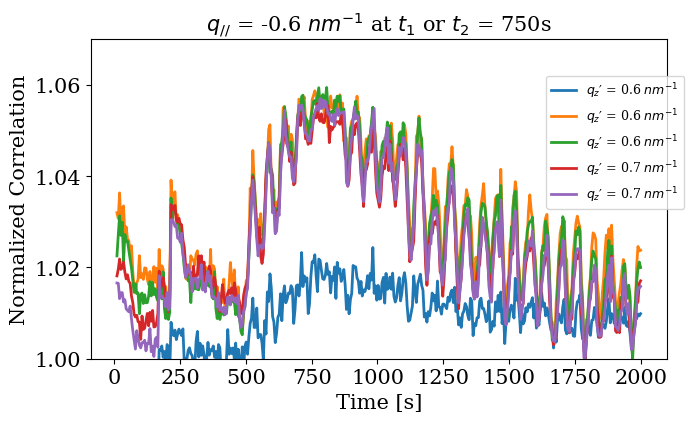

Dynamic_analysis_CHX.py:6: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  Can be used to do:


  0%|          | 0/5 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:768: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for frame in tqdm(np.arange(startframe,endframe,bin_frame)):


  0%|          | 0/398 [00:00<?, ?it/s]

Dynamic_analysis_CHX.py:810: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  location_peak = np.int((peak_in_X/(CenterXs[-1]-CenterXs[0]))*len(CenterXs))
Dynamic_analysis_CHX.py:113: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  plt.rcParams.update({'font.size': 14})


  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150077684, 1.6815491525442274, 1.6815491524867303, 1.6815491524227761, 1.6815491531451796, 1.6815491528811188] 1.6815491522596193 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499610085, 1.6815491528348705, 1.68154915245643, 1.6815491521910282, 1.6815491524343384, 1.6815491527071122] 1.6815491520974646 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497899706, 1.681549152982031, 1.681549152405406, 1.6815491521391888, 1.681549152905391, 1.6815491528754478] 1.681549152182906 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150116823, 1.6815491530449735, 1.6815491521674968, 1.6815491522887154, 1.6815491527620225, 1.6815491530216766] 1.6815491522336181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914976295, 1.681549152902429, 1.6815491523454327, 1.68154915220574, 1.6815491527054132, 1.6815491529815438] 1.681549152150585 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499087751, 1.6815491526598665, 1.681549152208932, 1.681549152108584, 1.681549152689378, 1.681549152746224] 1.6815491520536263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499548978, 1.68154915298844, 1.6815491524713053, 1.6815491523708062, 1.6815491529715603, 1.6815491528279183] 1.6815491522641546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501157296, 1.6815491525891781, 1.6815491523897075, 1.681549152102559, 1.6815491527524422, 1.681549152773432] 1.681549152120508 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499528425, 1.6815491524424653, 1.6815491528580377, 1.6815491524305597, 1.6815491530512285, 1.681549152778004] 1.6815491522521897 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497394608, 1.6815491524752355, 1.6815491527917032, 1.6815491526393886, 1.6815491531324875, 1.6815491531264932] 1.6815491523174615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502768634, 1.6815491526321127, 1.6815491523356645, 1.6815491521957906, 1.6815491530506401, 1.681549153169434] 1.681549152276751 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499489585, 1.6815491525280795, 1.6815491527077722, 1.6815491521613763, 1.6815491527005428, 1.6815491527635862] 1.6815491521350527 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496238524, 1.6815491526679311, 1.6815491527522828, 1.6815491523883352, 1.681549152911355, 1.6815491524464825] 1.6815491521317065 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149594903, 1.6815491524238935, 1.6815491523119852, 1.6815491523731039, 1.681549152836776, 1.6815491529015336] 1.6815491520736991 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500933817, 1.6815491524586417, 1.6815491525292554, 1.6815491527069812, 1.6815491528638855, 1.681549152409199] 1.6815491521768908 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500656146, 1.6815491522396648, 1.6815491526078743, 1.6815491524116712, 1.6815491527896533, 1.6815491531291626] 1.6815491522072736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499240496, 1.6815491526481958, 1.681549152150092, 1.6815491521443597, 1.6815491528053421, 1.6815491526241324] 1.681549152049362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501679034, 1.6815491527028406, 1.6815491524624755, 1.681549152379791, 1.6815491525818955, 1.681549152838219] 1.6815491521888541 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501396727, 1.6815491523152968, 1.6815491522613422, 1.6815491525467818, 1.6815491528211153, 1.6815491527525364] 1.6815491521394577 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496506851, 1.6815491527238082, 1.6815491525592274, 1.681549152255709, 1.6815491526633592, 1.6815491524036439] 1.6815491520427388 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497180077, 1.681549152814097, 1.6815491525006987, 1.681549152345589, 1.6815491530636502, 1.681549153178766] 1.681549152270135 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496297232, 1.6815491523568618, 1.6815491523305912, 1.6815491520870647, 1.6815491529333455, 1.6815491528118809] 1.6815491520249113 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491503415458, 1.6815491525135644, 1.6815491525393114, 1.6815491527482087, 1.6815491528106286, 1.6815491527160127] 1.681549152278212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498752007, 1.6815491524871975, 1.6815491526847581, 1.6815491523693487, 1.6815491528717432, 1.6815491525765718] 1.6815491521441368 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149988233, 1.6815491528803461, 1.6815491526432602, 1.6815491523533703, 1.681549152924625, 1.681549152647361] 1.6815491522395327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150095146, 1.681549152540482, 1.6815491524448998, 1.6815491525047093, 1.6815491527099562, 1.6815491530337794] 1.6815491522214954 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149883426, 1.681549152322122, 1.6815491522897315, 1.681549152350096, 1.6815491529653661, 1.6815491526517938] 1.681549152077089 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498918171, 1.6815491525118995, 1.681549152205692, 1.6815491522893713, 1.6815491525917663, 1.6815491527282278] 1.681549152036462 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500285167, 1.681549152916264, 1.6815491522660553, 1.6815491525219644, 1.6815491526938366, 1.68154915261852] 1.6815491521741925 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502048214, 1.6815491525544757, 1.6815491525333348, 1.6815491523556565, 1.6815491526771549, 1.6815491527785689] 1.681549152184002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150134289, 1.6815491524351955, 1.681549152434465, 1.6815491523588029, 1.6815491531100046, 1.6815491529387776] 1.681549152235256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497699426, 1.6815491524148092, 1.6815491527301525, 1.6815491526094677, 1.6815491527661304, 1.6815491524098554] 1.6815491521167265 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576667, 1.6815491522245853, 1.6815491522408612, 1.6815491524489126, 1.6815491526644561, 1.6815491526259394] 1.681549151993737 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497820325, 1.681549152160565, 1.6815491520246408, 1.6815491522732318, 1.6815491529947106, 1.6815491527093154] 1.6815491519907493 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914987561, 1.6815491523654558, 1.6815491524813742, 1.6815491525713284, 1.6815491527345516, 1.6815491526919502] 1.681549152120045 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499939066, 1.6815491528163014, 1.6815491524165287, 1.6815491522225137, 1.6815491528221713, 1.6815491529705104] 1.6815491522069888 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499682045, 1.6815491528100175, 1.6815491522774444, 1.6815491525728334, 1.6815491526764146, 1.6815491527769009] 1.6815491521803025 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501746216, 1.681549152545358, 1.6815491522569124, 1.6815491523493433, 1.6815491528000939, 1.6815491527385409] 1.6815491521441448 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500056132, 1.68154915238678, 1.6815491525378183, 1.6815491525476665, 1.6815491527301702, 1.681549152833095] 1.681549152173524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502180882, 1.6815491522531798, 1.6815491525251711, 1.6815491522510513, 1.6815491529796742, 1.6815491529095352] 1.6815491521894501 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500082063, 1.6815491527341822, 1.6815491523741972, 1.681549152364548, 1.6815491529795015, 1.681549152609381] 1.6815491521783361 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499663238, 1.6815491525393442, 1.6815491526722353, 1.6815491523570394, 1.6815491525878636, 1.6815491525525075] 1.6815491521125525 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500397721, 1.681549152690259, 1.6815491523447728, 1.6815491521841555, 1.6815491529754638, 1.6815491529295334] 1.681549152193993 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498351172, 1.6815491525338606, 1.681549152121124, 1.6815491523394313, 1.681549152968362, 1.6815491529142523] 1.6815491521186912 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500467794, 1.6815491522540262, 1.6815491524081132, 1.6815491520419297, 1.6815491527035151, 1.6815491526283668] 1.6815491520137886 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500267807, 1.6815491524851618, 1.6815491523285147, 1.6815491521911392, 1.6815491527954243, 1.6815491527338153] 1.6815491520934727 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502073847, 1.6815491525783743, 1.681549152559913, 1.6815491520519896, 1.681549152704291, 1.681549152720446] 1.6815491521370662 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149914225, 1.6815491525364257, 1.6815491523304145, 1.6815491523359656, 1.6815491528064443, 1.6815491527053568] 1.6815491521048054 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501960178, 1.6815491524663821, 1.681549152455677, 1.6815491525365767, 1.6815491527579915, 1.6815491529429156] 1.6815491522259267 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501820903, 1.6815491527866682, 1.6815491524609776, 1.6815491522601707, 1.6815491529761335, 1.6815491525507134] 1.6815491522027923 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499556976, 1.6815491521959096, 1.6815491524320896, 1.6815491521611818, 1.6815491525666237, 1.6815491525444988] 1.6815491519760002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491501238813, 1.6815491525349486, 1.6815491524272126, 1.681549152527559, 1.681549152723655, 1.6815491525544637] 1.68154915214862 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149952906, 1.6815491526392963, 1.6815491524171877, 1.6815491523670736, 1.6815491526083814, 1.681549152868154] 1.6815491521421666 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502402802, 1.6815491525949247, 1.6815491524438548, 1.6815491521711716, 1.6815491528356383, 1.6815491529594002] 1.681549152207545 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497085793, 1.6815491525239468, 1.6815491521322214, 1.6815491525709305, 1.6815491529263857, 1.68154915234717] 1.6815491520348722 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497410084, 1.6815491524611685, 1.6815491524309927, 1.6815491526678246, 1.6815491523224741, 1.6815491529533064] 1.6815491520961292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502715734, 1.6815491523639845, 1.681549152592397, 1.681549152095934, 1.6815491529920203, 1.681549152918846] 1.6815491522057924 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500013993, 1.6815491525954824, 1.6815491528071438, 1.6815491523751112, 1.6815491529833078, 1.6815491528283122] 1.681549152265126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149987469, 1.6815491525562356, 1.6815491524607147, 1.6815491526206556, 1.6815491526835977, 1.6815491530329472] 1.6815491522236032 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150127196, 1.6815491525761432, 1.6815491524756436, 1.6815491523816801, 1.6815491528687656, 1.6815491527688797] 1.6815491521997181 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149622941, 1.6815491523317454, 1.6815491525613204, 1.6815491522755055, 1.6815491526428206, 1.6815491524207475] 1.6815491519758468 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502355355, 1.681549152603631, 1.6815491524034467, 1.6815491523335648, 1.6815491533135134, 1.6815491524691506] 1.6815491522264736 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500688449, 1.6815491528727664, 1.6815491524787722, 1.6815491525242585, 1.6815491530813782, 1.6815491525384103] 1.6815491522607386 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150118216, 1.6815491529848363, 1.6815491523864186, 1.6815491520335488, 1.6815491529790334, 1.6815491529984277] 1.6815491522500803 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497235358, 1.6815491525192279, 1.6815491522593042, 1.6815491521303705, 1.6815491526747506, 1.6815491529104665] 1.6815491520362762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149736571, 1.6815491525134503, 1.6815491525040058, 1.6815491522697354, 1.6815491532479374, 1.681549152955522] 1.6815491522045372 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491502010138, 1.681549152493509, 1.6815491521799606, 1.6815491524053021, 1.6815491526886368, 1.6815491526408] 1.681549152101537 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149835687, 1.6815491525098016, 1.6815491523109811, 1.681549152523326, 1.6815491527362916, 1.6815491528628241] 1.6815491521298185 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149725873, 1.6815491524469754, 1.6815491526177233, 1.6815491522416188, 1.6815491528268316, 1.6815491527306232] 1.6815491520982742 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150044062, 1.6815491529066167, 1.6815491521686061, 1.6815491523440524, 1.6815491529131066, 1.6815491528660136] 1.681549152207076 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500090105, 1.6815491525904536, 1.68154915227589, 1.6815491521756094, 1.6815491527881408, 1.6815491525901107] 1.6815491520715362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498933417, 1.6815491525687571, 1.6815491519147852, 1.6815491522161774, 1.6815491525926767, 1.681549152275175] 1.6815491519101524 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497597805, 1.6815491526482047, 1.6815491522154637, 1.6815491524603052, 1.6815491528278486, 1.6815491525743678] 1.681549152080995 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499164037, 1.6815491525650605, 1.6815491521675945, 1.6815491523142456, 1.6815491526938535, 1.6815491525598212] 1.681549152036163 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496008312, 1.6815491527358768, 1.6815491521665304, 1.6815491523486799, 1.6815491526619244, 1.6815491526943642] 1.681549152034701 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498303397, 1.6815491522291088, 1.6815491522041066, 1.6815491520780323, 1.6815491527321615, 1.681549152447773] 1.6815491519202534 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499058766, 1.6815491528703452, 1.6815491523484072, 1.6815491523088264, 1.6815491521746733, 1.6815491525093371] 1.6815491520195778 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497687542, 1.6815491526312059, 1.681549152010481, 1.6815491519204455, 1.681549152668464, 1.6815491529035715] 1.6815491519838204 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499346038, 1.681549152532262, 1.68154915250968, 1.681549152043769, 1.6815491527023116, 1.681549152711062] 1.6815491520722814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491499624633, 1.6815491525793975, 1.6815491522506427, 1.6815491519329986, 1.6815491525515949, 1.6815491525129058] 1.6815491519650003 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500424824, 1.6815491525746236, 1.6815491521959913, 1.6815491523542914, 1.681549152786502, 1.681549152728194] 1.681549152113681 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496085553, 1.6815491523547705, 1.6815491522867045, 1.6815491523513506, 1.6815491526268382, 1.6815491527839375] 1.6815491520020263 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498658912, 1.6815491523893824, 1.6815491522340356, 1.6815491518655565, 1.6815491527903372, 1.681549152365084] 1.6815491519183814 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681546371509012, 1.681546720212368, 1.6815466753504773, 1.6815466627604634, 1.6815467275336973, 1.6815467288831258] 1.6815466477081904 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496930863, 1.6815491527334747, 1.6815491523075536, 1.6815491519513408, 1.681549152388044, 1.6815491526659008] 1.6815491519565668 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914994994, 1.6815491526615958, 1.6815491523143944, 1.681549151942587, 1.681549152891213, 1.6815491528009474] 1.6815491520934465 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496936792, 1.6815491528662125, 1.6815491522856316, 1.6815491519299886, 1.681549152621665, 1.681549152729974] 1.6815491520211918 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491500826831, 1.6815491530002387, 1.681549152443179, 1.6815491522961814, 1.6815491525033597, 1.681549152566486] 1.681549152148688 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549150115437, 1.681549152572095, 1.6815491522042247, 1.6815491521143295, 1.6815491523176131, 1.6815491529709012] 1.6815491520491002 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497301163, 1.6815491527161743, 1.681549152001932, 1.681549151835271, 1.681549152672435, 1.6815491529183042] 1.6815491519790389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497913797, 1.6815491529733437, 1.6815491522524768, 1.6815491523114199, 1.6815491526658244, 1.6815491527864674] 1.6815491521301518 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149926278, 1.681549152882568, 1.6815491523649544, 1.6815491521143056, 1.681549152567916, 1.681549152688853] 1.6815491520908126 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496133, 1.6815491525348327, 1.6815491521778418, 1.6815491521651098, 1.6815491527173956, 1.6815491526562871] 1.6815491519774615 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496243662, 1.6815491527469275, 1.6815491519786159, 1.6815491520148291, 1.6815491522819928, 1.6815491524484] 1.681549151849189 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497308068, 1.681549152567067, 1.6815491520772334, 1.681549152041728, 1.6815491524970194, 1.6815491523183779] 1.681549151872039 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497435202, 1.6815491524643082, 1.6815491522604695, 1.6815491519599517, 1.6815491526470576, 1.6815491523227988] 1.6815491518996843 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498629602, 1.6815491527993736, 1.6815491520851982, 1.6815491519651689, 1.6815491526169728, 1.681549152617292] 1.6815491519911607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496529527, 1.6815491527201551, 1.6815491522458546, 1.681549151927165, 1.6815491526603799, 1.6815491525496205] 1.6815491519593546 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497269903, 1.681549152676471, 1.6815491522547483, 1.681549151813174, 1.681549152312234, 1.6815491525202844] 1.6815491518839838 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498686304, 1.6815491527631234, 1.6815491519951182, 1.6815491517162053, 1.6815491523448767, 1.6815491528403808] 1.6815491519213894 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498757127, 1.6815491531421372, 1.6815491518270669, 1.681549151856463, 1.6815491522337385, 1.6815491528508435] 1.6815491519643269 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149781512, 1.6815491527871878, 1.681549152126916, 1.6815491518333445, 1.6815491524792439, 1.6815491527742292] 1.6815491519637389 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497576414, 1.681549152664667, 1.6815491519662933, 1.6815491517046794, 1.6815491520092087, 1.6815491525833357] 1.681549151780971 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496260462, 1.6815491524433872, 1.6815491521210468, 1.6815491514565206, 1.6815491524621065, 1.6815491526151494] 1.6815491517873762 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149607029, 1.6815491528582482, 1.681549151932444, 1.681549151823933, 1.6815491522880661, 1.6815491521474293] 1.6815491517761914 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149634372, 1.6815491526653128, 1.6815491523236354, 1.6815491521517116, 1.6815491528122442, 1.6815491530303381] 1.6815491521029358 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497867558, 1.6815491524196569, 1.6815491519275803, 1.681549152115768, 1.68154915274686, 1.6815491523019932] 1.6815491518831027 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491619938, 1.6815491528938606, 1.6815491523209882, 1.6815491519159123, 1.6815491527282798, 1.6815491523356125] 1.6815491518927745 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149528054, 1.6815491525026616, 1.6815491520907937, 1.6815491520700538, 1.6815491524485227, 1.6815491523324306] 1.6815491518287526 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497937085, 1.6815491528412823, 1.681549152045342, 1.6815491515864038, 1.6815491522696986, 1.6815491521995747] 1.681549151789335 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149266135, 1.6815491526500832, 1.6815491518954242, 1.681549151750434, 1.681549152540974, 1.6815491526745756] 1.681549151796271 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492811288, 1.6815491528486222, 1.6815491518650165, 1.6815491516638392, 1.6815491519287757, 1.6815491524779116] 1.681549151677549 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152718067, 1.6815491518626535, 1.681549151572837, 1.681549152067289, 1.6815491525818498] 1.6815491521605392 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492536125, 1.6815491525002448, 1.6815491515914935, 1.6815491514577232, 1.6815491520527859, 1.6815491525639983] 1.6815491515699765 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149500679, 1.6815491523613737, 1.6815491516225407, 1.68154915158267, 1.681549152054977, 1.681549152538278] 1.6815491516100864 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524604536, 1.681549151602232, 1.6815491516958154, 1.681549152169299, 1.6815491522836492] 1.6815491520422896 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491866634, 1.6815491525463404, 1.6815491517000476, 1.68154915194157, 1.681549152545946, 1.6815491524758075] 1.6815491517327292 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495185846, 1.6815491528468995, 1.6815491518837695, 1.6815491517598895, 1.681549152169279, 1.6815491523188095] 1.6815491517495385 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494021777, 1.6815491526867552, 1.6815491520261139, 1.6815491513842553, 1.6815491524132904, 1.6815491526841067] 1.6815491517661165 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495639674, 1.6815491523173103, 1.6815491517487215, 1.681549151851602, 1.6815491523899992, 1.6815491522351458] 1.6815491516844576 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496302917, 1.681549152395799, 1.6815491517232548, 1.6815491517730532, 1.6815491525912396, 1.6815491526622317] 1.6815491517959782 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497189208, 1.681549152761388, 1.6815491514370269, 1.6815491517892465, 1.6815491519246955, 1.6815491523543935] 1.6815491516642787 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149724841, 1.6815491525019466, 1.6815491519205708, 1.6815491520464456, 1.6815491520104255, 1.6815491528313302] 1.68154915183926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494728643, 1.6815491525477944, 1.6815491517632646, 1.681549151753221, 1.6815491521402048, 1.681549152620839] 1.681549151716365 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491497852935, 1.6815491526874498, 1.6815491518219918, 1.68154915156635, 1.6815491521492332, 1.6815491526973165] 1.6815491517846057 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493501566, 1.6815491525136164, 1.6815491520360464, 1.68154915198929, 1.6815491521290915, 1.6815491526871944] 1.6815491517842327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491526449984, 1.6815491517799535, 1.681549152129155, 1.6815491522197146, 1.681549152429378] 1.6815491522406396 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492613184, 1.6815491525257613, 1.681549151688683, 1.6815491518417272, 1.681549152279569, 1.6815491527426198] 1.6815491517232797 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495562025, 1.6815491526214075, 1.6815491515409704, 1.6815491515023813, 1.6815491523830932, 1.6815491524702386] 1.681549151679049 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496736454, 1.6815491528013844, 1.6815491515433174, 1.6815491515804135, 1.681549152272324, 1.681549152390362] 1.6815491517102412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494354724, 1.6815491526919693, 1.681549151815557, 1.6815491517191044, 1.681549151969997, 1.6815491524000725] 1.681549151672029 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495637591, 1.681549152726109, 1.6815491516339902, 1.6815491519159407, 1.6815491521592065, 1.681549152786241] 1.6815491517975412 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493351464, 1.6815491523439752, 1.6815491518799393, 1.68154915188263, 1.6815491516929093, 1.6815491525302253] 1.6815491516108043 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149512131, 1.6815491526599402, 1.681549151810409, 1.6815491514924057, 1.6815491524521127, 1.6815491525906179] 1.6815491517529362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495460657, 1.681549152607066, 1.6815491518346515, 1.681549151527089, 1.6815491522082837, 1.681549152567663] 1.6815491517151362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491522190191, 1.681549151730343, 1.6815491517701382, 1.681549152160787, 1.6815491523931456] 1.6815491520546868 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492192627, 1.681549152738115, 1.6815491519181203, 1.681549151664056, 1.68154915211663, 1.6815491523686683] 1.6815491516708085 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491541104, 1.6815491525492026, 1.6815491519474381, 1.6815491515937921, 1.6815491522130102, 1.6815491529344122] 1.6815491517319943 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496691344, 1.6815491525487838, 1.6815491513457896, 1.6815491514602439, 1.6815491524258852, 1.6815491523745099] 1.681549151637391 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495076538, 1.6815491524711814, 1.681549151683063, 1.6815491512892025, 1.6815491522605437, 1.68154915245782] 1.6815491516115777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492128505, 1.6815491525395405, 1.6815491518025985, 1.6815491516424443, 1.6815491522690147, 1.6815491524438677] 1.6815491516517191 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149212004, 1.6815491526401507, 1.681549151785207, 1.681549151477936, 1.681549151865374, 1.6815491522555863] 1.6815491515393763 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149661043, 1.6815491530023197, 1.681549151729103, 1.6815491515423382, 1.6815491521537798, 1.6815491521375776] 1.6815491517043604 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.68154914937889, 1.6815491527631776, 1.6815491516866747, 1.681549151627184, 1.6815491519589223, 1.6815491525272255] 1.6815491516570125 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149377254, 1.6815491527442736, 1.6815491516748593, 1.6815491514564238, 1.6815491521223285, 1.6815491526235529] 1.6815491516664487 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495356345, 1.681549152476539, 1.6815491519127628, 1.6815491514081788, 1.6815491518588446, 1.6815491522158394] 1.6815491515679664 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491496848578, 1.681549152523937, 1.681549151645434, 1.6815491512169674, 1.6815491517540475, 1.6815491524829351] 1.681549151551363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492986148, 1.6815491525422477, 1.681549151696761, 1.6815491517798686, 1.6815491517848793, 1.6815491526295534] 1.6815491516219876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492039327, 1.6815491525020212, 1.681549151847857, 1.6815491515248322, 1.6815491519497505, 1.681549152469759] 1.6815491515830256 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493643493, 1.6815491526592048, 1.6815491517100303, 1.6815491516463936, 1.6815491519145027, 1.68154915243746] 1.6815491516219903 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495117847, 1.6815491525848807, 1.6815491514669656, 1.681549151617265, 1.681549151652976, 1.6815491523873929] 1.6815491515368777 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491528394997, 1.681549151677765, 1.681549151209658, 1.681549152239186, 1.681549152312801] 1.6815491520557821 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525890796, 1.6815491518242895, 1.6815491520354549, 1.6815491521793016, 1.6815491525785555] 1.681549152241336 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491495796069, 1.6815491525270438, 1.6815491517954504, 1.6815491515101022, 1.6815491522907475, 1.6815491521816668] 1.6815491516474363 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491573353, 1.6815491524069426, 1.6815491516193863, 1.681549151487352, 1.68154915163079, 1.6815491525517134] 1.681549151475587 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491494534216, 1.6815491523152262, 1.6815491517643544, 1.681549151861251, 1.6815491520985004, 1.6815491524541741] 1.6815491516578216 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491498496256, 1.6815491527971367, 1.6815491518925265, 1.6815491515260987, 1.681549151972701, 1.6815491524072943] 1.6815491517408974 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492617722, 1.6815491524726704, 1.6815491516390204, 1.68154915172886, 1.6815491517101093, 1.6815491525356792] 1.6815491515580183 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491492774988, 1.6815491528240414, 1.681549151779091, 1.6815491512646643, 1.6815491519832877, 1.6815491526480324] 1.6815491516294359 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491525683863, 1.681549151540711, 1.6815491514424328, 1.68154915206626, 1.6815491524677832] 1.6815491520171146 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152649911, 1.681549151244334, 1.6815491513200413, 1.6815491517005423, 1.6815491526080666] 1.6815491519045789 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490975214, 1.6815491524626784, 1.681549151138209, 1.681549151181441, 1.681549152193031, 1.6815491525731172] 1.6815491514409997 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149285404, 1.681549152525882, 1.6815491518090129, 1.6815491514220615, 1.6815491514952399, 1.6815491524903354] 1.6815491515046561 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491452685, 1.6815491525601933, 1.6815491514245013, 1.681549151197717, 1.6815491522257249, 1.681549152190768] 1.681549151457362 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491682053, 1.6815491526296085, 1.6815491514866938, 1.6815491513824607, 1.6815491520732473, 1.6815491525254158] 1.681549151544272 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493358312, 1.6815491524748456, 1.6815491512254015, 1.6815491514038596, 1.6815491518313883, 1.681549152612237] 1.6815491514805938 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491147263, 1.6815491526456037, 1.6815491515335896, 1.6815491512211764, 1.6815491519756325, 1.6815491520982282] 1.6815491514314926 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815462988423606, 1.6815467144770455, 1.6815465943035184, 1.6815465750571015, 1.6815466376431818, 1.6815467031204445] 1.6815465872406088 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149261452, 1.681549152394596, 1.6815491516026064, 1.6815491512626854, 1.6815491518223915, 1.6815491525600894] 1.6815491514839704 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491524027593, 1.6815491513784133, 1.6815491514473235, 1.6815491522097328, 1.6815491524085484] 1.6815491519693555 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149000288, 1.6815491525458097, 1.681549151526557, 1.6815491513167813, 1.6815491519243047, 1.681549152721506] 1.6815491515058743 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489916474, 1.6815491524871482, 1.681549151363945, 1.681549151536236, 1.6815491515180998, 1.6815491524902884] 1.6815491513978944 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491767203, 1.6815491527147244, 1.6815491515435133, 1.681549151287418, 1.6815491516272063, 1.6815491522777948] 1.6815491514378964 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149066436, 1.6815491525740018, 1.681549151453873, 1.6815491511254157, 1.6815491518601267, 1.6815491521237749] 1.6815491513672713 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490110364, 1.6815491526011432, 1.6815491514211707, 1.6815491512258824, 1.681549151660092, 1.681549152671284] 1.6815491514317682 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149630941, 1.681549152421085, 1.6815491513932619, 1.6815491512045697, 1.6815491514266334, 1.6815491522902235] 1.6815491513944523 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148980325, 1.6815491525930777, 1.6815491515868906, 1.6815491514447851, 1.681549151454047, 1.6815491520805175] 1.681549151356607 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490888945, 1.681549152536653, 1.681549151496811, 1.6815491514977632, 1.681549152027221, 1.681549152437741] 1.6815491515141805 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491521722379, 1.6815491515788583, 1.6815491512950023, 1.6815491518898358, 1.681549152010116] 1.6815491517892098 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491728563, 1.6815491522687323, 1.6815491512641882, 1.6815491511425726, 1.6815491519461352, 1.6815491525697581] 1.6815491513940402 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149166358, 1.681549152234612, 1.6815491515598868, 1.6815491515236372, 1.6815491521051107, 1.6815491527765234] 1.6815491515610212 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491351366, 1.6815491524164958, 1.6815491513450143, 1.6815491513480132, 1.6815491518641155, 1.6815491522578574] 1.6815491513944387 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493237835, 1.681549152603131, 1.6815491514474274, 1.6815491510990492, 1.681549151391489, 1.6815491525671882] 1.6815491514053447 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490382222, 1.681549152368369, 1.68154915126971, 1.681549151301096, 1.681549152095859, 1.6815491525324502] 1.6815491514342849 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549148997771, 1.6815491523850015, 1.6815491515602012, 1.6815491511714966, 1.6815491515352967, 1.681549152849283] 1.6815491514165082 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491527017228, 1.6815491516295618, 1.681549151011919, 1.6815491516020402, 1.6815491525935995] 1.681549151907769 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491031471, 1.6815491528421314, 1.6815491513475322, 1.681549151216244, 1.6815491519086128, 1.681549152571015] 1.6815491514981133 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149179732, 1.681549152380192, 1.681549151135096, 1.6815491511464034, 1.6815491518323138, 1.68154915221634] 1.6815491513150127 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490116186, 1.6815491523940516, 1.6815491514254286, 1.681549150922351, 1.6815491518515993, 1.681549152072055] 1.6815491512795173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493020827, 1.6815491524414474, 1.6815491514141714, 1.681549150950679, 1.6815491516683352, 1.6815491525313808] 1.681549151384683 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488289886, 1.681549152209092, 1.6815491514633925, 1.68154915130672, 1.6815491518518577, 1.681549151779751] 1.6815491512399667 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488463206, 1.6815491523097403, 1.681549151303781, 1.6815491511998903, 1.6815491516480083, 1.6815491524472703] 1.6815491512925018 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491219356, 1.6815491523676842, 1.6815491515948002, 1.6815491513842655, 1.6815491518383379, 1.6815491523423054] 1.6815491514415548 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488438483, 1.681549152357892, 1.681549151746263, 1.6815491513622614, 1.681549151715703, 1.681549152523142] 1.6815491514248517 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491488208991, 1.6815491524267507, 1.6815491513719985, 1.6815491515611853, 1.6815491518229186, 1.681549152766122] 1.6815491514616456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490943772, 1.681549152593277, 1.681549150995255, 1.681549151033467, 1.6815491516613243, 1.6815491526770368] 1.681549151342456 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549152692086, 1.681549151489254, 1.6815491508054654, 1.6815491519082078, 1.6815491525953297] 1.6815491518980685 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491493383412, 1.681549152375939, 1.6815491517596741, 1.68154915107591, 1.6815491514094068, 1.6815491527603506] 1.68154915145327 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.681549149092696, 1.6815491529589086, 1.6815491517497563, 1.681549151195934, 1.6815491513986962, 1.681549152538099] 1.6815491514890148 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489228545, 1.6815491527077135, 1.681549151234326, 1.6815491510218177, 1.6815491517337153, 1.681549152260076] 1.6815491513134173 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489068397, 1.6815491522246107, 1.6815491512858216, 1.6815491513199419, 1.681549151708725, 1.6815491523615211] 1.6815491513012433 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491489383891, 1.68154915255261, 1.6815491514318346, 1.6815491517033436, 1.6815491514999978, 1.6815491528065407] 1.6815491514887861 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491491845105, 1.6815491523782775, 1.6815491515265029, 1.6815491510233418, 1.6815491517039005, 1.681549152294724] 1.681549151351876 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

[1.6815491490435743, 1.6815491523673467, 1.6815491512383347, 1.681549151242148, 1.6815491515919252, 1.6815491522343988] 1.6815491512862881 9


  0%|          | 0/57 [00:00<?, ?it/s]

  0%|          | 0/57 [00:00<?, ?it/s]

KeyboardInterrupt: 

<Figure size 720x445 with 0 Axes>

In [140]:
qparalls = [4, 17, 22, 32, 44, 56]
from tqdm import tqdm_notebook as tqdm

for qparallel in qparalls:
    plt.figure()
    for qz in tqdm([-300,-200,-100,0,100]):
        CenterXs,Inor_all, contrasts, Windows = collect_normalize(startframe = 2 ,endframe = 400 , centerx_start = 100, centerx_end = 1300, centery = 1400+qz,peak_in_X = 750, boxsize = (21,101), bin_frame = 1, normalize = 1, SG_window = 0, SG_order = 3,  SG_bin_frame = 80, interpolate = 1)
        TTCF2, TTCFs = TTCF(CenterXs,Inor_all)
        select_num           = qparallel
        toplot               = np.array(TTCFs[select_num][:-1])
        metadata             = TTCFs[select_num][-1]
        startframe,endframe, centerx, centery,boxsize, bin_frame, normalize, SG_window , SG_order ,  SG_bin_frame, interpolate = metadata[0],metadata[1],metadata[2],metadata[3],metadata[4],metadata[5],metadata[6], metadata[7],  metadata[8], metadata[9], metadata[10]    
        dimension            = np.shape(toplot)[0]
        color_min, color_max = 0.1, 1.2
        times_list           = [(startframe)*datatakingtime,((startframe)*datatakingtime)+((dimension)*datatakingtime*(bin_frame)),(startframe)*datatakingtime,((startframe)*datatakingtime)+((dimension)*datatakingtime*(bin_frame))]
        times                = np.linspace(times_list[0], times_list[1], num = dimension)
        TTCF_crosssec_time   = 750
        local_avg            = 5 # time


        crop                 = int(TTCF_crosssec_time//datatakingtime)
        local_avg            = int(local_avg//datatakingtime) 


        wavenumber           = r'$q_z′$ = ' + np.str_(np.round(convert_pixel_to_q(centerx, centery)[7],decimals=1 )) + r' $nm^{-1}$' 
        TTCF_crosssection    = np.average(toplot[crop-local_avg : crop+local_avg], axis = 0)
        plt.plot(times, TTCF_crosssection/np.min(TTCF_crosssection[dimension//2:]), label = wavenumber)
    plt.xlabel('Time [s]')
    plt.ylim(1,1.07)
    plt.ylabel('Normalized Correlation')
    plt.title(r'$q_{//}$ = ' + np.str_(np.round(convert_pixel_to_q(centerx, centery)[1],decimals=1))+ r' $nm^{-1}$' + r' at $t_1$ or $t_2$ = {0:d}s'.format(TTCF_crosssec_time) )
    plt.legend(bbox_to_anchor= (0.78,0.45),loc = 'lower left', fontsize = 9)
    plt.show()


# Draft codes below

In [1]:
pwd

'/Users/pmyint/Box/GitHub/Analysis_book_for_CHX_NSLSII'

In [2]:
import sys
sys.path.append('/Users/pmyint/Box/GitHub/Analysis_book_for_CHX_NSLSII') #Ash change this path to your folder
sys.path.append('/Users/pmyint/Downloads/TIFF_ALD_99b99be0')
import numpy as np

import matplotlib.pyplot as plt
center = [0,0]
md = {}
md['eiger4m_single_det_distance'] = 12
md['eiger4m_single_photon_energy'] = 7.5
md['incident angle'] = 0.3
md['acquire period'] = 2

%run -i 'Static_analysis_modified_for_CHX.py'
%run -i 'crosscor.py'
%run -i 'Amplification_factors.py'

%run -i 'autocor.py'
%run -i 'partitions.py'
%run -i 'Dynamic_analysis_CHX.py'

Static_analysis_modified_for_CHX.py:81: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  alpha_i=np.float(md['incident angle'])*(np.pi/180) ##
Static_analysis_modified_for_CHX.py:84: DeprecationWarning: `np.float` is a deprecated alias for the builtin `float`. To silence this warning, use `float` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.float64` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  datatakingtime = np.float(md['acquire period'])  #md['cam_acquire_period'] ##


In [33]:
# from PIL import Image
import numpy as np
import h5py

class readslice:
    
    def __init__(self):
        self.f = h5py.File('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/ALD/091f5c16-7a23-4ede-8d23_3310_master.h5' ,'r')
#         print('fake read frame')
    def rdframe(self, n):
        return np.array(self.f.get('entry/data/data_{0:06d}'.format((n//10)+1)))[n,:,:]
#         return np.load('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/numpy_format/{0:d}.npy'.format(n))
FD = readslice()

In [34]:
FD.rdframe(1)

IndexError: too many indices for array: array is 0-dimensional, but 3 were indexed

In [1]:
import h5py
import numpy as np
f = h5py.File('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/ALD/091f5c16-7a23-4ede-8d23_3310_master.h5' ,'r')
data1 = np.array(f.get('entry/data/data_000001'))
np.shape(data1)
# a = f.get('entry/data/data_000034')

()

In [12]:
f = h5py.File('/Users/pmyint/Downloads/TIFF_ALD_99b99be0/ALD/091f5c16-7a23-4ede-8d23_3310_master.h5','r')
data1 = np.array(f.get('entry/data/data_000001'))

In [13]:
data1

array(None, dtype=object)

In [8]:
h5py.__version__

'3.4.0'

In [62]:
s = f.get('entry/data/data_000006').value
s

AttributeError: 'NoneType' object has no attribute 'value'

In [47]:
a

In [25]:
class CSSI_3D_object:

    def __init__(
        self,
        energy
        ):
        self.energy     = energy
    """
    There is a separate module to make a CSSI object
    The plan is to combine the modules together 
    """

    ######################################################
    ###############    refractive index   ################
    ######################################################
    def calc_refractive_index(self, material):
        obj_mat = material['object']
        d_obj, m_obj, _   = xdb.xray_delta_beta(obj_mat,
                                              xdb.atomic_density(obj_mat),
                                              self.energy * 1000)
        
        bind_mat = material['binding']
        d_bind, m_bind, _ = xdb.xray_delta_beta(bind_mat,
                                              xdb.atomic_density(bind_mat),
                                              self.energy * 1000)

        sub_mat = material['substrate']
        d_sub, m_sub, _   = xdb.xray_delta_beta(sub_mat,
                                              xdb.atomic_density(sub_mat),
                                              self.energy * 1000)

        return (d_obj - 1j * m_obj, d_bind - 1j * m_bind, d_sub - 1j * m_sub)
    
    def read_obj(self, path, wkind = 'list'):
        if wkind   == 'list':
            all_slices             = []
            print('Loading all data')
            for idz in tqdm.tqdm(range(self.total_slices)):
                all_slices.append(np.load(path+str(idz)+'.npy'))
        elif wkind == 'singleFile':
            print('Loading a giant file. Sit back and do breathing exercise...')
            all_slices = np.load(path+'CSSI_obj.npy')

        return all_slices

In [27]:
CSSI_3D_object.calc_refractive_index({'object': 1, 'binding' : 2 , 'substrate' : 3 })

TypeError: calc_refractive_index() missing 1 required positional argument: 'material'